# Importing

## Importing modules

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)
import time
import random
import math
from multiprocessing import Process, Queue

import keras
from keras.models import Sequential
from keras.layers import Activation, Dense
from keras.models import load_model, clone_model
from keras.optimizers import SGD, adam, adagrad, rmsprop

Using TensorFlow backend.


## Importing own code

In [2]:
from generateSpace import *
from plotLattice import *
from potentialEnergy import *
from numberOfCalculations import *
from makeRandomDatabase import *
from prepareDatabaseForMachineLearning import*

## Writing own code

### Analysis code

In [3]:
def plotHistory(fitDetails):
    """
    hjhgj
    """
    history = {'loss': fitDetails.history['loss'], 'val_loss': fitDetails.history['val_loss']}
    
    maximumValue = max(max(history['loss']), max(history['val_loss']))
    minimumValue = min(min(history['loss']), min(history['val_loss'])) / 10#math.pow(math.floor(math.log(min(min(history['loss']), min(history['val_loss'])), 10)) - 1, 10)
    numberOfEpochs = len(history['loss'])
    
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(16, 16))
    ax1.plot([i for i in range(1, numberOfEpochs + 1)], history['loss'], label='Training loss')
    ax1.plot([i for i in range(1, numberOfEpochs + 1)], history['val_loss'], label='Validation loss')
    ax1.legend()
    ax1.set_xlim(1, numberOfEpochs)
    ax1.set_ylim(0, maximumValue)
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Loss (E/Ec)')
    ax1.set_title('Loss (training and validation) vs the number of epochs.')
    
    ax2.plot(history['loss'], history['val_loss'])
    ax2.set_xlim(0, maximumValue)
    ax2.set_ylim(0, maximumValue)
    ax2.set_xlabel('Training loss (E/Ec)')
    ax2.set_ylabel('Validation loss (E/Ec)')
    ax2.set_title('Validation loss vs training loss.')
    
    ax3.plot([i for i in range(1, numberOfEpochs + 1)], history['loss'], label='Training loss')
    ax3.plot([i for i in range(1, numberOfEpochs + 1)], history['val_loss'], label='Validation loss')
    ax3.legend()
    ax3.set_xlim(1, numberOfEpochs)
    ax3.set_yscale('log')
    ax3.set_ylim(minimumValue, maximumValue)
    ax3.set_xlabel('Epochs')
    ax3.set_ylabel('Loss (E/Ec)')
    ax3.set_title('Loss (training and validation) vs the number of epochs (logarithmic)')
    
    ax4.plot(history['loss'], history['val_loss'])
    ax4.set_xscale('log')
    ax4.set_xlim(minimumValue, maximumValue)
    ax4.set_yscale('log')
    ax4.set_ylim(minimumValue, maximumValue)
    ax4.set_xlabel('Training loss (E/Ec)')
    ax4.set_ylabel('Validation loss (E/Ec)')
    ax4.set_title('Validation loss vs training loss (logarithmic).')
    
    plt.show()
    history['figure'] = [fig, ax1, ax2, ax3, ax4]
    
    return history

In [4]:
def makeGradiantPlot(model, x, testData):
    y = [[],[]]
    for i in range(len(x)):
        y[0].append(model.predict([[testData['eigenvalues'][i]]])[0][0])
        #y[0].append(model.predict([[testData['relativeDistances'][i]]])[0][0])
        y[1].append(testData['potentialEnergy'][i])


    fig, ((ax1, ax2)) = plt.subplots( ncols=2, figsize=(16, 8))
    ax1.plot(list(x), y[0], label='Predicted potential energy')
    ax1.plot(list(x), y[1], label='Real potential energy')
    ax1.legend()
    ax1.set_xlabel('Position of particle (r/Rc)')
    ax1.set_ylabel('Potential energy per particle (E/Ec)')
    ax1.set_title('Predicted potential energy and real potential energy for different positions.')
    
    ax2.plot(list(x), np.gradient(y[0], x[1] - x[0]), label='Predicted gradiant')
    ax2.plot(list(x), np.gradient(y[1], x[1] - x[0]), label='Real gradiant')
    ax2.legend()
    ax2.set_xlabel('Position of particle (r/Rc)')
    ax2.set_ylabel('Gradiant')
    ax2.set_title('Predicted gradiant and real gradiant for different positions.')
    
    plt.show()

In [5]:
def makePredictionPlot(model, dataFrame, amountOfPoints=2500):
    prediction = []
    realValue = []
    
    for i in range(min(len(dataFrame['potentialEnergy']), amountOfPoints)):
        index = dataFrame.index[i]
        prediction.append(model.predict([[dataFrame['eigenvalues'][index]]])[0][0])
        #prediction.append(model.predict([[dataFrame['relativeDistances'][index]]])[0][0])
        realValue.append(dataFrame['potentialEnergy'][index])
    
    fig, ((ax1)) = plt.subplots(nrows=1, ncols=1, figsize=(8, 8))
    ax1.scatter(realValue, prediction, s=5)
    ax1.set_xlim(min(min(prediction), min(realValue)), max(max(prediction), max(realValue)))
    ax1.set_ylim(min(min(prediction), min(realValue)), max(max(prediction), max(realValue)))
    ax1.set_xlabel('Real energy per particle (E/Ec)')
    ax1.set_ylabel('Predicted energy per particle (E/Ec)')
    ax1.set_title('Predicted energy vs real energy.')
    
    plt.show()

In [6]:
def plotAndPredict(model, dataFrame, indexNumber):
    prediction = model.predict([[dataFrame['eigenvalues'][indexNumber]]])[0][0]
    #prediction = model.predict([[dataFrame['relativeDistances'][indexNumber]]])[0][0]
    realValue = dataFrame['potentialEnergy'][indexNumber]
    
    fig, ax = plotLatticeFromDataFrame(dataFrame, indexNumber)
    print('For index', indexNumber, 'Predicted', prediction, 'was', realValue)
    return fig, ax

### Network code

In [7]:
def testNetwork(trainingInput, settings, learningRate, kernalInitializer='he_uniform', lossFunction='MAE', validationSplit=0.3, epochs=10000, verbose=1, callbacksNetwork=[], sampleSize=4):
    bestModel = makeDenseNetwork(settings, learningRate, kernalInitializer, lossFunction)
    if verbose>=1:
        bestModel.summary()
        print(bestModel.evaluate(trainingInput['input'], trainingInput['target'], verbose=1))
        for i in range(len(bestModel.layers)):
            print('Layer ' + str(i) + ': ', bestModel.layers[i].get_weights())
    
    bestEvaluation = bestModel.evaluate(trainingInput['input'], trainingInput['target'], verbose=0)
    bestFitDetails = bestModel.fit(trainingInput['input'], trainingInput['target'], validation_split=validationSplit, epochs=3, verbose=0, callbacks=callbacksNetwork)
    
    for i in range(sampleSize):
        model = makeDenseNetwork(settings, learningRate, kernalInitializer, lossFunction)
        fitDetails = model.fit(trainingInput['input'], trainingInput['target'], validation_split=validationSplit, epochs=epochs, verbose=verbose, callbacks=callbacksNetwork)
        
        if fitDetails.history['val_loss'][-1]<=bestEvaluation:
            bestModel = model
            bestEvaluation = fitDetails.history['val_loss'][-1]
            bestFitDetails = fitDetails
            
        if verbose>=1:
            for j in range(len(model.layers)):
                print('Network' + str(i) + ' Layer ' + str(j) + ': ', model.layers[j].get_weights())
            history = plotHistory(fitDetails)
    
    return bestModel, bestFitDetails

In [8]:
def makeDenseNetwork(settings, learningRate, kernalInitializer='he_uniform', lossFunction='MAE'):#https://keras.io/api/losses/regression_losses/
    """
    jhgjhgj
    """
    model = Sequential()
    model.add(Dense(settings[1][1], input_dim=settings[0], use_bias=settings[1][3], activation=settings[1][2], kernel_initializer=kernalInitializer))
    #model.add(Activation(settings[0][2]))
    
    for i in range(2, len(settings)):
        setting = settings[i]#0 is kind of layer, rest are settings.
        
        model.add(Dense(setting[1], use_bias=setting[3], activation=setting[2], kernel_initializer=kernalInitializer))
        #model.add(Activation(setting[2]))
    
    opt = adam(lr=learningRate)
    model.compile(loss=lossFunction, optimizer=opt)
    
    return model

In [9]:
def makeLinearNet(learningRate, inputDim, loss):
    model = Sequential()
    opt = adam(lr=learningRate)
    model.add(Dense(1, activation="linear", use_bias=False, input_dim=inputDim))
    model.compile(loss=loss, optimizer=opt)
    return model

# Getting data

## Importing data and settings

In [10]:
filename = 'DatabaseMin_86Width1.5-10_100k_40scans_0.1max_3ds_1dsDecent_4particles_2D_M2M3M4R0p20Prepared'#'databaseModLen_min_cut0.90_widths86_Width5_data1k_3-1sur_epoch30_maxDelta0.1_1Prepared'
orderOfMatrix = [-2, -3, -4]# Make a list if you want to do the calculations yourself and make a other type of you want to import it
inputSize = 4 * len(orderOfMatrix)
saveFolder = 'M2M3M4MultiBias'
lossMetric = 'MAE'

In [11]:

data = pd.read_json(filename + '.json', orient='columns')
data['particleCoordinates'] = data['particleCoordinates'].apply(np.array)
data['eigenvalues'] = data['eigenvalues'].apply(np.array)
#data['eigenvalues'] = data['eigenvalues'].apply(np.transpose)
#data['eigenvalues'] = data['eigenvalues'].apply(list)

offset = 0#min(data['potentialEnergy'])
print('Offset is', offset)
data['potentialEnergy'] = data['potentialEnergy']-offset

Offset is 0


## Inspecting data

In [12]:
data.head()

,index,particleCoordinates,widthOfCell,numberOfSurroundingCells,potentialEnergy,eigenvalues,relativeDistances
0,52207,"[[3.356581342, 3.8344834485], [2.4497926322, 3...",4.2,3,-4.006924,"[-723.6205119095, -267.1495551404, -238.443595...","[4.2, 0.8259258793, 0.8267277843, 0.8285372113..."
1,52208,"[[1.6415119998, 3.377563607], [2.5579022466, 3...",4.2,3,-0.934830,"[-560.4461210218, -158.1530508662, -103.566384...","[4.2, 0.8956010877, 0.9063221449000001, 3.4624..."
2,52209,"[[1.9684573388, 3.7361358444], [1.0704870568, ...",4.2,3,-3.524842,"[-608.5020921328, -349.3724914654, -169.048245...","[4.2, 0.8485892965, 0.9316604072, 0.9901852895..."
3,52210,"[[1.500784965, 1.1086832758], [1.3475676081, 2...",4.2,3,-2.963811,"[-605.4167982684, -373.6450372595, -145.763579...","[4.2, 0.8328181746000001, 0.8351943563, 0.8752..."
4,52211,"[[3.0770051469, 4.1478152786999996], [3.726436...",4.2,3,3.423278,"[-860.8983236291, -224.2857054292, -19.9796822...","[4.2, 0.9351936940000001, 0.9484874317, 7.4949..."


In [13]:
data.describe()

,index,widthOfCell,numberOfSurroundingCells,potentialEnergy
count,97882.000000,97882.000000,97882.0,97882.000000
mean,48940.500000,5.651593,3.0,9.973750
std,28256.243862,2.443168,0.0,132.626087
min,0.000000,1.500000,3.0,-29.418425
25%,24470.250000,3.500000,3.0,-2.212925
50%,48940.500000,5.600000,3.0,-0.706743
75%,73410.750000,7.700000,3.0,-0.109594
max,97881.000000,10.000000,3.0,8848.009533


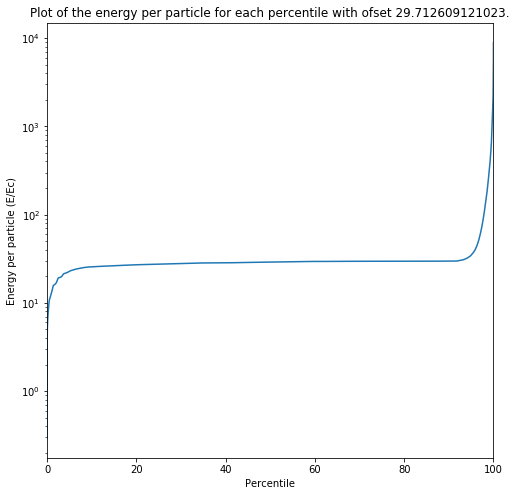

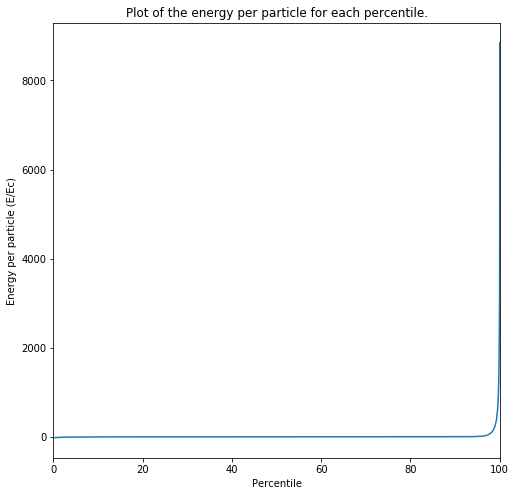

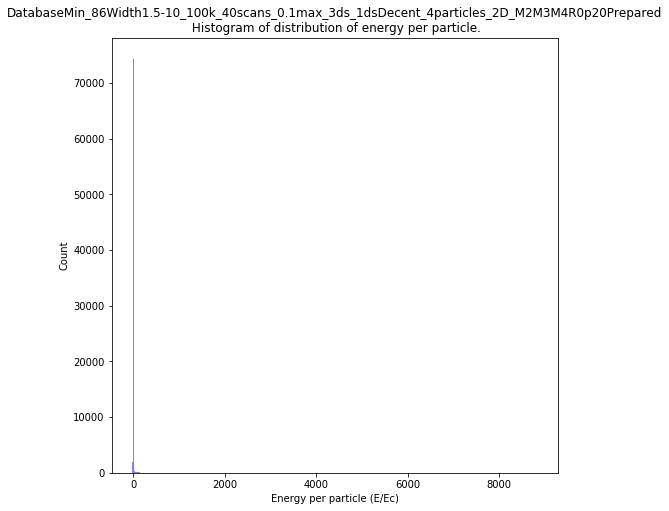

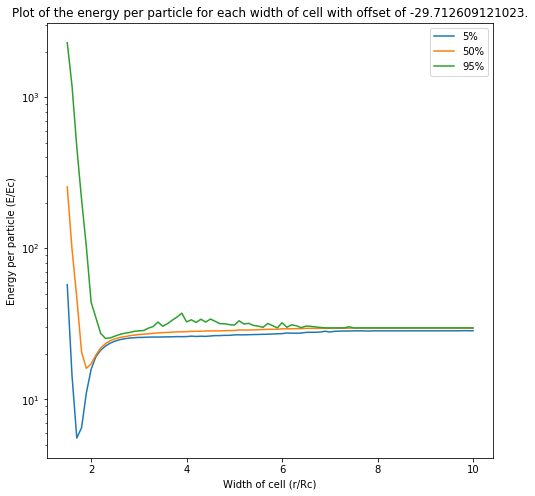

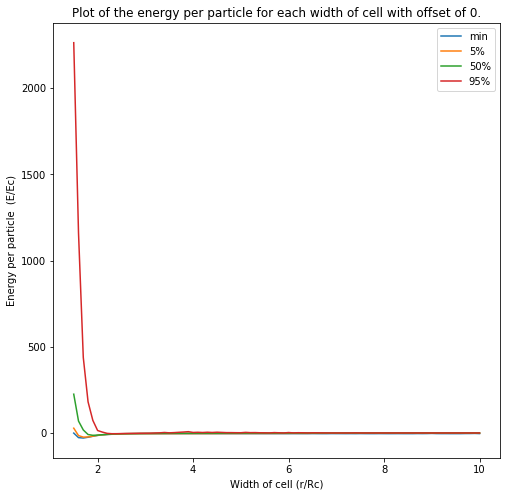

In [14]:

#"""
qLow = data['potentialEnergy'].quantile(0.01)
qHi  = data['potentialEnergy'].quantile(0.99)
dataFiltered = data.copy()
#dataFiltered = data[(data['potentialEnergy'] < qHi) & (data['potentialEnergy'] > qLow)]

x = dataFiltered['potentialEnergy']
fig, ax = plt.subplots(figsize=(8, 8))
sortedX = np.sort(x) - 1.01 * min(x)
ax.plot([100*i/len(x) for i in range(0, len(x))], sortedX)
ax.set_xlim(0, 100)
ax.set_yscale('log')
ax.set_title('Plot of the energy per particle for each percentile with ofset ' + str(-1.01 * min(x)) + '.')
ax.set_ylabel('Energy per particle (E/Ec)')
ax.set_xlabel('Percentile')
plt.show()

x = dataFiltered['potentialEnergy']
fig, ax = plt.subplots(figsize=(8, 8))
sortedX = np.sort(x)
ax.plot([100*i/len(x) for i in range(0, len(x))], sortedX)
ax.set_xlim(0, 100)
ax.set_title('Plot of the energy per particle for each percentile.')
ax.set_ylabel('Energy per particle (E/Ec)')
ax.set_xlabel('Percentile')
plt.show()


#"""


#"""
numBins = 1000
fig, ax = plt.subplots(figsize=(8, 8))
n, bins, patches = ax.hist(x, numBins, facecolor='blue', alpha=0.5)
ax.set_title(filename + '\n Histogram of distribution of energy per particle.')
ax.set_xlabel('Energy per particle (E/Ec)')
ax.set_ylabel('Count')
plt.show()
#"""

#"""
tempData = dataFiltered.copy()
tempOfsett = 1.01 * min(tempData['potentialEnergy'])
tempData['potentialEnergy'] = tempData['potentialEnergy'] - tempOfsett
medianData = tempData.groupby('widthOfCell').describe(percentiles=[0.05, 0.5, 0.95])
fig, ax = plt.subplots(figsize=(8, 8))
ax.plot(medianData.index, medianData['potentialEnergy']['5%'])
ax.plot(medianData.index, medianData['potentialEnergy']['50%'])
ax.plot(medianData.index, medianData['potentialEnergy']['95%'])
plt.legend(['5%', '50%', '95%'])
ax.set_yscale('log')
ax.set_title('Plot of the energy per particle for each width of cell with offset of ' + str(tempOfsett) + '.')
ax.set_ylabel('Energy per particle (E/Ec)')
ax.set_xlabel('Width of cell (r/Rc)')
plt.show()
#"""

#"""
tempData = dataFiltered.copy()
tempOfsett = 0#1.01 * min(tempData['potentialEnergy'])
tempData['potentialEnergy'] = tempData['potentialEnergy'] - tempOfsett
medianData = tempData.groupby('widthOfCell').describe(percentiles=[0.05, 0.5, 0.95])
fig, ax = plt.subplots(figsize=(8, 8))
ax.plot(medianData.index, medianData['potentialEnergy']['min'])
ax.plot(medianData.index, medianData['potentialEnergy']['5%'])
ax.plot(medianData.index, medianData['potentialEnergy']['50%'])
ax.plot(medianData.index, medianData['potentialEnergy']['95%'])
plt.legend(['min', '5%', '50%', '95%'])
#plt.ylim(-30, 30)
ax.set_title('Plot of the energy per particle for each width of cell with offset of ' + str(tempOfsett) + '.')
ax.set_ylabel('Energy per particle  (E/Ec)')
ax.set_xlabel('Width of cell (r/Rc)')
plt.show()
#"""


## Preparing data

In [15]:
#"""
trainingData = data.sample(frac=0.8)
validationData = data.drop(trainingData.index)

inputData = []
targetData = []
for i in trainingData.index:
    inputData.append(np.array(trainingData['eigenvalues'][i]))
    #inputData.append(np.array(trainingData['relativeDistances'][i]))
    targetData.append(trainingData['potentialEnergy'][i])
    #targetData.append(sum(trainingData['eigenvalues'][i]))
    #targetData.append([sum(trainingData['relativeDistances'][i])])

trainingInput = {'input':np.array(inputData), 'target':np.array(targetData)}

print('Results training input:')
[print(trainingInput['input'][i], trainingInput['target'][i], '\n') for i in range(0, 3)]
print(np.shape(trainingInput['input']))
print(type(trainingInput['input']))
print(type(trainingInput['input'][0]))
print(np.shape(trainingInput['target']))
print(type(trainingInput['target']))

inputData = []
targetData = []
for i in validationData.index:
    inputData.append(np.array(validationData['eigenvalues'][i]))
    #inputData.append(np.array(validationData['relativeDistances'][i]))
    targetData.append(validationData['potentialEnergy'][i])
    #targetData.append([sum(validationData['eigenvalues'][i])])
    #targetData.append([sum(validationData['relativeDistances'][i])])

validationInput = {'input':np.array(inputData), 'target':np.array(targetData)}

print('Results validation input:')
[print(validationInput['input'][i], validationInput['target'][i], '\n') for i in range(0, 3)]
print(np.shape(validationInput['input']))
print(type(validationInput['input']))
print(type(validationInput['input'][0]))
print(np.shape(validationInput['target']))
print(type(validationInput['target']))

validationPlots = [random.choice(validationData.index) for i in range(0, 11)]

#"""
print()

Results training input:
[-4.20013515e+02 -2.81248281e+02  1.37874962e+02  8.26046446e+02
 -8.06634345e+03 -4.91535118e+03  3.98098097e+03  9.64191696e+03
 -1.55592743e+05 -8.58746111e+04  8.06792183e+04  1.62543146e+05] -0.2484982835 

[-8.40939129e+02 -3.68272360e+02 -9.23395795e+00  1.56111981e+03
 -2.37176232e+04 -6.78010734e+03  1.28261587e+02  3.12746449e+04
 -6.67521946e+05 -1.21299195e+05  2.74063284e+03  7.88794352e+05] 7.2372232976 

[-3.99674411e+02 -2.79623268e+01  2.69406267e+01  4.83688249e+02
 -7.94595378e+03 -1.26035374e+02  1.47159350e+02  8.06692904e+03
 -1.58373154e+05 -5.60728503e+02  6.12488963e+02  1.58580782e+05] -0.1095897329 

(78306, 12)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(78306,)
<class 'numpy.ndarray'>
Results validation input:
[-7.23620512e+02 -2.67149555e+02 -2.38443596e+02  1.93375213e+03
 -1.73959002e+04 -4.19206522e+03 -3.49865220e+03  2.73869928e+04
 -4.05203565e+05 -6.62730101e+04 -5.15530689e+04  5.31855626e+05] -4.0069237622 

[-5.210111

## Preparing test data

No handles with labels found to put in legend.


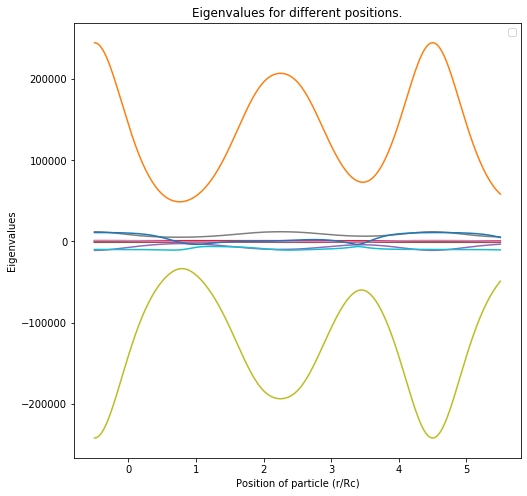

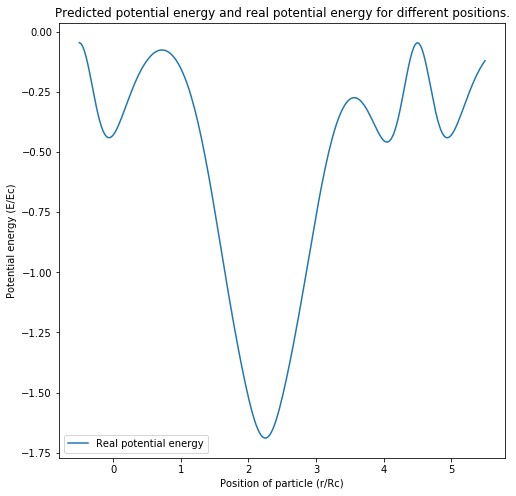

In [16]:
#"""
widthOfCell = 5.0
numberOfSurroundingCells = 3
R0 = 20
x = np.linspace(-0.1, 1.1, 2*120)

testData = {'particleCoordinates': [],'widthOfCell':[] , 'numberOfSurroundingCells': [], 'potentialEnergy':[]}# Initialy use a dictionary because it's easier to append to than a dataframe.
for i in x:
    particles = [np.array([0.3, 0.5]), np.array([0.68, 0.9]), np.array([0.7, 0.4]), np.array([0.5, i])]
    particles = [widthOfCell * coordinate for coordinate in particles]
    otherSpace = generateSpace(particles, numberOfSurroundingCells, widthOfCell)# Generate the other space.
    testData['particleCoordinates'].append(particles)
    testData['widthOfCell'].append(widthOfCell)
    testData['numberOfSurroundingCells'].append(numberOfSurroundingCells)
    testData['potentialEnergy'].append(potentialEnergy(otherSpace, particles, potentialEnergyPerSet) - offset)# Calculate the potential energy and save it to the data dictonairy.

x = widthOfCell * x
testData = prepareDatabseForMachineLearning(pd.DataFrame(testData), orderOfMatrix, R0, giveUpdates = False)

fig, ax1 = plt.subplots(figsize=(8, 8))
ax1.plot(list(x), [testData['eigenvalues'][i] for i in range(0, len(testData['eigenvalues']))])
#ax1.plot(list(x), [testData['relativeDistances'][i] for i in range(0, len(testData['relativeDistances']))])
ax1.legend()
#ax1.set_ylim(-50, 50)
ax1.set_xlabel('Position of particle (r/Rc)')
ax1.set_ylabel('Eigenvalues')
#ax1.set_ylabel('Relative distances')
ax1.set_title('Eigenvalues for different positions.')
plt.show()

testData.head()
testData.describe()

y = []
for i in range(len(x)):
    y.append(testData['potentialEnergy'][i])


fig, ax1 = plt.subplots(figsize=(8, 8))
ax1.plot(list(x), y, label='Real potential energy')
ax1.legend()
ax1.set_xlabel('Position of particle (r/Rc)')
ax1.set_ylabel('Potential energy (E/Ec)')
ax1.set_title('Predicted potential energy and real potential energy for different positions.')
#ax1.set_ylim(-0.75 * offset , 1.5 * max(y[1]))
plt.show()
#"""
print()

# Machine learning

In [17]:
def RSMPE(target,value):
    return ((keras.backend.mean(((value-target)/target)**2))**0.5)*100

def MAE(target,value):
    return keras.backend.mean(abs(value-target))

models = []
prefixName = 0

## Model 0: Linear network

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
78306/78306 [==============================] - 1s 11us/step
97382.82774128899
Layer 0:  [array([[ 0.27788746],
       [-0.6678102 ],
       [ 0.62029105],
       [-0.00554532],
       [-0.50795805],
       [ 0.11544812],
       [-0.5966527 ],
       [ 0.43022507],
       [-0.51996434],
       [ 0.68302137],
       [ 0.5560623 ],
       [-0.3739914 ]], dtype=float32), array([0.], dtype=float32)]
Train on 62644 samples, validate on 15662 samples
Epoch 1/20000
62644/62644 [==============================] - 2s 30us/step - loss: 35006.6825 - val_loss: 31080.0910
Epoch 2/20000
62644/62644 [==============================] - 2s 29us/step - loss: 28394.

62644/62644 [==============================] - 2s 30us/step - loss: 3475.2024 - val_loss: 3511.2835
Epoch 65/20000
62644/62644 [==============================] - 2s 31us/step - loss: 3413.4569 - val_loss: 3448.9415
Epoch 66/20000
62644/62644 [==============================] - 2s 30us/step - loss: 3352.4481 - val_loss: 3388.8076
Epoch 67/20000
62644/62644 [==============================] - 2s 31us/step - loss: 3291.8219 - val_loss: 3324.4874
Epoch 68/20000
62644/62644 [==============================] - 2s 32us/step - loss: 3230.0527 - val_loss: 3261.5257
Epoch 69/20000
62644/62644 [==============================] - 2s 31us/step - loss: 3169.3722 - val_loss: 3199.8676
Epoch 70/20000
62644/62644 [==============================] - 2s 31us/step - loss: 3108.6153 - val_loss: 3139.6304
Epoch 71/20000
62644/62644 [==============================] - 2s 31us/step - loss: 3048.6856 - val_loss: 3076.5508
Epoch 72/20000
62644/62644 [==============================] - 2s 31us/step - loss: 2988.0486 - 

62644/62644 [==============================] - 2s 29us/step - loss: 313.6944 - val_loss: 318.0392
Epoch 208/20000
62644/62644 [==============================] - 2s 29us/step - loss: 312.3485 - val_loss: 315.9504
Epoch 209/20000
62644/62644 [==============================] - 2s 29us/step - loss: 311.4654 - val_loss: 315.7725
Epoch 210/20000
62644/62644 [==============================] - 2s 28us/step - loss: 310.4895 - val_loss: 315.8997
Epoch 211/20000
62644/62644 [==============================] - 2s 29us/step - loss: 309.4303 - val_loss: 313.6776
Epoch 212/20000
62644/62644 [==============================] - 2s 28us/step - loss: 308.7958 - val_loss: 312.4297
Epoch 213/20000
62644/62644 [==============================] - 2s 29us/step - loss: 307.8088 - val_loss: 311.2740
Epoch 214/20000
62644/62644 [==============================] - 2s 29us/step - loss: 307.0063 - val_loss: 310.8693
Epoch 215/20000
62644/62644 [==============================] - 2s 28us/step - loss: 306.0038 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 265.2724 - val_loss: 267.2001
Epoch 280/20000
62644/62644 [==============================] - 2s 28us/step - loss: 264.9542 - val_loss: 267.7285
Epoch 281/20000
62644/62644 [==============================] - 2s 28us/step - loss: 264.3438 - val_loss: 266.0823
Epoch 282/20000
62644/62644 [==============================] - 2s 28us/step - loss: 263.7381 - val_loss: 266.2687
Epoch 283/20000
62644/62644 [==============================] - 2s 28us/step - loss: 263.0768 - val_loss: 265.1252
Epoch 284/20000
62644/62644 [==============================] - 2s 28us/step - loss: 262.6170 - val_loss: 264.4631
Epoch 285/20000
62644/62644 [==============================] - 2s 28us/step - loss: 262.1337 - val_loss: 263.9065
Epoch 286/20000
62644/62644 [==============================] - 2s 28us/step - loss: 261.3547 - val_loss: 264.1217
Epoch 287/20000
62644/62644 [==============================] - 2s 28us/step - loss: 260.8714 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 226.0871 - val_loss: 227.8984
Epoch 352/20000
62644/62644 [==============================] - 2s 28us/step - loss: 225.6567 - val_loss: 227.3275
Epoch 353/20000
62644/62644 [==============================] - 2s 29us/step - loss: 225.0366 - val_loss: 226.6543
Epoch 354/20000
62644/62644 [==============================] - 2s 28us/step - loss: 224.6576 - val_loss: 226.0165
Epoch 355/20000
62644/62644 [==============================] - 2s 28us/step - loss: 223.8838 - val_loss: 225.4583
Epoch 356/20000
62644/62644 [==============================] - 2s 28us/step - loss: 223.4436 - val_loss: 225.7524
Epoch 357/20000
62644/62644 [==============================] - 2s 29us/step - loss: 222.9096 - val_loss: 225.7906
Epoch 358/20000
62644/62644 [==============================] - 2s 28us/step - loss: 222.3342 - val_loss: 223.8216
Epoch 359/20000
62644/62644 [==============================] - 2s 28us/step - loss: 221.9400 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 189.0891 - val_loss: 190.8126
Epoch 424/20000
62644/62644 [==============================] - 2s 30us/step - loss: 188.4128 - val_loss: 189.3785
Epoch 425/20000
62644/62644 [==============================] - 2s 30us/step - loss: 187.8427 - val_loss: 189.0874
Epoch 426/20000
62644/62644 [==============================] - 2s 29us/step - loss: 187.3432 - val_loss: 188.9973
Epoch 427/20000
62644/62644 [==============================] - 2s 29us/step - loss: 186.8815 - val_loss: 188.5444
Epoch 428/20000
62644/62644 [==============================] - 2s 29us/step - loss: 186.3270 - val_loss: 190.2494
Epoch 429/20000
62644/62644 [==============================] - 2s 28us/step - loss: 185.7445 - val_loss: 186.7545
Epoch 430/20000
62644/62644 [==============================] - 2s 28us/step - loss: 185.3275 - val_loss: 186.8668
Epoch 431/20000
62644/62644 [==============================] - 2s 28us/step - loss: 184.7884 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 152.9035 - val_loss: 153.7823
Epoch 496/20000
62644/62644 [==============================] - 2s 28us/step - loss: 152.4090 - val_loss: 153.0770
Epoch 497/20000
62644/62644 [==============================] - 2s 28us/step - loss: 151.8384 - val_loss: 155.1636
Epoch 498/20000
62644/62644 [==============================] - 2s 28us/step - loss: 151.4294 - val_loss: 153.3579
Epoch 499/20000
62644/62644 [==============================] - 2s 28us/step - loss: 151.0309 - val_loss: 152.5592
Epoch 500/20000
62644/62644 [==============================] - 2s 28us/step - loss: 150.3789 - val_loss: 151.6477
Epoch 501/20000
62644/62644 [==============================] - 2s 28us/step - loss: 149.8912 - val_loss: 151.0302
Epoch 502/20000
62644/62644 [==============================] - 2s 28us/step - loss: 149.3706 - val_loss: 150.0286
Epoch 503/20000
62644/62644 [==============================] - 2s 28us/step - loss: 148.9116 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 117.9598 - val_loss: 118.5957
Epoch 568/20000
62644/62644 [==============================] - 2s 28us/step - loss: 117.5917 - val_loss: 117.9949
Epoch 569/20000
62644/62644 [==============================] - 2s 28us/step - loss: 117.1350 - val_loss: 118.5835
Epoch 570/20000
62644/62644 [==============================] - 2s 28us/step - loss: 116.6632 - val_loss: 117.0533
Epoch 571/20000
62644/62644 [==============================] - 2s 28us/step - loss: 116.2245 - val_loss: 116.8353
Epoch 572/20000
62644/62644 [==============================] - 2s 29us/step - loss: 115.8773 - val_loss: 117.2136
Epoch 573/20000
62644/62644 [==============================] - 2s 29us/step - loss: 115.3008 - val_loss: 115.9938
Epoch 574/20000
62644/62644 [==============================] - 2s 29us/step - loss: 114.6707 - val_loss: 115.3365
Epoch 575/20000
62644/62644 [==============================] - 2s 28us/step - loss: 114.3474 - val_loss:

62644/62644 [==============================] - 2s 30us/step - loss: 59.9887 - val_loss: 61.5644
Epoch 713/20000
62644/62644 [==============================] - 2s 28us/step - loss: 59.8391 - val_loss: 60.7540
Epoch 714/20000
62644/62644 [==============================] - 2s 29us/step - loss: 59.5543 - val_loss: 61.0378
Epoch 715/20000
62644/62644 [==============================] - 2s 28us/step - loss: 59.1512 - val_loss: 59.3104
Epoch 716/20000
62644/62644 [==============================] - 2s 28us/step - loss: 58.9914 - val_loss: 61.3479
Epoch 717/20000
62644/62644 [==============================] - 2s 28us/step - loss: 58.7599 - val_loss: 58.4476
Epoch 718/20000
62644/62644 [==============================] - 2s 28us/step - loss: 58.3496 - val_loss: 58.9483
Epoch 719/20000
62644/62644 [==============================] - 2s 28us/step - loss: 58.0286 - val_loss: 58.0140
Epoch 720/20000
62644/62644 [==============================] - 2s 30us/step - loss: 57.7950 - val_loss: 59.6196
Epoch 72

62644/62644 [==============================] - 2s 31us/step - loss: 38.5703 - val_loss: 37.8995
Epoch 859/20000
62644/62644 [==============================] - 2s 30us/step - loss: 38.6251 - val_loss: 37.7923
Epoch 860/20000
62644/62644 [==============================] - 2s 29us/step - loss: 38.4506 - val_loss: 37.7536
Epoch 861/20000
62644/62644 [==============================] - 2s 28us/step - loss: 38.4590 - val_loss: 37.8707
Epoch 862/20000
62644/62644 [==============================] - 2s 29us/step - loss: 38.3167 - val_loss: 37.4880
Epoch 863/20000
62644/62644 [==============================] - 2s 28us/step - loss: 38.1593 - val_loss: 37.6375
Epoch 864/20000
62644/62644 [==============================] - 2s 29us/step - loss: 38.2017 - val_loss: 37.3850
Epoch 865/20000
62644/62644 [==============================] - 2s 28us/step - loss: 38.0907 - val_loss: 37.8961
Epoch 866/20000
62644/62644 [==============================] - 2s 29us/step - loss: 38.0776 - val_loss: 40.4408
Epoch 86

62644/62644 [==============================] - 2s 30us/step - loss: 31.1980 - val_loss: 30.3456
Epoch 1005/20000
62644/62644 [==============================] - 2s 30us/step - loss: 31.1968 - val_loss: 30.8598
Epoch 1006/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.1445 - val_loss: 30.5378
Epoch 1007/20000
62644/62644 [==============================] - 2s 29us/step - loss: 31.1752 - val_loss: 31.7327
Epoch 1008/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.0604 - val_loss: 30.1064
Epoch 1009/20000
62644/62644 [==============================] - 2s 28us/step - loss: 31.0074 - val_loss: 30.5893
Epoch 1010/20000
62644/62644 [==============================] - 2s 29us/step - loss: 30.8690 - val_loss: 30.0606
Epoch 1011/20000
62644/62644 [==============================] - 2s 29us/step - loss: 30.9567 - val_loss: 29.9822
Epoch 1012/20000
62644/62644 [==============================] - 2s 28us/step - loss: 30.9000 - val_loss: 30.1176


62644/62644 [==============================] - 2s 28us/step - loss: 26.4898 - val_loss: 26.0744
Epoch 1149/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.4091 - val_loss: 25.7220
Epoch 1150/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.3683 - val_loss: 28.8640
Epoch 1151/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.3658 - val_loss: 25.9673
Epoch 1152/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.3131 - val_loss: 26.0049
Epoch 1153/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.2824 - val_loss: 25.2621
Epoch 1154/20000
62644/62644 [==============================] - 2s 29us/step - loss: 26.3163 - val_loss: 26.8703
Epoch 1155/20000
62644/62644 [==============================] - 2s 27us/step - loss: 26.2981 - val_loss: 25.6495
Epoch 1156/20000
62644/62644 [==============================] - 2s 28us/step - loss: 26.2604 - val_loss: 25.2216


62644/62644 [==============================] - 2s 28us/step - loss: 23.1730 - val_loss: 25.5109
Epoch 1293/20000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1073 - val_loss: 22.1423
Epoch 1294/20000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2510 - val_loss: 22.6603
Epoch 1295/20000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1960 - val_loss: 22.6388
Epoch 1296/20000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1805 - val_loss: 22.1667
Epoch 1297/20000
62644/62644 [==============================] - 2s 28us/step - loss: 23.0818 - val_loss: 22.6731
Epoch 1298/20000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1026 - val_loss: 25.5596
Epoch 1299/20000
62644/62644 [==============================] - 2s 28us/step - loss: 23.1715 - val_loss: 22.2596
Epoch 1300/20000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0418 - val_loss: 22.6647


62644/62644 [==============================] - 2s 28us/step - loss: 20.9768 - val_loss: 20.2848
Epoch 1437/20000
62644/62644 [==============================] - 2s 28us/step - loss: 20.8994 - val_loss: 20.7007
Epoch 1438/20000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0029 - val_loss: 20.5159
Epoch 1439/20000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9519 - val_loss: 20.1099
Epoch 1440/20000
62644/62644 [==============================] - 2s 27us/step - loss: 20.8569 - val_loss: 20.1172
Epoch 1441/20000
62644/62644 [==============================] - 2s 28us/step - loss: 20.8613 - val_loss: 20.6273
Epoch 1442/20000
62644/62644 [==============================] - 2s 28us/step - loss: 20.9703 - val_loss: 19.9498
Epoch 1443/20000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7737 - val_loss: 20.1957
Epoch 1444/20000
62644/62644 [==============================] - 2s 30us/step - loss: 20.8421 - val_loss: 22.1657


62644/62644 [==============================] - 2s 29us/step - loss: 19.5247 - val_loss: 20.3733
Epoch 1581/20000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3900 - val_loss: 18.7620
Epoch 1582/20000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5275 - val_loss: 18.7136
Epoch 1583/20000
62644/62644 [==============================] - 2s 28us/step - loss: 19.3695 - val_loss: 19.3576
Epoch 1584/20000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5555 - val_loss: 18.7688
Epoch 1585/20000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3120 - val_loss: 18.6602
Epoch 1586/20000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4512 - val_loss: 18.6552
Epoch 1587/20000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4323 - val_loss: 18.7975
Epoch 1588/20000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3260 - val_loss: 20.0612


62644/62644 [==============================] - 2s 28us/step - loss: 18.6482 - val_loss: 18.0491
Epoch 1725/20000
62644/62644 [==============================] - 2s 27us/step - loss: 18.5597 - val_loss: 18.1426
Epoch 1726/20000
62644/62644 [==============================] - 2s 30us/step - loss: 18.6106 - val_loss: 18.0259
Epoch 1727/20000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5872 - val_loss: 17.9786
Epoch 1728/20000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6888 - val_loss: 18.0619
Epoch 1729/20000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6340 - val_loss: 19.6284
Epoch 1730/20000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6421 - val_loss: 18.5206
Epoch 1731/20000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5340 - val_loss: 17.9523
Epoch 1732/20000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6884 - val_loss: 17.9290


62644/62644 [==============================] - 2s 29us/step - loss: 18.0368 - val_loss: 17.5386
Epoch 1869/20000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2590 - val_loss: 17.4450
Epoch 1870/20000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1080 - val_loss: 17.4009
Epoch 1871/20000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0686 - val_loss: 17.6806
Epoch 1872/20000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0483 - val_loss: 17.4671
Epoch 1873/20000
62644/62644 [==============================] - 2s 30us/step - loss: 18.0959 - val_loss: 18.1826
Epoch 1874/20000
62644/62644 [==============================] - 2s 31us/step - loss: 18.0707 - val_loss: 18.0454
Epoch 1875/20000
62644/62644 [==============================] - 2s 31us/step - loss: 18.0412 - val_loss: 18.4926
Epoch 1876/20000
62644/62644 [==============================] - 2s 30us/step - loss: 17.9676 - val_loss: 18.2143


62644/62644 [==============================] - 2s 28us/step - loss: 17.6618 - val_loss: 17.0204
Epoch 2013/20000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6889 - val_loss: 18.0019
Epoch 2014/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6665 - val_loss: 17.0276
Epoch 2015/20000
62644/62644 [==============================] - 2s 27us/step - loss: 17.7477 - val_loss: 17.8178
Epoch 2016/20000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5834 - val_loss: 17.1267
Epoch 2017/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6906 - val_loss: 17.6142
Epoch 2018/20000
62644/62644 [==============================] - 2s 27us/step - loss: 17.6948 - val_loss: 17.4955
Epoch 2019/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6727 - val_loss: 17.1921
Epoch 2020/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5944 - val_loss: 17.9882


62644/62644 [==============================] - 2s 29us/step - loss: 17.2617 - val_loss: 17.2206
Epoch 2157/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1835 - val_loss: 16.6957
Epoch 2158/20000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3929 - val_loss: 16.7265
Epoch 2159/20000
62644/62644 [==============================] - 2s 27us/step - loss: 17.2950 - val_loss: 16.6888
Epoch 2160/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2597 - val_loss: 16.8920
Epoch 2161/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2783 - val_loss: 16.7558
Epoch 2162/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.3330 - val_loss: 17.2495
Epoch 2163/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.3047 - val_loss: 16.9360
Epoch 2164/20000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2841 - val_loss: 16.9423


62644/62644 [==============================] - 2s 29us/step - loss: 16.8569 - val_loss: 17.3440
Epoch 2301/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9043 - val_loss: 17.2231
Epoch 2302/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8777 - val_loss: 16.4497
Epoch 2303/20000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8990 - val_loss: 19.4282
Epoch 2304/20000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8942 - val_loss: 16.4998
Epoch 2305/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9630 - val_loss: 16.5774
Epoch 2306/20000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9519 - val_loss: 16.3019
Epoch 2307/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8930 - val_loss: 16.9744
Epoch 2308/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.8772 - val_loss: 16.8975


62644/62644 [==============================] - 2s 28us/step - loss: 16.4919 - val_loss: 16.3136
Epoch 2445/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.6026 - val_loss: 16.3113
Epoch 2446/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5668 - val_loss: 15.9656
Epoch 2447/20000
62644/62644 [==============================] - 2s 27us/step - loss: 16.6015 - val_loss: 16.0908
Epoch 2448/20000
62644/62644 [==============================] - 2s 27us/step - loss: 16.4988 - val_loss: 17.0688
Epoch 2449/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5449 - val_loss: 16.0092
Epoch 2450/20000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5727 - val_loss: 16.5644
Epoch 2451/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5577 - val_loss: 17.1145
Epoch 2452/20000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5401 - val_loss: 17.1750


62644/62644 [==============================] - 2s 30us/step - loss: 16.2125 - val_loss: 15.8166
Epoch 2589/20000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2430 - val_loss: 15.6060
Epoch 2590/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2651 - val_loss: 17.1305
Epoch 2591/20000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0993 - val_loss: 15.5771
Epoch 2592/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2350 - val_loss: 15.7400
Epoch 2593/20000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1851 - val_loss: 15.6413
Epoch 2594/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1961 - val_loss: 15.6080
Epoch 2595/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1371 - val_loss: 17.5030
Epoch 2596/20000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2290 - val_loss: 16.2615


62644/62644 [==============================] - 2s 27us/step - loss: 15.7774 - val_loss: 15.7144
Epoch 2733/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.8340 - val_loss: 15.3214
Epoch 2734/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.8576 - val_loss: 15.5133
Epoch 2735/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.8428 - val_loss: 15.6018
Epoch 2736/20000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9106 - val_loss: 16.1566
Epoch 2737/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.8531 - val_loss: 15.5857
Epoch 2738/20000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9739 - val_loss: 15.4810
Epoch 2739/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7630 - val_loss: 16.7925
Epoch 2740/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.9269 - val_loss: 16.2821


62644/62644 [==============================] - 2s 28us/step - loss: 15.5902 - val_loss: 15.2535
Epoch 2877/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5208 - val_loss: 15.1860
Epoch 2878/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5056 - val_loss: 16.7625
Epoch 2879/20000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5285 - val_loss: 15.1383
Epoch 2880/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4763 - val_loss: 15.1158
Epoch 2881/20000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5333 - val_loss: 17.0011
Epoch 2882/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4640 - val_loss: 15.2504
Epoch 2883/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4845 - val_loss: 15.8674
Epoch 2884/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4950 - val_loss: 15.6084


62644/62644 [==============================] - 2s 28us/step - loss: 15.1205 - val_loss: 14.9976
Epoch 3021/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2536 - val_loss: 14.6040
Epoch 3022/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1565 - val_loss: 14.6220
Epoch 3023/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1957 - val_loss: 14.6096
Epoch 3024/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1825 - val_loss: 14.6284
Epoch 3025/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2235 - val_loss: 15.1934
Epoch 3026/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2360 - val_loss: 14.8563
Epoch 3027/20000
62644/62644 [==============================] - 2s 27us/step - loss: 15.1141 - val_loss: 16.0242
Epoch 3028/20000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2562 - val_loss: 14.6973


62644/62644 [==============================] - 2s 29us/step - loss: 14.8548 - val_loss: 14.3004
Epoch 3165/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8981 - val_loss: 14.6395
Epoch 3166/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9328 - val_loss: 14.4986
Epoch 3167/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8398 - val_loss: 14.3230
Epoch 3168/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8233 - val_loss: 14.4200
Epoch 3169/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8380 - val_loss: 14.2944
Epoch 3170/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9012 - val_loss: 14.3750
Epoch 3171/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8335 - val_loss: 14.9234
Epoch 3172/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8431 - val_loss: 14.4106


62644/62644 [==============================] - 2s 28us/step - loss: 14.5848 - val_loss: 14.8941
Epoch 3309/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6720 - val_loss: 14.1457
Epoch 3310/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6139 - val_loss: 14.1532
Epoch 3311/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6064 - val_loss: 14.3859
Epoch 3312/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5675 - val_loss: 14.4057
Epoch 3313/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6226 - val_loss: 14.8539
Epoch 3314/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.7022 - val_loss: 14.2724
Epoch 3315/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6013 - val_loss: 17.3697
Epoch 3316/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.6073 - val_loss: 14.0116


62644/62644 [==============================] - 2s 28us/step - loss: 14.2463 - val_loss: 13.7454
Epoch 3453/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2472 - val_loss: 14.1755
Epoch 3454/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2308 - val_loss: 13.7667
Epoch 3455/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2939 - val_loss: 14.0822
Epoch 3456/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2595 - val_loss: 14.1894
Epoch 3457/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3190 - val_loss: 15.0801
Epoch 3458/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2919 - val_loss: 13.7611
Epoch 3459/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1871 - val_loss: 13.6436
Epoch 3460/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.2740 - val_loss: 13.8700


62644/62644 [==============================] - 2s 28us/step - loss: 14.0182 - val_loss: 14.1943
Epoch 3597/20000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9370 - val_loss: 13.4246
Epoch 3598/20000
62644/62644 [==============================] - 2s 30us/step - loss: 13.9041 - val_loss: 13.3786
Epoch 3599/20000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0165 - val_loss: 13.9894
Epoch 3600/20000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0127 - val_loss: 13.6779
Epoch 3601/20000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9742 - val_loss: 13.3723
Epoch 3602/20000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9670 - val_loss: 15.1202
Epoch 3603/20000
62644/62644 [==============================] - 2s 32us/step - loss: 13.9283 - val_loss: 13.7857
Epoch 3604/20000
62644/62644 [==============================] - 2s 28us/step - loss: 13.9101 - val_loss: 13.8825


62644/62644 [==============================] - 2s 27us/step - loss: 13.6788 - val_loss: 13.7231
Epoch 3741/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7291 - val_loss: 13.3809
Epoch 3742/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7686 - val_loss: 13.9304
Epoch 3743/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7464 - val_loss: 13.2581
Epoch 3744/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6569 - val_loss: 13.3739
Epoch 3745/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7016 - val_loss: 13.1223
Epoch 3746/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7019 - val_loss: 13.2159
Epoch 3747/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.7289 - val_loss: 13.0986
Epoch 3748/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6865 - val_loss: 13.3737


62644/62644 [==============================] - 2s 28us/step - loss: 13.4810 - val_loss: 12.9570
Epoch 3885/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.4394 - val_loss: 13.0374
Epoch 3886/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.5494 - val_loss: 13.0124
Epoch 3887/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4571 - val_loss: 12.9456
Epoch 3888/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4125 - val_loss: 13.5683
Epoch 3889/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4052 - val_loss: 14.6694
Epoch 3890/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4812 - val_loss: 13.1924
Epoch 3891/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4296 - val_loss: 13.9304
Epoch 3892/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4350 - val_loss: 12.7964


62644/62644 [==============================] - 2s 26us/step - loss: 13.1028 - val_loss: 12.6101
Epoch 4029/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.2350 - val_loss: 12.6881
Epoch 4030/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2227 - val_loss: 12.7495
Epoch 4031/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1811 - val_loss: 12.6431
Epoch 4032/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1249 - val_loss: 13.7027
Epoch 4033/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0941 - val_loss: 12.7998
Epoch 4034/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.2186 - val_loss: 12.6948
Epoch 4035/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.2656 - val_loss: 13.3370
Epoch 4036/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.2025 - val_loss: 12.9375


62644/62644 [==============================] - 2s 24us/step - loss: 13.0129 - val_loss: 14.3672
Epoch 4173/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.8954 - val_loss: 12.3603
Epoch 4174/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9748 - val_loss: 12.5177
Epoch 4175/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9313 - val_loss: 12.6547
Epoch 4176/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.8880 - val_loss: 15.7695
Epoch 4177/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.8971 - val_loss: 13.3937
Epoch 4178/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9175 - val_loss: 12.4879
Epoch 4179/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9313 - val_loss: 12.4853
Epoch 4180/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9150 - val_loss: 12.5896


62644/62644 [==============================] - 2s 25us/step - loss: 12.7179 - val_loss: 13.1634
Epoch 4317/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6852 - val_loss: 12.2759
Epoch 4318/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6212 - val_loss: 12.1433
Epoch 4319/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6980 - val_loss: 13.4476
Epoch 4320/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.7210 - val_loss: 12.3907
Epoch 4321/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6410 - val_loss: 14.6655
Epoch 4322/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6407 - val_loss: 12.5807
Epoch 4323/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.6250 - val_loss: 13.0418
Epoch 4324/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6825 - val_loss: 12.0785


62644/62644 [==============================] - 2s 28us/step - loss: 12.4716 - val_loss: 13.2944
Epoch 4461/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4268 - val_loss: 12.1111
Epoch 4462/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4223 - val_loss: 12.8085
Epoch 4463/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4295 - val_loss: 13.0080
Epoch 4464/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3908 - val_loss: 12.1729
Epoch 4465/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4512 - val_loss: 12.1408
Epoch 4466/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3924 - val_loss: 11.9785
Epoch 4467/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4398 - val_loss: 12.2780
Epoch 4468/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4561 - val_loss: 11.8821


62644/62644 [==============================] - 2s 26us/step - loss: 12.1882 - val_loss: 11.7301
Epoch 4605/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2096 - val_loss: 11.6490
Epoch 4606/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2610 - val_loss: 14.8648
Epoch 4607/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2022 - val_loss: 11.8084
Epoch 4608/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2005 - val_loss: 12.1120
Epoch 4609/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1841 - val_loss: 11.7461
Epoch 4610/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.1455 - val_loss: 12.1714
Epoch 4611/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2581 - val_loss: 13.5839
Epoch 4612/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2156 - val_loss: 11.7395


62644/62644 [==============================] - 2s 25us/step - loss: 11.9965 - val_loss: 11.4914
Epoch 4749/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.9826 - val_loss: 11.5049
Epoch 4750/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0381 - val_loss: 11.6494
Epoch 4751/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.9261 - val_loss: 12.2137
Epoch 4752/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0381 - val_loss: 11.8505
Epoch 4753/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0110 - val_loss: 11.4724
Epoch 4754/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.9982 - val_loss: 11.5701
Epoch 4755/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.9844 - val_loss: 11.4216
Epoch 4756/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.9302 - val_loss: 11.5277


62644/62644 [==============================] - 2s 25us/step - loss: 11.8219 - val_loss: 11.5858
Epoch 4893/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7786 - val_loss: 11.2537
Epoch 4894/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8210 - val_loss: 11.5139
Epoch 4895/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.7252 - val_loss: 11.4843
Epoch 4896/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7737 - val_loss: 12.9376
Epoch 4897/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7163 - val_loss: 11.6587
Epoch 4898/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8677 - val_loss: 13.1890
Epoch 4899/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7905 - val_loss: 11.4622
Epoch 4900/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7037 - val_loss: 11.2168


62644/62644 [==============================] - 2s 25us/step - loss: 11.6216 - val_loss: 13.8647
Epoch 5037/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5949 - val_loss: 11.2161
Epoch 5038/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6724 - val_loss: 11.0861
Epoch 5039/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6411 - val_loss: 11.3111
Epoch 5040/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5543 - val_loss: 11.0839
Epoch 5041/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5922 - val_loss: 14.0665
Epoch 5042/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5768 - val_loss: 11.5285
Epoch 5043/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4989 - val_loss: 11.5462
Epoch 5044/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5770 - val_loss: 11.1719


62644/62644 [==============================] - 2s 26us/step - loss: 11.2986 - val_loss: 10.9419
Epoch 5181/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3214 - val_loss: 11.2510
Epoch 5182/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3667 - val_loss: 10.9915
Epoch 5183/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.5763 - val_loss: 11.9594
Epoch 5184/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.3806 - val_loss: 11.6010
Epoch 5185/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.3341 - val_loss: 10.8185
Epoch 5186/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4123 - val_loss: 10.8139
Epoch 5187/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3354 - val_loss: 12.1785
Epoch 5188/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4047 - val_loss: 10.8585


62644/62644 [==============================] - 2s 25us/step - loss: 11.2797 - val_loss: 10.6845
Epoch 5325/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1695 - val_loss: 10.7159
Epoch 5326/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1501 - val_loss: 11.2849
Epoch 5327/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1979 - val_loss: 10.7203
Epoch 5328/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2054 - val_loss: 11.2947
Epoch 5329/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2156 - val_loss: 12.1077
Epoch 5330/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2189 - val_loss: 11.4022
Epoch 5331/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1849 - val_loss: 11.4711
Epoch 5332/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2344 - val_loss: 10.6281


62644/62644 [==============================] - 2s 25us/step - loss: 11.0336 - val_loss: 10.7754
Epoch 5469/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0206 - val_loss: 10.6590
Epoch 5470/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0450 - val_loss: 10.4997
Epoch 5471/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0265 - val_loss: 11.6557
Epoch 5472/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0433 - val_loss: 11.4826
Epoch 5473/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0205 - val_loss: 11.3407
Epoch 5474/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0722 - val_loss: 10.4888
Epoch 5475/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0073 - val_loss: 10.5150
Epoch 5476/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.0099 - val_loss: 11.3523


62644/62644 [==============================] - 2s 26us/step - loss: 10.9828 - val_loss: 10.3506
Epoch 5613/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.8189 - val_loss: 10.4010
Epoch 5614/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9361 - val_loss: 10.4098
Epoch 5615/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.8345 - val_loss: 10.6713
Epoch 5616/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9037 - val_loss: 10.3517
Epoch 5617/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9090 - val_loss: 11.1763
Epoch 5618/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.8452 - val_loss: 10.3566
Epoch 5619/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.8907 - val_loss: 10.4310
Epoch 5620/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.8337 - val_loss: 10.3326


62644/62644 [==============================] - 2s 25us/step - loss: 10.6966 - val_loss: 10.3930
Epoch 5757/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7287 - val_loss: 11.1880
Epoch 5758/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7011 - val_loss: 10.6364
Epoch 5759/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6221 - val_loss: 11.0139
Epoch 5760/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7353 - val_loss: 11.1525
Epoch 5761/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6709 - val_loss: 10.2260
Epoch 5762/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6591 - val_loss: 12.5932
Epoch 5763/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7138 - val_loss: 10.4232
Epoch 5764/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7380 - val_loss: 10.8400


62644/62644 [==============================] - 2s 30us/step - loss: 10.5660 - val_loss: 12.4457
Epoch 5901/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.5915 - val_loss: 10.0537
Epoch 5902/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5622 - val_loss: 10.3225
Epoch 5903/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.5573 - val_loss: 10.0295
Epoch 5904/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.5403 - val_loss: 11.0240
Epoch 5905/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.5759 - val_loss: 11.0372
Epoch 5906/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.5205 - val_loss: 12.8418
Epoch 5907/20000
62644/62644 [==============================] - 2s 29us/step - loss: 10.5481 - val_loss: 10.1201
Epoch 5908/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.5871 - val_loss: 10.1375


Epoch 6045/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.4542 - val_loss: 11.5443
Epoch 6046/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4984 - val_loss: 10.1709
Epoch 6047/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3736 - val_loss: 10.9465
Epoch 6048/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4361 - val_loss: 10.2748
Epoch 6049/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4103 - val_loss: 10.0719
Epoch 6050/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4374 - val_loss: 10.7679
Epoch 6051/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4135 - val_loss: 9.9435
Epoch 6052/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3663 - val_loss: 10.5505
Epoch 6053/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4115 - va

Epoch 6190/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.3153 - val_loss: 9.8859
Epoch 6191/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3078 - val_loss: 10.1230
Epoch 6192/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3374 - val_loss: 10.0719
Epoch 6193/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2814 - val_loss: 10.1441
Epoch 6194/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2638 - val_loss: 9.7536
Epoch 6195/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3341 - val_loss: 9.8365
Epoch 6196/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.3161 - val_loss: 9.7387
Epoch 6197/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2339 - val_loss: 10.0536
Epoch 6198/20000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2992 - val_l

Epoch 6263/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2529 - val_loss: 9.7467
Epoch 6264/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2526 - val_loss: 9.9408
Epoch 6265/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2595 - val_loss: 9.7523
Epoch 6266/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2656 - val_loss: 9.8545
Epoch 6267/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.1994 - val_loss: 10.2942
Epoch 6268/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2276 - val_loss: 9.9450
Epoch 6269/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2927 - val_loss: 10.5392
Epoch 6270/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2760 - val_loss: 12.0409
Epoch 6271/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2082 - val_lo

Epoch 6336/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.1924 - val_loss: 10.3177
Epoch 6337/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.1357 - val_loss: 9.8783
Epoch 6338/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.1840 - val_loss: 10.9792
Epoch 6339/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.0934 - val_loss: 9.9612
Epoch 6340/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2179 - val_loss: 9.9257
Epoch 6341/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2352 - val_loss: 9.8055
Epoch 6342/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.1144 - val_loss: 11.0149
Epoch 6343/20000
62644/62644 [==============================] - 2s 28us/step - loss: 10.2785 - val_loss: 9.8084
Epoch 6344/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.1761 - val_lo

Epoch 6409/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.1095 - val_loss: 10.3213
Epoch 6410/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1429 - val_loss: 10.8862
Epoch 6411/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2466 - val_loss: 10.1003
Epoch 6412/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2228 - val_loss: 10.1237
Epoch 6413/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2013 - val_loss: 9.5777
Epoch 6414/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0918 - val_loss: 9.5830
Epoch 6415/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1452 - val_loss: 9.5908
Epoch 6416/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0773 - val_loss: 9.6128
Epoch 6417/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0919 - val_l

Epoch 6482/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0542 - val_loss: 9.5975
Epoch 6483/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0576 - val_loss: 9.9168
Epoch 6484/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1082 - val_loss: 9.6021
Epoch 6485/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9928 - val_loss: 9.5593
Epoch 6486/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1253 - val_loss: 10.2073
Epoch 6487/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0588 - val_loss: 9.7417
Epoch 6488/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.0425 - val_loss: 9.7513
Epoch 6489/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0129 - val_loss: 9.5414
Epoch 6490/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1025 - val_loss:

62644/62644 [==============================] - 2s 26us/step - loss: 10.0543 - val_loss: 9.4973
Epoch 6556/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0222 - val_loss: 9.9008
Epoch 6557/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9801 - val_loss: 9.4743
Epoch 6558/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0454 - val_loss: 9.7159
Epoch 6559/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0014 - val_loss: 9.4928
Epoch 6560/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9660 - val_loss: 10.4123
Epoch 6561/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1054 - val_loss: 10.2523
Epoch 6562/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9251 - val_loss: 10.0114
Epoch 6563/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0439 - val_loss: 9.9809
Epoch 656

62644/62644 [==============================] - 2s 26us/step - loss: 9.9460 - val_loss: 11.8414
Epoch 6702/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9842 - val_loss: 9.4480
Epoch 6703/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8769 - val_loss: 9.6466
Epoch 6704/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9184 - val_loss: 9.4232
Epoch 6705/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9238 - val_loss: 9.7040
Epoch 6706/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9220 - val_loss: 9.9404
Epoch 6707/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8450 - val_loss: 9.3703
Epoch 6708/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9465 - val_loss: 9.6492
Epoch 6709/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.9410 - val_loss: 11.7753
Epoch 6710/20000

Epoch 6775/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8600 - val_loss: 10.4790
Epoch 6776/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8766 - val_loss: 9.3958
Epoch 6777/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8554 - val_loss: 9.6514
Epoch 6778/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8965 - val_loss: 9.4881
Epoch 6779/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8531 - val_loss: 9.7023
Epoch 6780/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9291 - val_loss: 9.7633
Epoch 6781/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8109 - val_loss: 9.4510
Epoch 6782/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8887 - val_loss: 11.3740
Epoch 6783/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8521 - val_loss: 10.048

Epoch 6922/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8992 - val_loss: 9.8879
Epoch 6923/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8497 - val_loss: 10.7499
Epoch 6924/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7545 - val_loss: 10.2674
Epoch 6925/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8085 - val_loss: 9.2908
Epoch 6926/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7416 - val_loss: 9.3263
Epoch 6927/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8365 - val_loss: 9.7105
Epoch 6928/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7373 - val_loss: 9.3721
Epoch 6929/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7735 - val_loss: 9.3477
Epoch 6930/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7555 - val_loss: 10.176

Epoch 7069/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7862 - val_loss: 9.2863
Epoch 7070/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6804 - val_loss: 9.3353
Epoch 7071/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7181 - val_loss: 9.3571
Epoch 7072/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6877 - val_loss: 9.1953
Epoch 7073/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6933 - val_loss: 10.3089
Epoch 7074/20000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7270 - val_loss: 9.5897
Epoch 7075/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7270 - val_loss: 9.8114
Epoch 7076/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7205 - val_loss: 9.9466
Epoch 7077/20000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7849 - val_loss: 9.3390


Epoch 7216/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6731 - val_loss: 9.8495
Epoch 7217/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6201 - val_loss: 9.3441
Epoch 7218/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6942 - val_loss: 10.3437
Epoch 7219/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7112 - val_loss: 9.1868
Epoch 7220/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6505 - val_loss: 9.1653
Epoch 7221/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6250 - val_loss: 9.2972
Epoch 7222/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6633 - val_loss: 9.3629
Epoch 7223/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6996 - val_loss: 9.1415
Epoch 7224/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7192 - val_loss: 9.2999


Epoch 7363/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6530 - val_loss: 9.9940
Epoch 7364/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6378 - val_loss: 9.4313
Epoch 7365/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6238 - val_loss: 10.5698
Epoch 7366/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5829 - val_loss: 9.2131
Epoch 7367/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5858 - val_loss: 10.0021
Epoch 7368/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6064 - val_loss: 9.0645
Epoch 7369/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5756 - val_loss: 9.2423
Epoch 7370/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5616 - val_loss: 9.3688
Epoch 7371/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6121 - val_loss: 9.5203

Epoch 7510/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5614 - val_loss: 12.9457
Epoch 7511/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5976 - val_loss: 9.2789
Epoch 7512/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5626 - val_loss: 10.0610
Epoch 7513/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5394 - val_loss: 11.6947
Epoch 7514/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5253 - val_loss: 9.0111
Epoch 7515/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4955 - val_loss: 11.1811
Epoch 7516/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5036 - val_loss: 9.7466
Epoch 7517/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5650 - val_loss: 9.0624
Epoch 7518/20000
62644/62644 [==============================] - 3s 40us/step - loss: 9.5604 - val_loss: 9.06

Epoch 7657/20000
62644/62644 [==============================] - 2s 39us/step - loss: 9.5464 - val_loss: 8.9679
Epoch 7658/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4350 - val_loss: 8.9676
Epoch 7659/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5610 - val_loss: 9.2080
Epoch 7660/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4988 - val_loss: 8.9571
Epoch 7661/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4811 - val_loss: 9.0688
Epoch 7662/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4744 - val_loss: 9.4648
Epoch 7663/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4842 - val_loss: 9.3116
Epoch 7664/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5339 - val_loss: 10.9100
Epoch 7665/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4462 - val_loss: 8.9580


Epoch 7804/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4998 - val_loss: 9.9378
Epoch 7805/20000
62644/62644 [==============================] - 2s 39us/step - loss: 9.4247 - val_loss: 9.5532
Epoch 7806/20000
62644/62644 [==============================] - 2s 39us/step - loss: 9.4592 - val_loss: 8.9198
Epoch 7807/20000
62644/62644 [==============================] - 3s 40us/step - loss: 9.4976 - val_loss: 10.3900
Epoch 7808/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4152 - val_loss: 9.3386
Epoch 7809/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4689 - val_loss: 8.9025
Epoch 7810/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4774 - val_loss: 9.3978
Epoch 7811/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.3933 - val_loss: 8.9474
Epoch 7812/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5678 - val_loss: 8.9724


Epoch 7951/20000
62644/62644 [==============================] - 3s 45us/step - loss: 9.4469 - val_loss: 9.2539
Epoch 7952/20000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4363 - val_loss: 9.1554
Epoch 7953/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4182 - val_loss: 8.9109
Epoch 7954/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4685 - val_loss: 10.7817
Epoch 7955/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.3908 - val_loss: 9.8762
Epoch 7956/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4201 - val_loss: 9.5365
Epoch 7957/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3759 - val_loss: 8.9420
Epoch 7958/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4835 - val_loss: 8.8551
Epoch 7959/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4223 - val_loss: 10.2447

Epoch 8098/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3292 - val_loss: 9.6171
Epoch 8099/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4282 - val_loss: 10.4079
Epoch 8100/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4338 - val_loss: 8.8677
Epoch 8101/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3934 - val_loss: 8.9475
Epoch 8102/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4750 - val_loss: 8.8456
Epoch 8103/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3413 - val_loss: 9.6795
Epoch 8104/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3768 - val_loss: 9.6919
Epoch 8105/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3870 - val_loss: 8.7877
Epoch 8106/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3642 - val_loss: 10.5526

Epoch 8245/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3543 - val_loss: 9.6644
Epoch 8246/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3653 - val_loss: 9.9660
Epoch 8247/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3751 - val_loss: 9.1154
Epoch 8248/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2835 - val_loss: 8.9078
Epoch 8249/20000
62644/62644 [==============================] - 2s 24us/step - loss: 9.3876 - val_loss: 8.8331
Epoch 8250/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3697 - val_loss: 9.1556
Epoch 8251/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3379 - val_loss: 8.8024
Epoch 8252/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3667 - val_loss: 10.8143
Epoch 8253/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3299 - val_loss: 9.1668


Epoch 8392/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3336 - val_loss: 8.8811
Epoch 8393/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3572 - val_loss: 9.9970
Epoch 8394/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3672 - val_loss: 9.7187
Epoch 8395/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.4147 - val_loss: 8.7464
Epoch 8396/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3174 - val_loss: 8.8019
Epoch 8397/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3439 - val_loss: 8.9841
Epoch 8398/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3311 - val_loss: 11.9374
Epoch 8399/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3098 - val_loss: 9.3997
Epoch 8400/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.3147 - val_loss: 9.2650


Epoch 8539/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3357 - val_loss: 11.1220
Epoch 8540/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3295 - val_loss: 8.7815
Epoch 8541/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4234 - val_loss: 8.7818
Epoch 8542/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3027 - val_loss: 8.7743
Epoch 8543/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3224 - val_loss: 9.0788
Epoch 8544/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3857 - val_loss: 8.8865
Epoch 8545/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2776 - val_loss: 8.9222
Epoch 8546/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3425 - val_loss: 8.7469
Epoch 8547/20000
62644/62644 [==============================] - 1s 24us/step - loss: 9.3454 - val_loss: 10.1846

Epoch 8686/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2039 - val_loss: 9.1211
Epoch 8687/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3268 - val_loss: 9.1714
Epoch 8688/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2841 - val_loss: 9.1569
Epoch 8689/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2462 - val_loss: 8.7073
Epoch 8690/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2976 - val_loss: 8.9592
Epoch 8691/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3286 - val_loss: 10.0423
Epoch 8692/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2810 - val_loss: 8.8614
Epoch 8693/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3193 - val_loss: 8.8805
Epoch 8694/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2715 - val_loss: 8.9517


Epoch 8833/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3004 - val_loss: 9.8427
Epoch 8834/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2752 - val_loss: 9.0286
Epoch 8835/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3524 - val_loss: 8.7740
Epoch 8836/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3232 - val_loss: 8.8666
Epoch 8837/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2860 - val_loss: 9.4143
Epoch 8838/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3355 - val_loss: 9.2293
Epoch 8839/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2744 - val_loss: 8.9419
Epoch 8840/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2629 - val_loss: 9.1428
Epoch 8841/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3403 - val_loss: 8.7806
E

Epoch 8980/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2685 - val_loss: 8.9942
Epoch 8981/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3268 - val_loss: 8.9744
Epoch 8982/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1777 - val_loss: 10.1603
Epoch 8983/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2786 - val_loss: 10.1628
Epoch 8984/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2891 - val_loss: 10.6238
Epoch 8985/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2644 - val_loss: 8.7579
Epoch 8986/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2141 - val_loss: 8.7597
Epoch 8987/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2641 - val_loss: 9.1652
Epoch 8988/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.3258 - val_loss: 8.922

Epoch 9127/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2317 - val_loss: 8.8649
Epoch 9128/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3368 - val_loss: 8.6811
Epoch 9129/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2081 - val_loss: 10.0792
Epoch 9130/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2451 - val_loss: 9.0877
Epoch 9131/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2596 - val_loss: 8.7057
Epoch 9132/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2306 - val_loss: 8.6412
Epoch 9133/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2125 - val_loss: 8.8811
Epoch 9134/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3257 - val_loss: 8.8736
Epoch 9135/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2320 - val_loss: 9.2729


Epoch 9274/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2198 - val_loss: 8.6657
Epoch 9275/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2672 - val_loss: 8.7023
Epoch 9276/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2195 - val_loss: 8.7276
Epoch 9277/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2609 - val_loss: 8.7033
Epoch 9278/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1638 - val_loss: 9.2157
Epoch 9279/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3156 - val_loss: 9.3816
Epoch 9280/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2496 - val_loss: 10.0244
Epoch 9281/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2250 - val_loss: 9.9992
Epoch 9282/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2068 - val_loss: 9.7398


Epoch 9421/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2048 - val_loss: 8.9495
Epoch 9422/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3020 - val_loss: 8.6757
Epoch 9423/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1787 - val_loss: 8.7515
Epoch 9424/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1560 - val_loss: 9.1901
Epoch 9425/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2814 - val_loss: 8.6163
Epoch 9426/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1910 - val_loss: 8.6013
Epoch 9427/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2246 - val_loss: 8.6163
Epoch 9428/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2974 - val_loss: 8.7569
Epoch 9429/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2562 - val_loss: 9.2514
E

Epoch 9568/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1629 - val_loss: 9.0478
Epoch 9569/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2850 - val_loss: 9.2704
Epoch 9570/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1894 - val_loss: 8.6915
Epoch 9571/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1687 - val_loss: 8.6310
Epoch 9572/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2164 - val_loss: 8.7807
Epoch 9573/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1951 - val_loss: 8.7844
Epoch 9574/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1997 - val_loss: 8.7275
Epoch 9575/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1368 - val_loss: 8.6901
Epoch 9576/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2371 - val_loss: 10.9351


Epoch 9715/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2043 - val_loss: 9.3802
Epoch 9716/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2021 - val_loss: 9.6021
Epoch 9717/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1834 - val_loss: 8.6646
Epoch 9718/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2048 - val_loss: 9.0736
Epoch 9719/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1746 - val_loss: 9.4381
Epoch 9720/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1505 - val_loss: 9.3130
Epoch 9721/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2202 - val_loss: 9.0800
Epoch 9722/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1683 - val_loss: 8.7417
Epoch 9723/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2204 - val_loss: 9.9141
E

Epoch 9862/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2166 - val_loss: 9.2108
Epoch 9863/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2208 - val_loss: 9.1925
Epoch 9864/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1679 - val_loss: 8.8946
Epoch 9865/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2277 - val_loss: 8.8122
Epoch 9866/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2234 - val_loss: 8.9150
Epoch 9867/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2300 - val_loss: 9.0929
Epoch 9868/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1359 - val_loss: 8.5929
Epoch 9869/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1364 - val_loss: 8.5910
Epoch 9870/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2192 - val_loss: 9.7451
E

Epoch 10009/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1377 - val_loss: 8.6956
Epoch 10010/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.2500 - val_loss: 8.5904
Epoch 10011/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1749 - val_loss: 9.5998
Epoch 10012/20000
62644/62644 [==============================] - 2s 37us/step - loss: 9.2112 - val_loss: 8.9622
Epoch 10013/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1797 - val_loss: 8.6487
Epoch 10014/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2123 - val_loss: 8.6610
Epoch 10015/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2204 - val_loss: 12.4031
Epoch 10016/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1898 - val_loss: 8.8679
Epoch 10017/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1720 - val_loss

62644/62644 [==============================] - 2s 29us/step - loss: 9.1884 - val_loss: 9.3159
Epoch 10083/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1095 - val_loss: 9.8199
Epoch 10084/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2879 - val_loss: 8.7517
Epoch 10085/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1798 - val_loss: 8.8517
Epoch 10086/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2196 - val_loss: 10.2197
Epoch 10087/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1682 - val_loss: 8.6665
Epoch 10088/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2395 - val_loss: 9.0285
Epoch 10089/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1354 - val_loss: 8.8613
Epoch 10090/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2736 - val_loss: 8.9694
Epoch 100

62644/62644 [==============================] - 2s 29us/step - loss: 9.1362 - val_loss: 8.7001
Epoch 10229/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1582 - val_loss: 8.5802
Epoch 10230/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1575 - val_loss: 8.9298
Epoch 10231/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2658 - val_loss: 9.3013
Epoch 10232/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1915 - val_loss: 9.1883
Epoch 10233/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1630 - val_loss: 8.7437
Epoch 10234/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1251 - val_loss: 9.8067
Epoch 10235/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2910 - val_loss: 8.8824
Epoch 10236/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1854 - val_loss: 8.5701
Epoch 1023

62644/62644 [==============================] - 2s 29us/step - loss: 9.2413 - val_loss: 8.7201
Epoch 10375/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1821 - val_loss: 10.0354
Epoch 10376/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2001 - val_loss: 9.8421
Epoch 10377/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1245 - val_loss: 8.6353
Epoch 10378/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1606 - val_loss: 8.9839
Epoch 10379/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1607 - val_loss: 8.7386
Epoch 10380/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1454 - val_loss: 8.8418
Epoch 10381/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1585 - val_loss: 8.9318
Epoch 10382/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1584 - val_loss: 8.7634
Epoch 103

62644/62644 [==============================] - 2s 29us/step - loss: 9.1340 - val_loss: 8.6073
Epoch 10521/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0927 - val_loss: 8.6406
Epoch 10522/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2103 - val_loss: 10.5626
Epoch 10523/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3050 - val_loss: 11.6703
Epoch 10524/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1577 - val_loss: 9.1411
Epoch 10525/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1474 - val_loss: 8.6258
Epoch 10526/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1369 - val_loss: 8.7284
Epoch 10527/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1873 - val_loss: 8.8151
Epoch 10528/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1568 - val_loss: 8.5998
Epoch 10

62644/62644 [==============================] - 2s 32us/step - loss: 9.1911 - val_loss: 8.9528
Epoch 10667/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2563 - val_loss: 8.7219
Epoch 10668/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0882 - val_loss: 8.7019
Epoch 10669/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1828 - val_loss: 9.2141
Epoch 10670/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0731 - val_loss: 8.7782
Epoch 10671/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1320 - val_loss: 8.7156
Epoch 10672/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2156 - val_loss: 10.1381
Epoch 10673/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1938 - val_loss: 10.4882
Epoch 10674/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2641 - val_loss: 10.2496
Epoch 1

62644/62644 [==============================] - 2s 33us/step - loss: 9.0783 - val_loss: 8.6048
Epoch 10813/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1395 - val_loss: 9.2754
Epoch 10814/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2967 - val_loss: 8.7269
Epoch 10815/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1282 - val_loss: 8.9138
Epoch 10816/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1377 - val_loss: 9.8959
Epoch 10817/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1777 - val_loss: 8.7071
Epoch 10818/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1427 - val_loss: 10.3249
Epoch 10819/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2005 - val_loss: 10.1682
Epoch 10820/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1665 - val_loss: 9.9049
Epoch 10

62644/62644 [==============================] - 2s 31us/step - loss: 9.1673 - val_loss: 9.4271
Epoch 10959/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2079 - val_loss: 9.4410
Epoch 10960/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0934 - val_loss: 8.9528
Epoch 10961/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1828 - val_loss: 8.6030
Epoch 10962/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1887 - val_loss: 9.6078
Epoch 10963/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1830 - val_loss: 11.4082
Epoch 10964/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1806 - val_loss: 9.5099
Epoch 10965/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1263 - val_loss: 9.4147
Epoch 10966/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1281 - val_loss: 8.6352
Epoch 109

62644/62644 [==============================] - 2s 25us/step - loss: 9.1592 - val_loss: 8.8870
Epoch 11105/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1754 - val_loss: 10.4447
Epoch 11106/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1335 - val_loss: 9.2826
Epoch 11107/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1100 - val_loss: 8.8623
Epoch 11108/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2073 - val_loss: 8.5398
Epoch 11109/20000
62644/62644 [==============================] - 2s 24us/step - loss: 9.1006 - val_loss: 8.6242
Epoch 11110/20000
62644/62644 [==============================] - 1s 23us/step - loss: 9.2322 - val_loss: 8.6831
Epoch 11111/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0907 - val_loss: 8.7139
Epoch 11112/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1396 - val_loss: 9.0292
Epoch 111

62644/62644 [==============================] - 2s 27us/step - loss: 9.1479 - val_loss: 11.7886
Epoch 11251/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1904 - val_loss: 8.5106
Epoch 11252/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2398 - val_loss: 8.6797
Epoch 11253/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1574 - val_loss: 8.5583
Epoch 11254/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1274 - val_loss: 8.9163
Epoch 11255/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2234 - val_loss: 8.5144
Epoch 11256/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0962 - val_loss: 8.9226
Epoch 11257/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0927 - val_loss: 8.8552
Epoch 11258/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0893 - val_loss: 8.5524
Epoch 112

62644/62644 [==============================] - 2s 29us/step - loss: 9.1444 - val_loss: 8.6495
Epoch 11397/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1875 - val_loss: 8.4998
Epoch 11398/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0800 - val_loss: 8.5674
Epoch 11399/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1331 - val_loss: 9.1591
Epoch 11400/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1345 - val_loss: 9.4545
Epoch 11401/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0858 - val_loss: 8.6549
Epoch 11402/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1081 - val_loss: 8.5166
Epoch 11403/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.1316 - val_loss: 10.0206
Epoch 11404/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0664 - val_loss: 8.7151
Epoch 114

62644/62644 [==============================] - 2s 25us/step - loss: 9.1427 - val_loss: 8.6739
Epoch 11543/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1908 - val_loss: 10.8764
Epoch 11544/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1429 - val_loss: 8.5443
Epoch 11545/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1130 - val_loss: 8.5326
Epoch 11546/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0999 - val_loss: 8.9844
Epoch 11547/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1241 - val_loss: 8.6093
Epoch 11548/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1451 - val_loss: 8.7104
Epoch 11549/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1445 - val_loss: 9.0937
Epoch 11550/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1466 - val_loss: 8.4745
Epoch 115

62644/62644 [==============================] - 2s 26us/step - loss: 9.2376 - val_loss: 8.9948
Epoch 11689/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1213 - val_loss: 9.6656
Epoch 11690/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1770 - val_loss: 8.7646
Epoch 11691/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0559 - val_loss: 10.3087
Epoch 11692/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1103 - val_loss: 9.5246
Epoch 11693/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1168 - val_loss: 8.6293
Epoch 11694/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2042 - val_loss: 8.8227
Epoch 11695/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0955 - val_loss: 9.9338
Epoch 11696/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1329 - val_loss: 8.4897
Epoch 116

62644/62644 [==============================] - 2s 26us/step - loss: 9.1405 - val_loss: 9.1246
Epoch 11835/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1211 - val_loss: 9.0750
Epoch 11836/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1532 - val_loss: 9.0286
Epoch 11837/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1156 - val_loss: 8.4861
Epoch 11838/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0538 - val_loss: 8.9465
Epoch 11839/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0827 - val_loss: 8.6529
Epoch 11840/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1172 - val_loss: 8.6531
Epoch 11841/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1109 - val_loss: 8.8266
Epoch 11842/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0722 - val_loss: 9.9545
Epoch 1184

62644/62644 [==============================] - 2s 25us/step - loss: 9.1073 - val_loss: 8.7933
Epoch 11981/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0615 - val_loss: 8.6685
Epoch 11982/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0928 - val_loss: 9.0033
Epoch 11983/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0566 - val_loss: 8.9119
Epoch 11984/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1191 - val_loss: 8.6535
Epoch 11985/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1531 - val_loss: 9.5329
Epoch 11986/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1243 - val_loss: 9.3779
Epoch 11987/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1064 - val_loss: 8.4911
Epoch 11988/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1571 - val_loss: 8.6779
Epoch 1198

62644/62644 [==============================] - 2s 25us/step - loss: 9.1243 - val_loss: 8.4953
Epoch 12127/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0802 - val_loss: 8.8674
Epoch 12128/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0794 - val_loss: 8.9519
Epoch 12129/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1409 - val_loss: 8.7265
Epoch 12130/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1327 - val_loss: 11.6836
Epoch 12131/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1242 - val_loss: 9.0554
Epoch 12132/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0318 - val_loss: 10.4736
Epoch 12133/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0573 - val_loss: 9.3547
Epoch 12134/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0896 - val_loss: 9.8802
Epoch 12

62644/62644 [==============================] - 2s 25us/step - loss: 9.0974 - val_loss: 8.5600
Epoch 12273/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1220 - val_loss: 10.8347
Epoch 12274/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0991 - val_loss: 8.5404
Epoch 12275/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0794 - val_loss: 9.8007
Epoch 12276/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2212 - val_loss: 8.8488
Epoch 12277/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0904 - val_loss: 8.8013
Epoch 12278/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1216 - val_loss: 8.6746
Epoch 12279/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1788 - val_loss: 8.6814
Epoch 12280/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0921 - val_loss: 9.0121
Epoch 122

62644/62644 [==============================] - 2s 25us/step - loss: 9.1106 - val_loss: 8.9503
Epoch 12419/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0955 - val_loss: 9.1574
Epoch 12420/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1317 - val_loss: 8.6299
Epoch 12421/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0590 - val_loss: 8.5174
Epoch 12422/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1031 - val_loss: 10.1567
Epoch 12423/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0802 - val_loss: 8.5759
Epoch 12424/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1434 - val_loss: 8.8221
Epoch 12425/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1461 - val_loss: 14.8115
Epoch 12426/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0460 - val_loss: 8.6701
Epoch 12

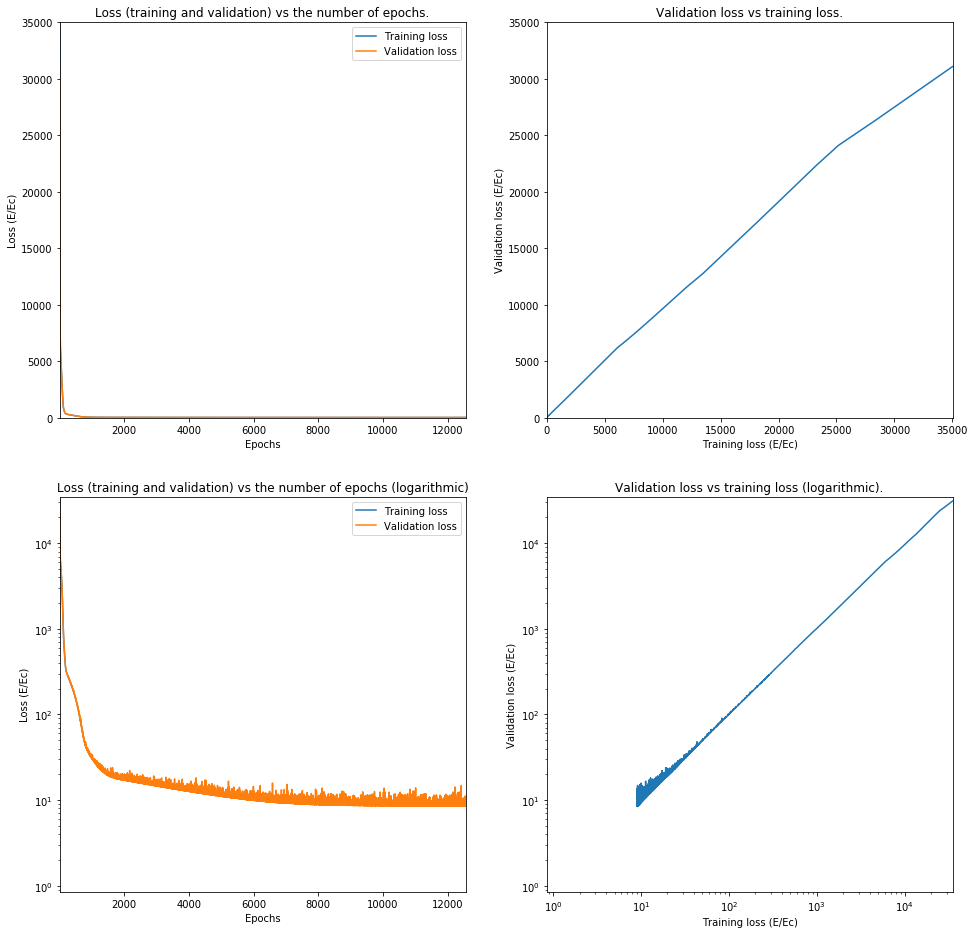

Train on 62644 samples, validate on 15662 samples
Epoch 1/20000
62644/62644 [==============================] - 2s 26us/step - loss: 155937.7626 - val_loss: 148032.2874
Epoch 2/20000
62644/62644 [==============================] - 2s 25us/step - loss: 137958.6532 - val_loss: 130188.2110
Epoch 3/20000
62644/62644 [==============================] - 2s 25us/step - loss: 120639.7987 - val_loss: 113304.7801
Epoch 4/20000
62644/62644 [==============================] - 2s 25us/step - loss: 104475.4969 - val_loss: 97771.1568
Epoch 5/20000
62644/62644 [==============================] - 2s 25us/step - loss: 89827.1713 - val_loss: 83893.8819
Epoch 6/20000
62644/62644 [==============================] - 2s 25us/step - loss: 77175.4483 - val_loss: 72147.8822
Epoch 7/20000
62644/62644 [==============================] - 2s 25us/step - loss: 66956.4651 - val_loss: 63327.0938
Epoch 8/20000
62644/62644 [==============================] - 2s 25us/step - loss: 59956.5634 - val_loss: 57548.1957
Epoch 9/20000
6

62644/62644 [==============================] - 2s 25us/step - loss: 107.4719 - val_loss: 108.9906
Epoch 144/20000
62644/62644 [==============================] - 2s 25us/step - loss: 106.7855 - val_loss: 108.7979
Epoch 145/20000
62644/62644 [==============================] - 2s 25us/step - loss: 106.3588 - val_loss: 107.6831
Epoch 146/20000
62644/62644 [==============================] - 2s 25us/step - loss: 105.8383 - val_loss: 107.6239
Epoch 147/20000
62644/62644 [==============================] - 2s 25us/step - loss: 105.3628 - val_loss: 106.7158
Epoch 148/20000
62644/62644 [==============================] - 2s 25us/step - loss: 104.9166 - val_loss: 106.4855
Epoch 149/20000
62644/62644 [==============================] - 2s 25us/step - loss: 104.5603 - val_loss: 108.9000
Epoch 150/20000
62644/62644 [==============================] - 2s 25us/step - loss: 104.0854 - val_loss: 105.3195
Epoch 151/20000
62644/62644 [==============================] - 2s 25us/step - loss: 103.5033 - val_loss:

Epoch 216/20000
62644/62644 [==============================] - 2s 25us/step - loss: 83.0455 - val_loss: 84.2011
Epoch 217/20000
62644/62644 [==============================] - 2s 25us/step - loss: 82.8112 - val_loss: 84.4512
Epoch 218/20000
62644/62644 [==============================] - 2s 25us/step - loss: 82.7128 - val_loss: 82.7876
Epoch 219/20000
62644/62644 [==============================] - 2s 25us/step - loss: 82.3984 - val_loss: 82.5545
Epoch 220/20000
62644/62644 [==============================] - 2s 25us/step - loss: 82.2053 - val_loss: 82.8191
Epoch 221/20000
62644/62644 [==============================] - 2s 25us/step - loss: 82.0926 - val_loss: 82.0337
Epoch 222/20000
62644/62644 [==============================] - 2s 25us/step - loss: 81.7055 - val_loss: 81.8716
Epoch 223/20000
62644/62644 [==============================] - 2s 25us/step - loss: 81.5661 - val_loss: 85.2042
Epoch 224/20000
62644/62644 [==============================] - 2s 25us/step - loss: 81.3059 - val_loss: 

62644/62644 [==============================] - 2s 25us/step - loss: 61.0141 - val_loss: 60.8569
Epoch 363/20000
62644/62644 [==============================] - 2s 25us/step - loss: 60.8686 - val_loss: 61.1515
Epoch 364/20000
62644/62644 [==============================] - 2s 25us/step - loss: 60.9446 - val_loss: 60.3797
Epoch 365/20000
62644/62644 [==============================] - 2s 25us/step - loss: 60.7357 - val_loss: 60.5544
Epoch 366/20000
62644/62644 [==============================] - 2s 25us/step - loss: 60.6784 - val_loss: 60.9049
Epoch 367/20000
62644/62644 [==============================] - 2s 25us/step - loss: 60.5666 - val_loss: 60.2259
Epoch 368/20000
62644/62644 [==============================] - 2s 25us/step - loss: 60.5591 - val_loss: 60.6248
Epoch 369/20000
62644/62644 [==============================] - 2s 26us/step - loss: 60.4335 - val_loss: 61.3705
Epoch 370/20000
62644/62644 [==============================] - 2s 25us/step - loss: 60.3270 - val_loss: 59.9064
Epoch 37

62644/62644 [==============================] - 2s 25us/step - loss: 49.6902 - val_loss: 51.0416
Epoch 509/20000
62644/62644 [==============================] - 2s 25us/step - loss: 49.7623 - val_loss: 49.0057
Epoch 510/20000
62644/62644 [==============================] - 2s 25us/step - loss: 49.6186 - val_loss: 49.0292
Epoch 511/20000
62644/62644 [==============================] - 2s 25us/step - loss: 49.5823 - val_loss: 49.1490
Epoch 512/20000
62644/62644 [==============================] - 2s 25us/step - loss: 49.6179 - val_loss: 49.4066
Epoch 513/20000
62644/62644 [==============================] - 2s 25us/step - loss: 49.4421 - val_loss: 49.1029
Epoch 514/20000
62644/62644 [==============================] - 2s 25us/step - loss: 49.2937 - val_loss: 49.7642
Epoch 515/20000
62644/62644 [==============================] - 2s 26us/step - loss: 49.3098 - val_loss: 49.1472
Epoch 516/20000
62644/62644 [==============================] - 2s 26us/step - loss: 49.3601 - val_loss: 48.9420
Epoch 51

62644/62644 [==============================] - 2s 25us/step - loss: 41.4677 - val_loss: 41.0615
Epoch 655/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.2449 - val_loss: 40.4947
Epoch 656/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.3552 - val_loss: 41.1379
Epoch 657/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.1167 - val_loss: 40.3228
Epoch 658/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.0766 - val_loss: 40.4307
Epoch 659/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.1383 - val_loss: 40.6710
Epoch 660/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.0386 - val_loss: 40.8234
Epoch 661/20000
62644/62644 [==============================] - 2s 25us/step - loss: 41.0239 - val_loss: 40.2595
Epoch 662/20000
62644/62644 [==============================] - 2s 25us/step - loss: 40.9592 - val_loss: 40.2095
Epoch 66

62644/62644 [==============================] - 2s 25us/step - loss: 34.5652 - val_loss: 33.7147
Epoch 801/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.5543 - val_loss: 33.8800
Epoch 802/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.5753 - val_loss: 33.8762
Epoch 803/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.4333 - val_loss: 33.8034
Epoch 804/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.5570 - val_loss: 33.6212
Epoch 805/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.4625 - val_loss: 33.8059
Epoch 806/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.3419 - val_loss: 33.3758
Epoch 807/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.3169 - val_loss: 33.8518
Epoch 808/20000
62644/62644 [==============================] - 2s 25us/step - loss: 34.3068 - val_loss: 33.4311
Epoch 80

62644/62644 [==============================] - 2s 25us/step - loss: 29.4864 - val_loss: 28.6962
Epoch 947/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.3672 - val_loss: 28.7695
Epoch 948/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.4107 - val_loss: 29.4733
Epoch 949/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.2830 - val_loss: 29.7968
Epoch 950/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.3286 - val_loss: 28.5522
Epoch 951/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.3421 - val_loss: 28.3083
Epoch 952/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.2785 - val_loss: 28.1941
Epoch 953/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.2913 - val_loss: 28.5156
Epoch 954/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29.0535 - val_loss: 28.2174
Epoch 95

62644/62644 [==============================] - 2s 25us/step - loss: 27.2881 - val_loss: 27.4050
Epoch 1020/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.4300 - val_loss: 26.9876
Epoch 1021/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.3778 - val_loss: 27.8012
Epoch 1022/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.3906 - val_loss: 26.6265
Epoch 1023/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.2911 - val_loss: 27.4354
Epoch 1024/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.3024 - val_loss: 29.1527
Epoch 1025/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.1795 - val_loss: 26.1177
Epoch 1026/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.1519 - val_loss: 26.1266
Epoch 1027/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27.1879 - val_loss: 26.3161


62644/62644 [==============================] - 2s 35us/step - loss: 24.1648 - val_loss: 23.2931
Epoch 1164/20000
62644/62644 [==============================] - 2s 36us/step - loss: 24.2608 - val_loss: 23.1693
Epoch 1165/20000
62644/62644 [==============================] - 2s 37us/step - loss: 24.1569 - val_loss: 24.6787
Epoch 1166/20000
62644/62644 [==============================] - 2s 37us/step - loss: 24.1695 - val_loss: 23.0907
Epoch 1167/20000
62644/62644 [==============================] - 2s 37us/step - loss: 24.0913 - val_loss: 24.0191
Epoch 1168/20000
62644/62644 [==============================] - 2s 36us/step - loss: 24.1113 - val_loss: 23.1933
Epoch 1169/20000
62644/62644 [==============================] - 2s 35us/step - loss: 24.1713 - val_loss: 24.0337
Epoch 1170/20000
62644/62644 [==============================] - 2s 36us/step - loss: 24.1197 - val_loss: 23.0632
Epoch 1171/20000
62644/62644 [==============================] - 2s 34us/step - loss: 24.0255 - val_loss: 23.0041


62644/62644 [==============================] - 2s 38us/step - loss: 21.8894 - val_loss: 21.4869
Epoch 1308/20000
62644/62644 [==============================] - 3s 41us/step - loss: 21.8759 - val_loss: 21.0468
Epoch 1309/20000
62644/62644 [==============================] - 3s 40us/step - loss: 21.9227 - val_loss: 21.2728
Epoch 1310/20000
62644/62644 [==============================] - 3s 41us/step - loss: 21.9153 - val_loss: 21.1629
Epoch 1311/20000
62644/62644 [==============================] - 2s 39us/step - loss: 21.8323 - val_loss: 22.6526
Epoch 1312/20000
62644/62644 [==============================] - 3s 40us/step - loss: 21.8093 - val_loss: 22.2189
Epoch 1313/20000
62644/62644 [==============================] - 3s 41us/step - loss: 21.9036 - val_loss: 21.7761
Epoch 1314/20000
62644/62644 [==============================] - 3s 41us/step - loss: 21.9298 - val_loss: 22.7066
Epoch 1315/20000
62644/62644 [==============================] - 2s 39us/step - loss: 21.8345 - val_loss: 22.1654


62644/62644 [==============================] - 2s 39us/step - loss: 20.5449 - val_loss: 19.8411
Epoch 1452/20000
62644/62644 [==============================] - 2s 38us/step - loss: 20.4477 - val_loss: 19.8421
Epoch 1453/20000
62644/62644 [==============================] - 2s 39us/step - loss: 20.5315 - val_loss: 20.1114
Epoch 1454/20000
62644/62644 [==============================] - 2s 38us/step - loss: 20.3904 - val_loss: 19.9822
Epoch 1455/20000
62644/62644 [==============================] - 2s 40us/step - loss: 20.5141 - val_loss: 21.7035
Epoch 1456/20000
62644/62644 [==============================] - 3s 42us/step - loss: 20.5214 - val_loss: 20.0758
Epoch 1457/20000
62644/62644 [==============================] - 3s 41us/step - loss: 20.4417 - val_loss: 19.7478
Epoch 1458/20000
62644/62644 [==============================] - 3s 43us/step - loss: 20.4441 - val_loss: 21.2914
Epoch 1459/20000
62644/62644 [==============================] - 2s 39us/step - loss: 20.4161 - val_loss: 19.8416


62644/62644 [==============================] - 2s 35us/step - loss: 19.6994 - val_loss: 19.8212
Epoch 1596/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.6991 - val_loss: 19.5404
Epoch 1597/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.6571 - val_loss: 19.3556
Epoch 1598/20000
62644/62644 [==============================] - 2s 35us/step - loss: 19.6853 - val_loss: 19.1582
Epoch 1599/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.5824 - val_loss: 19.2859
Epoch 1600/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.7330 - val_loss: 20.9229
Epoch 1601/20000
62644/62644 [==============================] - 2s 35us/step - loss: 19.6643 - val_loss: 18.9226
Epoch 1602/20000
62644/62644 [==============================] - 2s 35us/step - loss: 19.6677 - val_loss: 18.9985
Epoch 1603/20000
62644/62644 [==============================] - 2s 35us/step - loss: 19.6645 - val_loss: 18.9842


62644/62644 [==============================] - 2s 37us/step - loss: 19.2186 - val_loss: 19.8298
Epoch 1740/20000
62644/62644 [==============================] - 2s 35us/step - loss: 19.1985 - val_loss: 18.5626
Epoch 1741/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.1966 - val_loss: 18.5063
Epoch 1742/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.2163 - val_loss: 18.7971
Epoch 1743/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.1046 - val_loss: 20.7648
Epoch 1744/20000
62644/62644 [==============================] - 2s 37us/step - loss: 19.1149 - val_loss: 19.5943
Epoch 1745/20000
62644/62644 [==============================] - 2s 39us/step - loss: 19.1892 - val_loss: 19.0228
Epoch 1746/20000
62644/62644 [==============================] - 2s 37us/step - loss: 19.0755 - val_loss: 18.5821
Epoch 1747/20000
62644/62644 [==============================] - 2s 36us/step - loss: 19.0662 - val_loss: 19.4587


62644/62644 [==============================] - 2s 33us/step - loss: 18.6614 - val_loss: 18.7980
Epoch 1884/20000
62644/62644 [==============================] - 2s 32us/step - loss: 18.7537 - val_loss: 18.0609
Epoch 1885/20000
62644/62644 [==============================] - 2s 35us/step - loss: 18.6964 - val_loss: 18.7132
Epoch 1886/20000
62644/62644 [==============================] - 2s 34us/step - loss: 18.7832 - val_loss: 18.3784
Epoch 1887/20000
62644/62644 [==============================] - 2s 34us/step - loss: 18.7069 - val_loss: 18.7865
Epoch 1888/20000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6942 - val_loss: 18.3601
Epoch 1889/20000
62644/62644 [==============================] - 2s 33us/step - loss: 18.6756 - val_loss: 18.2421
Epoch 1890/20000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6449 - val_loss: 18.8072
Epoch 1891/20000
62644/62644 [==============================] - 2s 33us/step - loss: 18.6349 - val_loss: 18.1363


62644/62644 [==============================] - 2s 35us/step - loss: 18.2773 - val_loss: 23.6637
Epoch 2028/20000
62644/62644 [==============================] - 2s 34us/step - loss: 18.2076 - val_loss: 17.8356
Epoch 2029/20000
62644/62644 [==============================] - 2s 37us/step - loss: 18.2443 - val_loss: 17.6390
Epoch 2030/20000
62644/62644 [==============================] - 2s 36us/step - loss: 18.2575 - val_loss: 19.2302
Epoch 2031/20000
62644/62644 [==============================] - 2s 36us/step - loss: 18.3128 - val_loss: 17.7766
Epoch 2032/20000
62644/62644 [==============================] - 2s 36us/step - loss: 18.3367 - val_loss: 17.8723
Epoch 2033/20000
62644/62644 [==============================] - 2s 34us/step - loss: 18.3774 - val_loss: 17.6150
Epoch 2034/20000
62644/62644 [==============================] - 2s 34us/step - loss: 18.3033 - val_loss: 17.6284
Epoch 2035/20000
62644/62644 [==============================] - 2s 33us/step - loss: 18.2153 - val_loss: 17.6038


62644/62644 [==============================] - 2s 33us/step - loss: 17.7784 - val_loss: 17.2226
Epoch 2172/20000
62644/62644 [==============================] - 2s 33us/step - loss: 17.8805 - val_loss: 17.7609
Epoch 2173/20000
62644/62644 [==============================] - 2s 33us/step - loss: 17.9114 - val_loss: 17.3584
Epoch 2174/20000
62644/62644 [==============================] - 2s 33us/step - loss: 17.8956 - val_loss: 18.8915
Epoch 2175/20000
62644/62644 [==============================] - 2s 34us/step - loss: 17.8979 - val_loss: 17.6046
Epoch 2176/20000
62644/62644 [==============================] - 2s 36us/step - loss: 17.9173 - val_loss: 17.5385
Epoch 2177/20000
62644/62644 [==============================] - 2s 35us/step - loss: 17.8032 - val_loss: 18.6733
Epoch 2178/20000
62644/62644 [==============================] - 2s 35us/step - loss: 17.8616 - val_loss: 17.6871
Epoch 2179/20000
62644/62644 [==============================] - 2s 36us/step - loss: 17.8228 - val_loss: 18.4144


62644/62644 [==============================] - 2s 38us/step - loss: 17.4691 - val_loss: 17.9764
Epoch 2316/20000
62644/62644 [==============================] - 3s 43us/step - loss: 17.4289 - val_loss: 16.9996
Epoch 2317/20000
62644/62644 [==============================] - 3s 44us/step - loss: 17.4692 - val_loss: 18.1982
Epoch 2318/20000
62644/62644 [==============================] - 3s 42us/step - loss: 17.4653 - val_loss: 16.8220
Epoch 2319/20000
62644/62644 [==============================] - 3s 43us/step - loss: 17.5503 - val_loss: 18.6384
Epoch 2320/20000
62644/62644 [==============================] - 3s 47us/step - loss: 17.4499 - val_loss: 17.1547
Epoch 2321/20000
62644/62644 [==============================] - 3s 45us/step - loss: 17.3931 - val_loss: 17.0077
Epoch 2322/20000
62644/62644 [==============================] - 3s 43us/step - loss: 17.4324 - val_loss: 16.8693
Epoch 2323/20000
62644/62644 [==============================] - 2s 38us/step - loss: 17.4190 - val_loss: 17.3834


62644/62644 [==============================] - 3s 47us/step - loss: 17.1130 - val_loss: 16.5710
Epoch 2460/20000
62644/62644 [==============================] - 3s 41us/step - loss: 17.0263 - val_loss: 16.5962
Epoch 2461/20000
62644/62644 [==============================] - 3s 45us/step - loss: 17.0159 - val_loss: 16.5513
Epoch 2462/20000
62644/62644 [==============================] - 3s 41us/step - loss: 17.1627 - val_loss: 17.4834
Epoch 2463/20000
62644/62644 [==============================] - 3s 46us/step - loss: 17.0602 - val_loss: 17.6980
Epoch 2464/20000
62644/62644 [==============================] - 3s 42us/step - loss: 17.0873 - val_loss: 16.6673
Epoch 2465/20000
62644/62644 [==============================] - 3s 47us/step - loss: 17.0936 - val_loss: 16.8584
Epoch 2466/20000
62644/62644 [==============================] - 3s 43us/step - loss: 17.0382 - val_loss: 17.0639
Epoch 2467/20000
62644/62644 [==============================] - 3s 46us/step - loss: 17.0702 - val_loss: 17.2214


62644/62644 [==============================] - 2s 36us/step - loss: 16.7144 - val_loss: 16.3878
Epoch 2604/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.7933 - val_loss: 18.0817
Epoch 2605/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.8053 - val_loss: 17.4361
Epoch 2606/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.7073 - val_loss: 16.2307
Epoch 2607/20000
62644/62644 [==============================] - 2s 35us/step - loss: 16.6596 - val_loss: 16.1194
Epoch 2608/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.7433 - val_loss: 16.6976
Epoch 2609/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.7587 - val_loss: 16.0743
Epoch 2610/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.7193 - val_loss: 17.5026
Epoch 2611/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.6770 - val_loss: 16.1214


62644/62644 [==============================] - 2s 34us/step - loss: 16.3646 - val_loss: 16.4218
Epoch 2748/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.3886 - val_loss: 15.7294
Epoch 2749/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.3877 - val_loss: 15.9020
Epoch 2750/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.3296 - val_loss: 15.9034
Epoch 2751/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.3403 - val_loss: 16.1015
Epoch 2752/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.3153 - val_loss: 15.9005
Epoch 2753/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.3219 - val_loss: 16.9453
Epoch 2754/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.2775 - val_loss: 17.1861
Epoch 2755/20000
62644/62644 [==============================] - 2s 40us/step - loss: 16.3184 - val_loss: 15.7943


62644/62644 [==============================] - 2s 33us/step - loss: 16.0395 - val_loss: 15.5183
Epoch 2892/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.1047 - val_loss: 15.7238
Epoch 2893/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.0250 - val_loss: 15.5090
Epoch 2894/20000
62644/62644 [==============================] - 2s 33us/step - loss: 15.9508 - val_loss: 15.3982
Epoch 2895/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.0055 - val_loss: 16.8582
Epoch 2896/20000
62644/62644 [==============================] - 2s 33us/step - loss: 16.0028 - val_loss: 15.4036
Epoch 2897/20000
62644/62644 [==============================] - 2s 33us/step - loss: 15.9274 - val_loss: 16.2853
Epoch 2898/20000
62644/62644 [==============================] - 2s 34us/step - loss: 16.0303 - val_loss: 15.5199
Epoch 2899/20000
62644/62644 [==============================] - 2s 33us/step - loss: 15.9059 - val_loss: 15.3670


62644/62644 [==============================] - 2s 37us/step - loss: 15.6504 - val_loss: 15.0406
Epoch 3036/20000
62644/62644 [==============================] - 2s 36us/step - loss: 15.6753 - val_loss: 15.1894
Epoch 3037/20000
62644/62644 [==============================] - 2s 36us/step - loss: 15.5787 - val_loss: 16.8520
Epoch 3038/20000
62644/62644 [==============================] - 2s 32us/step - loss: 15.6289 - val_loss: 16.3616
Epoch 3039/20000
62644/62644 [==============================] - 2s 32us/step - loss: 15.6279 - val_loss: 15.8839
Epoch 3040/20000
62644/62644 [==============================] - 2s 33us/step - loss: 15.5392 - val_loss: 15.8527
Epoch 3041/20000
62644/62644 [==============================] - 2s 36us/step - loss: 15.7193 - val_loss: 16.7131
Epoch 3042/20000
62644/62644 [==============================] - 3s 41us/step - loss: 15.6750 - val_loss: 15.0475
Epoch 3043/20000
62644/62644 [==============================] - 3s 41us/step - loss: 15.6566 - val_loss: 16.2812


62644/62644 [==============================] - 2s 30us/step - loss: 15.3106 - val_loss: 14.9508
Epoch 3180/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2980 - val_loss: 14.8752
Epoch 3181/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.2830 - val_loss: 15.9011
Epoch 3182/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3225 - val_loss: 14.9813
Epoch 3183/20000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3614 - val_loss: 15.1560
Epoch 3184/20000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3097 - val_loss: 14.8529
Epoch 3185/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3802 - val_loss: 15.6871
Epoch 3186/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3355 - val_loss: 16.1230
Epoch 3187/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3897 - val_loss: 14.8682


62644/62644 [==============================] - 2s 30us/step - loss: 15.0239 - val_loss: 15.8213
Epoch 3324/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.9435 - val_loss: 14.5415
Epoch 3325/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.9444 - val_loss: 15.0118
Epoch 3326/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0142 - val_loss: 14.8455
Epoch 3327/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0487 - val_loss: 14.4365
Epoch 3328/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.9383 - val_loss: 14.6863
Epoch 3329/20000
62644/62644 [==============================] - 2s 31us/step - loss: 15.0149 - val_loss: 15.8477
Epoch 3330/20000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0068 - val_loss: 14.8382
Epoch 3331/20000
62644/62644 [==============================] - 2s 31us/step - loss: 15.0374 - val_loss: 15.2763


62644/62644 [==============================] - 2s 30us/step - loss: 14.7284 - val_loss: 14.0875
Epoch 3468/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.7620 - val_loss: 14.3685
Epoch 3469/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6659 - val_loss: 14.2512
Epoch 3470/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6126 - val_loss: 15.7316
Epoch 3471/20000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7627 - val_loss: 14.0865
Epoch 3472/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.6706 - val_loss: 14.0880
Epoch 3473/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.7622 - val_loss: 14.0941
Epoch 3474/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.6704 - val_loss: 14.3036
Epoch 3475/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.7176 - val_loss: 14.9620


62644/62644 [==============================] - 2s 30us/step - loss: 14.3371 - val_loss: 15.5474
Epoch 3612/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3913 - val_loss: 13.8950
Epoch 3613/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.4436 - val_loss: 14.8314
Epoch 3614/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.3854 - val_loss: 15.7120
Epoch 3615/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.3753 - val_loss: 13.9087
Epoch 3616/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.4122 - val_loss: 13.7752
Epoch 3617/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.3855 - val_loss: 13.7587
Epoch 3618/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.4672 - val_loss: 14.4986
Epoch 3619/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.4224 - val_loss: 13.7875


62644/62644 [==============================] - 2s 31us/step - loss: 14.1147 - val_loss: 13.8124
Epoch 3756/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0886 - val_loss: 13.5762
Epoch 3757/20000
62644/62644 [==============================] - 2s 32us/step - loss: 14.0255 - val_loss: 14.1296
Epoch 3758/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0902 - val_loss: 13.5110
Epoch 3759/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0902 - val_loss: 14.7348
Epoch 3760/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0814 - val_loss: 14.8835
Epoch 3761/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0552 - val_loss: 13.7297
Epoch 3762/20000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0635 - val_loss: 14.1191
Epoch 3763/20000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0783 - val_loss: 13.6450


62644/62644 [==============================] - 2s 31us/step - loss: 13.7952 - val_loss: 14.3964
Epoch 3900/20000
62644/62644 [==============================] - 2s 30us/step - loss: 13.7272 - val_loss: 13.5901
Epoch 3901/20000
62644/62644 [==============================] - 2s 31us/step - loss: 13.7638 - val_loss: 13.3376
Epoch 3902/20000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8599 - val_loss: 13.2273
Epoch 3903/20000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8536 - val_loss: 13.8315
Epoch 3904/20000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8373 - val_loss: 15.5964
Epoch 3905/20000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8558 - val_loss: 13.3421
Epoch 3906/20000
62644/62644 [==============================] - 2s 30us/step - loss: 13.7628 - val_loss: 13.5035
Epoch 3907/20000
62644/62644 [==============================] - 2s 31us/step - loss: 13.7745 - val_loss: 13.1930


62644/62644 [==============================] - 2s 26us/step - loss: 13.5195 - val_loss: 13.4976
Epoch 4044/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.5259 - val_loss: 13.0992
Epoch 4045/20000
62644/62644 [==============================] - 2s 31us/step - loss: 13.5486 - val_loss: 12.9468
Epoch 4046/20000
62644/62644 [==============================] - 2s 28us/step - loss: 13.5492 - val_loss: 13.0164
Epoch 4047/20000
62644/62644 [==============================] - 2s 29us/step - loss: 13.4604 - val_loss: 15.1318
Epoch 4048/20000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5574 - val_loss: 13.0514
Epoch 4049/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.4661 - val_loss: 13.0054
Epoch 4050/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.6126 - val_loss: 13.0201
Epoch 4051/20000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5124 - val_loss: 13.1846


62644/62644 [==============================] - 2s 26us/step - loss: 13.2951 - val_loss: 12.8647
Epoch 4188/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2721 - val_loss: 13.3680
Epoch 4189/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2985 - val_loss: 14.6292
Epoch 4190/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2693 - val_loss: 12.8865
Epoch 4191/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2556 - val_loss: 13.1676
Epoch 4192/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2860 - val_loss: 12.9699
Epoch 4193/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2705 - val_loss: 12.9106
Epoch 4194/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.1839 - val_loss: 12.7157
Epoch 4195/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.2233 - val_loss: 12.8131


62644/62644 [==============================] - 2s 28us/step - loss: 13.0568 - val_loss: 13.5124
Epoch 4332/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.0491 - val_loss: 12.3890
Epoch 4333/20000
62644/62644 [==============================] - 2s 27us/step - loss: 13.0217 - val_loss: 12.6463
Epoch 4334/20000
62644/62644 [==============================] - 2s 26us/step - loss: 13.0045 - val_loss: 12.4108
Epoch 4335/20000
62644/62644 [==============================] - 2s 28us/step - loss: 12.9132 - val_loss: 12.6663
Epoch 4336/20000
62644/62644 [==============================] - 2s 28us/step - loss: 13.0093 - val_loss: 12.4584
Epoch 4337/20000
62644/62644 [==============================] - 2s 27us/step - loss: 12.9726 - val_loss: 12.4787
Epoch 4338/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.9308 - val_loss: 12.4811
Epoch 4339/20000
62644/62644 [==============================] - 2s 27us/step - loss: 12.9992 - val_loss: 12.5110


62644/62644 [==============================] - 2s 25us/step - loss: 12.7577 - val_loss: 12.2714
Epoch 4476/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6800 - val_loss: 13.1497
Epoch 4477/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7562 - val_loss: 12.3394
Epoch 4478/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7577 - val_loss: 12.4758
Epoch 4479/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7273 - val_loss: 12.1384
Epoch 4480/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7443 - val_loss: 13.1864
Epoch 4481/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6874 - val_loss: 12.3374
Epoch 4482/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.8169 - val_loss: 12.4498
Epoch 4483/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7358 - val_loss: 13.1122


62644/62644 [==============================] - 2s 25us/step - loss: 12.5037 - val_loss: 12.2714
Epoch 4620/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5658 - val_loss: 12.3265
Epoch 4621/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5788 - val_loss: 12.0929
Epoch 4622/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.4701 - val_loss: 11.9530
Epoch 4623/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5124 - val_loss: 12.0527
Epoch 4624/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5264 - val_loss: 12.0377
Epoch 4625/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5114 - val_loss: 12.1020
Epoch 4626/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4726 - val_loss: 12.2214
Epoch 4627/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.5041 - val_loss: 11.9840


62644/62644 [==============================] - 2s 25us/step - loss: 12.3039 - val_loss: 12.1516
Epoch 4764/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2379 - val_loss: 12.5480
Epoch 4765/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.3500 - val_loss: 11.6978
Epoch 4766/20000
62644/62644 [==============================] - 2s 26us/step - loss: 12.2357 - val_loss: 11.8307
Epoch 4767/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2100 - val_loss: 11.8494
Epoch 4768/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.2711 - val_loss: 11.9945
Epoch 4769/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.3235 - val_loss: 11.6921
Epoch 4770/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2619 - val_loss: 11.8671
Epoch 4771/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2181 - val_loss: 11.8067


62644/62644 [==============================] - 2s 25us/step - loss: 12.0340 - val_loss: 11.7277
Epoch 4908/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0339 - val_loss: 11.5254
Epoch 4909/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0953 - val_loss: 11.6707
Epoch 4910/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.0632 - val_loss: 12.6075
Epoch 4911/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0436 - val_loss: 12.3718
Epoch 4912/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0147 - val_loss: 11.5140
Epoch 4913/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0439 - val_loss: 12.4624
Epoch 4914/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.9519 - val_loss: 12.6052
Epoch 4915/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1357 - val_loss: 13.2458


62644/62644 [==============================] - 2s 25us/step - loss: 11.8781 - val_loss: 11.8049
Epoch 5052/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7944 - val_loss: 11.5463
Epoch 5053/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8512 - val_loss: 13.7591
Epoch 5054/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8582 - val_loss: 11.4814
Epoch 5055/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8598 - val_loss: 13.2700
Epoch 5056/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8831 - val_loss: 11.3215
Epoch 5057/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8494 - val_loss: 11.4730
Epoch 5058/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8351 - val_loss: 11.4434
Epoch 5059/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7924 - val_loss: 11.3572


62644/62644 [==============================] - 2s 25us/step - loss: 11.7011 - val_loss: 11.2188
Epoch 5196/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6194 - val_loss: 11.1621
Epoch 5197/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.6424 - val_loss: 11.2171
Epoch 5198/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6955 - val_loss: 11.5621
Epoch 5199/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7125 - val_loss: 11.4575
Epoch 5200/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5965 - val_loss: 11.7366
Epoch 5201/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7031 - val_loss: 11.1003
Epoch 5202/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6511 - val_loss: 11.1331
Epoch 5203/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6467 - val_loss: 12.0402


62644/62644 [==============================] - 2s 25us/step - loss: 11.4306 - val_loss: 11.1145
Epoch 5340/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4413 - val_loss: 11.0237
Epoch 5341/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.4620 - val_loss: 12.5412
Epoch 5342/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.5172 - val_loss: 10.9886
Epoch 5343/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4056 - val_loss: 11.3854
Epoch 5344/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.4238 - val_loss: 12.2691
Epoch 5345/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4509 - val_loss: 11.3554
Epoch 5346/20000
62644/62644 [==============================] - 2s 24us/step - loss: 11.3703 - val_loss: 11.3578
Epoch 5347/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4289 - val_loss: 10.9951


62644/62644 [==============================] - 2s 25us/step - loss: 11.3075 - val_loss: 10.9864
Epoch 5484/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2828 - val_loss: 10.8491
Epoch 5485/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2670 - val_loss: 12.0934
Epoch 5486/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.3200 - val_loss: 10.9385
Epoch 5487/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2105 - val_loss: 10.7567
Epoch 5488/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2448 - val_loss: 11.2087
Epoch 5489/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2401 - val_loss: 10.8000
Epoch 5490/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2198 - val_loss: 10.7224
Epoch 5491/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.2228 - val_loss: 11.9527


62644/62644 [==============================] - 2s 25us/step - loss: 11.0555 - val_loss: 10.6288
Epoch 5628/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1753 - val_loss: 10.6422
Epoch 5629/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1329 - val_loss: 11.1540
Epoch 5630/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0450 - val_loss: 10.6360
Epoch 5631/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1101 - val_loss: 12.0020
Epoch 5632/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9956 - val_loss: 10.7865
Epoch 5633/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0635 - val_loss: 10.5273
Epoch 5634/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0322 - val_loss: 11.0529
Epoch 5635/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0689 - val_loss: 11.0589


62644/62644 [==============================] - 2s 26us/step - loss: 10.9532 - val_loss: 11.0636
Epoch 5772/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8530 - val_loss: 10.5695
Epoch 5773/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0157 - val_loss: 11.0220
Epoch 5774/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0159 - val_loss: 10.8680
Epoch 5775/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9089 - val_loss: 11.6051
Epoch 5776/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9210 - val_loss: 10.8388
Epoch 5777/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8825 - val_loss: 10.3560
Epoch 5778/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.8530 - val_loss: 10.6636
Epoch 5779/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0147 - val_loss: 10.8543


62644/62644 [==============================] - 2s 26us/step - loss: 10.7755 - val_loss: 10.3144
Epoch 5916/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7846 - val_loss: 10.2131
Epoch 5917/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7373 - val_loss: 10.5961
Epoch 5918/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7316 - val_loss: 10.2789
Epoch 5919/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8064 - val_loss: 10.3304
Epoch 5920/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6903 - val_loss: 10.3889
Epoch 5921/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.8508 - val_loss: 10.1970
Epoch 5922/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6658 - val_loss: 10.2304
Epoch 5923/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.7621 - val_loss: 11.6124


62644/62644 [==============================] - 2s 25us/step - loss: 10.6814 - val_loss: 10.3558
Epoch 6060/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6807 - val_loss: 10.2113
Epoch 6061/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5868 - val_loss: 10.9074
Epoch 6062/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5977 - val_loss: 10.1296
Epoch 6063/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5643 - val_loss: 11.0791
Epoch 6064/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6223 - val_loss: 10.8092
Epoch 6065/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6025 - val_loss: 10.2305
Epoch 6066/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.6628 - val_loss: 10.0642
Epoch 6067/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5905 - val_loss: 10.2209


62644/62644 [==============================] - 2s 26us/step - loss: 10.5204 - val_loss: 11.1822
Epoch 6204/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4953 - val_loss: 10.4009
Epoch 6205/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5109 - val_loss: 11.6119
Epoch 6206/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4571 - val_loss: 10.0642
Epoch 6207/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4684 - val_loss: 10.5121
Epoch 6208/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4155 - val_loss: 10.9513
Epoch 6209/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3802 - val_loss: 10.0080
Epoch 6210/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4718 - val_loss: 10.1101
Epoch 6211/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4818 - val_loss: 10.8489


Epoch 6276/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3684 - val_loss: 9.8665
Epoch 6277/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4574 - val_loss: 10.9257
Epoch 6278/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3875 - val_loss: 9.9134
Epoch 6279/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4181 - val_loss: 10.1370
Epoch 6280/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4268 - val_loss: 10.0580
Epoch 6281/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4313 - val_loss: 11.5355
Epoch 6282/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4760 - val_loss: 10.4779
Epoch 6283/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4222 - val_loss: 9.9477
Epoch 6284/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3820 - val_

Epoch 6421/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3128 - val_loss: 9.7731
Epoch 6422/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3288 - val_loss: 9.8690
Epoch 6423/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3702 - val_loss: 9.7858
Epoch 6424/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2412 - val_loss: 9.9628
Epoch 6425/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2541 - val_loss: 9.9230
Epoch 6426/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2596 - val_loss: 11.0446
Epoch 6427/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1948 - val_loss: 9.8608
Epoch 6428/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2891 - val_loss: 9.9099
Epoch 6429/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2342 - val_loss

Epoch 6494/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2019 - val_loss: 11.1760
Epoch 6495/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2262 - val_loss: 9.6956
Epoch 6496/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2111 - val_loss: 9.8354
Epoch 6497/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1941 - val_loss: 9.6927
Epoch 6498/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.3062 - val_loss: 10.0614
Epoch 6499/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2196 - val_loss: 12.6224
Epoch 6500/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2433 - val_loss: 10.9171
Epoch 6501/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2522 - val_loss: 9.6890
Epoch 6502/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1182 - val_l

Epoch 6567/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1565 - val_loss: 9.6751
Epoch 6568/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2372 - val_loss: 10.7978
Epoch 6569/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2086 - val_loss: 10.0328
Epoch 6570/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2383 - val_loss: 9.9761
Epoch 6571/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1347 - val_loss: 11.0525
Epoch 6572/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1841 - val_loss: 10.4229
Epoch 6573/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1594 - val_loss: 9.7592
Epoch 6574/20000
62644/62644 [==============================] - 2s 27us/step - loss: 10.2895 - val_loss: 10.0254
Epoch 6575/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2051 - val_

Epoch 6640/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0644 - val_loss: 10.0575
Epoch 6641/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.1497 - val_loss: 10.6913
Epoch 6642/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0784 - val_loss: 10.6597
Epoch 6643/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1529 - val_loss: 9.8523
Epoch 6644/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1617 - val_loss: 10.0218
Epoch 6645/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0753 - val_loss: 9.6457
Epoch 6646/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0908 - val_loss: 11.0658
Epoch 6647/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0726 - val_loss: 9.5956
Epoch 6648/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1531 - val_

Epoch 6713/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1459 - val_loss: 10.2535
Epoch 6714/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1706 - val_loss: 10.0232
Epoch 6715/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0245 - val_loss: 9.6565
Epoch 6716/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0498 - val_loss: 10.1011
Epoch 6717/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0897 - val_loss: 11.2445
Epoch 6718/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0774 - val_loss: 9.6221
Epoch 6719/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1565 - val_loss: 9.5484
Epoch 6720/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0587 - val_loss: 9.5370
Epoch 6721/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1011 - val_l

62644/62644 [==============================] - 2s 25us/step - loss: 9.9765 - val_loss: 9.7873
Epoch 6787/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9473 - val_loss: 10.8907
Epoch 6788/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0207 - val_loss: 10.8603
Epoch 6789/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0191 - val_loss: 9.4884
Epoch 6790/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0166 - val_loss: 9.8378
Epoch 6791/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.9895 - val_loss: 9.6493
Epoch 6792/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9709 - val_loss: 9.5002
Epoch 6793/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.0202 - val_loss: 10.2507
Epoch 6794/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9969 - val_loss: 9.5272
Epoch 6795/

62644/62644 [==============================] - 2s 25us/step - loss: 9.8990 - val_loss: 9.5017
Epoch 6933/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9068 - val_loss: 9.8817
Epoch 6934/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9369 - val_loss: 9.5693
Epoch 6935/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9206 - val_loss: 10.4833
Epoch 6936/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9059 - val_loss: 9.5100
Epoch 6937/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8771 - val_loss: 9.7668
Epoch 6938/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9500 - val_loss: 9.3695
Epoch 6939/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.9259 - val_loss: 9.3547
Epoch 6940/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9447 - val_loss: 9.3737
Epoch 6941/20000


Epoch 7006/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8714 - val_loss: 10.3290
Epoch 7007/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8924 - val_loss: 9.7232
Epoch 7008/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8350 - val_loss: 9.4815
Epoch 7009/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8961 - val_loss: 10.2374
Epoch 7010/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8327 - val_loss: 9.6314
Epoch 7011/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8180 - val_loss: 9.6027
Epoch 7012/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9205 - val_loss: 9.9222
Epoch 7013/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8745 - val_loss: 9.7753
Epoch 7014/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8752 - val_loss: 12.246

62644/62644 [==============================] - 2s 25us/step - loss: 9.7305 - val_loss: 9.3731
Epoch 7153/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8351 - val_loss: 9.4492
Epoch 7154/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7597 - val_loss: 9.5598
Epoch 7155/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8161 - val_loss: 9.9297
Epoch 7156/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7502 - val_loss: 9.2616
Epoch 7157/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8846 - val_loss: 9.2899
Epoch 7158/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8059 - val_loss: 9.3862
Epoch 7159/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8657 - val_loss: 11.2032
Epoch 7160/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8412 - val_loss: 9.2633
Epoch 7161/20000


Epoch 7226/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7208 - val_loss: 9.8589
Epoch 7227/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7860 - val_loss: 9.2668
Epoch 7228/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8041 - val_loss: 9.2922
Epoch 7229/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8223 - val_loss: 9.3252
Epoch 7230/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7462 - val_loss: 9.3597
Epoch 7231/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7662 - val_loss: 9.7001
Epoch 7232/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.8013 - val_loss: 11.0189
Epoch 7233/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8151 - val_loss: 9.1886
Epoch 7234/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6967 - val_loss: 10.2219

Epoch 7373/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6763 - val_loss: 9.3164
Epoch 7374/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6222 - val_loss: 9.2531
Epoch 7375/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6982 - val_loss: 9.8657
Epoch 7376/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6044 - val_loss: 9.1530
Epoch 7377/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6420 - val_loss: 10.0809
Epoch 7378/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6907 - val_loss: 9.1972
Epoch 7379/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6859 - val_loss: 10.3085
Epoch 7380/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6816 - val_loss: 9.5375
Epoch 7381/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7416 - val_loss: 9.3082

Epoch 7520/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7071 - val_loss: 10.7691
Epoch 7521/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5945 - val_loss: 9.1918
Epoch 7522/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5850 - val_loss: 9.2507
Epoch 7523/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6376 - val_loss: 9.2024
Epoch 7524/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5966 - val_loss: 9.0871
Epoch 7525/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6273 - val_loss: 9.2669
Epoch 7526/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6173 - val_loss: 9.1353
Epoch 7527/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6222 - val_loss: 9.1359
Epoch 7528/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5576 - val_loss: 9.5419


Epoch 7667/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5394 - val_loss: 9.0577
Epoch 7668/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5529 - val_loss: 9.0735
Epoch 7669/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5287 - val_loss: 9.3365
Epoch 7670/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6261 - val_loss: 9.2833
Epoch 7671/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5253 - val_loss: 9.0993
Epoch 7672/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6019 - val_loss: 9.3905
Epoch 7673/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5505 - val_loss: 9.8891
Epoch 7674/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6351 - val_loss: 9.1511
Epoch 7675/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5326 - val_loss: 9.4958
E

Epoch 7814/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4953 - val_loss: 8.9677
Epoch 7815/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4831 - val_loss: 9.5453
Epoch 7816/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5382 - val_loss: 9.5052
Epoch 7817/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5976 - val_loss: 10.0422
Epoch 7818/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5392 - val_loss: 9.0055
Epoch 7819/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5080 - val_loss: 8.9766
Epoch 7820/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5462 - val_loss: 10.0057
Epoch 7821/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4194 - val_loss: 9.2121
Epoch 7822/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4965 - val_loss: 11.772

Epoch 7961/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5221 - val_loss: 9.2098
Epoch 7962/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4198 - val_loss: 10.1317
Epoch 7963/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4621 - val_loss: 10.5662
Epoch 7964/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4664 - val_loss: 10.3528
Epoch 7965/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4448 - val_loss: 9.1874
Epoch 7966/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4415 - val_loss: 9.0513
Epoch 7967/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5426 - val_loss: 10.0924
Epoch 7968/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4237 - val_loss: 9.1934
Epoch 7969/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4574 - val_loss: 9.69

Epoch 8108/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3773 - val_loss: 10.0123
Epoch 8109/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4950 - val_loss: 9.5730
Epoch 8110/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3975 - val_loss: 9.1864
Epoch 8111/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4013 - val_loss: 9.2041
Epoch 8112/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4893 - val_loss: 8.8789
Epoch 8113/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4072 - val_loss: 10.4929
Epoch 8114/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4971 - val_loss: 9.7920
Epoch 8115/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4260 - val_loss: 9.1320
Epoch 8116/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4351 - val_loss: 9.4488

Epoch 8255/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4516 - val_loss: 8.9097
Epoch 8256/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3889 - val_loss: 9.0926
Epoch 8257/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4034 - val_loss: 8.9834
Epoch 8258/20000
62644/62644 [==============================] - 2s 24us/step - loss: 9.4286 - val_loss: 8.9195
Epoch 8259/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3921 - val_loss: 9.3770
Epoch 8260/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4710 - val_loss: 8.8734
Epoch 8261/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3714 - val_loss: 9.4348
Epoch 8262/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4457 - val_loss: 10.9005
Epoch 8263/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4249 - val_loss: 9.2430


Epoch 8402/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3454 - val_loss: 8.9778
Epoch 8403/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3654 - val_loss: 10.4186
Epoch 8404/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4109 - val_loss: 10.8280
Epoch 8405/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3625 - val_loss: 9.0206
Epoch 8406/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4001 - val_loss: 8.9621
Epoch 8407/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3616 - val_loss: 8.8400
Epoch 8408/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4375 - val_loss: 9.9108
Epoch 8409/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3432 - val_loss: 8.8530
Epoch 8410/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3704 - val_loss: 8.8722

Epoch 8549/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3087 - val_loss: 8.8878
Epoch 8550/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3640 - val_loss: 10.5806
Epoch 8551/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3392 - val_loss: 9.3284
Epoch 8552/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4005 - val_loss: 8.8660
Epoch 8553/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4031 - val_loss: 8.9160
Epoch 8554/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4116 - val_loss: 8.8072
Epoch 8555/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3239 - val_loss: 9.3385
Epoch 8556/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3512 - val_loss: 8.8635
Epoch 8557/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4021 - val_loss: 9.3711


Epoch 8696/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3199 - val_loss: 8.8663
Epoch 8697/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4019 - val_loss: 9.3121
Epoch 8698/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2462 - val_loss: 9.1954
Epoch 8699/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3595 - val_loss: 8.7955
Epoch 8700/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3163 - val_loss: 8.8271
Epoch 8701/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3240 - val_loss: 8.8310
Epoch 8702/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2762 - val_loss: 9.1075
Epoch 8703/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3706 - val_loss: 8.7603
Epoch 8704/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3399 - val_loss: 9.0918
E

Epoch 8843/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2907 - val_loss: 9.0029
Epoch 8844/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2576 - val_loss: 9.7526
Epoch 8845/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2953 - val_loss: 8.8140
Epoch 8846/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2518 - val_loss: 8.7934
Epoch 8847/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2930 - val_loss: 9.2614
Epoch 8848/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3280 - val_loss: 10.3147
Epoch 8849/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2976 - val_loss: 9.2215
Epoch 8850/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2935 - val_loss: 10.5764
Epoch 8851/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3527 - val_loss: 8.9204

Epoch 8990/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3619 - val_loss: 8.7184
Epoch 8991/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3047 - val_loss: 8.8487
Epoch 8992/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2821 - val_loss: 8.7652
Epoch 8993/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3461 - val_loss: 9.5474
Epoch 8994/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2189 - val_loss: 8.8247
Epoch 8995/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3009 - val_loss: 8.7499
Epoch 8996/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2565 - val_loss: 8.7221
Epoch 8997/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2862 - val_loss: 9.0905
Epoch 8998/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3141 - val_loss: 9.3936
E

Epoch 9137/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3931 - val_loss: 8.6909
Epoch 9138/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2116 - val_loss: 8.7797
Epoch 9139/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2578 - val_loss: 8.7031
Epoch 9140/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2920 - val_loss: 9.1657
Epoch 9141/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2563 - val_loss: 8.7208
Epoch 9142/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2118 - val_loss: 8.7336
Epoch 9143/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2732 - val_loss: 8.7017
Epoch 9144/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2178 - val_loss: 9.0253
Epoch 9145/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2867 - val_loss: 8.7155
E

Epoch 9284/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2198 - val_loss: 9.0221
Epoch 9285/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2928 - val_loss: 8.7117
Epoch 9286/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2333 - val_loss: 8.7635
Epoch 9287/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2929 - val_loss: 10.0249
Epoch 9288/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3302 - val_loss: 9.1438
Epoch 9289/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2237 - val_loss: 8.7651
Epoch 9290/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2301 - val_loss: 9.8313
Epoch 9291/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3304 - val_loss: 9.4153
Epoch 9292/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2355 - val_loss: 8.7015


Epoch 9431/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2830 - val_loss: 10.0381
Epoch 9432/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2544 - val_loss: 8.7557
Epoch 9433/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2205 - val_loss: 11.4982
Epoch 9434/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2968 - val_loss: 9.8759
Epoch 9435/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3685 - val_loss: 10.6507
Epoch 9436/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2273 - val_loss: 8.7742
Epoch 9437/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3086 - val_loss: 8.7587
Epoch 9438/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2581 - val_loss: 9.4974
Epoch 9439/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2490 - val_loss: 8.706

Epoch 9578/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2180 - val_loss: 8.7331
Epoch 9579/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2392 - val_loss: 8.7597
Epoch 9580/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2190 - val_loss: 9.6839
Epoch 9581/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2155 - val_loss: 8.6352
Epoch 9582/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2704 - val_loss: 9.1373
Epoch 9583/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2081 - val_loss: 8.7298
Epoch 9584/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2635 - val_loss: 8.6594
Epoch 9585/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2510 - val_loss: 9.0961
Epoch 9586/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2181 - val_loss: 9.0460
E

Epoch 9725/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1673 - val_loss: 8.6165
Epoch 9726/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3201 - val_loss: 8.7205
Epoch 9727/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2652 - val_loss: 9.0703
Epoch 9728/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1838 - val_loss: 8.7299
Epoch 9729/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1863 - val_loss: 8.6361
Epoch 9730/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2146 - val_loss: 9.4753
Epoch 9731/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2003 - val_loss: 9.1325
Epoch 9732/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2626 - val_loss: 8.7086
Epoch 9733/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2418 - val_loss: 9.6170
E

Epoch 9872/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2088 - val_loss: 8.5912
Epoch 9873/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2232 - val_loss: 9.4801
Epoch 9874/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2367 - val_loss: 9.3503
Epoch 9875/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2106 - val_loss: 9.1790
Epoch 9876/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2301 - val_loss: 8.8081
Epoch 9877/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1897 - val_loss: 9.3046
Epoch 9878/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1730 - val_loss: 8.8201
Epoch 9879/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2335 - val_loss: 8.9555
Epoch 9880/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2099 - val_loss: 8.9952
E

62644/62644 [==============================] - 2s 26us/step - loss: 9.2064 - val_loss: 9.6134
Epoch 10019/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2060 - val_loss: 9.4662
Epoch 10020/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2791 - val_loss: 8.7876
Epoch 10021/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2396 - val_loss: 9.6439
Epoch 10022/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2037 - val_loss: 8.8390
Epoch 10023/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2585 - val_loss: 9.3081
Epoch 10024/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1388 - val_loss: 8.6179
Epoch 10025/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1889 - val_loss: 8.5882
Epoch 10026/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2413 - val_loss: 9.0379
Epoch 1002

62644/62644 [==============================] - 2s 26us/step - loss: 9.1827 - val_loss: 8.7216
Epoch 10165/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1793 - val_loss: 9.9541
Epoch 10166/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1866 - val_loss: 9.3759
Epoch 10167/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1705 - val_loss: 8.8536
Epoch 10168/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2826 - val_loss: 8.9065
Epoch 10169/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2199 - val_loss: 8.6379
Epoch 10170/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2297 - val_loss: 9.3696
Epoch 10171/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1767 - val_loss: 8.6897
Epoch 10172/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1710 - val_loss: 10.4300
Epoch 101

62644/62644 [==============================] - 2s 27us/step - loss: 9.2269 - val_loss: 8.8768
Epoch 10311/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2290 - val_loss: 9.4702
Epoch 10312/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2710 - val_loss: 9.2972
Epoch 10313/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1387 - val_loss: 9.3050
Epoch 10314/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2646 - val_loss: 8.7983
Epoch 10315/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2057 - val_loss: 8.7029
Epoch 10316/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1857 - val_loss: 9.0498
Epoch 10317/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1944 - val_loss: 8.5817
Epoch 10318/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.2277 - val_loss: 9.0412
Epoch 1031

62644/62644 [==============================] - 2s 26us/step - loss: 9.1230 - val_loss: 9.3305
Epoch 10457/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1717 - val_loss: 8.7430
Epoch 10458/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1367 - val_loss: 10.4346
Epoch 10459/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1302 - val_loss: 8.5475
Epoch 10460/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1357 - val_loss: 8.9366
Epoch 10461/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2047 - val_loss: 8.7057
Epoch 10462/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1993 - val_loss: 9.0731
Epoch 10463/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1693 - val_loss: 8.7076
Epoch 10464/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1616 - val_loss: 8.5668
Epoch 104

62644/62644 [==============================] - 2s 26us/step - loss: 9.1970 - val_loss: 8.5664
Epoch 10603/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1801 - val_loss: 8.6290
Epoch 10604/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0930 - val_loss: 8.8283
Epoch 10605/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2815 - val_loss: 8.7352
Epoch 10606/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0669 - val_loss: 8.6686
Epoch 10607/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1677 - val_loss: 8.5331
Epoch 10608/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1407 - val_loss: 9.0411
Epoch 10609/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1795 - val_loss: 8.5799
Epoch 10610/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1811 - val_loss: 11.6490
Epoch 106

62644/62644 [==============================] - 2s 36us/step - loss: 9.1512 - val_loss: 8.6170
Epoch 10749/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2464 - val_loss: 8.5808
Epoch 10750/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1519 - val_loss: 8.6237
Epoch 10751/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2150 - val_loss: 8.8681
Epoch 10752/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1817 - val_loss: 9.1746
Epoch 10753/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2061 - val_loss: 8.8384
Epoch 10754/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1762 - val_loss: 9.2101
Epoch 10755/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1824 - val_loss: 9.3541
Epoch 10756/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1068 - val_loss: 8.5392
Epoch 1075

62644/62644 [==============================] - 2s 33us/step - loss: 9.1729 - val_loss: 8.7354
Epoch 10895/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2001 - val_loss: 9.6007
Epoch 10896/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1703 - val_loss: 8.7471
Epoch 10897/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1559 - val_loss: 8.6121
Epoch 10898/20000
62644/62644 [==============================] - 2s 35us/step - loss: 9.1868 - val_loss: 8.9663
Epoch 10899/20000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1961 - val_loss: 9.1487
Epoch 10900/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1602 - val_loss: 8.5786
Epoch 10901/20000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1513 - val_loss: 8.6138
Epoch 10902/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1443 - val_loss: 8.6072
Epoch 1090

62644/62644 [==============================] - 3s 42us/step - loss: 9.1835 - val_loss: 9.5875
Epoch 11041/20000
62644/62644 [==============================] - 3s 41us/step - loss: 9.1541 - val_loss: 8.6786
Epoch 11042/20000
62644/62644 [==============================] - 3s 43us/step - loss: 9.2259 - val_loss: 9.0553
Epoch 11043/20000
62644/62644 [==============================] - 3s 42us/step - loss: 9.1611 - val_loss: 8.7544
Epoch 11044/20000
62644/62644 [==============================] - 3s 42us/step - loss: 9.0905 - val_loss: 8.9924
Epoch 11045/20000
62644/62644 [==============================] - 3s 41us/step - loss: 9.1066 - val_loss: 9.2509
Epoch 11046/20000
62644/62644 [==============================] - 2s 40us/step - loss: 9.2004 - val_loss: 9.0598
Epoch 11047/20000
62644/62644 [==============================] - 3s 40us/step - loss: 9.1616 - val_loss: 8.6284
Epoch 11048/20000
62644/62644 [==============================] - 3s 40us/step - loss: 9.2194 - val_loss: 9.2371
Epoch 1104

62644/62644 [==============================] - 2s 30us/step - loss: 9.1755 - val_loss: 8.7181
Epoch 11187/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1628 - val_loss: 8.8643
Epoch 11188/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0987 - val_loss: 8.5951
Epoch 11189/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1721 - val_loss: 8.7322
Epoch 11190/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1701 - val_loss: 8.5435
Epoch 11191/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1342 - val_loss: 8.7027
Epoch 11192/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1624 - val_loss: 9.4305
Epoch 11193/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1629 - val_loss: 8.8402
Epoch 11194/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1180 - val_loss: 8.6602
Epoch 1119

62644/62644 [==============================] - 2s 26us/step - loss: 9.1814 - val_loss: 9.2216
Epoch 11333/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.0760 - val_loss: 9.1435
Epoch 11334/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1516 - val_loss: 8.6253
Epoch 11335/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2274 - val_loss: 8.5381
Epoch 11336/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1186 - val_loss: 9.0728
Epoch 11337/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1460 - val_loss: 8.6010
Epoch 11338/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1524 - val_loss: 9.0970
Epoch 11339/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2287 - val_loss: 10.5233
Epoch 11340/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1909 - val_loss: 8.6201
Epoch 113

62644/62644 [==============================] - 2s 29us/step - loss: 9.0497 - val_loss: 8.9112
Epoch 11479/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1026 - val_loss: 9.8877
Epoch 11480/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1938 - val_loss: 8.6595
Epoch 11481/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1573 - val_loss: 8.6312
Epoch 11482/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2292 - val_loss: 8.8162
Epoch 11483/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0931 - val_loss: 8.5320
Epoch 11484/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1589 - val_loss: 8.5859
Epoch 11485/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1694 - val_loss: 8.6418
Epoch 11486/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0931 - val_loss: 9.0245
Epoch 1148

62644/62644 [==============================] - 2s 29us/step - loss: 9.1096 - val_loss: 9.2389
Epoch 11625/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1800 - val_loss: 8.4927
Epoch 11626/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1163 - val_loss: 8.5711
Epoch 11627/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1373 - val_loss: 8.8333
Epoch 11628/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1393 - val_loss: 9.0617
Epoch 11629/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1306 - val_loss: 8.6518
Epoch 11630/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1622 - val_loss: 10.3093
Epoch 11631/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2048 - val_loss: 8.6072
Epoch 11632/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1687 - val_loss: 8.5746
Epoch 116

62644/62644 [==============================] - 2s 28us/step - loss: 9.1540 - val_loss: 8.5766
Epoch 11771/20000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2040 - val_loss: 9.0826
Epoch 11772/20000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1508 - val_loss: 8.5586
Epoch 11773/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1538 - val_loss: 9.7403
Epoch 11774/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0874 - val_loss: 8.6168
Epoch 11775/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1506 - val_loss: 8.5747
Epoch 11776/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1023 - val_loss: 11.8575
Epoch 11777/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1931 - val_loss: 8.7962
Epoch 11778/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1422 - val_loss: 8.6241
Epoch 117

62644/62644 [==============================] - 2s 31us/step - loss: 9.1131 - val_loss: 8.7307
Epoch 11917/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1784 - val_loss: 8.8080
Epoch 11918/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0719 - val_loss: 8.6175
Epoch 11919/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1194 - val_loss: 8.8505
Epoch 11920/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1168 - val_loss: 8.9540
Epoch 11921/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1633 - val_loss: 8.5880
Epoch 11922/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1043 - val_loss: 8.5041
Epoch 11923/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1661 - val_loss: 8.8145
Epoch 11924/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0764 - val_loss: 8.5657
Epoch 1192

62644/62644 [==============================] - 2s 25us/step - loss: 9.1816 - val_loss: 8.9821
Epoch 12063/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0857 - val_loss: 9.4354
Epoch 12064/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1137 - val_loss: 9.1055
Epoch 12065/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0943 - val_loss: 8.8084
Epoch 12066/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0808 - val_loss: 8.5701
Epoch 12067/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0887 - val_loss: 9.1433
Epoch 12068/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1365 - val_loss: 8.5587
Epoch 12069/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1494 - val_loss: 9.4429
Epoch 12070/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1903 - val_loss: 8.6234
Epoch 1207

62644/62644 [==============================] - 2s 25us/step - loss: 9.1448 - val_loss: 10.0718
Epoch 12209/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1270 - val_loss: 9.5048
Epoch 12210/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1422 - val_loss: 8.5776
Epoch 12211/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1275 - val_loss: 8.7072
Epoch 12212/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1013 - val_loss: 8.7754
Epoch 12213/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1154 - val_loss: 9.1083
Epoch 12214/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1165 - val_loss: 8.5177
Epoch 12215/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1700 - val_loss: 11.2507
Epoch 12216/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0985 - val_loss: 8.4892
Epoch 12

62644/62644 [==============================] - 2s 25us/step - loss: 9.1455 - val_loss: 9.5800
Epoch 12355/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0833 - val_loss: 8.6744
Epoch 12356/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0934 - val_loss: 8.5109
Epoch 12357/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0603 - val_loss: 9.7316
Epoch 12358/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1829 - val_loss: 8.6783
Epoch 12359/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0706 - val_loss: 8.5432
Epoch 12360/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0938 - val_loss: 8.4999
Epoch 12361/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0692 - val_loss: 9.5381
Epoch 12362/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1375 - val_loss: 8.8457
Epoch 1236

62644/62644 [==============================] - 2s 26us/step - loss: 9.1203 - val_loss: 8.7521
Epoch 12501/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1364 - val_loss: 8.6450
Epoch 12502/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0619 - val_loss: 8.6227
Epoch 12503/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1264 - val_loss: 8.5611
Epoch 12504/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1563 - val_loss: 9.4182
Epoch 12505/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1006 - val_loss: 8.5895
Epoch 12506/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0806 - val_loss: 8.6863
Epoch 12507/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0472 - val_loss: 8.5698
Epoch 12508/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1271 - val_loss: 8.4795
Epoch 1250

62644/62644 [==============================] - 2s 28us/step - loss: 9.1202 - val_loss: 8.6708
Epoch 12647/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0685 - val_loss: 8.5483
Epoch 12648/20000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1088 - val_loss: 8.4956
Epoch 12649/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1047 - val_loss: 9.6916
Epoch 12650/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0876 - val_loss: 10.6869
Epoch 12651/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0471 - val_loss: 8.8413
Epoch 12652/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1350 - val_loss: 8.5498
Epoch 12653/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1079 - val_loss: 8.5984
Epoch 12654/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0495 - val_loss: 8.6693
Epoch 126

62644/62644 [==============================] - 2s 28us/step - loss: 9.1364 - val_loss: 8.7233
Epoch 12793/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1092 - val_loss: 8.8135
Epoch 12794/20000
62644/62644 [==============================] - 2s 29us/step - loss: 9.1206 - val_loss: 9.9830
Epoch 12795/20000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0870 - val_loss: 8.7644
Epoch 12796/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1128 - val_loss: 8.5670
Epoch 12797/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.0500 - val_loss: 8.4852
Epoch 12798/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1191 - val_loss: 8.5477
Epoch 12799/20000
62644/62644 [==============================] - 2s 28us/step - loss: 9.1030 - val_loss: 8.5824
Epoch 12800/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1612 - val_loss: 8.5902
Epoch 1280

62644/62644 [==============================] - 2s 26us/step - loss: 9.0363 - val_loss: 9.6668
Epoch 12939/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1501 - val_loss: 8.6678
Epoch 12940/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1732 - val_loss: 9.6497
Epoch 12941/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1180 - val_loss: 8.7126
Epoch 12942/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1653 - val_loss: 10.6070
Epoch 12943/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0667 - val_loss: 8.7399
Epoch 12944/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0819 - val_loss: 8.7188
Epoch 12945/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1148 - val_loss: 9.3022
Epoch 12946/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0983 - val_loss: 8.7821
Epoch 129

62644/62644 [==============================] - 2s 25us/step - loss: 9.1117 - val_loss: 8.5634
Epoch 13085/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0124 - val_loss: 10.4119
Epoch 13086/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1719 - val_loss: 10.2265
Epoch 13087/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0682 - val_loss: 9.5189
Epoch 13088/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1393 - val_loss: 9.0886
Epoch 13089/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0465 - val_loss: 8.6670
Epoch 13090/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0961 - val_loss: 10.6940
Epoch 13091/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0690 - val_loss: 8.6731
Epoch 13092/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0598 - val_loss: 8.5365
Epoch 1

62644/62644 [==============================] - 2s 25us/step - loss: 9.1618 - val_loss: 8.8966
Epoch 13231/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0787 - val_loss: 8.6293
Epoch 13232/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1158 - val_loss: 8.5566
Epoch 13233/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1209 - val_loss: 8.5421
Epoch 13234/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0832 - val_loss: 9.9835
Epoch 13235/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0510 - val_loss: 9.1634
Epoch 13236/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1297 - val_loss: 8.4622
Epoch 13237/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0788 - val_loss: 8.4826
Epoch 13238/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0958 - val_loss: 8.5205
Epoch 1323

62644/62644 [==============================] - 2s 25us/step - loss: 9.0765 - val_loss: 8.5888
Epoch 13377/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1030 - val_loss: 8.9851
Epoch 13378/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1227 - val_loss: 11.7060
Epoch 13379/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1427 - val_loss: 11.3943
Epoch 13380/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0966 - val_loss: 8.4755
Epoch 13381/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1310 - val_loss: 8.7758
Epoch 13382/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1513 - val_loss: 8.5689
Epoch 13383/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0509 - val_loss: 8.9603
Epoch 13384/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1474 - val_loss: 8.5048
Epoch 13

62644/62644 [==============================] - 2s 25us/step - loss: 9.0815 - val_loss: 8.6693
Epoch 13523/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0710 - val_loss: 8.4330
Epoch 13524/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1089 - val_loss: 9.5810
Epoch 13525/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1830 - val_loss: 8.4335
Epoch 13526/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0834 - val_loss: 8.5086
Epoch 13527/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1317 - val_loss: 9.2639
Epoch 13528/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1341 - val_loss: 8.5732
Epoch 13529/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1152 - val_loss: 8.5485
Epoch 13530/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1369 - val_loss: 8.9599
Epoch 1353

62644/62644 [==============================] - 2s 25us/step - loss: 9.0496 - val_loss: 8.6092
Epoch 13669/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0666 - val_loss: 8.7902
Epoch 13670/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0859 - val_loss: 9.6956
Epoch 13671/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1067 - val_loss: 8.6047
Epoch 13672/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1049 - val_loss: 8.5246
Epoch 13673/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1220 - val_loss: 8.4629
Epoch 13674/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1017 - val_loss: 8.5599
Epoch 13675/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1190 - val_loss: 9.6431
Epoch 13676/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0480 - val_loss: 9.2956
Epoch 1367

62644/62644 [==============================] - 2s 25us/step - loss: 9.1226 - val_loss: 9.6347
Epoch 13815/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0847 - val_loss: 8.4781
Epoch 13816/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1377 - val_loss: 9.5806
Epoch 13817/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0653 - val_loss: 8.6922
Epoch 13818/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0247 - val_loss: 8.8857
Epoch 13819/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1798 - val_loss: 8.4765
Epoch 13820/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0923 - val_loss: 8.6277
Epoch 13821/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0710 - val_loss: 9.2520
Epoch 13822/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0468 - val_loss: 8.9795
Epoch 1382

62644/62644 [==============================] - 2s 26us/step - loss: 9.1778 - val_loss: 9.4737
Epoch 13961/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1452 - val_loss: 10.1012
Epoch 13962/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0400 - val_loss: 8.9249
Epoch 13963/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1350 - val_loss: 9.9803
Epoch 13964/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0796 - val_loss: 8.4873
Epoch 13965/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0938 - val_loss: 8.4432
Epoch 13966/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1559 - val_loss: 8.6837
Epoch 13967/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1791 - val_loss: 9.1066
Epoch 13968/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0305 - val_loss: 10.2016
Epoch 13

62644/62644 [==============================] - 2s 25us/step - loss: 9.0892 - val_loss: 8.7953
Epoch 14107/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1144 - val_loss: 8.7904
Epoch 14108/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0501 - val_loss: 8.4433
Epoch 14109/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0503 - val_loss: 9.0469
Epoch 14110/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0985 - val_loss: 8.6085
Epoch 14111/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0689 - val_loss: 10.5540
Epoch 14112/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1726 - val_loss: 8.4701
Epoch 14113/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1234 - val_loss: 9.8593
Epoch 14114/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1028 - val_loss: 8.7721
Epoch 141

62644/62644 [==============================] - 2s 25us/step - loss: 9.1091 - val_loss: 8.8089
Epoch 14253/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1174 - val_loss: 8.4967
Epoch 14254/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0812 - val_loss: 8.5781
Epoch 14255/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0765 - val_loss: 8.6199
Epoch 14256/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0586 - val_loss: 8.4277
Epoch 14257/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0972 - val_loss: 9.2840
Epoch 14258/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1376 - val_loss: 10.4283
Epoch 14259/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0345 - val_loss: 9.1201
Epoch 14260/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0677 - val_loss: 8.7906
Epoch 142

62644/62644 [==============================] - 2s 25us/step - loss: 8.9989 - val_loss: 8.4596
Epoch 14399/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0848 - val_loss: 8.4214
Epoch 14400/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0982 - val_loss: 9.3102
Epoch 14401/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0168 - val_loss: 8.4756
Epoch 14402/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2061 - val_loss: 9.8060
Epoch 14403/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1030 - val_loss: 9.5420
Epoch 14404/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1144 - val_loss: 8.6929
Epoch 14405/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0424 - val_loss: 9.0354
Epoch 14406/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1857 - val_loss: 8.5111
Epoch 1440

62644/62644 [==============================] - 2s 25us/step - loss: 9.0833 - val_loss: 8.4953
Epoch 14545/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0938 - val_loss: 8.8419
Epoch 14546/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0282 - val_loss: 9.3556
Epoch 14547/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0848 - val_loss: 8.6385
Epoch 14548/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0453 - val_loss: 9.5198
Epoch 14549/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0278 - val_loss: 8.9435
Epoch 14550/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0567 - val_loss: 8.7741
Epoch 14551/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0006 - val_loss: 8.4528
Epoch 14552/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0605 - val_loss: 8.4169
Epoch 1455

62644/62644 [==============================] - 2s 25us/step - loss: 9.0889 - val_loss: 8.5683
Epoch 14691/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1112 - val_loss: 10.3526
Epoch 14692/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0739 - val_loss: 8.5553
Epoch 14693/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0634 - val_loss: 8.5298
Epoch 14694/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0417 - val_loss: 8.4172
Epoch 14695/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1540 - val_loss: 8.4343
Epoch 14696/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0147 - val_loss: 8.5795
Epoch 14697/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1487 - val_loss: 9.0098
Epoch 14698/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0194 - val_loss: 9.3498
Epoch 146

62644/62644 [==============================] - 2s 25us/step - loss: 9.0498 - val_loss: 8.6015
Epoch 14837/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0632 - val_loss: 9.2320
Epoch 14838/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1012 - val_loss: 9.4957
Epoch 14839/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0738 - val_loss: 8.7299
Epoch 14840/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1031 - val_loss: 8.8752
Epoch 14841/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1339 - val_loss: 9.2166
Epoch 14842/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0542 - val_loss: 9.7713
Epoch 14843/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0347 - val_loss: 8.7940
Epoch 14844/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0855 - val_loss: 8.5614
Epoch 1484

62644/62644 [==============================] - 2s 25us/step - loss: 9.0298 - val_loss: 8.9650
Epoch 14983/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1080 - val_loss: 9.3253
Epoch 14984/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0771 - val_loss: 8.4197
Epoch 14985/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9925 - val_loss: 8.5715
Epoch 14986/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0434 - val_loss: 8.5270
Epoch 14987/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0507 - val_loss: 8.5037
Epoch 14988/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0702 - val_loss: 8.5197
Epoch 14989/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9943 - val_loss: 9.0178
Epoch 14990/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0859 - val_loss: 8.7667
Epoch 1499

62644/62644 [==============================] - 2s 25us/step - loss: 9.1635 - val_loss: 8.5030
Epoch 15129/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1209 - val_loss: 9.7844
Epoch 15130/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0400 - val_loss: 9.1167
Epoch 15131/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0957 - val_loss: 9.4200
Epoch 15132/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0545 - val_loss: 8.3857
Epoch 15133/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0346 - val_loss: 8.4496
Epoch 15134/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0879 - val_loss: 8.7606
Epoch 15135/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0319 - val_loss: 8.4242
Epoch 15136/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0742 - val_loss: 10.3354
Epoch 151

62644/62644 [==============================] - 2s 25us/step - loss: 9.1037 - val_loss: 8.5147
Epoch 15275/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9888 - val_loss: 9.2670
Epoch 15276/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0919 - val_loss: 8.6723
Epoch 15277/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0941 - val_loss: 9.3353
Epoch 15278/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0358 - val_loss: 8.6034
Epoch 15279/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1647 - val_loss: 8.9141
Epoch 15280/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0988 - val_loss: 10.9961
Epoch 15281/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0213 - val_loss: 8.4638
Epoch 15282/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0338 - val_loss: 8.3936
Epoch 152

62644/62644 [==============================] - 2s 25us/step - loss: 9.0151 - val_loss: 8.6633
Epoch 15421/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1176 - val_loss: 8.5143
Epoch 15422/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0206 - val_loss: 8.9571
Epoch 15423/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0824 - val_loss: 8.5914
Epoch 15424/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0668 - val_loss: 10.7731
Epoch 15425/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0736 - val_loss: 8.9658
Epoch 15426/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9966 - val_loss: 8.6886
Epoch 15427/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1361 - val_loss: 8.7205
Epoch 15428/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0601 - val_loss: 8.4777
Epoch 154

62644/62644 [==============================] - 2s 25us/step - loss: 9.1389 - val_loss: 10.3948
Epoch 15567/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0264 - val_loss: 9.0557
Epoch 15568/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1392 - val_loss: 8.4095
Epoch 15569/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1240 - val_loss: 8.7378
Epoch 15570/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0292 - val_loss: 9.6505
Epoch 15571/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0565 - val_loss: 8.4317
Epoch 15572/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1168 - val_loss: 9.0984
Epoch 15573/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0486 - val_loss: 8.5530
Epoch 15574/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1319 - val_loss: 9.1733
Epoch 155

62644/62644 [==============================] - 2s 26us/step - loss: 9.0950 - val_loss: 8.6543
Epoch 15713/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0625 - val_loss: 8.8113
Epoch 15714/20000
62644/62644 [==============================] - 2s 26us/step - loss: 8.9941 - val_loss: 8.4338
Epoch 15715/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0301 - val_loss: 9.8267
Epoch 15716/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0427 - val_loss: 8.7734
Epoch 15717/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0532 - val_loss: 9.9356
Epoch 15718/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0895 - val_loss: 8.4102
Epoch 15719/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0211 - val_loss: 8.6658
Epoch 15720/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0881 - val_loss: 8.3688
Epoch 1572

62644/62644 [==============================] - 2s 25us/step - loss: 9.1055 - val_loss: 8.9118
Epoch 15859/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0022 - val_loss: 11.9328
Epoch 15860/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0568 - val_loss: 8.5670
Epoch 15861/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0342 - val_loss: 10.4789
Epoch 15862/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0237 - val_loss: 8.7528
Epoch 15863/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0640 - val_loss: 8.8960
Epoch 15864/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0549 - val_loss: 8.4800
Epoch 15865/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0178 - val_loss: 8.8443
Epoch 15866/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0649 - val_loss: 8.7114
Epoch 15

62644/62644 [==============================] - 2s 25us/step - loss: 9.0180 - val_loss: 8.4122
Epoch 16005/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0553 - val_loss: 8.5898
Epoch 16006/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0460 - val_loss: 8.4405
Epoch 16007/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0326 - val_loss: 8.5916
Epoch 16008/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0785 - val_loss: 10.5743
Epoch 16009/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9807 - val_loss: 8.5888
Epoch 16010/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0248 - val_loss: 8.4350
Epoch 16011/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0497 - val_loss: 8.4678
Epoch 16012/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0101 - val_loss: 9.0949
Epoch 160

62644/62644 [==============================] - 2s 25us/step - loss: 9.0812 - val_loss: 10.4090
Epoch 16151/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0693 - val_loss: 8.4685
Epoch 16152/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0711 - val_loss: 8.7163
Epoch 16153/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0948 - val_loss: 8.7355
Epoch 16154/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0375 - val_loss: 8.7208
Epoch 16155/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0947 - val_loss: 8.4670
Epoch 16156/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0369 - val_loss: 8.4240
Epoch 16157/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0739 - val_loss: 8.5849
Epoch 16158/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0962 - val_loss: 8.5649
Epoch 161

62644/62644 [==============================] - 2s 25us/step - loss: 9.0259 - val_loss: 8.5976
Epoch 16297/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0666 - val_loss: 8.6217
Epoch 16298/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0779 - val_loss: 8.7098
Epoch 16299/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0122 - val_loss: 10.8352
Epoch 16300/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0198 - val_loss: 8.8562
Epoch 16301/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0093 - val_loss: 8.4077
Epoch 16302/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0494 - val_loss: 8.5397
Epoch 16303/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9814 - val_loss: 8.6065
Epoch 16304/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0454 - val_loss: 8.4942
Epoch 163

62644/62644 [==============================] - 2s 25us/step - loss: 8.9771 - val_loss: 8.9465
Epoch 16443/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9739 - val_loss: 10.8061
Epoch 16444/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9764 - val_loss: 8.7311
Epoch 16445/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0709 - val_loss: 8.8296
Epoch 16446/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9609 - val_loss: 8.4950
Epoch 16447/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1146 - val_loss: 8.5748
Epoch 16448/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1200 - val_loss: 8.8000
Epoch 16449/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0112 - val_loss: 8.6251
Epoch 16450/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9773 - val_loss: 8.6336
Epoch 164

62644/62644 [==============================] - 2s 25us/step - loss: 9.0386 - val_loss: 8.6796
Epoch 16589/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1440 - val_loss: 8.4052
Epoch 16590/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0241 - val_loss: 8.7441
Epoch 16591/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0818 - val_loss: 8.7748
Epoch 16592/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0575 - val_loss: 9.4841
Epoch 16593/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0276 - val_loss: 8.5095
Epoch 16594/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9723 - val_loss: 8.6722
Epoch 16595/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0419 - val_loss: 8.3833
Epoch 16596/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0274 - val_loss: 8.5104
Epoch 1659

62644/62644 [==============================] - 2s 25us/step - loss: 9.0187 - val_loss: 8.4355
Epoch 16735/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0415 - val_loss: 8.6997
Epoch 16736/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0467 - val_loss: 8.4820
Epoch 16737/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0025 - val_loss: 8.6937
Epoch 16738/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0422 - val_loss: 10.2659
Epoch 16739/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0069 - val_loss: 8.8622
Epoch 16740/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0144 - val_loss: 8.7773
Epoch 16741/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0705 - val_loss: 9.3004
Epoch 16742/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0120 - val_loss: 8.5650
Epoch 167

62644/62644 [==============================] - 2s 25us/step - loss: 8.9484 - val_loss: 8.4398
Epoch 16881/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9819 - val_loss: 9.3231
Epoch 16882/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0189 - val_loss: 10.9450
Epoch 16883/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1094 - val_loss: 8.5534
Epoch 16884/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0562 - val_loss: 9.6313
Epoch 16885/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0188 - val_loss: 11.8551
Epoch 16886/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1522 - val_loss: 9.1740
Epoch 16887/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0260 - val_loss: 8.3859
Epoch 16888/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0756 - val_loss: 10.4470
Epoch 1

62644/62644 [==============================] - 2s 25us/step - loss: 8.9927 - val_loss: 10.8007
Epoch 17027/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0122 - val_loss: 8.7033
Epoch 17028/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9947 - val_loss: 8.3565
Epoch 17029/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0005 - val_loss: 8.6139
Epoch 17030/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0242 - val_loss: 8.6331
Epoch 17031/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0322 - val_loss: 9.6391
Epoch 17032/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0488 - val_loss: 8.9450
Epoch 17033/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0335 - val_loss: 8.7696
Epoch 17034/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0503 - val_loss: 8.7606
Epoch 170

62644/62644 [==============================] - 2s 25us/step - loss: 9.0070 - val_loss: 8.6136
Epoch 17173/20000
62644/62644 [==============================] - 2s 24us/step - loss: 8.9794 - val_loss: 8.4443
Epoch 17174/20000
62644/62644 [==============================] - 2s 24us/step - loss: 9.0764 - val_loss: 8.5824
Epoch 17175/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0363 - val_loss: 8.3877
Epoch 17176/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0198 - val_loss: 8.3596
Epoch 17177/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0528 - val_loss: 9.3225
Epoch 17178/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0367 - val_loss: 9.0775
Epoch 17179/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0434 - val_loss: 8.5400
Epoch 17180/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9471 - val_loss: 8.4123
Epoch 1718

62644/62644 [==============================] - 2s 25us/step - loss: 9.0252 - val_loss: 8.4025
Epoch 17319/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0099 - val_loss: 8.7138
Epoch 17320/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0966 - val_loss: 8.9475
Epoch 17321/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0165 - val_loss: 8.7496
Epoch 17322/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0750 - val_loss: 8.4487
Epoch 17323/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1453 - val_loss: 9.1025
Epoch 17324/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0526 - val_loss: 8.3614
Epoch 17325/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0719 - val_loss: 8.9921
Epoch 17326/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0342 - val_loss: 8.4380
Epoch 1732

62644/62644 [==============================] - 2s 25us/step - loss: 8.9960 - val_loss: 8.3526
Epoch 17465/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0183 - val_loss: 8.6672
Epoch 17466/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1039 - val_loss: 8.5514
Epoch 17467/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9485 - val_loss: 8.5901
Epoch 17468/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0203 - val_loss: 9.4302
Epoch 17469/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0341 - val_loss: 8.5207
Epoch 17470/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0139 - val_loss: 9.5671
Epoch 17471/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0790 - val_loss: 8.6819
Epoch 17472/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0265 - val_loss: 8.3984
Epoch 1747

62644/62644 [==============================] - 2s 25us/step - loss: 9.0708 - val_loss: 8.3728
Epoch 17611/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0035 - val_loss: 9.2650
Epoch 17612/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9509 - val_loss: 8.3740
Epoch 17613/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0639 - val_loss: 8.6699
Epoch 17614/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0759 - val_loss: 8.9733
Epoch 17615/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8.9950 - val_loss: 9.5305
Epoch 17616/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0556 - val_loss: 9.1481
Epoch 17617/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0444 - val_loss: 8.3547
Epoch 17618/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0868 - val_loss: 8.4955
Epoch 1761

62644/62644 [==============================] - 2s 27us/step - loss: 9.0638 - val_loss: 8.5961
Epoch 17757/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0705 - val_loss: 8.6119
Epoch 17758/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0551 - val_loss: 8.5001
Epoch 17759/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0829 - val_loss: 10.5136
Epoch 17760/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0326 - val_loss: 14.1462
Epoch 17761/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0546 - val_loss: 10.5475
Epoch 17762/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0590 - val_loss: 8.4748
Epoch 17763/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0393 - val_loss: 9.0796
Epoch 17764/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0522 - val_loss: 8.5128
Epoch 1

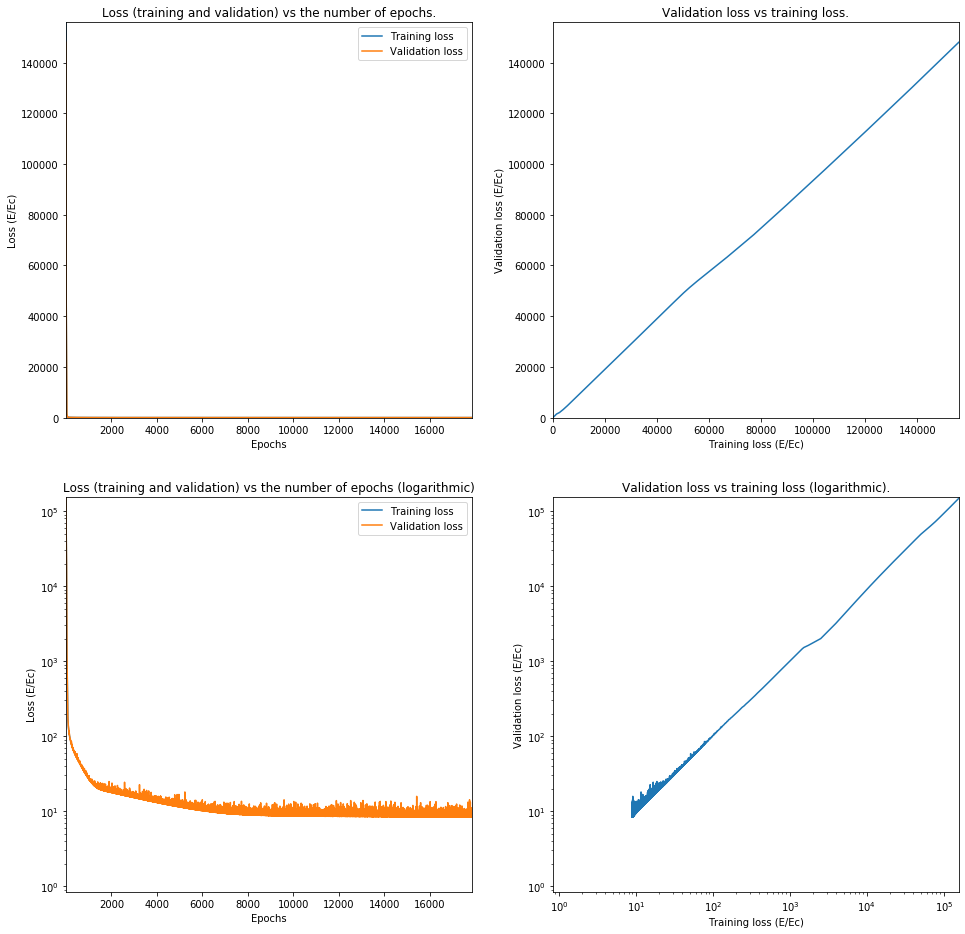

Train on 62644 samples, validate on 15662 samples
Epoch 1/20000
62644/62644 [==============================] - 2s 26us/step - loss: 54573.2185 - val_loss: 49794.9265
Epoch 2/20000
62644/62644 [==============================] - 2s 24us/step - loss: 45358.4995 - val_loss: 42085.3800
Epoch 3/20000
62644/62644 [==============================] - 2s 24us/step - loss: 39072.4120 - val_loss: 36987.6099
Epoch 4/20000
62644/62644 [==============================] - 2s 24us/step - loss: 35088.9457 - val_loss: 33787.8864
Epoch 5/20000
62644/62644 [==============================] - 2s 25us/step - loss: 32563.8812 - val_loss: 31660.8212
Epoch 6/20000
62644/62644 [==============================] - 2s 25us/step - loss: 30734.3707 - val_loss: 30016.8764
Epoch 7/20000
62644/62644 [==============================] - 2s 25us/step - loss: 29176.2547 - val_loss: 28516.0288
Epoch 8/20000
62644/62644 [==============================] - 2s 25us/step - loss: 27704.6002 - val_loss: 27060.8140
Epoch 9/20000
62644/62

62644/62644 [==============================] - 2s 26us/step - loss: 3151.8938 - val_loss: 3161.7218
Epoch 143/20000
62644/62644 [==============================] - 2s 28us/step - loss: 3112.5895 - val_loss: 3122.8968
Epoch 144/20000
62644/62644 [==============================] - 2s 27us/step - loss: 3073.2777 - val_loss: 3084.9958
Epoch 145/20000
62644/62644 [==============================] - 2s 24us/step - loss: 3034.1377 - val_loss: 3044.8636
Epoch 146/20000
62644/62644 [==============================] - 2s 24us/step - loss: 2994.4717 - val_loss: 3005.4956
Epoch 147/20000
62644/62644 [==============================] - 2s 24us/step - loss: 2955.2870 - val_loss: 2967.3500
Epoch 148/20000
62644/62644 [==============================] - 2s 25us/step - loss: 2916.5788 - val_loss: 2927.8512
Epoch 149/20000
62644/62644 [==============================] - 2s 24us/step - loss: 2878.3138 - val_loss: 2889.6651
Epoch 150/20000
62644/62644 [==============================] - 2s 24us/step - loss: 2839

Epoch 213/20000
62644/62644 [==============================] - 2s 25us/step - loss: 1002.5154 - val_loss: 1017.8129
Epoch 214/20000
62644/62644 [==============================] - 2s 24us/step - loss: 988.3657 - val_loss: 1006.6389
Epoch 215/20000
62644/62644 [==============================] - 2s 25us/step - loss: 974.5634 - val_loss: 989.5449
Epoch 216/20000
62644/62644 [==============================] - 2s 24us/step - loss: 960.8036 - val_loss: 975.3381
Epoch 217/20000
62644/62644 [==============================] - 2s 24us/step - loss: 947.3388 - val_loss: 961.7615
Epoch 218/20000
62644/62644 [==============================] - 2s 24us/step - loss: 933.8794 - val_loss: 948.3249
Epoch 219/20000
62644/62644 [==============================] - 2s 24us/step - loss: 920.9789 - val_loss: 936.0648
Epoch 220/20000
62644/62644 [==============================] - 2s 24us/step - loss: 907.9941 - val_loss: 923.9204
Epoch 221/20000
62644/62644 [==============================] - 2s 25us/step - loss: 8

Epoch 285/20000
62644/62644 [==============================] - 2s 25us/step - loss: 447.6217 - val_loss: 453.0101
Epoch 286/20000
62644/62644 [==============================] - 2s 24us/step - loss: 445.2294 - val_loss: 452.2272
Epoch 287/20000
62644/62644 [==============================] - 2s 24us/step - loss: 443.0222 - val_loss: 448.0263
Epoch 288/20000
62644/62644 [==============================] - 2s 24us/step - loss: 440.9756 - val_loss: 446.1055
Epoch 289/20000
62644/62644 [==============================] - 2s 26us/step - loss: 438.7683 - val_loss: 443.6601
Epoch 290/20000
62644/62644 [==============================] - 2s 26us/step - loss: 436.5976 - val_loss: 445.1680
Epoch 291/20000
62644/62644 [==============================] - 2s 26us/step - loss: 435.0920 - val_loss: 439.7302
Epoch 292/20000
62644/62644 [==============================] - 2s 25us/step - loss: 432.9381 - val_loss: 437.9780
Epoch 293/20000
62644/62644 [==============================] - 2s 24us/step - loss: 431.

Epoch 357/20000
62644/62644 [==============================] - 2s 24us/step - loss: 380.9645 - val_loss: 385.2863
Epoch 358/20000
62644/62644 [==============================] - 2s 24us/step - loss: 380.4379 - val_loss: 385.1578
Epoch 359/20000
62644/62644 [==============================] - 2s 24us/step - loss: 379.9413 - val_loss: 386.3792
Epoch 360/20000
62644/62644 [==============================] - 2s 25us/step - loss: 379.3899 - val_loss: 383.3322
Epoch 361/20000
62644/62644 [==============================] - 2s 25us/step - loss: 378.7212 - val_loss: 385.5105
Epoch 362/20000
62644/62644 [==============================] - 2s 24us/step - loss: 378.1340 - val_loss: 382.2588
Epoch 363/20000
62644/62644 [==============================] - 2s 25us/step - loss: 377.7370 - val_loss: 382.0685
Epoch 364/20000
62644/62644 [==============================] - 2s 24us/step - loss: 377.4013 - val_loss: 380.9764
Epoch 365/20000
62644/62644 [==============================] - 2s 24us/step - loss: 376.

Epoch 429/20000
62644/62644 [==============================] - 2s 24us/step - loss: 341.7596 - val_loss: 345.6615
Epoch 430/20000
62644/62644 [==============================] - 2s 24us/step - loss: 341.4929 - val_loss: 344.9512
Epoch 431/20000
62644/62644 [==============================] - 2s 24us/step - loss: 340.5741 - val_loss: 344.6264
Epoch 432/20000
62644/62644 [==============================] - 2s 24us/step - loss: 340.3440 - val_loss: 343.8567
Epoch 433/20000
62644/62644 [==============================] - 2s 24us/step - loss: 339.6257 - val_loss: 343.1725
Epoch 434/20000
62644/62644 [==============================] - 2s 24us/step - loss: 339.0660 - val_loss: 345.3843
Epoch 435/20000
62644/62644 [==============================] - 2s 24us/step - loss: 338.6932 - val_loss: 342.8771
Epoch 436/20000
62644/62644 [==============================] - 2s 24us/step - loss: 338.0338 - val_loss: 341.8432
Epoch 437/20000
62644/62644 [==============================] - 2s 24us/step - loss: 337.

Epoch 501/20000
62644/62644 [==============================] - 2s 24us/step - loss: 303.3648 - val_loss: 306.4884
Epoch 502/20000
62644/62644 [==============================] - 2s 24us/step - loss: 302.6925 - val_loss: 305.7949
Epoch 503/20000
62644/62644 [==============================] - 2s 25us/step - loss: 302.2576 - val_loss: 309.3233
Epoch 504/20000
62644/62644 [==============================] - 2s 24us/step - loss: 301.7331 - val_loss: 304.5746
Epoch 505/20000
62644/62644 [==============================] - 2s 24us/step - loss: 301.0146 - val_loss: 305.8068
Epoch 506/20000
62644/62644 [==============================] - 2s 24us/step - loss: 300.6163 - val_loss: 304.6662
Epoch 507/20000
62644/62644 [==============================] - 2s 24us/step - loss: 299.9456 - val_loss: 303.1363
Epoch 508/20000
62644/62644 [==============================] - 2s 24us/step - loss: 299.4453 - val_loss: 302.8005
Epoch 509/20000
62644/62644 [==============================] - 2s 24us/step - loss: 298.

Epoch 573/20000
62644/62644 [==============================] - 2s 24us/step - loss: 265.0551 - val_loss: 267.8766
Epoch 574/20000
62644/62644 [==============================] - 2s 24us/step - loss: 264.6115 - val_loss: 267.5579
Epoch 575/20000
62644/62644 [==============================] - 2s 24us/step - loss: 263.8593 - val_loss: 267.7856
Epoch 576/20000
62644/62644 [==============================] - 2s 24us/step - loss: 263.6318 - val_loss: 266.7294
Epoch 577/20000
62644/62644 [==============================] - 2s 24us/step - loss: 262.8351 - val_loss: 266.2060
Epoch 578/20000
62644/62644 [==============================] - 2s 24us/step - loss: 262.6043 - val_loss: 265.0210
Epoch 579/20000
62644/62644 [==============================] - 2s 25us/step - loss: 261.9630 - val_loss: 264.7567
Epoch 580/20000
62644/62644 [==============================] - 2s 24us/step - loss: 261.4457 - val_loss: 263.9941
Epoch 581/20000
62644/62644 [==============================] - 2s 24us/step - loss: 260.

Epoch 645/20000
62644/62644 [==============================] - 2s 25us/step - loss: 227.4549 - val_loss: 229.6865
Epoch 646/20000
62644/62644 [==============================] - 2s 24us/step - loss: 227.0311 - val_loss: 229.1701
Epoch 647/20000
62644/62644 [==============================] - 2s 24us/step - loss: 226.3756 - val_loss: 229.9612
Epoch 648/20000
62644/62644 [==============================] - 2s 25us/step - loss: 225.9947 - val_loss: 228.4433
Epoch 649/20000
62644/62644 [==============================] - 2s 24us/step - loss: 225.3307 - val_loss: 227.6797
Epoch 650/20000
62644/62644 [==============================] - 2s 24us/step - loss: 224.8745 - val_loss: 226.9972
Epoch 651/20000
62644/62644 [==============================] - 2s 24us/step - loss: 224.3918 - val_loss: 226.4892
Epoch 652/20000
62644/62644 [==============================] - 2s 24us/step - loss: 223.7168 - val_loss: 226.6445
Epoch 653/20000
62644/62644 [==============================] - 2s 25us/step - loss: 223.

Epoch 717/20000
62644/62644 [==============================] - 2s 24us/step - loss: 190.1499 - val_loss: 192.1224
Epoch 718/20000
62644/62644 [==============================] - 2s 24us/step - loss: 189.7732 - val_loss: 191.5180
Epoch 719/20000
62644/62644 [==============================] - 2s 24us/step - loss: 189.2553 - val_loss: 192.4346
Epoch 720/20000
62644/62644 [==============================] - 2s 24us/step - loss: 188.7977 - val_loss: 190.8001
Epoch 721/20000
62644/62644 [==============================] - 2s 24us/step - loss: 188.2908 - val_loss: 189.9376
Epoch 722/20000
62644/62644 [==============================] - 2s 24us/step - loss: 187.8512 - val_loss: 190.1547
Epoch 723/20000
62644/62644 [==============================] - 2s 24us/step - loss: 187.3646 - val_loss: 189.3186
Epoch 724/20000
62644/62644 [==============================] - 2s 24us/step - loss: 186.7425 - val_loss: 188.4274
Epoch 725/20000
62644/62644 [==============================] - 2s 24us/step - loss: 186.

Epoch 789/20000
62644/62644 [==============================] - 2s 24us/step - loss: 154.2510 - val_loss: 156.8807
Epoch 790/20000
62644/62644 [==============================] - 2s 24us/step - loss: 153.8526 - val_loss: 157.0474
Epoch 791/20000
62644/62644 [==============================] - 2s 24us/step - loss: 153.0882 - val_loss: 154.8537
Epoch 792/20000
62644/62644 [==============================] - 2s 24us/step - loss: 152.6113 - val_loss: 153.9738
Epoch 793/20000
62644/62644 [==============================] - 2s 25us/step - loss: 152.1833 - val_loss: 153.4961
Epoch 794/20000
62644/62644 [==============================] - 2s 25us/step - loss: 151.5374 - val_loss: 157.1421
Epoch 795/20000
62644/62644 [==============================] - 2s 24us/step - loss: 151.2165 - val_loss: 153.7088
Epoch 796/20000
62644/62644 [==============================] - 2s 24us/step - loss: 150.7604 - val_loss: 152.1630
Epoch 797/20000
62644/62644 [==============================] - 2s 24us/step - loss: 150.

Epoch 861/20000
62644/62644 [==============================] - 2s 24us/step - loss: 119.4491 - val_loss: 119.9340
Epoch 862/20000
62644/62644 [==============================] - 2s 24us/step - loss: 118.8627 - val_loss: 120.4755
Epoch 863/20000
62644/62644 [==============================] - 2s 24us/step - loss: 118.5500 - val_loss: 119.1312
Epoch 864/20000
62644/62644 [==============================] - 2s 24us/step - loss: 118.0026 - val_loss: 119.9813
Epoch 865/20000
62644/62644 [==============================] - 2s 24us/step - loss: 117.5576 - val_loss: 118.7362
Epoch 866/20000
62644/62644 [==============================] - 2s 24us/step - loss: 117.0452 - val_loss: 117.6124
Epoch 867/20000
62644/62644 [==============================] - 2s 24us/step - loss: 116.6300 - val_loss: 117.2645
Epoch 868/20000
62644/62644 [==============================] - 2s 24us/step - loss: 116.2229 - val_loss: 117.0467
Epoch 869/20000
62644/62644 [==============================] - 2s 24us/step - loss: 115.

62644/62644 [==============================] - 2s 24us/step - loss: 58.2955 - val_loss: 58.1289
Epoch 1007/20000
62644/62644 [==============================] - 2s 24us/step - loss: 57.8855 - val_loss: 59.6503
Epoch 1008/20000
62644/62644 [==============================] - 2s 24us/step - loss: 57.6579 - val_loss: 57.1285
Epoch 1009/20000
62644/62644 [==============================] - 2s 25us/step - loss: 57.2704 - val_loss: 56.7895
Epoch 1010/20000
62644/62644 [==============================] - 2s 25us/step - loss: 56.9315 - val_loss: 56.2251
Epoch 1011/20000
62644/62644 [==============================] - 2s 24us/step - loss: 56.6026 - val_loss: 58.2600
Epoch 1012/20000
62644/62644 [==============================] - 2s 24us/step - loss: 56.2552 - val_loss: 55.5225
Epoch 1013/20000
62644/62644 [==============================] - 2s 24us/step - loss: 55.8875 - val_loss: 55.9022
Epoch 1014/20000
62644/62644 [==============================] - 2s 24us/step - loss: 55.5070 - val_loss: 54.8109


62644/62644 [==============================] - 2s 24us/step - loss: 28.4605 - val_loss: 27.8240
Epoch 1151/20000
62644/62644 [==============================] - 2s 24us/step - loss: 28.4437 - val_loss: 27.7736
Epoch 1152/20000
62644/62644 [==============================] - 2s 25us/step - loss: 28.3861 - val_loss: 27.6358
Epoch 1153/20000
62644/62644 [==============================] - 2s 25us/step - loss: 28.1651 - val_loss: 27.5771
Epoch 1154/20000
62644/62644 [==============================] - 2s 24us/step - loss: 28.2955 - val_loss: 27.5478
Epoch 1155/20000
62644/62644 [==============================] - 2s 24us/step - loss: 28.0567 - val_loss: 27.3839
Epoch 1156/20000
62644/62644 [==============================] - 2s 24us/step - loss: 27.8999 - val_loss: 28.0415
Epoch 1157/20000
62644/62644 [==============================] - 2s 24us/step - loss: 27.9636 - val_loss: 27.5938
Epoch 1158/20000
62644/62644 [==============================] - 2s 24us/step - loss: 27.8681 - val_loss: 27.3247


62644/62644 [==============================] - 2s 24us/step - loss: 21.6534 - val_loss: 21.6435
Epoch 1295/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.7381 - val_loss: 22.4961
Epoch 1296/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.6517 - val_loss: 21.1509
Epoch 1297/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.5920 - val_loss: 21.6236
Epoch 1298/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.5823 - val_loss: 21.6122
Epoch 1299/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.6930 - val_loss: 20.9073
Epoch 1300/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.5298 - val_loss: 21.1281
Epoch 1301/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.4263 - val_loss: 21.5812
Epoch 1302/20000
62644/62644 [==============================] - 2s 24us/step - loss: 21.5715 - val_loss: 20.9394


62644/62644 [==============================] - 2s 24us/step - loss: 19.3813 - val_loss: 18.7166
Epoch 1439/20000
62644/62644 [==============================] - 2s 24us/step - loss: 19.3358 - val_loss: 19.3329
Epoch 1440/20000
62644/62644 [==============================] - 2s 24us/step - loss: 19.4259 - val_loss: 18.7415
Epoch 1441/20000
62644/62644 [==============================] - 2s 24us/step - loss: 19.3682 - val_loss: 18.7336
Epoch 1442/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.4066 - val_loss: 19.7668
Epoch 1443/20000
62644/62644 [==============================] - 2s 24us/step - loss: 19.3106 - val_loss: 18.9875
Epoch 1444/20000
62644/62644 [==============================] - 2s 24us/step - loss: 19.4014 - val_loss: 20.5944
Epoch 1445/20000
62644/62644 [==============================] - 2s 24us/step - loss: 19.3378 - val_loss: 20.6530
Epoch 1446/20000
62644/62644 [==============================] - 2s 25us/step - loss: 19.3228 - val_loss: 19.3733


62644/62644 [==============================] - 2s 25us/step - loss: 18.2020 - val_loss: 17.6905
Epoch 1583/20000
62644/62644 [==============================] - 2s 25us/step - loss: 18.0994 - val_loss: 17.5100
Epoch 1584/20000
62644/62644 [==============================] - 2s 24us/step - loss: 18.1682 - val_loss: 18.1796
Epoch 1585/20000
62644/62644 [==============================] - 2s 24us/step - loss: 18.1192 - val_loss: 18.3343
Epoch 1586/20000
62644/62644 [==============================] - 2s 24us/step - loss: 18.1079 - val_loss: 17.7961
Epoch 1587/20000
62644/62644 [==============================] - 2s 24us/step - loss: 18.1088 - val_loss: 17.4928
Epoch 1588/20000
62644/62644 [==============================] - 2s 24us/step - loss: 18.1500 - val_loss: 17.8363
Epoch 1589/20000
62644/62644 [==============================] - 2s 24us/step - loss: 18.0626 - val_loss: 17.3759
Epoch 1590/20000
62644/62644 [==============================] - 2s 24us/step - loss: 18.1120 - val_loss: 17.7433


62644/62644 [==============================] - 2s 24us/step - loss: 17.4754 - val_loss: 16.7233
Epoch 1727/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.3346 - val_loss: 16.8646
Epoch 1728/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.3186 - val_loss: 16.7969
Epoch 1729/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.3780 - val_loss: 19.6217
Epoch 1730/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.3586 - val_loss: 16.7592
Epoch 1731/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.3334 - val_loss: 16.7160
Epoch 1732/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.2679 - val_loss: 16.5702
Epoch 1733/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.2832 - val_loss: 16.6752
Epoch 1734/20000
62644/62644 [==============================] - 2s 24us/step - loss: 17.3013 - val_loss: 17.1276


62644/62644 [==============================] - 2s 24us/step - loss: 16.7482 - val_loss: 16.0644
Epoch 1871/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.7416 - val_loss: 15.9808
Epoch 1872/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.6587 - val_loss: 16.7102
Epoch 1873/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.7340 - val_loss: 16.0867
Epoch 1874/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.7071 - val_loss: 17.3133
Epoch 1875/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6912 - val_loss: 15.9315
Epoch 1876/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.7377 - val_loss: 16.0470
Epoch 1877/20000
62644/62644 [==============================] - 2s 25us/step - loss: 16.6655 - val_loss: 19.6567
Epoch 1878/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.6672 - val_loss: 16.3768


62644/62644 [==============================] - 2s 24us/step - loss: 16.2598 - val_loss: 15.8100
Epoch 2015/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.2873 - val_loss: 15.8503
Epoch 2016/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.1824 - val_loss: 15.6854
Epoch 2017/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.1969 - val_loss: 16.6420
Epoch 2018/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.2442 - val_loss: 16.4338
Epoch 2019/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.2369 - val_loss: 15.4285
Epoch 2020/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.2375 - val_loss: 16.1006
Epoch 2021/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.2067 - val_loss: 18.9796
Epoch 2022/20000
62644/62644 [==============================] - 2s 24us/step - loss: 16.2587 - val_loss: 16.4130


62644/62644 [==============================] - 2s 24us/step - loss: 15.8104 - val_loss: 15.0193
Epoch 2159/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.8572 - val_loss: 14.9814
Epoch 2160/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.7893 - val_loss: 15.2797
Epoch 2161/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.7564 - val_loss: 15.2438
Epoch 2162/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.8042 - val_loss: 14.9782
Epoch 2163/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.7962 - val_loss: 14.9440
Epoch 2164/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.8179 - val_loss: 14.9797
Epoch 2165/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.9058 - val_loss: 15.0920
Epoch 2166/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.7310 - val_loss: 15.2571


62644/62644 [==============================] - 2s 25us/step - loss: 15.4618 - val_loss: 14.7128
Epoch 2303/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.5339 - val_loss: 14.7016
Epoch 2304/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.4289 - val_loss: 15.7250
Epoch 2305/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.4683 - val_loss: 14.8117
Epoch 2306/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.4703 - val_loss: 15.7020
Epoch 2307/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.4096 - val_loss: 15.2766
Epoch 2308/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.4800 - val_loss: 14.5894
Epoch 2309/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.3649 - val_loss: 14.6788
Epoch 2310/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.4698 - val_loss: 15.2223


62644/62644 [==============================] - 2s 25us/step - loss: 15.0888 - val_loss: 14.6059
Epoch 2447/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.1166 - val_loss: 16.9309
Epoch 2448/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.0186 - val_loss: 14.2558
Epoch 2449/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.0535 - val_loss: 15.4216
Epoch 2450/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.1360 - val_loss: 14.4797
Epoch 2451/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.1378 - val_loss: 14.8157
Epoch 2452/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.0568 - val_loss: 15.8978
Epoch 2453/20000
62644/62644 [==============================] - 2s 25us/step - loss: 15.0911 - val_loss: 14.8019
Epoch 2454/20000
62644/62644 [==============================] - 2s 24us/step - loss: 15.0444 - val_loss: 15.0596


62644/62644 [==============================] - 2s 26us/step - loss: 14.8000 - val_loss: 13.9876
Epoch 2591/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8243 - val_loss: 15.4461
Epoch 2592/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8300 - val_loss: 14.9748
Epoch 2593/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.7505 - val_loss: 16.0869
Epoch 2594/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8139 - val_loss: 13.9766
Epoch 2595/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8880 - val_loss: 13.9715
Epoch 2596/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.7579 - val_loss: 14.5079
Epoch 2597/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8112 - val_loss: 13.9763
Epoch 2598/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.7456 - val_loss: 19.2051


62644/62644 [==============================] - 2s 24us/step - loss: 14.5148 - val_loss: 13.6454
Epoch 2735/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.5225 - val_loss: 14.1048
Epoch 2736/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.5799 - val_loss: 13.7196
Epoch 2737/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.6217 - val_loss: 14.2558
Epoch 2738/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.5471 - val_loss: 14.6295
Epoch 2739/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.5405 - val_loss: 14.3648
Epoch 2740/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.4756 - val_loss: 13.6367
Epoch 2741/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.5189 - val_loss: 13.9938
Epoch 2742/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4803 - val_loss: 16.0826


62644/62644 [==============================] - 2s 25us/step - loss: 14.2935 - val_loss: 13.5251
Epoch 2879/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.2628 - val_loss: 13.5190
Epoch 2880/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.1940 - val_loss: 14.8150
Epoch 2881/20000
62644/62644 [==============================] - 2s 24us/step - loss: 14.3103 - val_loss: 13.3541
Epoch 2882/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.2091 - val_loss: 13.9625
Epoch 2883/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.2681 - val_loss: 13.6574
Epoch 2884/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.2033 - val_loss: 13.7626
Epoch 2885/20000
62644/62644 [==============================] - 2s 26us/step - loss: 14.2137 - val_loss: 13.5416
Epoch 2886/20000
62644/62644 [==============================] - 2s 25us/step - loss: 14.2218 - val_loss: 13.4424


62644/62644 [==============================] - 2s 25us/step - loss: 14.0044 - val_loss: 13.5964
Epoch 3023/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.9779 - val_loss: 14.2210
Epoch 3024/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.9425 - val_loss: 13.2798
Epoch 3025/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.9910 - val_loss: 15.3161
Epoch 3026/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.9271 - val_loss: 15.0468
Epoch 3027/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.9873 - val_loss: 13.1880
Epoch 3028/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.9602 - val_loss: 13.4525
Epoch 3029/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.9212 - val_loss: 13.1573
Epoch 3030/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.9698 - val_loss: 13.7547


62644/62644 [==============================] - 2s 24us/step - loss: 13.6319 - val_loss: 13.1895
Epoch 3167/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.6884 - val_loss: 13.3023
Epoch 3168/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.7134 - val_loss: 13.0652
Epoch 3169/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.6426 - val_loss: 13.0011
Epoch 3170/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.6316 - val_loss: 14.4064
Epoch 3171/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.6838 - val_loss: 12.8981
Epoch 3172/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.7247 - val_loss: 13.1753
Epoch 3173/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.7018 - val_loss: 12.8222
Epoch 3174/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.6704 - val_loss: 14.2622


62644/62644 [==============================] - 2s 24us/step - loss: 13.4265 - val_loss: 17.1105
Epoch 3311/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.4752 - val_loss: 15.5773
Epoch 3312/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.4666 - val_loss: 13.0557
Epoch 3313/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.3886 - val_loss: 12.5715
Epoch 3314/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.4951 - val_loss: 13.1969
Epoch 3315/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.4393 - val_loss: 13.0822
Epoch 3316/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4506 - val_loss: 13.4034
Epoch 3317/20000
62644/62644 [==============================] - 2s 25us/step - loss: 13.4820 - val_loss: 13.2110
Epoch 3318/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.4227 - val_loss: 14.3460


62644/62644 [==============================] - 2s 24us/step - loss: 13.2099 - val_loss: 12.4459
Epoch 3455/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.1952 - val_loss: 12.3239
Epoch 3456/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.1389 - val_loss: 12.3633
Epoch 3457/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.2051 - val_loss: 12.4046
Epoch 3458/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.1238 - val_loss: 12.4436
Epoch 3459/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.1753 - val_loss: 12.8362
Epoch 3460/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.1719 - val_loss: 12.5169
Epoch 3461/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.1500 - val_loss: 12.3259
Epoch 3462/20000
62644/62644 [==============================] - 2s 24us/step - loss: 13.1567 - val_loss: 12.3539


62644/62644 [==============================] - 2s 24us/step - loss: 12.9261 - val_loss: 12.9454
Epoch 3599/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.9822 - val_loss: 12.3569
Epoch 3600/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.8696 - val_loss: 12.6555
Epoch 3601/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.8771 - val_loss: 12.6598
Epoch 3602/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.9571 - val_loss: 12.9486
Epoch 3603/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.9014 - val_loss: 12.6461
Epoch 3604/20000
62644/62644 [==============================] - 2s 24us/step - loss: 12.8813 - val_loss: 12.4262
Epoch 3605/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.8868 - val_loss: 12.1701
Epoch 3606/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.9381 - val_loss: 12.6149


62644/62644 [==============================] - 2s 25us/step - loss: 12.7104 - val_loss: 12.4796
Epoch 3743/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7862 - val_loss: 12.0072
Epoch 3744/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7140 - val_loss: 11.9596
Epoch 3745/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6381 - val_loss: 13.1028
Epoch 3746/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7820 - val_loss: 11.9064
Epoch 3747/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6850 - val_loss: 12.0000
Epoch 3748/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.7378 - val_loss: 12.3057
Epoch 3749/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6995 - val_loss: 12.0209
Epoch 3750/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.6336 - val_loss: 12.2653


62644/62644 [==============================] - 2s 25us/step - loss: 12.3727 - val_loss: 14.0699
Epoch 3887/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4285 - val_loss: 11.7616
Epoch 3888/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4730 - val_loss: 11.7717
Epoch 3889/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4855 - val_loss: 11.6718
Epoch 3890/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4795 - val_loss: 11.8829
Epoch 3891/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4667 - val_loss: 12.1767
Epoch 3892/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4959 - val_loss: 11.7490
Epoch 3893/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4506 - val_loss: 11.6966
Epoch 3894/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.4536 - val_loss: 12.7365


62644/62644 [==============================] - 2s 25us/step - loss: 12.2879 - val_loss: 11.7211
Epoch 4031/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2116 - val_loss: 12.6311
Epoch 4032/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.3268 - val_loss: 11.7318
Epoch 4033/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2550 - val_loss: 11.5350
Epoch 4034/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2848 - val_loss: 12.3824
Epoch 4035/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.3727 - val_loss: 11.4933
Epoch 4036/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2727 - val_loss: 15.4293
Epoch 4037/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2461 - val_loss: 11.7721
Epoch 4038/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.2305 - val_loss: 14.0298


62644/62644 [==============================] - 2s 25us/step - loss: 12.0381 - val_loss: 11.8754
Epoch 4175/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1771 - val_loss: 11.4435
Epoch 4176/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0152 - val_loss: 11.3725
Epoch 4177/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0680 - val_loss: 11.3965
Epoch 4178/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0175 - val_loss: 11.7107
Epoch 4179/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.1265 - val_loss: 11.2996
Epoch 4180/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0233 - val_loss: 11.3061
Epoch 4181/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0096 - val_loss: 11.2561
Epoch 4182/20000
62644/62644 [==============================] - 2s 25us/step - loss: 12.0936 - val_loss: 11.2996


62644/62644 [==============================] - 2s 25us/step - loss: 11.8653 - val_loss: 12.1224
Epoch 4319/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8310 - val_loss: 11.1560
Epoch 4320/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8123 - val_loss: 11.4582
Epoch 4321/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8367 - val_loss: 11.4199
Epoch 4322/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8459 - val_loss: 11.1713
Epoch 4323/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7838 - val_loss: 11.1768
Epoch 4324/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8752 - val_loss: 11.1691
Epoch 4325/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8613 - val_loss: 12.2297
Epoch 4326/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.8033 - val_loss: 11.2982


62644/62644 [==============================] - 2s 26us/step - loss: 11.6917 - val_loss: 11.4407
Epoch 4463/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.6932 - val_loss: 10.9715
Epoch 4464/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6396 - val_loss: 10.9931
Epoch 4465/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.6700 - val_loss: 11.0466
Epoch 4466/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6326 - val_loss: 10.8625
Epoch 4467/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7210 - val_loss: 10.9391
Epoch 4468/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.7540 - val_loss: 11.3098
Epoch 4469/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6405 - val_loss: 11.0383
Epoch 4470/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.6708 - val_loss: 13.6500


62644/62644 [==============================] - 2s 25us/step - loss: 11.4836 - val_loss: 11.1348
Epoch 4607/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5246 - val_loss: 10.7490
Epoch 4608/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4724 - val_loss: 10.8366
Epoch 4609/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4934 - val_loss: 11.5574
Epoch 4610/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4823 - val_loss: 13.2268
Epoch 4611/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4400 - val_loss: 10.8659
Epoch 4612/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5262 - val_loss: 10.9119
Epoch 4613/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.4804 - val_loss: 10.9911
Epoch 4614/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.5508 - val_loss: 10.8008


62644/62644 [==============================] - 2s 26us/step - loss: 11.2979 - val_loss: 11.1922
Epoch 4751/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3744 - val_loss: 11.9687
Epoch 4752/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3216 - val_loss: 10.6989
Epoch 4753/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2650 - val_loss: 10.5946
Epoch 4754/20000
62644/62644 [==============================] - 2s 27us/step - loss: 11.2971 - val_loss: 10.8471
Epoch 4755/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.4076 - val_loss: 10.6439
Epoch 4756/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3406 - val_loss: 11.9700
Epoch 4757/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.3449 - val_loss: 10.5530
Epoch 4758/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.2861 - val_loss: 10.7334


62644/62644 [==============================] - 2s 25us/step - loss: 11.2420 - val_loss: 10.5458
Epoch 4895/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1695 - val_loss: 10.4526
Epoch 4896/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1801 - val_loss: 10.8986
Epoch 4897/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1569 - val_loss: 11.2791
Epoch 4898/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1759 - val_loss: 11.2191
Epoch 4899/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1258 - val_loss: 10.8636
Epoch 4900/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1680 - val_loss: 10.3804
Epoch 4901/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1327 - val_loss: 11.2111
Epoch 4902/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.1376 - val_loss: 11.0819


62644/62644 [==============================] - 2s 25us/step - loss: 10.9490 - val_loss: 10.3662
Epoch 5039/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9492 - val_loss: 10.6274
Epoch 5040/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9696 - val_loss: 11.7672
Epoch 5041/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0192 - val_loss: 10.9223
Epoch 5042/20000
62644/62644 [==============================] - 2s 25us/step - loss: 11.0088 - val_loss: 10.7199
Epoch 5043/20000
62644/62644 [==============================] - 2s 26us/step - loss: 11.0563 - val_loss: 10.2847
Epoch 5044/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9594 - val_loss: 10.2847
Epoch 5045/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9564 - val_loss: 11.0658
Epoch 5046/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.9556 - val_loss: 10.3878


62644/62644 [==============================] - 2s 25us/step - loss: 10.8771 - val_loss: 10.5468
Epoch 5183/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.8571 - val_loss: 10.4434
Epoch 5184/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.8613 - val_loss: 10.3554
Epoch 5185/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.8898 - val_loss: 10.4347
Epoch 5186/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9543 - val_loss: 10.3035
Epoch 5187/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.8574 - val_loss: 10.5168
Epoch 5188/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.8487 - val_loss: 11.4923
Epoch 5189/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.9052 - val_loss: 10.1565
Epoch 5190/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.8698 - val_loss: 10.2606


62644/62644 [==============================] - 2s 25us/step - loss: 10.6597 - val_loss: 10.0331
Epoch 5327/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7322 - val_loss: 11.4910
Epoch 5328/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7455 - val_loss: 10.7832
Epoch 5329/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7669 - val_loss: 10.0964
Epoch 5330/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7072 - val_loss: 10.1761
Epoch 5331/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7317 - val_loss: 10.0026
Epoch 5332/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7101 - val_loss: 10.6740
Epoch 5333/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.7352 - val_loss: 11.3670
Epoch 5334/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6426 - val_loss: 10.1924


Epoch 5471/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6062 - val_loss: 10.0272
Epoch 5472/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5551 - val_loss: 9.9188
Epoch 5473/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5949 - val_loss: 10.0138
Epoch 5474/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5736 - val_loss: 10.0088
Epoch 5475/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5896 - val_loss: 10.2003
Epoch 5476/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5713 - val_loss: 11.2337
Epoch 5477/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5915 - val_loss: 10.0499
Epoch 5478/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.6667 - val_loss: 10.9082
Epoch 5479/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5065 - va

Epoch 5616/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4876 - val_loss: 10.0116
Epoch 5617/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4571 - val_loss: 10.5430
Epoch 5618/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.5062 - val_loss: 9.7390
Epoch 5619/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.5939 - val_loss: 9.7798
Epoch 5620/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4570 - val_loss: 9.9594
Epoch 5621/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4063 - val_loss: 10.0468
Epoch 5622/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4635 - val_loss: 10.2084
Epoch 5623/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4637 - val_loss: 9.9010
Epoch 5624/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4928 - val_l

Epoch 5689/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4657 - val_loss: 9.7499
Epoch 5690/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4520 - val_loss: 10.4185
Epoch 5691/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4204 - val_loss: 11.9811
Epoch 5692/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4404 - val_loss: 9.9955
Epoch 5693/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4332 - val_loss: 9.9758
Epoch 5694/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4429 - val_loss: 10.7007
Epoch 5695/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4144 - val_loss: 10.0458
Epoch 5696/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.4181 - val_loss: 10.3532
Epoch 5697/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3869 - val_

Epoch 5762/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3409 - val_loss: 9.7092
Epoch 5763/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3670 - val_loss: 10.1071
Epoch 5764/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3732 - val_loss: 9.7668
Epoch 5765/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3819 - val_loss: 10.0410
Epoch 5766/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3798 - val_loss: 10.2073
Epoch 5767/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4153 - val_loss: 9.6902
Epoch 5768/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3845 - val_loss: 9.7199
Epoch 5769/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2681 - val_loss: 9.7572
Epoch 5770/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3228 - val_lo

Epoch 5835/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.4062 - val_loss: 9.8529
Epoch 5836/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3109 - val_loss: 9.8062
Epoch 5837/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3254 - val_loss: 9.7611
Epoch 5838/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3034 - val_loss: 9.6610
Epoch 5839/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3552 - val_loss: 9.8921
Epoch 5840/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2821 - val_loss: 9.9065
Epoch 5841/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3301 - val_loss: 9.7507
Epoch 5842/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2964 - val_loss: 10.6590
Epoch 5843/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2468 - val_loss

Epoch 5908/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2246 - val_loss: 10.3588
Epoch 5909/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2608 - val_loss: 10.7450
Epoch 5910/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.3047 - val_loss: 9.5607
Epoch 5911/20000
62644/62644 [==============================] - 1s 23us/step - loss: 10.2777 - val_loss: 9.6704
Epoch 5912/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2303 - val_loss: 9.6039
Epoch 5913/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2638 - val_loss: 10.0773
Epoch 5914/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2463 - val_loss: 9.7057
Epoch 5915/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2427 - val_loss: 9.6025
Epoch 5916/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2466 - val_lo

Epoch 5981/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2097 - val_loss: 9.5103
Epoch 5982/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1478 - val_loss: 9.6166
Epoch 5983/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2856 - val_loss: 10.9167
Epoch 5984/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1616 - val_loss: 9.5519
Epoch 5985/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1936 - val_loss: 9.6604
Epoch 5986/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1113 - val_loss: 9.6046
Epoch 5987/20000
62644/62644 [==============================] - 2s 26us/step - loss: 10.2441 - val_loss: 10.2417
Epoch 5988/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1867 - val_loss: 10.9507
Epoch 5989/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1721 - val_lo

Epoch 6054/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1891 - val_loss: 9.5887
Epoch 6055/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1382 - val_loss: 11.3462
Epoch 6056/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2112 - val_loss: 10.6362
Epoch 6057/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1767 - val_loss: 9.9798
Epoch 6058/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1433 - val_loss: 9.6199
Epoch 6059/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1343 - val_loss: 9.6133
Epoch 6060/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1429 - val_loss: 12.2924
Epoch 6061/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2367 - val_loss: 10.3372
Epoch 6062/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.2103 - val_l

Epoch 6127/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1607 - val_loss: 9.5165
Epoch 6128/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1645 - val_loss: 12.7814
Epoch 6129/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1042 - val_loss: 10.7330
Epoch 6130/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0611 - val_loss: 9.5033
Epoch 6131/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1346 - val_loss: 9.6532
Epoch 6132/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0837 - val_loss: 9.6956
Epoch 6133/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1725 - val_loss: 9.4320
Epoch 6134/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0821 - val_loss: 10.3437
Epoch 6135/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0983 - val_lo

Epoch 6200/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0526 - val_loss: 9.3818
Epoch 6201/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0980 - val_loss: 9.8462
Epoch 6202/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0164 - val_loss: 9.6198
Epoch 6203/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1446 - val_loss: 9.8438
Epoch 6204/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1818 - val_loss: 12.5764
Epoch 6205/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0969 - val_loss: 9.3702
Epoch 6206/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1119 - val_loss: 9.6470
Epoch 6207/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1530 - val_loss: 10.1280
Epoch 6208/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0944 - val_los

Epoch 6273/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0105 - val_loss: 11.4111
Epoch 6274/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.1083 - val_loss: 9.6041
Epoch 6275/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9860 - val_loss: 9.7832
Epoch 6276/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0459 - val_loss: 10.4304
Epoch 6277/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9821 - val_loss: 9.5542
Epoch 6278/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0490 - val_loss: 9.6160
Epoch 6279/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0809 - val_loss: 12.3891
Epoch 6280/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0080 - val_loss: 9.5728
Epoch 6281/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0479 - val_loss

62644/62644 [==============================] - 2s 25us/step - loss: 9.9409 - val_loss: 9.7929
Epoch 6420/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9764 - val_loss: 10.0577
Epoch 6421/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8973 - val_loss: 10.0356
Epoch 6422/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9219 - val_loss: 9.5271
Epoch 6423/20000
62644/62644 [==============================] - 2s 25us/step - loss: 10.0037 - val_loss: 9.3286
Epoch 6424/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9361 - val_loss: 9.3564
Epoch 6425/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9258 - val_loss: 9.5128
Epoch 6426/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9310 - val_loss: 9.4024
Epoch 6427/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8896 - val_loss: 10.1427
Epoch 6428/200

Epoch 6566/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8833 - val_loss: 9.3145
Epoch 6567/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8526 - val_loss: 9.3135
Epoch 6568/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9242 - val_loss: 9.3768
Epoch 6569/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8679 - val_loss: 10.0357
Epoch 6570/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.8585 - val_loss: 10.4937
Epoch 6571/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8662 - val_loss: 9.4307
Epoch 6572/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9332 - val_loss: 10.2250
Epoch 6573/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.9462 - val_loss: 9.2745
Epoch 6574/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8102 - val_loss: 10.48

62644/62644 [==============================] - 2s 25us/step - loss: 9.8370 - val_loss: 10.3659
Epoch 6713/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7979 - val_loss: 10.5797
Epoch 6714/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7559 - val_loss: 9.2010
Epoch 6715/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8647 - val_loss: 9.3964
Epoch 6716/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8140 - val_loss: 10.1739
Epoch 6717/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8582 - val_loss: 9.6083
Epoch 6718/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7325 - val_loss: 9.2897
Epoch 6719/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7906 - val_loss: 9.7672
Epoch 6720/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8250 - val_loss: 9.1739
Epoch 6721/2000

Epoch 6786/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7219 - val_loss: 9.1807
Epoch 6787/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8545 - val_loss: 11.1062
Epoch 6788/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7885 - val_loss: 13.0934
Epoch 6789/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7999 - val_loss: 9.6047
Epoch 6790/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8368 - val_loss: 11.2008
Epoch 6791/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7736 - val_loss: 10.4894
Epoch 6792/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.8106 - val_loss: 9.1167
Epoch 6793/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7871 - val_loss: 9.3187
Epoch 6794/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7378 - val_loss: 9.19

Epoch 6933/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7008 - val_loss: 9.0760
Epoch 6934/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6997 - val_loss: 9.3785
Epoch 6935/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6893 - val_loss: 9.1202
Epoch 6936/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7752 - val_loss: 9.3975
Epoch 6937/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7065 - val_loss: 9.5169
Epoch 6938/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7065 - val_loss: 9.0691
Epoch 6939/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6994 - val_loss: 9.9847
Epoch 6940/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7774 - val_loss: 9.1389
Epoch 6941/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7175 - val_loss: 11.0898


Epoch 7080/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6975 - val_loss: 9.5884
Epoch 7081/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6861 - val_loss: 9.5597
Epoch 7082/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6891 - val_loss: 10.5421
Epoch 7083/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6617 - val_loss: 9.1916
Epoch 7084/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6558 - val_loss: 9.5149
Epoch 7085/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7114 - val_loss: 9.2602
Epoch 7086/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6620 - val_loss: 9.9352
Epoch 7087/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5867 - val_loss: 9.4386
Epoch 7088/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7048 - val_loss: 9.0095


Epoch 7227/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6888 - val_loss: 9.1205
Epoch 7228/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6442 - val_loss: 9.4858
Epoch 7229/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5492 - val_loss: 10.1240
Epoch 7230/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5657 - val_loss: 9.1945
Epoch 7231/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6691 - val_loss: 9.1637
Epoch 7232/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5995 - val_loss: 9.0114
Epoch 7233/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5980 - val_loss: 10.8769
Epoch 7234/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5733 - val_loss: 9.6766
Epoch 7235/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6545 - val_loss: 8.9767

Epoch 7374/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6126 - val_loss: 10.9527
Epoch 7375/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5694 - val_loss: 11.6505
Epoch 7376/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5574 - val_loss: 9.1873
Epoch 7377/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5477 - val_loss: 9.2873
Epoch 7378/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4702 - val_loss: 9.6891
Epoch 7379/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6373 - val_loss: 8.9761
Epoch 7380/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5524 - val_loss: 9.7736
Epoch 7381/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6545 - val_loss: 9.7919
Epoch 7382/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5048 - val_loss: 9.3624

Epoch 7521/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4968 - val_loss: 9.4186
Epoch 7522/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6038 - val_loss: 9.6146
Epoch 7523/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5135 - val_loss: 9.0195
Epoch 7524/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5596 - val_loss: 8.9565
Epoch 7525/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4755 - val_loss: 8.9042
Epoch 7526/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5337 - val_loss: 8.8921
Epoch 7527/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4548 - val_loss: 9.2349
Epoch 7528/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5438 - val_loss: 9.3586
Epoch 7529/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5288 - val_loss: 8.9994
E

Epoch 7668/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5084 - val_loss: 8.8896
Epoch 7669/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4680 - val_loss: 8.8975
Epoch 7670/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4790 - val_loss: 8.9299
Epoch 7671/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5477 - val_loss: 9.1228
Epoch 7672/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4803 - val_loss: 8.9258
Epoch 7673/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5518 - val_loss: 11.0131
Epoch 7674/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5078 - val_loss: 10.8785
Epoch 7675/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5179 - val_loss: 9.0619
Epoch 7676/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5094 - val_loss: 9.1720

Epoch 7815/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4886 - val_loss: 8.9264
Epoch 7816/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4111 - val_loss: 9.7952
Epoch 7817/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4011 - val_loss: 8.8980
Epoch 7818/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3795 - val_loss: 10.7531
Epoch 7819/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5093 - val_loss: 9.3639
Epoch 7820/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5219 - val_loss: 8.8709
Epoch 7821/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4238 - val_loss: 8.9545
Epoch 7822/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3520 - val_loss: 8.9443
Epoch 7823/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4270 - val_loss: 8.9854


Epoch 7962/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3549 - val_loss: 9.0500
Epoch 7963/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4170 - val_loss: 9.2951
Epoch 7964/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4389 - val_loss: 8.8234
Epoch 7965/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5014 - val_loss: 9.1812
Epoch 7966/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4031 - val_loss: 8.9938
Epoch 7967/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3594 - val_loss: 9.1690
Epoch 7968/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4572 - val_loss: 8.8415
Epoch 7969/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3816 - val_loss: 8.7827
Epoch 7970/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4263 - val_loss: 8.9135
E

Epoch 8109/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4529 - val_loss: 9.8709
Epoch 8110/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4187 - val_loss: 9.3601
Epoch 8111/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3613 - val_loss: 8.7831
Epoch 8112/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4004 - val_loss: 8.8301
Epoch 8113/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3531 - val_loss: 8.7739
Epoch 8114/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3409 - val_loss: 9.3862
Epoch 8115/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4387 - val_loss: 9.7800
Epoch 8116/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4119 - val_loss: 8.9588
Epoch 8117/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4078 - val_loss: 9.2019
E

Epoch 8256/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4110 - val_loss: 9.8945
Epoch 8257/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3103 - val_loss: 10.3494
Epoch 8258/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3606 - val_loss: 8.9108
Epoch 8259/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3638 - val_loss: 8.7430
Epoch 8260/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3624 - val_loss: 9.5018
Epoch 8261/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3294 - val_loss: 9.1135
Epoch 8262/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3476 - val_loss: 8.8928
Epoch 8263/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3563 - val_loss: 9.2156
Epoch 8264/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4032 - val_loss: 9.4904


Epoch 8403/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2803 - val_loss: 8.9144
Epoch 8404/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3443 - val_loss: 8.7635
Epoch 8405/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3396 - val_loss: 9.1293
Epoch 8406/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3974 - val_loss: 9.8944
Epoch 8407/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3739 - val_loss: 9.0290
Epoch 8408/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3354 - val_loss: 10.1934
Epoch 8409/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3585 - val_loss: 8.9298
Epoch 8410/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3643 - val_loss: 11.0718
Epoch 8411/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3531 - val_loss: 8.7784

Epoch 8550/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3564 - val_loss: 9.6441
Epoch 8551/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3459 - val_loss: 9.4015
Epoch 8552/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2650 - val_loss: 8.7161
Epoch 8553/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2398 - val_loss: 9.3409
Epoch 8554/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3405 - val_loss: 8.8336
Epoch 8555/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3361 - val_loss: 8.8076
Epoch 8556/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2599 - val_loss: 10.4312
Epoch 8557/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3922 - val_loss: 9.6596
Epoch 8558/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3354 - val_loss: 10.7135

Epoch 8697/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2802 - val_loss: 9.7687
Epoch 8698/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2506 - val_loss: 10.0293
Epoch 8699/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3142 - val_loss: 8.8338
Epoch 8700/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3393 - val_loss: 10.6484
Epoch 8701/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3110 - val_loss: 10.2428
Epoch 8702/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2617 - val_loss: 8.6763
Epoch 8703/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2496 - val_loss: 8.8309
Epoch 8704/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2882 - val_loss: 9.1212
Epoch 8705/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2339 - val_loss: 8.836

Epoch 8844/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3342 - val_loss: 9.2360
Epoch 8845/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3302 - val_loss: 8.7481
Epoch 8846/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2430 - val_loss: 8.6394
Epoch 8847/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2861 - val_loss: 8.7770
Epoch 8848/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1946 - val_loss: 8.7483
Epoch 8849/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4243 - val_loss: 8.8492
Epoch 8850/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3047 - val_loss: 9.0277
Epoch 8851/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2179 - val_loss: 10.3691
Epoch 8852/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2964 - val_loss: 9.8051


Epoch 8991/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2861 - val_loss: 8.6631
Epoch 8992/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2796 - val_loss: 9.1658
Epoch 8993/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3337 - val_loss: 8.8488
Epoch 8994/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2095 - val_loss: 9.4586
Epoch 8995/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2576 - val_loss: 8.8075
Epoch 8996/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2166 - val_loss: 9.2845
Epoch 8997/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2719 - val_loss: 8.8799
Epoch 8998/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3148 - val_loss: 9.8097
Epoch 8999/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2626 - val_loss: 9.2271
E

Epoch 9138/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3136 - val_loss: 9.0686
Epoch 9139/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2733 - val_loss: 8.6205
Epoch 9140/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2198 - val_loss: 8.7087
Epoch 9141/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2665 - val_loss: 8.7143
Epoch 9142/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2903 - val_loss: 8.9152
Epoch 9143/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2235 - val_loss: 8.6249
Epoch 9144/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2764 - val_loss: 9.8050
Epoch 9145/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2059 - val_loss: 8.9730
Epoch 9146/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2697 - val_loss: 8.6370
E

Epoch 9285/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2443 - val_loss: 10.2025
Epoch 9286/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3089 - val_loss: 8.6239
Epoch 9287/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2087 - val_loss: 9.3231
Epoch 9288/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2119 - val_loss: 8.6596
Epoch 9289/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2756 - val_loss: 9.3169
Epoch 9290/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2377 - val_loss: 8.7772
Epoch 9291/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2497 - val_loss: 10.2676
Epoch 9292/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2156 - val_loss: 8.6941
Epoch 9293/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2401 - val_loss: 9.0804

Epoch 9432/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2123 - val_loss: 8.6962
Epoch 9433/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2247 - val_loss: 8.9067
Epoch 9434/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1976 - val_loss: 8.6596
Epoch 9435/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2656 - val_loss: 8.9756
Epoch 9436/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2825 - val_loss: 8.7070
Epoch 9437/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2751 - val_loss: 12.6006
Epoch 9438/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2700 - val_loss: 8.9825
Epoch 9439/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2230 - val_loss: 8.6090
Epoch 9440/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2911 - val_loss: 8.6585


Epoch 9579/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1816 - val_loss: 8.8827
Epoch 9580/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2365 - val_loss: 8.6274
Epoch 9581/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2384 - val_loss: 8.6194
Epoch 9582/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1762 - val_loss: 8.8076
Epoch 9583/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1657 - val_loss: 9.2713
Epoch 9584/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2282 - val_loss: 9.0120
Epoch 9585/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1558 - val_loss: 8.9076
Epoch 9586/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1516 - val_loss: 9.0700
Epoch 9587/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2112 - val_loss: 8.6249
E

Epoch 9726/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2544 - val_loss: 8.6605
Epoch 9727/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1751 - val_loss: 8.7561
Epoch 9728/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1775 - val_loss: 8.6838
Epoch 9729/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2905 - val_loss: 9.0026
Epoch 9730/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2005 - val_loss: 8.6578
Epoch 9731/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2407 - val_loss: 8.6449
Epoch 9732/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1642 - val_loss: 8.7710
Epoch 9733/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1833 - val_loss: 8.6582
Epoch 9734/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1869 - val_loss: 9.0054
E

Epoch 9873/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2347 - val_loss: 8.6509
Epoch 9874/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1710 - val_loss: 8.6430
Epoch 9875/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2317 - val_loss: 9.0137
Epoch 9876/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2030 - val_loss: 8.8811
Epoch 9877/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1847 - val_loss: 10.0690
Epoch 9878/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1723 - val_loss: 8.9058
Epoch 9879/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2717 - val_loss: 8.8734
Epoch 9880/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2048 - val_loss: 8.8777
Epoch 9881/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1649 - val_loss: 8.8853


62644/62644 [==============================] - 2s 25us/step - loss: 9.1777 - val_loss: 9.7687
Epoch 10020/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1924 - val_loss: 9.1698
Epoch 10021/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2112 - val_loss: 8.5725
Epoch 10022/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2569 - val_loss: 8.6285
Epoch 10023/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2152 - val_loss: 8.6121
Epoch 10024/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1746 - val_loss: 9.0843
Epoch 10025/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1428 - val_loss: 9.8431
Epoch 10026/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1323 - val_loss: 8.5735
Epoch 10027/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1640 - val_loss: 8.6519
Epoch 1002

62644/62644 [==============================] - 2s 25us/step - loss: 9.0964 - val_loss: 9.6437
Epoch 10166/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1769 - val_loss: 9.6038
Epoch 10167/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2553 - val_loss: 8.6423
Epoch 10168/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1141 - val_loss: 8.7181
Epoch 10169/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2010 - val_loss: 10.6458
Epoch 10170/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1208 - val_loss: 8.5443
Epoch 10171/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2394 - val_loss: 9.1219
Epoch 10172/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1625 - val_loss: 8.9458
Epoch 10173/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1249 - val_loss: 8.7641
Epoch 101

62644/62644 [==============================] - 2s 25us/step - loss: 9.1967 - val_loss: 9.7906
Epoch 10312/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1690 - val_loss: 11.7340
Epoch 10313/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1925 - val_loss: 8.8635
Epoch 10314/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1976 - val_loss: 8.5735
Epoch 10315/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0876 - val_loss: 8.7328
Epoch 10316/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2028 - val_loss: 9.6574
Epoch 10317/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1148 - val_loss: 9.0096
Epoch 10318/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1164 - val_loss: 8.5536
Epoch 10319/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1933 - val_loss: 9.0597
Epoch 103

62644/62644 [==============================] - 2s 25us/step - loss: 9.1311 - val_loss: 8.6655
Epoch 10458/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2130 - val_loss: 9.1250
Epoch 10459/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1783 - val_loss: 9.1985
Epoch 10460/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1069 - val_loss: 9.5802
Epoch 10461/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3180 - val_loss: 8.5762
Epoch 10462/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1115 - val_loss: 8.5423
Epoch 10463/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1220 - val_loss: 9.4521
Epoch 10464/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1761 - val_loss: 8.8417
Epoch 10465/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1220 - val_loss: 8.6922
Epoch 1046

62644/62644 [==============================] - 2s 25us/step - loss: 9.1411 - val_loss: 8.5401
Epoch 10604/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1348 - val_loss: 8.6114
Epoch 10605/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1500 - val_loss: 8.8706
Epoch 10606/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1468 - val_loss: 8.6998
Epoch 10607/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1397 - val_loss: 8.9537
Epoch 10608/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1647 - val_loss: 8.5781
Epoch 10609/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1740 - val_loss: 8.7237
Epoch 10610/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1440 - val_loss: 11.3107
Epoch 10611/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1918 - val_loss: 8.7122
Epoch 106

62644/62644 [==============================] - 2s 26us/step - loss: 9.1642 - val_loss: 8.6993
Epoch 10750/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1084 - val_loss: 8.9535
Epoch 10751/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1315 - val_loss: 8.7702
Epoch 10752/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1311 - val_loss: 9.7145
Epoch 10753/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1575 - val_loss: 8.5028
Epoch 10754/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0812 - val_loss: 9.1236
Epoch 10755/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1433 - val_loss: 9.5114
Epoch 10756/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1363 - val_loss: 8.6655
Epoch 10757/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1119 - val_loss: 9.6166
Epoch 1075

62644/62644 [==============================] - 2s 25us/step - loss: 9.1562 - val_loss: 8.8298
Epoch 10896/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1684 - val_loss: 9.3086
Epoch 10897/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2222 - val_loss: 8.6908
Epoch 10898/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0696 - val_loss: 9.1185
Epoch 10899/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1711 - val_loss: 10.1958
Epoch 10900/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1912 - val_loss: 9.1089
Epoch 10901/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1782 - val_loss: 9.2061
Epoch 10902/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1772 - val_loss: 10.4478
Epoch 10903/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1811 - val_loss: 8.9615
Epoch 10

62644/62644 [==============================] - 2s 25us/step - loss: 9.1055 - val_loss: 9.1427
Epoch 11042/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0788 - val_loss: 8.7513
Epoch 11043/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2677 - val_loss: 8.9328
Epoch 11044/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1261 - val_loss: 9.2376
Epoch 11045/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1067 - val_loss: 8.6147
Epoch 11046/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0981 - val_loss: 9.1037
Epoch 11047/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1138 - val_loss: 9.8055
Epoch 11048/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1218 - val_loss: 9.6833
Epoch 11049/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0747 - val_loss: 10.2103
Epoch 110

62644/62644 [==============================] - 2s 25us/step - loss: 9.1479 - val_loss: 8.5958
Epoch 11188/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1084 - val_loss: 9.4837
Epoch 11189/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1496 - val_loss: 9.2598
Epoch 11190/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1753 - val_loss: 8.5024
Epoch 11191/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1981 - val_loss: 8.5611
Epoch 11192/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1374 - val_loss: 9.0586
Epoch 11193/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1287 - val_loss: 8.7194
Epoch 11194/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0985 - val_loss: 8.9646
Epoch 11195/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1518 - val_loss: 8.8806
Epoch 1119

62644/62644 [==============================] - 2s 25us/step - loss: 9.1713 - val_loss: 10.0817
Epoch 11334/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1222 - val_loss: 8.9857
Epoch 11335/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1377 - val_loss: 8.6031
Epoch 11336/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1842 - val_loss: 8.5492
Epoch 11337/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1350 - val_loss: 9.4835
Epoch 11338/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1004 - val_loss: 8.7312
Epoch 11339/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2300 - val_loss: 8.7999
Epoch 11340/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1242 - val_loss: 8.8255
Epoch 11341/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1058 - val_loss: 9.0780
Epoch 113

62644/62644 [==============================] - 2s 25us/step - loss: 9.1504 - val_loss: 8.4978
Epoch 11480/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1234 - val_loss: 8.5353
Epoch 11481/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1450 - val_loss: 8.6576
Epoch 11482/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1325 - val_loss: 8.6417
Epoch 11483/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1377 - val_loss: 10.2271
Epoch 11484/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1151 - val_loss: 8.6047
Epoch 11485/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0666 - val_loss: 8.4833
Epoch 11486/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1822 - val_loss: 10.2786
Epoch 11487/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0112 - val_loss: 8.8628
Epoch 11

62644/62644 [==============================] - 2s 26us/step - loss: 9.1934 - val_loss: 8.9206
Epoch 11626/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1079 - val_loss: 8.6554
Epoch 11627/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1959 - val_loss: 8.8080
Epoch 11628/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1182 - val_loss: 8.5315
Epoch 11629/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1261 - val_loss: 8.6743
Epoch 11630/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1298 - val_loss: 9.2727
Epoch 11631/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0929 - val_loss: 9.2810
Epoch 11632/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1511 - val_loss: 9.3505
Epoch 11633/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1340 - val_loss: 9.1110
Epoch 1163

62644/62644 [==============================] - 2s 25us/step - loss: 9.1026 - val_loss: 8.6406
Epoch 11772/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0979 - val_loss: 8.5026
Epoch 11773/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1121 - val_loss: 8.8019
Epoch 11774/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1067 - val_loss: 8.8254
Epoch 11775/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1502 - val_loss: 8.7259
Epoch 11776/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0719 - val_loss: 9.3750
Epoch 11777/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1011 - val_loss: 8.4634
Epoch 11778/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1668 - val_loss: 10.3272
Epoch 11779/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1317 - val_loss: 9.9331
Epoch 117

62644/62644 [==============================] - 2s 25us/step - loss: 9.0545 - val_loss: 8.5918
Epoch 11918/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1822 - val_loss: 8.8337
Epoch 11919/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1027 - val_loss: 9.4335
Epoch 11920/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1099 - val_loss: 9.2280
Epoch 11921/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0758 - val_loss: 8.5403
Epoch 11922/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1384 - val_loss: 8.5162
Epoch 11923/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0972 - val_loss: 8.5914
Epoch 11924/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0740 - val_loss: 8.7452
Epoch 11925/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1375 - val_loss: 10.7452
Epoch 119

62644/62644 [==============================] - 2s 25us/step - loss: 9.0674 - val_loss: 10.9150
Epoch 12064/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0876 - val_loss: 8.4939
Epoch 12065/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1081 - val_loss: 8.4617
Epoch 12066/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1216 - val_loss: 9.7738
Epoch 12067/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0942 - val_loss: 8.6696
Epoch 12068/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1532 - val_loss: 8.7067
Epoch 12069/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1801 - val_loss: 9.4271
Epoch 12070/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0579 - val_loss: 9.6817
Epoch 12071/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0515 - val_loss: 10.6045
Epoch 12

62644/62644 [==============================] - 2s 25us/step - loss: 9.1500 - val_loss: 8.9756
Epoch 12210/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0928 - val_loss: 8.6863
Epoch 12211/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1627 - val_loss: 8.7065
Epoch 12212/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1526 - val_loss: 8.6997
Epoch 12213/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2395 - val_loss: 8.4946
Epoch 12214/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1132 - val_loss: 8.4915
Epoch 12215/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1440 - val_loss: 9.6327
Epoch 12216/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0984 - val_loss: 8.5020
Epoch 12217/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0876 - val_loss: 8.4678
Epoch 1221

62644/62644 [==============================] - 2s 25us/step - loss: 9.1328 - val_loss: 8.6944
Epoch 12356/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0765 - val_loss: 8.6192
Epoch 12357/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0894 - val_loss: 9.6545
Epoch 12358/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0741 - val_loss: 10.4406
Epoch 12359/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1247 - val_loss: 10.0602
Epoch 12360/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1094 - val_loss: 8.8524
Epoch 12361/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1587 - val_loss: 10.5503
Epoch 12362/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0471 - val_loss: 9.7339
Epoch 12363/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0756 - val_loss: 8.7670
Epoch 1

62644/62644 [==============================] - 2s 25us/step - loss: 9.1069 - val_loss: 9.0848
Epoch 12502/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0083 - val_loss: 9.7992
Epoch 12503/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0140 - val_loss: 11.7124
Epoch 12504/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1181 - val_loss: 8.6531
Epoch 12505/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1169 - val_loss: 8.5490
Epoch 12506/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1395 - val_loss: 9.3411
Epoch 12507/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.0712 - val_loss: 8.6026
Epoch 12508/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0885 - val_loss: 8.5220
Epoch 12509/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1089 - val_loss: 8.8885
Epoch 125

62644/62644 [==============================] - 2s 25us/step - loss: 9.0385 - val_loss: 8.4749
Epoch 12648/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1021 - val_loss: 8.5550
Epoch 12649/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1648 - val_loss: 9.9406
Epoch 12650/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0762 - val_loss: 9.1350
Epoch 12651/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0450 - val_loss: 10.0895
Epoch 12652/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1471 - val_loss: 8.9541
Epoch 12653/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0464 - val_loss: 8.4424
Epoch 12654/20000
62644/62644 [==============================] - 2s 27us/step - loss: 9.0637 - val_loss: 8.7762
Epoch 12655/20000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1434 - val_loss: 10.1845
Epoch 12

62644/62644 [==============================] - 2s 25us/step - loss: 9.0790 - val_loss: 8.5921
Epoch 12794/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1010 - val_loss: 9.2931
Epoch 12795/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0598 - val_loss: 10.9121
Epoch 12796/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0775 - val_loss: 8.7353
Epoch 12797/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0024 - val_loss: 8.6139
Epoch 12798/20000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1303 - val_loss: 9.7103
Network2 Layer 0:  [array([[-5.0505507e-01],
       [-1.2671895e-01],
       [-2.3169427e-03],
       [ 7.2425348e-03],
       [ 3.7561987e-02],
       [ 8.5664019e-03],
       [-4.8563639e-03],
       [-3.6923436e-03],
       [-6.2433316e-04],
       [-3.8157952e-05],
       [ 3.1118980e-04],
       [ 2.6362384e-04]], dtype=float32), array([-

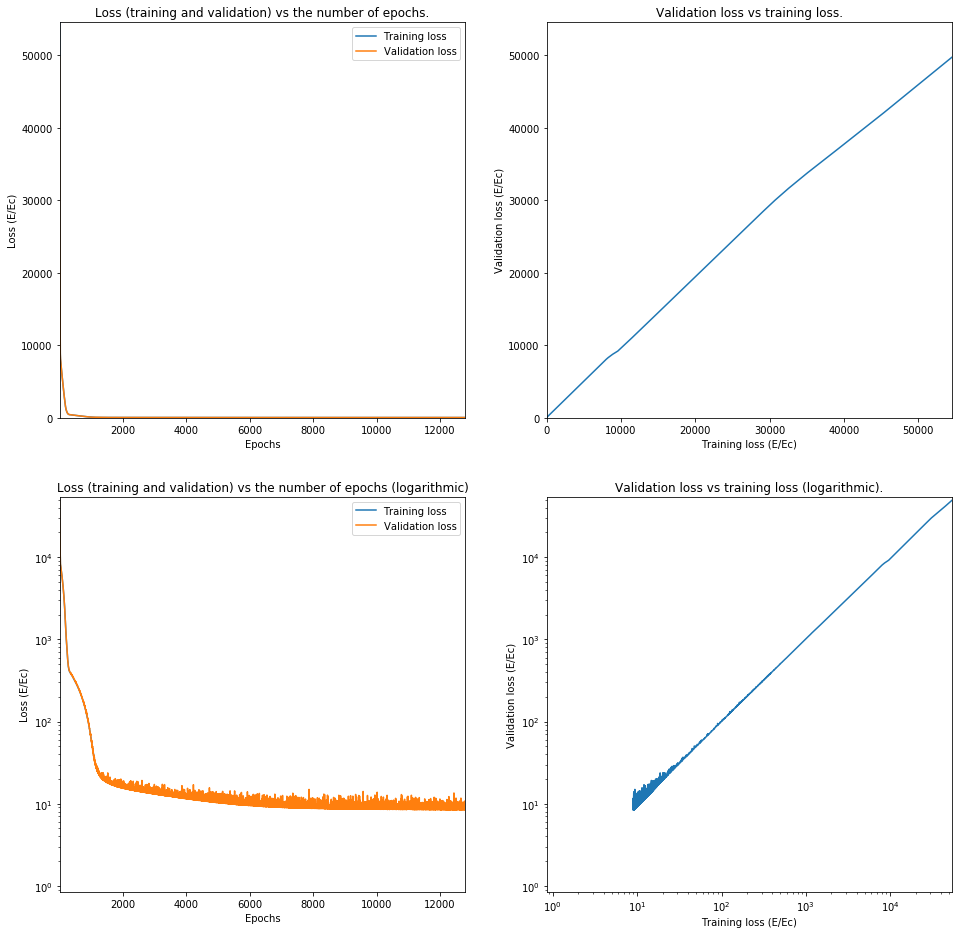

In [18]:
name = 'LinearNetwork'
settingsNetwork = [inputSize, ['Dense', 1, 'linear', True]]
learningRate = 1*10**-5
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=20000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)


7.737196990846369


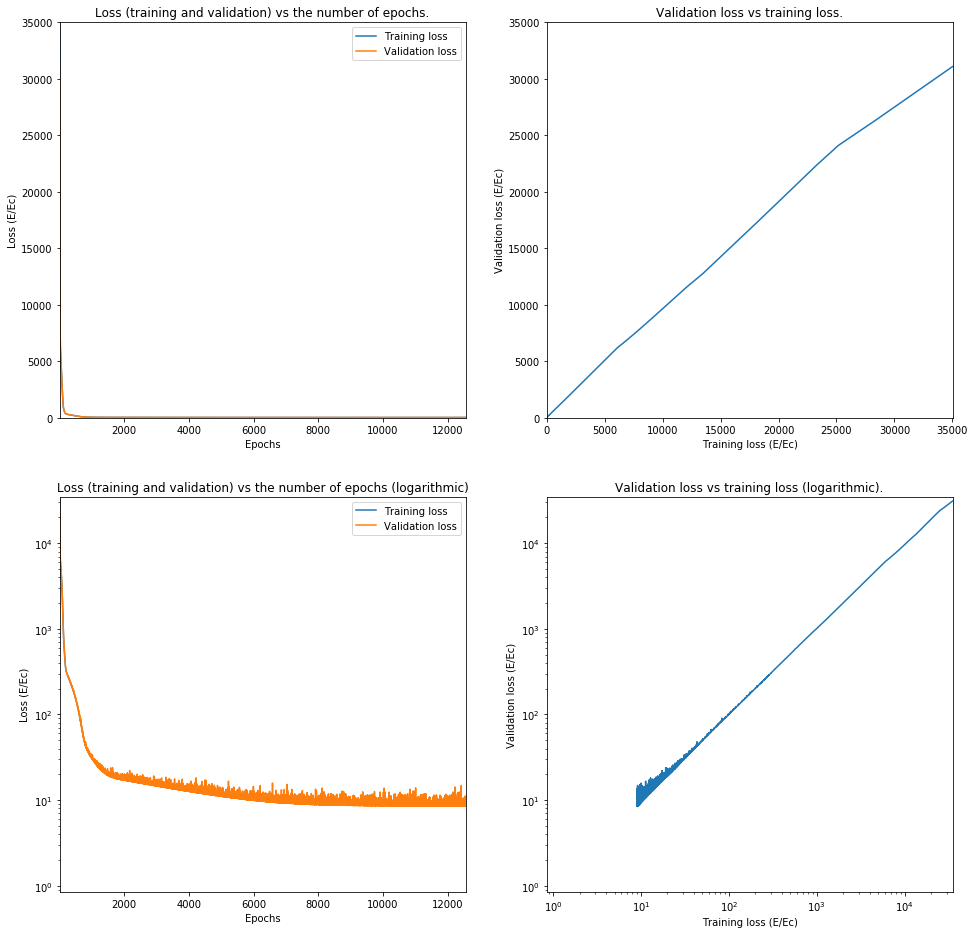

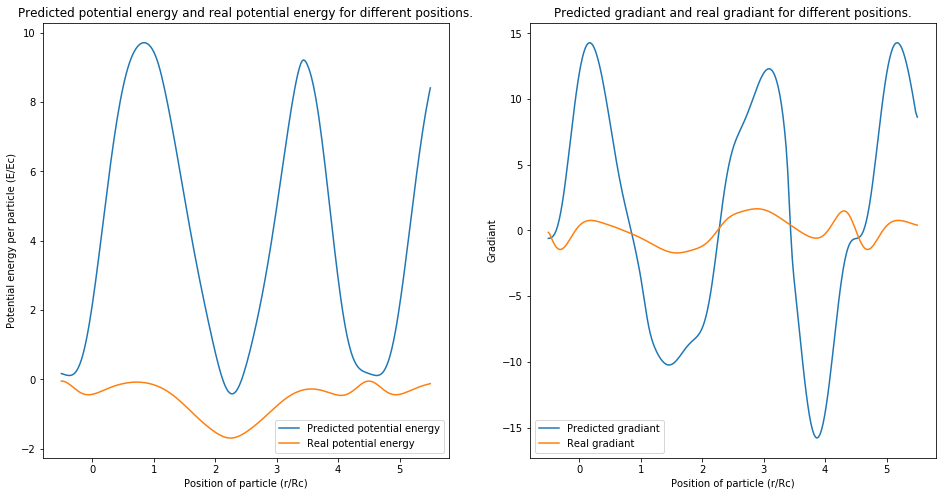

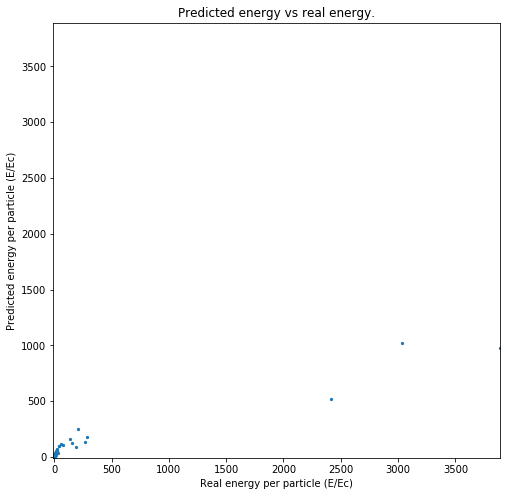

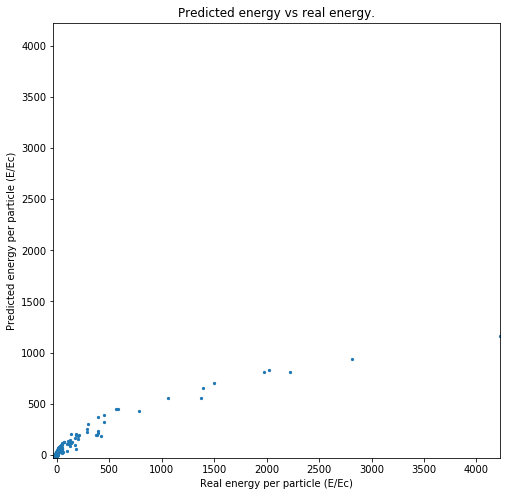

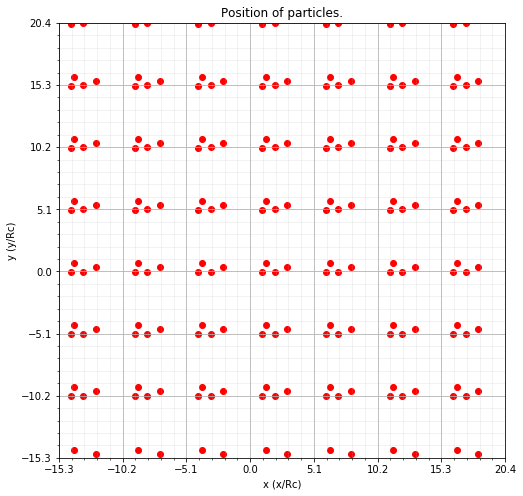

For index 27029 Predicted 3.2588215 was -0.0432773724


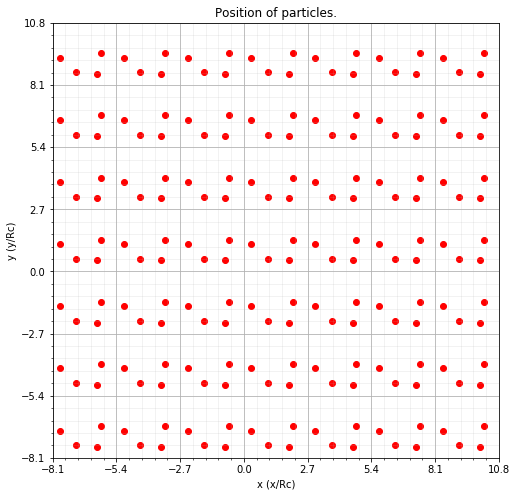

For index 82985 Predicted -7.798231 was -3.4620669033


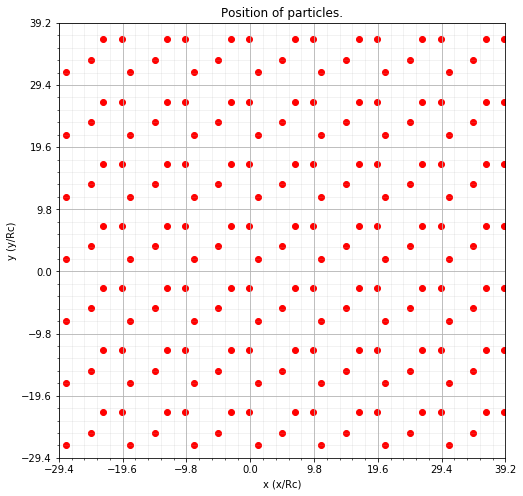

For index 81338 Predicted -2.049902 was 0.0


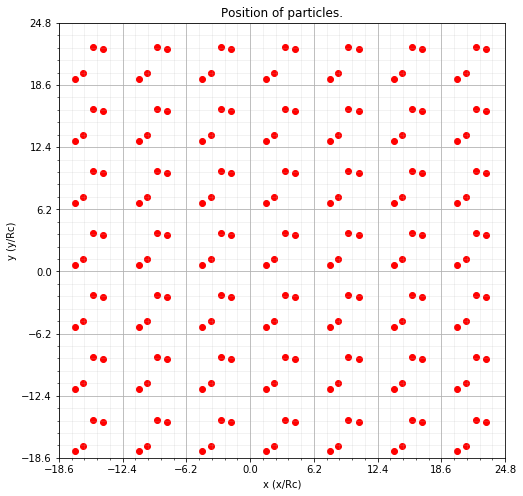

For index 90421 Predicted -1.0004368 was -0.2191454457


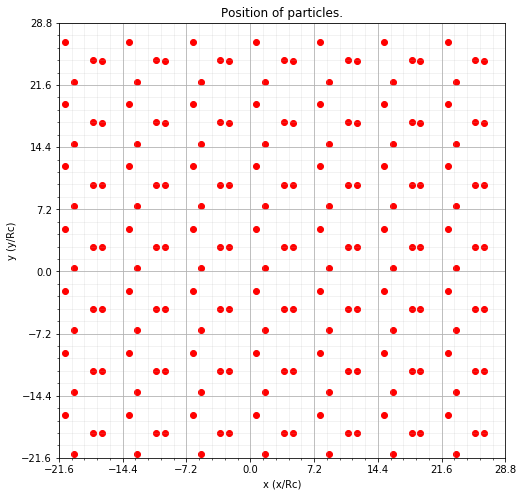

For index 23095 Predicted -0.034440994 was -0.1095838854


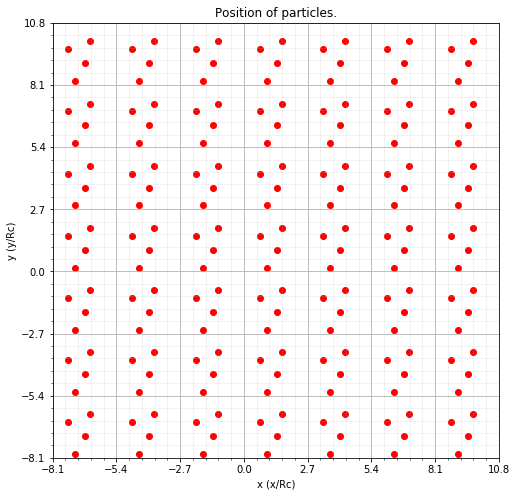

For index 92889 Predicted -3.2607403 was -3.8599259571999998


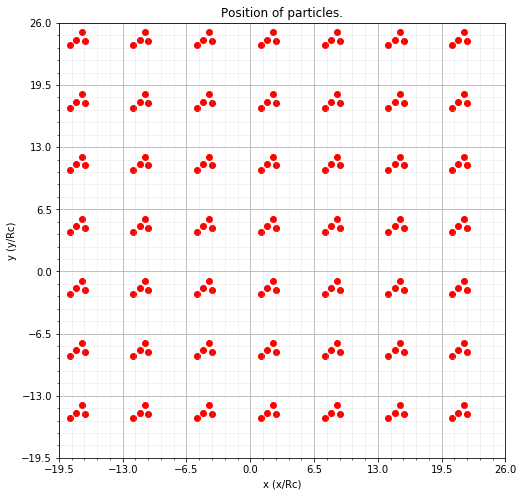

For index 97309 Predicted -4.123701 was -2.3285637016000003


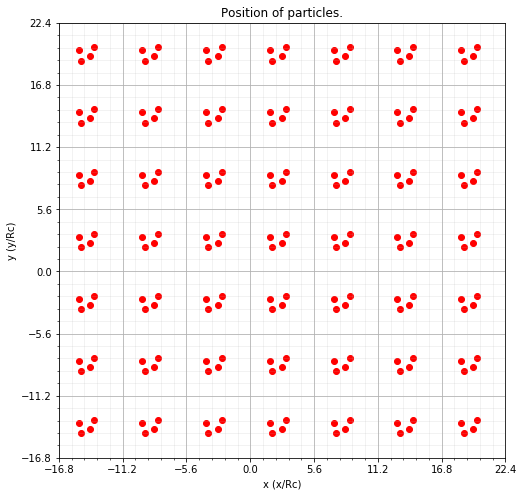

For index 89734 Predicted -1.7339993 was -2.6354253694


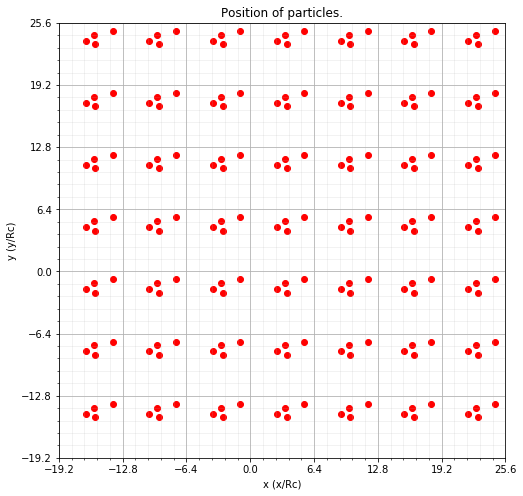

For index 22197 Predicted -1.2203732 was -1.3324452942


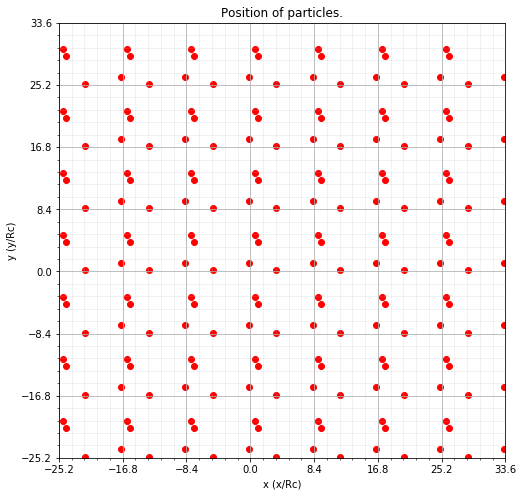

For index 17850 Predicted -0.51545906 was -0.10959605650000001


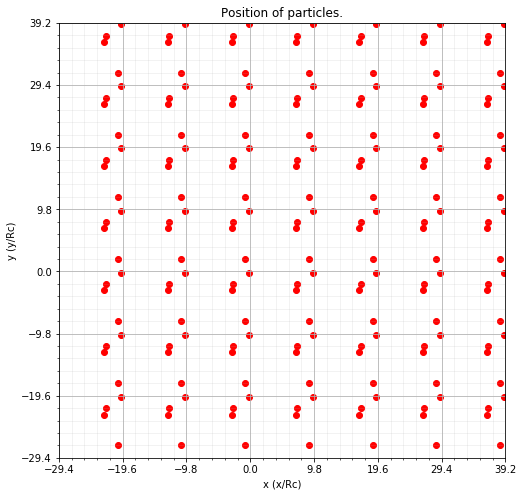

For index 61758 Predicted -0.22019386 was -0.10957113210000001
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
Layer 0:  [array([[-4.95611727e-01],
       [-1.10641010e-01],
       [ 5.92315430e-03],
       [ 1.09163225e-02],
       [ 3.59460227e-02],
       [ 6.19175378e-03],
       [-6.52804319e-03],
       [-4.79630334e-03],
       [-5.48856449e-04],
       [ 6.89672015e-05],
       [ 4.10674489e-04],
       [ 3.20034422e-04]], dtype=float32), array([-18.853895], dtype=float32)]


In [19]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

## Model 1: 1 Dense layer small softplus

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 12)                156       
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 13        
Total params: 169
Trainable params: 169
Non-trainable params: 0
_________________________________________________________________
78306/78306 [==============================] - 1s 13us/step
244938.16529265
Layer 0:  [array([[-2.5357902e-02,  1.6952342e-01, -6.7178166e-01, -4.6752489e-01,
        -5.1644069e-01,  2.6707870e-01,  4.2859918e-01, -6.5875220e-01,
         2.1439695e-01,  4.3288678e-01,  1.9580263e-01, -2.6002395e-01],
       [ 5.0506657e-01, -7.1963370e-02,  5.5653328e-01,  4.9264354e-01,
        -2.1301740e-01,  1.3829327e-01, -8.0892980e-02, -4.0382177e-01,
         5.9557217e-01,  2.1554202e-01,  6.3746816e-01, -5.1560885e-01

62644/62644 [==============================] - 2s 33us/step - loss: 2948.7700 - val_loss: 2852.7698
Epoch 40/25000
62644/62644 [==============================] - 2s 35us/step - loss: 2821.3039 - val_loss: 2728.9196
Epoch 41/25000
62644/62644 [==============================] - 2s 34us/step - loss: 2692.7322 - val_loss: 2601.9506
Epoch 42/25000
62644/62644 [==============================] - 2s 32us/step - loss: 2563.8843 - val_loss: 2475.6230
Epoch 43/25000
62644/62644 [==============================] - 2s 34us/step - loss: 2436.1230 - val_loss: 2352.0756
Epoch 44/25000
62644/62644 [==============================] - 2s 34us/step - loss: 2309.2896 - val_loss: 2226.4290
Epoch 45/25000
62644/62644 [==============================] - 2s 35us/step - loss: 2183.4744 - val_loss: 2102.2239
Epoch 46/25000
62644/62644 [==============================] - 2s 35us/step - loss: 2059.4105 - val_loss: 1981.9984
Epoch 47/25000
62644/62644 [==============================] - 2s 32us/step - loss: 1937.4618 - 

62644/62644 [==============================] - 2s 32us/step - loss: 157.4128 - val_loss: 152.9879
Epoch 112/25000
62644/62644 [==============================] - 2s 32us/step - loss: 154.5660 - val_loss: 149.4026
Epoch 113/25000
62644/62644 [==============================] - 2s 32us/step - loss: 151.7396 - val_loss: 146.9223
Epoch 114/25000
62644/62644 [==============================] - 2s 33us/step - loss: 149.1133 - val_loss: 144.4625
Epoch 115/25000
62644/62644 [==============================] - 2s 32us/step - loss: 146.4774 - val_loss: 142.0904
Epoch 116/25000
62644/62644 [==============================] - 2s 32us/step - loss: 143.9251 - val_loss: 139.2528
Epoch 117/25000
62644/62644 [==============================] - 2s 32us/step - loss: 141.4582 - val_loss: 136.9311
Epoch 118/25000
62644/62644 [==============================] - 2s 34us/step - loss: 139.0684 - val_loss: 135.1513
Epoch 119/25000
62644/62644 [==============================] - 2s 35us/step - loss: 136.8541 - val_loss:

62644/62644 [==============================] - 2s 32us/step - loss: 74.4092 - val_loss: 72.3360
Epoch 184/25000
62644/62644 [==============================] - 2s 32us/step - loss: 73.9062 - val_loss: 72.0126
Epoch 185/25000
62644/62644 [==============================] - 2s 32us/step - loss: 73.3642 - val_loss: 71.0621
Epoch 186/25000
62644/62644 [==============================] - 2s 32us/step - loss: 72.4139 - val_loss: 69.9870
Epoch 187/25000
62644/62644 [==============================] - 2s 32us/step - loss: 71.7442 - val_loss: 69.4368
Epoch 188/25000
62644/62644 [==============================] - 2s 32us/step - loss: 71.3028 - val_loss: 69.2370
Epoch 189/25000
62644/62644 [==============================] - 2s 32us/step - loss: 70.8286 - val_loss: 68.5083
Epoch 190/25000
62644/62644 [==============================] - 2s 32us/step - loss: 70.3874 - val_loss: 68.0889
Epoch 191/25000
62644/62644 [==============================] - 2s 32us/step - loss: 70.0193 - val_loss: 67.7728
Epoch 19

62644/62644 [==============================] - 2s 33us/step - loss: 52.4185 - val_loss: 50.3887
Epoch 257/25000
62644/62644 [==============================] - 2s 34us/step - loss: 52.2429 - val_loss: 50.1189
Epoch 258/25000
62644/62644 [==============================] - 2s 34us/step - loss: 52.0090 - val_loss: 50.1495
Epoch 259/25000
62644/62644 [==============================] - 2s 33us/step - loss: 51.8801 - val_loss: 50.3371
Epoch 260/25000
62644/62644 [==============================] - 2s 32us/step - loss: 51.7592 - val_loss: 49.6095
Epoch 261/25000
62644/62644 [==============================] - 2s 33us/step - loss: 51.5243 - val_loss: 49.5964
Epoch 262/25000
62644/62644 [==============================] - 2s 32us/step - loss: 51.3569 - val_loss: 49.3747
Epoch 263/25000
62644/62644 [==============================] - 2s 32us/step - loss: 51.1393 - val_loss: 49.1522
Epoch 264/25000
62644/62644 [==============================] - 2s 32us/step - loss: 50.9863 - val_loss: 48.9842
Epoch 26

62644/62644 [==============================] - 2s 32us/step - loss: 41.6941 - val_loss: 40.2992
Epoch 330/25000
62644/62644 [==============================] - 2s 33us/step - loss: 41.5929 - val_loss: 40.1990
Epoch 331/25000
62644/62644 [==============================] - 2s 32us/step - loss: 41.4581 - val_loss: 40.0960
Epoch 332/25000
62644/62644 [==============================] - 2s 32us/step - loss: 41.3537 - val_loss: 39.9630
Epoch 333/25000
62644/62644 [==============================] - 2s 32us/step - loss: 41.2450 - val_loss: 39.7915
Epoch 334/25000
62644/62644 [==============================] - 2s 32us/step - loss: 41.0902 - val_loss: 39.6502
Epoch 335/25000
62644/62644 [==============================] - 2s 32us/step - loss: 40.9908 - val_loss: 39.6288
Epoch 336/25000
62644/62644 [==============================] - 2s 32us/step - loss: 40.9241 - val_loss: 39.5574
Epoch 337/25000
62644/62644 [==============================] - 2s 34us/step - loss: 40.7858 - val_loss: 39.4275
Epoch 33

62644/62644 [==============================] - 2s 32us/step - loss: 33.4281 - val_loss: 32.7916
Epoch 403/25000
62644/62644 [==============================] - 2s 32us/step - loss: 33.3184 - val_loss: 32.5844
Epoch 404/25000
62644/62644 [==============================] - 2s 32us/step - loss: 33.2539 - val_loss: 32.6196
Epoch 405/25000
62644/62644 [==============================] - 2s 33us/step - loss: 33.1232 - val_loss: 32.4264
Epoch 406/25000
62644/62644 [==============================] - 2s 32us/step - loss: 33.1308 - val_loss: 32.5137
Epoch 407/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.9151 - val_loss: 32.5795
Epoch 408/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.9384 - val_loss: 32.1021
Epoch 409/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.8202 - val_loss: 31.9907
Epoch 410/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.6938 - val_loss: 32.4305
Epoch 41

62644/62644 [==============================] - 2s 32us/step - loss: 27.1807 - val_loss: 26.9242
Epoch 476/25000
62644/62644 [==============================] - 2s 32us/step - loss: 27.1058 - val_loss: 26.6330
Epoch 477/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.9947 - val_loss: 26.9621
Epoch 478/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.9386 - val_loss: 26.6108
Epoch 479/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.8352 - val_loss: 26.4583
Epoch 480/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.7944 - val_loss: 26.5600
Epoch 481/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.7111 - val_loss: 26.4194
Epoch 482/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.6258 - val_loss: 26.1769
Epoch 483/25000
62644/62644 [==============================] - 2s 33us/step - loss: 26.5402 - val_loss: 26.1737
Epoch 48

62644/62644 [==============================] - 2s 31us/step - loss: 22.8984 - val_loss: 22.3755
Epoch 549/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.8477 - val_loss: 22.4425
Epoch 550/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.8076 - val_loss: 22.3338
Epoch 551/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.7302 - val_loss: 22.3602
Epoch 552/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.7029 - val_loss: 22.3515
Epoch 553/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.6510 - val_loss: 22.3738
Epoch 554/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.6016 - val_loss: 22.2239
Epoch 555/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.5702 - val_loss: 22.1108
Epoch 556/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.5094 - val_loss: 22.1326
Epoch 55

62644/62644 [==============================] - 2s 32us/step - loss: 20.6873 - val_loss: 20.4382
Epoch 622/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.6940 - val_loss: 20.5719
Epoch 623/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6697 - val_loss: 20.6711
Epoch 624/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6922 - val_loss: 20.4726
Epoch 625/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.6612 - val_loss: 20.2736
Epoch 626/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6205 - val_loss: 20.4728
Epoch 627/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.5941 - val_loss: 20.5191
Epoch 628/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.5848 - val_loss: 20.6895
Epoch 629/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.5986 - val_loss: 20.4503
Epoch 63

62644/62644 [==============================] - 2s 35us/step - loss: 19.8189 - val_loss: 19.5149
Epoch 695/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.7738 - val_loss: 19.4394
Epoch 696/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.8082 - val_loss: 19.3980
Epoch 697/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.7630 - val_loss: 19.6124
Epoch 698/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.7467 - val_loss: 19.4132
Epoch 699/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.7486 - val_loss: 19.6097
Epoch 700/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.7300 - val_loss: 19.3369
Epoch 701/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.7299 - val_loss: 19.3334
Epoch 702/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.6749 - val_loss: 19.3516
Epoch 70

62644/62644 [==============================] - 2s 31us/step - loss: 18.9706 - val_loss: 18.6177
Epoch 768/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9728 - val_loss: 18.7649
Epoch 769/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9658 - val_loss: 18.6315
Epoch 770/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9660 - val_loss: 18.8034
Epoch 771/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9829 - val_loss: 18.7632
Epoch 772/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9856 - val_loss: 18.6176
Epoch 773/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9388 - val_loss: 18.7971
Epoch 774/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9449 - val_loss: 18.7262
Epoch 775/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.9763 - val_loss: 18.5912
Epoch 77

62644/62644 [==============================] - 2s 31us/step - loss: 18.5417 - val_loss: 18.2197
Epoch 841/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.5501 - val_loss: 18.3616
Epoch 842/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.5031 - val_loss: 18.2276
Epoch 843/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.5160 - val_loss: 18.2411
Epoch 844/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.5207 - val_loss: 18.1807
Epoch 845/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.4935 - val_loss: 18.2383
Epoch 846/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.5020 - val_loss: 18.2690
Epoch 847/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.4651 - val_loss: 18.2011
Epoch 848/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.4849 - val_loss: 18.0942
Epoch 84

62644/62644 [==============================] - 2s 33us/step - loss: 17.9292 - val_loss: 17.6976
Epoch 914/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.9358 - val_loss: 17.5764
Epoch 915/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.8927 - val_loss: 17.5666
Epoch 916/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9032 - val_loss: 17.6009
Epoch 917/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8799 - val_loss: 17.5428
Epoch 918/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.8278 - val_loss: 17.6630
Epoch 919/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.8571 - val_loss: 17.5744
Epoch 920/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.8646 - val_loss: 17.5368
Epoch 921/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.8378 - val_loss: 17.5145
Epoch 92

62644/62644 [==============================] - 2s 30us/step - loss: 17.4406 - val_loss: 17.2908
Epoch 987/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.4653 - val_loss: 17.4314
Epoch 988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4229 - val_loss: 17.1928
Epoch 989/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4148 - val_loss: 17.1610
Epoch 990/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4291 - val_loss: 17.2653
Epoch 991/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4545 - val_loss: 17.1620
Epoch 992/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.4181 - val_loss: 17.0945
Epoch 993/25000
62644/62644 [==============================] - 2s 30us/step - loss: 17.3708 - val_loss: 17.3515
Epoch 994/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3977 - val_loss: 17.1303
Epoch 99

62644/62644 [==============================] - 2s 30us/step - loss: 17.1222 - val_loss: 16.7811
Epoch 1059/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1240 - val_loss: 16.7709
Epoch 1060/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1136 - val_loss: 17.0271
Epoch 1061/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.1432 - val_loss: 16.8364
Epoch 1062/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0708 - val_loss: 17.2418
Epoch 1063/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0744 - val_loss: 16.9091
Epoch 1064/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0819 - val_loss: 16.8414
Epoch 1065/25000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0655 - val_loss: 16.8138
Epoch 1066/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.1124 - val_loss: 16.8821


62644/62644 [==============================] - 2s 39us/step - loss: 16.7826 - val_loss: 16.4986
Epoch 1131/25000
62644/62644 [==============================] - 2s 40us/step - loss: 16.7829 - val_loss: 16.7811
Epoch 1132/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.7369 - val_loss: 16.5075
Epoch 1133/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7758 - val_loss: 16.8188
Epoch 1134/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8068 - val_loss: 16.4612
Epoch 1135/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7879 - val_loss: 16.4989
Epoch 1136/25000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7253 - val_loss: 16.5244
Epoch 1137/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.7698 - val_loss: 16.5656
Epoch 1138/25000
62644/62644 [==============================] - 2s 34us/step - loss: 16.7333 - val_loss: 16.5507


62644/62644 [==============================] - 2s 32us/step - loss: 16.5413 - val_loss: 16.4461
Epoch 1203/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.5208 - val_loss: 16.5396
Epoch 1204/25000
62644/62644 [==============================] - 2s 34us/step - loss: 16.5121 - val_loss: 16.2126
Epoch 1205/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.5227 - val_loss: 16.2955
Epoch 1206/25000
62644/62644 [==============================] - 2s 37us/step - loss: 16.5035 - val_loss: 16.3329
Epoch 1207/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5399 - val_loss: 16.2318
Epoch 1208/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5039 - val_loss: 16.2587
Epoch 1209/25000
62644/62644 [==============================] - 2s 34us/step - loss: 16.5027 - val_loss: 16.2524
Epoch 1210/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.4857 - val_loss: 16.2058


62644/62644 [==============================] - 2s 31us/step - loss: 16.2415 - val_loss: 16.2431
Epoch 1275/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.2659 - val_loss: 15.9700
Epoch 1276/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.2253 - val_loss: 15.9445
Epoch 1277/25000
62644/62644 [==============================] - 2s 35us/step - loss: 16.2130 - val_loss: 16.1418
Epoch 1278/25000
62644/62644 [==============================] - 2s 39us/step - loss: 16.2348 - val_loss: 15.9941
Epoch 1279/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.2304 - val_loss: 15.9326
Epoch 1280/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.2129 - val_loss: 16.0069
Epoch 1281/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.2286 - val_loss: 16.4168
Epoch 1282/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.2183 - val_loss: 15.9871


62644/62644 [==============================] - 2s 38us/step - loss: 15.8571 - val_loss: 15.6752
Epoch 1347/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.8519 - val_loss: 15.7060
Epoch 1348/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.8424 - val_loss: 16.0288
Epoch 1349/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.8350 - val_loss: 15.7432
Epoch 1350/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.8483 - val_loss: 15.6458
Epoch 1351/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.8476 - val_loss: 15.9453
Epoch 1352/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.7876 - val_loss: 16.1136
Epoch 1353/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.8034 - val_loss: 15.9100
Epoch 1354/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.8147 - val_loss: 16.0321


62644/62644 [==============================] - 2s 40us/step - loss: 15.5375 - val_loss: 15.7696
Epoch 1419/25000
62644/62644 [==============================] - 2s 39us/step - loss: 15.5673 - val_loss: 15.3806
Epoch 1420/25000
62644/62644 [==============================] - 3s 44us/step - loss: 15.5387 - val_loss: 15.4893
Epoch 1421/25000
62644/62644 [==============================] - 2s 38us/step - loss: 15.5510 - val_loss: 15.4479
Epoch 1422/25000
62644/62644 [==============================] - 2s 37us/step - loss: 15.5480 - val_loss: 15.3714
Epoch 1423/25000
62644/62644 [==============================] - 2s 35us/step - loss: 15.5224 - val_loss: 15.3817
Epoch 1424/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.5164 - val_loss: 15.4076
Epoch 1425/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.5344 - val_loss: 15.4341
Epoch 1426/25000
62644/62644 [==============================] - 2s 33us/step - loss: 15.5522 - val_loss: 15.8307


62644/62644 [==============================] - 3s 40us/step - loss: 15.3027 - val_loss: 15.8576
Epoch 1491/25000
62644/62644 [==============================] - 3s 41us/step - loss: 15.3467 - val_loss: 15.4610
Epoch 1492/25000
62644/62644 [==============================] - 2s 38us/step - loss: 15.3303 - val_loss: 15.1279
Epoch 1493/25000
62644/62644 [==============================] - 2s 39us/step - loss: 15.3305 - val_loss: 15.2858
Epoch 1494/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.3082 - val_loss: 15.1454
Epoch 1495/25000
62644/62644 [==============================] - 2s 37us/step - loss: 15.2930 - val_loss: 15.2109
Epoch 1496/25000
62644/62644 [==============================] - 3s 42us/step - loss: 15.2980 - val_loss: 15.1183
Epoch 1497/25000
62644/62644 [==============================] - 2s 37us/step - loss: 15.3085 - val_loss: 15.5612
Epoch 1498/25000
62644/62644 [==============================] - 3s 40us/step - loss: 15.2973 - val_loss: 15.1148


62644/62644 [==============================] - 2s 36us/step - loss: 15.0791 - val_loss: 15.0707
Epoch 1563/25000
62644/62644 [==============================] - 2s 37us/step - loss: 15.0913 - val_loss: 14.9040
Epoch 1564/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.0989 - val_loss: 15.0473
Epoch 1565/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.0737 - val_loss: 14.9243
Epoch 1566/25000
62644/62644 [==============================] - 2s 35us/step - loss: 15.1016 - val_loss: 14.9866
Epoch 1567/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.0726 - val_loss: 15.1142
Epoch 1568/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.0868 - val_loss: 14.9135
Epoch 1569/25000
62644/62644 [==============================] - 2s 36us/step - loss: 15.0872 - val_loss: 15.0165
Epoch 1570/25000
62644/62644 [==============================] - 2s 34us/step - loss: 15.0790 - val_loss: 15.0319


62644/62644 [==============================] - 2s 36us/step - loss: 14.9176 - val_loss: 14.7178
Epoch 1635/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8820 - val_loss: 15.1291
Epoch 1636/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.8711 - val_loss: 14.7481
Epoch 1637/25000
62644/62644 [==============================] - 2s 36us/step - loss: 14.8412 - val_loss: 14.7396
Epoch 1638/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.9015 - val_loss: 15.1743
Epoch 1639/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.8860 - val_loss: 14.8989
Epoch 1640/25000
62644/62644 [==============================] - 2s 40us/step - loss: 14.8916 - val_loss: 14.7304
Epoch 1641/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8482 - val_loss: 14.7526
Epoch 1642/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8861 - val_loss: 14.7279


62644/62644 [==============================] - 2s 32us/step - loss: 14.6896 - val_loss: 14.4973
Epoch 1707/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.6498 - val_loss: 14.5080
Epoch 1708/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6638 - val_loss: 14.5248
Epoch 1709/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.6739 - val_loss: 14.6020
Epoch 1710/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.6363 - val_loss: 14.6410
Epoch 1711/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.6501 - val_loss: 14.4858
Epoch 1712/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.6895 - val_loss: 14.6201
Epoch 1713/25000
62644/62644 [==============================] - 2s 37us/step - loss: 14.6494 - val_loss: 15.1162
Epoch 1714/25000
62644/62644 [==============================] - 2s 37us/step - loss: 14.6274 - val_loss: 14.5859


62644/62644 [==============================] - 2s 33us/step - loss: 14.5124 - val_loss: 14.4310
Epoch 1779/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.4850 - val_loss: 14.5193
Epoch 1780/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.5062 - val_loss: 14.4201
Epoch 1781/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.4603 - val_loss: 14.3243
Epoch 1782/25000
62644/62644 [==============================] - 2s 39us/step - loss: 14.4928 - val_loss: 14.6834
Epoch 1783/25000
62644/62644 [==============================] - 2s 37us/step - loss: 14.5293 - val_loss: 14.6564
Epoch 1784/25000
62644/62644 [==============================] - 2s 36us/step - loss: 14.4864 - val_loss: 14.4456
Epoch 1785/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.4956 - val_loss: 14.3841
Epoch 1786/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.4848 - val_loss: 14.3150


62644/62644 [==============================] - 2s 35us/step - loss: 14.3339 - val_loss: 14.2066
Epoch 1851/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.3091 - val_loss: 14.3324
Epoch 1852/25000
62644/62644 [==============================] - 2s 37us/step - loss: 14.3241 - val_loss: 14.1933
Epoch 1853/25000
62644/62644 [==============================] - 2s 38us/step - loss: 14.3231 - val_loss: 14.3434
Epoch 1854/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.3048 - val_loss: 14.5434
Epoch 1855/25000
62644/62644 [==============================] - 2s 36us/step - loss: 14.3517 - val_loss: 14.2249
Epoch 1856/25000
62644/62644 [==============================] - 2s 38us/step - loss: 14.3026 - val_loss: 14.2605
Epoch 1857/25000
62644/62644 [==============================] - 2s 38us/step - loss: 14.3287 - val_loss: 14.5039
Epoch 1858/25000
62644/62644 [==============================] - 2s 36us/step - loss: 14.3009 - val_loss: 14.1764


62644/62644 [==============================] - 2s 33us/step - loss: 14.1699 - val_loss: 14.0501
Epoch 1923/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.1920 - val_loss: 14.0414
Epoch 1924/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.1685 - val_loss: 14.0741
Epoch 1925/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.1370 - val_loss: 14.6024
Epoch 1926/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.1609 - val_loss: 14.0707
Epoch 1927/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.1338 - val_loss: 14.1476
Epoch 1928/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.1216 - val_loss: 14.0674
Epoch 1929/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.1401 - val_loss: 14.2778
Epoch 1930/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.1364 - val_loss: 14.0894


62644/62644 [==============================] - 2s 31us/step - loss: 13.9502 - val_loss: 13.9320
Epoch 1995/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9604 - val_loss: 13.7833
Epoch 1996/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9472 - val_loss: 14.3540
Epoch 1997/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9512 - val_loss: 13.7902
Epoch 1998/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9545 - val_loss: 14.1984
Epoch 1999/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9513 - val_loss: 13.8378
Epoch 2000/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9534 - val_loss: 13.8681
Epoch 2001/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9049 - val_loss: 13.7870
Epoch 2002/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9273 - val_loss: 13.9021


62644/62644 [==============================] - 2s 30us/step - loss: 13.8104 - val_loss: 13.9958
Epoch 2067/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8303 - val_loss: 13.6610
Epoch 2068/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.7686 - val_loss: 14.5675
Epoch 2069/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.8269 - val_loss: 13.6935
Epoch 2070/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8159 - val_loss: 13.7860
Epoch 2071/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8072 - val_loss: 13.7666
Epoch 2072/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.8194 - val_loss: 13.6561
Epoch 2073/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.7992 - val_loss: 13.8827
Epoch 2074/25000
62644/62644 [==============================] - 2s 35us/step - loss: 13.7970 - val_loss: 13.6778


62644/62644 [==============================] - 3s 44us/step - loss: 13.6831 - val_loss: 14.0007
Epoch 2139/25000
62644/62644 [==============================] - 2s 39us/step - loss: 13.7067 - val_loss: 13.5647
Epoch 2140/25000
62644/62644 [==============================] - 2s 37us/step - loss: 13.6922 - val_loss: 13.6209
Epoch 2141/25000
62644/62644 [==============================] - 2s 38us/step - loss: 13.6826 - val_loss: 13.5209
Epoch 2142/25000
62644/62644 [==============================] - 2s 37us/step - loss: 13.6499 - val_loss: 13.6491
Epoch 2143/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.6585 - val_loss: 13.5765
Epoch 2144/25000
62644/62644 [==============================] - 2s 36us/step - loss: 13.6708 - val_loss: 13.5875
Epoch 2145/25000
62644/62644 [==============================] - 3s 41us/step - loss: 13.6898 - val_loss: 13.6184
Epoch 2146/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.6764 - val_loss: 13.8560


62644/62644 [==============================] - 2s 31us/step - loss: 13.5783 - val_loss: 13.6002
Epoch 2211/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.5941 - val_loss: 13.6546
Epoch 2212/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.5546 - val_loss: 13.7042
Epoch 2213/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.5755 - val_loss: 13.5786
Epoch 2214/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.5525 - val_loss: 13.3748
Epoch 2215/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.5598 - val_loss: 13.3855
Epoch 2216/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.5575 - val_loss: 13.6196
Epoch 2217/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.5626 - val_loss: 13.3609
Epoch 2218/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.5566 - val_loss: 13.4162


62644/62644 [==============================] - 2s 31us/step - loss: 13.4140 - val_loss: 13.3996
Epoch 2283/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.4678 - val_loss: 13.2745
Epoch 2284/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.4508 - val_loss: 13.3631
Epoch 2285/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.4223 - val_loss: 13.3044
Epoch 2286/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.4466 - val_loss: 13.3721
Epoch 2287/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.4478 - val_loss: 13.4076
Epoch 2288/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.3976 - val_loss: 13.6513
Epoch 2289/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.3781 - val_loss: 13.7098
Epoch 2290/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.4500 - val_loss: 13.2842


62644/62644 [==============================] - 2s 32us/step - loss: 13.3219 - val_loss: 13.2542
Epoch 2355/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.3156 - val_loss: 13.1408
Epoch 2356/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.3085 - val_loss: 13.2714
Epoch 2357/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.2929 - val_loss: 13.4030
Epoch 2358/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.3062 - val_loss: 13.5277
Epoch 2359/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.3036 - val_loss: 13.2316
Epoch 2360/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.3093 - val_loss: 13.2024
Epoch 2361/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.2988 - val_loss: 13.2356
Epoch 2362/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.2834 - val_loss: 13.1137


62644/62644 [==============================] - 2s 30us/step - loss: 13.1796 - val_loss: 13.0223
Epoch 2427/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.1862 - val_loss: 13.1021
Epoch 2428/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.1824 - val_loss: 13.2096
Epoch 2429/25000
62644/62644 [==============================] - 2s 35us/step - loss: 13.2014 - val_loss: 13.1152
Epoch 2430/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.1762 - val_loss: 12.9967
Epoch 2431/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.1830 - val_loss: 13.0499
Epoch 2432/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.1601 - val_loss: 13.0674
Epoch 2433/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.1899 - val_loss: 13.0951
Epoch 2434/25000
62644/62644 [==============================] - 2s 30us/step - loss: 13.1826 - val_loss: 13.0408


62644/62644 [==============================] - 2s 31us/step - loss: 13.0728 - val_loss: 13.0494
Epoch 2499/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.0498 - val_loss: 13.0076
Epoch 2500/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.0380 - val_loss: 12.9179
Epoch 2501/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.0587 - val_loss: 13.2304
Epoch 2502/25000
62644/62644 [==============================] - 2s 37us/step - loss: 13.0653 - val_loss: 13.0177
Epoch 2503/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.0306 - val_loss: 12.8498
Epoch 2504/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.0527 - val_loss: 13.2798
Epoch 2505/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.0546 - val_loss: 12.8655
Epoch 2506/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.0747 - val_loss: 12.8332


62644/62644 [==============================] - 2s 30us/step - loss: 12.9722 - val_loss: 12.7529
Epoch 2571/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.9475 - val_loss: 12.8133
Epoch 2572/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.9352 - val_loss: 12.7731
Epoch 2573/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.9592 - val_loss: 12.8145
Epoch 2574/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.9423 - val_loss: 12.7548
Epoch 2575/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.9593 - val_loss: 12.8765
Epoch 2576/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.9180 - val_loss: 12.7692
Epoch 2577/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.9489 - val_loss: 12.7751
Epoch 2578/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.9477 - val_loss: 12.7544


62644/62644 [==============================] - 2s 31us/step - loss: 12.8477 - val_loss: 12.8825
Epoch 2643/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.8366 - val_loss: 12.7624
Epoch 2644/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.8794 - val_loss: 12.6690
Epoch 2645/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.8380 - val_loss: 12.8994
Epoch 2646/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.8379 - val_loss: 12.9911
Epoch 2647/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.8475 - val_loss: 12.7156
Epoch 2648/25000
62644/62644 [==============================] - 2s 30us/step - loss: 12.8447 - val_loss: 12.6842
Epoch 2649/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.8262 - val_loss: 12.8694
Epoch 2650/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.8018 - val_loss: 12.6640


62644/62644 [==============================] - 2s 33us/step - loss: 12.7433 - val_loss: 12.5869
Epoch 2715/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.7500 - val_loss: 12.5670
Epoch 2716/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.7473 - val_loss: 12.6077
Epoch 2717/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.7559 - val_loss: 12.6423
Epoch 2718/25000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7384 - val_loss: 13.6029
Epoch 2719/25000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7368 - val_loss: 12.5415
Epoch 2720/25000
62644/62644 [==============================] - 2s 37us/step - loss: 12.7190 - val_loss: 12.7677
Epoch 2721/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.7584 - val_loss: 12.5396
Epoch 2722/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.7363 - val_loss: 12.6955


62644/62644 [==============================] - 2s 33us/step - loss: 12.6326 - val_loss: 12.7406
Epoch 2787/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6410 - val_loss: 12.4671
Epoch 2788/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6632 - val_loss: 12.6009
Epoch 2789/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6617 - val_loss: 12.4544
Epoch 2790/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6416 - val_loss: 12.4399
Epoch 2791/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6434 - val_loss: 12.5901
Epoch 2792/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.6312 - val_loss: 12.5960
Epoch 2793/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6458 - val_loss: 12.5380
Epoch 2794/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.6173 - val_loss: 12.6678


62644/62644 [==============================] - 2s 33us/step - loss: 12.5355 - val_loss: 12.4127
Epoch 2859/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.5494 - val_loss: 12.3379
Epoch 2860/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.5357 - val_loss: 12.4081
Epoch 2861/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.5599 - val_loss: 12.3849
Epoch 2862/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.5516 - val_loss: 12.5263
Epoch 2863/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.5430 - val_loss: 12.5945
Epoch 2864/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.5470 - val_loss: 12.3511
Epoch 2865/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.5325 - val_loss: 12.4700
Epoch 2866/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.5378 - val_loss: 12.3776


62644/62644 [==============================] - 2s 36us/step - loss: 12.4680 - val_loss: 12.8283
Epoch 2931/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.4582 - val_loss: 12.3910
Epoch 2932/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.4400 - val_loss: 12.3335
Epoch 2933/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.4398 - val_loss: 12.2962
Epoch 2934/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.4578 - val_loss: 12.4194
Epoch 2935/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.4419 - val_loss: 12.2662
Epoch 2936/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.4549 - val_loss: 12.2950
Epoch 2937/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.4419 - val_loss: 12.3334
Epoch 2938/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.4646 - val_loss: 12.4021


62644/62644 [==============================] - 2s 32us/step - loss: 12.3764 - val_loss: 12.2832
Epoch 3003/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3854 - val_loss: 12.4127
Epoch 3004/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3672 - val_loss: 12.3383
Epoch 3005/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3584 - val_loss: 12.4131
Epoch 3006/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3728 - val_loss: 12.4620
Epoch 3007/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3715 - val_loss: 12.3422
Epoch 3008/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3894 - val_loss: 12.1918
Epoch 3009/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3535 - val_loss: 12.1964
Epoch 3010/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3544 - val_loss: 12.5631


62644/62644 [==============================] - 2s 33us/step - loss: 12.2939 - val_loss: 12.1958
Epoch 3075/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2970 - val_loss: 12.2528
Epoch 3076/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2757 - val_loss: 12.3717
Epoch 3077/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.3118 - val_loss: 12.1834
Epoch 3078/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2879 - val_loss: 12.2842
Epoch 3079/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2958 - val_loss: 12.2781
Epoch 3080/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2518 - val_loss: 12.1035
Epoch 3081/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2702 - val_loss: 12.1080
Epoch 3082/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2822 - val_loss: 12.1355


62644/62644 [==============================] - 2s 33us/step - loss: 12.1977 - val_loss: 12.1346
Epoch 3147/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.1969 - val_loss: 12.5518
Epoch 3148/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2009 - val_loss: 12.0610
Epoch 3149/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.1675 - val_loss: 12.3028
Epoch 3150/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.1818 - val_loss: 12.1902
Epoch 3151/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.1859 - val_loss: 12.1009
Epoch 3152/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.2047 - val_loss: 12.0095
Epoch 3153/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.1588 - val_loss: 12.3057
Epoch 3154/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.1655 - val_loss: 12.0698


62644/62644 [==============================] - 2s 33us/step - loss: 12.0904 - val_loss: 12.1384
Epoch 3219/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0948 - val_loss: 12.0331
Epoch 3220/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0888 - val_loss: 11.9849
Epoch 3221/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.0467 - val_loss: 11.9210
Epoch 3222/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.1019 - val_loss: 11.9924
Epoch 3223/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.0927 - val_loss: 12.1284
Epoch 3224/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.0693 - val_loss: 12.1406
Epoch 3225/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.0747 - val_loss: 12.5634
Epoch 3226/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.0817 - val_loss: 11.9148


62644/62644 [==============================] - 2s 35us/step - loss: 12.0136 - val_loss: 11.8544
Epoch 3291/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.0052 - val_loss: 11.8719
Epoch 3292/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.0166 - val_loss: 12.1223
Epoch 3293/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.0061 - val_loss: 11.9960
Epoch 3294/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.0222 - val_loss: 12.0913
Epoch 3295/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.0098 - val_loss: 11.9740
Epoch 3296/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.0161 - val_loss: 11.9481
Epoch 3297/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.9925 - val_loss: 12.1281
Epoch 3298/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.0051 - val_loss: 11.9323


62644/62644 [==============================] - 2s 33us/step - loss: 11.8819 - val_loss: 12.1621
Epoch 3363/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.9111 - val_loss: 11.8947
Epoch 3364/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.9199 - val_loss: 11.8251
Epoch 3365/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.9069 - val_loss: 11.7740
Epoch 3366/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8897 - val_loss: 12.2275
Epoch 3367/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8879 - val_loss: 11.7892
Epoch 3368/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8680 - val_loss: 11.8500
Epoch 3369/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8810 - val_loss: 11.8343
Epoch 3370/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8793 - val_loss: 12.3696


62644/62644 [==============================] - 2s 34us/step - loss: 11.8278 - val_loss: 11.6866
Epoch 3435/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8145 - val_loss: 11.7773
Epoch 3436/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8229 - val_loss: 12.2520
Epoch 3437/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8253 - val_loss: 11.6648
Epoch 3438/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.8250 - val_loss: 11.8158
Epoch 3439/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.8032 - val_loss: 12.1629
Epoch 3440/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.8135 - val_loss: 11.7101
Epoch 3441/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.8086 - val_loss: 11.8639
Epoch 3442/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.8070 - val_loss: 11.7470


62644/62644 [==============================] - 2s 32us/step - loss: 11.7277 - val_loss: 11.6893
Epoch 3507/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7088 - val_loss: 11.6006
Epoch 3508/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.7413 - val_loss: 11.7114
Epoch 3509/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7365 - val_loss: 12.1350
Epoch 3510/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.7252 - val_loss: 11.7140
Epoch 3511/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.7337 - val_loss: 11.6617
Epoch 3512/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7331 - val_loss: 11.7126
Epoch 3513/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.7475 - val_loss: 11.8370
Epoch 3514/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7257 - val_loss: 11.6073


62644/62644 [==============================] - 2s 36us/step - loss: 11.6417 - val_loss: 11.8737
Epoch 3579/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.6480 - val_loss: 11.5843
Epoch 3580/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.6491 - val_loss: 11.6670
Epoch 3581/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.6425 - val_loss: 11.9036
Epoch 3582/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.6450 - val_loss: 11.6823
Epoch 3583/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.6384 - val_loss: 11.7057
Epoch 3584/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.6504 - val_loss: 11.5668
Epoch 3585/25000
62644/62644 [==============================] - 2s 39us/step - loss: 11.6164 - val_loss: 11.6340
Epoch 3586/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.6272 - val_loss: 11.6386


62644/62644 [==============================] - 2s 35us/step - loss: 11.5663 - val_loss: 11.5718
Epoch 3651/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5745 - val_loss: 11.9904
Epoch 3652/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5802 - val_loss: 11.7643
Epoch 3653/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5563 - val_loss: 11.5836
Epoch 3654/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5788 - val_loss: 11.5679
Epoch 3655/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.5853 - val_loss: 11.4855
Epoch 3656/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.5661 - val_loss: 11.5079
Epoch 3657/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5979 - val_loss: 11.5438
Epoch 3658/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.6060 - val_loss: 11.5893


62644/62644 [==============================] - 2s 33us/step - loss: 11.5306 - val_loss: 11.7249
Epoch 3723/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.5224 - val_loss: 11.4289
Epoch 3724/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.5112 - val_loss: 11.5670
Epoch 3725/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.5251 - val_loss: 11.4493
Epoch 3726/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.5208 - val_loss: 11.4617
Epoch 3727/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.5270 - val_loss: 11.4503
Epoch 3728/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.5049 - val_loss: 11.6210
Epoch 3729/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.5231 - val_loss: 11.4427
Epoch 3730/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4960 - val_loss: 11.7788


62644/62644 [==============================] - 2s 32us/step - loss: 11.4798 - val_loss: 11.3780
Epoch 3795/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4809 - val_loss: 11.8859
Epoch 3796/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.4726 - val_loss: 11.5911
Epoch 3797/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4703 - val_loss: 11.4438
Epoch 3798/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4743 - val_loss: 11.6289
Epoch 3799/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4664 - val_loss: 11.5023
Epoch 3800/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4349 - val_loss: 11.3807
Epoch 3801/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4656 - val_loss: 11.4744
Epoch 3802/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4646 - val_loss: 11.4577


62644/62644 [==============================] - 2s 32us/step - loss: 11.4187 - val_loss: 11.3712
Epoch 3867/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4024 - val_loss: 11.4453
Epoch 3868/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4021 - val_loss: 11.5255
Epoch 3869/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3789 - val_loss: 11.3553
Epoch 3870/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3932 - val_loss: 11.3789
Epoch 3871/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3871 - val_loss: 11.3238
Epoch 3872/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4268 - val_loss: 11.3991
Epoch 3873/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3952 - val_loss: 11.3284
Epoch 3874/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.4161 - val_loss: 11.3934


62644/62644 [==============================] - 2s 35us/step - loss: 11.3652 - val_loss: 11.3997
Epoch 3939/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.3264 - val_loss: 11.8708
Epoch 3940/25000
62644/62644 [==============================] - 2s 39us/step - loss: 11.3400 - val_loss: 11.2725
Epoch 3941/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3409 - val_loss: 11.2740
Epoch 3942/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.3437 - val_loss: 11.2828
Epoch 3943/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3485 - val_loss: 11.3540
Epoch 3944/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.3383 - val_loss: 11.6098
Epoch 3945/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3458 - val_loss: 11.2738
Epoch 3946/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3679 - val_loss: 11.2612


62644/62644 [==============================] - 2s 34us/step - loss: 11.2986 - val_loss: 11.2270
Epoch 4011/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3001 - val_loss: 11.5098
Epoch 4012/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.2771 - val_loss: 11.4310
Epoch 4013/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3077 - val_loss: 11.7872
Epoch 4014/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.2809 - val_loss: 11.3491
Epoch 4015/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.2936 - val_loss: 11.6663
Epoch 4016/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.2988 - val_loss: 11.2229
Epoch 4017/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2876 - val_loss: 11.2373
Epoch 4018/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.2883 - val_loss: 11.3157


62644/62644 [==============================] - 2s 33us/step - loss: 11.2299 - val_loss: 11.6908
Epoch 4083/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2379 - val_loss: 11.1916
Epoch 4084/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2243 - val_loss: 11.3880
Epoch 4085/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2446 - val_loss: 11.2026
Epoch 4086/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2442 - val_loss: 11.7144
Epoch 4087/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2333 - val_loss: 11.7574
Epoch 4088/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2499 - val_loss: 11.3287
Epoch 4089/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2200 - val_loss: 11.2327
Epoch 4090/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.2342 - val_loss: 11.2640


62644/62644 [==============================] - 2s 36us/step - loss: 11.1978 - val_loss: 11.1175
Epoch 4155/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1727 - val_loss: 11.1736
Epoch 4156/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.1986 - val_loss: 11.2179
Epoch 4157/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1869 - val_loss: 11.8637
Epoch 4158/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.1745 - val_loss: 11.2030
Epoch 4159/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.1762 - val_loss: 11.2285
Epoch 4160/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1902 - val_loss: 11.1761
Epoch 4161/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1669 - val_loss: 11.3331
Epoch 4162/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1591 - val_loss: 11.4359


62644/62644 [==============================] - 2s 38us/step - loss: 11.1169 - val_loss: 11.1168
Epoch 4227/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1215 - val_loss: 11.1043
Epoch 4228/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.1564 - val_loss: 11.1103
Epoch 4229/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.1241 - val_loss: 11.1345
Epoch 4230/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.1172 - val_loss: 11.4019
Epoch 4231/25000
62644/62644 [==============================] - 2s 37us/step - loss: 11.1383 - val_loss: 11.2298
Epoch 4232/25000
62644/62644 [==============================] - 2s 39us/step - loss: 11.1210 - val_loss: 11.4711
Epoch 4233/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.1430 - val_loss: 11.3160
Epoch 4234/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1215 - val_loss: 11.1565


62644/62644 [==============================] - 2s 35us/step - loss: 11.0859 - val_loss: 11.1472
Epoch 4299/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0705 - val_loss: 11.0644
Epoch 4300/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.1050 - val_loss: 11.2941
Epoch 4301/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.0708 - val_loss: 11.1773
Epoch 4302/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0762 - val_loss: 11.4307
Epoch 4303/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0885 - val_loss: 11.2252
Epoch 4304/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0745 - val_loss: 11.0262
Epoch 4305/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.0880 - val_loss: 11.3752
Epoch 4306/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.1022 - val_loss: 11.2779


62644/62644 [==============================] - 2s 33us/step - loss: 11.0629 - val_loss: 11.4954
Epoch 4371/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.0550 - val_loss: 11.3908
Epoch 4372/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0222 - val_loss: 11.0037
Epoch 4373/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.0272 - val_loss: 10.9857
Epoch 4374/25000
62644/62644 [==============================] - 2s 38us/step - loss: 11.0434 - val_loss: 11.1441
Epoch 4375/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0275 - val_loss: 11.0025
Epoch 4376/25000
62644/62644 [==============================] - 2s 39us/step - loss: 11.0355 - val_loss: 11.1761
Epoch 4377/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0271 - val_loss: 11.1785
Epoch 4378/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0242 - val_loss: 11.0659


62644/62644 [==============================] - 3s 40us/step - loss: 10.9814 - val_loss: 10.9437
Epoch 4443/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.9957 - val_loss: 11.2498
Epoch 4444/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.9859 - val_loss: 10.9278
Epoch 4445/25000
62644/62644 [==============================] - 2s 40us/step - loss: 10.9980 - val_loss: 11.1437
Epoch 4446/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.9855 - val_loss: 11.0010
Epoch 4447/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.9826 - val_loss: 10.9749
Epoch 4448/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.9855 - val_loss: 11.0413
Epoch 4449/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.9948 - val_loss: 11.0712
Epoch 4450/25000
62644/62644 [==============================] - 3s 40us/step - loss: 10.9891 - val_loss: 10.9947


62644/62644 [==============================] - 2s 33us/step - loss: 10.9503 - val_loss: 11.0578
Epoch 4515/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9312 - val_loss: 11.0806
Epoch 4516/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9484 - val_loss: 10.9937
Epoch 4517/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9123 - val_loss: 10.9535
Epoch 4518/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9337 - val_loss: 11.1355
Epoch 4519/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.9410 - val_loss: 11.1782
Epoch 4520/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.9345 - val_loss: 11.0128
Epoch 4521/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9348 - val_loss: 11.3751
Epoch 4522/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.9196 - val_loss: 10.9801


62644/62644 [==============================] - 2s 33us/step - loss: 10.8756 - val_loss: 11.0519
Epoch 4587/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.8839 - val_loss: 10.9535
Epoch 4588/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.8906 - val_loss: 11.0065
Epoch 4589/25000
62644/62644 [==============================] - 2s 40us/step - loss: 10.8705 - val_loss: 10.8488
Epoch 4590/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8561 - val_loss: 10.9216
Epoch 4591/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.8792 - val_loss: 10.8877
Epoch 4592/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.8909 - val_loss: 10.9270
Epoch 4593/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8929 - val_loss: 10.9029
Epoch 4594/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8773 - val_loss: 11.0034


62644/62644 [==============================] - 2s 35us/step - loss: 10.8329 - val_loss: 10.8322
Epoch 4659/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8257 - val_loss: 10.8574
Epoch 4660/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8356 - val_loss: 10.8717
Epoch 4661/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8383 - val_loss: 10.8651
Epoch 4662/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.8469 - val_loss: 10.8121
Epoch 4663/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8338 - val_loss: 10.8693
Epoch 4664/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8382 - val_loss: 10.8414
Epoch 4665/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.8282 - val_loss: 10.9620
Epoch 4666/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.8296 - val_loss: 10.9558


62644/62644 [==============================] - 2s 32us/step - loss: 10.8022 - val_loss: 10.9587
Epoch 4731/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7807 - val_loss: 11.2209
Epoch 4732/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7874 - val_loss: 10.7852
Epoch 4733/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.8153 - val_loss: 10.7604
Epoch 4734/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7923 - val_loss: 10.8182
Epoch 4735/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7819 - val_loss: 11.4137
Epoch 4736/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7768 - val_loss: 10.7485
Epoch 4737/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8087 - val_loss: 10.8522
Epoch 4738/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7881 - val_loss: 10.8806


62644/62644 [==============================] - 2s 34us/step - loss: 10.7456 - val_loss: 10.9941
Epoch 4803/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7563 - val_loss: 10.9518
Epoch 4804/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7461 - val_loss: 11.1042
Epoch 4805/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7537 - val_loss: 11.1618
Epoch 4806/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7644 - val_loss: 10.8588
Epoch 4807/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7348 - val_loss: 10.7146
Epoch 4808/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7444 - val_loss: 10.9663
Epoch 4809/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7590 - val_loss: 10.7176
Epoch 4810/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7436 - val_loss: 10.7042


62644/62644 [==============================] - 2s 33us/step - loss: 10.7116 - val_loss: 10.7328
Epoch 4875/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7103 - val_loss: 10.7839
Epoch 4876/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7231 - val_loss: 10.7239
Epoch 4877/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7154 - val_loss: 10.7145
Epoch 4878/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.7068 - val_loss: 10.7242
Epoch 4879/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6961 - val_loss: 10.7645
Epoch 4880/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7271 - val_loss: 10.7070
Epoch 4881/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7245 - val_loss: 10.6856
Epoch 4882/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7171 - val_loss: 10.8186


62644/62644 [==============================] - 2s 32us/step - loss: 10.6692 - val_loss: 10.8251
Epoch 4947/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6914 - val_loss: 10.7474
Epoch 4948/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6764 - val_loss: 10.7560
Epoch 4949/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.6808 - val_loss: 10.6641
Epoch 4950/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6922 - val_loss: 10.8332
Epoch 4951/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6620 - val_loss: 10.6584
Epoch 4952/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6571 - val_loss: 10.7041
Epoch 4953/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6807 - val_loss: 10.6598
Epoch 4954/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6714 - val_loss: 10.7770


62644/62644 [==============================] - 2s 32us/step - loss: 10.6240 - val_loss: 10.6702
Epoch 5019/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6200 - val_loss: 10.6428
Epoch 5020/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6325 - val_loss: 10.8038
Epoch 5021/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6302 - val_loss: 11.0931
Epoch 5022/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6354 - val_loss: 10.7442
Epoch 5023/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.6342 - val_loss: 10.7983
Epoch 5024/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.6316 - val_loss: 10.6695
Epoch 5025/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6086 - val_loss: 10.6468
Epoch 5026/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6159 - val_loss: 11.0225


62644/62644 [==============================] - 2s 34us/step - loss: 10.5826 - val_loss: 10.5612
Epoch 5091/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.5932 - val_loss: 10.5812
Epoch 5092/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6078 - val_loss: 10.7176
Epoch 5093/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6008 - val_loss: 10.5993
Epoch 5094/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5998 - val_loss: 10.5655
Epoch 5095/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6007 - val_loss: 10.9905
Epoch 5096/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5835 - val_loss: 10.6683
Epoch 5097/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6028 - val_loss: 10.6279
Epoch 5098/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5833 - val_loss: 10.6928


62644/62644 [==============================] - 2s 32us/step - loss: 10.5556 - val_loss: 10.5615
Epoch 5163/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5411 - val_loss: 10.6917
Epoch 5164/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5705 - val_loss: 10.5545
Epoch 5165/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5394 - val_loss: 10.5464
Epoch 5166/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.5660 - val_loss: 10.6323
Epoch 5167/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5453 - val_loss: 10.7796
Epoch 5168/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5494 - val_loss: 10.5196
Epoch 5169/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.5659 - val_loss: 10.6621
Epoch 5170/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.5487 - val_loss: 10.6055


62644/62644 [==============================] - 2s 39us/step - loss: 10.5220 - val_loss: 10.5324
Epoch 5235/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5290 - val_loss: 10.5639
Epoch 5236/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.5317 - val_loss: 10.5865
Epoch 5237/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.5178 - val_loss: 10.5340
Epoch 5238/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5264 - val_loss: 10.6200
Epoch 5239/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.5020 - val_loss: 10.6535
Epoch 5240/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.5315 - val_loss: 10.6164
Epoch 5241/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.5081 - val_loss: 10.6870
Epoch 5242/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.5304 - val_loss: 10.4801


62644/62644 [==============================] - 2s 32us/step - loss: 10.4803 - val_loss: 10.5590
Epoch 5307/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4968 - val_loss: 10.5329
Epoch 5308/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4693 - val_loss: 10.4912
Epoch 5309/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4862 - val_loss: 10.7346
Epoch 5310/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4912 - val_loss: 10.4920
Epoch 5311/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4821 - val_loss: 10.4745
Epoch 5312/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4773 - val_loss: 10.7977
Epoch 5313/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4812 - val_loss: 10.5654
Epoch 5314/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4814 - val_loss: 10.7116


62644/62644 [==============================] - 2s 40us/step - loss: 10.4462 - val_loss: 10.5357
Epoch 5379/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.4647 - val_loss: 11.2246
Epoch 5380/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4565 - val_loss: 10.4918
Epoch 5381/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4654 - val_loss: 10.5612
Epoch 5382/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.4462 - val_loss: 10.4370
Epoch 5383/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4543 - val_loss: 10.7953
Epoch 5384/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4623 - val_loss: 10.6467
Epoch 5385/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4631 - val_loss: 10.8128
Epoch 5386/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.4501 - val_loss: 10.5068


62644/62644 [==============================] - 2s 39us/step - loss: 10.4467 - val_loss: 10.6280
Epoch 5451/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4232 - val_loss: 10.4136
Epoch 5452/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.3881 - val_loss: 10.5079
Epoch 5453/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.4515 - val_loss: 10.5366
Epoch 5454/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4207 - val_loss: 10.4386
Epoch 5455/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.4088 - val_loss: 10.4339
Epoch 5456/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.4038 - val_loss: 10.4664
Epoch 5457/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.4100 - val_loss: 10.7496
Epoch 5458/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.4067 - val_loss: 10.6472


62644/62644 [==============================] - 2s 33us/step - loss: 10.3851 - val_loss: 10.3598
Epoch 5523/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3774 - val_loss: 10.3975
Epoch 5524/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3769 - val_loss: 10.6187
Epoch 5525/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3911 - val_loss: 10.3483
Epoch 5526/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3902 - val_loss: 10.4273
Epoch 5527/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.3735 - val_loss: 10.4042
Epoch 5528/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3833 - val_loss: 10.6529
Epoch 5529/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3787 - val_loss: 10.4791
Epoch 5530/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3870 - val_loss: 10.5800


62644/62644 [==============================] - 2s 31us/step - loss: 10.3388 - val_loss: 10.3507
Epoch 5595/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3845 - val_loss: 10.5512
Epoch 5596/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3438 - val_loss: 10.5663
Epoch 5597/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3480 - val_loss: 10.3233
Epoch 5598/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3318 - val_loss: 10.4201
Epoch 5599/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3690 - val_loss: 10.4576
Epoch 5600/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3346 - val_loss: 10.3734
Epoch 5601/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3516 - val_loss: 10.6729
Epoch 5602/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3669 - val_loss: 10.3104


62644/62644 [==============================] - 2s 31us/step - loss: 10.3035 - val_loss: 10.3514
Epoch 5667/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3286 - val_loss: 10.3327
Epoch 5668/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3295 - val_loss: 10.4791
Epoch 5669/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3318 - val_loss: 10.4383
Epoch 5670/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3334 - val_loss: 10.3330
Epoch 5671/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3106 - val_loss: 10.3196
Epoch 5672/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3224 - val_loss: 10.3343
Epoch 5673/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.3001 - val_loss: 10.3031
Epoch 5674/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.3255 - val_loss: 10.3124


62644/62644 [==============================] - 2s 32us/step - loss: 10.3010 - val_loss: 10.4390
Epoch 5739/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2881 - val_loss: 10.2702
Epoch 5740/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2879 - val_loss: 10.4203
Epoch 5741/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2963 - val_loss: 10.2588
Epoch 5742/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2954 - val_loss: 10.2526
Epoch 5743/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2878 - val_loss: 10.2548
Epoch 5744/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2814 - val_loss: 10.3277
Epoch 5745/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2966 - val_loss: 10.5197
Epoch 5746/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2903 - val_loss: 10.9817


62644/62644 [==============================] - 2s 34us/step - loss: 10.2609 - val_loss: 10.5682
Epoch 5811/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2732 - val_loss: 10.2328
Epoch 5812/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2483 - val_loss: 10.3862
Epoch 5813/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2652 - val_loss: 10.4712
Epoch 5814/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2915 - val_loss: 10.3364
Epoch 5815/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2704 - val_loss: 10.4829
Epoch 5816/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2684 - val_loss: 10.6860
Epoch 5817/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2593 - val_loss: 10.2269
Epoch 5818/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2473 - val_loss: 10.3389


62644/62644 [==============================] - 2s 34us/step - loss: 10.2313 - val_loss: 10.2418
Epoch 5883/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2540 - val_loss: 10.4809
Epoch 5884/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.2333 - val_loss: 10.2209
Epoch 5885/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.2399 - val_loss: 10.2536
Epoch 5886/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.2270 - val_loss: 10.4860
Epoch 5887/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.2409 - val_loss: 10.2436
Epoch 5888/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.2528 - val_loss: 10.2199
Epoch 5889/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.2199 - val_loss: 10.2722
Epoch 5890/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2281 - val_loss: 10.2503


62644/62644 [==============================] - 2s 35us/step - loss: 10.2183 - val_loss: 10.5843
Epoch 5955/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2140 - val_loss: 10.2735
Epoch 5956/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1993 - val_loss: 10.3282
Epoch 5957/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1971 - val_loss: 10.2236
Epoch 5958/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.2211 - val_loss: 10.1841
Epoch 5959/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.2228 - val_loss: 10.2150
Epoch 5960/25000
62644/62644 [==============================] - 3s 40us/step - loss: 10.2009 - val_loss: 10.3109
Epoch 5961/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.2158 - val_loss: 10.2690
Epoch 5962/25000
62644/62644 [==============================] - 3s 40us/step - loss: 10.2122 - val_loss: 10.6769


62644/62644 [==============================] - 3s 42us/step - loss: 10.1871 - val_loss: 10.3580
Epoch 6027/25000
62644/62644 [==============================] - 3s 42us/step - loss: 10.1721 - val_loss: 10.1365
Epoch 6028/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.1642 - val_loss: 10.2303
Epoch 6029/25000
62644/62644 [==============================] - 3s 47us/step - loss: 10.1685 - val_loss: 10.4645
Epoch 6030/25000
62644/62644 [==============================] - 3s 43us/step - loss: 10.1849 - val_loss: 10.1496
Epoch 6031/25000
62644/62644 [==============================] - 3s 45us/step - loss: 10.1885 - val_loss: 10.3647
Epoch 6032/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.1774 - val_loss: 10.1520
Epoch 6033/25000
62644/62644 [==============================] - 3s 45us/step - loss: 10.1677 - val_loss: 10.3967
Epoch 6034/25000
62644/62644 [==============================] - 3s 42us/step - loss: 10.1804 - val_loss: 10.3161


62644/62644 [==============================] - 2s 37us/step - loss: 10.1582 - val_loss: 10.1556
Epoch 6099/25000
62644/62644 [==============================] - 3s 41us/step - loss: 10.1433 - val_loss: 10.3213
Epoch 6100/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.1432 - val_loss: 10.1787
Epoch 6101/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.1298 - val_loss: 10.1435
Epoch 6102/25000
62644/62644 [==============================] - 2s 40us/step - loss: 10.1594 - val_loss: 10.4293
Epoch 6103/25000
62644/62644 [==============================] - 3s 43us/step - loss: 10.1456 - val_loss: 10.2554
Epoch 6104/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.1778 - val_loss: 10.4274
Epoch 6105/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.1430 - val_loss: 10.4868
Epoch 6106/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.1505 - val_loss: 10.3519


62644/62644 [==============================] - 2s 38us/step - loss: 10.1267 - val_loss: 10.2006
Epoch 6171/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.1451 - val_loss: 10.1593
Epoch 6172/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.1127 - val_loss: 10.3416
Epoch 6173/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.1502 - val_loss: 10.2170
Epoch 6174/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.1460 - val_loss: 10.1013
Epoch 6175/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.1216 - val_loss: 10.1591
Epoch 6176/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.1329 - val_loss: 10.1393
Epoch 6177/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.1226 - val_loss: 10.1820
Epoch 6178/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1219 - val_loss: 10.1525


62644/62644 [==============================] - 2s 36us/step - loss: 10.1005 - val_loss: 10.0857
Epoch 6243/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1321 - val_loss: 10.3509
Epoch 6244/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1034 - val_loss: 10.0586
Epoch 6245/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.1055 - val_loss: 10.1746
Epoch 6246/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0892 - val_loss: 10.4905
Epoch 6247/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0865 - val_loss: 10.3911
Epoch 6248/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1020 - val_loss: 10.0672
Epoch 6249/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1109 - val_loss: 10.0501
Epoch 6250/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0987 - val_loss: 10.0546


62644/62644 [==============================] - 3s 42us/step - loss: 10.0828 - val_loss: 10.0336
Epoch 6315/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0743 - val_loss: 10.0781
Epoch 6316/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0646 - val_loss: 10.3740
Epoch 6317/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.0684 - val_loss: 10.0855
Epoch 6318/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0789 - val_loss: 10.5520
Epoch 6319/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0601 - val_loss: 10.0487
Epoch 6320/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0763 - val_loss: 10.4536
Epoch 6321/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0584 - val_loss: 10.1233
Epoch 6322/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0762 - val_loss: 10.0662


62644/62644 [==============================] - 2s 37us/step - loss: 10.0745 - val_loss: 10.0326
Epoch 6387/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0374 - val_loss: 10.0343
Epoch 6388/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.0596 - val_loss: 10.0418
Epoch 6389/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0473 - val_loss: 10.0204
Epoch 6390/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0511 - val_loss: 10.0724
Epoch 6391/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0502 - val_loss: 10.1381
Epoch 6392/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0543 - val_loss: 10.3953
Epoch 6393/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0568 - val_loss: 10.1017
Epoch 6394/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0622 - val_loss: 10.3617


62644/62644 [==============================] - 2s 35us/step - loss: 10.0203 - val_loss: 10.0656
Epoch 6459/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0480 - val_loss: 10.4844
Epoch 6460/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0423 - val_loss: 10.1420
Epoch 6461/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0323 - val_loss: 10.0241
Epoch 6462/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.0168 - val_loss: 10.2583
Epoch 6463/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0255 - val_loss: 10.0173
Epoch 6464/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9977 - val_loss: 10.1761
Epoch 6465/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0297 - val_loss: 10.1902
Epoch 6466/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0133 - val_loss: 10.0408
E

Epoch 6531/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.0045 - val_loss: 10.0576
Epoch 6532/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9921 - val_loss: 10.1271
Epoch 6533/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0124 - val_loss: 10.0717
Epoch 6534/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0118 - val_loss: 10.0021
Epoch 6535/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9950 - val_loss: 10.1852
Epoch 6536/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0013 - val_loss: 10.3301
Epoch 6537/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9904 - val_loss: 10.2967
Epoch 6538/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0024 - val_loss: 9.9531
Epoch 6539/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9865 - val_lo

62644/62644 [==============================] - 2s 39us/step - loss: 9.9815 - val_loss: 10.7007
Epoch 6605/25000
62644/62644 [==============================] - 3s 40us/step - loss: 10.0040 - val_loss: 10.0070
Epoch 6606/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9793 - val_loss: 10.0181
Epoch 6607/25000
62644/62644 [==============================] - 3s 46us/step - loss: 9.9804 - val_loss: 10.1720
Epoch 6608/25000
62644/62644 [==============================] - 3s 44us/step - loss: 9.9606 - val_loss: 10.3956
Epoch 6609/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.9723 - val_loss: 10.1675
Epoch 6610/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9831 - val_loss: 10.0127
Epoch 6611/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9988 - val_loss: 10.0096
Epoch 6612/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9792 - val_loss: 10.0474
Epoch 66

62644/62644 [==============================] - 2s 38us/step - loss: 9.9560 - val_loss: 9.9312
Epoch 6678/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.9654 - val_loss: 9.9757
Epoch 6679/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9470 - val_loss: 10.0919
Epoch 6680/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9684 - val_loss: 9.9437
Epoch 6681/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9660 - val_loss: 10.0535
Epoch 6682/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9696 - val_loss: 9.9809
Epoch 6683/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9446 - val_loss: 9.9309
Epoch 6684/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9566 - val_loss: 10.1217
Epoch 6685/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.9665 - val_loss: 10.1039
Epoch 6686/250

62644/62644 [==============================] - 2s 34us/step - loss: 9.9294 - val_loss: 10.1103
Epoch 6751/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9542 - val_loss: 10.0936
Epoch 6752/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9316 - val_loss: 10.1669
Epoch 6753/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9410 - val_loss: 10.5137
Epoch 6754/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9347 - val_loss: 10.1422
Epoch 6755/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9218 - val_loss: 9.9788
Epoch 6756/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9412 - val_loss: 9.9821
Epoch 6757/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9292 - val_loss: 10.0807
Epoch 6758/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9505 - val_loss: 10.0040
Epoch 6759/

62644/62644 [==============================] - 2s 33us/step - loss: 9.9053 - val_loss: 10.0076
Epoch 6824/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9156 - val_loss: 9.9007
Epoch 6825/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9205 - val_loss: 9.9251
Epoch 6826/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9078 - val_loss: 10.0070
Epoch 6827/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9229 - val_loss: 9.8839
Epoch 6828/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9120 - val_loss: 9.9228
Epoch 6829/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9202 - val_loss: 9.9835
Epoch 6830/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9334 - val_loss: 9.8880
Epoch 6831/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9187 - val_loss: 9.8655
Epoch 6832/25000

62644/62644 [==============================] - 2s 34us/step - loss: 9.9028 - val_loss: 10.1063
Epoch 6897/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8965 - val_loss: 10.3873
Epoch 6898/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8736 - val_loss: 9.9055
Epoch 6899/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8849 - val_loss: 10.7081
Epoch 6900/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9000 - val_loss: 10.3371
Epoch 6901/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8880 - val_loss: 9.8865
Epoch 6902/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8928 - val_loss: 9.8491
Epoch 6903/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8884 - val_loss: 9.8559
Epoch 6904/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8617 - val_loss: 9.8832
Epoch 6905/250

62644/62644 [==============================] - 2s 37us/step - loss: 9.8698 - val_loss: 9.8421
Epoch 6970/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8817 - val_loss: 9.9756
Epoch 6971/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8589 - val_loss: 9.9615
Epoch 6972/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8559 - val_loss: 9.9897
Epoch 6973/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8704 - val_loss: 9.8477
Epoch 6974/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8676 - val_loss: 9.8211
Epoch 6975/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8883 - val_loss: 9.8860
Epoch 6976/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8703 - val_loss: 9.8478
Epoch 6977/25000
62644/62644 [==============================] - 2s 40us/step - loss: 9.8692 - val_loss: 9.8233
Epoch 6978/25000
6

62644/62644 [==============================] - 2s 33us/step - loss: 9.8409 - val_loss: 9.8748
Epoch 7043/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8469 - val_loss: 9.8445
Epoch 7044/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8384 - val_loss: 9.8215
Epoch 7045/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8447 - val_loss: 9.9368
Epoch 7046/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8567 - val_loss: 9.8496
Epoch 7047/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8537 - val_loss: 9.8644
Epoch 7048/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8543 - val_loss: 10.1310
Epoch 7049/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8517 - val_loss: 10.1149
Epoch 7050/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8289 - val_loss: 9.8794
Epoch 7051/25000

Epoch 7116/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8173 - val_loss: 9.7865
Epoch 7117/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8230 - val_loss: 9.8088
Epoch 7118/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8225 - val_loss: 9.8697
Epoch 7119/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8270 - val_loss: 10.0322
Epoch 7120/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8275 - val_loss: 9.9842
Epoch 7121/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8184 - val_loss: 10.4973
Epoch 7122/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8453 - val_loss: 9.8052
Epoch 7123/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8091 - val_loss: 10.1330
Epoch 7124/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8203 - val_loss: 9.840

62644/62644 [==============================] - 2s 32us/step - loss: 9.7987 - val_loss: 9.8570
Epoch 7190/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8121 - val_loss: 9.7756
Epoch 7191/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8071 - val_loss: 9.7570
Epoch 7192/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8018 - val_loss: 9.7746
Epoch 7193/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8279 - val_loss: 9.7838
Epoch 7194/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7996 - val_loss: 9.7866
Epoch 7195/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8205 - val_loss: 10.0577
Epoch 7196/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7961 - val_loss: 10.1166
Epoch 7197/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8123 - val_loss: 10.0613
Epoch 7198/2500

Epoch 7263/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7828 - val_loss: 9.9156
Epoch 7264/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7750 - val_loss: 10.0820
Epoch 7265/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7884 - val_loss: 10.2920
Epoch 7266/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7856 - val_loss: 9.8050
Epoch 7267/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7958 - val_loss: 9.8014
Epoch 7268/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7851 - val_loss: 9.7440
Epoch 7269/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7621 - val_loss: 9.7520
Epoch 7270/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7786 - val_loss: 9.8705
Epoch 7271/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7917 - val_loss: 9.9652

62644/62644 [==============================] - 2s 35us/step - loss: 9.7412 - val_loss: 9.7161
Epoch 7337/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7522 - val_loss: 9.8252
Epoch 7338/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7548 - val_loss: 10.1643
Epoch 7339/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7674 - val_loss: 9.7329
Epoch 7340/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7961 - val_loss: 9.7954
Epoch 7341/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7535 - val_loss: 10.0005
Epoch 7342/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7534 - val_loss: 9.8762
Epoch 7343/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7612 - val_loss: 9.8141
Epoch 7344/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7694 - val_loss: 9.7598
Epoch 7345/25000

Epoch 7410/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7413 - val_loss: 9.7736
Epoch 7411/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7332 - val_loss: 9.8020
Epoch 7412/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7432 - val_loss: 9.7570
Epoch 7413/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7568 - val_loss: 9.6897
Epoch 7414/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7603 - val_loss: 9.7713
Epoch 7415/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7427 - val_loss: 9.8301
Epoch 7416/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7354 - val_loss: 9.7568
Epoch 7417/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7401 - val_loss: 9.8872
Epoch 7418/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7271 - val_loss: 9.9686
E

62644/62644 [==============================] - 2s 33us/step - loss: 9.7417 - val_loss: 10.1545
Epoch 7484/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7308 - val_loss: 9.7896
Epoch 7485/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7221 - val_loss: 9.6989
Epoch 7486/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7312 - val_loss: 9.9532
Epoch 7487/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7167 - val_loss: 10.2097
Epoch 7488/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7365 - val_loss: 10.0164
Epoch 7489/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7195 - val_loss: 10.0151
Epoch 7490/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7254 - val_loss: 9.8304
Epoch 7491/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7223 - val_loss: 9.7008
Epoch 7492/250

Epoch 7557/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7099 - val_loss: 10.2220
Epoch 7558/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7005 - val_loss: 9.9036
Epoch 7559/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6900 - val_loss: 9.9723
Epoch 7560/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6987 - val_loss: 9.6751
Epoch 7561/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7087 - val_loss: 9.6501
Epoch 7562/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7035 - val_loss: 9.8506
Epoch 7563/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6929 - val_loss: 9.9565
Epoch 7564/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7140 - val_loss: 9.8632
Epoch 7565/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6932 - val_loss: 9.7957


62644/62644 [==============================] - 2s 35us/step - loss: 9.6935 - val_loss: 9.6693
Epoch 7631/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6785 - val_loss: 9.8810
Epoch 7632/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6964 - val_loss: 10.0286
Epoch 7633/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6888 - val_loss: 9.6749
Epoch 7634/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6888 - val_loss: 9.7589
Epoch 7635/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6715 - val_loss: 9.6301
Epoch 7636/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6923 - val_loss: 9.8077
Epoch 7637/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6809 - val_loss: 10.0973
Epoch 7638/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6774 - val_loss: 10.1093
Epoch 7639/2500

Epoch 7704/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6790 - val_loss: 9.7464
Epoch 7705/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6804 - val_loss: 9.8571
Epoch 7706/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6655 - val_loss: 9.7109
Epoch 7707/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6750 - val_loss: 9.7670
Epoch 7708/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6584 - val_loss: 9.6979
Epoch 7709/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6720 - val_loss: 9.7537
Epoch 7710/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6753 - val_loss: 9.6611
Epoch 7711/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6656 - val_loss: 9.7985
Epoch 7712/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6735 - val_loss: 9.6787
E

62644/62644 [==============================] - 2s 35us/step - loss: 9.6490 - val_loss: 9.6595
Epoch 7778/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6633 - val_loss: 9.7828
Epoch 7779/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6544 - val_loss: 9.6844
Epoch 7780/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6385 - val_loss: 9.6734
Epoch 7781/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6539 - val_loss: 9.8680
Epoch 7782/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6369 - val_loss: 9.7203
Epoch 7783/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6564 - val_loss: 9.6421
Epoch 7784/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6524 - val_loss: 9.6333
Epoch 7785/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6545 - val_loss: 9.7527
Epoch 7786/25000
6

Epoch 7851/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6325 - val_loss: 10.0343
Epoch 7852/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6390 - val_loss: 10.0074
Epoch 7853/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6502 - val_loss: 9.8143
Epoch 7854/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6190 - val_loss: 9.6202
Epoch 7855/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6386 - val_loss: 10.0021
Epoch 7856/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6295 - val_loss: 9.7692
Epoch 7857/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6160 - val_loss: 9.5945
Epoch 7858/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6422 - val_loss: 9.5963
Epoch 7859/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6337 - val_loss: 9.698

62644/62644 [==============================] - 2s 35us/step - loss: 9.6301 - val_loss: 9.8550
Epoch 7925/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6346 - val_loss: 9.8139
Epoch 7926/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6058 - val_loss: 9.9586
Epoch 7927/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6141 - val_loss: 9.8441
Epoch 7928/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6229 - val_loss: 9.6595
Epoch 7929/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6109 - val_loss: 9.7049
Epoch 7930/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6323 - val_loss: 9.6574
Epoch 7931/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5970 - val_loss: 9.5748
Epoch 7932/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6196 - val_loss: 9.5601
Epoch 7933/25000
6

Epoch 7998/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5903 - val_loss: 10.0142
Epoch 7999/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5945 - val_loss: 9.5868
Epoch 8000/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6037 - val_loss: 9.7223
Epoch 8001/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5841 - val_loss: 9.6499
Epoch 8002/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5768 - val_loss: 9.6050
Epoch 8003/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6062 - val_loss: 9.8223
Epoch 8004/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6122 - val_loss: 9.5944
Epoch 8005/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5953 - val_loss: 9.8019
Epoch 8006/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5884 - val_loss: 9.6786


62644/62644 [==============================] - 2s 36us/step - loss: 9.5807 - val_loss: 9.7664
Epoch 8072/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5506 - val_loss: 9.6343
Epoch 8073/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5845 - val_loss: 10.1386
Epoch 8074/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5885 - val_loss: 9.7066
Epoch 8075/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5800 - val_loss: 9.6177
Epoch 8076/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6117 - val_loss: 9.6009
Epoch 8077/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5718 - val_loss: 9.5926
Epoch 8078/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5710 - val_loss: 9.5368
Epoch 8079/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5686 - val_loss: 9.5905
Epoch 8080/25000


Epoch 8145/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5475 - val_loss: 9.6372
Epoch 8146/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5688 - val_loss: 9.9756
Epoch 8147/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5653 - val_loss: 9.5471
Epoch 8148/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5442 - val_loss: 9.5661
Epoch 8149/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5475 - val_loss: 9.5794
Epoch 8150/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5673 - val_loss: 9.5637
Epoch 8151/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5568 - val_loss: 9.6616
Epoch 8152/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5731 - val_loss: 9.8427
Epoch 8153/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5625 - val_loss: 9.8385
E

62644/62644 [==============================] - 2s 34us/step - loss: 9.5474 - val_loss: 9.6822
Epoch 8219/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5422 - val_loss: 9.5508
Epoch 8220/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5344 - val_loss: 9.5913
Epoch 8221/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5433 - val_loss: 9.7992
Epoch 8222/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5540 - val_loss: 9.6881
Epoch 8223/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5382 - val_loss: 9.5797
Epoch 8224/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.5416 - val_loss: 9.6757
Epoch 8225/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5267 - val_loss: 9.7647
Epoch 8226/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5479 - val_loss: 9.5956
Epoch 8227/25000
6

Epoch 8292/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5491 - val_loss: 9.6661
Epoch 8293/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5325 - val_loss: 9.7095
Epoch 8294/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5265 - val_loss: 9.5068
Epoch 8295/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5434 - val_loss: 9.5242
Epoch 8296/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5378 - val_loss: 9.6023
Epoch 8297/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5468 - val_loss: 9.7145
Epoch 8298/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5329 - val_loss: 9.5172
Epoch 8299/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5184 - val_loss: 9.6607
Epoch 8300/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5318 - val_loss: 9.5449
E

Epoch 8366/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5028 - val_loss: 9.5557
Epoch 8367/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5175 - val_loss: 9.6023
Epoch 8368/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5209 - val_loss: 9.4673
Epoch 8369/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5069 - val_loss: 9.6578
Epoch 8370/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5121 - val_loss: 9.6718
Epoch 8371/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5040 - val_loss: 9.5144
Epoch 8372/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5328 - val_loss: 9.7185
Epoch 8373/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5036 - val_loss: 9.5495
Epoch 8374/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5293 - val_loss: 9.6021
E

62644/62644 [==============================] - 2s 33us/step - loss: 9.5150 - val_loss: 9.5010
Epoch 8440/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4941 - val_loss: 9.7629
Epoch 8441/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5099 - val_loss: 9.5494
Epoch 8442/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4976 - val_loss: 9.6745
Epoch 8443/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5111 - val_loss: 9.4477
Epoch 8444/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5121 - val_loss: 9.7645
Epoch 8445/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5209 - val_loss: 9.7966
Epoch 8446/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4816 - val_loss: 9.5122
Epoch 8447/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4946 - val_loss: 9.5997
Epoch 8448/25000
6

Epoch 8513/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4858 - val_loss: 9.4887
Epoch 8514/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4890 - val_loss: 9.4827
Epoch 8515/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4740 - val_loss: 9.6331
Epoch 8516/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4944 - val_loss: 9.4937
Epoch 8517/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4920 - val_loss: 9.5191
Epoch 8518/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4792 - val_loss: 9.5859
Epoch 8519/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4759 - val_loss: 9.4692
Epoch 8520/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4969 - val_loss: 9.4528
Epoch 8521/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4983 - val_loss: 9.7040
E

Epoch 8587/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4798 - val_loss: 9.5974
Epoch 8588/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4839 - val_loss: 9.5872
Epoch 8589/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4644 - val_loss: 9.5302
Epoch 8590/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4776 - val_loss: 9.5323
Epoch 8591/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4898 - val_loss: 9.4816
Epoch 8592/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4725 - val_loss: 9.4471
Epoch 8593/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4683 - val_loss: 9.4307
Epoch 8594/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4608 - val_loss: 9.4856
Epoch 8595/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4573 - val_loss: 9.5873
E

Epoch 8661/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4767 - val_loss: 9.4730
Epoch 8662/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4789 - val_loss: 9.4910
Epoch 8663/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4675 - val_loss: 9.4743
Epoch 8664/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4668 - val_loss: 9.7030
Epoch 8665/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4746 - val_loss: 9.5956
Epoch 8666/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4730 - val_loss: 9.9510
Epoch 8667/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4671 - val_loss: 9.5711
Epoch 8668/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4758 - val_loss: 9.5653
Epoch 8669/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4539 - val_loss: 9.4264
E

Epoch 8735/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4386 - val_loss: 9.5215
Epoch 8736/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4512 - val_loss: 9.4665
Epoch 8737/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4593 - val_loss: 9.5560
Epoch 8738/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4473 - val_loss: 9.5252
Epoch 8739/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4546 - val_loss: 9.5261
Epoch 8740/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4541 - val_loss: 9.4462
Epoch 8741/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4600 - val_loss: 9.6415
Epoch 8742/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4541 - val_loss: 9.5962
Epoch 8743/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4646 - val_loss: 9.4753
E

Epoch 8809/25000
62644/62644 [==============================] - 3s 44us/step - loss: 9.4339 - val_loss: 9.4975
Epoch 8810/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.4307 - val_loss: 9.3971
Epoch 8811/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.4327 - val_loss: 9.6552
Epoch 8812/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.4382 - val_loss: 9.5708
Epoch 8813/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.4427 - val_loss: 9.4336
Epoch 8814/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4485 - val_loss: 9.4075
Epoch 8815/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.4411 - val_loss: 9.4045
Epoch 8816/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.4571 - val_loss: 9.5200
Epoch 8817/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.4285 - val_loss: 9.4201
E

Epoch 8883/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4230 - val_loss: 9.4076
Epoch 8884/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4344 - val_loss: 9.5771
Epoch 8885/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4248 - val_loss: 9.5468
Epoch 8886/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4211 - val_loss: 9.4635
Epoch 8887/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4300 - val_loss: 9.6021
Epoch 8888/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4461 - val_loss: 9.7577
Epoch 8889/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.4328 - val_loss: 9.5852
Epoch 8890/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4239 - val_loss: 9.4347
Epoch 8891/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4151 - val_loss: 9.4361
E

Epoch 8957/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4271 - val_loss: 9.4325
Epoch 8958/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4193 - val_loss: 9.4522
Epoch 8959/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4200 - val_loss: 9.4029
Epoch 8960/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4246 - val_loss: 9.4026
Epoch 8961/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4098 - val_loss: 9.7492
Epoch 8962/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4153 - val_loss: 9.4688
Epoch 8963/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3962 - val_loss: 9.4018
Epoch 8964/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4124 - val_loss: 9.3733
Epoch 8965/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4206 - val_loss: 9.4191
E

62644/62644 [==============================] - 2s 33us/step - loss: 9.4232 - val_loss: 9.4019
Epoch 9031/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4231 - val_loss: 9.4762
Epoch 9032/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4180 - val_loss: 9.5496
Epoch 9033/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4183 - val_loss: 9.3914
Epoch 9034/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4211 - val_loss: 9.4331
Epoch 9035/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4210 - val_loss: 9.5264
Epoch 9036/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4193 - val_loss: 9.5177
Epoch 9037/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4038 - val_loss: 9.4119
Epoch 9038/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3816 - val_loss: 9.4676
Epoch 9039/25000
6

Epoch 9104/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4042 - val_loss: 9.3767
Epoch 9105/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3895 - val_loss: 9.4509
Epoch 9106/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4093 - val_loss: 9.3692
Epoch 9107/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3904 - val_loss: 9.4402
Epoch 9108/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4158 - val_loss: 9.3690
Epoch 9109/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3853 - val_loss: 9.8540
Epoch 9110/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3950 - val_loss: 9.7163
Epoch 9111/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3916 - val_loss: 9.5049
Epoch 9112/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3970 - val_loss: 9.4475
E

Epoch 9178/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4042 - val_loss: 9.5801
Epoch 9179/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3799 - val_loss: 9.5606
Epoch 9180/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3952 - val_loss: 9.5800
Epoch 9181/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4036 - val_loss: 9.4006
Epoch 9182/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4081 - val_loss: 9.5591
Epoch 9183/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.3956 - val_loss: 9.5067
Epoch 9184/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4140 - val_loss: 9.3473
Epoch 9185/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3893 - val_loss: 9.5496
Epoch 9186/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4253 - val_loss: 9.5067
E

Epoch 9252/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3902 - val_loss: 9.3518
Epoch 9253/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4010 - val_loss: 9.4059
Epoch 9254/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3954 - val_loss: 9.4348
Epoch 9255/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3953 - val_loss: 9.4772
Epoch 9256/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3896 - val_loss: 9.6281
Epoch 9257/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3808 - val_loss: 9.4886
Epoch 9258/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3776 - val_loss: 9.5381
Epoch 9259/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3769 - val_loss: 9.4539
Epoch 9260/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3838 - val_loss: 9.4788
E

Epoch 9326/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4115 - val_loss: 9.3738
Epoch 9327/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3956 - val_loss: 9.3741
Epoch 9328/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3695 - val_loss: 9.7171
Epoch 9329/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4025 - val_loss: 9.4640
Epoch 9330/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3921 - val_loss: 9.5017
Epoch 9331/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3822 - val_loss: 9.4242
Epoch 9332/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3970 - val_loss: 9.4484
Epoch 9333/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3883 - val_loss: 9.4365
Epoch 9334/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3696 - val_loss: 9.4698
E

Epoch 9400/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3778 - val_loss: 9.5670
Epoch 9401/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3775 - val_loss: 9.4469
Epoch 9402/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3718 - val_loss: 9.6235
Epoch 9403/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3910 - val_loss: 9.4419
Epoch 9404/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3843 - val_loss: 9.3881
Epoch 9405/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3771 - val_loss: 9.3343
Epoch 9406/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3721 - val_loss: 9.4814
Epoch 9407/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3660 - val_loss: 9.3960
Epoch 9408/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3817 - val_loss: 9.5980
E

Epoch 9474/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3616 - val_loss: 9.3859
Epoch 9475/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3762 - val_loss: 9.5836
Epoch 9476/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3531 - val_loss: 9.3665
Epoch 9477/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3644 - val_loss: 9.6876
Epoch 9478/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3840 - val_loss: 9.9924
Epoch 9479/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3578 - val_loss: 9.5305
Epoch 9480/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3661 - val_loss: 9.4966
Epoch 9481/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3698 - val_loss: 9.6782
Epoch 9482/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3649 - val_loss: 9.3545
E

Epoch 9548/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3683 - val_loss: 9.3386
Epoch 9549/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3821 - val_loss: 9.3534
Epoch 9550/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3521 - val_loss: 9.6022
Epoch 9551/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3509 - val_loss: 9.3577
Epoch 9552/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3802 - val_loss: 9.5576
Epoch 9553/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3575 - val_loss: 9.3811
Epoch 9554/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3587 - val_loss: 10.0441
Epoch 9555/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3666 - val_loss: 9.3321
Epoch 9556/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3516 - val_loss: 9.4290


Epoch 9622/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3721 - val_loss: 9.5122
Epoch 9623/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3476 - val_loss: 9.3898
Epoch 9624/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3575 - val_loss: 9.3240
Epoch 9625/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3594 - val_loss: 10.0802
Epoch 9626/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3542 - val_loss: 9.3994
Epoch 9627/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3329 - val_loss: 9.3301
Epoch 9628/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3727 - val_loss: 9.8480
Epoch 9629/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3483 - val_loss: 9.3472
Epoch 9630/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3534 - val_loss: 9.3901


Epoch 9696/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3331 - val_loss: 9.3810
Epoch 9697/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3620 - val_loss: 9.7882
Epoch 9698/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3604 - val_loss: 9.5094
Epoch 9699/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3454 - val_loss: 9.3490
Epoch 9700/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3298 - val_loss: 9.3465
Epoch 9701/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3665 - val_loss: 9.3091
Epoch 9702/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3435 - val_loss: 9.3142
Epoch 9703/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3556 - val_loss: 9.4316
Epoch 9704/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3622 - val_loss: 9.3071
E

Epoch 9770/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3562 - val_loss: 9.3155
Epoch 9771/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3705 - val_loss: 9.3256
Epoch 9772/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3502 - val_loss: 9.3790
Epoch 9773/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3249 - val_loss: 9.7373
Epoch 9774/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3588 - val_loss: 9.9683
Epoch 9775/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3343 - val_loss: 9.4442
Epoch 9776/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3483 - val_loss: 9.4789
Epoch 9777/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3383 - val_loss: 9.3094
Epoch 9778/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3538 - val_loss: 9.3132
E

Epoch 9844/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3183 - val_loss: 9.6570
Epoch 9845/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3573 - val_loss: 9.3706
Epoch 9846/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3368 - val_loss: 9.4919
Epoch 9847/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3280 - val_loss: 9.3236
Epoch 9848/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3466 - val_loss: 9.4375
Epoch 9849/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3316 - val_loss: 9.3927
Epoch 9850/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3495 - val_loss: 9.5002
Epoch 9851/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3581 - val_loss: 9.3934
Epoch 9852/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3369 - val_loss: 9.3460
E

Epoch 9918/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3348 - val_loss: 9.5494
Epoch 9919/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3465 - val_loss: 9.3015
Epoch 9920/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3616 - val_loss: 9.4897
Epoch 9921/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3386 - val_loss: 9.3236
Epoch 9922/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3351 - val_loss: 9.4940
Epoch 9923/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3204 - val_loss: 9.5525
Epoch 9924/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3188 - val_loss: 9.3052
Epoch 9925/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3180 - val_loss: 9.3112
Epoch 9926/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3259 - val_loss: 9.4844
E

Epoch 9992/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3418 - val_loss: 9.3289
Epoch 9993/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3421 - val_loss: 9.7778
Epoch 9994/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3106 - val_loss: 9.4075
Epoch 9995/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3440 - val_loss: 9.4672
Epoch 9996/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3318 - val_loss: 9.5720
Epoch 9997/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3408 - val_loss: 9.2911
Epoch 9998/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3245 - val_loss: 9.5072
Epoch 9999/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3507 - val_loss: 9.4777
Epoch 10000/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3498 - val_loss: 9.3143


62644/62644 [==============================] - 2s 30us/step - loss: 9.3322 - val_loss: 9.3257
Epoch 10066/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3319 - val_loss: 10.3525
Epoch 10067/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3367 - val_loss: 9.4573
Epoch 10068/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3223 - val_loss: 9.6179
Epoch 10069/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3410 - val_loss: 9.2910
Epoch 10070/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3501 - val_loss: 9.5097
Epoch 10071/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3272 - val_loss: 9.3030
Epoch 10072/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3134 - val_loss: 9.3894
Epoch 10073/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3311 - val_loss: 9.5936
Epoch 100

62644/62644 [==============================] - 2s 30us/step - loss: 9.3336 - val_loss: 9.3576
Epoch 10139/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3138 - val_loss: 9.3582
Epoch 10140/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3111 - val_loss: 9.3473
Epoch 10141/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3297 - val_loss: 9.3920
Epoch 10142/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3064 - val_loss: 9.4108
Epoch 10143/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3224 - val_loss: 9.5234
Epoch 10144/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3213 - val_loss: 9.3167
Epoch 10145/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3170 - val_loss: 9.4866
Epoch 10146/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3035 - val_loss: 9.2824
Epoch 1014

62644/62644 [==============================] - 2s 30us/step - loss: 9.3222 - val_loss: 9.3376
Epoch 10212/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3069 - val_loss: 9.3879
Epoch 10213/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3346 - val_loss: 9.2950
Epoch 10214/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3353 - val_loss: 9.8136
Epoch 10215/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3278 - val_loss: 9.2875
Epoch 10216/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3202 - val_loss: 9.5188
Epoch 10217/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3148 - val_loss: 9.4032
Epoch 10218/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3118 - val_loss: 9.3304
Epoch 10219/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3172 - val_loss: 9.2978
Epoch 1022

62644/62644 [==============================] - 2s 32us/step - loss: 9.3151 - val_loss: 9.3509
Epoch 10285/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3168 - val_loss: 9.8308
Epoch 10286/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3165 - val_loss: 9.4524
Epoch 10287/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3013 - val_loss: 9.3162
Epoch 10288/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3110 - val_loss: 9.3914
Epoch 10289/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3307 - val_loss: 9.3734
Epoch 10290/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.3081 - val_loss: 9.3518
Epoch 10291/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3300 - val_loss: 9.3478
Epoch 10292/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3082 - val_loss: 9.2960
Epoch 1029

62644/62644 [==============================] - 2s 32us/step - loss: 9.2933 - val_loss: 9.5340
Epoch 10358/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.3194 - val_loss: 9.3256
Epoch 10359/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3298 - val_loss: 9.6564
Epoch 10360/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2948 - val_loss: 9.3766
Epoch 10361/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3191 - val_loss: 9.3351
Epoch 10362/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3120 - val_loss: 9.4556
Epoch 10363/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.3175 - val_loss: 9.3426
Epoch 10364/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.3182 - val_loss: 9.4498
Epoch 10365/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3043 - val_loss: 9.4228
Epoch 1036

62644/62644 [==============================] - 2s 31us/step - loss: 9.3116 - val_loss: 9.6236
Epoch 10431/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3048 - val_loss: 9.3608
Epoch 10432/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3081 - val_loss: 9.4045
Epoch 10433/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3143 - val_loss: 9.4319
Epoch 10434/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2963 - val_loss: 9.5453
Epoch 10435/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3236 - val_loss: 9.3693
Epoch 10436/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3000 - val_loss: 9.2784
Epoch 10437/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3229 - val_loss: 9.3094
Epoch 10438/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3239 - val_loss: 9.4646
Epoch 1043

62644/62644 [==============================] - 2s 30us/step - loss: 9.3179 - val_loss: 9.2731
Epoch 10504/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2903 - val_loss: 9.2622
Epoch 10505/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2912 - val_loss: 9.2721
Epoch 10506/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3017 - val_loss: 9.9090
Epoch 10507/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2910 - val_loss: 9.4166
Epoch 10508/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3099 - val_loss: 9.2859
Epoch 10509/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3138 - val_loss: 9.4878
Epoch 10510/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2891 - val_loss: 9.4952
Epoch 10511/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2827 - val_loss: 9.7248
Epoch 1051

62644/62644 [==============================] - 2s 31us/step - loss: 9.3020 - val_loss: 9.3175
Epoch 10577/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3023 - val_loss: 9.3169
Epoch 10578/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3008 - val_loss: 9.6863
Epoch 10579/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2955 - val_loss: 9.2866
Epoch 10580/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2944 - val_loss: 9.2518
Epoch 10581/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3216 - val_loss: 9.2811
Epoch 10582/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3050 - val_loss: 9.5105
Epoch 10583/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3080 - val_loss: 9.2940
Epoch 10584/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3136 - val_loss: 9.4417
Epoch 1058

62644/62644 [==============================] - 2s 33us/step - loss: 9.2886 - val_loss: 9.3573
Epoch 10650/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2956 - val_loss: 9.4468
Epoch 10651/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2886 - val_loss: 9.6791
Epoch 10652/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3045 - val_loss: 9.3022
Epoch 10653/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2858 - val_loss: 9.2803
Epoch 10654/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3041 - val_loss: 9.2674
Epoch 10655/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3056 - val_loss: 9.4710
Epoch 10656/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.2887 - val_loss: 9.3252
Epoch 10657/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2954 - val_loss: 9.6950
Epoch 1065

62644/62644 [==============================] - 2s 31us/step - loss: 9.3039 - val_loss: 9.4953
Epoch 10723/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2819 - val_loss: 9.5058
Epoch 10724/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2742 - val_loss: 9.3474
Epoch 10725/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2976 - val_loss: 9.3427
Epoch 10726/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2990 - val_loss: 9.4596
Epoch 10727/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2918 - val_loss: 9.3367
Epoch 10728/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2886 - val_loss: 9.5003
Epoch 10729/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3129 - val_loss: 9.2685
Epoch 10730/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2839 - val_loss: 9.3532
Epoch 1073

62644/62644 [==============================] - 2s 32us/step - loss: 9.2935 - val_loss: 9.2943
Epoch 10796/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2931 - val_loss: 9.2520
Epoch 10797/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2827 - val_loss: 9.2587
Epoch 10798/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2709 - val_loss: 9.5143
Epoch 10799/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3084 - val_loss: 9.4233
Epoch 10800/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3017 - val_loss: 9.3813
Epoch 10801/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3023 - val_loss: 9.3006
Epoch 10802/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2902 - val_loss: 9.3008
Epoch 10803/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2912 - val_loss: 9.3310
Epoch 1080

62644/62644 [==============================] - 2s 32us/step - loss: 9.2905 - val_loss: 9.2458
Epoch 10869/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.2760 - val_loss: 9.6041
Epoch 10870/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2984 - val_loss: 9.2688
Epoch 10871/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2923 - val_loss: 9.2933
Epoch 10872/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2823 - val_loss: 9.6627
Epoch 10873/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2829 - val_loss: 10.4089
Epoch 10874/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2721 - val_loss: 9.4185
Epoch 10875/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2675 - val_loss: 9.2869
Epoch 10876/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2786 - val_loss: 9.4171
Epoch 108

62644/62644 [==============================] - 2s 32us/step - loss: 9.3028 - val_loss: 9.2857
Epoch 10942/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2668 - val_loss: 9.5202
Epoch 10943/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2848 - val_loss: 9.5489
Epoch 10944/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2919 - val_loss: 9.2932
Epoch 10945/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2639 - val_loss: 9.6209
Epoch 10946/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2871 - val_loss: 9.2640
Epoch 10947/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2949 - val_loss: 9.3848
Epoch 10948/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2720 - val_loss: 9.5194
Epoch 10949/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3027 - val_loss: 9.2538
Epoch 1095

62644/62644 [==============================] - 2s 32us/step - loss: 9.2735 - val_loss: 9.5802
Epoch 11015/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2877 - val_loss: 9.2510
Epoch 11016/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2860 - val_loss: 9.4691
Epoch 11017/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2929 - val_loss: 9.6050
Epoch 11018/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2949 - val_loss: 9.3489
Epoch 11019/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2910 - val_loss: 9.3548
Epoch 11020/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2750 - val_loss: 9.3562
Epoch 11021/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2783 - val_loss: 9.4416
Epoch 11022/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2933 - val_loss: 9.2490
Epoch 1102

62644/62644 [==============================] - 2s 30us/step - loss: 9.2898 - val_loss: 9.4564
Epoch 11088/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2779 - val_loss: 9.2918
Epoch 11089/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2680 - val_loss: 9.3105
Epoch 11090/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2637 - val_loss: 9.2493
Epoch 11091/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2755 - val_loss: 9.5382
Epoch 11092/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2876 - val_loss: 9.3048
Epoch 11093/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2724 - val_loss: 9.2724
Epoch 11094/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2802 - val_loss: 9.4339
Epoch 11095/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2655 - val_loss: 9.2303
Epoch 1109

62644/62644 [==============================] - 2s 32us/step - loss: 9.2924 - val_loss: 9.2608
Epoch 11161/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2824 - val_loss: 9.3211
Epoch 11162/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2834 - val_loss: 9.4422
Epoch 11163/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2730 - val_loss: 9.3310
Epoch 11164/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2696 - val_loss: 9.3607
Epoch 11165/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2892 - val_loss: 9.7337
Epoch 11166/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2625 - val_loss: 9.4679
Epoch 11167/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2766 - val_loss: 9.2564
Epoch 11168/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2536 - val_loss: 9.7167
Epoch 1116

62644/62644 [==============================] - 2s 35us/step - loss: 9.2632 - val_loss: 9.3893
Epoch 11234/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2731 - val_loss: 9.4407
Epoch 11235/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2719 - val_loss: 9.2249
Epoch 11236/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2664 - val_loss: 9.6792
Epoch 11237/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2775 - val_loss: 9.4056
Epoch 11238/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2817 - val_loss: 9.2335
Epoch 11239/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2641 - val_loss: 9.2635
Epoch 11240/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2846 - val_loss: 9.3309
Epoch 11241/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2769 - val_loss: 9.3970
Epoch 1124

62644/62644 [==============================] - 2s 32us/step - loss: 9.2579 - val_loss: 9.2305
Epoch 11307/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2697 - val_loss: 9.3443
Epoch 11308/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2668 - val_loss: 9.2236
Epoch 11309/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2550 - val_loss: 9.2215
Epoch 11310/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2770 - val_loss: 9.2732
Epoch 11311/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2865 - val_loss: 9.2525
Epoch 11312/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2766 - val_loss: 9.4211
Epoch 11313/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2649 - val_loss: 9.3252
Epoch 11314/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2508 - val_loss: 9.4055
Epoch 1131

62644/62644 [==============================] - 2s 33us/step - loss: 9.2661 - val_loss: 9.2174
Epoch 11380/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2689 - val_loss: 9.5896
Epoch 11381/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2659 - val_loss: 9.3025
Epoch 11382/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2667 - val_loss: 9.2559
Epoch 11383/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2793 - val_loss: 9.5312
Epoch 11384/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2607 - val_loss: 9.5111
Epoch 11385/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2600 - val_loss: 9.3360
Epoch 11386/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2834 - val_loss: 9.8940
Epoch 11387/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2749 - val_loss: 9.4539
Epoch 1138

62644/62644 [==============================] - 2s 32us/step - loss: 9.2464 - val_loss: 9.3914
Epoch 11453/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2606 - val_loss: 9.2691
Epoch 11454/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2543 - val_loss: 9.2646
Epoch 11455/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2587 - val_loss: 9.3592
Epoch 11456/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2828 - val_loss: 9.2228
Epoch 11457/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2548 - val_loss: 9.2492
Epoch 11458/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2548 - val_loss: 9.2328
Epoch 11459/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2495 - val_loss: 9.7967
Epoch 11460/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2725 - val_loss: 9.4273
Epoch 1146

62644/62644 [==============================] - 2s 31us/step - loss: 9.2551 - val_loss: 9.2446
Epoch 11526/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2554 - val_loss: 9.2991
Epoch 11527/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2603 - val_loss: 9.2351
Epoch 11528/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2449 - val_loss: 9.2458
Epoch 11529/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2684 - val_loss: 9.5192
Epoch 11530/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2822 - val_loss: 9.3642
Epoch 11531/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2577 - val_loss: 9.2483
Epoch 11532/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2585 - val_loss: 9.3828
Epoch 11533/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2464 - val_loss: 9.2344
Epoch 1153

62644/62644 [==============================] - 2s 33us/step - loss: 9.2614 - val_loss: 9.3569
Epoch 11599/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2503 - val_loss: 9.2322
Epoch 11600/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2466 - val_loss: 9.2477
Epoch 11601/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2540 - val_loss: 9.2409
Epoch 11602/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2603 - val_loss: 9.5005
Epoch 11603/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2448 - val_loss: 9.2397
Epoch 11604/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2596 - val_loss: 9.2272
Epoch 11605/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2493 - val_loss: 9.2622
Epoch 11606/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2611 - val_loss: 9.3399
Epoch 1160

62644/62644 [==============================] - 2s 33us/step - loss: 9.2581 - val_loss: 9.2482
Epoch 11672/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2478 - val_loss: 9.2493
Epoch 11673/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2666 - val_loss: 9.3882
Epoch 11674/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2504 - val_loss: 9.4779
Epoch 11675/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2549 - val_loss: 9.2245
Epoch 11676/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2428 - val_loss: 9.2088
Epoch 11677/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2467 - val_loss: 9.2582
Epoch 11678/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2435 - val_loss: 9.2553
Epoch 11679/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2613 - val_loss: 9.2625
Epoch 1168

62644/62644 [==============================] - 2s 31us/step - loss: 9.2509 - val_loss: 9.3247
Epoch 11745/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2399 - val_loss: 9.3034
Epoch 11746/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2380 - val_loss: 9.2319
Epoch 11747/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2574 - val_loss: 9.2701
Epoch 11748/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2448 - val_loss: 9.3403
Epoch 11749/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2506 - val_loss: 9.3136
Epoch 11750/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2552 - val_loss: 9.2227
Epoch 11751/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2593 - val_loss: 9.2864
Epoch 11752/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2642 - val_loss: 9.7043
Epoch 1175

62644/62644 [==============================] - 2s 31us/step - loss: 9.2363 - val_loss: 9.5073
Epoch 11818/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2409 - val_loss: 9.3108
Epoch 11819/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2383 - val_loss: 9.2472
Epoch 11820/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2444 - val_loss: 9.4017
Epoch 11821/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2424 - val_loss: 9.5178
Epoch 11822/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2466 - val_loss: 9.2451
Epoch 11823/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2440 - val_loss: 9.2366
Epoch 11824/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2694 - val_loss: 9.2330
Epoch 11825/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2254 - val_loss: 9.2216
Epoch 1182

62644/62644 [==============================] - 2s 32us/step - loss: 9.2611 - val_loss: 9.4319
Epoch 11891/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2397 - val_loss: 9.2309
Epoch 11892/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2456 - val_loss: 9.4715
Epoch 11893/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2610 - val_loss: 9.2385
Epoch 11894/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2389 - val_loss: 9.2744
Epoch 11895/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2405 - val_loss: 9.1978
Epoch 11896/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2376 - val_loss: 9.2761
Epoch 11897/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.2535 - val_loss: 9.2021
Epoch 11898/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2278 - val_loss: 9.3155
Epoch 1189

62644/62644 [==============================] - 2s 31us/step - loss: 9.2275 - val_loss: 9.2967
Epoch 11964/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2452 - val_loss: 9.1886
Epoch 11965/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2481 - val_loss: 9.2968
Epoch 11966/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2395 - val_loss: 9.4052
Epoch 11967/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2377 - val_loss: 9.2714
Epoch 11968/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2401 - val_loss: 9.2717
Epoch 11969/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2452 - val_loss: 9.2368
Epoch 11970/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2422 - val_loss: 9.4884
Epoch 11971/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2466 - val_loss: 9.1908
Epoch 1197

62644/62644 [==============================] - 2s 31us/step - loss: 9.2422 - val_loss: 9.2083
Epoch 12037/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2359 - val_loss: 9.3179
Epoch 12038/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2117 - val_loss: 9.2914
Epoch 12039/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2603 - val_loss: 9.2028
Epoch 12040/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2479 - val_loss: 9.2257
Epoch 12041/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2259 - val_loss: 9.3893
Epoch 12042/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2262 - val_loss: 9.4037
Epoch 12043/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2531 - val_loss: 9.4774
Epoch 12044/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2308 - val_loss: 9.1959
Epoch 1204

62644/62644 [==============================] - 2s 31us/step - loss: 9.2291 - val_loss: 9.2505
Epoch 12110/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2311 - val_loss: 9.1991
Epoch 12111/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2297 - val_loss: 9.3765
Epoch 12112/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2154 - val_loss: 9.2031
Epoch 12113/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2590 - val_loss: 9.2355
Epoch 12114/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2189 - val_loss: 9.4786
Epoch 12115/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2525 - val_loss: 9.2090
Epoch 12116/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2269 - val_loss: 9.4030
Epoch 12117/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2187 - val_loss: 9.1849
Epoch 1211

62644/62644 [==============================] - 2s 32us/step - loss: 9.2274 - val_loss: 9.4596
Epoch 12183/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2233 - val_loss: 9.4342
Epoch 12184/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2570 - val_loss: 9.1864
Epoch 12185/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2315 - val_loss: 9.2617
Epoch 12186/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2505 - val_loss: 9.5364
Epoch 12187/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2415 - val_loss: 9.3236
Epoch 12188/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2436 - val_loss: 9.2805
Epoch 12189/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2141 - val_loss: 9.2548
Epoch 12190/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2339 - val_loss: 9.3015
Epoch 1219

62644/62644 [==============================] - 2s 35us/step - loss: 9.2232 - val_loss: 9.1981
Epoch 12256/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.2113 - val_loss: 9.3161
Epoch 12257/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2237 - val_loss: 9.6260
Epoch 12258/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2375 - val_loss: 9.1994
Epoch 12259/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2353 - val_loss: 9.5664
Epoch 12260/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2281 - val_loss: 9.4370
Epoch 12261/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2268 - val_loss: 9.8010
Epoch 12262/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2250 - val_loss: 9.4492
Epoch 12263/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2374 - val_loss: 9.4579
Epoch 1226

62644/62644 [==============================] - 2s 31us/step - loss: 9.2221 - val_loss: 9.2099
Epoch 12329/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2228 - val_loss: 9.2477
Epoch 12330/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2119 - val_loss: 9.5276
Epoch 12331/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2192 - val_loss: 9.2128
Epoch 12332/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2145 - val_loss: 9.2457
Epoch 12333/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2148 - val_loss: 9.3430
Epoch 12334/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2405 - val_loss: 9.3373
Epoch 12335/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2228 - val_loss: 9.3200
Epoch 12336/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2133 - val_loss: 9.4736
Epoch 1233

62644/62644 [==============================] - 2s 31us/step - loss: 9.2055 - val_loss: 9.1846
Epoch 12402/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2222 - val_loss: 9.5341
Epoch 12403/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2332 - val_loss: 9.4263
Epoch 12404/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2220 - val_loss: 9.3176
Epoch 12405/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2300 - val_loss: 9.2191
Epoch 12406/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2163 - val_loss: 9.3149
Epoch 12407/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2117 - val_loss: 9.5036
Epoch 12408/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2168 - val_loss: 9.1899
Epoch 12409/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2399 - val_loss: 9.2127
Epoch 1241

62644/62644 [==============================] - 2s 32us/step - loss: 9.2165 - val_loss: 9.1941
Epoch 12475/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2308 - val_loss: 9.2951
Epoch 12476/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2121 - val_loss: 9.3388
Epoch 12477/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2081 - val_loss: 9.4155
Epoch 12478/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2005 - val_loss: 9.2103
Epoch 12479/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2220 - val_loss: 9.2040
Epoch 12480/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2059 - val_loss: 9.3692
Epoch 12481/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2241 - val_loss: 9.1697
Epoch 12482/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2261 - val_loss: 9.9060
Epoch 1248

62644/62644 [==============================] - 2s 32us/step - loss: 9.2304 - val_loss: 9.1748
Epoch 12548/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2052 - val_loss: 9.2289
Epoch 12549/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2220 - val_loss: 9.2881
Epoch 12550/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2144 - val_loss: 9.3262
Epoch 12551/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2120 - val_loss: 9.3365
Epoch 12552/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2077 - val_loss: 9.1934
Epoch 12553/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2186 - val_loss: 9.2485
Epoch 12554/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1944 - val_loss: 9.2185
Epoch 12555/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1946 - val_loss: 9.3948
Epoch 1255

62644/62644 [==============================] - 2s 32us/step - loss: 9.2180 - val_loss: 9.2011
Epoch 12621/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2164 - val_loss: 9.1791
Epoch 12622/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2019 - val_loss: 9.1883
Epoch 12623/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2204 - val_loss: 9.4559
Epoch 12624/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2003 - val_loss: 9.5830
Epoch 12625/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2245 - val_loss: 9.3659
Epoch 12626/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2104 - val_loss: 9.1656
Epoch 12627/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2028 - val_loss: 9.4076
Epoch 12628/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2115 - val_loss: 9.2192
Epoch 1262

62644/62644 [==============================] - 2s 31us/step - loss: 9.2204 - val_loss: 9.1815
Epoch 12694/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2144 - val_loss: 9.2043
Epoch 12695/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2094 - val_loss: 9.2593
Epoch 12696/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1957 - val_loss: 9.5659
Epoch 12697/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2214 - val_loss: 9.5666
Epoch 12698/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1984 - val_loss: 9.5454
Epoch 12699/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2204 - val_loss: 9.2491
Epoch 12700/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2312 - val_loss: 9.6500
Epoch 12701/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2017 - val_loss: 9.2260
Epoch 1270

62644/62644 [==============================] - 2s 32us/step - loss: 9.1958 - val_loss: 9.2571
Epoch 12767/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1986 - val_loss: 9.5424
Epoch 12768/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1961 - val_loss: 9.4132
Epoch 12769/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2109 - val_loss: 9.1670
Epoch 12770/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1923 - val_loss: 9.6642
Epoch 12771/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1998 - val_loss: 9.2560
Epoch 12772/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2155 - val_loss: 9.2332
Epoch 12773/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2057 - val_loss: 9.4464
Epoch 12774/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2050 - val_loss: 9.1921
Epoch 1277

62644/62644 [==============================] - 2s 32us/step - loss: 9.2195 - val_loss: 9.2952
Epoch 12840/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1714 - val_loss: 9.1552
Epoch 12841/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1869 - val_loss: 9.5817
Epoch 12842/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1977 - val_loss: 9.2728
Epoch 12843/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2085 - val_loss: 9.4018
Epoch 12844/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2152 - val_loss: 9.1615
Epoch 12845/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1993 - val_loss: 9.2849
Epoch 12846/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2154 - val_loss: 9.3253
Epoch 12847/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2049 - val_loss: 9.6507
Epoch 1284

62644/62644 [==============================] - 2s 33us/step - loss: 9.2041 - val_loss: 9.2205
Epoch 12913/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1840 - val_loss: 9.4413
Epoch 12914/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.2007 - val_loss: 9.1643
Epoch 12915/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1972 - val_loss: 9.1712
Epoch 12916/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.2120 - val_loss: 9.2777
Epoch 12917/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1955 - val_loss: 9.2759
Epoch 12918/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1915 - val_loss: 9.3815
Epoch 12919/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2083 - val_loss: 9.1584
Epoch 12920/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2080 - val_loss: 9.1531
Epoch 1292

62644/62644 [==============================] - 2s 33us/step - loss: 9.1999 - val_loss: 9.2268
Epoch 12986/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1934 - val_loss: 9.2553
Epoch 12987/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1943 - val_loss: 9.2810
Epoch 12988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2037 - val_loss: 9.2283
Epoch 12989/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1886 - val_loss: 9.1627
Epoch 12990/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2184 - val_loss: 9.2031
Epoch 12991/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1924 - val_loss: 9.3318
Epoch 12992/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2062 - val_loss: 9.2186
Epoch 12993/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1903 - val_loss: 9.2098
Epoch 1299

62644/62644 [==============================] - 2s 31us/step - loss: 9.1836 - val_loss: 9.2147
Epoch 13059/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1850 - val_loss: 9.1742
Epoch 13060/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.2171 - val_loss: 9.1576
Epoch 13061/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1993 - val_loss: 9.2209
Epoch 13062/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1904 - val_loss: 9.3931
Epoch 13063/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1866 - val_loss: 9.3952
Epoch 13064/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.2071 - val_loss: 9.4229
Epoch 13065/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1859 - val_loss: 9.1581
Epoch 13066/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1993 - val_loss: 9.1958
Epoch 1306

62644/62644 [==============================] - 2s 31us/step - loss: 9.1885 - val_loss: 9.4269
Epoch 13132/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1827 - val_loss: 9.1504
Epoch 13133/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1993 - val_loss: 9.1700
Epoch 13134/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1842 - val_loss: 9.1454
Epoch 13135/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1898 - val_loss: 9.3084
Epoch 13136/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1930 - val_loss: 9.1984
Epoch 13137/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2014 - val_loss: 9.2714
Epoch 13138/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1910 - val_loss: 9.3044
Epoch 13139/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2015 - val_loss: 9.2495
Epoch 1314

62644/62644 [==============================] - 2s 31us/step - loss: 9.1962 - val_loss: 9.2723
Epoch 13205/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1614 - val_loss: 9.4462
Epoch 13206/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1949 - val_loss: 9.2504
Epoch 13207/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1780 - val_loss: 9.5637
Epoch 13208/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1762 - val_loss: 9.1720
Epoch 13209/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1880 - val_loss: 9.1538
Epoch 13210/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1844 - val_loss: 9.2278
Epoch 13211/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1674 - val_loss: 9.2465
Epoch 13212/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1839 - val_loss: 9.2387
Epoch 1321

62644/62644 [==============================] - 2s 32us/step - loss: 9.1932 - val_loss: 9.1591
Epoch 13278/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1825 - val_loss: 9.2599
Epoch 13279/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.2041 - val_loss: 9.1769
Epoch 13280/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1907 - val_loss: 9.2387
Epoch 13281/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1752 - val_loss: 9.1956
Epoch 13282/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1941 - val_loss: 9.1324
Epoch 13283/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.2036 - val_loss: 9.2320
Epoch 13284/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1838 - val_loss: 9.1633
Epoch 13285/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1852 - val_loss: 9.1383
Epoch 1328

62644/62644 [==============================] - 2s 31us/step - loss: 9.1847 - val_loss: 9.3979
Epoch 13351/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1822 - val_loss: 9.1558
Epoch 13352/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.1906 - val_loss: 9.4741
Epoch 13353/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1604 - val_loss: 9.2925
Epoch 13354/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1790 - val_loss: 9.3784
Epoch 13355/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1770 - val_loss: 9.4199
Epoch 13356/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1933 - val_loss: 9.1425
Epoch 13357/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1617 - val_loss: 9.2250
Epoch 13358/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1565 - val_loss: 9.2906
Epoch 1335

62644/62644 [==============================] - 2s 32us/step - loss: 9.1806 - val_loss: 9.2032
Epoch 13424/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1780 - val_loss: 9.1261
Epoch 13425/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1737 - val_loss: 9.1964
Epoch 13426/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1818 - val_loss: 9.6740
Epoch 13427/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1829 - val_loss: 9.3338
Epoch 13428/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1853 - val_loss: 9.1928
Epoch 13429/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1766 - val_loss: 9.1403
Epoch 13430/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1822 - val_loss: 9.2896
Epoch 13431/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1885 - val_loss: 9.1584
Epoch 1343

62644/62644 [==============================] - 2s 32us/step - loss: 9.1798 - val_loss: 9.2464
Epoch 13497/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1764 - val_loss: 9.1835
Epoch 13498/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1599 - val_loss: 9.1297
Epoch 13499/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1700 - val_loss: 9.2014
Epoch 13500/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1721 - val_loss: 9.5451
Epoch 13501/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1948 - val_loss: 9.4791
Epoch 13502/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1803 - val_loss: 9.1879
Epoch 13503/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1855 - val_loss: 9.1918
Epoch 13504/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1716 - val_loss: 9.1976
Epoch 1350

62644/62644 [==============================] - 2s 32us/step - loss: 9.1944 - val_loss: 9.1565
Epoch 13570/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1724 - val_loss: 9.2109
Epoch 13571/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1716 - val_loss: 9.1236
Epoch 13572/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1765 - val_loss: 9.2343
Epoch 13573/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1723 - val_loss: 9.3183
Epoch 13574/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1777 - val_loss: 9.1314
Epoch 13575/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1730 - val_loss: 9.2288
Epoch 13576/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1885 - val_loss: 9.3977
Epoch 13577/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1748 - val_loss: 9.1225
Epoch 1357

62644/62644 [==============================] - 2s 32us/step - loss: 9.1930 - val_loss: 9.1666
Epoch 13643/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1584 - val_loss: 9.3081
Epoch 13644/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1705 - val_loss: 9.2672
Epoch 13645/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1719 - val_loss: 9.4728
Epoch 13646/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1545 - val_loss: 9.2237
Epoch 13647/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1645 - val_loss: 9.1602
Epoch 13648/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1823 - val_loss: 9.4650
Epoch 13649/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1778 - val_loss: 9.2985
Epoch 13650/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1780 - val_loss: 9.2584
Epoch 1365

62644/62644 [==============================] - 2s 33us/step - loss: 9.1608 - val_loss: 9.1506
Epoch 13716/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1783 - val_loss: 9.1442
Epoch 13717/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1651 - val_loss: 9.2075
Epoch 13718/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1370 - val_loss: 9.3019
Epoch 13719/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1562 - val_loss: 9.1724
Epoch 13720/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1727 - val_loss: 9.2203
Epoch 13721/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1578 - val_loss: 9.1890
Epoch 13722/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1681 - val_loss: 9.1133
Epoch 13723/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1993 - val_loss: 9.1643
Epoch 1372

62644/62644 [==============================] - 2s 32us/step - loss: 9.1568 - val_loss: 9.1207
Epoch 13789/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1739 - val_loss: 9.1846
Epoch 13790/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1587 - val_loss: 9.2111
Epoch 13791/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1516 - val_loss: 9.1352
Epoch 13792/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1749 - val_loss: 9.1853
Epoch 13793/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1609 - val_loss: 9.2275
Epoch 13794/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1631 - val_loss: 9.1421
Epoch 13795/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1815 - val_loss: 9.1905
Epoch 13796/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1752 - val_loss: 9.1449
Epoch 1379

62644/62644 [==============================] - 2s 32us/step - loss: 9.1585 - val_loss: 9.5013
Epoch 13862/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1664 - val_loss: 9.1612
Epoch 13863/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1561 - val_loss: 9.1581
Epoch 13864/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1631 - val_loss: 9.3340
Epoch 13865/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1903 - val_loss: 9.1370
Epoch 13866/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1723 - val_loss: 9.1661
Epoch 13867/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1647 - val_loss: 9.2650
Epoch 13868/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1513 - val_loss: 9.3120
Epoch 13869/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1792 - val_loss: 9.3268
Epoch 1387

62644/62644 [==============================] - 2s 32us/step - loss: 9.1738 - val_loss: 9.4999
Epoch 13935/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1546 - val_loss: 9.2197
Epoch 13936/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1742 - val_loss: 9.2352
Epoch 13937/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1524 - val_loss: 9.3549
Epoch 13938/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1420 - val_loss: 9.1160
Epoch 13939/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1705 - val_loss: 9.1371
Epoch 13940/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1421 - val_loss: 9.1926
Epoch 13941/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1409 - val_loss: 9.1994
Epoch 13942/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1538 - val_loss: 9.2871
Epoch 1394

62644/62644 [==============================] - 2s 34us/step - loss: 9.1461 - val_loss: 9.2686
Epoch 14008/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1833 - val_loss: 9.2260
Epoch 14009/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1858 - val_loss: 9.1175
Epoch 14010/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1672 - val_loss: 9.3196
Epoch 14011/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1635 - val_loss: 9.1851
Epoch 14012/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1707 - val_loss: 9.1880
Epoch 14013/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1666 - val_loss: 9.1603
Epoch 14014/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1699 - val_loss: 9.4396
Epoch 14015/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1769 - val_loss: 9.1970
Epoch 1401

62644/62644 [==============================] - 2s 32us/step - loss: 9.1601 - val_loss: 9.1043
Epoch 14081/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1481 - val_loss: 9.2246
Epoch 14082/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1571 - val_loss: 9.2637
Epoch 14083/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1640 - val_loss: 9.1642
Epoch 14084/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1487 - val_loss: 9.1208
Epoch 14085/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1519 - val_loss: 9.2530
Epoch 14086/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1463 - val_loss: 9.1281
Epoch 14087/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1409 - val_loss: 9.1201
Epoch 14088/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1694 - val_loss: 9.2168
Epoch 1408

62644/62644 [==============================] - 2s 31us/step - loss: 9.1523 - val_loss: 9.1533
Epoch 14154/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1395 - val_loss: 9.2068
Epoch 14155/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1481 - val_loss: 9.3816
Epoch 14156/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1591 - val_loss: 9.3606
Epoch 14157/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1685 - val_loss: 9.1046
Epoch 14158/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1522 - val_loss: 9.1568
Epoch 14159/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1656 - val_loss: 9.1106
Epoch 14160/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1653 - val_loss: 9.3263
Epoch 14161/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1498 - val_loss: 9.1450
Epoch 1416

62644/62644 [==============================] - 2s 32us/step - loss: 9.1610 - val_loss: 9.7025
Epoch 14227/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1586 - val_loss: 9.1182
Epoch 14228/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1337 - val_loss: 9.1051
Epoch 14229/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1597 - val_loss: 9.1599
Epoch 14230/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1327 - val_loss: 9.1562
Epoch 14231/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1301 - val_loss: 9.1776
Epoch 14232/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1755 - val_loss: 9.1666
Epoch 14233/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1568 - val_loss: 9.1003
Epoch 14234/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1357 - val_loss: 9.5167
Epoch 1423

62644/62644 [==============================] - 2s 34us/step - loss: 9.1470 - val_loss: 9.0918
Epoch 14300/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1216 - val_loss: 9.1213
Epoch 14301/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1330 - val_loss: 9.0950
Epoch 14302/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1217 - val_loss: 9.1362
Epoch 14303/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1480 - val_loss: 9.2213
Epoch 14304/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1475 - val_loss: 9.1299
Epoch 14305/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1610 - val_loss: 9.1534
Epoch 14306/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1478 - val_loss: 9.0912
Epoch 14307/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1447 - val_loss: 9.2382
Epoch 1430

62644/62644 [==============================] - 2s 32us/step - loss: 9.1540 - val_loss: 9.2894
Epoch 14373/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1339 - val_loss: 9.1245
Epoch 14374/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1479 - val_loss: 9.1315
Epoch 14375/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1471 - val_loss: 9.3392
Epoch 14376/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.1348 - val_loss: 9.2799
Epoch 14377/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1521 - val_loss: 9.2990
Epoch 14378/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1435 - val_loss: 9.0913
Epoch 14379/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1457 - val_loss: 9.0963
Epoch 14380/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1241 - val_loss: 9.1678
Epoch 1438

62644/62644 [==============================] - 2s 31us/step - loss: 9.1473 - val_loss: 9.1519
Epoch 14446/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1394 - val_loss: 9.2216
Epoch 14447/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1376 - val_loss: 9.2570
Epoch 14448/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1354 - val_loss: 9.8699
Epoch 14449/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1441 - val_loss: 9.2207
Epoch 14450/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1527 - val_loss: 9.3620
Epoch 14451/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1503 - val_loss: 9.0910
Epoch 14452/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1492 - val_loss: 9.1958
Epoch 14453/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1458 - val_loss: 10.0220
Epoch 144

62644/62644 [==============================] - 2s 31us/step - loss: 9.1380 - val_loss: 9.4395
Epoch 14519/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1562 - val_loss: 9.3767
Epoch 14520/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1194 - val_loss: 9.0955
Epoch 14521/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1352 - val_loss: 9.2192
Epoch 14522/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1590 - val_loss: 9.2739
Epoch 14523/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1407 - val_loss: 9.1477
Epoch 14524/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1277 - val_loss: 9.1206
Epoch 14525/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1358 - val_loss: 9.2029
Epoch 14526/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1394 - val_loss: 9.3534
Epoch 1452

62644/62644 [==============================] - 2s 32us/step - loss: 9.1422 - val_loss: 9.1789
Epoch 14592/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1459 - val_loss: 9.2544
Epoch 14593/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1505 - val_loss: 9.0953
Epoch 14594/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1281 - val_loss: 9.0845
Epoch 14595/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1293 - val_loss: 9.1135
Epoch 14596/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1312 - val_loss: 9.1889
Epoch 14597/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1273 - val_loss: 9.2503
Epoch 14598/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1342 - val_loss: 9.3222
Epoch 14599/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1623 - val_loss: 9.0770
Epoch 1460

62644/62644 [==============================] - 2s 31us/step - loss: 9.1427 - val_loss: 9.0920
Epoch 14665/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1463 - val_loss: 9.8272
Epoch 14666/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1309 - val_loss: 9.2426
Epoch 14667/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1139 - val_loss: 9.0915
Epoch 14668/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1354 - val_loss: 9.1335
Epoch 14669/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1328 - val_loss: 9.0919
Epoch 14670/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1328 - val_loss: 9.2844
Epoch 14671/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1286 - val_loss: 9.1979
Epoch 14672/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1291 - val_loss: 9.1650
Epoch 1467

62644/62644 [==============================] - 2s 33us/step - loss: 9.1420 - val_loss: 9.1060
Epoch 14738/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1282 - val_loss: 9.2064
Epoch 14739/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1370 - val_loss: 9.3084
Epoch 14740/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1203 - val_loss: 9.2197
Epoch 14741/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1208 - val_loss: 9.1440
Epoch 14742/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1552 - val_loss: 9.5508
Epoch 14743/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1278 - val_loss: 9.5527
Epoch 14744/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1148 - val_loss: 9.0737
Epoch 14745/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1447 - val_loss: 9.6709
Epoch 1474

62644/62644 [==============================] - 2s 33us/step - loss: 9.1272 - val_loss: 9.0832
Epoch 14811/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1285 - val_loss: 9.2793
Epoch 14812/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1475 - val_loss: 9.2766
Epoch 14813/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1480 - val_loss: 9.1173
Epoch 14814/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1383 - val_loss: 9.1152
Epoch 14815/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1305 - val_loss: 9.4366
Epoch 14816/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1351 - val_loss: 9.3621
Epoch 14817/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1300 - val_loss: 9.1246
Epoch 14818/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1235 - val_loss: 9.3465
Epoch 1481

62644/62644 [==============================] - 2s 32us/step - loss: 9.1277 - val_loss: 9.0809
Epoch 14884/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1254 - val_loss: 9.1511
Epoch 14885/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1085 - val_loss: 9.6337
Epoch 14886/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1364 - val_loss: 9.1666
Epoch 14887/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1193 - val_loss: 9.1373
Epoch 14888/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1249 - val_loss: 9.1747
Epoch 14889/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1411 - val_loss: 9.0756
Epoch 14890/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1268 - val_loss: 9.1748
Epoch 14891/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1326 - val_loss: 9.5022
Epoch 1489

62644/62644 [==============================] - 2s 31us/step - loss: 9.1020 - val_loss: 9.2579
Epoch 14957/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1264 - val_loss: 9.1524
Epoch 14958/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1165 - val_loss: 9.0821
Epoch 14959/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1119 - val_loss: 9.0738
Epoch 14960/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1382 - val_loss: 9.1068
Epoch 14961/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1359 - val_loss: 9.1865
Epoch 14962/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1296 - val_loss: 9.0940
Epoch 14963/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1251 - val_loss: 9.7668
Epoch 14964/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1152 - val_loss: 9.2271
Epoch 1496

62644/62644 [==============================] - 2s 32us/step - loss: 9.1166 - val_loss: 9.0993
Epoch 15030/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1276 - val_loss: 9.1633
Epoch 15031/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1382 - val_loss: 9.1103
Epoch 15032/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1244 - val_loss: 9.1499
Epoch 15033/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1135 - val_loss: 9.0631
Epoch 15034/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1289 - val_loss: 9.1009
Epoch 15035/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1268 - val_loss: 9.0649
Epoch 15036/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1294 - val_loss: 9.0895
Epoch 15037/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1199 - val_loss: 9.1805
Epoch 1503

62644/62644 [==============================] - 2s 31us/step - loss: 9.1248 - val_loss: 9.1556
Epoch 15103/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1286 - val_loss: 9.5205
Epoch 15104/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1044 - val_loss: 9.1245
Epoch 15105/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1293 - val_loss: 9.1537
Epoch 15106/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1526 - val_loss: 9.1070
Epoch 15107/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1168 - val_loss: 9.1448
Epoch 15108/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1304 - val_loss: 9.2358
Epoch 15109/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1083 - val_loss: 9.0640
Epoch 15110/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1070 - val_loss: 9.1664
Epoch 1511

62644/62644 [==============================] - 2s 32us/step - loss: 9.1155 - val_loss: 9.3428
Epoch 15176/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1080 - val_loss: 9.0991
Epoch 15177/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1221 - val_loss: 9.2326
Epoch 15178/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0989 - val_loss: 9.3500
Epoch 15179/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1366 - val_loss: 9.0968
Epoch 15180/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1048 - val_loss: 9.3046
Epoch 15181/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1263 - val_loss: 9.2541
Epoch 15182/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1086 - val_loss: 9.4387
Epoch 15183/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1206 - val_loss: 9.0814
Epoch 1518

62644/62644 [==============================] - 2s 33us/step - loss: 9.1291 - val_loss: 9.2207
Epoch 15249/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1124 - val_loss: 9.1074
Epoch 15250/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.1220 - val_loss: 9.0858
Epoch 15251/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1029 - val_loss: 9.2506
Epoch 15252/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.1166 - val_loss: 9.0740
Epoch 15253/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1147 - val_loss: 9.2653
Epoch 15254/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1182 - val_loss: 9.0987
Epoch 15255/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1130 - val_loss: 9.5966
Epoch 15256/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1136 - val_loss: 9.0951
Epoch 1525

62644/62644 [==============================] - 2s 31us/step - loss: 9.1117 - val_loss: 9.3872
Epoch 15322/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1003 - val_loss: 9.0970
Epoch 15323/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1121 - val_loss: 9.0638
Epoch 15324/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0972 - val_loss: 9.0935
Epoch 15325/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1189 - val_loss: 9.1558
Epoch 15326/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1026 - val_loss: 9.0539
Epoch 15327/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1177 - val_loss: 9.1896
Epoch 15328/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0989 - val_loss: 9.1323
Epoch 15329/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1018 - val_loss: 9.3133
Epoch 1533

62644/62644 [==============================] - 2s 31us/step - loss: 9.1141 - val_loss: 9.4635
Epoch 15395/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1109 - val_loss: 9.0495
Epoch 15396/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1039 - val_loss: 9.0629
Epoch 15397/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1071 - val_loss: 9.4260
Epoch 15398/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1061 - val_loss: 9.0894
Epoch 15399/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1188 - val_loss: 9.2233
Epoch 15400/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1231 - val_loss: 9.3655
Epoch 15401/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1077 - val_loss: 9.8550
Epoch 15402/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1113 - val_loss: 9.2003
Epoch 1540

62644/62644 [==============================] - 2s 31us/step - loss: 9.1027 - val_loss: 9.6027
Epoch 15468/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1177 - val_loss: 9.0499
Epoch 15469/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0923 - val_loss: 9.1542
Epoch 15470/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0911 - val_loss: 9.0621
Epoch 15471/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1095 - val_loss: 9.0948
Epoch 15472/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1150 - val_loss: 9.2948
Epoch 15473/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1053 - val_loss: 9.1387
Epoch 15474/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1151 - val_loss: 9.1745
Epoch 15475/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1049 - val_loss: 9.0664
Epoch 1547

62644/62644 [==============================] - 2s 33us/step - loss: 9.1080 - val_loss: 9.0897
Epoch 15541/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0932 - val_loss: 9.0780
Epoch 15542/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0719 - val_loss: 9.0891
Epoch 15543/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1036 - val_loss: 9.2309
Epoch 15544/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1058 - val_loss: 9.0869
Epoch 15545/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1025 - val_loss: 9.3729
Epoch 15546/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1037 - val_loss: 9.0896
Epoch 15547/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0994 - val_loss: 9.2233
Epoch 15548/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0951 - val_loss: 9.0939
Epoch 1554

62644/62644 [==============================] - 2s 33us/step - loss: 9.0921 - val_loss: 9.0787
Epoch 15614/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0853 - val_loss: 9.2726
Epoch 15615/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0863 - val_loss: 9.4167
Epoch 15616/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0881 - val_loss: 9.0388
Epoch 15617/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1032 - val_loss: 9.1332
Epoch 15618/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1045 - val_loss: 9.3724
Epoch 15619/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1101 - val_loss: 9.1222
Epoch 15620/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.1054 - val_loss: 9.1056
Epoch 15621/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1147 - val_loss: 9.1045
Epoch 1562

62644/62644 [==============================] - 2s 33us/step - loss: 9.0929 - val_loss: 9.3227
Epoch 15687/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1065 - val_loss: 9.2334
Epoch 15688/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0992 - val_loss: 9.0511
Epoch 15689/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0868 - val_loss: 9.5954
Epoch 15690/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1030 - val_loss: 9.2087
Epoch 15691/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0940 - val_loss: 9.1469
Epoch 15692/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0971 - val_loss: 9.2599
Epoch 15693/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1008 - val_loss: 9.1544
Epoch 15694/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.1076 - val_loss: 9.1650
Epoch 1569

62644/62644 [==============================] - 2s 32us/step - loss: 9.0797 - val_loss: 9.1690
Epoch 15760/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0922 - val_loss: 9.1243
Epoch 15761/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1048 - val_loss: 9.0372
Epoch 15762/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1095 - val_loss: 9.0852
Epoch 15763/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0849 - val_loss: 9.1432
Epoch 15764/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.0981 - val_loss: 9.1359
Epoch 15765/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.1145 - val_loss: 9.3641
Epoch 15766/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0905 - val_loss: 9.1055
Epoch 15767/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1089 - val_loss: 9.0636
Epoch 1576

62644/62644 [==============================] - 2s 31us/step - loss: 9.1065 - val_loss: 9.2035
Epoch 15833/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0883 - val_loss: 9.3239
Epoch 15834/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0869 - val_loss: 9.1225
Epoch 15835/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0879 - val_loss: 9.1612
Epoch 15836/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1069 - val_loss: 9.2368
Epoch 15837/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1071 - val_loss: 9.1404
Epoch 15838/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0792 - val_loss: 9.2416
Epoch 15839/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0921 - val_loss: 9.0531
Epoch 15840/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0971 - val_loss: 9.1338
Epoch 1584

62644/62644 [==============================] - 2s 31us/step - loss: 9.1034 - val_loss: 9.1582
Epoch 15906/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0892 - val_loss: 9.0321
Epoch 15907/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0850 - val_loss: 9.1706
Epoch 15908/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0786 - val_loss: 9.1191
Epoch 15909/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0920 - val_loss: 9.7054
Epoch 15910/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0909 - val_loss: 9.0519
Epoch 15911/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0956 - val_loss: 9.0630
Epoch 15912/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0783 - val_loss: 9.3577
Epoch 15913/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.1169 - val_loss: 9.0635
Epoch 1591

62644/62644 [==============================] - 2s 33us/step - loss: 9.1003 - val_loss: 9.1549
Epoch 15979/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0793 - val_loss: 9.0914
Epoch 15980/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0783 - val_loss: 9.1845
Epoch 15981/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0940 - val_loss: 9.3694
Epoch 15982/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0874 - val_loss: 9.1803
Epoch 15983/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0866 - val_loss: 9.0341
Epoch 15984/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0644 - val_loss: 9.1365
Epoch 15985/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.1063 - val_loss: 9.0984
Epoch 15986/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0701 - val_loss: 9.1367
Epoch 1598

62644/62644 [==============================] - 2s 32us/step - loss: 9.0898 - val_loss: 9.1617
Epoch 16052/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0854 - val_loss: 9.2444
Epoch 16053/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.1005 - val_loss: 9.3458
Epoch 16054/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0656 - val_loss: 9.1774
Epoch 16055/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0798 - val_loss: 9.2400
Epoch 16056/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1034 - val_loss: 9.0758
Epoch 16057/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0817 - val_loss: 9.2042
Epoch 16058/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0746 - val_loss: 9.0246
Epoch 16059/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0687 - val_loss: 9.2910
Epoch 1606

62644/62644 [==============================] - 2s 32us/step - loss: 9.0630 - val_loss: 9.0291
Epoch 16125/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0841 - val_loss: 9.0529
Epoch 16126/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0735 - val_loss: 9.4327
Epoch 16127/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0803 - val_loss: 9.1641
Epoch 16128/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.1024 - val_loss: 9.4127
Epoch 16129/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0891 - val_loss: 9.7907
Epoch 16130/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0874 - val_loss: 9.2528
Epoch 16131/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0795 - val_loss: 9.0698
Epoch 16132/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0833 - val_loss: 9.3526
Epoch 1613

62644/62644 [==============================] - 2s 30us/step - loss: 9.0845 - val_loss: 9.3052
Epoch 16198/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0973 - val_loss: 9.2118
Epoch 16199/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0764 - val_loss: 9.0339
Epoch 16200/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0664 - val_loss: 9.1645
Epoch 16201/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0855 - val_loss: 9.1902
Epoch 16202/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0976 - val_loss: 9.0305
Epoch 16203/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0715 - val_loss: 9.1294
Epoch 16204/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0942 - val_loss: 9.0665
Epoch 16205/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0866 - val_loss: 9.2223
Epoch 1620

62644/62644 [==============================] - 2s 32us/step - loss: 9.0874 - val_loss: 9.1590
Epoch 16271/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0619 - val_loss: 9.4096
Epoch 16272/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0726 - val_loss: 9.2080
Epoch 16273/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0661 - val_loss: 9.0644
Epoch 16274/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0864 - val_loss: 9.0438
Epoch 16275/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0840 - val_loss: 9.1880
Epoch 16276/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0761 - val_loss: 9.0131
Epoch 16277/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0698 - val_loss: 9.0369
Epoch 16278/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0862 - val_loss: 9.1866
Epoch 1627

62644/62644 [==============================] - 2s 31us/step - loss: 9.0778 - val_loss: 9.8116
Epoch 16344/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0751 - val_loss: 9.2065
Epoch 16345/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0854 - val_loss: 9.1981
Epoch 16346/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0750 - val_loss: 9.0139
Epoch 16347/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0506 - val_loss: 9.0387
Epoch 16348/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0742 - val_loss: 9.1924
Epoch 16349/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0638 - val_loss: 9.0247
Epoch 16350/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0639 - val_loss: 9.4307
Epoch 16351/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0652 - val_loss: 9.0305
Epoch 1635

62644/62644 [==============================] - 2s 33us/step - loss: 9.0869 - val_loss: 9.5446
Epoch 16417/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0755 - val_loss: 9.1830
Epoch 16418/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0895 - val_loss: 9.0162
Epoch 16419/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0622 - val_loss: 9.0987
Epoch 16420/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0662 - val_loss: 9.0695
Epoch 16421/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0936 - val_loss: 9.0859
Epoch 16422/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0476 - val_loss: 9.3835
Epoch 16423/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0512 - val_loss: 9.0722
Epoch 16424/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0991 - val_loss: 9.2709
Epoch 1642

62644/62644 [==============================] - 2s 32us/step - loss: 9.0685 - val_loss: 9.4168
Epoch 16490/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0778 - val_loss: 9.4781
Epoch 16491/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0652 - val_loss: 9.4779
Epoch 16492/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0625 - val_loss: 9.1435
Epoch 16493/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0788 - val_loss: 9.0158
Epoch 16494/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0712 - val_loss: 9.4392
Epoch 16495/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0707 - val_loss: 9.3646
Epoch 16496/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0548 - val_loss: 9.4316
Epoch 16497/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0794 - val_loss: 9.0558
Epoch 1649

62644/62644 [==============================] - 2s 32us/step - loss: 9.0579 - val_loss: 9.0052
Epoch 16563/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0486 - val_loss: 9.1420
Epoch 16564/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0738 - val_loss: 9.0524
Epoch 16565/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0650 - val_loss: 9.2878
Epoch 16566/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0659 - val_loss: 9.1790
Epoch 16567/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0927 - val_loss: 9.1352
Epoch 16568/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0651 - val_loss: 9.0482
Epoch 16569/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0547 - val_loss: 9.2032
Epoch 16570/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.0599 - val_loss: 9.0020
Epoch 1657

62644/62644 [==============================] - 2s 32us/step - loss: 9.0649 - val_loss: 9.0931
Epoch 16636/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0553 - val_loss: 9.1825
Epoch 16637/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0760 - val_loss: 9.0381
Epoch 16638/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0633 - val_loss: 9.2202
Epoch 16639/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0676 - val_loss: 9.0372
Epoch 16640/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0615 - val_loss: 9.5777
Epoch 16641/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0712 - val_loss: 9.0275
Epoch 16642/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0598 - val_loss: 9.0159
Epoch 16643/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0650 - val_loss: 9.1847
Epoch 1664

62644/62644 [==============================] - 2s 31us/step - loss: 9.0431 - val_loss: 9.1402
Epoch 16709/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0602 - val_loss: 9.4066
Epoch 16710/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0811 - val_loss: 9.0709
Epoch 16711/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0691 - val_loss: 9.2254
Epoch 16712/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0558 - val_loss: 9.3023
Epoch 16713/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0720 - val_loss: 9.0048
Epoch 16714/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0597 - val_loss: 9.2351
Epoch 16715/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0681 - val_loss: 9.1318
Epoch 16716/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0855 - val_loss: 9.0591
Epoch 1671

62644/62644 [==============================] - 2s 31us/step - loss: 9.0696 - val_loss: 9.0195
Epoch 16782/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0864 - val_loss: 9.3411
Epoch 16783/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0703 - val_loss: 9.3042
Epoch 16784/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0581 - val_loss: 9.0904
Epoch 16785/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0546 - val_loss: 9.0643
Epoch 16786/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0489 - val_loss: 9.0653
Epoch 16787/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0708 - val_loss: 9.1568
Epoch 16788/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0764 - val_loss: 9.2949
Epoch 16789/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0590 - val_loss: 9.4642
Epoch 1679

62644/62644 [==============================] - 2s 31us/step - loss: 9.0750 - val_loss: 9.0828
Epoch 16855/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0680 - val_loss: 9.1317
Epoch 16856/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0414 - val_loss: 9.2301
Epoch 16857/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0578 - val_loss: 9.1226
Epoch 16858/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0740 - val_loss: 9.4044
Epoch 16859/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0471 - val_loss: 9.2376
Epoch 16860/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0603 - val_loss: 9.3245
Epoch 16861/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0513 - val_loss: 8.9863
Epoch 16862/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0674 - val_loss: 9.3216
Epoch 1686

62644/62644 [==============================] - 2s 32us/step - loss: 9.0509 - val_loss: 8.9865
Epoch 16928/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0399 - val_loss: 9.0843
Epoch 16929/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0728 - val_loss: 9.1442
Epoch 16930/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0719 - val_loss: 9.0173
Epoch 16931/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0608 - val_loss: 9.0081
Epoch 16932/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0719 - val_loss: 9.3379
Epoch 16933/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0632 - val_loss: 9.2346
Epoch 16934/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0529 - val_loss: 9.0802
Epoch 16935/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0447 - val_loss: 9.0924
Epoch 1693

62644/62644 [==============================] - 2s 30us/step - loss: 9.0659 - val_loss: 9.3499
Epoch 17001/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0693 - val_loss: 8.9989
Epoch 17002/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0632 - val_loss: 9.1856
Epoch 17003/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0523 - val_loss: 9.0242
Epoch 17004/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0482 - val_loss: 9.1203
Epoch 17005/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0544 - val_loss: 9.3004
Epoch 17006/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0602 - val_loss: 9.0909
Epoch 17007/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0374 - val_loss: 9.0485
Epoch 17008/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0419 - val_loss: 9.0765
Epoch 1700

62644/62644 [==============================] - 2s 31us/step - loss: 9.0520 - val_loss: 8.9882
Epoch 17074/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0699 - val_loss: 9.2882
Epoch 17075/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0600 - val_loss: 9.0280
Epoch 17076/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0365 - val_loss: 9.0773
Epoch 17077/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0449 - val_loss: 9.0423
Epoch 17078/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0527 - val_loss: 9.0156
Epoch 17079/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0679 - val_loss: 9.2196
Epoch 17080/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0468 - val_loss: 9.0985
Epoch 17081/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0654 - val_loss: 9.1746
Epoch 1708

62644/62644 [==============================] - 2s 31us/step - loss: 9.0632 - val_loss: 9.0027
Epoch 17147/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0540 - val_loss: 9.0090
Epoch 17148/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0584 - val_loss: 9.4588
Epoch 17149/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0332 - val_loss: 8.9871
Epoch 17150/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0411 - val_loss: 9.1535
Epoch 17151/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0579 - val_loss: 9.1414
Epoch 17152/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0585 - val_loss: 9.0740
Epoch 17153/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0498 - val_loss: 9.0772
Epoch 17154/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0505 - val_loss: 9.0319
Epoch 1715

62644/62644 [==============================] - 2s 35us/step - loss: 9.0803 - val_loss: 9.2582
Epoch 17220/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0264 - val_loss: 9.2879
Epoch 17221/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0629 - val_loss: 9.0113
Epoch 17222/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0453 - val_loss: 9.7136
Epoch 17223/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0499 - val_loss: 9.0627
Epoch 17224/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0359 - val_loss: 9.0072
Epoch 17225/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0391 - val_loss: 9.3278
Epoch 17226/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0532 - val_loss: 8.9782
Epoch 17227/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0557 - val_loss: 9.0134
Epoch 1722

62644/62644 [==============================] - 2s 31us/step - loss: 9.0560 - val_loss: 8.9964
Epoch 17293/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0499 - val_loss: 9.0728
Epoch 17294/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0416 - val_loss: 9.1823
Epoch 17295/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0551 - val_loss: 9.3288
Epoch 17296/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0335 - val_loss: 8.9821
Epoch 17297/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0480 - val_loss: 9.1292
Epoch 17298/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0449 - val_loss: 9.0738
Epoch 17299/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0519 - val_loss: 8.9912
Epoch 17300/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0736 - val_loss: 9.2487
Epoch 1730

62644/62644 [==============================] - 2s 31us/step - loss: 9.0471 - val_loss: 9.1641
Epoch 17366/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0617 - val_loss: 9.0396
Epoch 17367/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0246 - val_loss: 9.0029
Epoch 17368/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0588 - val_loss: 9.0651
Epoch 17369/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0285 - val_loss: 9.0412
Epoch 17370/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0417 - val_loss: 9.0981
Epoch 17371/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0710 - val_loss: 9.0063
Epoch 17372/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0161 - val_loss: 8.9750
Epoch 17373/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0425 - val_loss: 8.9786
Epoch 1737

62644/62644 [==============================] - 2s 34us/step - loss: 9.0392 - val_loss: 9.0395
Epoch 17439/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0398 - val_loss: 9.0564
Epoch 17440/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0439 - val_loss: 9.0890
Epoch 17441/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0261 - val_loss: 9.0432
Epoch 17442/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0457 - val_loss: 9.0734
Epoch 17443/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.0494 - val_loss: 9.0580
Epoch 17444/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0346 - val_loss: 8.9807
Epoch 17445/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0512 - val_loss: 9.2735
Epoch 17446/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0716 - val_loss: 9.0794
Epoch 1744

62644/62644 [==============================] - 2s 33us/step - loss: 9.0730 - val_loss: 9.1060
Epoch 17512/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0392 - val_loss: 9.1417
Epoch 17513/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0427 - val_loss: 9.2539
Epoch 17514/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0333 - val_loss: 9.1684
Epoch 17515/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0872 - val_loss: 9.3147
Epoch 17516/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0357 - val_loss: 9.2253
Epoch 17517/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0262 - val_loss: 9.0828
Epoch 17518/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0517 - val_loss: 8.9770
Epoch 17519/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0586 - val_loss: 9.0948
Epoch 1752

62644/62644 [==============================] - 2s 32us/step - loss: 9.0420 - val_loss: 8.9731
Epoch 17585/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0199 - val_loss: 8.9940
Epoch 17586/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0509 - val_loss: 9.0084
Epoch 17587/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0438 - val_loss: 9.1715
Epoch 17588/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0432 - val_loss: 8.9826
Epoch 17589/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0245 - val_loss: 9.4493
Epoch 17590/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0158 - val_loss: 9.0904
Epoch 17591/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0310 - val_loss: 9.1080
Epoch 17592/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0420 - val_loss: 9.0049
Epoch 1759

62644/62644 [==============================] - 2s 34us/step - loss: 9.0237 - val_loss: 8.9890
Epoch 17658/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0413 - val_loss: 8.9589
Epoch 17659/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0334 - val_loss: 9.0285
Epoch 17660/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0343 - val_loss: 9.0923
Epoch 17661/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0663 - val_loss: 9.0131
Epoch 17662/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0545 - val_loss: 9.0062
Epoch 17663/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0321 - val_loss: 9.0895
Epoch 17664/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0279 - val_loss: 8.9783
Epoch 17665/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0320 - val_loss: 9.4540
Epoch 1766

62644/62644 [==============================] - 2s 32us/step - loss: 9.0207 - val_loss: 8.9940
Epoch 17731/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0343 - val_loss: 9.0514
Epoch 17732/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0178 - val_loss: 8.9826
Epoch 17733/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0332 - val_loss: 9.0046
Epoch 17734/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0324 - val_loss: 9.0204
Epoch 17735/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0240 - val_loss: 9.1502
Epoch 17736/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0292 - val_loss: 9.1061
Epoch 17737/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0468 - val_loss: 8.9814
Epoch 17738/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0498 - val_loss: 9.0777
Epoch 1773

62644/62644 [==============================] - 2s 34us/step - loss: 9.0449 - val_loss: 9.1736
Epoch 17804/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0435 - val_loss: 8.9785
Epoch 17805/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0321 - val_loss: 9.2395
Epoch 17806/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0229 - val_loss: 8.9761
Epoch 17807/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0196 - val_loss: 9.0940
Epoch 17808/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0594 - val_loss: 8.9757
Epoch 17809/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0433 - val_loss: 9.1532
Epoch 17810/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0424 - val_loss: 9.1717
Epoch 17811/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0319 - val_loss: 9.2653
Epoch 1781

62644/62644 [==============================] - 2s 32us/step - loss: 9.0124 - val_loss: 9.0482
Epoch 17877/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0421 - val_loss: 8.9548
Epoch 17878/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0498 - val_loss: 9.2234
Epoch 17879/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0162 - val_loss: 8.9966
Epoch 17880/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0329 - val_loss: 9.1325
Epoch 17881/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0244 - val_loss: 9.0237
Epoch 17882/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0147 - val_loss: 9.2681
Epoch 17883/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0219 - val_loss: 9.1602
Epoch 17884/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0230 - val_loss: 8.9637
Epoch 1788

62644/62644 [==============================] - 2s 31us/step - loss: 9.0128 - val_loss: 8.9812
Epoch 17950/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0264 - val_loss: 9.0425
Epoch 17951/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0205 - val_loss: 9.0329
Epoch 17952/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0507 - val_loss: 8.9646
Epoch 17953/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0172 - val_loss: 8.9546
Epoch 17954/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0234 - val_loss: 9.2511
Epoch 17955/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0172 - val_loss: 9.8323
Epoch 17956/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0246 - val_loss: 8.9759
Epoch 17957/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0358 - val_loss: 8.9720
Epoch 1795

62644/62644 [==============================] - 2s 32us/step - loss: 9.0239 - val_loss: 9.0856
Epoch 18023/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0465 - val_loss: 9.1577
Epoch 18024/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0332 - val_loss: 9.1848
Epoch 18025/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0310 - val_loss: 9.0046
Epoch 18026/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0302 - val_loss: 9.2823
Epoch 18027/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0224 - val_loss: 9.1642
Epoch 18028/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0086 - val_loss: 9.2753
Epoch 18029/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0297 - val_loss: 9.1914
Epoch 18030/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0232 - val_loss: 9.2270
Epoch 1803

62644/62644 [==============================] - 2s 31us/step - loss: 9.0302 - val_loss: 8.9870
Epoch 18096/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0375 - val_loss: 8.9801
Epoch 18097/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0259 - val_loss: 9.0659
Epoch 18098/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0450 - val_loss: 8.9720
Epoch 18099/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0150 - val_loss: 9.0010
Epoch 18100/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0132 - val_loss: 8.9835
Epoch 18101/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0061 - val_loss: 9.0272
Epoch 18102/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0087 - val_loss: 8.9932
Epoch 18103/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0107 - val_loss: 8.9945
Epoch 1810

62644/62644 [==============================] - 2s 32us/step - loss: 9.0198 - val_loss: 9.0229
Epoch 18169/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0293 - val_loss: 9.4958
Epoch 18170/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0238 - val_loss: 8.9505
Epoch 18171/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0200 - val_loss: 8.9480
Epoch 18172/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0303 - val_loss: 9.1336
Epoch 18173/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0153 - val_loss: 8.9883
Epoch 18174/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0274 - val_loss: 8.9562
Epoch 18175/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0321 - val_loss: 9.2448
Epoch 18176/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0206 - val_loss: 8.9606
Epoch 1817

62644/62644 [==============================] - 2s 31us/step - loss: 9.0264 - val_loss: 9.0680
Epoch 18242/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0288 - val_loss: 9.1463
Epoch 18243/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0158 - val_loss: 8.9600
Epoch 18244/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0356 - val_loss: 8.9939
Epoch 18245/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0385 - val_loss: 9.1279
Epoch 18246/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0198 - val_loss: 8.9670
Epoch 18247/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0134 - val_loss: 9.0058
Epoch 18248/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0030 - val_loss: 9.1972
Epoch 18249/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9977 - val_loss: 8.9617
Epoch 1825

62644/62644 [==============================] - 2s 31us/step - loss: 9.0245 - val_loss: 8.9595
Epoch 18315/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0051 - val_loss: 8.9858
Epoch 18316/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0177 - val_loss: 9.0546
Epoch 18317/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0031 - val_loss: 9.0759
Epoch 18318/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0210 - val_loss: 9.0050
Epoch 18319/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9951 - val_loss: 9.5422
Epoch 18320/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0065 - val_loss: 8.9461
Epoch 18321/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0236 - val_loss: 9.2424
Epoch 18322/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0091 - val_loss: 8.9386
Epoch 1832

62644/62644 [==============================] - 2s 33us/step - loss: 9.0126 - val_loss: 9.0722
Epoch 18388/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.0083 - val_loss: 9.0785
Epoch 18389/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0418 - val_loss: 8.9686
Epoch 18390/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0149 - val_loss: 8.9799
Epoch 18391/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0083 - val_loss: 8.9433
Epoch 18392/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0305 - val_loss: 9.1435
Epoch 18393/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0168 - val_loss: 9.0451
Epoch 18394/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0221 - val_loss: 9.2979
Epoch 18395/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0275 - val_loss: 9.0296
Epoch 1839

62644/62644 [==============================] - 2s 31us/step - loss: 9.0241 - val_loss: 8.9624
Epoch 18461/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0077 - val_loss: 8.9558
Epoch 18462/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0119 - val_loss: 9.1653
Epoch 18463/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0123 - val_loss: 9.0057
Epoch 18464/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0243 - val_loss: 8.9619
Epoch 18465/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0188 - val_loss: 9.1788
Epoch 18466/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0318 - val_loss: 9.3447
Epoch 18467/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0148 - val_loss: 8.9527
Epoch 18468/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0094 - val_loss: 9.0569
Epoch 1846

62644/62644 [==============================] - 2s 32us/step - loss: 9.0189 - val_loss: 9.1212
Epoch 18534/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0277 - val_loss: 8.9947
Epoch 18535/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0073 - val_loss: 9.1605
Epoch 18536/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0280 - val_loss: 9.2087
Epoch 18537/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0109 - val_loss: 9.3969
Epoch 18538/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0321 - val_loss: 9.0175
Epoch 18539/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9874 - val_loss: 9.0436
Epoch 18540/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9960 - val_loss: 9.0094
Epoch 18541/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9974 - val_loss: 9.0953
Epoch 1854

62644/62644 [==============================] - 2s 31us/step - loss: 9.0127 - val_loss: 9.0951
Epoch 18607/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0196 - val_loss: 9.0095
Epoch 18608/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0046 - val_loss: 8.9752
Epoch 18609/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0099 - val_loss: 9.0178
Epoch 18610/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9972 - val_loss: 9.1001
Epoch 18611/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0125 - val_loss: 9.0786
Epoch 18612/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0123 - val_loss: 9.0179
Epoch 18613/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0091 - val_loss: 9.0885
Epoch 18614/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9973 - val_loss: 9.3017
Epoch 1861

62644/62644 [==============================] - 2s 31us/step - loss: 8.9841 - val_loss: 8.9624
Epoch 18680/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9976 - val_loss: 9.0598
Epoch 18681/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0045 - val_loss: 9.3927
Epoch 18682/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0268 - val_loss: 8.9350
Epoch 18683/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9905 - val_loss: 8.9759
Epoch 18684/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0071 - val_loss: 8.9458
Epoch 18685/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0166 - val_loss: 9.2107
Epoch 18686/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0145 - val_loss: 9.1598
Epoch 18687/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0198 - val_loss: 9.0544
Epoch 1868

62644/62644 [==============================] - 2s 32us/step - loss: 9.0044 - val_loss: 9.0009
Epoch 18753/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0102 - val_loss: 8.9651
Epoch 18754/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0001 - val_loss: 8.9456
Epoch 18755/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0149 - val_loss: 8.9398
Epoch 18756/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0304 - val_loss: 8.9941
Epoch 18757/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9880 - val_loss: 9.0758
Epoch 18758/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0093 - val_loss: 9.1197
Epoch 18759/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9977 - val_loss: 8.9566
Epoch 18760/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9940 - val_loss: 8.9778
Epoch 1876

62644/62644 [==============================] - 2s 30us/step - loss: 8.9799 - val_loss: 9.0252
Epoch 18826/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9956 - val_loss: 9.2146
Epoch 18827/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9993 - val_loss: 8.9579
Epoch 18828/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9896 - val_loss: 9.1630
Epoch 18829/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9928 - val_loss: 9.6791
Epoch 18830/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0062 - val_loss: 9.0024
Epoch 18831/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0191 - val_loss: 9.3049
Epoch 18832/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9913 - val_loss: 8.9478
Epoch 18833/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0107 - val_loss: 9.0471
Epoch 1883

62644/62644 [==============================] - 2s 32us/step - loss: 8.9974 - val_loss: 8.9560
Epoch 18899/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9890 - val_loss: 8.9383
Epoch 18900/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9958 - val_loss: 8.9919
Epoch 18901/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9909 - val_loss: 9.1335
Epoch 18902/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0088 - val_loss: 8.9971
Epoch 18903/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0029 - val_loss: 9.1855
Epoch 18904/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9866 - val_loss: 8.9891
Epoch 18905/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9942 - val_loss: 8.9835
Epoch 18906/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0018 - val_loss: 9.1251
Epoch 1890

62644/62644 [==============================] - 2s 32us/step - loss: 9.0127 - val_loss: 9.0870
Epoch 18972/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9973 - val_loss: 9.2355
Epoch 18973/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0161 - val_loss: 8.9525
Epoch 18974/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0008 - val_loss: 9.0140
Epoch 18975/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9937 - val_loss: 8.9581
Epoch 18976/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9983 - val_loss: 8.9333
Epoch 18977/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9948 - val_loss: 8.9697
Epoch 18978/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9951 - val_loss: 9.2304
Epoch 18979/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9890 - val_loss: 8.9875
Epoch 1898

62644/62644 [==============================] - 2s 33us/step - loss: 8.9928 - val_loss: 8.9920
Epoch 19045/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0119 - val_loss: 8.9351
Epoch 19046/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9859 - val_loss: 8.9703
Epoch 19047/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9786 - val_loss: 9.1000
Epoch 19048/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9939 - val_loss: 9.1201
Epoch 19049/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.0076 - val_loss: 8.9216
Epoch 19050/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9858 - val_loss: 8.9433
Epoch 19051/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9870 - val_loss: 8.9666
Epoch 19052/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9837 - val_loss: 8.9793
Epoch 1905

62644/62644 [==============================] - 2s 31us/step - loss: 8.9918 - val_loss: 8.9179
Epoch 19118/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9975 - val_loss: 9.6059
Epoch 19119/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0009 - val_loss: 8.9201
Epoch 19120/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9822 - val_loss: 8.9584
Epoch 19121/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9777 - val_loss: 9.2014
Epoch 19122/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.0023 - val_loss: 8.9989
Epoch 19123/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9760 - val_loss: 8.9440
Epoch 19124/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9882 - val_loss: 8.9221
Epoch 19125/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9909 - val_loss: 8.9579
Epoch 1912

62644/62644 [==============================] - 2s 31us/step - loss: 8.9964 - val_loss: 9.0561
Epoch 19191/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9944 - val_loss: 9.0823
Epoch 19192/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9954 - val_loss: 9.1255
Epoch 19193/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9848 - val_loss: 9.0868
Epoch 19194/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9842 - val_loss: 8.9153
Epoch 19195/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9849 - val_loss: 9.3303
Epoch 19196/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9826 - val_loss: 9.1181
Epoch 19197/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9969 - val_loss: 8.9504
Epoch 19198/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0031 - val_loss: 9.1286
Epoch 1919

62644/62644 [==============================] - 2s 32us/step - loss: 8.9754 - val_loss: 8.9100
Epoch 19264/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9951 - val_loss: 9.0145
Epoch 19265/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9902 - val_loss: 9.1736
Epoch 19266/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9732 - val_loss: 9.0368
Epoch 19267/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9884 - val_loss: 8.9664
Epoch 19268/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9928 - val_loss: 9.3394
Epoch 19269/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9833 - val_loss: 9.1492
Epoch 19270/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9946 - val_loss: 8.9259
Epoch 19271/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9735 - val_loss: 8.9465
Epoch 1927

62644/62644 [==============================] - 2s 30us/step - loss: 8.9852 - val_loss: 9.0290
Epoch 19337/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9882 - val_loss: 8.9358
Epoch 19338/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9769 - val_loss: 9.1919
Epoch 19339/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9956 - val_loss: 9.3966
Epoch 19340/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9762 - val_loss: 9.0730
Epoch 19341/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0158 - val_loss: 8.9463
Epoch 19342/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9766 - val_loss: 9.1445
Epoch 19343/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9756 - val_loss: 9.1471
Epoch 19344/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9934 - val_loss: 8.9367
Epoch 1934

62644/62644 [==============================] - 2s 30us/step - loss: 8.9751 - val_loss: 8.9524
Epoch 19410/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9704 - val_loss: 8.9217
Epoch 19411/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9699 - val_loss: 8.9503
Epoch 19412/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9906 - val_loss: 8.9504
Epoch 19413/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9936 - val_loss: 8.9383
Epoch 19414/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9738 - val_loss: 8.9669
Epoch 19415/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9772 - val_loss: 8.9828
Epoch 19416/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9786 - val_loss: 8.9024
Epoch 19417/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9786 - val_loss: 9.0414
Epoch 1941

62644/62644 [==============================] - 2s 32us/step - loss: 8.9824 - val_loss: 9.1669
Epoch 19483/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9987 - val_loss: 8.9558
Epoch 19484/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9712 - val_loss: 9.8621
Epoch 19485/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9787 - val_loss: 8.9978
Epoch 19486/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9825 - val_loss: 9.4152
Epoch 19487/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9692 - val_loss: 9.0810
Epoch 19488/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9782 - val_loss: 8.9852
Epoch 19489/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9801 - val_loss: 9.0103
Epoch 19490/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9744 - val_loss: 8.9437
Epoch 1949

62644/62644 [==============================] - 2s 31us/step - loss: 8.9704 - val_loss: 9.1414
Epoch 19556/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9745 - val_loss: 8.9509
Epoch 19557/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9712 - val_loss: 9.3576
Epoch 19558/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9981 - val_loss: 9.1545
Epoch 19559/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9637 - val_loss: 8.9100
Epoch 19560/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9868 - val_loss: 8.9564
Epoch 19561/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9685 - val_loss: 9.0154
Epoch 19562/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9912 - val_loss: 8.9958
Epoch 19563/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9860 - val_loss: 8.9690
Epoch 1956

62644/62644 [==============================] - 2s 31us/step - loss: 8.9743 - val_loss: 8.9184
Epoch 19629/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0011 - val_loss: 9.3769
Epoch 19630/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9719 - val_loss: 9.1444
Epoch 19631/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9814 - val_loss: 8.9031
Epoch 19632/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.0078 - val_loss: 9.1763
Epoch 19633/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9882 - val_loss: 9.2056
Epoch 19634/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9757 - val_loss: 9.0948
Epoch 19635/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9751 - val_loss: 9.8844
Epoch 19636/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9817 - val_loss: 9.2837
Epoch 1963

62644/62644 [==============================] - 2s 30us/step - loss: 8.9761 - val_loss: 9.2355
Epoch 19702/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9728 - val_loss: 9.1336
Epoch 19703/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9823 - val_loss: 8.9487
Epoch 19704/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.0009 - val_loss: 8.9306
Epoch 19705/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9769 - val_loss: 9.0213
Epoch 19706/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9862 - val_loss: 9.0327
Epoch 19707/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9745 - val_loss: 8.9122
Epoch 19708/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.0101 - val_loss: 9.0629
Epoch 19709/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9953 - val_loss: 9.0166
Epoch 1971

62644/62644 [==============================] - 2s 32us/step - loss: 8.9804 - val_loss: 9.0108
Epoch 19775/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9570 - val_loss: 8.9155
Epoch 19776/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9837 - val_loss: 9.2413
Epoch 19777/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9669 - val_loss: 8.9319
Epoch 19778/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9724 - val_loss: 9.2316
Epoch 19779/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9724 - val_loss: 9.2582
Epoch 19780/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9550 - val_loss: 9.0393
Epoch 19781/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9818 - val_loss: 8.9020
Epoch 19782/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9708 - val_loss: 9.4211
Epoch 1978

62644/62644 [==============================] - 2s 32us/step - loss: 8.9722 - val_loss: 8.9624
Epoch 19848/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9791 - val_loss: 8.9700
Epoch 19849/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9709 - val_loss: 8.9832
Epoch 19850/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9656 - val_loss: 9.0409
Epoch 19851/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9622 - val_loss: 9.0962
Epoch 19852/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9675 - val_loss: 8.9366
Epoch 19853/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9624 - val_loss: 9.2315
Epoch 19854/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9777 - val_loss: 8.9544
Epoch 19855/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9609 - val_loss: 9.1423
Epoch 1985

62644/62644 [==============================] - 2s 32us/step - loss: 8.9692 - val_loss: 8.9585
Epoch 19921/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9534 - val_loss: 8.9781
Epoch 19922/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9989 - val_loss: 9.0732
Epoch 19923/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9798 - val_loss: 9.0181
Epoch 19924/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9520 - val_loss: 8.9369
Epoch 19925/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9616 - val_loss: 8.9272
Epoch 19926/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9716 - val_loss: 9.0807
Epoch 19927/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9766 - val_loss: 9.1965
Epoch 19928/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9596 - val_loss: 8.9364
Epoch 1992

62644/62644 [==============================] - 2s 31us/step - loss: 8.9691 - val_loss: 8.9672
Epoch 19994/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9735 - val_loss: 8.9364
Epoch 19995/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9778 - val_loss: 9.0099
Epoch 19996/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9647 - val_loss: 8.9188
Epoch 19997/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9557 - val_loss: 9.0177
Epoch 19998/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9769 - val_loss: 8.8926
Epoch 19999/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9684 - val_loss: 8.8985
Epoch 20000/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9638 - val_loss: 8.9360
Epoch 20001/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9579 - val_loss: 9.0543
Epoch 2000

62644/62644 [==============================] - 2s 30us/step - loss: 8.9629 - val_loss: 8.8908
Epoch 20067/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9834 - val_loss: 9.1636
Epoch 20068/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9600 - val_loss: 9.1866
Epoch 20069/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9691 - val_loss: 8.9586
Epoch 20070/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9729 - val_loss: 8.9525
Epoch 20071/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9646 - val_loss: 8.9892
Epoch 20072/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9721 - val_loss: 9.0563
Epoch 20073/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9836 - val_loss: 9.0104
Epoch 20074/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9760 - val_loss: 8.9468
Epoch 2007

62644/62644 [==============================] - 2s 30us/step - loss: 8.9623 - val_loss: 8.9520
Epoch 20140/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9722 - val_loss: 9.0774
Epoch 20141/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9588 - val_loss: 8.9906
Epoch 20142/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9684 - val_loss: 8.9123
Epoch 20143/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9491 - val_loss: 9.2529
Epoch 20144/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9662 - val_loss: 9.3066
Epoch 20145/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9686 - val_loss: 9.0725
Epoch 20146/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9748 - val_loss: 9.0387
Epoch 20147/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9883 - val_loss: 8.8940
Epoch 2014

62644/62644 [==============================] - 2s 30us/step - loss: 8.9573 - val_loss: 8.9858
Epoch 20213/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9677 - val_loss: 8.9727
Epoch 20214/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9647 - val_loss: 8.9303
Epoch 20215/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9827 - val_loss: 8.9559
Epoch 20216/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9646 - val_loss: 9.2418
Epoch 20217/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9819 - val_loss: 8.9055
Epoch 20218/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9638 - val_loss: 9.0380
Epoch 20219/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9671 - val_loss: 9.0857
Epoch 20220/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9777 - val_loss: 9.1792
Epoch 2022

62644/62644 [==============================] - 2s 32us/step - loss: 8.9742 - val_loss: 8.9312
Epoch 20286/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9623 - val_loss: 8.9346
Epoch 20287/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9630 - val_loss: 8.9287
Epoch 20288/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9780 - val_loss: 8.9205
Epoch 20289/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9490 - val_loss: 8.9157
Epoch 20290/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9699 - val_loss: 9.2120
Epoch 20291/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.9654 - val_loss: 9.4371
Epoch 20292/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9558 - val_loss: 8.8762
Epoch 20293/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9643 - val_loss: 8.9744
Epoch 2029

62644/62644 [==============================] - 2s 30us/step - loss: 8.9652 - val_loss: 8.8959
Epoch 20359/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9574 - val_loss: 8.9215
Epoch 20360/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9519 - val_loss: 8.8922
Epoch 20361/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9714 - val_loss: 9.3536
Epoch 20362/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9471 - val_loss: 8.9780
Epoch 20363/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9545 - val_loss: 9.0820
Epoch 20364/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9484 - val_loss: 9.0204
Epoch 20365/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9630 - val_loss: 8.9999
Epoch 20366/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9523 - val_loss: 9.0076
Epoch 2036

62644/62644 [==============================] - 2s 31us/step - loss: 8.9758 - val_loss: 8.9246
Epoch 20432/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9682 - val_loss: 8.8681
Epoch 20433/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9495 - val_loss: 9.0251
Epoch 20434/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9463 - val_loss: 9.1091
Epoch 20435/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9355 - val_loss: 9.0856
Epoch 20436/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9500 - val_loss: 8.9933
Epoch 20437/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9786 - val_loss: 9.0156
Epoch 20438/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9637 - val_loss: 8.9371
Epoch 20439/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9486 - val_loss: 8.9795
Epoch 2044

62644/62644 [==============================] - 2s 31us/step - loss: 8.9607 - val_loss: 9.4661
Epoch 20505/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9522 - val_loss: 8.9840
Epoch 20506/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9585 - val_loss: 8.8839
Epoch 20507/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9704 - val_loss: 9.0891
Epoch 20508/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9565 - val_loss: 8.8687
Epoch 20509/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9412 - val_loss: 9.0314
Epoch 20510/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9531 - val_loss: 8.9758
Epoch 20511/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9408 - val_loss: 9.2983
Epoch 20512/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9572 - val_loss: 8.9406
Epoch 2051

62644/62644 [==============================] - 2s 32us/step - loss: 8.9605 - val_loss: 8.9469
Epoch 20578/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9505 - val_loss: 9.0472
Epoch 20579/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9493 - val_loss: 9.1928
Epoch 20580/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9618 - val_loss: 8.9925
Epoch 20581/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9526 - val_loss: 9.0387
Epoch 20582/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9585 - val_loss: 8.9079
Epoch 20583/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9508 - val_loss: 8.9191
Epoch 20584/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9518 - val_loss: 8.9997
Epoch 20585/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9576 - val_loss: 8.9846
Epoch 2058

62644/62644 [==============================] - 2s 30us/step - loss: 8.9521 - val_loss: 8.9355
Epoch 20651/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9564 - val_loss: 9.0161
Epoch 20652/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9603 - val_loss: 8.8666
Epoch 20653/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9630 - val_loss: 8.9028
Epoch 20654/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9494 - val_loss: 8.8815
Epoch 20655/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9421 - val_loss: 8.9034
Epoch 20656/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9428 - val_loss: 9.2786
Epoch 20657/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9625 - val_loss: 8.9764
Epoch 20658/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9356 - val_loss: 8.9895
Epoch 2065

62644/62644 [==============================] - 2s 32us/step - loss: 8.9444 - val_loss: 8.9027
Epoch 20724/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9464 - val_loss: 9.0092
Epoch 20725/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9709 - val_loss: 9.0784
Epoch 20726/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9400 - val_loss: 8.8707
Epoch 20727/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9367 - val_loss: 9.1024
Epoch 20728/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9430 - val_loss: 8.9069
Epoch 20729/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9503 - val_loss: 9.0004
Epoch 20730/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9668 - val_loss: 8.9416
Epoch 20731/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9417 - val_loss: 9.0854
Epoch 2073

62644/62644 [==============================] - 2s 31us/step - loss: 8.9281 - val_loss: 8.8804
Epoch 20797/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9529 - val_loss: 8.8722
Epoch 20798/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9397 - val_loss: 8.9591
Epoch 20799/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9558 - val_loss: 8.8710
Epoch 20800/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9547 - val_loss: 8.9296
Epoch 20801/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9513 - val_loss: 8.8777
Epoch 20802/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9377 - val_loss: 8.9555
Epoch 20803/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9626 - val_loss: 8.8732
Epoch 20804/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9396 - val_loss: 9.1461
Epoch 2080

62644/62644 [==============================] - 2s 31us/step - loss: 8.9377 - val_loss: 9.0336
Epoch 20870/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9452 - val_loss: 8.9380
Epoch 20871/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9617 - val_loss: 8.9237
Epoch 20872/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9366 - val_loss: 8.9190
Epoch 20873/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9476 - val_loss: 8.8932
Epoch 20874/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9611 - val_loss: 8.8785
Epoch 20875/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9524 - val_loss: 8.8718
Epoch 20876/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9535 - val_loss: 9.0217
Epoch 20877/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9524 - val_loss: 8.8751
Epoch 2087

62644/62644 [==============================] - 2s 31us/step - loss: 8.9626 - val_loss: 8.8957
Epoch 20943/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9520 - val_loss: 9.0060
Epoch 20944/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9568 - val_loss: 8.8763
Epoch 20945/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9402 - val_loss: 8.9132
Epoch 20946/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9413 - val_loss: 9.0543
Epoch 20947/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9401 - val_loss: 8.8804
Epoch 20948/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9321 - val_loss: 9.1065
Epoch 20949/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9663 - val_loss: 9.0477
Epoch 20950/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9775 - val_loss: 8.8835
Epoch 2095

62644/62644 [==============================] - 2s 31us/step - loss: 8.9395 - val_loss: 8.8823
Epoch 21016/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9488 - val_loss: 8.9324
Epoch 21017/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9785 - val_loss: 8.8545
Epoch 21018/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9439 - val_loss: 8.9655
Epoch 21019/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9563 - val_loss: 8.9953
Epoch 21020/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9337 - val_loss: 8.8666
Epoch 21021/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9499 - val_loss: 8.9513
Epoch 21022/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9481 - val_loss: 9.0409
Epoch 21023/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9537 - val_loss: 8.9381
Epoch 2102

62644/62644 [==============================] - 2s 32us/step - loss: 8.9462 - val_loss: 8.8667
Epoch 21089/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9482 - val_loss: 8.9015
Epoch 21090/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9364 - val_loss: 8.9321
Epoch 21091/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9381 - val_loss: 8.9891
Epoch 21092/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9416 - val_loss: 8.9989
Epoch 21093/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9270 - val_loss: 8.8914
Epoch 21094/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9327 - val_loss: 9.0331
Epoch 21095/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9327 - val_loss: 8.8598
Epoch 21096/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9549 - val_loss: 8.8524
Epoch 2109

62644/62644 [==============================] - 2s 30us/step - loss: 8.9083 - val_loss: 8.9389
Epoch 21162/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9773 - val_loss: 9.0634
Epoch 21163/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9378 - val_loss: 9.1483
Epoch 21164/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9292 - val_loss: 9.1422
Epoch 21165/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9407 - val_loss: 8.9483
Epoch 21166/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9395 - val_loss: 9.0312
Epoch 21167/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9381 - val_loss: 8.9905
Epoch 21168/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9452 - val_loss: 8.9300
Epoch 21169/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9347 - val_loss: 8.9308
Epoch 2117

62644/62644 [==============================] - 2s 36us/step - loss: 8.9478 - val_loss: 9.1337
Epoch 21235/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9370 - val_loss: 8.8544
Epoch 21236/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9380 - val_loss: 9.0931
Epoch 21237/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9637 - val_loss: 8.9393
Epoch 21238/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9373 - val_loss: 8.9755
Epoch 21239/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9274 - val_loss: 8.8556
Epoch 21240/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9283 - val_loss: 8.9446
Epoch 21241/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9230 - val_loss: 8.9625
Epoch 21242/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9440 - val_loss: 9.0053
Epoch 2124

62644/62644 [==============================] - 2s 31us/step - loss: 8.9395 - val_loss: 9.5194
Epoch 21308/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9310 - val_loss: 9.0879
Epoch 21309/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9391 - val_loss: 8.8627
Epoch 21310/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9210 - val_loss: 8.9434
Epoch 21311/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9497 - val_loss: 8.9101
Epoch 21312/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9427 - val_loss: 9.1354
Epoch 21313/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9452 - val_loss: 8.8700
Epoch 21314/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9400 - val_loss: 8.9495
Epoch 21315/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9267 - val_loss: 8.9640
Epoch 2131

62644/62644 [==============================] - 2s 31us/step - loss: 8.9640 - val_loss: 9.0369
Epoch 21381/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9364 - val_loss: 9.1351
Epoch 21382/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9491 - val_loss: 8.8897
Epoch 21383/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9530 - val_loss: 8.8812
Epoch 21384/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9302 - val_loss: 8.9172
Epoch 21385/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9509 - val_loss: 8.8523
Epoch 21386/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9525 - val_loss: 9.0493
Epoch 21387/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9336 - val_loss: 9.0296
Epoch 21388/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9522 - val_loss: 8.9884
Epoch 2138

62644/62644 [==============================] - 2s 31us/step - loss: 8.9300 - val_loss: 8.9073
Epoch 21454/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9314 - val_loss: 8.9362
Epoch 21455/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9290 - val_loss: 9.0021
Epoch 21456/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9417 - val_loss: 9.2381
Epoch 21457/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9405 - val_loss: 9.2461
Epoch 21458/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9306 - val_loss: 9.0521
Epoch 21459/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9082 - val_loss: 8.9675
Epoch 21460/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9540 - val_loss: 9.0516
Epoch 21461/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9275 - val_loss: 9.0904
Epoch 2146

62644/62644 [==============================] - 2s 30us/step - loss: 8.9298 - val_loss: 8.8884
Epoch 21527/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9349 - val_loss: 8.8409
Epoch 21528/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9349 - val_loss: 8.8559
Epoch 21529/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9437 - val_loss: 8.9283
Epoch 21530/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9476 - val_loss: 8.9331
Epoch 21531/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9137 - val_loss: 8.8562
Epoch 21532/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9229 - val_loss: 9.2082
Epoch 21533/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9323 - val_loss: 9.1853
Epoch 21534/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9427 - val_loss: 8.9169
Epoch 2153

62644/62644 [==============================] - 2s 31us/step - loss: 8.9345 - val_loss: 8.9284
Epoch 21600/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9478 - val_loss: 9.2367
Epoch 21601/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9362 - val_loss: 9.0125
Epoch 21602/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9411 - val_loss: 9.1889
Epoch 21603/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9161 - val_loss: 9.3935
Epoch 21604/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9376 - val_loss: 8.9139
Epoch 21605/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9215 - val_loss: 8.8523
Epoch 21606/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9225 - val_loss: 8.9298
Epoch 21607/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9437 - val_loss: 8.8504
Epoch 2160

62644/62644 [==============================] - 2s 32us/step - loss: 8.9320 - val_loss: 9.3134
Epoch 21673/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9314 - val_loss: 8.8594
Epoch 21674/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9368 - val_loss: 9.6199
Epoch 21675/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9375 - val_loss: 8.8641
Epoch 21676/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9475 - val_loss: 9.0098
Epoch 21677/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9192 - val_loss: 8.9635
Epoch 21678/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9038 - val_loss: 8.8943
Epoch 21679/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9438 - val_loss: 9.0226
Epoch 21680/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9139 - val_loss: 8.8966
Epoch 2168

62644/62644 [==============================] - 2s 32us/step - loss: 8.9321 - val_loss: 9.1936
Epoch 21746/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9299 - val_loss: 8.8952
Epoch 21747/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9118 - val_loss: 8.9446
Epoch 21748/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9364 - val_loss: 9.1182
Epoch 21749/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9206 - val_loss: 8.9312
Epoch 21750/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9220 - val_loss: 8.9838
Epoch 21751/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9340 - val_loss: 8.8562
Epoch 21752/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9554 - val_loss: 8.8465
Epoch 21753/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9392 - val_loss: 9.0055
Epoch 2175

62644/62644 [==============================] - 2s 31us/step - loss: 8.9247 - val_loss: 8.8597
Epoch 21819/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9190 - val_loss: 9.0698
Epoch 21820/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9060 - val_loss: 8.8465
Epoch 21821/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9301 - val_loss: 8.9704
Epoch 21822/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9248 - val_loss: 9.0504
Epoch 21823/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9140 - val_loss: 8.9891
Epoch 21824/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9158 - val_loss: 8.8847
Epoch 21825/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9219 - val_loss: 8.8755
Epoch 21826/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9275 - val_loss: 8.8959
Epoch 2182

62644/62644 [==============================] - 2s 33us/step - loss: 8.9248 - val_loss: 8.9148
Epoch 21892/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9202 - val_loss: 8.8588
Epoch 21893/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9151 - val_loss: 8.9997
Epoch 21894/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9201 - val_loss: 8.9961
Epoch 21895/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9236 - val_loss: 8.8671
Epoch 21896/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.9140 - val_loss: 8.9315
Epoch 21897/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9093 - val_loss: 8.8519
Epoch 21898/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9256 - val_loss: 8.8769
Epoch 21899/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9142 - val_loss: 8.8515
Epoch 2190

62644/62644 [==============================] - 2s 31us/step - loss: 8.9134 - val_loss: 8.8341
Epoch 21965/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9322 - val_loss: 9.0585
Epoch 21966/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9075 - val_loss: 8.9722
Epoch 21967/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9155 - val_loss: 8.8315
Epoch 21968/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9287 - val_loss: 8.8850
Epoch 21969/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9165 - val_loss: 8.8350
Epoch 21970/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9098 - val_loss: 8.8461
Epoch 21971/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9254 - val_loss: 8.9373
Epoch 21972/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9125 - val_loss: 8.8374
Epoch 2197

62644/62644 [==============================] - 2s 32us/step - loss: 8.9395 - val_loss: 8.8531
Epoch 22038/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9219 - val_loss: 8.8952
Epoch 22039/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9432 - val_loss: 9.3465
Epoch 22040/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9213 - val_loss: 8.8467
Epoch 22041/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9370 - val_loss: 8.9951
Epoch 22042/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9284 - val_loss: 8.8555
Epoch 22043/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9104 - val_loss: 8.8627
Epoch 22044/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9273 - val_loss: 9.0261
Epoch 22045/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9272 - val_loss: 8.9806
Epoch 2204

62644/62644 [==============================] - 2s 31us/step - loss: 8.8918 - val_loss: 8.9002
Epoch 22111/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9142 - val_loss: 8.8347
Epoch 22112/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9131 - val_loss: 8.9446
Epoch 22113/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9248 - val_loss: 8.8532
Epoch 22114/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9333 - val_loss: 8.9869
Epoch 22115/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9361 - val_loss: 8.9147
Epoch 22116/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9113 - val_loss: 9.0260
Epoch 22117/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8970 - val_loss: 8.8361
Epoch 22118/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9188 - val_loss: 9.6500
Epoch 2211

62644/62644 [==============================] - 2s 30us/step - loss: 8.9116 - val_loss: 8.8367
Epoch 22184/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9115 - val_loss: 8.9393
Epoch 22185/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9180 - val_loss: 8.9995
Epoch 22186/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9185 - val_loss: 8.9033
Epoch 22187/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8937 - val_loss: 9.1716
Epoch 22188/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9313 - val_loss: 9.1061
Epoch 22189/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9372 - val_loss: 8.9963
Epoch 22190/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9007 - val_loss: 9.1507
Epoch 22191/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9127 - val_loss: 8.9104
Epoch 2219

62644/62644 [==============================] - 2s 30us/step - loss: 8.9106 - val_loss: 8.8628
Epoch 22257/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9386 - val_loss: 8.8322
Epoch 22258/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9412 - val_loss: 8.8230
Epoch 22259/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8973 - val_loss: 8.9659
Epoch 22260/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9311 - val_loss: 8.8393
Epoch 22261/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9181 - val_loss: 9.2294
Epoch 22262/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9069 - val_loss: 8.8609
Epoch 22263/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9317 - val_loss: 8.9008
Epoch 22264/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9059 - val_loss: 9.0721
Epoch 2226

62644/62644 [==============================] - 2s 33us/step - loss: 8.9172 - val_loss: 9.0509
Epoch 22330/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9423 - val_loss: 8.8813
Epoch 22331/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9071 - val_loss: 9.0291
Epoch 22332/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9034 - val_loss: 8.9925
Epoch 22333/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9037 - val_loss: 9.0011
Epoch 22334/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9169 - val_loss: 9.0962
Epoch 22335/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9038 - val_loss: 8.8856
Epoch 22336/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8888 - val_loss: 8.9254
Epoch 22337/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9294 - val_loss: 8.8598
Epoch 2233

62644/62644 [==============================] - 2s 33us/step - loss: 8.9315 - val_loss: 8.9763
Epoch 22403/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9291 - val_loss: 8.8175
Epoch 22404/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9011 - val_loss: 8.9337
Epoch 22405/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9072 - val_loss: 8.9286
Epoch 22406/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9007 - val_loss: 8.8895
Epoch 22407/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9281 - val_loss: 9.1067
Epoch 22408/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9002 - val_loss: 8.8314
Epoch 22409/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9266 - val_loss: 8.8435
Epoch 22410/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9134 - val_loss: 8.9580
Epoch 2241

62644/62644 [==============================] - 2s 31us/step - loss: 8.9096 - val_loss: 8.8555
Epoch 22476/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9064 - val_loss: 9.1297
Epoch 22477/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8890 - val_loss: 8.9060
Epoch 22478/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9161 - val_loss: 8.9699
Epoch 22479/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9227 - val_loss: 8.8218
Epoch 22480/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9201 - val_loss: 8.9383
Epoch 22481/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9200 - val_loss: 9.0693
Epoch 22482/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9049 - val_loss: 8.8788
Epoch 22483/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9024 - val_loss: 8.8967
Epoch 2248

62644/62644 [==============================] - 2s 31us/step - loss: 8.9110 - val_loss: 8.8460
Epoch 22549/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9134 - val_loss: 8.8294
Epoch 22550/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9110 - val_loss: 8.8651
Epoch 22551/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9041 - val_loss: 9.4500
Epoch 22552/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9036 - val_loss: 8.8259
Epoch 22553/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9024 - val_loss: 8.9008
Epoch 22554/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9099 - val_loss: 9.1428
Epoch 22555/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9154 - val_loss: 8.8587
Epoch 22556/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9103 - val_loss: 8.9456
Epoch 2255

62644/62644 [==============================] - 2s 30us/step - loss: 8.9067 - val_loss: 9.0702
Epoch 22622/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9204 - val_loss: 9.0122
Epoch 22623/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8979 - val_loss: 8.9020
Epoch 22624/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9295 - val_loss: 8.9442
Epoch 22625/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9173 - val_loss: 8.8770
Epoch 22626/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8993 - val_loss: 8.9112
Epoch 22627/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8859 - val_loss: 8.8622
Epoch 22628/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9311 - val_loss: 8.9011
Epoch 22629/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9221 - val_loss: 8.8547
Epoch 2263

62644/62644 [==============================] - 2s 31us/step - loss: 8.9095 - val_loss: 8.8932
Epoch 22695/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9103 - val_loss: 8.8214
Epoch 22696/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9134 - val_loss: 8.9347
Epoch 22697/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8978 - val_loss: 8.8121
Epoch 22698/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9020 - val_loss: 9.0157
Epoch 22699/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9006 - val_loss: 8.8096
Epoch 22700/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9280 - val_loss: 8.9198
Epoch 22701/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9015 - val_loss: 8.8096
Epoch 22702/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8938 - val_loss: 8.9008
Epoch 2270

62644/62644 [==============================] - 2s 31us/step - loss: 8.8956 - val_loss: 8.9157
Epoch 22768/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9298 - val_loss: 9.1457
Epoch 22769/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9002 - val_loss: 8.9115
Epoch 22770/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9076 - val_loss: 8.8706
Epoch 22771/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8934 - val_loss: 8.8344
Epoch 22772/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8910 - val_loss: 9.0025
Epoch 22773/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9043 - val_loss: 8.9036
Epoch 22774/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9134 - val_loss: 8.8676
Epoch 22775/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9292 - val_loss: 8.9842
Epoch 2277

62644/62644 [==============================] - 2s 34us/step - loss: 8.8931 - val_loss: 8.9170
Epoch 22841/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9083 - val_loss: 9.1008
Epoch 22842/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9245 - val_loss: 9.1909
Epoch 22843/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9090 - val_loss: 9.0077
Epoch 22844/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9152 - val_loss: 9.0763
Epoch 22845/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9074 - val_loss: 9.3520
Epoch 22846/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9123 - val_loss: 8.9128
Epoch 22847/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9069 - val_loss: 8.8146
Epoch 22848/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8902 - val_loss: 8.8138
Epoch 2284

62644/62644 [==============================] - 2s 30us/step - loss: 8.9017 - val_loss: 9.1756
Epoch 22914/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8938 - val_loss: 8.8170
Epoch 22915/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8957 - val_loss: 8.9084
Epoch 22916/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8831 - val_loss: 8.8182
Epoch 22917/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9013 - val_loss: 9.0926
Epoch 22918/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9068 - val_loss: 9.1762
Epoch 22919/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8933 - val_loss: 8.9004
Epoch 22920/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9063 - val_loss: 8.8479
Epoch 22921/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9035 - val_loss: 8.8411
Epoch 2292

62644/62644 [==============================] - 2s 30us/step - loss: 8.9052 - val_loss: 9.0500
Epoch 22987/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8891 - val_loss: 9.0010
Epoch 22988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9061 - val_loss: 8.9879
Epoch 22989/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9007 - val_loss: 8.8452
Epoch 22990/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9165 - val_loss: 8.9554
Epoch 22991/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9065 - val_loss: 8.8098
Epoch 22992/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9070 - val_loss: 8.9488
Epoch 22993/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9051 - val_loss: 8.9970
Epoch 22994/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9127 - val_loss: 8.8050
Epoch 2299

62644/62644 [==============================] - 2s 33us/step - loss: 8.8967 - val_loss: 9.8902
Epoch 23060/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8911 - val_loss: 8.8770
Epoch 23061/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8902 - val_loss: 9.0288
Epoch 23062/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8886 - val_loss: 9.0629
Epoch 23063/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9066 - val_loss: 9.0715
Epoch 23064/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8947 - val_loss: 9.0195
Epoch 23065/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9024 - val_loss: 8.9116
Epoch 23066/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8759 - val_loss: 8.9667
Epoch 23067/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9134 - val_loss: 8.8154
Epoch 2306

62644/62644 [==============================] - 2s 33us/step - loss: 8.8797 - val_loss: 9.1009
Epoch 23133/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9188 - val_loss: 8.8234
Epoch 23134/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8784 - val_loss: 8.8742
Epoch 23135/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9153 - val_loss: 8.8947
Epoch 23136/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8945 - val_loss: 9.1204
Epoch 23137/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9000 - val_loss: 9.3989
Epoch 23138/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8978 - val_loss: 9.0794
Epoch 23139/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9012 - val_loss: 9.0664
Epoch 23140/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9087 - val_loss: 8.8951
Epoch 2314

62644/62644 [==============================] - 2s 33us/step - loss: 8.9025 - val_loss: 8.8161
Epoch 23206/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8939 - val_loss: 8.9342
Epoch 23207/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.9066 - val_loss: 8.8160
Epoch 23208/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8828 - val_loss: 8.9086
Epoch 23209/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8980 - val_loss: 8.9295
Epoch 23210/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8877 - val_loss: 8.8830
Epoch 23211/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8788 - val_loss: 8.9765
Epoch 23212/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9031 - val_loss: 8.8958
Epoch 23213/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8886 - val_loss: 8.8572
Epoch 2321

62644/62644 [==============================] - 2s 30us/step - loss: 8.8934 - val_loss: 8.7903
Epoch 23279/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8857 - val_loss: 8.8947
Epoch 23280/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8904 - val_loss: 9.0264
Epoch 23281/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8915 - val_loss: 8.9037
Epoch 23282/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8865 - val_loss: 8.8198
Epoch 23283/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8780 - val_loss: 8.8268
Epoch 23284/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8996 - val_loss: 9.1043
Epoch 23285/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8954 - val_loss: 9.0348
Epoch 23286/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.9134 - val_loss: 8.9915
Epoch 2328

62644/62644 [==============================] - 2s 32us/step - loss: 8.8816 - val_loss: 9.0796
Epoch 23352/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8892 - val_loss: 8.9354
Epoch 23353/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8906 - val_loss: 9.2923
Epoch 23354/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8793 - val_loss: 8.8101
Epoch 23355/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8811 - val_loss: 8.8991
Epoch 23356/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8973 - val_loss: 8.8556
Epoch 23357/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8868 - val_loss: 8.9585
Epoch 23358/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8905 - val_loss: 8.9079
Epoch 23359/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8895 - val_loss: 8.8436
Epoch 2336

62644/62644 [==============================] - 2s 31us/step - loss: 8.9062 - val_loss: 8.8002
Epoch 23425/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8942 - val_loss: 9.1392
Epoch 23426/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8843 - val_loss: 8.8288
Epoch 23427/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8828 - val_loss: 8.8514
Epoch 23428/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8942 - val_loss: 9.0093
Epoch 23429/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8731 - val_loss: 9.2369
Epoch 23430/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8859 - val_loss: 9.0120
Epoch 23431/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8918 - val_loss: 8.8663
Epoch 23432/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8841 - val_loss: 9.0975
Epoch 2343

62644/62644 [==============================] - 2s 32us/step - loss: 8.8663 - val_loss: 8.9932
Epoch 23498/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8869 - val_loss: 9.1913
Epoch 23499/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8937 - val_loss: 8.9253
Epoch 23500/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8821 - val_loss: 8.9244
Epoch 23501/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8888 - val_loss: 8.8213
Epoch 23502/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8945 - val_loss: 8.8020
Epoch 23503/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8875 - val_loss: 8.9285
Epoch 23504/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8841 - val_loss: 8.8969
Epoch 23505/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8912 - val_loss: 8.8778
Epoch 2350

62644/62644 [==============================] - 2s 31us/step - loss: 8.8967 - val_loss: 8.8493
Epoch 23571/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8839 - val_loss: 8.8830
Epoch 23572/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8977 - val_loss: 8.7817
Epoch 23573/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8783 - val_loss: 8.8825
Epoch 23574/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8699 - val_loss: 8.9615
Epoch 23575/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8871 - val_loss: 8.8083
Epoch 23576/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9042 - val_loss: 8.8683
Epoch 23577/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8681 - val_loss: 8.9078
Epoch 23578/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8821 - val_loss: 8.8691
Epoch 2357

62644/62644 [==============================] - 2s 33us/step - loss: 8.8700 - val_loss: 8.9678
Epoch 23644/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8645 - val_loss: 8.8764
Epoch 23645/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8832 - val_loss: 8.7858
Epoch 23646/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8890 - val_loss: 8.7983
Epoch 23647/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8765 - val_loss: 8.8093
Epoch 23648/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8800 - val_loss: 9.2126
Epoch 23649/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8836 - val_loss: 8.8025
Epoch 23650/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8706 - val_loss: 8.8247
Epoch 23651/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8893 - val_loss: 8.7890
Epoch 2365

62644/62644 [==============================] - 2s 31us/step - loss: 8.9004 - val_loss: 8.7914
Epoch 23717/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8783 - val_loss: 9.1136
Epoch 23718/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8786 - val_loss: 8.9608
Epoch 23719/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8851 - val_loss: 8.9223
Epoch 23720/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8940 - val_loss: 8.7948
Epoch 23721/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8740 - val_loss: 8.9407
Epoch 23722/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8713 - val_loss: 8.8423
Epoch 23723/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8684 - val_loss: 8.9735
Epoch 23724/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8739 - val_loss: 8.9266
Epoch 2372

62644/62644 [==============================] - 2s 31us/step - loss: 8.8880 - val_loss: 8.9686
Epoch 23790/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8847 - val_loss: 9.0451
Epoch 23791/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8914 - val_loss: 8.9563
Epoch 23792/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8773 - val_loss: 9.2022
Epoch 23793/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8776 - val_loss: 8.8940
Epoch 23794/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8616 - val_loss: 8.7988
Epoch 23795/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8889 - val_loss: 9.1693
Epoch 23796/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8894 - val_loss: 9.3000
Epoch 23797/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8574 - val_loss: 8.8642
Epoch 2379

62644/62644 [==============================] - 2s 33us/step - loss: 8.8714 - val_loss: 8.8088
Epoch 23863/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8730 - val_loss: 8.9802
Epoch 23864/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8665 - val_loss: 8.7791
Epoch 23865/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8858 - val_loss: 8.8597
Epoch 23866/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8887 - val_loss: 9.0405
Epoch 23867/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8819 - val_loss: 8.8929
Epoch 23868/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8931 - val_loss: 8.8277
Epoch 23869/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8765 - val_loss: 8.8996
Epoch 23870/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8900 - val_loss: 8.8235
Epoch 2387

62644/62644 [==============================] - 2s 31us/step - loss: 8.8700 - val_loss: 9.0357
Epoch 23936/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8894 - val_loss: 9.0209
Epoch 23937/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8843 - val_loss: 8.8490
Epoch 23938/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8883 - val_loss: 9.2936
Epoch 23939/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8602 - val_loss: 8.8306
Epoch 23940/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8858 - val_loss: 8.9044
Epoch 23941/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8729 - val_loss: 8.8708
Epoch 23942/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8937 - val_loss: 8.7770
Epoch 23943/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8787 - val_loss: 8.7897
Epoch 2394

62644/62644 [==============================] - 2s 31us/step - loss: 8.8647 - val_loss: 8.9793
Epoch 24009/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8661 - val_loss: 8.8791
Epoch 24010/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8754 - val_loss: 8.7702
Epoch 24011/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8982 - val_loss: 8.7997
Epoch 24012/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8663 - val_loss: 9.2252
Epoch 24013/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8660 - val_loss: 8.8141
Epoch 24014/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8730 - val_loss: 8.7713
Epoch 24015/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8762 - val_loss: 8.7825
Epoch 24016/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8710 - val_loss: 8.7953
Epoch 2401

62644/62644 [==============================] - 2s 31us/step - loss: 8.9088 - val_loss: 8.8273
Epoch 24082/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8905 - val_loss: 8.9359
Epoch 24083/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8736 - val_loss: 9.2828
Epoch 24084/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8845 - val_loss: 8.8438
Epoch 24085/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8795 - val_loss: 8.9296
Epoch 24086/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.9018 - val_loss: 8.7832
Epoch 24087/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8591 - val_loss: 8.9817
Epoch 24088/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8764 - val_loss: 8.8987
Epoch 24089/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8848 - val_loss: 9.0198
Epoch 2409

62644/62644 [==============================] - 2s 32us/step - loss: 8.8678 - val_loss: 8.7700
Epoch 24155/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8524 - val_loss: 8.9873
Epoch 24156/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8986 - val_loss: 9.0265
Epoch 24157/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.9048 - val_loss: 8.8343
Epoch 24158/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8843 - val_loss: 8.7851
Epoch 24159/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8572 - val_loss: 8.7899
Epoch 24160/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8670 - val_loss: 8.8180
Epoch 24161/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8652 - val_loss: 8.8892
Epoch 24162/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8681 - val_loss: 8.9632
Epoch 2416

62644/62644 [==============================] - 2s 32us/step - loss: 8.8861 - val_loss: 9.0608
Epoch 24228/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8701 - val_loss: 8.9806
Epoch 24229/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8728 - val_loss: 8.8515
Epoch 24230/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8628 - val_loss: 8.7693
Epoch 24231/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8931 - val_loss: 8.8291
Epoch 24232/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8747 - val_loss: 8.8950
Epoch 24233/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8930 - val_loss: 8.8092
Epoch 24234/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8704 - val_loss: 8.9386
Epoch 24235/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8791 - val_loss: 8.7976
Epoch 2423

62644/62644 [==============================] - 2s 31us/step - loss: 8.8865 - val_loss: 8.9973
Epoch 24301/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8607 - val_loss: 8.9381
Epoch 24302/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8905 - val_loss: 8.8082
Epoch 24303/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8813 - val_loss: 9.3724
Epoch 24304/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8813 - val_loss: 8.8333
Epoch 24305/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8583 - val_loss: 9.3522
Epoch 24306/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8761 - val_loss: 9.2730
Epoch 24307/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8710 - val_loss: 8.8351
Epoch 24308/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8575 - val_loss: 8.9914
Epoch 2430

62644/62644 [==============================] - 2s 31us/step - loss: 8.8620 - val_loss: 8.7939
Epoch 24374/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8739 - val_loss: 8.7813
Epoch 24375/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8609 - val_loss: 9.0523
Epoch 24376/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8863 - val_loss: 9.9523
Epoch 24377/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8556 - val_loss: 8.9656
Epoch 24378/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8722 - val_loss: 8.9114
Epoch 24379/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8691 - val_loss: 8.8363
Epoch 24380/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8676 - val_loss: 9.0684
Epoch 24381/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8796 - val_loss: 8.8428
Epoch 2438

62644/62644 [==============================] - 2s 31us/step - loss: 8.8705 - val_loss: 8.8353
Epoch 24447/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8745 - val_loss: 9.1277
Epoch 24448/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8769 - val_loss: 8.8249
Epoch 24449/25000
62644/62644 [==============================] - 2s 35us/step - loss: 8.8673 - val_loss: 9.1370
Epoch 24450/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8611 - val_loss: 9.0648
Epoch 24451/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8545 - val_loss: 8.9594
Epoch 24452/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8772 - val_loss: 8.7663
Epoch 24453/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8713 - val_loss: 8.7972
Epoch 24454/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8591 - val_loss: 8.8719
Epoch 2445

62644/62644 [==============================] - 2s 32us/step - loss: 8.8714 - val_loss: 8.8413
Epoch 24520/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8748 - val_loss: 8.8884
Epoch 24521/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8827 - val_loss: 8.8263
Epoch 24522/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8463 - val_loss: 8.7892
Epoch 24523/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8569 - val_loss: 8.9251
Epoch 24524/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8518 - val_loss: 8.8536
Epoch 24525/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8763 - val_loss: 8.7863
Epoch 24526/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8666 - val_loss: 8.7948
Epoch 24527/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8616 - val_loss: 8.8262
Epoch 2452

62644/62644 [==============================] - 2s 30us/step - loss: 8.8646 - val_loss: 8.8515
Epoch 24593/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8774 - val_loss: 8.8135
Epoch 24594/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8490 - val_loss: 9.0519
Epoch 24595/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8621 - val_loss: 8.8298
Epoch 24596/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8877 - val_loss: 8.7548
Epoch 24597/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8549 - val_loss: 8.7800
Epoch 24598/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8570 - val_loss: 9.5184
Epoch 24599/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8523 - val_loss: 8.7899
Epoch 24600/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8510 - val_loss: 8.7539
Epoch 2460

62644/62644 [==============================] - 2s 30us/step - loss: 8.8573 - val_loss: 9.0907
Epoch 24666/25000
62644/62644 [==============================] - 2s 30us/step - loss: 8.8534 - val_loss: 8.9790
Epoch 24667/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8545 - val_loss: 8.8090
Epoch 24668/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8688 - val_loss: 8.8076
Epoch 24669/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8631 - val_loss: 8.7800
Epoch 24670/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8459 - val_loss: 8.8099
Epoch 24671/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8446 - val_loss: 8.7862
Epoch 24672/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8350 - val_loss: 8.7800
Epoch 24673/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8831 - val_loss: 8.7963
Epoch 2467

62644/62644 [==============================] - 2s 34us/step - loss: 8.8497 - val_loss: 8.9005
Epoch 24739/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8733 - val_loss: 8.7484
Epoch 24740/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8529 - val_loss: 8.7762
Epoch 24741/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8575 - val_loss: 8.8486
Epoch 24742/25000
62644/62644 [==============================] - 2s 36us/step - loss: 8.8670 - val_loss: 8.7709
Epoch 24743/25000
62644/62644 [==============================] - 2s 34us/step - loss: 8.8769 - val_loss: 8.7914
Epoch 24744/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8647 - val_loss: 8.7720
Epoch 24745/25000
62644/62644 [==============================] - 2s 38us/step - loss: 8.8669 - val_loss: 8.7809
Epoch 24746/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8610 - val_loss: 8.7586
Epoch 2474

62644/62644 [==============================] - 2s 31us/step - loss: 8.8548 - val_loss: 8.8946
Epoch 24812/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8564 - val_loss: 8.8132
Epoch 24813/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8595 - val_loss: 8.8303
Epoch 24814/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8571 - val_loss: 8.8303
Epoch 24815/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8645 - val_loss: 8.9742
Epoch 24816/25000
62644/62644 [==============================] - 2s 31us/step - loss: 8.8564 - val_loss: 9.0871
Epoch 24817/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8427 - val_loss: 8.7515
Epoch 24818/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8637 - val_loss: 9.0409
Epoch 24819/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8612 - val_loss: 8.7781
Epoch 2482

62644/62644 [==============================] - 2s 32us/step - loss: 8.8518 - val_loss: 8.7634
Epoch 24885/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8647 - val_loss: 8.9827
Epoch 24886/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8636 - val_loss: 8.8374
Epoch 24887/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8480 - val_loss: 8.8302
Epoch 24888/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8371 - val_loss: 8.7565
Epoch 24889/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8511 - val_loss: 8.8978
Epoch 24890/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8769 - val_loss: 8.7656
Epoch 24891/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8592 - val_loss: 8.9008
Epoch 24892/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8525 - val_loss: 9.2778
Epoch 2489

62644/62644 [==============================] - 2s 32us/step - loss: 8.8519 - val_loss: 8.8811
Epoch 24958/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8606 - val_loss: 8.8573
Epoch 24959/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8343 - val_loss: 8.8384
Epoch 24960/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8565 - val_loss: 8.7547
Epoch 24961/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8530 - val_loss: 8.9231
Epoch 24962/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8396 - val_loss: 8.7772
Epoch 24963/25000
62644/62644 [==============================] - 2s 33us/step - loss: 8.8660 - val_loss: 8.7671
Epoch 24964/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8646 - val_loss: 9.0705
Epoch 24965/25000
62644/62644 [==============================] - 2s 32us/step - loss: 8.8605 - val_loss: 8.7739
Epoch 2496

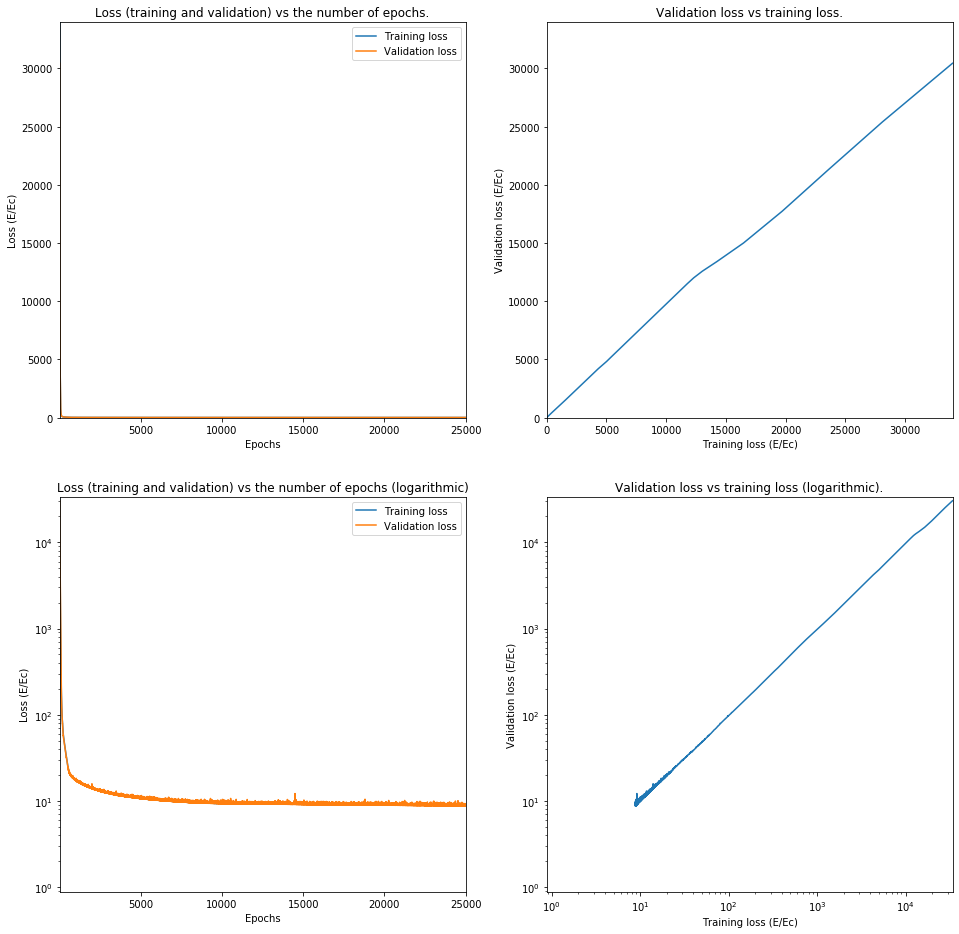

Train on 62644 samples, validate on 15662 samples
Epoch 1/25000
62644/62644 [==============================] - 2s 35us/step - loss: 577617.7890 - val_loss: 567038.2295
Epoch 2/25000
62644/62644 [==============================] - 2s 33us/step - loss: 555680.8461 - val_loss: 545013.6324
Epoch 3/25000
62644/62644 [==============================] - 2s 33us/step - loss: 533680.2519 - val_loss: 522884.5884
Epoch 4/25000
62644/62644 [==============================] - 2s 34us/step - loss: 511630.8693 - val_loss: 500779.4911
Epoch 5/25000
62644/62644 [==============================] - 2s 33us/step - loss: 489515.8259 - val_loss: 478559.9480
Epoch 6/25000
62644/62644 [==============================] - 2s 33us/step - loss: 467331.2846 - val_loss: 456245.0142
Epoch 7/25000
62644/62644 [==============================] - 2s 33us/step - loss: 445103.5570 - val_loss: 433905.2304
Epoch 8/25000
62644/62644 [==============================] - 2s 33us/step - loss: 422805.5750 - val_loss: 411482.5312
Epoch 

62644/62644 [==============================] - 2s 33us/step - loss: 3574.1937 - val_loss: 3560.7960
Epoch 71/25000
62644/62644 [==============================] - 2s 33us/step - loss: 3515.9946 - val_loss: 3499.8947
Epoch 72/25000
62644/62644 [==============================] - 2s 34us/step - loss: 3458.5130 - val_loss: 3441.2905
Epoch 73/25000
62644/62644 [==============================] - 2s 33us/step - loss: 3401.0172 - val_loss: 3383.5490
Epoch 74/25000
62644/62644 [==============================] - 2s 33us/step - loss: 3343.4988 - val_loss: 3328.0980
Epoch 75/25000
62644/62644 [==============================] - 2s 33us/step - loss: 3287.9916 - val_loss: 3270.0749
Epoch 76/25000
62644/62644 [==============================] - 2s 33us/step - loss: 3232.6763 - val_loss: 3213.6757
Epoch 77/25000
62644/62644 [==============================] - 2s 33us/step - loss: 3174.3762 - val_loss: 3154.4522
Epoch 78/25000
62644/62644 [==============================] - 2s 33us/step - loss: 3104.8059 - 

62644/62644 [==============================] - 2s 33us/step - loss: 238.3370 - val_loss: 236.0231
Epoch 142/25000
62644/62644 [==============================] - 2s 34us/step - loss: 235.2187 - val_loss: 232.4174
Epoch 143/25000
62644/62644 [==============================] - 2s 33us/step - loss: 232.3986 - val_loss: 231.5743
Epoch 144/25000
62644/62644 [==============================] - 2s 34us/step - loss: 229.5939 - val_loss: 230.9589
Epoch 145/25000
62644/62644 [==============================] - 2s 33us/step - loss: 227.0529 - val_loss: 223.8487
Epoch 146/25000
62644/62644 [==============================] - 2s 35us/step - loss: 224.5336 - val_loss: 221.3159
Epoch 147/25000
62644/62644 [==============================] - 2s 33us/step - loss: 222.0651 - val_loss: 218.4422
Epoch 148/25000
62644/62644 [==============================] - 2s 33us/step - loss: 219.5660 - val_loss: 217.2498
Epoch 149/25000
62644/62644 [==============================] - 2s 33us/step - loss: 217.1699 - val_loss:

62644/62644 [==============================] - 2s 33us/step - loss: 129.5382 - val_loss: 126.2096
Epoch 214/25000
62644/62644 [==============================] - 2s 33us/step - loss: 128.8462 - val_loss: 128.1964
Epoch 215/25000
62644/62644 [==============================] - 2s 32us/step - loss: 127.9603 - val_loss: 125.9328
Epoch 216/25000
62644/62644 [==============================] - 2s 34us/step - loss: 127.2655 - val_loss: 123.5939
Epoch 217/25000
62644/62644 [==============================] - 2s 33us/step - loss: 126.2932 - val_loss: 122.5376
Epoch 218/25000
62644/62644 [==============================] - 2s 33us/step - loss: 125.7156 - val_loss: 122.0971
Epoch 219/25000
62644/62644 [==============================] - 2s 33us/step - loss: 124.7571 - val_loss: 121.5052
Epoch 220/25000
62644/62644 [==============================] - 2s 35us/step - loss: 124.2936 - val_loss: 120.3786
Epoch 221/25000
62644/62644 [==============================] - 2s 34us/step - loss: 123.3884 - val_loss:

62644/62644 [==============================] - 2s 33us/step - loss: 88.8178 - val_loss: 87.5748
Epoch 286/25000
62644/62644 [==============================] - 2s 33us/step - loss: 88.3525 - val_loss: 88.3059
Epoch 287/25000
62644/62644 [==============================] - 2s 33us/step - loss: 87.9848 - val_loss: 87.4105
Epoch 288/25000
62644/62644 [==============================] - 2s 33us/step - loss: 87.5982 - val_loss: 85.9598
Epoch 289/25000
62644/62644 [==============================] - 2s 33us/step - loss: 87.1400 - val_loss: 85.3217
Epoch 290/25000
62644/62644 [==============================] - 2s 32us/step - loss: 86.7645 - val_loss: 85.1947
Epoch 291/25000
62644/62644 [==============================] - 2s 34us/step - loss: 86.4929 - val_loss: 84.8670
Epoch 292/25000
62644/62644 [==============================] - 2s 33us/step - loss: 86.1064 - val_loss: 85.0487
Epoch 293/25000
62644/62644 [==============================] - 2s 33us/step - loss: 85.7374 - val_loss: 84.0164
Epoch 29

62644/62644 [==============================] - 2s 33us/step - loss: 68.6727 - val_loss: 67.2365
Epoch 359/25000
62644/62644 [==============================] - 2s 34us/step - loss: 68.4669 - val_loss: 67.4413
Epoch 360/25000
62644/62644 [==============================] - 2s 34us/step - loss: 68.0043 - val_loss: 66.9228
Epoch 361/25000
62644/62644 [==============================] - 2s 33us/step - loss: 67.9122 - val_loss: 67.8065
Epoch 362/25000
62644/62644 [==============================] - 2s 33us/step - loss: 67.6392 - val_loss: 66.5455
Epoch 363/25000
62644/62644 [==============================] - 2s 34us/step - loss: 67.5476 - val_loss: 66.8715
Epoch 364/25000
62644/62644 [==============================] - 2s 35us/step - loss: 67.1997 - val_loss: 66.1401
Epoch 365/25000
62644/62644 [==============================] - 2s 33us/step - loss: 67.1692 - val_loss: 66.0055
Epoch 366/25000
62644/62644 [==============================] - 2s 33us/step - loss: 67.1352 - val_loss: 66.1531
Epoch 36

62644/62644 [==============================] - 2s 34us/step - loss: 58.9923 - val_loss: 58.3848
Epoch 432/25000
62644/62644 [==============================] - 2s 34us/step - loss: 58.7760 - val_loss: 57.2897
Epoch 433/25000
62644/62644 [==============================] - 2s 33us/step - loss: 58.7571 - val_loss: 57.3313
Epoch 434/25000
62644/62644 [==============================] - 2s 33us/step - loss: 58.5750 - val_loss: 58.9374
Epoch 435/25000
62644/62644 [==============================] - 2s 33us/step - loss: 58.6256 - val_loss: 57.5251
Epoch 436/25000
62644/62644 [==============================] - 2s 34us/step - loss: 58.4211 - val_loss: 57.6922
Epoch 437/25000
62644/62644 [==============================] - 2s 32us/step - loss: 58.3048 - val_loss: 57.7802
Epoch 438/25000
62644/62644 [==============================] - 2s 34us/step - loss: 58.2510 - val_loss: 57.2254
Epoch 439/25000
62644/62644 [==============================] - 2s 34us/step - loss: 58.1213 - val_loss: 56.5601
Epoch 44

62644/62644 [==============================] - 2s 35us/step - loss: 52.7418 - val_loss: 50.5302
Epoch 505/25000
62644/62644 [==============================] - 2s 33us/step - loss: 52.5904 - val_loss: 51.0676
Epoch 506/25000
62644/62644 [==============================] - 2s 33us/step - loss: 52.5364 - val_loss: 51.1142
Epoch 507/25000
62644/62644 [==============================] - 2s 33us/step - loss: 52.4555 - val_loss: 51.3925
Epoch 508/25000
62644/62644 [==============================] - 2s 33us/step - loss: 52.5017 - val_loss: 50.4066
Epoch 509/25000
62644/62644 [==============================] - 2s 33us/step - loss: 52.2770 - val_loss: 51.7388
Epoch 510/25000
62644/62644 [==============================] - 2s 33us/step - loss: 52.2142 - val_loss: 50.6898
Epoch 511/25000
62644/62644 [==============================] - 2s 33us/step - loss: 52.2465 - val_loss: 50.3610
Epoch 512/25000
62644/62644 [==============================] - 2s 34us/step - loss: 52.2362 - val_loss: 50.0179
Epoch 51

62644/62644 [==============================] - 2s 33us/step - loss: 47.5939 - val_loss: 45.9252
Epoch 578/25000
62644/62644 [==============================] - 2s 33us/step - loss: 47.4451 - val_loss: 45.4596
Epoch 579/25000
62644/62644 [==============================] - 2s 34us/step - loss: 47.3718 - val_loss: 46.7734
Epoch 580/25000
62644/62644 [==============================] - 2s 33us/step - loss: 47.3870 - val_loss: 45.1110
Epoch 581/25000
62644/62644 [==============================] - 2s 33us/step - loss: 47.2734 - val_loss: 45.1271
Epoch 582/25000
62644/62644 [==============================] - 2s 33us/step - loss: 47.2364 - val_loss: 45.2797
Epoch 583/25000
62644/62644 [==============================] - 2s 33us/step - loss: 47.2579 - val_loss: 45.7031
Epoch 584/25000
62644/62644 [==============================] - 2s 33us/step - loss: 47.0683 - val_loss: 45.6989
Epoch 585/25000
62644/62644 [==============================] - 2s 32us/step - loss: 46.9848 - val_loss: 44.9348
Epoch 58

62644/62644 [==============================] - 2s 34us/step - loss: 42.9083 - val_loss: 41.9112
Epoch 651/25000
62644/62644 [==============================] - 2s 32us/step - loss: 43.0091 - val_loss: 41.6565
Epoch 652/25000
62644/62644 [==============================] - 2s 32us/step - loss: 42.9513 - val_loss: 41.7861
Epoch 653/25000
62644/62644 [==============================] - 2s 34us/step - loss: 42.8519 - val_loss: 41.1259
Epoch 654/25000
62644/62644 [==============================] - 2s 33us/step - loss: 42.8523 - val_loss: 42.0945
Epoch 655/25000
62644/62644 [==============================] - 2s 33us/step - loss: 42.7237 - val_loss: 40.9687
Epoch 656/25000
62644/62644 [==============================] - 2s 33us/step - loss: 42.7531 - val_loss: 41.2288
Epoch 657/25000
62644/62644 [==============================] - 2s 33us/step - loss: 42.6692 - val_loss: 41.3362
Epoch 658/25000
62644/62644 [==============================] - 2s 32us/step - loss: 42.7238 - val_loss: 40.6346
Epoch 65

62644/62644 [==============================] - 2s 34us/step - loss: 39.1446 - val_loss: 38.9326
Epoch 724/25000
62644/62644 [==============================] - 2s 36us/step - loss: 39.0821 - val_loss: 38.4596
Epoch 725/25000
62644/62644 [==============================] - 2s 35us/step - loss: 38.9302 - val_loss: 37.2747
Epoch 726/25000
62644/62644 [==============================] - 2s 34us/step - loss: 39.0409 - val_loss: 38.5842
Epoch 727/25000
62644/62644 [==============================] - 2s 34us/step - loss: 38.8450 - val_loss: 37.2811
Epoch 728/25000
62644/62644 [==============================] - 2s 33us/step - loss: 38.9263 - val_loss: 37.4001
Epoch 729/25000
62644/62644 [==============================] - 2s 35us/step - loss: 38.8854 - val_loss: 37.4015
Epoch 730/25000
62644/62644 [==============================] - 2s 33us/step - loss: 38.8106 - val_loss: 37.0781
Epoch 731/25000
62644/62644 [==============================] - 2s 33us/step - loss: 38.7079 - val_loss: 37.5167
Epoch 73

62644/62644 [==============================] - 2s 33us/step - loss: 36.2846 - val_loss: 34.8519
Epoch 797/25000
62644/62644 [==============================] - 2s 33us/step - loss: 36.1106 - val_loss: 34.6624
Epoch 798/25000
62644/62644 [==============================] - 2s 34us/step - loss: 36.1422 - val_loss: 35.5049
Epoch 799/25000
62644/62644 [==============================] - 2s 33us/step - loss: 36.0462 - val_loss: 34.8474
Epoch 800/25000
62644/62644 [==============================] - 2s 33us/step - loss: 36.0262 - val_loss: 34.7705
Epoch 801/25000
62644/62644 [==============================] - 2s 33us/step - loss: 36.0450 - val_loss: 34.2901
Epoch 802/25000
62644/62644 [==============================] - 2s 33us/step - loss: 36.0175 - val_loss: 35.4344
Epoch 803/25000
62644/62644 [==============================] - 2s 34us/step - loss: 35.9213 - val_loss: 34.4177
Epoch 804/25000
62644/62644 [==============================] - 2s 34us/step - loss: 35.9457 - val_loss: 34.2633
Epoch 80

62644/62644 [==============================] - 2s 31us/step - loss: 34.2236 - val_loss: 33.4020
Epoch 870/25000
62644/62644 [==============================] - 2s 32us/step - loss: 34.1418 - val_loss: 32.7398
Epoch 871/25000
62644/62644 [==============================] - 2s 32us/step - loss: 34.1192 - val_loss: 32.9450
Epoch 872/25000
62644/62644 [==============================] - 2s 31us/step - loss: 34.0434 - val_loss: 34.8971
Epoch 873/25000
62644/62644 [==============================] - 2s 31us/step - loss: 34.3047 - val_loss: 33.2825
Epoch 874/25000
62644/62644 [==============================] - 2s 31us/step - loss: 34.0110 - val_loss: 33.1497
Epoch 875/25000
62644/62644 [==============================] - 2s 31us/step - loss: 33.9869 - val_loss: 33.8394
Epoch 876/25000
62644/62644 [==============================] - 2s 31us/step - loss: 34.0693 - val_loss: 33.2248
Epoch 877/25000
62644/62644 [==============================] - 2s 32us/step - loss: 33.9849 - val_loss: 32.4686
Epoch 87

62644/62644 [==============================] - 2s 31us/step - loss: 32.6604 - val_loss: 31.2054
Epoch 943/25000
62644/62644 [==============================] - 2s 31us/step - loss: 32.7257 - val_loss: 31.1253
Epoch 944/25000
62644/62644 [==============================] - 2s 32us/step - loss: 32.6320 - val_loss: 33.8064
Epoch 945/25000
62644/62644 [==============================] - 2s 31us/step - loss: 32.5719 - val_loss: 31.1716
Epoch 946/25000
62644/62644 [==============================] - 2s 31us/step - loss: 32.5949 - val_loss: 31.6473
Epoch 947/25000
62644/62644 [==============================] - 2s 31us/step - loss: 32.6229 - val_loss: 31.0432
Epoch 948/25000
62644/62644 [==============================] - 2s 31us/step - loss: 32.6494 - val_loss: 31.3217
Epoch 949/25000
62644/62644 [==============================] - 2s 31us/step - loss: 32.5258 - val_loss: 30.9682
Epoch 950/25000
62644/62644 [==============================] - 2s 31us/step - loss: 32.4986 - val_loss: 30.8516
Epoch 95

62644/62644 [==============================] - 2s 31us/step - loss: 31.4728 - val_loss: 30.1107
Epoch 1016/25000
62644/62644 [==============================] - 2s 31us/step - loss: 31.5256 - val_loss: 29.8169
Epoch 1017/25000
62644/62644 [==============================] - 2s 33us/step - loss: 31.4299 - val_loss: 30.8776
Epoch 1018/25000
62644/62644 [==============================] - 2s 32us/step - loss: 31.6151 - val_loss: 30.1582
Epoch 1019/25000
62644/62644 [==============================] - 2s 32us/step - loss: 31.3985 - val_loss: 29.8626
Epoch 1020/25000
62644/62644 [==============================] - 2s 32us/step - loss: 31.4366 - val_loss: 30.1568
Epoch 1021/25000
62644/62644 [==============================] - 2s 31us/step - loss: 31.4391 - val_loss: 31.8610
Epoch 1022/25000
62644/62644 [==============================] - 2s 32us/step - loss: 31.4478 - val_loss: 29.5884
Epoch 1023/25000
62644/62644 [==============================] - 2s 32us/step - loss: 31.4074 - val_loss: 31.1678


62644/62644 [==============================] - 2s 32us/step - loss: 30.5387 - val_loss: 32.2883
Epoch 1088/25000
62644/62644 [==============================] - 2s 31us/step - loss: 30.4286 - val_loss: 28.6142
Epoch 1089/25000
62644/62644 [==============================] - 2s 32us/step - loss: 30.5935 - val_loss: 28.4622
Epoch 1090/25000
62644/62644 [==============================] - 2s 32us/step - loss: 30.4373 - val_loss: 29.8371
Epoch 1091/25000
62644/62644 [==============================] - 2s 33us/step - loss: 30.4203 - val_loss: 28.4422
Epoch 1092/25000
62644/62644 [==============================] - 2s 32us/step - loss: 30.3839 - val_loss: 28.8154
Epoch 1093/25000
62644/62644 [==============================] - 2s 31us/step - loss: 30.4566 - val_loss: 28.7552
Epoch 1094/25000
62644/62644 [==============================] - 2s 32us/step - loss: 30.3250 - val_loss: 30.2867
Epoch 1095/25000
62644/62644 [==============================] - 2s 31us/step - loss: 30.3974 - val_loss: 29.1616


62644/62644 [==============================] - 2s 33us/step - loss: 29.5738 - val_loss: 29.3674
Epoch 1160/25000
62644/62644 [==============================] - 2s 33us/step - loss: 29.6518 - val_loss: 28.9253
Epoch 1161/25000
62644/62644 [==============================] - 2s 33us/step - loss: 29.5314 - val_loss: 27.4938
Epoch 1162/25000
62644/62644 [==============================] - 2s 31us/step - loss: 29.4674 - val_loss: 28.0052
Epoch 1163/25000
62644/62644 [==============================] - 2s 31us/step - loss: 29.4721 - val_loss: 27.6962
Epoch 1164/25000
62644/62644 [==============================] - 2s 32us/step - loss: 29.5241 - val_loss: 30.7754
Epoch 1165/25000
62644/62644 [==============================] - 2s 31us/step - loss: 29.4515 - val_loss: 28.2734
Epoch 1166/25000
62644/62644 [==============================] - 2s 31us/step - loss: 29.4211 - val_loss: 27.9255
Epoch 1167/25000
62644/62644 [==============================] - 2s 31us/step - loss: 29.4868 - val_loss: 27.9379


62644/62644 [==============================] - 2s 33us/step - loss: 28.7472 - val_loss: 26.8842
Epoch 1232/25000
62644/62644 [==============================] - 2s 33us/step - loss: 28.6826 - val_loss: 28.4487
Epoch 1233/25000
62644/62644 [==============================] - 2s 31us/step - loss: 28.6871 - val_loss: 26.6904
Epoch 1234/25000
62644/62644 [==============================] - 2s 31us/step - loss: 28.7162 - val_loss: 27.5560
Epoch 1235/25000
62644/62644 [==============================] - 2s 31us/step - loss: 28.5799 - val_loss: 26.7106
Epoch 1236/25000
62644/62644 [==============================] - 2s 32us/step - loss: 28.7030 - val_loss: 26.6895
Epoch 1237/25000
62644/62644 [==============================] - 2s 32us/step - loss: 28.5607 - val_loss: 26.9055
Epoch 1238/25000
62644/62644 [==============================] - 2s 31us/step - loss: 28.6137 - val_loss: 27.7268
Epoch 1239/25000
62644/62644 [==============================] - 2s 31us/step - loss: 28.6006 - val_loss: 27.4699


62644/62644 [==============================] - 2s 37us/step - loss: 27.9612 - val_loss: 25.7807
Epoch 1304/25000
62644/62644 [==============================] - 2s 38us/step - loss: 27.9387 - val_loss: 25.8136
Epoch 1305/25000
62644/62644 [==============================] - 2s 37us/step - loss: 27.9194 - val_loss: 25.7374
Epoch 1306/25000
62644/62644 [==============================] - 2s 38us/step - loss: 27.9431 - val_loss: 25.7713
Epoch 1307/25000
62644/62644 [==============================] - 2s 38us/step - loss: 27.9861 - val_loss: 26.6686
Epoch 1308/25000
62644/62644 [==============================] - 3s 40us/step - loss: 27.8086 - val_loss: 26.0333
Epoch 1309/25000
62644/62644 [==============================] - 2s 39us/step - loss: 27.9612 - val_loss: 25.7232
Epoch 1310/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.8886 - val_loss: 26.5226
Epoch 1311/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.8799 - val_loss: 27.4344


62644/62644 [==============================] - 2s 37us/step - loss: 27.2109 - val_loss: 26.4600
Epoch 1376/25000
62644/62644 [==============================] - 2s 37us/step - loss: 27.2054 - val_loss: 25.7347
Epoch 1377/25000
62644/62644 [==============================] - 2s 37us/step - loss: 27.1505 - val_loss: 25.6515
Epoch 1378/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.1795 - val_loss: 25.6762
Epoch 1379/25000
62644/62644 [==============================] - 2s 37us/step - loss: 27.2129 - val_loss: 25.1196
Epoch 1380/25000
62644/62644 [==============================] - 2s 37us/step - loss: 27.1387 - val_loss: 24.9447
Epoch 1381/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.3003 - val_loss: 24.9139
Epoch 1382/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.1534 - val_loss: 28.7541
Epoch 1383/25000
62644/62644 [==============================] - 2s 36us/step - loss: 27.2563 - val_loss: 25.6428


62644/62644 [==============================] - 2s 36us/step - loss: 26.5625 - val_loss: 24.3380
Epoch 1448/25000
62644/62644 [==============================] - 2s 33us/step - loss: 26.5414 - val_loss: 24.4337
Epoch 1449/25000
62644/62644 [==============================] - 2s 34us/step - loss: 26.4772 - val_loss: 24.2820
Epoch 1450/25000
62644/62644 [==============================] - 2s 36us/step - loss: 26.5818 - val_loss: 24.5331
Epoch 1451/25000
62644/62644 [==============================] - 2s 35us/step - loss: 26.4620 - val_loss: 27.1578
Epoch 1452/25000
62644/62644 [==============================] - 2s 36us/step - loss: 26.3288 - val_loss: 24.5001
Epoch 1453/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.4593 - val_loss: 24.3542
Epoch 1454/25000
62644/62644 [==============================] - 2s 32us/step - loss: 26.5335 - val_loss: 24.2306
Epoch 1455/25000
62644/62644 [==============================] - 2s 35us/step - loss: 26.3875 - val_loss: 24.3262


62644/62644 [==============================] - 2s 33us/step - loss: 25.7870 - val_loss: 24.1187
Epoch 1520/25000
62644/62644 [==============================] - 2s 33us/step - loss: 25.8293 - val_loss: 23.8753
Epoch 1521/25000
62644/62644 [==============================] - 2s 35us/step - loss: 25.7265 - val_loss: 24.4072
Epoch 1522/25000
62644/62644 [==============================] - 2s 33us/step - loss: 25.7886 - val_loss: 23.9673
Epoch 1523/25000
62644/62644 [==============================] - 2s 31us/step - loss: 25.7489 - val_loss: 24.0974
Epoch 1524/25000
62644/62644 [==============================] - 2s 31us/step - loss: 25.8708 - val_loss: 25.0582
Epoch 1525/25000
62644/62644 [==============================] - 2s 32us/step - loss: 25.8026 - val_loss: 23.6312
Epoch 1526/25000
62644/62644 [==============================] - 2s 31us/step - loss: 25.7692 - val_loss: 23.7994
Epoch 1527/25000
62644/62644 [==============================] - 2s 32us/step - loss: 25.6896 - val_loss: 24.5856


62644/62644 [==============================] - 2s 35us/step - loss: 25.1255 - val_loss: 23.2913
Epoch 1592/25000
62644/62644 [==============================] - 2s 34us/step - loss: 25.1664 - val_loss: 23.1611
Epoch 1593/25000
62644/62644 [==============================] - 2s 33us/step - loss: 25.1890 - val_loss: 23.1980
Epoch 1594/25000
62644/62644 [==============================] - 2s 32us/step - loss: 25.1960 - val_loss: 24.7873
Epoch 1595/25000
62644/62644 [==============================] - 2s 31us/step - loss: 25.1181 - val_loss: 23.3244
Epoch 1596/25000
62644/62644 [==============================] - 2s 33us/step - loss: 25.0711 - val_loss: 26.2229
Epoch 1597/25000
62644/62644 [==============================] - 2s 32us/step - loss: 25.1537 - val_loss: 24.9365
Epoch 1598/25000
62644/62644 [==============================] - 2s 33us/step - loss: 24.9925 - val_loss: 25.0928
Epoch 1599/25000
62644/62644 [==============================] - 2s 32us/step - loss: 25.1244 - val_loss: 23.1552


62644/62644 [==============================] - 2s 31us/step - loss: 24.5858 - val_loss: 23.9355
Epoch 1664/25000
62644/62644 [==============================] - 2s 32us/step - loss: 24.4988 - val_loss: 22.5250
Epoch 1665/25000
62644/62644 [==============================] - 2s 32us/step - loss: 24.5909 - val_loss: 25.6925
Epoch 1666/25000
62644/62644 [==============================] - 2s 31us/step - loss: 24.5427 - val_loss: 22.5634
Epoch 1667/25000
62644/62644 [==============================] - 2s 32us/step - loss: 24.5396 - val_loss: 22.5603
Epoch 1668/25000
62644/62644 [==============================] - 2s 31us/step - loss: 24.4464 - val_loss: 22.6606
Epoch 1669/25000
62644/62644 [==============================] - 2s 31us/step - loss: 24.4838 - val_loss: 22.6208
Epoch 1670/25000
62644/62644 [==============================] - 2s 32us/step - loss: 24.4756 - val_loss: 23.0173
Epoch 1671/25000
62644/62644 [==============================] - 2s 32us/step - loss: 24.4836 - val_loss: 23.6551


62644/62644 [==============================] - 2s 31us/step - loss: 24.0242 - val_loss: 23.8303
Epoch 1736/25000
62644/62644 [==============================] - 2s 33us/step - loss: 23.9828 - val_loss: 24.0974
Epoch 1737/25000
62644/62644 [==============================] - 2s 34us/step - loss: 24.0697 - val_loss: 25.1014
Epoch 1738/25000
62644/62644 [==============================] - 2s 33us/step - loss: 23.9434 - val_loss: 22.1860
Epoch 1739/25000
62644/62644 [==============================] - 2s 32us/step - loss: 24.0349 - val_loss: 22.2693
Epoch 1740/25000
62644/62644 [==============================] - 2s 32us/step - loss: 24.0425 - val_loss: 23.5337
Epoch 1741/25000
62644/62644 [==============================] - 2s 31us/step - loss: 24.0020 - val_loss: 22.5413
Epoch 1742/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.9138 - val_loss: 22.2712
Epoch 1743/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.9516 - val_loss: 23.2999


62644/62644 [==============================] - 2s 31us/step - loss: 23.5943 - val_loss: 22.1979
Epoch 1808/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.6413 - val_loss: 21.8167
Epoch 1809/25000
62644/62644 [==============================] - 2s 32us/step - loss: 23.6067 - val_loss: 23.9121
Epoch 1810/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.4812 - val_loss: 21.6757
Epoch 1811/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.4452 - val_loss: 22.3014
Epoch 1812/25000
62644/62644 [==============================] - 2s 33us/step - loss: 23.5168 - val_loss: 21.7448
Epoch 1813/25000
62644/62644 [==============================] - 2s 32us/step - loss: 23.4986 - val_loss: 22.1954
Epoch 1814/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.4561 - val_loss: 21.7783
Epoch 1815/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.6064 - val_loss: 21.7715


62644/62644 [==============================] - 2s 32us/step - loss: 23.2801 - val_loss: 21.3434
Epoch 1880/25000
62644/62644 [==============================] - 2s 32us/step - loss: 23.1561 - val_loss: 21.3280
Epoch 1881/25000
62644/62644 [==============================] - 2s 34us/step - loss: 23.0658 - val_loss: 22.3970
Epoch 1882/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.1633 - val_loss: 21.6244
Epoch 1883/25000
62644/62644 [==============================] - 2s 31us/step - loss: 23.0476 - val_loss: 21.5316
Epoch 1884/25000
62644/62644 [==============================] - 2s 32us/step - loss: 23.0780 - val_loss: 21.3001
Epoch 1885/25000
62644/62644 [==============================] - 2s 34us/step - loss: 23.0893 - val_loss: 21.3399
Epoch 1886/25000
62644/62644 [==============================] - 2s 32us/step - loss: 23.0957 - val_loss: 21.3222
Epoch 1887/25000
62644/62644 [==============================] - 2s 33us/step - loss: 23.1399 - val_loss: 23.0268


62644/62644 [==============================] - 2s 32us/step - loss: 22.7264 - val_loss: 24.6235
Epoch 1952/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.7593 - val_loss: 21.0562
Epoch 1953/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.7996 - val_loss: 21.3259
Epoch 1954/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.7337 - val_loss: 21.0156
Epoch 1955/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.7392 - val_loss: 20.9545
Epoch 1956/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.7493 - val_loss: 21.0311
Epoch 1957/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.6206 - val_loss: 21.3502
Epoch 1958/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.8125 - val_loss: 21.0360
Epoch 1959/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.6262 - val_loss: 24.6343


62644/62644 [==============================] - 2s 33us/step - loss: 22.4409 - val_loss: 21.1258
Epoch 2024/25000
62644/62644 [==============================] - 2s 33us/step - loss: 22.2963 - val_loss: 20.7755
Epoch 2025/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.3251 - val_loss: 20.6674
Epoch 2026/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.3554 - val_loss: 21.0086
Epoch 2027/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.4477 - val_loss: 21.2234
Epoch 2028/25000
62644/62644 [==============================] - 2s 33us/step - loss: 22.3319 - val_loss: 20.9993
Epoch 2029/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.4186 - val_loss: 22.5067
Epoch 2030/25000
62644/62644 [==============================] - 2s 33us/step - loss: 22.4273 - val_loss: 20.8628
Epoch 2031/25000
62644/62644 [==============================] - 2s 33us/step - loss: 22.4413 - val_loss: 21.1460


62644/62644 [==============================] - 2s 32us/step - loss: 21.9019 - val_loss: 20.4123
Epoch 2096/25000
62644/62644 [==============================] - 2s 31us/step - loss: 22.0121 - val_loss: 20.3871
Epoch 2097/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.9628 - val_loss: 20.3653
Epoch 2098/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.9965 - val_loss: 21.9896
Epoch 2099/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.9420 - val_loss: 22.5278
Epoch 2100/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.9838 - val_loss: 20.7236
Epoch 2101/25000
62644/62644 [==============================] - 2s 32us/step - loss: 22.0607 - val_loss: 23.3326
Epoch 2102/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.9385 - val_loss: 21.4395
Epoch 2103/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.9826 - val_loss: 20.8960


62644/62644 [==============================] - 2s 31us/step - loss: 21.6837 - val_loss: 20.0849
Epoch 2168/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.7311 - val_loss: 20.2222
Epoch 2169/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.5878 - val_loss: 20.2212
Epoch 2170/25000
62644/62644 [==============================] - 2s 30us/step - loss: 21.6265 - val_loss: 20.1184
Epoch 2171/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.5990 - val_loss: 20.2874
Epoch 2172/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.6710 - val_loss: 20.4862
Epoch 2173/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.6137 - val_loss: 20.0737
Epoch 2174/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.6257 - val_loss: 20.1958
Epoch 2175/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.6644 - val_loss: 20.4011


62644/62644 [==============================] - 2s 32us/step - loss: 21.2710 - val_loss: 19.8892
Epoch 2240/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3944 - val_loss: 19.7116
Epoch 2241/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3186 - val_loss: 20.0765
Epoch 2242/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2811 - val_loss: 20.9528
Epoch 2243/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.3082 - val_loss: 19.9444
Epoch 2244/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3775 - val_loss: 20.0949
Epoch 2245/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2955 - val_loss: 20.2703
Epoch 2246/25000
62644/62644 [==============================] - 2s 33us/step - loss: 21.3912 - val_loss: 19.7986
Epoch 2247/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3342 - val_loss: 19.7480


62644/62644 [==============================] - 2s 31us/step - loss: 21.0629 - val_loss: 22.5386
Epoch 2312/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.9652 - val_loss: 19.6411
Epoch 2313/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.9806 - val_loss: 20.3677
Epoch 2314/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.9556 - val_loss: 20.0047
Epoch 2315/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.0717 - val_loss: 21.7405
Epoch 2316/25000
62644/62644 [==============================] - 2s 32us/step - loss: 21.0637 - val_loss: 19.4674
Epoch 2317/25000
62644/62644 [==============================] - 2s 31us/step - loss: 21.0731 - val_loss: 19.9918
Epoch 2318/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.9056 - val_loss: 19.4613
Epoch 2319/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.9456 - val_loss: 19.3887


62644/62644 [==============================] - 2s 31us/step - loss: 20.6709 - val_loss: 19.2300
Epoch 2384/25000
62644/62644 [==============================] - 2s 33us/step - loss: 20.6478 - val_loss: 19.6268
Epoch 2385/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6129 - val_loss: 19.2888
Epoch 2386/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.5592 - val_loss: 19.6120
Epoch 2387/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6852 - val_loss: 19.2865
Epoch 2388/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6080 - val_loss: 19.4794
Epoch 2389/25000
62644/62644 [==============================] - 2s 33us/step - loss: 20.6519 - val_loss: 19.6599
Epoch 2390/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6149 - val_loss: 21.9767
Epoch 2391/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.6323 - val_loss: 23.2139


62644/62644 [==============================] - 2s 31us/step - loss: 20.4039 - val_loss: 19.3236
Epoch 2456/25000
62644/62644 [==============================] - 2s 33us/step - loss: 20.3247 - val_loss: 19.2504
Epoch 2457/25000
62644/62644 [==============================] - 2s 34us/step - loss: 20.3629 - val_loss: 21.0874
Epoch 2458/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.3485 - val_loss: 19.0650
Epoch 2459/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3142 - val_loss: 20.1028
Epoch 2460/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.2703 - val_loss: 19.2231
Epoch 2461/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.4018 - val_loss: 18.9588
Epoch 2462/25000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3979 - val_loss: 20.3018
Epoch 2463/25000
62644/62644 [==============================] - 2s 32us/step - loss: 20.2378 - val_loss: 21.5500


62644/62644 [==============================] - 2s 33us/step - loss: 19.8899 - val_loss: 19.8639
Epoch 2528/25000
62644/62644 [==============================] - 2s 33us/step - loss: 20.0112 - val_loss: 19.1752
Epoch 2529/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.9246 - val_loss: 18.7288
Epoch 2530/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.9465 - val_loss: 18.8233
Epoch 2531/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.9496 - val_loss: 18.9261
Epoch 2532/25000
62644/62644 [==============================] - 2s 33us/step - loss: 20.0178 - val_loss: 19.3434
Epoch 2533/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.9368 - val_loss: 18.8513
Epoch 2534/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.8509 - val_loss: 19.3688
Epoch 2535/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.9419 - val_loss: 19.2651


62644/62644 [==============================] - 2s 32us/step - loss: 19.5629 - val_loss: 18.5439
Epoch 2600/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6411 - val_loss: 18.7629
Epoch 2601/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6228 - val_loss: 19.1321
Epoch 2602/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6028 - val_loss: 18.5256
Epoch 2603/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5684 - val_loss: 18.8931
Epoch 2604/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6808 - val_loss: 19.0446
Epoch 2605/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5927 - val_loss: 18.7680
Epoch 2606/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5457 - val_loss: 18.9603
Epoch 2607/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5599 - val_loss: 18.5871


62644/62644 [==============================] - 2s 32us/step - loss: 19.2449 - val_loss: 20.1081
Epoch 2672/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2365 - val_loss: 19.7159
Epoch 2673/25000
62644/62644 [==============================] - 2s 32us/step - loss: 19.2835 - val_loss: 18.8038
Epoch 2674/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2127 - val_loss: 18.4051
Epoch 2675/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2408 - val_loss: 19.0449
Epoch 2676/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2423 - val_loss: 19.0709
Epoch 2677/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.3085 - val_loss: 21.9681
Epoch 2678/25000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2455 - val_loss: 18.5391
Epoch 2679/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.2620 - val_loss: 18.8892


62644/62644 [==============================] - 2s 31us/step - loss: 19.0467 - val_loss: 18.1621
Epoch 2744/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9945 - val_loss: 18.1489
Epoch 2745/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9804 - val_loss: 19.1227
Epoch 2746/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.8767 - val_loss: 18.7361
Epoch 2747/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.8716 - val_loss: 19.5483
Epoch 2748/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.8915 - val_loss: 19.1378
Epoch 2749/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.9827 - val_loss: 19.9967
Epoch 2750/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9562 - val_loss: 20.1684
Epoch 2751/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9517 - val_loss: 18.0779


62644/62644 [==============================] - 2s 31us/step - loss: 18.8022 - val_loss: 17.8705
Epoch 2816/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6993 - val_loss: 18.1198
Epoch 2817/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.7465 - val_loss: 18.4272
Epoch 2818/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.5730 - val_loss: 17.8290
Epoch 2819/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6892 - val_loss: 18.0958
Epoch 2820/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.6419 - val_loss: 19.3630
Epoch 2821/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6198 - val_loss: 17.8608
Epoch 2822/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.7243 - val_loss: 18.4657
Epoch 2823/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.6128 - val_loss: 17.8617


62644/62644 [==============================] - 2s 32us/step - loss: 18.3722 - val_loss: 18.3129
Epoch 2888/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.3493 - val_loss: 17.8676
Epoch 2889/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2460 - val_loss: 18.1110
Epoch 2890/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.3576 - val_loss: 17.6329
Epoch 2891/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.3163 - val_loss: 18.8859
Epoch 2892/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.3025 - val_loss: 20.8479
Epoch 2893/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.3528 - val_loss: 17.5641
Epoch 2894/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2933 - val_loss: 18.0256
Epoch 2895/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2681 - val_loss: 17.8823


62644/62644 [==============================] - 2s 32us/step - loss: 17.9891 - val_loss: 17.8817
Epoch 2960/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0562 - val_loss: 17.3679
Epoch 2961/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.9728 - val_loss: 19.5666
Epoch 2962/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0907 - val_loss: 18.3519
Epoch 2963/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.0397 - val_loss: 17.6199
Epoch 2964/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.0620 - val_loss: 17.3204
Epoch 2965/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.9233 - val_loss: 17.1931
Epoch 2966/25000
62644/62644 [==============================] - 2s 32us/step - loss: 18.1849 - val_loss: 17.2053
Epoch 2967/25000
62644/62644 [==============================] - 2s 31us/step - loss: 18.0047 - val_loss: 18.4781


62644/62644 [==============================] - 2s 31us/step - loss: 17.7519 - val_loss: 17.0437
Epoch 3032/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7450 - val_loss: 17.0667
Epoch 3033/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6912 - val_loss: 16.9761
Epoch 3034/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6436 - val_loss: 17.0557
Epoch 3035/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.6651 - val_loss: 17.3066
Epoch 3036/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6044 - val_loss: 17.5022
Epoch 3037/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6781 - val_loss: 18.4099
Epoch 3038/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7042 - val_loss: 17.0952
Epoch 3039/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.6723 - val_loss: 17.1721


62644/62644 [==============================] - 2s 33us/step - loss: 17.4991 - val_loss: 17.4287
Epoch 3104/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.4271 - val_loss: 16.9538
Epoch 3105/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4557 - val_loss: 16.8471
Epoch 3106/25000
62644/62644 [==============================] - 2s 34us/step - loss: 17.5175 - val_loss: 17.9193
Epoch 3107/25000
62644/62644 [==============================] - 2s 34us/step - loss: 17.3455 - val_loss: 16.5447
Epoch 3108/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.4923 - val_loss: 16.5827
Epoch 3109/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4733 - val_loss: 16.6172
Epoch 3110/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4065 - val_loss: 17.3384
Epoch 3111/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3304 - val_loss: 17.1921


62644/62644 [==============================] - 2s 33us/step - loss: 17.2564 - val_loss: 16.3875
Epoch 3176/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.1159 - val_loss: 17.1718
Epoch 3177/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.2070 - val_loss: 16.3033
Epoch 3178/25000
62644/62644 [==============================] - 2s 34us/step - loss: 17.1700 - val_loss: 17.8589
Epoch 3179/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.2462 - val_loss: 17.1898
Epoch 3180/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.3318 - val_loss: 16.3058
Epoch 3181/25000
62644/62644 [==============================] - 2s 31us/step - loss: 17.1825 - val_loss: 16.6510
Epoch 3182/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.1794 - val_loss: 16.3700
Epoch 3183/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.2182 - val_loss: 16.6452


62644/62644 [==============================] - 2s 32us/step - loss: 16.9613 - val_loss: 16.3600
Epoch 3248/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0456 - val_loss: 15.9826
Epoch 3249/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0939 - val_loss: 16.1850
Epoch 3250/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9779 - val_loss: 16.5291
Epoch 3251/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9343 - val_loss: 16.2744
Epoch 3252/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9337 - val_loss: 16.2763
Epoch 3253/25000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0360 - val_loss: 17.2024
Epoch 3254/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.9612 - val_loss: 16.6602
Epoch 3255/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9395 - val_loss: 16.0070


62644/62644 [==============================] - 2s 31us/step - loss: 16.7107 - val_loss: 15.6129
Epoch 3320/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.7266 - val_loss: 15.6449
Epoch 3321/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.6911 - val_loss: 16.1683
Epoch 3322/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.6983 - val_loss: 15.9769
Epoch 3323/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.6792 - val_loss: 15.6482
Epoch 3324/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.5721 - val_loss: 15.7222
Epoch 3325/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.7142 - val_loss: 15.5991
Epoch 3326/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.6872 - val_loss: 16.0495
Epoch 3327/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8164 - val_loss: 15.8348


62644/62644 [==============================] - 2s 31us/step - loss: 16.1891 - val_loss: 15.8089
Epoch 3392/25000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1215 - val_loss: 15.2306
Epoch 3393/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.1183 - val_loss: 15.2397
Epoch 3394/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.1346 - val_loss: 15.2280
Epoch 3395/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.0888 - val_loss: 15.7000
Epoch 3396/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.1942 - val_loss: 15.8502
Epoch 3397/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.1303 - val_loss: 15.2759
Epoch 3398/25000
62644/62644 [==============================] - 2s 32us/step - loss: 16.2275 - val_loss: 15.8133
Epoch 3399/25000
62644/62644 [==============================] - 2s 31us/step - loss: 16.1658 - val_loss: 15.2802


62644/62644 [==============================] - 2s 31us/step - loss: 15.7099 - val_loss: 14.7814
Epoch 3464/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.6204 - val_loss: 15.0779
Epoch 3465/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.5723 - val_loss: 17.7890
Epoch 3466/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.6894 - val_loss: 14.9306
Epoch 3467/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.5966 - val_loss: 14.9634
Epoch 3468/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.5098 - val_loss: 15.1930
Epoch 3469/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.6394 - val_loss: 14.8101
Epoch 3470/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.6162 - val_loss: 16.5089
Epoch 3471/25000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5193 - val_loss: 14.6848


62644/62644 [==============================] - 2s 31us/step - loss: 15.2539 - val_loss: 14.8217
Epoch 3536/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.2632 - val_loss: 14.3648
Epoch 3537/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.1546 - val_loss: 14.6676
Epoch 3538/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1682 - val_loss: 14.9112
Epoch 3539/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.2359 - val_loss: 14.3451
Epoch 3540/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2046 - val_loss: 14.4191
Epoch 3541/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1925 - val_loss: 14.7246
Epoch 3542/25000
62644/62644 [==============================] - 2s 31us/step - loss: 15.1187 - val_loss: 15.9239
Epoch 3543/25000
62644/62644 [==============================] - 2s 32us/step - loss: 15.2374 - val_loss: 14.7046


62644/62644 [==============================] - 2s 31us/step - loss: 14.8296 - val_loss: 14.2759
Epoch 3608/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7219 - val_loss: 13.8246
Epoch 3609/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.7493 - val_loss: 14.0953
Epoch 3610/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6487 - val_loss: 14.4825
Epoch 3611/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.7609 - val_loss: 13.7675
Epoch 3612/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.8031 - val_loss: 14.5982
Epoch 3613/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.6707 - val_loss: 13.9522
Epoch 3614/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.7790 - val_loss: 16.1054
Epoch 3615/25000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7985 - val_loss: 13.8203


62644/62644 [==============================] - 2s 31us/step - loss: 13.8938 - val_loss: 13.3151
Epoch 3680/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.9426 - val_loss: 13.9925
Epoch 3681/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.8834 - val_loss: 14.8864
Epoch 3682/25000
62644/62644 [==============================] - 2s 31us/step - loss: 14.0383 - val_loss: 14.0314
Epoch 3683/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.9086 - val_loss: 13.5656
Epoch 3684/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8833 - val_loss: 13.2902
Epoch 3685/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8546 - val_loss: 13.1253
Epoch 3686/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.8403 - val_loss: 14.2015
Epoch 3687/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.9255 - val_loss: 13.4046


62644/62644 [==============================] - 2s 32us/step - loss: 12.8995 - val_loss: 12.5105
Epoch 3752/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.9830 - val_loss: 13.3370
Epoch 3753/25000
62644/62644 [==============================] - 2s 31us/step - loss: 13.0254 - val_loss: 12.6987
Epoch 3754/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.9618 - val_loss: 14.6389
Epoch 3755/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.8811 - val_loss: 14.4671
Epoch 3756/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.9395 - val_loss: 12.9852
Epoch 3757/25000
62644/62644 [==============================] - 2s 32us/step - loss: 13.0196 - val_loss: 12.8545
Epoch 3758/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.9876 - val_loss: 15.0259
Epoch 3759/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.0433 - val_loss: 12.3592


62644/62644 [==============================] - 2s 31us/step - loss: 12.1810 - val_loss: 11.8766
Epoch 3824/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.2904 - val_loss: 11.4223
Epoch 3825/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.1014 - val_loss: 11.6431
Epoch 3826/25000
62644/62644 [==============================] - 2s 33us/step - loss: 12.1658 - val_loss: 14.1746
Epoch 3827/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.0947 - val_loss: 11.4603
Epoch 3828/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.2193 - val_loss: 12.5567
Epoch 3829/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.2038 - val_loss: 11.5290
Epoch 3830/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1623 - val_loss: 13.5088
Epoch 3831/25000
62644/62644 [==============================] - 2s 32us/step - loss: 12.1407 - val_loss: 11.4006


62644/62644 [==============================] - 2s 33us/step - loss: 11.5286 - val_loss: 10.5764
Epoch 3896/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.5171 - val_loss: 10.9731
Epoch 3897/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4896 - val_loss: 10.6554
Epoch 3898/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.4112 - val_loss: 10.5668
Epoch 3899/25000
62644/62644 [==============================] - 2s 31us/step - loss: 11.4595 - val_loss: 10.5346
Epoch 3900/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3730 - val_loss: 10.6483
Epoch 3901/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3937 - val_loss: 11.1088
Epoch 3902/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.3847 - val_loss: 10.9921
Epoch 3903/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.4838 - val_loss: 11.0839


62644/62644 [==============================] - 2s 33us/step - loss: 10.8177 - val_loss: 10.7801
Epoch 3968/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0061 - val_loss: 10.8571
Epoch 3969/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.9071 - val_loss: 13.3422
Epoch 3970/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8902 - val_loss: 10.9733
Epoch 3971/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9047 - val_loss: 11.3566
Epoch 3972/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9932 - val_loss: 10.5032
Epoch 3973/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0324 - val_loss: 10.1064
Epoch 3974/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0088 - val_loss: 11.4192
Epoch 3975/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.9064 - val_loss: 9.9693
E

Epoch 4040/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6773 - val_loss: 9.8417
Epoch 4041/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.8389 - val_loss: 10.4833
Epoch 4042/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.7701 - val_loss: 10.1719
Epoch 4043/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.7811 - val_loss: 9.8885
Epoch 4044/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.7264 - val_loss: 13.7999
Epoch 4045/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.8093 - val_loss: 10.3973
Epoch 4046/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5887 - val_loss: 12.8212
Epoch 4047/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.6313 - val_loss: 9.9314
Epoch 4048/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.7512 - val_

62644/62644 [==============================] - 2s 31us/step - loss: 10.6889 - val_loss: 9.9785
Epoch 4113/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.6584 - val_loss: 9.7247
Epoch 4114/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5160 - val_loss: 9.8972
Epoch 4115/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.6071 - val_loss: 9.6615
Epoch 4116/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5532 - val_loss: 9.8769
Epoch 4117/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.6305 - val_loss: 9.8287
Epoch 4118/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5798 - val_loss: 10.5878
Epoch 4119/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5171 - val_loss: 10.9387
Epoch 4120/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5858 - val_loss: 10.0455
Epoch 

Epoch 4185/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5177 - val_loss: 9.8391
Epoch 4186/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5292 - val_loss: 10.1210
Epoch 4187/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5393 - val_loss: 10.1286
Epoch 4188/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4843 - val_loss: 9.7697
Epoch 4189/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5634 - val_loss: 10.9133
Epoch 4190/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5191 - val_loss: 9.7320
Epoch 4191/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.6710 - val_loss: 9.7838
Epoch 4192/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4355 - val_loss: 10.3599
Epoch 4193/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5469 - val_l

Epoch 4258/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4804 - val_loss: 11.2628
Epoch 4259/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5419 - val_loss: 10.9817
Epoch 4260/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4552 - val_loss: 9.6716
Epoch 4261/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.6067 - val_loss: 9.5848
Epoch 4262/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4598 - val_loss: 9.6243
Epoch 4263/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4832 - val_loss: 11.5629
Epoch 4264/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4421 - val_loss: 9.6365
Epoch 4265/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.6315 - val_loss: 12.0036
Epoch 4266/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5443 - val_l

Epoch 4331/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4817 - val_loss: 9.5540
Epoch 4332/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4510 - val_loss: 9.8479
Epoch 4333/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.5852 - val_loss: 10.2970
Epoch 4334/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3753 - val_loss: 9.7508
Epoch 4335/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.5106 - val_loss: 10.5541
Epoch 4336/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4523 - val_loss: 9.6554
Epoch 4337/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4437 - val_loss: 9.7715
Epoch 4338/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6242 - val_loss: 9.5726
Epoch 4339/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.3521 - val_los

Epoch 4404/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.5422 - val_loss: 9.5661
Epoch 4405/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3938 - val_loss: 9.5577
Epoch 4406/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4002 - val_loss: 11.7310
Epoch 4407/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4658 - val_loss: 9.8297
Epoch 4408/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.5011 - val_loss: 11.1156
Epoch 4409/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4624 - val_loss: 9.9620
Epoch 4410/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3956 - val_loss: 9.8266
Epoch 4411/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5877 - val_loss: 11.2136
Epoch 4412/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3859 - val_lo

Epoch 4477/25000
62644/62644 [==============================] - 3s 46us/step - loss: 10.4789 - val_loss: 9.6865
Epoch 4478/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4361 - val_loss: 9.6829
Epoch 4479/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3729 - val_loss: 9.7956
Epoch 4480/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3608 - val_loss: 11.4826
Epoch 4481/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4941 - val_loss: 10.8584
Epoch 4482/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3165 - val_loss: 9.7003
Epoch 4483/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3370 - val_loss: 9.4565
Epoch 4484/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3469 - val_loss: 9.4939
Epoch 4485/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4783 - val_los

Epoch 4550/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3764 - val_loss: 10.0648
Epoch 4551/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3635 - val_loss: 9.7472
Epoch 4552/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3661 - val_loss: 9.5724
Epoch 4553/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4098 - val_loss: 10.1418
Epoch 4554/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4096 - val_loss: 9.9503
Epoch 4555/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3451 - val_loss: 9.9605
Epoch 4556/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4252 - val_loss: 9.4959
Epoch 4557/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4611 - val_loss: 10.7177
Epoch 4558/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4298 - val_lo

Epoch 4623/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3842 - val_loss: 10.9157
Epoch 4624/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3905 - val_loss: 10.8225
Epoch 4625/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3976 - val_loss: 10.1291
Epoch 4626/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4054 - val_loss: 9.7225
Epoch 4627/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4280 - val_loss: 9.4797
Epoch 4628/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3236 - val_loss: 9.6728
Epoch 4629/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3015 - val_loss: 9.6627
Epoch 4630/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4194 - val_loss: 9.4265
Epoch 4631/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3297 - val_lo

Epoch 4696/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3965 - val_loss: 10.2031
Epoch 4697/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2981 - val_loss: 9.4344
Epoch 4698/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2858 - val_loss: 9.5446
Epoch 4699/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4368 - val_loss: 9.4805
Epoch 4700/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3886 - val_loss: 9.6400
Epoch 4701/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3151 - val_loss: 9.6890
Epoch 4702/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3670 - val_loss: 9.5660
Epoch 4703/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3824 - val_loss: 9.5198
Epoch 4704/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3539 - val_loss

Epoch 4769/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.4873 - val_loss: 9.4675
Epoch 4770/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3127 - val_loss: 9.3982
Epoch 4771/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3359 - val_loss: 9.7999
Epoch 4772/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3660 - val_loss: 10.5912
Epoch 4773/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3379 - val_loss: 11.9122
Epoch 4774/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3280 - val_loss: 10.2167
Epoch 4775/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2833 - val_loss: 9.4447
Epoch 4776/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3559 - val_loss: 10.3984
Epoch 4777/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4823 - val_l

Epoch 4842/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3108 - val_loss: 9.4542
Epoch 4843/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3236 - val_loss: 9.3626
Epoch 4844/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2713 - val_loss: 9.8334
Epoch 4845/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3585 - val_loss: 11.7075
Epoch 4846/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2088 - val_loss: 9.5415
Epoch 4847/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3409 - val_loss: 10.2562
Epoch 4848/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2559 - val_loss: 14.4930
Epoch 4849/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3647 - val_loss: 9.6263
Epoch 4850/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3211 - val_lo

Epoch 4915/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2372 - val_loss: 9.5355
Epoch 4916/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2771 - val_loss: 9.6001
Epoch 4917/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2763 - val_loss: 10.8224
Epoch 4918/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4265 - val_loss: 10.2866
Epoch 4919/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2247 - val_loss: 10.2951
Epoch 4920/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3971 - val_loss: 9.7875
Epoch 4921/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3092 - val_loss: 9.9918
Epoch 4922/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.4319 - val_loss: 9.6651
Epoch 4923/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3111 - val_lo

Epoch 4988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3581 - val_loss: 9.4100
Epoch 4989/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2346 - val_loss: 9.6793
Epoch 4990/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3563 - val_loss: 10.9456
Epoch 4991/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2250 - val_loss: 10.3740
Epoch 4992/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2938 - val_loss: 9.4805
Epoch 4993/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2621 - val_loss: 9.7110
Epoch 4994/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2481 - val_loss: 10.4616
Epoch 4995/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3150 - val_loss: 9.3941
Epoch 4996/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2577 - val_lo

Epoch 5061/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2400 - val_loss: 9.3299
Epoch 5062/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2729 - val_loss: 10.4249
Epoch 5063/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3380 - val_loss: 9.4417
Epoch 5064/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.3615 - val_loss: 10.6218
Epoch 5065/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1967 - val_loss: 9.9749
Epoch 5066/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2417 - val_loss: 10.2095
Epoch 5067/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3234 - val_loss: 10.8661
Epoch 5068/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.4379 - val_loss: 10.7137
Epoch 5069/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2206 - val_

Epoch 5134/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2492 - val_loss: 9.5165
Epoch 5135/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2527 - val_loss: 9.5880
Epoch 5136/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3114 - val_loss: 9.5472
Epoch 5137/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1410 - val_loss: 9.8760
Epoch 5138/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2716 - val_loss: 9.6608
Epoch 5139/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2906 - val_loss: 10.7519
Epoch 5140/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2882 - val_loss: 9.7483
Epoch 5141/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2614 - val_loss: 10.0061
Epoch 5142/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2483 - val_los

Epoch 5207/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2316 - val_loss: 10.4984
Epoch 5208/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3020 - val_loss: 10.3479
Epoch 5209/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1703 - val_loss: 10.1410
Epoch 5210/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2781 - val_loss: 9.3411
Epoch 5211/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2673 - val_loss: 9.7429
Epoch 5212/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1625 - val_loss: 9.6051
Epoch 5213/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2938 - val_loss: 9.5876
Epoch 5214/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2368 - val_loss: 10.0742
Epoch 5215/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3161 - val_l

Epoch 5280/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2648 - val_loss: 10.7625
Epoch 5281/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2409 - val_loss: 9.7111
Epoch 5282/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2865 - val_loss: 10.1908
Epoch 5283/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3560 - val_loss: 10.2185
Epoch 5284/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2079 - val_loss: 10.0538
Epoch 5285/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2824 - val_loss: 9.5039
Epoch 5286/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2023 - val_loss: 9.4891
Epoch 5287/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2022 - val_loss: 9.4652
Epoch 5288/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2084 - val_l

Epoch 5353/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2467 - val_loss: 9.8441
Epoch 5354/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3067 - val_loss: 12.0429
Epoch 5355/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1084 - val_loss: 9.3544
Epoch 5356/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2445 - val_loss: 10.8825
Epoch 5357/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1563 - val_loss: 10.6946
Epoch 5358/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2658 - val_loss: 11.2181
Epoch 5359/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2338 - val_loss: 9.5203
Epoch 5360/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2080 - val_loss: 9.3882
Epoch 5361/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3249 - val_l

Epoch 5426/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2198 - val_loss: 9.5218
Epoch 5427/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1657 - val_loss: 9.9692
Epoch 5428/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2869 - val_loss: 9.7169
Epoch 5429/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1988 - val_loss: 9.3327
Epoch 5430/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3415 - val_loss: 9.4156
Epoch 5431/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2387 - val_loss: 9.3615
Epoch 5432/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2278 - val_loss: 9.3902
Epoch 5433/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1795 - val_loss: 11.1490
Epoch 5434/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1701 - val_loss

Epoch 5499/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2565 - val_loss: 10.4467
Epoch 5500/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1862 - val_loss: 9.4108
Epoch 5501/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1793 - val_loss: 10.5109
Epoch 5502/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2756 - val_loss: 9.7834
Epoch 5503/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2542 - val_loss: 10.9013
Epoch 5504/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0434 - val_loss: 9.2879
Epoch 5505/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2820 - val_loss: 9.3501
Epoch 5506/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1958 - val_loss: 9.6482
Epoch 5507/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1960 - val_lo

Epoch 5572/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1409 - val_loss: 9.3025
Epoch 5573/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2237 - val_loss: 9.3805
Epoch 5574/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2991 - val_loss: 9.2554
Epoch 5575/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1103 - val_loss: 9.2762
Epoch 5576/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1876 - val_loss: 9.6114
Epoch 5577/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.3205 - val_loss: 10.5652
Epoch 5578/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2443 - val_loss: 9.2856
Epoch 5579/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1785 - val_loss: 9.3154
Epoch 5580/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2186 - val_loss

Epoch 5645/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2424 - val_loss: 9.3408
Epoch 5646/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1274 - val_loss: 9.2453
Epoch 5647/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.3113 - val_loss: 9.2311
Epoch 5648/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1238 - val_loss: 10.1147
Epoch 5649/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1536 - val_loss: 9.2781
Epoch 5650/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2105 - val_loss: 10.1334
Epoch 5651/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1479 - val_loss: 10.2236
Epoch 5652/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1598 - val_loss: 11.4372
Epoch 5653/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1974 - val_l

Epoch 5718/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1483 - val_loss: 9.2707
Epoch 5719/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1867 - val_loss: 9.3384
Epoch 5720/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1959 - val_loss: 9.3652
Epoch 5721/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1497 - val_loss: 10.3447
Epoch 5722/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1502 - val_loss: 9.4723
Epoch 5723/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0980 - val_loss: 10.2972
Epoch 5724/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2399 - val_loss: 9.4587
Epoch 5725/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2337 - val_loss: 13.6032
Epoch 5726/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0806 - val_lo

Epoch 5791/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1686 - val_loss: 9.4842
Epoch 5792/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2126 - val_loss: 10.0675
Epoch 5793/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1933 - val_loss: 9.3363
Epoch 5794/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0587 - val_loss: 9.4023
Epoch 5795/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2260 - val_loss: 9.3238
Epoch 5796/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.2453 - val_loss: 9.7265
Epoch 5797/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1059 - val_loss: 10.4987
Epoch 5798/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1011 - val_loss: 12.1536
Epoch 5799/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1748 - val_lo

Epoch 5864/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1401 - val_loss: 10.0413
Epoch 5865/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1681 - val_loss: 9.9176
Epoch 5866/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1440 - val_loss: 9.8499
Epoch 5867/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0840 - val_loss: 9.2592
Epoch 5868/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1911 - val_loss: 9.2813
Epoch 5869/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1337 - val_loss: 9.3908
Epoch 5870/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1570 - val_loss: 9.2827
Epoch 5871/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1236 - val_loss: 10.0238
Epoch 5872/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1356 - val_los

Epoch 5937/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0581 - val_loss: 9.8641
Epoch 5938/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1559 - val_loss: 10.5643
Epoch 5939/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1055 - val_loss: 9.2261
Epoch 5940/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1485 - val_loss: 10.7215
Epoch 5941/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1071 - val_loss: 9.4645
Epoch 5942/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1375 - val_loss: 10.8393
Epoch 5943/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1008 - val_loss: 9.3174
Epoch 5944/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1439 - val_loss: 9.4614
Epoch 5945/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0526 - val_lo

Epoch 6010/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1541 - val_loss: 10.4683
Epoch 6011/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1074 - val_loss: 12.1648
Epoch 6012/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1270 - val_loss: 9.8132
Epoch 6013/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1731 - val_loss: 10.1503
Epoch 6014/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1197 - val_loss: 12.5722
Epoch 6015/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0821 - val_loss: 9.3428
Epoch 6016/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1139 - val_loss: 10.7678
Epoch 6017/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.2418 - val_loss: 9.4955
Epoch 6018/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1593 - val_

Epoch 6083/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0730 - val_loss: 9.3969
Epoch 6084/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1223 - val_loss: 10.5679
Epoch 6085/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1190 - val_loss: 9.2147
Epoch 6086/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0566 - val_loss: 9.5113
Epoch 6087/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2476 - val_loss: 9.7432
Epoch 6088/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0757 - val_loss: 9.2834
Epoch 6089/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1617 - val_loss: 9.4086
Epoch 6090/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0807 - val_loss: 10.1974
Epoch 6091/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1374 - val_los

Epoch 6156/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0574 - val_loss: 9.6883
Epoch 6157/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0318 - val_loss: 9.3162
Epoch 6158/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0760 - val_loss: 9.2514
Epoch 6159/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0341 - val_loss: 9.6422
Epoch 6160/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1404 - val_loss: 10.3130
Epoch 6161/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0827 - val_loss: 9.7799
Epoch 6162/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0441 - val_loss: 9.7382
Epoch 6163/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1799 - val_loss: 9.7197
Epoch 6164/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1013 - val_loss

Epoch 6229/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.1609 - val_loss: 11.5341
Epoch 6230/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0377 - val_loss: 9.8383
Epoch 6231/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1726 - val_loss: 10.1792
Epoch 6232/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0578 - val_loss: 10.0572
Epoch 6233/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0533 - val_loss: 9.8612
Epoch 6234/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0968 - val_loss: 10.7855
Epoch 6235/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1631 - val_loss: 9.2258
Epoch 6236/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0056 - val_loss: 9.1938
Epoch 6237/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0965 - val_l

62644/62644 [==============================] - 2s 31us/step - loss: 10.0824 - val_loss: 10.0096
Epoch 6303/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0658 - val_loss: 9.7176
Epoch 6304/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1184 - val_loss: 9.4735
Epoch 6305/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0176 - val_loss: 9.3958
Epoch 6306/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9995 - val_loss: 9.2955
Epoch 6307/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0556 - val_loss: 10.6510
Epoch 6308/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.2427 - val_loss: 9.5298
Epoch 6309/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0863 - val_loss: 10.2389
Epoch 6310/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0631 - val_loss: 9.5638
Epoch 6

62644/62644 [==============================] - 2s 32us/step - loss: 10.1045 - val_loss: 9.5133
Epoch 6376/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1030 - val_loss: 9.2408
Epoch 6377/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0436 - val_loss: 9.3978
Epoch 6378/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9877 - val_loss: 9.1966
Epoch 6379/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0818 - val_loss: 9.5360
Epoch 6380/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0769 - val_loss: 9.4939
Epoch 6381/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1015 - val_loss: 9.2049
Epoch 6382/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0027 - val_loss: 9.6063
Epoch 6383/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0932 - val_loss: 9.2237
Epoch 6384

62644/62644 [==============================] - 2s 32us/step - loss: 9.9328 - val_loss: 9.2473
Epoch 6449/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0314 - val_loss: 9.0971
Epoch 6450/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9987 - val_loss: 12.2684
Epoch 6451/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0537 - val_loss: 9.3350
Epoch 6452/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9577 - val_loss: 9.3590
Epoch 6453/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0273 - val_loss: 9.2097
Epoch 6454/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0289 - val_loss: 9.4281
Epoch 6455/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0497 - val_loss: 10.2065
Epoch 6456/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0615 - val_loss: 9.1381
Epoch 6457

62644/62644 [==============================] - 2s 32us/step - loss: 10.0380 - val_loss: 9.1102
Epoch 6522/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0824 - val_loss: 9.3672
Epoch 6523/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9828 - val_loss: 11.6052
Epoch 6524/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0497 - val_loss: 9.2967
Epoch 6525/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9812 - val_loss: 9.9799
Epoch 6526/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0803 - val_loss: 9.3232
Epoch 6527/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0174 - val_loss: 9.3719
Epoch 6528/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0396 - val_loss: 11.4509
Epoch 6529/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0143 - val_loss: 9.5059
Epoch 653

62644/62644 [==============================] - 2s 31us/step - loss: 10.0223 - val_loss: 9.3500
Epoch 6595/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0297 - val_loss: 10.7906
Epoch 6596/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0420 - val_loss: 9.7107
Epoch 6597/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9442 - val_loss: 10.8201
Epoch 6598/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0894 - val_loss: 10.5562
Epoch 6599/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0023 - val_loss: 9.1281
Epoch 6600/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0048 - val_loss: 9.5200
Epoch 6601/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9847 - val_loss: 11.1224
Epoch 6602/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0261 - val_loss: 10.1879
Epoch 

62644/62644 [==============================] - 2s 33us/step - loss: 10.0656 - val_loss: 9.1507
Epoch 6668/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9293 - val_loss: 9.1460
Epoch 6669/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0405 - val_loss: 10.0037
Epoch 6670/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0536 - val_loss: 11.3496
Epoch 6671/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0543 - val_loss: 9.7721
Epoch 6672/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0755 - val_loss: 9.3931
Epoch 6673/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9836 - val_loss: 9.1975
Epoch 6674/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0489 - val_loss: 9.7091
Epoch 6675/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0226 - val_loss: 10.2922
Epoch 66

62644/62644 [==============================] - 2s 33us/step - loss: 10.0852 - val_loss: 9.3372
Epoch 6741/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0064 - val_loss: 13.3993
Epoch 6742/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0439 - val_loss: 9.8999
Epoch 6743/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0362 - val_loss: 9.8989
Epoch 6744/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0199 - val_loss: 9.9874
Epoch 6745/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9708 - val_loss: 10.0556
Epoch 6746/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0177 - val_loss: 9.2826
Epoch 6747/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0829 - val_loss: 9.1621
Epoch 6748/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9976 - val_loss: 9.1060
Epoch 674

62644/62644 [==============================] - 2s 31us/step - loss: 10.0395 - val_loss: 9.2764
Epoch 6814/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0387 - val_loss: 9.8226
Epoch 6815/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0823 - val_loss: 9.1814
Epoch 6816/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9678 - val_loss: 9.8508
Epoch 6817/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9799 - val_loss: 9.6535
Epoch 6818/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0335 - val_loss: 9.2244
Epoch 6819/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0134 - val_loss: 9.6023
Epoch 6820/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9695 - val_loss: 9.2737
Epoch 6821/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0223 - val_loss: 9.1915
Epoch 6822/2

62644/62644 [==============================] - 2s 32us/step - loss: 10.0094 - val_loss: 9.1256
Epoch 6887/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9801 - val_loss: 9.1284
Epoch 6888/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1405 - val_loss: 12.9109
Epoch 6889/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9860 - val_loss: 10.2131
Epoch 6890/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9365 - val_loss: 9.5844
Epoch 6891/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9449 - val_loss: 9.0661
Epoch 6892/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0346 - val_loss: 9.2842
Epoch 6893/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9983 - val_loss: 9.3747
Epoch 6894/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0289 - val_loss: 9.4378
Epoch 6895/2

62644/62644 [==============================] - 2s 31us/step - loss: 10.0437 - val_loss: 9.0728
Epoch 6960/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0387 - val_loss: 11.0806
Epoch 6961/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0296 - val_loss: 9.1719
Epoch 6962/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9853 - val_loss: 9.4129
Epoch 6963/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1094 - val_loss: 9.1149
Epoch 6964/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9746 - val_loss: 9.5204
Epoch 6965/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8961 - val_loss: 9.1476
Epoch 6966/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9627 - val_loss: 9.9199
Epoch 6967/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0001 - val_loss: 10.2936
Epoch 6968/

62644/62644 [==============================] - 2s 32us/step - loss: 9.9030 - val_loss: 10.0719
Epoch 7033/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9563 - val_loss: 9.3040
Epoch 7034/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9930 - val_loss: 9.5992
Epoch 7035/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9288 - val_loss: 9.8135
Epoch 7036/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0154 - val_loss: 9.2887
Epoch 7037/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0561 - val_loss: 11.5257
Epoch 7038/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0497 - val_loss: 10.0240
Epoch 7039/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0342 - val_loss: 9.5944
Epoch 7040/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0564 - val_loss: 10.0462
Epoch 704

62644/62644 [==============================] - 2s 32us/step - loss: 9.9103 - val_loss: 9.4007
Epoch 7106/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9769 - val_loss: 9.0475
Epoch 7107/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9492 - val_loss: 9.8234
Epoch 7108/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9326 - val_loss: 9.2575
Epoch 7109/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9679 - val_loss: 11.0945
Epoch 7110/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9365 - val_loss: 10.2969
Epoch 7111/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0730 - val_loss: 10.6516
Epoch 7112/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0826 - val_loss: 9.3563
Epoch 7113/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9473 - val_loss: 9.2107
Epoch 7114/25

62644/62644 [==============================] - 2s 38us/step - loss: 9.8871 - val_loss: 9.3096
Epoch 7179/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.9949 - val_loss: 9.7202
Epoch 7180/25000
62644/62644 [==============================] - 3s 40us/step - loss: 10.0466 - val_loss: 9.0948
Epoch 7181/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9773 - val_loss: 10.8465
Epoch 7182/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9133 - val_loss: 9.0257
Epoch 7183/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.9186 - val_loss: 9.3349
Epoch 7184/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.9841 - val_loss: 9.5603
Epoch 7185/25000
62644/62644 [==============================] - 3s 48us/step - loss: 10.0584 - val_loss: 9.7959
Epoch 7186/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.9843 - val_loss: 9.1027
Epoch 7187/2500

62644/62644 [==============================] - 2s 30us/step - loss: 9.8854 - val_loss: 9.1678
Epoch 7252/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9765 - val_loss: 9.8473
Epoch 7253/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0279 - val_loss: 9.3529
Epoch 7254/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9290 - val_loss: 10.5135
Epoch 7255/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8628 - val_loss: 9.0559
Epoch 7256/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9640 - val_loss: 9.1013
Epoch 7257/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9885 - val_loss: 9.1138
Epoch 7258/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9128 - val_loss: 11.9707
Epoch 7259/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9944 - val_loss: 9.2862
Epoch 7260/2500

62644/62644 [==============================] - 2s 32us/step - loss: 9.9748 - val_loss: 9.7575
Epoch 7325/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9387 - val_loss: 9.0726
Epoch 7326/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0166 - val_loss: 9.4230
Epoch 7327/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9118 - val_loss: 9.1969
Epoch 7328/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8698 - val_loss: 10.0811
Epoch 7329/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8902 - val_loss: 9.0842
Epoch 7330/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9572 - val_loss: 9.4278
Epoch 7331/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0427 - val_loss: 10.2184
Epoch 7332/25000
62644/62644 [==============================] - 2s 40us/step - loss: 9.9144 - val_loss: 11.9529
Epoch 7333/25

62644/62644 [==============================] - 2s 34us/step - loss: 9.9794 - val_loss: 9.1762
Epoch 7398/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9096 - val_loss: 9.3156
Epoch 7399/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9545 - val_loss: 9.9605
Epoch 7400/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8164 - val_loss: 9.5959
Epoch 7401/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8479 - val_loss: 9.5719
Epoch 7402/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9411 - val_loss: 9.4294
Epoch 7403/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9760 - val_loss: 14.4205
Epoch 7404/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9061 - val_loss: 9.4133
Epoch 7405/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0213 - val_loss: 10.3600
Epoch 7406/2500

62644/62644 [==============================] - 2s 34us/step - loss: 9.9353 - val_loss: 9.0127
Epoch 7471/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8650 - val_loss: 9.0116
Epoch 7472/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8888 - val_loss: 9.1363
Epoch 7473/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9186 - val_loss: 9.5297
Epoch 7474/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9666 - val_loss: 9.6046
Epoch 7475/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9509 - val_loss: 9.3212
Epoch 7476/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8932 - val_loss: 9.3183
Epoch 7477/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9436 - val_loss: 9.4202
Epoch 7478/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0060 - val_loss: 9.1960
Epoch 7479/25000


62644/62644 [==============================] - 2s 31us/step - loss: 9.8543 - val_loss: 10.7175
Epoch 7544/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0249 - val_loss: 9.0622
Epoch 7545/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8517 - val_loss: 9.2442
Epoch 7546/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9439 - val_loss: 10.5757
Epoch 7547/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8714 - val_loss: 9.5509
Epoch 7548/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9495 - val_loss: 9.4692
Epoch 7549/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8614 - val_loss: 10.2005
Epoch 7550/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9066 - val_loss: 12.2463
Epoch 7551/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0024 - val_loss: 9.1588
Epoch 7552/2

62644/62644 [==============================] - 2s 35us/step - loss: 9.9245 - val_loss: 9.0792
Epoch 7617/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.9738 - val_loss: 10.2703
Epoch 7618/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.9666 - val_loss: 9.0318
Epoch 7619/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.9044 - val_loss: 11.1689
Epoch 7620/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8953 - val_loss: 9.9621
Epoch 7621/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9863 - val_loss: 10.7278
Epoch 7622/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.9136 - val_loss: 9.1807
Epoch 7623/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8408 - val_loss: 9.1087
Epoch 7624/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0683 - val_loss: 8.9768
Epoch 7625/250

62644/62644 [==============================] - 2s 33us/step - loss: 9.9058 - val_loss: 9.2915
Epoch 7690/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9517 - val_loss: 11.7720
Epoch 7691/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9308 - val_loss: 9.0356
Epoch 7692/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9589 - val_loss: 9.2806
Epoch 7693/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8850 - val_loss: 11.3133
Epoch 7694/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8879 - val_loss: 9.5695
Epoch 7695/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9026 - val_loss: 9.0821
Epoch 7696/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8883 - val_loss: 9.0747
Epoch 7697/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9057 - val_loss: 10.4267
Epoch 7698/2500

62644/62644 [==============================] - 2s 31us/step - loss: 9.8991 - val_loss: 9.0607
Epoch 7763/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0638 - val_loss: 9.0945
Epoch 7764/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9090 - val_loss: 11.5122
Epoch 7765/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7892 - val_loss: 9.1951
Epoch 7766/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9197 - val_loss: 10.3354
Epoch 7767/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9396 - val_loss: 9.8674
Epoch 7768/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8215 - val_loss: 11.2990
Epoch 7769/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9035 - val_loss: 9.1371
Epoch 7770/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9031 - val_loss: 11.5543
Epoch 7771/25

Epoch 7836/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9636 - val_loss: 9.1040
Epoch 7837/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9816 - val_loss: 12.6246
Epoch 7838/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9246 - val_loss: 9.1885
Epoch 7839/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9347 - val_loss: 9.4713
Epoch 7840/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8646 - val_loss: 10.0481
Epoch 7841/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8956 - val_loss: 9.5873
Epoch 7842/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9406 - val_loss: 9.1773
Epoch 7843/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9468 - val_loss: 9.1778
Epoch 7844/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8926 - val_loss: 11.899

62644/62644 [==============================] - 2s 29us/step - loss: 9.8543 - val_loss: 9.8806
Epoch 7910/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8928 - val_loss: 9.3715
Epoch 7911/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9706 - val_loss: 9.5987
Epoch 7912/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9009 - val_loss: 10.6667
Epoch 7913/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8476 - val_loss: 9.4095
Epoch 7914/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9536 - val_loss: 9.7174
Epoch 7915/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9435 - val_loss: 11.1776
Epoch 7916/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9641 - val_loss: 9.0136
Epoch 7917/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8916 - val_loss: 9.0658
Epoch 7918/25000

62644/62644 [==============================] - 2s 31us/step - loss: 9.8386 - val_loss: 9.4258
Epoch 7983/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8773 - val_loss: 9.4484
Epoch 7984/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9488 - val_loss: 10.6487
Epoch 7985/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9273 - val_loss: 9.0979
Epoch 7986/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8340 - val_loss: 8.9601
Epoch 7987/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9174 - val_loss: 9.8400
Epoch 7988/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8821 - val_loss: 9.0910
Epoch 7989/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8298 - val_loss: 9.0457
Epoch 7990/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8975 - val_loss: 9.0971
Epoch 7991/25000


62644/62644 [==============================] - 2s 30us/step - loss: 9.8497 - val_loss: 9.0912
Epoch 8056/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8385 - val_loss: 9.4118
Epoch 8057/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7656 - val_loss: 9.0380
Epoch 8058/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9464 - val_loss: 12.4558
Epoch 8059/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8252 - val_loss: 10.3165
Epoch 8060/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9182 - val_loss: 9.4446
Epoch 8061/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9049 - val_loss: 9.4053
Epoch 8062/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7991 - val_loss: 9.9696
Epoch 8063/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8833 - val_loss: 8.9713
Epoch 8064/25000

Epoch 8129/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8063 - val_loss: 9.0718
Epoch 8130/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9312 - val_loss: 8.9631
Epoch 8131/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9356 - val_loss: 9.0368
Epoch 8132/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8522 - val_loss: 9.0318
Epoch 8133/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.9474 - val_loss: 9.3120
Epoch 8134/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8572 - val_loss: 10.2824
Epoch 8135/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7855 - val_loss: 9.2195
Epoch 8136/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8312 - val_loss: 9.0260
Epoch 8137/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8591 - val_loss: 9.4266


62644/62644 [==============================] - 2s 31us/step - loss: 9.8569 - val_loss: 9.3376
Epoch 8203/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9306 - val_loss: 10.0865
Epoch 8204/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8644 - val_loss: 8.9327
Epoch 8205/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8087 - val_loss: 9.6591
Epoch 8206/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7594 - val_loss: 9.4380
Epoch 8207/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8617 - val_loss: 9.9742
Epoch 8208/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8446 - val_loss: 8.9730
Epoch 8209/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8279 - val_loss: 9.0310
Epoch 8210/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9193 - val_loss: 10.3118
Epoch 8211/25000

62644/62644 [==============================] - 2s 33us/step - loss: 9.8569 - val_loss: 9.4906
Epoch 8276/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8175 - val_loss: 9.0699
Epoch 8277/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8350 - val_loss: 9.2177
Epoch 8278/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8143 - val_loss: 9.6864
Epoch 8279/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8019 - val_loss: 9.6533
Epoch 8280/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8284 - val_loss: 10.7149
Epoch 8281/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8543 - val_loss: 9.2179
Epoch 8282/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8784 - val_loss: 11.5070
Epoch 8283/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7884 - val_loss: 9.0691
Epoch 8284/25000

Epoch 8349/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8503 - val_loss: 9.9604
Epoch 8350/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7602 - val_loss: 9.5874
Epoch 8351/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8241 - val_loss: 9.4302
Epoch 8352/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8018 - val_loss: 9.4254
Epoch 8353/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8226 - val_loss: 9.5122
Epoch 8354/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8527 - val_loss: 8.9200
Epoch 8355/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8258 - val_loss: 9.8009
Epoch 8356/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8790 - val_loss: 10.9088
Epoch 8357/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8208 - val_loss: 11.0366

62644/62644 [==============================] - 2s 35us/step - loss: 9.9883 - val_loss: 9.5853
Epoch 8423/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8627 - val_loss: 9.8257
Epoch 8424/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7696 - val_loss: 8.9657
Epoch 8425/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8617 - val_loss: 8.9864
Epoch 8426/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8638 - val_loss: 9.5405
Epoch 8427/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8132 - val_loss: 9.0377
Epoch 8428/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8210 - val_loss: 12.4624
Epoch 8429/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8982 - val_loss: 10.2176
Epoch 8430/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8467 - val_loss: 9.4409
Epoch 8431/25000

Epoch 8496/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8095 - val_loss: 9.0076
Epoch 8497/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8973 - val_loss: 9.2567
Epoch 8498/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8017 - val_loss: 10.5711
Epoch 8499/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8639 - val_loss: 8.9908
Epoch 8500/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8282 - val_loss: 11.2362
Epoch 8501/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9429 - val_loss: 10.5958
Epoch 8502/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8180 - val_loss: 9.5894
Epoch 8503/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8125 - val_loss: 9.8208
Epoch 8504/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7709 - val_loss: 9.292

62644/62644 [==============================] - 2s 31us/step - loss: 9.9185 - val_loss: 9.0925
Epoch 8570/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8639 - val_loss: 9.1235
Epoch 8571/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7454 - val_loss: 10.2324
Epoch 8572/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8980 - val_loss: 9.1067
Epoch 8573/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8205 - val_loss: 9.2114
Epoch 8574/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9329 - val_loss: 12.0541
Epoch 8575/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9333 - val_loss: 9.6375
Epoch 8576/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7654 - val_loss: 10.1688
Epoch 8577/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8336 - val_loss: 9.4162
Epoch 8578/2500

Epoch 8643/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8487 - val_loss: 10.3938
Epoch 8644/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7452 - val_loss: 8.9493
Epoch 8645/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8356 - val_loss: 9.7739
Epoch 8646/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8064 - val_loss: 8.9194
Epoch 8647/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8656 - val_loss: 8.9688
Epoch 8648/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7892 - val_loss: 8.9305
Epoch 8649/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8384 - val_loss: 9.7763
Epoch 8650/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7891 - val_loss: 9.0842
Epoch 8651/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7858 - val_loss: 9.8111


62644/62644 [==============================] - 2s 37us/step - loss: 9.8067 - val_loss: 8.9774
Epoch 8717/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8287 - val_loss: 9.2495
Epoch 8718/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9028 - val_loss: 9.1247
Epoch 8719/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8361 - val_loss: 10.3348
Epoch 8720/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7877 - val_loss: 9.0803
Epoch 8721/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7300 - val_loss: 9.0530
Epoch 8722/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8664 - val_loss: 9.6395
Epoch 8723/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9624 - val_loss: 9.0325
Epoch 8724/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7828 - val_loss: 9.1878
Epoch 8725/25000


Epoch 8790/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7996 - val_loss: 9.1223
Epoch 8791/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7894 - val_loss: 8.9212
Epoch 8792/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8789 - val_loss: 9.3209
Epoch 8793/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8241 - val_loss: 10.8228
Epoch 8794/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7448 - val_loss: 8.8972
Epoch 8795/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.8406 - val_loss: 11.5665
Epoch 8796/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.8087 - val_loss: 9.3964
Epoch 8797/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8582 - val_loss: 9.1400
Epoch 8798/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7688 - val_loss: 11.294

62644/62644 [==============================] - 2s 33us/step - loss: 9.7104 - val_loss: 10.0421
Epoch 8864/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.9239 - val_loss: 8.8705
Epoch 8865/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8050 - val_loss: 9.0322
Epoch 8866/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7540 - val_loss: 11.0386
Epoch 8867/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.8156 - val_loss: 9.2381
Epoch 8868/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.6792 - val_loss: 9.6417
Epoch 8869/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.7392 - val_loss: 9.5226
Epoch 8870/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.7773 - val_loss: 9.0806
Epoch 8871/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8679 - val_loss: 9.2789
Epoch 8872/25000

Epoch 8937/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7336 - val_loss: 12.6995
Epoch 8938/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6696 - val_loss: 8.9888
Epoch 8939/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.8257 - val_loss: 10.1780
Epoch 8940/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7636 - val_loss: 9.8437
Epoch 8941/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8136 - val_loss: 8.9020
Epoch 8942/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.8675 - val_loss: 9.2126
Epoch 8943/25000
62644/62644 [==============================] - 3s 44us/step - loss: 9.8641 - val_loss: 11.9940
Epoch 8944/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.7404 - val_loss: 10.0066
Epoch 8945/25000
62644/62644 [==============================] - 3s 45us/step - loss: 9.8564 - val_loss: 11.1

62644/62644 [==============================] - 2s 35us/step - loss: 9.8409 - val_loss: 10.6751
Epoch 9011/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6949 - val_loss: 9.2788
Epoch 9012/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8362 - val_loss: 11.5239
Epoch 9013/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7419 - val_loss: 10.8601
Epoch 9014/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7497 - val_loss: 11.9319
Epoch 9015/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7490 - val_loss: 9.1905
Epoch 9016/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.7833 - val_loss: 9.6426
Epoch 9017/25000
62644/62644 [==============================] - 3s 46us/step - loss: 9.7622 - val_loss: 11.3013
Epoch 9018/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.8175 - val_loss: 10.6395
Epoch 9019/2

62644/62644 [==============================] - 2s 32us/step - loss: 9.7521 - val_loss: 9.3561
Epoch 9084/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7256 - val_loss: 8.9405
Epoch 9085/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7811 - val_loss: 9.1449
Epoch 9086/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7514 - val_loss: 9.1040
Epoch 9087/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7969 - val_loss: 9.7301
Epoch 9088/25000
62644/62644 [==============================] - 3s 48us/step - loss: 9.9582 - val_loss: 9.1859
Epoch 9089/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6962 - val_loss: 8.9734
Epoch 9090/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8158 - val_loss: 10.1641
Epoch 9091/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7654 - val_loss: 9.3532
Epoch 9092/25000


Epoch 9157/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7716 - val_loss: 9.2732
Epoch 9158/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8122 - val_loss: 9.0589
Epoch 9159/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7768 - val_loss: 11.8772
Epoch 9160/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8194 - val_loss: 8.9361
Epoch 9161/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6823 - val_loss: 9.1333
Epoch 9162/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8373 - val_loss: 9.1165
Epoch 9163/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7446 - val_loss: 9.0409
Epoch 9164/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7481 - val_loss: 9.2759
Epoch 9165/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6827 - val_loss: 9.2809


62644/62644 [==============================] - 2s 36us/step - loss: 9.6981 - val_loss: 8.8651
Epoch 9231/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7384 - val_loss: 9.5740
Epoch 9232/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6570 - val_loss: 8.9096
Epoch 9233/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8165 - val_loss: 8.9545
Epoch 9234/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7232 - val_loss: 9.2337
Epoch 9235/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7873 - val_loss: 11.3149
Epoch 9236/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8385 - val_loss: 9.0703
Epoch 9237/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6989 - val_loss: 10.3697
Epoch 9238/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7332 - val_loss: 10.3767
Epoch 9239/2500

Epoch 9304/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8271 - val_loss: 10.6465
Epoch 9305/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.8072 - val_loss: 9.0476
Epoch 9306/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7643 - val_loss: 8.9185
Epoch 9307/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7423 - val_loss: 9.3261
Epoch 9308/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7795 - val_loss: 9.7741
Epoch 9309/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6843 - val_loss: 20.0423
Epoch 9310/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7191 - val_loss: 9.8153
Epoch 9311/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7291 - val_loss: 8.9411
Epoch 9312/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8295 - val_loss: 10.339

62644/62644 [==============================] - 2s 33us/step - loss: 9.6839 - val_loss: 8.9176
Epoch 9378/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7157 - val_loss: 10.4873
Epoch 9379/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6826 - val_loss: 10.0109
Epoch 9380/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7031 - val_loss: 11.4890
Epoch 9381/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7890 - val_loss: 9.4749
Epoch 9382/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6668 - val_loss: 9.1628
Epoch 9383/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7776 - val_loss: 9.0137
Epoch 9384/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7637 - val_loss: 8.9348
Epoch 9385/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7535 - val_loss: 8.8389
Epoch 9386/2500

62644/62644 [==============================] - 2s 35us/step - loss: 9.8184 - val_loss: 9.6525
Epoch 9451/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7941 - val_loss: 10.2081
Epoch 9452/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7593 - val_loss: 10.0069
Epoch 9453/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7326 - val_loss: 10.9282
Epoch 9454/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6652 - val_loss: 10.4312
Epoch 9455/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7796 - val_loss: 9.7562
Epoch 9456/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.8113 - val_loss: 8.8740
Epoch 9457/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6869 - val_loss: 9.1599
Epoch 9458/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7111 - val_loss: 9.7861
Epoch 9459/250

Epoch 9524/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7864 - val_loss: 9.0653
Epoch 9525/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7445 - val_loss: 9.5298
Epoch 9526/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7223 - val_loss: 10.4505
Epoch 9527/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6819 - val_loss: 9.4907
Epoch 9528/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7082 - val_loss: 9.7602
Epoch 9529/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7123 - val_loss: 9.2999
Epoch 9530/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7767 - val_loss: 9.3665
Epoch 9531/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7244 - val_loss: 9.0497
Epoch 9532/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.7127 - val_loss: 9.0866


62644/62644 [==============================] - 2s 34us/step - loss: 9.7336 - val_loss: 10.8055
Epoch 9598/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7531 - val_loss: 10.5138
Epoch 9599/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7703 - val_loss: 9.1040
Epoch 9600/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6881 - val_loss: 9.9566
Epoch 9601/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7769 - val_loss: 8.8460
Epoch 9602/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7100 - val_loss: 10.6335
Epoch 9603/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7221 - val_loss: 8.8158
Epoch 9604/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6848 - val_loss: 9.1233
Epoch 9605/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7307 - val_loss: 8.8415
Epoch 9606/2500

62644/62644 [==============================] - 2s 34us/step - loss: 9.7165 - val_loss: 8.8159
Epoch 9671/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7250 - val_loss: 8.9134
Epoch 9672/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7697 - val_loss: 9.8097
Epoch 9673/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7407 - val_loss: 8.9586
Epoch 9674/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6486 - val_loss: 9.2112
Epoch 9675/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7368 - val_loss: 10.0327
Epoch 9676/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7334 - val_loss: 9.0690
Epoch 9677/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.6989 - val_loss: 9.1552
Epoch 9678/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7447 - val_loss: 13.4364
Epoch 9679/25000

Epoch 9744/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6485 - val_loss: 8.8259
Epoch 9745/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.7191 - val_loss: 9.2509
Epoch 9746/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6567 - val_loss: 8.9631
Epoch 9747/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6938 - val_loss: 9.5762
Epoch 9748/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6986 - val_loss: 8.9585
Epoch 9749/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7239 - val_loss: 8.8385
Epoch 9750/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6761 - val_loss: 9.0810
Epoch 9751/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6408 - val_loss: 8.9665
Epoch 9752/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6795 - val_loss: 10.0961


62644/62644 [==============================] - 3s 44us/step - loss: 9.7139 - val_loss: 10.0451
Epoch 9818/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6791 - val_loss: 10.4408
Epoch 9819/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7593 - val_loss: 8.9211
Epoch 9820/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7505 - val_loss: 8.9958
Epoch 9821/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7757 - val_loss: 9.3829
Epoch 9822/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7152 - val_loss: 9.0073
Epoch 9823/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6783 - val_loss: 10.9324
Epoch 9824/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7022 - val_loss: 9.3699
Epoch 9825/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.8154 - val_loss: 11.9757
Epoch 9826/250

Epoch 9891/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7375 - val_loss: 8.8872
Epoch 9892/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7850 - val_loss: 9.0821
Epoch 9893/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6670 - val_loss: 8.8679
Epoch 9894/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7571 - val_loss: 8.7773
Epoch 9895/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5583 - val_loss: 8.9507
Epoch 9896/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6943 - val_loss: 9.4243
Epoch 9897/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6287 - val_loss: 9.4678
Epoch 9898/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7123 - val_loss: 9.4580
Epoch 9899/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6120 - val_loss: 9.5682
E

62644/62644 [==============================] - 2s 36us/step - loss: 9.6624 - val_loss: 9.2608
Epoch 9965/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6791 - val_loss: 9.8218
Epoch 9966/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6577 - val_loss: 8.7938
Epoch 9967/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7388 - val_loss: 9.1399
Epoch 9968/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7509 - val_loss: 9.0302
Epoch 9969/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5785 - val_loss: 9.0263
Epoch 9970/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7010 - val_loss: 8.9461
Epoch 9971/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.7087 - val_loss: 8.9510
Epoch 9972/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6960 - val_loss: 8.7840
Epoch 9973/25000
6

62644/62644 [==============================] - 2s 33us/step - loss: 9.6498 - val_loss: 9.3127
Epoch 10038/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7501 - val_loss: 9.4975
Epoch 10039/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5960 - val_loss: 8.9768
Epoch 10040/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6826 - val_loss: 8.8368
Epoch 10041/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6025 - val_loss: 10.2047
Epoch 10042/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6448 - val_loss: 9.1998
Epoch 10043/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6924 - val_loss: 11.1690
Epoch 10044/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6093 - val_loss: 10.6091
Epoch 10045/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6836 - val_loss: 8.9807
Epoch 1

62644/62644 [==============================] - 2s 32us/step - loss: 9.7284 - val_loss: 8.9682
Epoch 10111/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6664 - val_loss: 8.8614
Epoch 10112/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7430 - val_loss: 9.0432
Epoch 10113/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7319 - val_loss: 9.0335
Epoch 10114/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7622 - val_loss: 10.5599
Epoch 10115/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7208 - val_loss: 8.7706
Epoch 10116/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6385 - val_loss: 9.3343
Epoch 10117/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.7228 - val_loss: 9.8817
Epoch 10118/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6928 - val_loss: 9.0205
Epoch 101

62644/62644 [==============================] - 2s 34us/step - loss: 9.7032 - val_loss: 10.3353
Epoch 10184/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6778 - val_loss: 8.9176
Epoch 10185/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6297 - val_loss: 10.4356
Epoch 10186/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7136 - val_loss: 8.7815
Epoch 10187/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.8029 - val_loss: 10.5096
Epoch 10188/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6772 - val_loss: 9.2728
Epoch 10189/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6198 - val_loss: 10.9341
Epoch 10190/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6518 - val_loss: 9.6845
Epoch 10191/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6460 - val_loss: 10.2906
Epoch

62644/62644 [==============================] - 2s 34us/step - loss: 9.5365 - val_loss: 9.8733
Epoch 10257/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6956 - val_loss: 8.9138
Epoch 10258/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7505 - val_loss: 9.7769
Epoch 10259/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7180 - val_loss: 9.0077
Epoch 10260/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6788 - val_loss: 9.1206
Epoch 10261/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6817 - val_loss: 11.5049
Epoch 10262/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5777 - val_loss: 9.0937
Epoch 10263/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6920 - val_loss: 9.4813
Epoch 10264/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6769 - val_loss: 8.8197
Epoch 102

62644/62644 [==============================] - 2s 37us/step - loss: 9.6969 - val_loss: 8.8804
Epoch 10330/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6809 - val_loss: 9.7570
Epoch 10331/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7201 - val_loss: 10.5348
Epoch 10332/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6066 - val_loss: 8.8212
Epoch 10333/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6638 - val_loss: 9.1273
Epoch 10334/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6709 - val_loss: 8.9033
Epoch 10335/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6594 - val_loss: 9.4717
Epoch 10336/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5956 - val_loss: 8.9957
Epoch 10337/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7178 - val_loss: 8.7771
Epoch 103

62644/62644 [==============================] - 3s 43us/step - loss: 9.6428 - val_loss: 8.9854
Epoch 10403/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.6151 - val_loss: 9.3772
Epoch 10404/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.6688 - val_loss: 9.0293
Epoch 10405/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6982 - val_loss: 10.0292
Epoch 10406/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6458 - val_loss: 8.9646
Epoch 10407/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6304 - val_loss: 9.9260
Epoch 10408/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6621 - val_loss: 9.7749
Epoch 10409/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7031 - val_loss: 11.9592
Epoch 10410/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6262 - val_loss: 9.6667
Epoch 10

62644/62644 [==============================] - 2s 35us/step - loss: 9.6669 - val_loss: 8.8111
Epoch 10476/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6653 - val_loss: 9.8015
Epoch 10477/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6628 - val_loss: 8.9374
Epoch 10478/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.7343 - val_loss: 11.9345
Epoch 10479/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6119 - val_loss: 9.0349
Epoch 10480/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6013 - val_loss: 10.8518
Epoch 10481/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5894 - val_loss: 9.2319
Epoch 10482/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7215 - val_loss: 9.0135
Epoch 10483/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.6055 - val_loss: 8.7430
Epoch 10

62644/62644 [==============================] - 3s 40us/step - loss: 9.6409 - val_loss: 9.8699
Epoch 10549/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.6019 - val_loss: 12.4869
Epoch 10550/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.6064 - val_loss: 8.9567
Epoch 10551/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.7101 - val_loss: 8.9385
Epoch 10552/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6538 - val_loss: 10.1702
Epoch 10553/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6993 - val_loss: 9.4974
Epoch 10554/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6274 - val_loss: 9.3390
Epoch 10555/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.6921 - val_loss: 8.9147
Epoch 10556/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.6526 - val_loss: 10.5326
Epoch 1

62644/62644 [==============================] - 3s 42us/step - loss: 9.7548 - val_loss: 9.1726
Epoch 10622/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.6952 - val_loss: 9.1493
Epoch 10623/25000
62644/62644 [==============================] - 3s 40us/step - loss: 9.5696 - val_loss: 8.7185
Epoch 10624/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5954 - val_loss: 8.7416
Epoch 10625/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6339 - val_loss: 8.7448
Epoch 10626/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5903 - val_loss: 9.2411
Epoch 10627/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6826 - val_loss: 8.8765
Epoch 10628/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7496 - val_loss: 10.8412
Epoch 10629/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6063 - val_loss: 9.0705
Epoch 106

62644/62644 [==============================] - 3s 46us/step - loss: 9.5900 - val_loss: 9.7406
Epoch 10695/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.5823 - val_loss: 8.9949
Epoch 10696/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.5888 - val_loss: 8.8250
Epoch 10697/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.7214 - val_loss: 8.7526
Epoch 10698/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.6301 - val_loss: 10.6392
Epoch 10699/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.5723 - val_loss: 9.2261
Epoch 10700/25000
62644/62644 [==============================] - 3s 42us/step - loss: 9.6261 - val_loss: 9.4259
Epoch 10701/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5559 - val_loss: 8.9328
Epoch 10702/25000
62644/62644 [==============================] - 2s 40us/step - loss: 9.6800 - val_loss: 9.0015
Epoch 107

62644/62644 [==============================] - 2s 36us/step - loss: 9.6647 - val_loss: 10.2550
Epoch 10768/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5613 - val_loss: 8.8736
Epoch 10769/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6429 - val_loss: 9.7370
Epoch 10770/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7222 - val_loss: 8.8903
Epoch 10771/25000
62644/62644 [==============================] - 3s 41us/step - loss: 9.5889 - val_loss: 9.0667
Epoch 10772/25000
62644/62644 [==============================] - 3s 48us/step - loss: 9.6167 - val_loss: 8.9753
Epoch 10773/25000
62644/62644 [==============================] - 3s 43us/step - loss: 9.6741 - val_loss: 10.4224
Epoch 10774/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6214 - val_loss: 9.0379
Epoch 10775/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5786 - val_loss: 9.1297
Epoch 10

62644/62644 [==============================] - 2s 33us/step - loss: 9.5866 - val_loss: 8.9247
Epoch 10841/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6478 - val_loss: 8.9536
Epoch 10842/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7742 - val_loss: 10.0583
Epoch 10843/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6114 - val_loss: 8.8877
Epoch 10844/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7414 - val_loss: 9.2209
Epoch 10845/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6235 - val_loss: 9.8867
Epoch 10846/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6594 - val_loss: 8.9409
Epoch 10847/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6140 - val_loss: 8.7872
Epoch 10848/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6137 - val_loss: 8.8032
Epoch 108

62644/62644 [==============================] - 2s 37us/step - loss: 9.5773 - val_loss: 9.2381
Epoch 10914/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6607 - val_loss: 9.0335
Epoch 10915/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6766 - val_loss: 9.2717
Epoch 10916/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5858 - val_loss: 8.7526
Epoch 10917/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5828 - val_loss: 9.7805
Epoch 10918/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6630 - val_loss: 8.6985
Epoch 10919/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6141 - val_loss: 12.5247
Epoch 10920/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6981 - val_loss: 11.1149
Epoch 10921/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6425 - val_loss: 9.4169
Epoch 10

62644/62644 [==============================] - 2s 34us/step - loss: 9.5911 - val_loss: 8.8868
Epoch 10987/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7457 - val_loss: 9.1744
Epoch 10988/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6090 - val_loss: 9.1075
Epoch 10989/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6411 - val_loss: 11.0002
Epoch 10990/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5778 - val_loss: 9.2837
Epoch 10991/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5743 - val_loss: 8.8615
Epoch 10992/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6586 - val_loss: 8.8242
Epoch 10993/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5539 - val_loss: 8.7025
Epoch 10994/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6611 - val_loss: 8.9017
Epoch 109

62644/62644 [==============================] - 2s 34us/step - loss: 9.6140 - val_loss: 9.1007
Epoch 11060/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6086 - val_loss: 10.2593
Epoch 11061/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6190 - val_loss: 9.0744
Epoch 11062/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.7410 - val_loss: 8.7777
Epoch 11063/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5723 - val_loss: 10.2963
Epoch 11064/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5959 - val_loss: 8.9992
Epoch 11065/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5345 - val_loss: 9.1048
Epoch 11066/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5216 - val_loss: 8.9451
Epoch 11067/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6739 - val_loss: 8.7772
Epoch 11

62644/62644 [==============================] - 2s 34us/step - loss: 9.7439 - val_loss: 11.5734
Epoch 11133/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6011 - val_loss: 9.0218
Epoch 11134/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5926 - val_loss: 8.8892
Epoch 11135/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6766 - val_loss: 8.8661
Epoch 11136/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5845 - val_loss: 8.7347
Epoch 11137/25000
62644/62644 [==============================] - 2s 40us/step - loss: 9.5381 - val_loss: 9.0821
Epoch 11138/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5964 - val_loss: 10.9812
Epoch 11139/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6902 - val_loss: 12.3012
Epoch 11140/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6317 - val_loss: 11.0226
Epoch 

62644/62644 [==============================] - 2s 34us/step - loss: 9.6319 - val_loss: 11.5258
Epoch 11206/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6495 - val_loss: 9.4776
Epoch 11207/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6358 - val_loss: 9.7505
Epoch 11208/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6142 - val_loss: 9.1800
Epoch 11209/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.7159 - val_loss: 9.9360
Epoch 11210/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5680 - val_loss: 9.1651
Epoch 11211/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5836 - val_loss: 9.9705
Epoch 11212/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.7440 - val_loss: 9.6418
Epoch 11213/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5230 - val_loss: 9.5463
Epoch 112

62644/62644 [==============================] - 2s 36us/step - loss: 9.5924 - val_loss: 8.7488
Epoch 11279/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6391 - val_loss: 10.0113
Epoch 11280/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5499 - val_loss: 8.9420
Epoch 11281/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5719 - val_loss: 9.1062
Epoch 11282/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5634 - val_loss: 9.8766
Epoch 11283/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6177 - val_loss: 9.4406
Epoch 11284/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.6400 - val_loss: 9.0702
Epoch 11285/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5670 - val_loss: 9.9717
Epoch 11286/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6789 - val_loss: 9.0255
Epoch 112

62644/62644 [==============================] - 2s 35us/step - loss: 9.5560 - val_loss: 8.8499
Epoch 11352/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6321 - val_loss: 9.0629
Epoch 11353/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5329 - val_loss: 8.9933
Epoch 11354/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6645 - val_loss: 9.0159
Epoch 11355/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5318 - val_loss: 9.6328
Epoch 11356/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5623 - val_loss: 8.9953
Epoch 11357/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6574 - val_loss: 10.6663
Epoch 11358/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6430 - val_loss: 9.0403
Epoch 11359/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5771 - val_loss: 9.1887
Epoch 113

62644/62644 [==============================] - 2s 37us/step - loss: 9.5458 - val_loss: 9.4226
Epoch 11425/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5303 - val_loss: 9.8349
Epoch 11426/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.6578 - val_loss: 9.2296
Epoch 11427/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.5712 - val_loss: 10.7118
Epoch 11428/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5431 - val_loss: 10.3896
Epoch 11429/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6169 - val_loss: 8.8314
Epoch 11430/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5486 - val_loss: 8.8602
Epoch 11431/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5315 - val_loss: 8.8908
Epoch 11432/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5497 - val_loss: 9.2840
Epoch 11

62644/62644 [==============================] - 2s 33us/step - loss: 9.5953 - val_loss: 8.8345
Epoch 11498/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6657 - val_loss: 9.1081
Epoch 11499/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5959 - val_loss: 11.3874
Epoch 11500/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5791 - val_loss: 8.9806
Epoch 11501/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6085 - val_loss: 8.9720
Epoch 11502/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5294 - val_loss: 8.9434
Epoch 11503/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5813 - val_loss: 8.7807
Epoch 11504/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6750 - val_loss: 10.3249
Epoch 11505/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5546 - val_loss: 8.6779
Epoch 11

62644/62644 [==============================] - 2s 35us/step - loss: 9.6613 - val_loss: 11.8658
Epoch 11571/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5254 - val_loss: 8.6678
Epoch 11572/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6044 - val_loss: 8.9381
Epoch 11573/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6139 - val_loss: 9.1353
Epoch 11574/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6404 - val_loss: 8.7003
Epoch 11575/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5298 - val_loss: 8.6745
Epoch 11576/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5673 - val_loss: 8.8250
Epoch 11577/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5766 - val_loss: 8.9217
Epoch 11578/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5839 - val_loss: 9.1017
Epoch 115

62644/62644 [==============================] - 2s 33us/step - loss: 9.6058 - val_loss: 8.7221
Epoch 11644/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6736 - val_loss: 8.6446
Epoch 11645/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6419 - val_loss: 10.7158
Epoch 11646/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5514 - val_loss: 8.7861
Epoch 11647/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5637 - val_loss: 8.6737
Epoch 11648/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5746 - val_loss: 8.7078
Epoch 11649/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5636 - val_loss: 11.6325
Epoch 11650/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5061 - val_loss: 9.3788
Epoch 11651/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5223 - val_loss: 8.8836
Epoch 11

62644/62644 [==============================] - 2s 34us/step - loss: 9.4674 - val_loss: 10.2117
Epoch 11717/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5019 - val_loss: 8.6397
Epoch 11718/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5600 - val_loss: 9.1965
Epoch 11719/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5203 - val_loss: 9.0015
Epoch 11720/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4888 - val_loss: 8.8333
Epoch 11721/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5586 - val_loss: 10.1678
Epoch 11722/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.6880 - val_loss: 9.1865
Epoch 11723/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5430 - val_loss: 9.1800
Epoch 11724/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6746 - val_loss: 8.7516
Epoch 11

62644/62644 [==============================] - 2s 34us/step - loss: 9.5521 - val_loss: 8.6605
Epoch 11790/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5590 - val_loss: 8.9998
Epoch 11791/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5159 - val_loss: 9.4194
Epoch 11792/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.7116 - val_loss: 9.5349
Epoch 11793/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6319 - val_loss: 9.0760
Epoch 11794/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.6271 - val_loss: 8.9919
Epoch 11795/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5389 - val_loss: 9.6188
Epoch 11796/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4961 - val_loss: 9.0555
Epoch 11797/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5928 - val_loss: 9.8953
Epoch 1179

62644/62644 [==============================] - 2s 35us/step - loss: 9.6036 - val_loss: 9.2255
Epoch 11863/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5771 - val_loss: 9.0669
Epoch 11864/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5890 - val_loss: 9.5935
Epoch 11865/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5762 - val_loss: 8.7236
Epoch 11866/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5597 - val_loss: 9.1355
Epoch 11867/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5990 - val_loss: 9.5108
Epoch 11868/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6294 - val_loss: 10.9192
Epoch 11869/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4676 - val_loss: 8.8828
Epoch 11870/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4601 - val_loss: 9.4389
Epoch 118

62644/62644 [==============================] - 2s 33us/step - loss: 9.6901 - val_loss: 11.5909
Epoch 11936/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5773 - val_loss: 8.8568
Epoch 11937/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6326 - val_loss: 8.7116
Epoch 11938/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5257 - val_loss: 8.7316
Epoch 11939/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4957 - val_loss: 9.0198
Epoch 11940/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5074 - val_loss: 8.6651
Epoch 11941/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5804 - val_loss: 8.6543
Epoch 11942/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5871 - val_loss: 8.6963
Epoch 11943/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6602 - val_loss: 8.7592
Epoch 119

62644/62644 [==============================] - 2s 31us/step - loss: 9.6137 - val_loss: 8.7809
Epoch 12009/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5925 - val_loss: 9.3061
Epoch 12010/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5446 - val_loss: 9.0492
Epoch 12011/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5760 - val_loss: 9.6409
Epoch 12012/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5893 - val_loss: 8.7139
Epoch 12013/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5519 - val_loss: 9.9844
Epoch 12014/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5493 - val_loss: 9.7494
Epoch 12015/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5644 - val_loss: 9.2702
Epoch 12016/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5533 - val_loss: 8.8878
Epoch 1201

62644/62644 [==============================] - 2s 31us/step - loss: 9.5865 - val_loss: 8.7899
Epoch 12082/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.6330 - val_loss: 10.1121
Epoch 12083/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5876 - val_loss: 9.0629
Epoch 12084/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5055 - val_loss: 8.7978
Epoch 12085/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.6063 - val_loss: 9.0342
Epoch 12086/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5085 - val_loss: 11.0639
Epoch 12087/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.6201 - val_loss: 8.7667
Epoch 12088/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5409 - val_loss: 8.8532
Epoch 12089/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4962 - val_loss: 9.7353
Epoch 12

62644/62644 [==============================] - 2s 30us/step - loss: 9.5318 - val_loss: 13.6841
Epoch 12155/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5908 - val_loss: 9.1182
Epoch 12156/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.5115 - val_loss: 8.8307
Epoch 12157/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4784 - val_loss: 8.7041
Epoch 12158/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5901 - val_loss: 12.2310
Epoch 12159/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5977 - val_loss: 9.0362
Epoch 12160/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6366 - val_loss: 11.4972
Epoch 12161/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4906 - val_loss: 8.8599
Epoch 12162/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4734 - val_loss: 10.2333
Epoch 

62644/62644 [==============================] - 2s 33us/step - loss: 9.5438 - val_loss: 8.6955
Epoch 12228/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5225 - val_loss: 8.9139
Epoch 12229/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.6334 - val_loss: 8.7219
Epoch 12230/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5185 - val_loss: 9.3812
Epoch 12231/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6091 - val_loss: 9.2906
Epoch 12232/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5172 - val_loss: 8.7244
Epoch 12233/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5687 - val_loss: 8.9374
Epoch 12234/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.6069 - val_loss: 8.7550
Epoch 12235/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6730 - val_loss: 8.6333
Epoch 1223

62644/62644 [==============================] - 2s 35us/step - loss: 9.5764 - val_loss: 8.6867
Epoch 12301/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5118 - val_loss: 9.6900
Epoch 12302/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4762 - val_loss: 9.2959
Epoch 12303/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5343 - val_loss: 8.7749
Epoch 12304/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5989 - val_loss: 8.7925
Epoch 12305/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5430 - val_loss: 8.8242
Epoch 12306/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4451 - val_loss: 8.7109
Epoch 12307/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5781 - val_loss: 8.6375
Epoch 12308/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5619 - val_loss: 8.7504
Epoch 1230

62644/62644 [==============================] - 2s 34us/step - loss: 9.5955 - val_loss: 9.5774
Epoch 12374/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5433 - val_loss: 9.8508
Epoch 12375/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4804 - val_loss: 9.7165
Epoch 12376/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5461 - val_loss: 9.7938
Epoch 12377/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5649 - val_loss: 11.4384
Epoch 12378/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4893 - val_loss: 8.8259
Epoch 12379/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4486 - val_loss: 10.5112
Epoch 12380/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5026 - val_loss: 9.0941
Epoch 12381/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4983 - val_loss: 8.6480
Epoch 12

62644/62644 [==============================] - 2s 32us/step - loss: 9.5115 - val_loss: 8.6477
Epoch 12447/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5496 - val_loss: 8.8878
Epoch 12448/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5934 - val_loss: 8.7843
Epoch 12449/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4511 - val_loss: 11.3573
Epoch 12450/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5585 - val_loss: 9.5788
Epoch 12451/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5122 - val_loss: 8.8818
Epoch 12452/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5498 - val_loss: 9.9321
Epoch 12453/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5728 - val_loss: 9.9128
Epoch 12454/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5384 - val_loss: 8.8381
Epoch 124

62644/62644 [==============================] - 2s 34us/step - loss: 9.5082 - val_loss: 8.6510
Epoch 12520/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5552 - val_loss: 9.1130
Epoch 12521/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5043 - val_loss: 9.0334
Epoch 12522/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5592 - val_loss: 10.8533
Epoch 12523/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5947 - val_loss: 8.6907
Epoch 12524/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5388 - val_loss: 9.1086
Epoch 12525/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5224 - val_loss: 8.6327
Epoch 12526/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5345 - val_loss: 9.1192
Epoch 12527/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5797 - val_loss: 9.1902
Epoch 125

62644/62644 [==============================] - 2s 33us/step - loss: 9.5051 - val_loss: 9.5495
Epoch 12593/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4654 - val_loss: 8.5970
Epoch 12594/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5874 - val_loss: 8.8039
Epoch 12595/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5605 - val_loss: 9.9337
Epoch 12596/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5395 - val_loss: 8.6550
Epoch 12597/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5075 - val_loss: 8.5891
Epoch 12598/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5843 - val_loss: 9.9720
Epoch 12599/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4247 - val_loss: 8.7428
Epoch 12600/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5341 - val_loss: 9.0131
Epoch 1260

62644/62644 [==============================] - 2s 32us/step - loss: 9.5066 - val_loss: 8.7677
Epoch 12666/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4999 - val_loss: 9.1141
Epoch 12667/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5457 - val_loss: 9.1304
Epoch 12668/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5060 - val_loss: 9.2786
Epoch 12669/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5520 - val_loss: 8.6416
Epoch 12670/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4983 - val_loss: 9.1214
Epoch 12671/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5615 - val_loss: 9.2027
Epoch 12672/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6042 - val_loss: 8.9552
Epoch 12673/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5291 - val_loss: 8.6708
Epoch 1267

62644/62644 [==============================] - 2s 32us/step - loss: 9.5213 - val_loss: 9.7826
Epoch 12739/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4278 - val_loss: 9.9078
Epoch 12740/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5716 - val_loss: 8.9659
Epoch 12741/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4871 - val_loss: 8.7378
Epoch 12742/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4594 - val_loss: 8.7024
Epoch 12743/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5264 - val_loss: 9.8628
Epoch 12744/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4618 - val_loss: 10.5190
Epoch 12745/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4942 - val_loss: 8.6932
Epoch 12746/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6248 - val_loss: 9.2405
Epoch 127

62644/62644 [==============================] - 2s 33us/step - loss: 9.5166 - val_loss: 8.6044
Epoch 12812/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5629 - val_loss: 8.8889
Epoch 12813/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5374 - val_loss: 9.9133
Epoch 12814/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5059 - val_loss: 8.8786
Epoch 12815/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5538 - val_loss: 8.7857
Epoch 12816/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5908 - val_loss: 9.9702
Epoch 12817/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4912 - val_loss: 9.1575
Epoch 12818/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5146 - val_loss: 8.7939
Epoch 12819/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5149 - val_loss: 9.4691
Epoch 1282

62644/62644 [==============================] - 2s 38us/step - loss: 9.5401 - val_loss: 11.0668
Epoch 12885/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4672 - val_loss: 8.7821
Epoch 12886/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4886 - val_loss: 8.6249
Epoch 12887/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4933 - val_loss: 9.5594
Epoch 12888/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5746 - val_loss: 9.1930
Epoch 12889/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5142 - val_loss: 8.6823
Epoch 12890/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6311 - val_loss: 8.7477
Epoch 12891/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6067 - val_loss: 9.0704
Epoch 12892/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5733 - val_loss: 9.0134
Epoch 128

62644/62644 [==============================] - 2s 35us/step - loss: 9.4946 - val_loss: 8.6898
Epoch 12958/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6230 - val_loss: 9.4294
Epoch 12959/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5428 - val_loss: 10.1412
Epoch 12960/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4465 - val_loss: 9.2323
Epoch 12961/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5911 - val_loss: 9.4857
Epoch 12962/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5585 - val_loss: 11.3155
Epoch 12963/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6360 - val_loss: 8.6881
Epoch 12964/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5037 - val_loss: 9.8922
Epoch 12965/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5568 - val_loss: 11.7257
Epoch 1

62644/62644 [==============================] - 2s 31us/step - loss: 9.4573 - val_loss: 8.7307
Epoch 13031/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5314 - val_loss: 8.7572
Epoch 13032/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4662 - val_loss: 8.6484
Epoch 13033/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4719 - val_loss: 8.7401
Epoch 13034/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4713 - val_loss: 10.4977
Epoch 13035/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5880 - val_loss: 8.7299
Epoch 13036/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4330 - val_loss: 11.5358
Epoch 13037/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5070 - val_loss: 8.6155
Epoch 13038/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4865 - val_loss: 8.9427
Epoch 13

62644/62644 [==============================] - 2s 31us/step - loss: 9.5139 - val_loss: 8.5902
Epoch 13104/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4202 - val_loss: 9.0695
Epoch 13105/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4601 - val_loss: 8.9557
Epoch 13106/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5043 - val_loss: 8.5998
Epoch 13107/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5181 - val_loss: 9.2905
Epoch 13108/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4609 - val_loss: 9.3288
Epoch 13109/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4869 - val_loss: 9.8225
Epoch 13110/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4770 - val_loss: 8.6500
Epoch 13111/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4789 - val_loss: 8.7235
Epoch 1311

62644/62644 [==============================] - 2s 32us/step - loss: 9.5730 - val_loss: 11.0821
Epoch 13177/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5227 - val_loss: 8.6007
Epoch 13178/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5022 - val_loss: 10.6539
Epoch 13179/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4664 - val_loss: 8.7001
Epoch 13180/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5435 - val_loss: 10.8105
Epoch 13181/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5018 - val_loss: 10.3613
Epoch 13182/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4827 - val_loss: 9.1844
Epoch 13183/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5037 - val_loss: 8.7682
Epoch 13184/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5302 - val_loss: 8.8509
Epoch 

62644/62644 [==============================] - 2s 31us/step - loss: 9.5463 - val_loss: 8.5570
Epoch 13250/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4543 - val_loss: 9.0152
Epoch 13251/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5846 - val_loss: 10.2365
Epoch 13252/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6155 - val_loss: 11.9146
Epoch 13253/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5229 - val_loss: 8.6026
Epoch 13254/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4924 - val_loss: 8.6457
Epoch 13255/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5346 - val_loss: 9.3430
Epoch 13256/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5239 - val_loss: 9.4832
Epoch 13257/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4876 - val_loss: 9.5095
Epoch 13

62644/62644 [==============================] - 2s 32us/step - loss: 9.5944 - val_loss: 8.8084
Epoch 13323/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4689 - val_loss: 8.7054
Epoch 13324/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5041 - val_loss: 10.4605
Epoch 13325/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4207 - val_loss: 8.6037
Epoch 13326/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5062 - val_loss: 8.5808
Epoch 13327/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5113 - val_loss: 8.9347
Epoch 13328/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4870 - val_loss: 8.6803
Epoch 13329/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4341 - val_loss: 8.5795
Epoch 13330/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5680 - val_loss: 8.6489
Epoch 133

62644/62644 [==============================] - 2s 32us/step - loss: 9.6117 - val_loss: 8.9008
Epoch 13396/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4245 - val_loss: 9.3188
Epoch 13397/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5945 - val_loss: 9.4401
Epoch 13398/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5080 - val_loss: 9.3858
Epoch 13399/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4874 - val_loss: 8.9599
Epoch 13400/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4882 - val_loss: 9.3529
Epoch 13401/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6019 - val_loss: 10.2581
Epoch 13402/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5802 - val_loss: 9.7642
Epoch 13403/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3681 - val_loss: 9.0529
Epoch 134

62644/62644 [==============================] - 2s 30us/step - loss: 9.5053 - val_loss: 8.6007
Epoch 13469/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4010 - val_loss: 9.0716
Epoch 13470/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4831 - val_loss: 9.1907
Epoch 13471/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4869 - val_loss: 8.6532
Epoch 13472/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5337 - val_loss: 8.8630
Epoch 13473/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.6169 - val_loss: 10.2585
Epoch 13474/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5029 - val_loss: 11.8111
Epoch 13475/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4535 - val_loss: 8.7994
Epoch 13476/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4263 - val_loss: 8.6859
Epoch 13

62644/62644 [==============================] - 2s 30us/step - loss: 9.4645 - val_loss: 9.2218
Epoch 13542/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5071 - val_loss: 9.2339
Epoch 13543/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4724 - val_loss: 8.7314
Epoch 13544/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4319 - val_loss: 10.9889
Epoch 13545/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5456 - val_loss: 10.0148
Epoch 13546/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5617 - val_loss: 9.4256
Epoch 13547/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4801 - val_loss: 9.0377
Epoch 13548/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.5882 - val_loss: 8.8014
Epoch 13549/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.4261 - val_loss: 10.0550
Epoch 1

62644/62644 [==============================] - 2s 30us/step - loss: 9.5491 - val_loss: 8.8887
Epoch 13615/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5326 - val_loss: 9.0811
Epoch 13616/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4500 - val_loss: 8.8674
Epoch 13617/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4603 - val_loss: 8.8380
Epoch 13618/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6161 - val_loss: 8.8042
Epoch 13619/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4638 - val_loss: 9.6477
Epoch 13620/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4790 - val_loss: 8.6145
Epoch 13621/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4654 - val_loss: 8.6117
Epoch 13622/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5677 - val_loss: 11.1568
Epoch 136

62644/62644 [==============================] - 2s 30us/step - loss: 9.4099 - val_loss: 8.9276
Epoch 13688/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4707 - val_loss: 8.5565
Epoch 13689/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5456 - val_loss: 10.3147
Epoch 13690/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4518 - val_loss: 9.2875
Epoch 13691/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5110 - val_loss: 8.8173
Epoch 13692/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4769 - val_loss: 11.5667
Epoch 13693/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4951 - val_loss: 8.6454
Epoch 13694/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4485 - val_loss: 8.8783
Epoch 13695/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4769 - val_loss: 8.5378
Epoch 13

62644/62644 [==============================] - 2s 31us/step - loss: 9.4234 - val_loss: 8.7762
Epoch 13761/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4496 - val_loss: 8.9972
Epoch 13762/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.6046 - val_loss: 8.8420
Epoch 13763/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5726 - val_loss: 8.5270
Epoch 13764/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4544 - val_loss: 8.8675
Epoch 13765/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4455 - val_loss: 8.6251
Epoch 13766/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5217 - val_loss: 10.6538
Epoch 13767/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4991 - val_loss: 8.6654
Epoch 13768/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5309 - val_loss: 9.8194
Epoch 137

62644/62644 [==============================] - 2s 34us/step - loss: 9.4730 - val_loss: 8.5458
Epoch 13834/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4416 - val_loss: 8.7478
Epoch 13835/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4161 - val_loss: 9.4989
Epoch 13836/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4322 - val_loss: 8.9950
Epoch 13837/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5348 - val_loss: 8.8524
Epoch 13838/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4155 - val_loss: 8.6989
Epoch 13839/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4680 - val_loss: 8.5328
Epoch 13840/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4932 - val_loss: 8.6539
Epoch 13841/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4870 - val_loss: 8.7344
Epoch 1384

62644/62644 [==============================] - 2s 36us/step - loss: 9.4470 - val_loss: 8.8517
Epoch 13907/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4894 - val_loss: 10.6786
Epoch 13908/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4527 - val_loss: 9.1971
Epoch 13909/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4927 - val_loss: 9.5827
Epoch 13910/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4473 - val_loss: 8.8592
Epoch 13911/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6132 - val_loss: 8.5281
Epoch 13912/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5047 - val_loss: 8.5722
Epoch 13913/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5391 - val_loss: 9.1277
Epoch 13914/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3891 - val_loss: 8.8474
Epoch 139

62644/62644 [==============================] - 2s 32us/step - loss: 9.4032 - val_loss: 9.7686
Epoch 13980/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3913 - val_loss: 8.5488
Epoch 13981/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3770 - val_loss: 8.5222
Epoch 13982/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5179 - val_loss: 8.6740
Epoch 13983/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5329 - val_loss: 10.9332
Epoch 13984/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5103 - val_loss: 9.8719
Epoch 13985/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4475 - val_loss: 8.8760
Epoch 13986/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4552 - val_loss: 9.3041
Epoch 13987/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5373 - val_loss: 9.4376
Epoch 139

62644/62644 [==============================] - 2s 31us/step - loss: 9.5479 - val_loss: 8.7043
Epoch 14053/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3692 - val_loss: 9.4229
Epoch 14054/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5089 - val_loss: 8.8890
Epoch 14055/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5758 - val_loss: 8.6687
Epoch 14056/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4900 - val_loss: 8.5730
Epoch 14057/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4800 - val_loss: 8.6083
Epoch 14058/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4104 - val_loss: 11.4828
Epoch 14059/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4354 - val_loss: 9.2480
Epoch 14060/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4400 - val_loss: 8.5708
Epoch 140

62644/62644 [==============================] - 2s 32us/step - loss: 9.4522 - val_loss: 8.7175
Epoch 14126/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4574 - val_loss: 10.7685
Epoch 14127/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5240 - val_loss: 9.8214
Epoch 14128/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4476 - val_loss: 8.7189
Epoch 14129/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4179 - val_loss: 8.8532
Epoch 14130/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4368 - val_loss: 8.7592
Epoch 14131/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5554 - val_loss: 9.0005
Epoch 14132/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3591 - val_loss: 8.9073
Epoch 14133/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4408 - val_loss: 8.5766
Epoch 141

62644/62644 [==============================] - 2s 31us/step - loss: 9.4135 - val_loss: 8.5302
Epoch 14199/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4685 - val_loss: 8.6344
Epoch 14200/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4694 - val_loss: 8.5594
Epoch 14201/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4568 - val_loss: 8.6159
Epoch 14202/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5034 - val_loss: 8.6104
Epoch 14203/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4252 - val_loss: 9.1451
Epoch 14204/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5352 - val_loss: 9.1653
Epoch 14205/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3939 - val_loss: 9.3509
Epoch 14206/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4311 - val_loss: 8.8840
Epoch 1420

62644/62644 [==============================] - 2s 34us/step - loss: 9.4612 - val_loss: 11.2110
Epoch 14272/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5527 - val_loss: 9.1867
Epoch 14273/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5285 - val_loss: 8.7892
Epoch 14274/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3777 - val_loss: 8.7518
Epoch 14275/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5644 - val_loss: 8.5707
Epoch 14276/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4027 - val_loss: 8.5405
Epoch 14277/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4265 - val_loss: 8.7623
Epoch 14278/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4150 - val_loss: 8.6118
Epoch 14279/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4305 - val_loss: 8.6657
Epoch 142

62644/62644 [==============================] - 2s 35us/step - loss: 9.4602 - val_loss: 8.5167
Epoch 14345/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4559 - val_loss: 13.1067
Epoch 14346/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4992 - val_loss: 8.7092
Epoch 14347/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4078 - val_loss: 8.7936
Epoch 14348/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5038 - val_loss: 8.6348
Epoch 14349/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4902 - val_loss: 9.2667
Epoch 14350/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4673 - val_loss: 8.5736
Epoch 14351/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4349 - val_loss: 9.2221
Epoch 14352/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4266 - val_loss: 10.6000
Epoch 14

62644/62644 [==============================] - 3s 42us/step - loss: 9.4723 - val_loss: 9.8199
Epoch 14418/25000
62644/62644 [==============================] - 3s 46us/step - loss: 9.5578 - val_loss: 8.8718
Epoch 14419/25000
62644/62644 [==============================] - 3s 45us/step - loss: 9.4632 - val_loss: 8.8569
Epoch 14420/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.3754 - val_loss: 8.7532
Epoch 14421/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5204 - val_loss: 8.6351
Epoch 14422/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4956 - val_loss: 11.3807
Epoch 14423/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5497 - val_loss: 9.7851
Epoch 14424/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4732 - val_loss: 9.6603
Epoch 14425/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3868 - val_loss: 8.5151
Epoch 144

62644/62644 [==============================] - 2s 32us/step - loss: 9.5580 - val_loss: 10.1346
Epoch 14491/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5035 - val_loss: 8.6989
Epoch 14492/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4057 - val_loss: 8.5597
Epoch 14493/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5148 - val_loss: 8.5716
Epoch 14494/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4722 - val_loss: 8.7150
Epoch 14495/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4094 - val_loss: 9.6089
Epoch 14496/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.5629 - val_loss: 8.6570
Epoch 14497/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5228 - val_loss: 8.7551
Epoch 14498/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3937 - val_loss: 9.4374
Epoch 144

62644/62644 [==============================] - 2s 30us/step - loss: 9.4142 - val_loss: 8.7692
Epoch 14564/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4643 - val_loss: 9.2794
Epoch 14565/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5616 - val_loss: 9.2870
Epoch 14566/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4472 - val_loss: 9.2765
Epoch 14567/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3950 - val_loss: 8.5781
Epoch 14568/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4475 - val_loss: 8.5681
Epoch 14569/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3778 - val_loss: 9.0622
Epoch 14570/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4866 - val_loss: 9.8470
Epoch 14571/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5556 - val_loss: 8.5369
Epoch 1457

62644/62644 [==============================] - 2s 30us/step - loss: 9.4219 - val_loss: 12.4211
Epoch 14637/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4141 - val_loss: 8.5710
Epoch 14638/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4697 - val_loss: 9.5907
Epoch 14639/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3890 - val_loss: 8.4998
Epoch 14640/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4664 - val_loss: 9.2386
Epoch 14641/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4845 - val_loss: 9.7845
Epoch 14642/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4843 - val_loss: 8.6505
Epoch 14643/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5196 - val_loss: 8.7215
Epoch 14644/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3437 - val_loss: 9.9508
Epoch 146

62644/62644 [==============================] - 2s 36us/step - loss: 9.4904 - val_loss: 8.6459
Epoch 14710/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4757 - val_loss: 10.0443
Epoch 14711/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4250 - val_loss: 8.6416
Epoch 14712/25000
62644/62644 [==============================] - 2s 39us/step - loss: 9.4484 - val_loss: 8.9935
Epoch 14713/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4398 - val_loss: 9.3655
Epoch 14714/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4311 - val_loss: 8.5707
Epoch 14715/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4191 - val_loss: 9.9225
Epoch 14716/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4162 - val_loss: 9.1360
Epoch 14717/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3963 - val_loss: 9.0763
Epoch 147

62644/62644 [==============================] - 2s 31us/step - loss: 9.4176 - val_loss: 8.7882
Epoch 14783/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3407 - val_loss: 9.0340
Epoch 14784/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4182 - val_loss: 8.7182
Epoch 14785/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4746 - val_loss: 8.8393
Epoch 14786/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4780 - val_loss: 9.0716
Epoch 14787/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5128 - val_loss: 14.2627
Epoch 14788/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4731 - val_loss: 8.6525
Epoch 14789/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4295 - val_loss: 8.9936
Epoch 14790/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4154 - val_loss: 8.5884
Epoch 147

62644/62644 [==============================] - 2s 33us/step - loss: 9.4600 - val_loss: 9.1873
Epoch 14856/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3282 - val_loss: 10.1815
Epoch 14857/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4538 - val_loss: 8.9699
Epoch 14858/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4784 - val_loss: 8.8175
Epoch 14859/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5200 - val_loss: 9.0300
Epoch 14860/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4252 - val_loss: 9.2001
Epoch 14861/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4371 - val_loss: 8.5205
Epoch 14862/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3959 - val_loss: 9.4106
Epoch 14863/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4373 - val_loss: 9.9078
Epoch 148

62644/62644 [==============================] - 2s 34us/step - loss: 9.4230 - val_loss: 8.5116
Epoch 14929/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4467 - val_loss: 8.5745
Epoch 14930/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4429 - val_loss: 10.0108
Epoch 14931/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4335 - val_loss: 8.5661
Epoch 14932/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4608 - val_loss: 9.1744
Epoch 14933/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5006 - val_loss: 8.7920
Epoch 14934/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4084 - val_loss: 9.7014
Epoch 14935/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3790 - val_loss: 9.1511
Epoch 14936/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4412 - val_loss: 9.2506
Epoch 149

62644/62644 [==============================] - 2s 30us/step - loss: 9.4441 - val_loss: 9.1080
Epoch 15002/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3935 - val_loss: 8.9339
Epoch 15003/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4921 - val_loss: 8.8427
Epoch 15004/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4016 - val_loss: 9.9180
Epoch 15005/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4349 - val_loss: 11.7585
Epoch 15006/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4989 - val_loss: 11.3355
Epoch 15007/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4050 - val_loss: 8.5477
Epoch 15008/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5006 - val_loss: 11.0595
Epoch 15009/25000
62644/62644 [==============================] - 2s 38us/step - loss: 9.5028 - val_loss: 8.7387
Epoch 1

62644/62644 [==============================] - 2s 35us/step - loss: 9.4391 - val_loss: 8.7236
Epoch 15075/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3689 - val_loss: 8.5908
Epoch 15076/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.6292 - val_loss: 11.3878
Epoch 15077/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3674 - val_loss: 8.9858
Epoch 15078/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4923 - val_loss: 11.5241
Epoch 15079/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4017 - val_loss: 8.4844
Epoch 15080/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4588 - val_loss: 10.2645
Epoch 15081/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4016 - val_loss: 8.8438
Epoch 15082/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4330 - val_loss: 10.1383
Epoch 

62644/62644 [==============================] - 2s 31us/step - loss: 9.3960 - val_loss: 9.4895
Epoch 15148/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3737 - val_loss: 11.8116
Epoch 15149/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4372 - val_loss: 9.7031
Epoch 15150/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3825 - val_loss: 8.6288
Epoch 15151/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4809 - val_loss: 8.5026
Epoch 15152/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4087 - val_loss: 9.6621
Epoch 15153/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4297 - val_loss: 9.2384
Epoch 15154/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4467 - val_loss: 9.3615
Epoch 15155/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4463 - val_loss: 8.5094
Epoch 151

62644/62644 [==============================] - 2s 34us/step - loss: 9.3602 - val_loss: 9.2349
Epoch 15221/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.5387 - val_loss: 8.9916
Epoch 15222/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3997 - val_loss: 9.1891
Epoch 15223/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4560 - val_loss: 8.6911
Epoch 15224/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.5011 - val_loss: 10.3642
Epoch 15225/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4112 - val_loss: 10.2416
Epoch 15226/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4209 - val_loss: 9.0780
Epoch 15227/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4073 - val_loss: 9.6136
Epoch 15228/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4311 - val_loss: 10.4820
Epoch 1

62644/62644 [==============================] - 2s 30us/step - loss: 9.4785 - val_loss: 9.4994
Epoch 15294/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3812 - val_loss: 9.8424
Epoch 15295/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4668 - val_loss: 9.0508
Epoch 15296/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4287 - val_loss: 8.5313
Epoch 15297/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4256 - val_loss: 8.7745
Epoch 15298/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4403 - val_loss: 8.6460
Epoch 15299/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4953 - val_loss: 8.5520
Epoch 15300/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4498 - val_loss: 8.9502
Epoch 15301/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4505 - val_loss: 9.0447
Epoch 1530

62644/62644 [==============================] - 2s 30us/step - loss: 9.3891 - val_loss: 8.5433
Epoch 15367/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4068 - val_loss: 8.5442
Epoch 15368/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4446 - val_loss: 10.1684
Epoch 15369/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3677 - val_loss: 9.0506
Epoch 15370/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4589 - val_loss: 9.8582
Epoch 15371/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3810 - val_loss: 9.3611
Epoch 15372/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4906 - val_loss: 9.2397
Epoch 15373/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4436 - val_loss: 8.5428
Epoch 15374/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4495 - val_loss: 8.6246
Epoch 153

62644/62644 [==============================] - 2s 33us/step - loss: 9.5569 - val_loss: 8.5857
Epoch 15440/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5253 - val_loss: 9.5985
Epoch 15441/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3318 - val_loss: 9.1822
Epoch 15442/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5011 - val_loss: 8.9611
Epoch 15443/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3507 - val_loss: 9.3210
Epoch 15444/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5037 - val_loss: 8.8994
Epoch 15445/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5094 - val_loss: 8.5721
Epoch 15446/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4599 - val_loss: 10.3103
Epoch 15447/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3783 - val_loss: 8.5354
Epoch 154

62644/62644 [==============================] - 2s 30us/step - loss: 9.4478 - val_loss: 8.5805
Epoch 15513/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3598 - val_loss: 8.6695
Epoch 15514/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4496 - val_loss: 8.6842
Epoch 15515/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5220 - val_loss: 8.5320
Epoch 15516/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4332 - val_loss: 8.9016
Epoch 15517/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4186 - val_loss: 9.5252
Epoch 15518/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4255 - val_loss: 9.4808
Epoch 15519/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4468 - val_loss: 8.5009
Epoch 15520/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4731 - val_loss: 8.5328
Epoch 1552

62644/62644 [==============================] - 2s 39us/step - loss: 9.4804 - val_loss: 10.8113
Epoch 15586/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5316 - val_loss: 10.7752
Epoch 15587/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4157 - val_loss: 8.9351
Epoch 15588/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4114 - val_loss: 9.8383
Epoch 15589/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3760 - val_loss: 8.5589
Epoch 15590/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4238 - val_loss: 8.6311
Epoch 15591/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4109 - val_loss: 8.5771
Epoch 15592/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4818 - val_loss: 10.1013
Epoch 15593/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4456 - val_loss: 8.4727
Epoch 1

62644/62644 [==============================] - 2s 30us/step - loss: 9.5527 - val_loss: 8.5721
Epoch 15659/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4433 - val_loss: 10.4022
Epoch 15660/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4427 - val_loss: 9.5457
Epoch 15661/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4737 - val_loss: 8.8624
Epoch 15662/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4609 - val_loss: 8.5980
Epoch 15663/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.4317 - val_loss: 9.1028
Epoch 15664/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3523 - val_loss: 8.5651
Epoch 15665/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.3473 - val_loss: 9.1831
Epoch 15666/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3596 - val_loss: 9.5275
Epoch 156

62644/62644 [==============================] - 2s 31us/step - loss: 9.4223 - val_loss: 9.2793
Epoch 15732/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4176 - val_loss: 8.5163
Epoch 15733/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3838 - val_loss: 11.2285
Epoch 15734/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5067 - val_loss: 9.2168
Epoch 15735/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5063 - val_loss: 8.7953
Epoch 15736/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4219 - val_loss: 8.8309
Epoch 15737/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.5078 - val_loss: 8.5371
Epoch 15738/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3633 - val_loss: 8.6921
Epoch 15739/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3713 - val_loss: 9.2137
Epoch 157

62644/62644 [==============================] - 2s 34us/step - loss: 9.4569 - val_loss: 10.9141
Epoch 15805/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5146 - val_loss: 8.5066
Epoch 15806/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4491 - val_loss: 12.0438
Epoch 15807/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3829 - val_loss: 9.0762
Epoch 15808/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5017 - val_loss: 9.2602
Epoch 15809/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3822 - val_loss: 9.9580
Epoch 15810/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3701 - val_loss: 8.9007
Epoch 15811/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3867 - val_loss: 10.8369
Epoch 15812/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.5010 - val_loss: 9.7662
Epoch 1

62644/62644 [==============================] - 2s 31us/step - loss: 9.4529 - val_loss: 8.4994
Epoch 15878/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3436 - val_loss: 9.3361
Epoch 15879/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.4133 - val_loss: 9.2625
Epoch 15880/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.3548 - val_loss: 10.0464
Epoch 15881/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3847 - val_loss: 8.7025
Epoch 15882/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.4422 - val_loss: 8.5064
Epoch 15883/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3647 - val_loss: 9.7601
Epoch 15884/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.3387 - val_loss: 8.6244
Epoch 15885/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.5045 - val_loss: 8.5765
Epoch 158

62644/62644 [==============================] - 2s 34us/step - loss: 9.3523 - val_loss: 8.8156
Epoch 15951/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3816 - val_loss: 9.1923
Epoch 15952/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.5004 - val_loss: 8.4606
Epoch 15953/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4372 - val_loss: 8.9637
Epoch 15954/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4306 - val_loss: 9.2040
Epoch 15955/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3702 - val_loss: 8.5624
Epoch 15956/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4428 - val_loss: 10.7576
Epoch 15957/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4433 - val_loss: 8.6715
Epoch 15958/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4140 - val_loss: 9.5493
Epoch 159

62644/62644 [==============================] - 2s 33us/step - loss: 9.3979 - val_loss: 11.4794
Epoch 16024/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3547 - val_loss: 8.7551
Epoch 16025/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4857 - val_loss: 10.7622
Epoch 16026/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4491 - val_loss: 8.8703
Epoch 16027/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4449 - val_loss: 8.7465
Epoch 16028/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4874 - val_loss: 9.5997
Epoch 16029/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3937 - val_loss: 10.1652
Epoch 16030/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4998 - val_loss: 10.3435
Epoch 16031/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4331 - val_loss: 8.7576
Epoch 

62644/62644 [==============================] - 2s 35us/step - loss: 9.4099 - val_loss: 8.8669
Epoch 16097/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4512 - val_loss: 8.9348
Epoch 16098/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3496 - val_loss: 8.6675
Epoch 16099/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3873 - val_loss: 10.0125
Epoch 16100/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3557 - val_loss: 9.6144
Epoch 16101/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4257 - val_loss: 9.5602
Epoch 16102/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4110 - val_loss: 8.9884
Epoch 16103/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4688 - val_loss: 8.5096
Epoch 16104/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.3889 - val_loss: 8.5000
Epoch 161

62644/62644 [==============================] - 2s 35us/step - loss: 9.3928 - val_loss: 8.5106
Epoch 16170/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4155 - val_loss: 8.5525
Epoch 16171/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.4198 - val_loss: 10.1167
Epoch 16172/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3592 - val_loss: 8.6598
Epoch 16173/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3200 - val_loss: 9.3350
Epoch 16174/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4239 - val_loss: 8.7159
Epoch 16175/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4287 - val_loss: 8.6052
Epoch 16176/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.4214 - val_loss: 8.4922
Epoch 16177/25000
62644/62644 [==============================] - 2s 34us/step - loss: 9.3160 - val_loss: 8.7216
Epoch 161

62644/62644 [==============================] - 2s 35us/step - loss: 9.5205 - val_loss: 9.4870
Epoch 16243/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4179 - val_loss: 9.0904
Epoch 16244/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4935 - val_loss: 8.6753
Epoch 16245/25000
62644/62644 [==============================] - 2s 37us/step - loss: 9.4071 - val_loss: 8.5919
Epoch 16246/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.4905 - val_loss: 8.9833
Epoch 16247/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3594 - val_loss: 10.7787
Epoch 16248/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.3782 - val_loss: 8.5285
Epoch 16249/25000
62644/62644 [==============================] - 2s 36us/step - loss: 9.4300 - val_loss: 8.4931
Epoch 16250/25000
62644/62644 [==============================] - 2s 35us/step - loss: 9.3518 - val_loss: 8.6601
Epoch 162

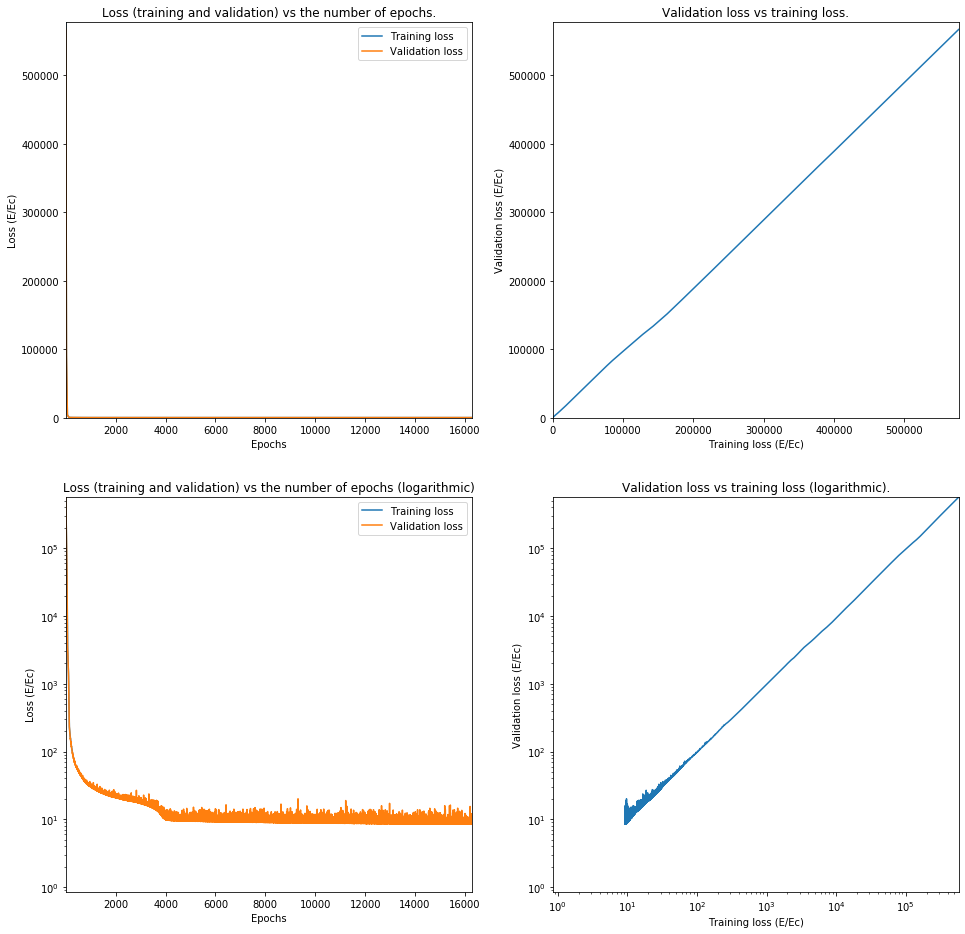

Train on 62644 samples, validate on 15662 samples
Epoch 1/25000
62644/62644 [==============================] - 2s 37us/step - loss: 273020.5287 - val_loss: 265996.7690
Epoch 2/25000
62644/62644 [==============================] - 2s 35us/step - loss: 259039.9229 - val_loss: 252266.2619
Epoch 3/25000
62644/62644 [==============================] - 2s 34us/step - loss: 245543.8507 - val_loss: 238976.0293
Epoch 4/25000
62644/62644 [==============================] - 2s 34us/step - loss: 232418.9854 - val_loss: 225998.6869
Epoch 5/25000
62644/62644 [==============================] - 2s 36us/step - loss: 219654.2095 - val_loss: 213402.6415
Epoch 6/25000
62644/62644 [==============================] - 2s 36us/step - loss: 207274.5634 - val_loss: 201214.7198
Epoch 7/25000
62644/62644 [==============================] - 2s 36us/step - loss: 195263.2178 - val_loss: 189350.5114
Epoch 8/25000
62644/62644 [==============================] - 2s 36us/step - loss: 183635.7228 - val_loss: 177929.6800
Epoch 

Epoch 71/25000
62644/62644 [==============================] - 2s 34us/step - loss: 5823.5248 - val_loss: 5793.6103
Epoch 72/25000
62644/62644 [==============================] - 2s 34us/step - loss: 5676.7702 - val_loss: 5646.2404
Epoch 73/25000
62644/62644 [==============================] - 2s 35us/step - loss: 5530.2239 - val_loss: 5499.9039
Epoch 74/25000
62644/62644 [==============================] - 2s 34us/step - loss: 5384.7512 - val_loss: 5354.8882
Epoch 75/25000
62644/62644 [==============================] - 2s 34us/step - loss: 5240.8968 - val_loss: 5210.8485
Epoch 76/25000
62644/62644 [==============================] - 2s 36us/step - loss: 5098.0970 - val_loss: 5069.8533
Epoch 77/25000
62644/62644 [==============================] - 2s 35us/step - loss: 4958.5855 - val_loss: 4930.9845
Epoch 78/25000
62644/62644 [==============================] - 2s 34us/step - loss: 4821.6288 - val_loss: 4794.9331
Epoch 79/25000
62644/62644 [==============================] - 2s 34us/step - los

Epoch 142/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1250.9694 - val_loss: 1270.1007
Epoch 143/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1237.3449 - val_loss: 1256.4026
Epoch 144/25000
62644/62644 [==============================] - 2s 36us/step - loss: 1223.7501 - val_loss: 1243.2949
Epoch 145/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1210.2953 - val_loss: 1228.7190
Epoch 146/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1196.7912 - val_loss: 1215.2541
Epoch 147/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1183.6051 - val_loss: 1201.8619
Epoch 148/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1170.1913 - val_loss: 1187.9102
Epoch 149/25000
62644/62644 [==============================] - 2s 35us/step - loss: 1156.9337 - val_loss: 1174.5758
Epoch 150/25000
62644/62644 [==============================] - 2s 34us/s

62644/62644 [==============================] - 2s 34us/step - loss: 385.0806 - val_loss: 387.5440
Epoch 214/25000
62644/62644 [==============================] - 2s 34us/step - loss: 374.0384 - val_loss: 375.8709
Epoch 215/25000
62644/62644 [==============================] - 2s 33us/step - loss: 362.8024 - val_loss: 364.2766
Epoch 216/25000
62644/62644 [==============================] - 2s 33us/step - loss: 351.6029 - val_loss: 352.8669
Epoch 217/25000
62644/62644 [==============================] - 2s 34us/step - loss: 340.3833 - val_loss: 341.3678
Epoch 218/25000
62644/62644 [==============================] - 2s 35us/step - loss: 329.0349 - val_loss: 329.7158
Epoch 219/25000
62644/62644 [==============================] - 2s 34us/step - loss: 317.6031 - val_loss: 318.4483
Epoch 220/25000
62644/62644 [==============================] - 2s 35us/step - loss: 306.2618 - val_loss: 307.4733
Epoch 221/25000
62644/62644 [==============================] - 2s 34us/step - loss: 295.0648 - val_loss:

Epoch 286/25000
62644/62644 [==============================] - 2s 37us/step - loss: 25.6687 - val_loss: 25.5811
Epoch 287/25000
62644/62644 [==============================] - 2s 39us/step - loss: 25.3154 - val_loss: 25.4767
Epoch 288/25000
62644/62644 [==============================] - 2s 40us/step - loss: 24.9490 - val_loss: 24.9018
Epoch 289/25000
62644/62644 [==============================] - 2s 34us/step - loss: 24.6454 - val_loss: 24.4389
Epoch 290/25000
62644/62644 [==============================] - 2s 34us/step - loss: 24.3693 - val_loss: 24.3457
Epoch 291/25000
62644/62644 [==============================] - 2s 35us/step - loss: 24.0569 - val_loss: 23.9486
Epoch 292/25000
62644/62644 [==============================] - 2s 34us/step - loss: 23.8393 - val_loss: 23.6346
Epoch 293/25000
62644/62644 [==============================] - 2s 35us/step - loss: 23.6089 - val_loss: 23.3875
Epoch 294/25000
62644/62644 [==============================] - 2s 34us/step - loss: 23.3484 - val_loss: 

62644/62644 [==============================] - 2s 33us/step - loss: 19.3275 - val_loss: 19.2725
Epoch 360/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.2459 - val_loss: 19.2279
Epoch 361/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.2858 - val_loss: 19.2817
Epoch 362/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.2384 - val_loss: 19.2434
Epoch 363/25000
62644/62644 [==============================] - 2s 35us/step - loss: 19.2330 - val_loss: 19.1830
Epoch 364/25000
62644/62644 [==============================] - 2s 33us/step - loss: 19.1831 - val_loss: 19.1547
Epoch 365/25000
62644/62644 [==============================] - 2s 37us/step - loss: 19.1880 - val_loss: 19.1010
Epoch 366/25000
62644/62644 [==============================] - 2s 34us/step - loss: 19.1234 - val_loss: 19.1312
Epoch 367/25000
62644/62644 [==============================] - 2s 35us/step - loss: 19.0927 - val_loss: 19.2733
Epoch 36

62644/62644 [==============================] - 2s 34us/step - loss: 17.5725 - val_loss: 17.6683
Epoch 433/25000
62644/62644 [==============================] - 2s 34us/step - loss: 17.5517 - val_loss: 17.5458
Epoch 434/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.5621 - val_loss: 17.5305
Epoch 435/25000
62644/62644 [==============================] - 2s 34us/step - loss: 17.5008 - val_loss: 18.0644
Epoch 436/25000
62644/62644 [==============================] - 2s 36us/step - loss: 17.5151 - val_loss: 17.6408
Epoch 437/25000
62644/62644 [==============================] - 2s 34us/step - loss: 17.4683 - val_loss: 17.5408
Epoch 438/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.4416 - val_loss: 17.4502
Epoch 439/25000
62644/62644 [==============================] - 2s 33us/step - loss: 17.4294 - val_loss: 17.4342
Epoch 440/25000
62644/62644 [==============================] - 2s 35us/step - loss: 17.3962 - val_loss: 17.4724
Epoch 44

62644/62644 [==============================] - 2s 34us/step - loss: 16.0996 - val_loss: 16.1791
Epoch 506/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.1149 - val_loss: 16.4977
Epoch 507/25000
62644/62644 [==============================] - 2s 34us/step - loss: 16.1438 - val_loss: 16.1786
Epoch 508/25000
62644/62644 [==============================] - 2s 35us/step - loss: 16.1158 - val_loss: 16.2036
Epoch 509/25000
62644/62644 [==============================] - 2s 34us/step - loss: 16.0892 - val_loss: 16.1165
Epoch 510/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.0450 - val_loss: 16.1013
Epoch 511/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.0167 - val_loss: 16.1092
Epoch 512/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.0101 - val_loss: 16.1700
Epoch 513/25000
62644/62644 [==============================] - 2s 33us/step - loss: 16.0382 - val_loss: 16.0600
Epoch 51

62644/62644 [==============================] - 2s 33us/step - loss: 14.9663 - val_loss: 15.5296
Epoch 579/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.9594 - val_loss: 15.0146
Epoch 580/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.9028 - val_loss: 15.4038
Epoch 581/25000
62644/62644 [==============================] - 2s 34us/step - loss: 14.9059 - val_loss: 15.3307
Epoch 582/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.8880 - val_loss: 15.1630
Epoch 583/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8735 - val_loss: 15.0472
Epoch 584/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8699 - val_loss: 15.4431
Epoch 585/25000
62644/62644 [==============================] - 2s 35us/step - loss: 14.8361 - val_loss: 15.5183
Epoch 586/25000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8252 - val_loss: 15.0027
Epoch 58

62644/62644 [==============================] - 2s 35us/step - loss: 14.0401 - val_loss: 14.0863
Epoch 652/25000
62644/62644 [==============================] - 2s 36us/step - loss: 13.9820 - val_loss: 14.0372
Epoch 653/25000
62644/62644 [==============================] - 2s 36us/step - loss: 13.9953 - val_loss: 14.1385
Epoch 654/25000
62644/62644 [==============================] - 2s 35us/step - loss: 13.9509 - val_loss: 14.1874
Epoch 655/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.9905 - val_loss: 14.2156
Epoch 656/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.9346 - val_loss: 14.0031
Epoch 657/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.9326 - val_loss: 14.1783
Epoch 658/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.9244 - val_loss: 14.1788
Epoch 659/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.9240 - val_loss: 14.7121
Epoch 66

62644/62644 [==============================] - 2s 33us/step - loss: 13.2217 - val_loss: 13.5507
Epoch 725/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.2284 - val_loss: 13.3191
Epoch 726/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.2057 - val_loss: 14.1384
Epoch 727/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.1819 - val_loss: 13.2348
Epoch 728/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.1777 - val_loss: 13.2317
Epoch 729/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.1698 - val_loss: 13.6738
Epoch 730/25000
62644/62644 [==============================] - 2s 34us/step - loss: 13.1996 - val_loss: 13.4178
Epoch 731/25000
62644/62644 [==============================] - 2s 33us/step - loss: 13.1622 - val_loss: 13.2058
Epoch 732/25000
62644/62644 [==============================] - 2s 36us/step - loss: 13.1502 - val_loss: 13.8180
Epoch 73

62644/62644 [==============================] - 2s 35us/step - loss: 12.6160 - val_loss: 12.7156
Epoch 798/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.6312 - val_loss: 13.4616
Epoch 799/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.6274 - val_loss: 13.4556
Epoch 800/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.6211 - val_loss: 12.6544
Epoch 801/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.5808 - val_loss: 12.6725
Epoch 802/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.5772 - val_loss: 12.6555
Epoch 803/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.6019 - val_loss: 12.9000
Epoch 804/25000
62644/62644 [==============================] - 2s 34us/step - loss: 12.6181 - val_loss: 12.8517
Epoch 805/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.5668 - val_loss: 12.9391
Epoch 80

62644/62644 [==============================] - 2s 35us/step - loss: 12.1764 - val_loss: 12.6241
Epoch 871/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.1714 - val_loss: 12.2847
Epoch 872/25000
62644/62644 [==============================] - 2s 31us/step - loss: 12.1610 - val_loss: 12.2457
Epoch 873/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.1558 - val_loss: 12.1796
Epoch 874/25000
62644/62644 [==============================] - 2s 36us/step - loss: 12.1615 - val_loss: 12.3478
Epoch 875/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.1304 - val_loss: 12.3322
Epoch 876/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.1587 - val_loss: 12.2375
Epoch 877/25000
62644/62644 [==============================] - 2s 38us/step - loss: 12.1143 - val_loss: 12.1612
Epoch 878/25000
62644/62644 [==============================] - 2s 35us/step - loss: 12.1455 - val_loss: 12.1268
Epoch 87

62644/62644 [==============================] - 2s 33us/step - loss: 11.8429 - val_loss: 11.8405
Epoch 944/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.8258 - val_loss: 12.1701
Epoch 945/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8362 - val_loss: 12.1149
Epoch 946/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7945 - val_loss: 12.0972
Epoch 947/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.7819 - val_loss: 11.8856
Epoch 948/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.8236 - val_loss: 12.3831
Epoch 949/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.8306 - val_loss: 11.7829
Epoch 950/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.7590 - val_loss: 11.8528
Epoch 951/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.8089 - val_loss: 12.0004
Epoch 95

62644/62644 [==============================] - 2s 35us/step - loss: 11.5383 - val_loss: 11.5574
Epoch 1017/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.5528 - val_loss: 11.8634
Epoch 1018/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5794 - val_loss: 11.5129
Epoch 1019/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.5111 - val_loss: 11.5319
Epoch 1020/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5294 - val_loss: 11.5197
Epoch 1021/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5284 - val_loss: 11.5440
Epoch 1022/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.5386 - val_loss: 11.5423
Epoch 1023/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.5045 - val_loss: 12.4529
Epoch 1024/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.4992 - val_loss: 11.5837


62644/62644 [==============================] - 2s 34us/step - loss: 11.3272 - val_loss: 12.0541
Epoch 1089/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.3366 - val_loss: 11.4236
Epoch 1090/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.3327 - val_loss: 11.3466
Epoch 1091/25000
62644/62644 [==============================] - 2s 32us/step - loss: 11.3142 - val_loss: 11.3288
Epoch 1092/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.3542 - val_loss: 11.6930
Epoch 1093/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.3203 - val_loss: 11.2861
Epoch 1094/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3303 - val_loss: 11.4648
Epoch 1095/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3248 - val_loss: 11.2998
Epoch 1096/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.3284 - val_loss: 11.6310


62644/62644 [==============================] - 2s 37us/step - loss: 11.1407 - val_loss: 11.1930
Epoch 1161/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1709 - val_loss: 11.3971
Epoch 1162/25000
62644/62644 [==============================] - 2s 36us/step - loss: 11.1500 - val_loss: 11.1637
Epoch 1163/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1492 - val_loss: 11.1051
Epoch 1164/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.1437 - val_loss: 11.4258
Epoch 1165/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1216 - val_loss: 11.1726
Epoch 1166/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.1513 - val_loss: 11.1336
Epoch 1167/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.1437 - val_loss: 11.1720
Epoch 1168/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.1166 - val_loss: 11.1174


62644/62644 [==============================] - 2s 34us/step - loss: 11.0277 - val_loss: 11.2089
Epoch 1233/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.9919 - val_loss: 11.0499
Epoch 1234/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0220 - val_loss: 10.9835
Epoch 1235/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.9722 - val_loss: 11.2369
Epoch 1236/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.0028 - val_loss: 10.9615
Epoch 1237/25000
62644/62644 [==============================] - 2s 33us/step - loss: 11.0024 - val_loss: 12.2057
Epoch 1238/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.9709 - val_loss: 10.9619
Epoch 1239/25000
62644/62644 [==============================] - 2s 34us/step - loss: 11.0116 - val_loss: 10.9614
Epoch 1240/25000
62644/62644 [==============================] - 2s 35us/step - loss: 11.0037 - val_loss: 10.9436


62644/62644 [==============================] - 2s 35us/step - loss: 10.8673 - val_loss: 10.8174
Epoch 1305/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8816 - val_loss: 11.1139
Epoch 1306/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8675 - val_loss: 10.8328
Epoch 1307/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8653 - val_loss: 10.8251
Epoch 1308/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8519 - val_loss: 10.9651
Epoch 1309/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.8872 - val_loss: 11.1921
Epoch 1310/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8632 - val_loss: 11.0085
Epoch 1311/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8693 - val_loss: 10.8326
Epoch 1312/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.8748 - val_loss: 11.0097


62644/62644 [==============================] - 2s 34us/step - loss: 10.8015 - val_loss: 10.7205
Epoch 1377/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7605 - val_loss: 11.2656
Epoch 1378/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7740 - val_loss: 10.7013
Epoch 1379/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7447 - val_loss: 10.7938
Epoch 1380/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7562 - val_loss: 10.7822
Epoch 1381/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7564 - val_loss: 10.7035
Epoch 1382/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.7652 - val_loss: 10.7006
Epoch 1383/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.7321 - val_loss: 11.4403
Epoch 1384/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.7704 - val_loss: 10.7305


62644/62644 [==============================] - 2s 34us/step - loss: 10.6794 - val_loss: 11.4437
Epoch 1449/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.6803 - val_loss: 10.6111
Epoch 1450/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6813 - val_loss: 11.2302
Epoch 1451/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6569 - val_loss: 10.6138
Epoch 1452/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6715 - val_loss: 10.6252
Epoch 1453/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6694 - val_loss: 10.7702
Epoch 1454/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.6474 - val_loss: 10.6123
Epoch 1455/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.6781 - val_loss: 10.6370
Epoch 1456/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6702 - val_loss: 10.7275


62644/62644 [==============================] - 2s 34us/step - loss: 10.6256 - val_loss: 10.5429
Epoch 1521/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5803 - val_loss: 10.9009
Epoch 1522/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5834 - val_loss: 10.5301
Epoch 1523/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.6013 - val_loss: 10.5467
Epoch 1524/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5947 - val_loss: 10.6334
Epoch 1525/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6479 - val_loss: 10.5282
Epoch 1526/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6054 - val_loss: 11.0470
Epoch 1527/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.5807 - val_loss: 11.0040
Epoch 1528/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5896 - val_loss: 10.6524


62644/62644 [==============================] - 2s 34us/step - loss: 10.5361 - val_loss: 10.9060
Epoch 1593/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5807 - val_loss: 10.5046
Epoch 1594/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5445 - val_loss: 10.4764
Epoch 1595/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.6036 - val_loss: 10.4823
Epoch 1596/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5361 - val_loss: 10.9223
Epoch 1597/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5500 - val_loss: 10.5197
Epoch 1598/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5668 - val_loss: 10.4654
Epoch 1599/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5270 - val_loss: 10.4810
Epoch 1600/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.5438 - val_loss: 10.5218


62644/62644 [==============================] - 2s 36us/step - loss: 10.4905 - val_loss: 10.4050
Epoch 1665/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4979 - val_loss: 10.5226
Epoch 1666/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4974 - val_loss: 10.4682
Epoch 1667/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.4677 - val_loss: 10.4062
Epoch 1668/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4858 - val_loss: 10.4585
Epoch 1669/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4820 - val_loss: 10.4081
Epoch 1670/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.5105 - val_loss: 10.3991
Epoch 1671/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4730 - val_loss: 10.6549
Epoch 1672/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4750 - val_loss: 10.7126


62644/62644 [==============================] - 2s 34us/step - loss: 10.4806 - val_loss: 10.6600
Epoch 1737/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4349 - val_loss: 10.3807
Epoch 1738/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4620 - val_loss: 10.3703
Epoch 1739/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4279 - val_loss: 10.3817
Epoch 1740/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4466 - val_loss: 11.1370
Epoch 1741/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4285 - val_loss: 10.7459
Epoch 1742/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4523 - val_loss: 10.4124
Epoch 1743/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4437 - val_loss: 10.5613
Epoch 1744/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4794 - val_loss: 10.4362


62644/62644 [==============================] - 2s 33us/step - loss: 10.4348 - val_loss: 10.3203
Epoch 1809/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4479 - val_loss: 10.3408
Epoch 1810/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4048 - val_loss: 10.6102
Epoch 1811/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4019 - val_loss: 10.3175
Epoch 1812/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4064 - val_loss: 11.0658
Epoch 1813/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.4150 - val_loss: 10.3431
Epoch 1814/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3826 - val_loss: 10.3284
Epoch 1815/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4012 - val_loss: 10.3229
Epoch 1816/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4310 - val_loss: 10.6087


62644/62644 [==============================] - 2s 35us/step - loss: 10.4055 - val_loss: 10.3683
Epoch 1881/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.4025 - val_loss: 10.3290
Epoch 1882/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3792 - val_loss: 10.3311
Epoch 1883/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3988 - val_loss: 11.7008
Epoch 1884/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.4136 - val_loss: 10.3402
Epoch 1885/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3781 - val_loss: 10.3879
Epoch 1886/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3912 - val_loss: 10.2921
Epoch 1887/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3658 - val_loss: 10.5206
Epoch 1888/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3985 - val_loss: 10.3550


62644/62644 [==============================] - 2s 35us/step - loss: 10.3725 - val_loss: 10.5656
Epoch 1953/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3587 - val_loss: 10.2643
Epoch 1954/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3818 - val_loss: 10.2811
Epoch 1955/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3379 - val_loss: 10.5124
Epoch 1956/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.3676 - val_loss: 10.6578
Epoch 1957/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.3882 - val_loss: 10.3935
Epoch 1958/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.3664 - val_loss: 10.4673
Epoch 1959/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.3428 - val_loss: 10.3285
Epoch 1960/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.3534 - val_loss: 10.2666


62644/62644 [==============================] - 2s 34us/step - loss: 10.3780 - val_loss: 10.4540
Epoch 2025/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3460 - val_loss: 11.9430
Epoch 2026/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3419 - val_loss: 10.2441
Epoch 2027/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3433 - val_loss: 10.8822
Epoch 2028/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3458 - val_loss: 10.5248
Epoch 2029/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3298 - val_loss: 10.4466
Epoch 2030/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3775 - val_loss: 10.2461
Epoch 2031/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3034 - val_loss: 10.2710
Epoch 2032/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3782 - val_loss: 11.0625


62644/62644 [==============================] - 2s 34us/step - loss: 10.3481 - val_loss: 10.2550
Epoch 2097/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3389 - val_loss: 10.2873
Epoch 2098/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3212 - val_loss: 10.3120
Epoch 2099/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3229 - val_loss: 10.2392
Epoch 2100/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3299 - val_loss: 10.2154
Epoch 2101/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3056 - val_loss: 10.2257
Epoch 2102/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3231 - val_loss: 10.2319
Epoch 2103/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3405 - val_loss: 10.2245
Epoch 2104/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.3262 - val_loss: 10.8777


62644/62644 [==============================] - 2s 34us/step - loss: 10.3161 - val_loss: 10.2802
Epoch 2169/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3078 - val_loss: 10.2195
Epoch 2170/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3151 - val_loss: 10.2625
Epoch 2171/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.3240 - val_loss: 10.2382
Epoch 2172/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3375 - val_loss: 10.2017
Epoch 2173/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.3043 - val_loss: 10.2279
Epoch 2174/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.3405 - val_loss: 10.2021
Epoch 2175/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.3542 - val_loss: 10.2125
Epoch 2176/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3010 - val_loss: 10.2310


62644/62644 [==============================] - 2s 33us/step - loss: 10.3072 - val_loss: 10.2188
Epoch 2241/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.3024 - val_loss: 10.5745
Epoch 2242/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3042 - val_loss: 10.2457
Epoch 2243/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3041 - val_loss: 10.7144
Epoch 2244/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2896 - val_loss: 10.2333
Epoch 2245/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2850 - val_loss: 10.1986
Epoch 2246/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3009 - val_loss: 10.3494
Epoch 2247/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2981 - val_loss: 10.5729
Epoch 2248/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2803 - val_loss: 10.2138


62644/62644 [==============================] - 2s 35us/step - loss: 10.2719 - val_loss: 10.1774
Epoch 2313/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.3209 - val_loss: 10.1798
Epoch 2314/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2890 - val_loss: 10.1720
Epoch 2315/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2928 - val_loss: 10.1831
Epoch 2316/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2896 - val_loss: 10.1716
Epoch 2317/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3179 - val_loss: 10.1708
Epoch 2318/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2676 - val_loss: 10.1780
Epoch 2319/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2615 - val_loss: 10.2414
Epoch 2320/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2739 - val_loss: 10.1809


62644/62644 [==============================] - 2s 34us/step - loss: 10.2876 - val_loss: 10.2164
Epoch 2385/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2878 - val_loss: 10.9901
Epoch 2386/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2620 - val_loss: 10.2005
Epoch 2387/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2752 - val_loss: 10.7764
Epoch 2388/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2621 - val_loss: 10.1663
Epoch 2389/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3053 - val_loss: 10.1671
Epoch 2390/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2668 - val_loss: 10.1620
Epoch 2391/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.2723 - val_loss: 10.3734
Epoch 2392/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2795 - val_loss: 10.8554


62644/62644 [==============================] - 2s 33us/step - loss: 10.2692 - val_loss: 10.2293
Epoch 2457/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2612 - val_loss: 10.1585
Epoch 2458/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2820 - val_loss: 10.1542
Epoch 2459/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2653 - val_loss: 10.1893
Epoch 2460/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2555 - val_loss: 10.1660
Epoch 2461/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2670 - val_loss: 12.0309
Epoch 2462/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.3028 - val_loss: 10.3713
Epoch 2463/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2571 - val_loss: 10.3761
Epoch 2464/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2628 - val_loss: 10.1663


62644/62644 [==============================] - 2s 33us/step - loss: 10.2950 - val_loss: 10.1451
Epoch 2529/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2471 - val_loss: 10.1585
Epoch 2530/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2451 - val_loss: 10.2470
Epoch 2531/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2523 - val_loss: 10.2910
Epoch 2532/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2466 - val_loss: 10.1339
Epoch 2533/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2492 - val_loss: 10.2193
Epoch 2534/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2711 - val_loss: 10.5401
Epoch 2535/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2606 - val_loss: 10.1415
Epoch 2536/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.2427 - val_loss: 10.1368


62644/62644 [==============================] - 2s 34us/step - loss: 10.2487 - val_loss: 10.1729
Epoch 2601/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2791 - val_loss: 10.1817
Epoch 2602/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2338 - val_loss: 10.2852
Epoch 2603/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2610 - val_loss: 10.5763
Epoch 2604/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2612 - val_loss: 10.2790
Epoch 2605/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2606 - val_loss: 10.1476
Epoch 2606/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2939 - val_loss: 10.1353
Epoch 2607/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2206 - val_loss: 10.3429
Epoch 2608/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2507 - val_loss: 10.2288


62644/62644 [==============================] - 2s 35us/step - loss: 10.2269 - val_loss: 10.1807
Epoch 2673/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2826 - val_loss: 10.1859
Epoch 2674/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2228 - val_loss: 10.1857
Epoch 2675/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2416 - val_loss: 10.1311
Epoch 2676/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2327 - val_loss: 10.7313
Epoch 2677/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2410 - val_loss: 10.1318
Epoch 2678/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2464 - val_loss: 10.5224
Epoch 2679/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2366 - val_loss: 10.3656
Epoch 2680/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.2750 - val_loss: 10.5072


62644/62644 [==============================] - 2s 33us/step - loss: 10.2471 - val_loss: 10.1582
Epoch 2745/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2281 - val_loss: 10.1266
Epoch 2746/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1942 - val_loss: 10.2347
Epoch 2747/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2456 - val_loss: 10.2065
Epoch 2748/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2417 - val_loss: 10.6008
Epoch 2749/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2623 - val_loss: 10.2002
Epoch 2750/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2532 - val_loss: 10.2908
Epoch 2751/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2443 - val_loss: 10.1095
Epoch 2752/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2245 - val_loss: 10.2530


62644/62644 [==============================] - 2s 35us/step - loss: 10.2459 - val_loss: 10.1178
Epoch 2817/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1974 - val_loss: 10.1128
Epoch 2818/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2216 - val_loss: 10.1550
Epoch 2819/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2327 - val_loss: 10.1587
Epoch 2820/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2243 - val_loss: 10.2601
Epoch 2821/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2202 - val_loss: 10.2276
Epoch 2822/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2257 - val_loss: 10.5621
Epoch 2823/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2199 - val_loss: 10.1631
Epoch 2824/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2468 - val_loss: 10.3235


62644/62644 [==============================] - 2s 34us/step - loss: 10.2222 - val_loss: 10.1980
Epoch 2889/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2131 - val_loss: 10.3385
Epoch 2890/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2311 - val_loss: 10.1066
Epoch 2891/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2413 - val_loss: 10.3548
Epoch 2892/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1821 - val_loss: 10.2007
Epoch 2893/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2158 - val_loss: 10.0923
Epoch 2894/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1923 - val_loss: 10.2455
Epoch 2895/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2434 - val_loss: 10.1508
Epoch 2896/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2050 - val_loss: 10.4256


62644/62644 [==============================] - 2s 34us/step - loss: 10.1982 - val_loss: 10.4951
Epoch 2961/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2398 - val_loss: 10.1214
Epoch 2962/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2127 - val_loss: 10.5426
Epoch 2963/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1907 - val_loss: 10.5835
Epoch 2964/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1987 - val_loss: 10.1000
Epoch 2965/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2258 - val_loss: 10.1782
Epoch 2966/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2361 - val_loss: 10.1527
Epoch 2967/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2081 - val_loss: 10.3552
Epoch 2968/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1844 - val_loss: 10.1105


62644/62644 [==============================] - 2s 34us/step - loss: 10.1956 - val_loss: 10.1903
Epoch 3033/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2110 - val_loss: 10.0824
Epoch 3034/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2133 - val_loss: 10.3671
Epoch 3035/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1836 - val_loss: 10.1149
Epoch 3036/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2055 - val_loss: 10.1314
Epoch 3037/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1967 - val_loss: 10.5098
Epoch 3038/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1883 - val_loss: 10.3667
Epoch 3039/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1926 - val_loss: 10.3867
Epoch 3040/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2179 - val_loss: 10.1613


62644/62644 [==============================] - 2s 34us/step - loss: 10.1928 - val_loss: 10.1645
Epoch 3105/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2068 - val_loss: 10.6704
Epoch 3106/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2260 - val_loss: 10.0885
Epoch 3107/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1918 - val_loss: 10.1560
Epoch 3108/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2031 - val_loss: 10.0735
Epoch 3109/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1917 - val_loss: 10.0861
Epoch 3110/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1784 - val_loss: 10.0892
Epoch 3111/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1968 - val_loss: 10.5436
Epoch 3112/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1823 - val_loss: 10.1429


62644/62644 [==============================] - 2s 34us/step - loss: 10.1826 - val_loss: 10.0905
Epoch 3177/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1866 - val_loss: 10.1884
Epoch 3178/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2077 - val_loss: 10.2751
Epoch 3179/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1971 - val_loss: 10.1208
Epoch 3180/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1886 - val_loss: 10.5414
Epoch 3181/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2031 - val_loss: 10.8516
Epoch 3182/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.2122 - val_loss: 10.1178
Epoch 3183/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2285 - val_loss: 10.1158
Epoch 3184/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1987 - val_loss: 10.2697


62644/62644 [==============================] - 2s 32us/step - loss: 10.1916 - val_loss: 10.0774
Epoch 3249/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1778 - val_loss: 10.2799
Epoch 3250/25000
62644/62644 [==============================] - 2s 39us/step - loss: 10.1703 - val_loss: 10.3748
Epoch 3251/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1849 - val_loss: 10.5497
Epoch 3252/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1718 - val_loss: 10.2985
Epoch 3253/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2083 - val_loss: 10.0961
Epoch 3254/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.2041 - val_loss: 10.0882
Epoch 3255/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1648 - val_loss: 10.4488
Epoch 3256/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1752 - val_loss: 10.2911


62644/62644 [==============================] - 2s 34us/step - loss: 10.1936 - val_loss: 10.0688
Epoch 3321/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1612 - val_loss: 10.2401
Epoch 3322/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1936 - val_loss: 10.9595
Epoch 3323/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1868 - val_loss: 10.5579
Epoch 3324/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1823 - val_loss: 10.1258
Epoch 3325/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1888 - val_loss: 10.4700
Epoch 3326/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1517 - val_loss: 10.1841
Epoch 3327/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1895 - val_loss: 10.0857
Epoch 3328/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1785 - val_loss: 10.3026


62644/62644 [==============================] - 2s 34us/step - loss: 10.1676 - val_loss: 10.0950
Epoch 3393/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1933 - val_loss: 11.0011
Epoch 3394/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1551 - val_loss: 10.0569
Epoch 3395/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1780 - val_loss: 10.0437
Epoch 3396/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1792 - val_loss: 10.0720
Epoch 3397/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.2000 - val_loss: 10.0615
Epoch 3398/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1798 - val_loss: 10.0467
Epoch 3399/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1882 - val_loss: 11.3336
Epoch 3400/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1751 - val_loss: 10.0596


62644/62644 [==============================] - 2s 34us/step - loss: 10.1491 - val_loss: 10.6427
Epoch 3465/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1582 - val_loss: 10.0932
Epoch 3466/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1380 - val_loss: 10.3148
Epoch 3467/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1672 - val_loss: 10.2755
Epoch 3468/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1538 - val_loss: 10.0449
Epoch 3469/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1467 - val_loss: 10.1379
Epoch 3470/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1766 - val_loss: 10.0996
Epoch 3471/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1544 - val_loss: 10.2779
Epoch 3472/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1823 - val_loss: 10.3941


62644/62644 [==============================] - 2s 36us/step - loss: 10.1404 - val_loss: 10.0370
Epoch 3537/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1561 - val_loss: 10.0608
Epoch 3538/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1564 - val_loss: 10.1657
Epoch 3539/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1778 - val_loss: 10.1975
Epoch 3540/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1495 - val_loss: 10.5386
Epoch 3541/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1473 - val_loss: 10.0423
Epoch 3542/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1613 - val_loss: 10.0662
Epoch 3543/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1604 - val_loss: 11.2260
Epoch 3544/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1471 - val_loss: 10.0776


62644/62644 [==============================] - 2s 35us/step - loss: 10.1295 - val_loss: 10.0461
Epoch 3609/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1588 - val_loss: 10.1669
Epoch 3610/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1573 - val_loss: 10.1674
Epoch 3611/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1498 - val_loss: 10.0237
Epoch 3612/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1497 - val_loss: 10.1744
Epoch 3613/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1386 - val_loss: 10.2137
Epoch 3614/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1609 - val_loss: 10.0886
Epoch 3615/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1547 - val_loss: 10.0240
Epoch 3616/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1435 - val_loss: 10.3799


62644/62644 [==============================] - 2s 34us/step - loss: 10.1487 - val_loss: 10.1238
Epoch 3681/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1428 - val_loss: 10.0998
Epoch 3682/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1257 - val_loss: 10.0804
Epoch 3683/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1456 - val_loss: 10.0303
Epoch 3684/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1670 - val_loss: 10.1769
Epoch 3685/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1323 - val_loss: 10.4986
Epoch 3686/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1465 - val_loss: 10.0221
Epoch 3687/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1515 - val_loss: 11.2718
Epoch 3688/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1687 - val_loss: 10.2176


62644/62644 [==============================] - 2s 33us/step - loss: 10.1270 - val_loss: 10.1620
Epoch 3753/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1511 - val_loss: 10.6252
Epoch 3754/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1211 - val_loss: 10.1513
Epoch 3755/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1589 - val_loss: 10.0390
Epoch 3756/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1451 - val_loss: 10.0115
Epoch 3757/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1209 - val_loss: 10.1825
Epoch 3758/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1546 - val_loss: 10.3076
Epoch 3759/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1500 - val_loss: 10.2366
Epoch 3760/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1375 - val_loss: 10.0953


62644/62644 [==============================] - 2s 35us/step - loss: 10.1140 - val_loss: 10.0088
Epoch 3825/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1454 - val_loss: 10.0259
Epoch 3826/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1231 - val_loss: 10.0601
Epoch 3827/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1315 - val_loss: 10.4882
Epoch 3828/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1087 - val_loss: 10.3330
Epoch 3829/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1174 - val_loss: 10.1313
Epoch 3830/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1405 - val_loss: 10.1162
Epoch 3831/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1213 - val_loss: 10.2254
Epoch 3832/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1172 - val_loss: 11.4647


62644/62644 [==============================] - 2s 35us/step - loss: 10.1544 - val_loss: 11.0386
Epoch 3897/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1290 - val_loss: 10.1242
Epoch 3898/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1109 - val_loss: 10.2261
Epoch 3899/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1048 - val_loss: 10.1156
Epoch 3900/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1025 - val_loss: 10.0108
Epoch 3901/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1573 - val_loss: 10.1801
Epoch 3902/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1044 - val_loss: 10.5211
Epoch 3903/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.1042 - val_loss: 10.0116
Epoch 3904/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1202 - val_loss: 10.0989


62644/62644 [==============================] - 2s 33us/step - loss: 10.1040 - val_loss: 10.2832
Epoch 3969/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1193 - val_loss: 9.9981
Epoch 3970/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1068 - val_loss: 10.0225
Epoch 3971/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1088 - val_loss: 10.4111
Epoch 3972/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1348 - val_loss: 10.4796
Epoch 3973/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1335 - val_loss: 10.1355
Epoch 3974/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1070 - val_loss: 10.0270
Epoch 3975/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1298 - val_loss: 10.1472
Epoch 3976/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0976 - val_loss: 10.0027
E

62644/62644 [==============================] - 2s 34us/step - loss: 10.1095 - val_loss: 10.3837
Epoch 4041/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1296 - val_loss: 10.0832
Epoch 4042/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1203 - val_loss: 10.4394
Epoch 4043/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1107 - val_loss: 9.9999
Epoch 4044/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1220 - val_loss: 11.5892
Epoch 4045/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0800 - val_loss: 10.0157
Epoch 4046/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1224 - val_loss: 10.0018
Epoch 4047/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1168 - val_loss: 9.9990
Epoch 4048/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0776 - val_loss: 10.2238
Ep

62644/62644 [==============================] - 2s 34us/step - loss: 10.0727 - val_loss: 10.0482
Epoch 4113/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1239 - val_loss: 9.9942
Epoch 4114/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0903 - val_loss: 10.1664
Epoch 4115/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1488 - val_loss: 10.0083
Epoch 4116/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0935 - val_loss: 10.0415
Epoch 4117/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1081 - val_loss: 10.0009
Epoch 4118/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1212 - val_loss: 10.2639
Epoch 4119/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1123 - val_loss: 10.1161
Epoch 4120/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1068 - val_loss: 10.0086
E

62644/62644 [==============================] - 2s 33us/step - loss: 10.0956 - val_loss: 9.9972
Epoch 4185/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1140 - val_loss: 10.0680
Epoch 4186/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0991 - val_loss: 10.2313
Epoch 4187/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1006 - val_loss: 10.6118
Epoch 4188/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0734 - val_loss: 10.6032
Epoch 4189/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0800 - val_loss: 10.2608
Epoch 4190/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0686 - val_loss: 10.0073
Epoch 4191/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1042 - val_loss: 9.9766
Epoch 4192/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1000 - val_loss: 9.9794
Epo

Epoch 4257/25000
62644/62644 [==============================] - 3s 49us/step - loss: 10.1024 - val_loss: 10.0549
Epoch 4258/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0957 - val_loss: 9.9952
Epoch 4259/25000
62644/62644 [==============================] - 2s 40us/step - loss: 10.0607 - val_loss: 10.2482
Epoch 4260/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.1022 - val_loss: 10.6613
Epoch 4261/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1153 - val_loss: 11.3245
Epoch 4262/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0750 - val_loss: 9.9904
Epoch 4263/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.1152 - val_loss: 10.1070
Epoch 4264/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.1024 - val_loss: 9.9952
Epoch 4265/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0654 - val_

62644/62644 [==============================] - 2s 37us/step - loss: 10.1006 - val_loss: 10.2911
Epoch 4330/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0820 - val_loss: 10.2804
Epoch 4331/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.1269 - val_loss: 9.9718
Epoch 4332/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0765 - val_loss: 10.3559
Epoch 4333/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0961 - val_loss: 10.1731
Epoch 4334/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0584 - val_loss: 10.0107
Epoch 4335/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.1302 - val_loss: 9.9914
Epoch 4336/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0925 - val_loss: 10.1589
Epoch 4337/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0894 - val_loss: 10.5387
Ep

Epoch 4402/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0834 - val_loss: 10.0493
Epoch 4403/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0918 - val_loss: 10.0802
Epoch 4404/25000
62644/62644 [==============================] - 3s 42us/step - loss: 10.0958 - val_loss: 9.9824
Epoch 4405/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0796 - val_loss: 10.1291
Epoch 4406/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0787 - val_loss: 10.0218
Epoch 4407/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0925 - val_loss: 10.0492
Epoch 4408/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0685 - val_loss: 10.2869
Epoch 4409/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0974 - val_loss: 10.1922
Epoch 4410/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0958 - va

62644/62644 [==============================] - 2s 29us/step - loss: 10.0743 - val_loss: 10.0540
Epoch 4475/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0693 - val_loss: 9.9784
Epoch 4476/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0906 - val_loss: 10.7039
Epoch 4477/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0859 - val_loss: 10.1225
Epoch 4478/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0709 - val_loss: 10.2037
Epoch 4479/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0811 - val_loss: 10.9983
Epoch 4480/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0674 - val_loss: 10.1942
Epoch 4481/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0658 - val_loss: 10.7971
Epoch 4482/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0585 - val_loss: 10.1192
E

Epoch 4547/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0773 - val_loss: 9.9823
Epoch 4548/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0503 - val_loss: 10.0920
Epoch 4549/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0467 - val_loss: 10.5066
Epoch 4550/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0941 - val_loss: 10.0756
Epoch 4551/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0535 - val_loss: 10.0647
Epoch 4552/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0675 - val_loss: 10.2506
Epoch 4553/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0597 - val_loss: 10.0589
Epoch 4554/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0736 - val_loss: 10.4245
Epoch 4555/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0800 - va

62644/62644 [==============================] - 2s 30us/step - loss: 10.0678 - val_loss: 10.0225
Epoch 4620/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0683 - val_loss: 9.9666
Epoch 4621/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0612 - val_loss: 10.4962
Epoch 4622/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0805 - val_loss: 9.9872
Epoch 4623/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0726 - val_loss: 10.1439
Epoch 4624/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0836 - val_loss: 10.0786
Epoch 4625/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0749 - val_loss: 10.3793
Epoch 4626/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0832 - val_loss: 10.1580
Epoch 4627/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0695 - val_loss: 10.6189
Ep

Epoch 4692/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0670 - val_loss: 10.0569
Epoch 4693/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0437 - val_loss: 10.0796
Epoch 4694/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0490 - val_loss: 9.9641
Epoch 4695/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0641 - val_loss: 9.9572
Epoch 4696/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0581 - val_loss: 10.1619
Epoch 4697/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0335 - val_loss: 9.9606
Epoch 4698/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0558 - val_loss: 10.1581
Epoch 4699/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0391 - val_loss: 11.1744
Epoch 4700/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0780 - val_

Epoch 4765/25000
62644/62644 [==============================] - 2s 35us/step - loss: 10.0276 - val_loss: 9.9701
Epoch 4766/25000
62644/62644 [==============================] - 3s 48us/step - loss: 10.0661 - val_loss: 10.0500
Epoch 4767/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0681 - val_loss: 9.9584
Epoch 4768/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0631 - val_loss: 9.9880
Epoch 4769/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0634 - val_loss: 9.9450
Epoch 4770/25000
62644/62644 [==============================] - 2s 37us/step - loss: 10.0445 - val_loss: 9.9743
Epoch 4771/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0656 - val_loss: 10.3239
Epoch 4772/25000
62644/62644 [==============================] - 2s 38us/step - loss: 10.0370 - val_loss: 11.5921
Epoch 4773/25000
62644/62644 [==============================] - 2s 36us/step - loss: 10.0773 - val_lo

Epoch 4838/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0293 - val_loss: 10.1740
Epoch 4839/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0363 - val_loss: 10.1414
Epoch 4840/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0304 - val_loss: 9.9266
Epoch 4841/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0710 - val_loss: 10.3025
Epoch 4842/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0338 - val_loss: 10.2486
Epoch 4843/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0575 - val_loss: 9.9979
Epoch 4844/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0409 - val_loss: 9.9427
Epoch 4845/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0336 - val_loss: 10.2546
Epoch 4846/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0311 - val_

62644/62644 [==============================] - 2s 35us/step - loss: 10.0256 - val_loss: 10.1283
Epoch 4911/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0309 - val_loss: 10.0744
Epoch 4912/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0430 - val_loss: 10.5312
Epoch 4913/25000
62644/62644 [==============================] - 2s 32us/step - loss: 10.0381 - val_loss: 10.0014
Epoch 4914/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0181 - val_loss: 9.9672
Epoch 4915/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0841 - val_loss: 10.1384
Epoch 4916/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0241 - val_loss: 10.3605
Epoch 4917/25000
62644/62644 [==============================] - 2s 33us/step - loss: 10.0125 - val_loss: 10.3007
Epoch 4918/25000
62644/62644 [==============================] - 2s 34us/step - loss: 10.0562 - val_loss: 10.6499
E

Epoch 4983/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0457 - val_loss: 10.9522
Epoch 4984/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0223 - val_loss: 10.1190
Epoch 4985/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0344 - val_loss: 9.9452
Epoch 4986/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0229 - val_loss: 10.0066
Epoch 4987/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0323 - val_loss: 10.0003
Epoch 4988/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0472 - val_loss: 10.0339
Epoch 4989/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0278 - val_loss: 9.9247
Epoch 4990/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0512 - val_loss: 9.9325
Epoch 4991/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0002 - val_

Epoch 5056/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0297 - val_loss: 10.2630
Epoch 5057/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0267 - val_loss: 10.3138
Epoch 5058/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0212 - val_loss: 10.1583
Epoch 5059/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0100 - val_loss: 10.7682
Epoch 5060/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0124 - val_loss: 10.2894
Epoch 5061/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0501 - val_loss: 9.9891
Epoch 5062/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0251 - val_loss: 9.9421
Epoch 5063/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0315 - val_loss: 10.0237
Epoch 5064/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0229 - val

Epoch 5129/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0192 - val_loss: 9.9452
Epoch 5130/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0085 - val_loss: 9.9067
Epoch 5131/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0159 - val_loss: 9.9212
Epoch 5132/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0249 - val_loss: 9.9435
Epoch 5133/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0317 - val_loss: 9.9257
Epoch 5134/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9947 - val_loss: 10.0643
Epoch 5135/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0129 - val_loss: 9.9157
Epoch 5136/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0244 - val_loss: 9.9042
Epoch 5137/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0439 - val_loss:

Epoch 5202/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0039 - val_loss: 9.9329
Epoch 5203/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0444 - val_loss: 9.9413
Epoch 5204/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0096 - val_loss: 9.9766
Epoch 5205/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9961 - val_loss: 9.8969
Epoch 5206/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0079 - val_loss: 10.8740
Epoch 5207/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9976 - val_loss: 10.1272
Epoch 5208/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0136 - val_loss: 10.3942
Epoch 5209/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0167 - val_loss: 10.4588
Epoch 5210/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0187 - val_los

Epoch 5275/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9964 - val_loss: 10.0225
Epoch 5276/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0113 - val_loss: 9.9992
Epoch 5277/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0302 - val_loss: 9.8919
Epoch 5278/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9799 - val_loss: 9.9662
Epoch 5279/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0146 - val_loss: 9.8979
Epoch 5280/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0381 - val_loss: 10.0126
Epoch 5281/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0222 - val_loss: 9.9413
Epoch 5282/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0183 - val_loss: 10.2861
Epoch 5283/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0228 - val_loss

62644/62644 [==============================] - 2s 28us/step - loss: 10.0137 - val_loss: 9.9682
Epoch 5349/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9976 - val_loss: 10.2126
Epoch 5350/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0223 - val_loss: 10.2196
Epoch 5351/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9946 - val_loss: 10.0606
Epoch 5352/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0126 - val_loss: 9.8911
Epoch 5353/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0107 - val_loss: 10.1665
Epoch 5354/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9868 - val_loss: 10.1096
Epoch 5355/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0347 - val_loss: 10.0990
Epoch 5356/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0172 - val_loss: 10.3707
Epoch

62644/62644 [==============================] - 2s 28us/step - loss: 9.9628 - val_loss: 9.9025
Epoch 5422/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0130 - val_loss: 9.9906
Epoch 5423/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.9740 - val_loss: 10.2816
Epoch 5424/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0343 - val_loss: 10.1695
Epoch 5425/25000
62644/62644 [==============================] - 2s 31us/step - loss: 10.0395 - val_loss: 10.2136
Epoch 5426/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0187 - val_loss: 10.4877
Epoch 5427/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0176 - val_loss: 10.2779
Epoch 5428/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9877 - val_loss: 9.8833
Epoch 5429/25000
62644/62644 [==============================] - 2s 30us/step - loss: 10.0116 - val_loss: 10.1166
Epoch 

62644/62644 [==============================] - 2s 28us/step - loss: 10.0178 - val_loss: 9.9049
Epoch 5495/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9920 - val_loss: 9.8940
Epoch 5496/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9600 - val_loss: 9.8792
Epoch 5497/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0341 - val_loss: 9.8839
Epoch 5498/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0024 - val_loss: 10.1772
Epoch 5499/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9891 - val_loss: 9.9454
Epoch 5500/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9936 - val_loss: 9.8835
Epoch 5501/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9699 - val_loss: 10.4851
Epoch 5502/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9964 - val_loss: 9.8881
Epoch 5503/25

62644/62644 [==============================] - 2s 29us/step - loss: 9.9866 - val_loss: 9.8971
Epoch 5568/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9894 - val_loss: 9.8873
Epoch 5569/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9918 - val_loss: 9.8799
Epoch 5570/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9789 - val_loss: 10.0681
Epoch 5571/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9738 - val_loss: 10.0414
Epoch 5572/25000
62644/62644 [==============================] - 2s 29us/step - loss: 10.0122 - val_loss: 10.0578
Epoch 5573/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9736 - val_loss: 9.8714
Epoch 5574/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9682 - val_loss: 9.9901
Epoch 5575/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9748 - val_loss: 9.9960
Epoch 5576/250

62644/62644 [==============================] - 2s 29us/step - loss: 10.0026 - val_loss: 9.9045
Epoch 5641/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9552 - val_loss: 10.2518
Epoch 5642/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9782 - val_loss: 9.9267
Epoch 5643/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9956 - val_loss: 9.9278
Epoch 5644/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9622 - val_loss: 10.6775
Epoch 5645/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9852 - val_loss: 10.4181
Epoch 5646/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9982 - val_loss: 10.1832
Epoch 5647/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9916 - val_loss: 10.2608
Epoch 5648/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9603 - val_loss: 9.8994
Epoch 5649/2

62644/62644 [==============================] - 2s 30us/step - loss: 9.9814 - val_loss: 11.1364
Epoch 5714/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9758 - val_loss: 10.2606
Epoch 5715/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9687 - val_loss: 10.3291
Epoch 5716/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9429 - val_loss: 9.9020
Epoch 5717/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9703 - val_loss: 9.9254
Epoch 5718/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9849 - val_loss: 10.1814
Epoch 5719/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9827 - val_loss: 9.9431
Epoch 5720/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0010 - val_loss: 9.9814
Epoch 5721/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9645 - val_loss: 10.5167
Epoch 5722/2

62644/62644 [==============================] - 2s 28us/step - loss: 9.9646 - val_loss: 9.8824
Epoch 5787/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0163 - val_loss: 10.4784
Epoch 5788/25000
62644/62644 [==============================] - 2s 28us/step - loss: 10.0025 - val_loss: 10.0180
Epoch 5789/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9800 - val_loss: 10.6108
Epoch 5790/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9670 - val_loss: 9.9757
Epoch 5791/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9673 - val_loss: 9.8714
Epoch 5792/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9722 - val_loss: 9.8899
Epoch 5793/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9985 - val_loss: 9.8748
Epoch 5794/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9460 - val_loss: 9.8770
Epoch 5795/25

62644/62644 [==============================] - 2s 28us/step - loss: 9.9563 - val_loss: 9.9703
Epoch 5860/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9412 - val_loss: 9.9020
Epoch 5861/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9525 - val_loss: 9.9061
Epoch 5862/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9558 - val_loss: 10.2598
Epoch 5863/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9521 - val_loss: 10.1517
Epoch 5864/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9785 - val_loss: 9.8564
Epoch 5865/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9585 - val_loss: 9.9784
Epoch 5866/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9678 - val_loss: 9.9298
Epoch 5867/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9526 - val_loss: 10.2084
Epoch 5868/2500

62644/62644 [==============================] - 2s 30us/step - loss: 9.9265 - val_loss: 9.8859
Epoch 5933/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9749 - val_loss: 10.2416
Epoch 5934/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9967 - val_loss: 9.9150
Epoch 5935/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9509 - val_loss: 10.1733
Epoch 5936/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9737 - val_loss: 9.8785
Epoch 5937/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9417 - val_loss: 10.2788
Epoch 5938/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9935 - val_loss: 10.7892
Epoch 5939/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9496 - val_loss: 10.0298
Epoch 5940/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9601 - val_loss: 9.8511
Epoch 5941/25

62644/62644 [==============================] - 2s 28us/step - loss: 9.9575 - val_loss: 9.9578
Epoch 6006/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9653 - val_loss: 9.9703
Epoch 6007/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9633 - val_loss: 9.8510
Epoch 6008/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9615 - val_loss: 10.1319
Epoch 6009/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9278 - val_loss: 10.7003
Epoch 6010/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9511 - val_loss: 9.8560
Epoch 6011/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9571 - val_loss: 9.8695
Epoch 6012/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9479 - val_loss: 9.8883
Epoch 6013/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9277 - val_loss: 9.9340
Epoch 6014/25000

62644/62644 [==============================] - 2s 28us/step - loss: 9.9441 - val_loss: 9.8424
Epoch 6079/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9802 - val_loss: 10.5664
Epoch 6080/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9580 - val_loss: 10.0202
Epoch 6081/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9674 - val_loss: 9.8661
Epoch 6082/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9621 - val_loss: 10.9111
Epoch 6083/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9535 - val_loss: 10.2455
Epoch 6084/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9567 - val_loss: 9.8871
Epoch 6085/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9565 - val_loss: 9.9684
Epoch 6086/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9739 - val_loss: 9.8337
Epoch 6087/250

62644/62644 [==============================] - 2s 28us/step - loss: 9.9363 - val_loss: 9.9100
Epoch 6152/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9624 - val_loss: 9.8442
Epoch 6153/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9212 - val_loss: 10.8387
Epoch 6154/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9421 - val_loss: 9.8655
Epoch 6155/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9554 - val_loss: 9.9484
Epoch 6156/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9474 - val_loss: 10.3288
Epoch 6157/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9528 - val_loss: 9.8465
Epoch 6158/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9285 - val_loss: 9.9065
Epoch 6159/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9268 - val_loss: 9.8389
Epoch 6160/25000

62644/62644 [==============================] - 2s 28us/step - loss: 9.9337 - val_loss: 10.1088
Epoch 6225/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9693 - val_loss: 9.8464
Epoch 6226/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9660 - val_loss: 10.4758
Epoch 6227/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9381 - val_loss: 9.8611
Epoch 6228/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9234 - val_loss: 9.8461
Epoch 6229/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9833 - val_loss: 9.8265
Epoch 6230/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9059 - val_loss: 10.1265
Epoch 6231/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9195 - val_loss: 10.0947
Epoch 6232/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9306 - val_loss: 9.8874
Epoch 6233/250

62644/62644 [==============================] - 2s 28us/step - loss: 9.9274 - val_loss: 9.9724
Epoch 6298/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9378 - val_loss: 9.8193
Epoch 6299/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9593 - val_loss: 9.8573
Epoch 6300/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9302 - val_loss: 9.9739
Epoch 6301/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9124 - val_loss: 9.8758
Epoch 6302/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9305 - val_loss: 9.8335
Epoch 6303/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9281 - val_loss: 10.3257
Epoch 6304/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9305 - val_loss: 9.8678
Epoch 6305/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9425 - val_loss: 10.0185
Epoch 6306/25000

62644/62644 [==============================] - 2s 28us/step - loss: 9.9178 - val_loss: 9.9475
Epoch 6371/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9506 - val_loss: 9.9998
Epoch 6372/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9163 - val_loss: 9.8779
Epoch 6373/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9426 - val_loss: 9.8223
Epoch 6374/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9552 - val_loss: 9.8779
Epoch 6375/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9198 - val_loss: 9.9765
Epoch 6376/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9442 - val_loss: 9.8719
Epoch 6377/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9286 - val_loss: 9.8176
Epoch 6378/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9229 - val_loss: 10.4571
Epoch 6379/25000


62644/62644 [==============================] - 2s 29us/step - loss: 9.9349 - val_loss: 9.8347
Epoch 6444/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9053 - val_loss: 9.8738
Epoch 6445/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9200 - val_loss: 10.4455
Epoch 6446/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9247 - val_loss: 9.8091
Epoch 6447/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9385 - val_loss: 9.8508
Epoch 6448/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8618 - val_loss: 9.8211
Epoch 6449/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9041 - val_loss: 9.8310
Epoch 6450/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9109 - val_loss: 10.1168
Epoch 6451/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9228 - val_loss: 10.2838
Epoch 6452/2500

62644/62644 [==============================] - 2s 28us/step - loss: 9.9058 - val_loss: 9.8934
Epoch 6517/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9191 - val_loss: 9.8751
Epoch 6518/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9384 - val_loss: 9.8650
Epoch 6519/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9173 - val_loss: 9.9332
Epoch 6520/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9189 - val_loss: 10.5671
Epoch 6521/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9261 - val_loss: 9.8226
Epoch 6522/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9539 - val_loss: 10.0076
Epoch 6523/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9241 - val_loss: 9.8464
Epoch 6524/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8836 - val_loss: 9.8435
Epoch 6525/25000

62644/62644 [==============================] - 2s 29us/step - loss: 9.9043 - val_loss: 9.8253
Epoch 6590/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8938 - val_loss: 9.8099
Epoch 6591/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8822 - val_loss: 9.8141
Epoch 6592/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9297 - val_loss: 9.8162
Epoch 6593/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9205 - val_loss: 10.0662
Epoch 6594/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9393 - val_loss: 10.8432
Epoch 6595/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9023 - val_loss: 10.0304
Epoch 6596/25000
62644/62644 [==============================] - 2s 32us/step - loss: 9.8977 - val_loss: 9.9094
Epoch 6597/25000
62644/62644 [==============================] - 2s 33us/step - loss: 9.8929 - val_loss: 9.8171
Epoch 6598/2500

62644/62644 [==============================] - 2s 28us/step - loss: 9.9037 - val_loss: 9.8055
Epoch 6663/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9189 - val_loss: 10.1912
Epoch 6664/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9279 - val_loss: 9.8362
Epoch 6665/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9125 - val_loss: 9.8109
Epoch 6666/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9068 - val_loss: 9.8008
Epoch 6667/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9156 - val_loss: 9.8618
Epoch 6668/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9110 - val_loss: 9.8236
Epoch 6669/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9085 - val_loss: 9.8472
Epoch 6670/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9025 - val_loss: 10.0173
Epoch 6671/25000

62644/62644 [==============================] - 2s 28us/step - loss: 9.9034 - val_loss: 10.6634
Epoch 6736/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9151 - val_loss: 9.7922
Epoch 6737/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8719 - val_loss: 10.4608
Epoch 6738/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8787 - val_loss: 9.7938
Epoch 6739/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9019 - val_loss: 9.8037
Epoch 6740/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9165 - val_loss: 9.8115
Epoch 6741/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9215 - val_loss: 9.9678
Epoch 6742/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9132 - val_loss: 9.7997
Epoch 6743/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9026 - val_loss: 9.8977
Epoch 6744/25000

Epoch 6809/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8808 - val_loss: 9.8600
Epoch 6810/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8755 - val_loss: 9.8008
Epoch 6811/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9254 - val_loss: 9.9194
Epoch 6812/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9100 - val_loss: 9.8156
Epoch 6813/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8989 - val_loss: 9.7933
Epoch 6814/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8830 - val_loss: 9.7867
Epoch 6815/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9126 - val_loss: 9.9512
Epoch 6816/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8974 - val_loss: 9.8501
Epoch 6817/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8851 - val_loss: 9.8420
E

62644/62644 [==============================] - 2s 28us/step - loss: 9.8721 - val_loss: 9.7754
Epoch 6883/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9018 - val_loss: 9.8026
Epoch 6884/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.9103 - val_loss: 9.9246
Epoch 6885/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8783 - val_loss: 10.0816
Epoch 6886/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9125 - val_loss: 9.7904
Epoch 6887/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8792 - val_loss: 9.7848
Epoch 6888/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9327 - val_loss: 9.8620
Epoch 6889/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8903 - val_loss: 9.7914
Epoch 6890/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8931 - val_loss: 9.9382
Epoch 6891/25000


62644/62644 [==============================] - 2s 29us/step - loss: 9.8889 - val_loss: 10.5657
Epoch 6956/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8849 - val_loss: 10.1549
Epoch 6957/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8651 - val_loss: 9.8817
Epoch 6958/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.9056 - val_loss: 9.7929
Epoch 6959/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8747 - val_loss: 9.7840
Epoch 6960/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8992 - val_loss: 9.8512
Epoch 6961/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8716 - val_loss: 9.8520
Epoch 6962/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8854 - val_loss: 9.8850
Epoch 6963/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9004 - val_loss: 10.4571
Epoch 6964/2500

62644/62644 [==============================] - 2s 28us/step - loss: 9.8562 - val_loss: 11.4145
Epoch 7029/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8972 - val_loss: 9.7796
Epoch 7030/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8919 - val_loss: 9.7741
Epoch 7031/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8431 - val_loss: 9.9469
Epoch 7032/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8980 - val_loss: 9.8582
Epoch 7033/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8990 - val_loss: 9.8997
Epoch 7034/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8840 - val_loss: 9.9770
Epoch 7035/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8929 - val_loss: 9.7980
Epoch 7036/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8682 - val_loss: 9.7886
Epoch 7037/25000


62644/62644 [==============================] - 2s 28us/step - loss: 9.9100 - val_loss: 10.2047
Epoch 7102/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8791 - val_loss: 10.4946
Epoch 7103/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8576 - val_loss: 9.7663
Epoch 7104/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8868 - val_loss: 10.1813
Epoch 7105/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8865 - val_loss: 9.9287
Epoch 7106/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8633 - val_loss: 9.7649
Epoch 7107/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8545 - val_loss: 10.1199
Epoch 7108/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8544 - val_loss: 9.8971
Epoch 7109/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8921 - val_loss: 10.1353
Epoch 7110/25

62644/62644 [==============================] - 2s 28us/step - loss: 9.8558 - val_loss: 10.2219
Epoch 7175/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8724 - val_loss: 10.2634
Epoch 7176/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8851 - val_loss: 9.7679
Epoch 7177/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8725 - val_loss: 9.9291
Epoch 7178/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8768 - val_loss: 10.0508
Epoch 7179/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8792 - val_loss: 10.1862
Epoch 7180/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8576 - val_loss: 10.5992
Epoch 7181/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8813 - val_loss: 9.8595
Epoch 7182/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8777 - val_loss: 9.8434
Epoch 7183/25

Epoch 7248/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8498 - val_loss: 9.7715
Epoch 7249/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9025 - val_loss: 9.7862
Epoch 7250/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8570 - val_loss: 9.9319
Epoch 7251/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8576 - val_loss: 10.1027
Epoch 7252/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8632 - val_loss: 9.8060
Epoch 7253/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8718 - val_loss: 10.0348
Epoch 7254/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8509 - val_loss: 9.7549
Epoch 7255/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8780 - val_loss: 9.8654
Epoch 7256/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9043 - val_loss: 9.7991

62644/62644 [==============================] - 2s 28us/step - loss: 9.8729 - val_loss: 9.7901
Epoch 7322/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8649 - val_loss: 10.6690
Epoch 7323/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8711 - val_loss: 9.9866
Epoch 7324/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8696 - val_loss: 9.9818
Epoch 7325/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8395 - val_loss: 9.7686
Epoch 7326/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8501 - val_loss: 9.7463
Epoch 7327/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8874 - val_loss: 9.8858
Epoch 7328/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8911 - val_loss: 9.7592
Epoch 7329/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8687 - val_loss: 10.0466
Epoch 7330/25000

Epoch 7395/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8758 - val_loss: 10.2334
Epoch 7396/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8913 - val_loss: 9.8099
Epoch 7397/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8393 - val_loss: 9.7505
Epoch 7398/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8995 - val_loss: 9.8478
Epoch 7399/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8428 - val_loss: 9.7638
Epoch 7400/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8835 - val_loss: 9.8855
Epoch 7401/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8627 - val_loss: 9.7517
Epoch 7402/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8822 - val_loss: 9.8477
Epoch 7403/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8341 - val_loss: 10.5327

62644/62644 [==============================] - 2s 29us/step - loss: 9.8485 - val_loss: 9.8626
Epoch 7469/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8319 - val_loss: 9.7560
Epoch 7470/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8722 - val_loss: 9.8191
Epoch 7471/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8425 - val_loss: 9.7743
Epoch 7472/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8671 - val_loss: 10.0472
Epoch 7473/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8819 - val_loss: 9.7460
Epoch 7474/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8641 - val_loss: 10.5632
Epoch 7475/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8780 - val_loss: 9.9290
Epoch 7476/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8815 - val_loss: 10.0491
Epoch 7477/2500

62644/62644 [==============================] - 2s 28us/step - loss: 9.8286 - val_loss: 9.7499
Epoch 7542/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8457 - val_loss: 9.9570
Epoch 7543/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8567 - val_loss: 9.7412
Epoch 7544/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.9144 - val_loss: 9.7963
Epoch 7545/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8314 - val_loss: 9.7374
Epoch 7546/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8619 - val_loss: 9.7400
Epoch 7547/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8589 - val_loss: 9.7359
Epoch 7548/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8840 - val_loss: 9.8138
Epoch 7549/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8493 - val_loss: 9.7640
Epoch 7550/25000
6

Epoch 7615/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8936 - val_loss: 9.8490
Epoch 7616/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8353 - val_loss: 9.8655
Epoch 7617/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8371 - val_loss: 9.7379
Epoch 7618/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8528 - val_loss: 10.0597
Epoch 7619/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8294 - val_loss: 9.7404
Epoch 7620/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8606 - val_loss: 10.3837
Epoch 7621/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8484 - val_loss: 9.7415
Epoch 7622/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8709 - val_loss: 9.9999
Epoch 7623/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8392 - val_loss: 10.551

62644/62644 [==============================] - 2s 28us/step - loss: 9.8777 - val_loss: 9.7823
Epoch 7689/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8118 - val_loss: 9.7544
Epoch 7690/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8539 - val_loss: 9.8955
Epoch 7691/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8209 - val_loss: 9.7189
Epoch 7692/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8342 - val_loss: 9.7416
Epoch 7693/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8355 - val_loss: 9.8763
Epoch 7694/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8094 - val_loss: 9.7521
Epoch 7695/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8843 - val_loss: 9.8630
Epoch 7696/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8260 - val_loss: 9.7298
Epoch 7697/25000
6

Epoch 7762/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8434 - val_loss: 9.8615
Epoch 7763/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8508 - val_loss: 9.8116
Epoch 7764/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8476 - val_loss: 9.8733
Epoch 7765/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8370 - val_loss: 9.7739
Epoch 7766/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8204 - val_loss: 9.9779
Epoch 7767/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8328 - val_loss: 9.7267
Epoch 7768/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8114 - val_loss: 9.7161
Epoch 7769/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8483 - val_loss: 9.8946
Epoch 7770/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8097 - val_loss: 9.9068
E

62644/62644 [==============================] - 2s 28us/step - loss: 9.8262 - val_loss: 9.9946
Epoch 7836/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8438 - val_loss: 10.2906
Epoch 7837/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8345 - val_loss: 9.7266
Epoch 7838/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8554 - val_loss: 9.7689
Epoch 7839/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8074 - val_loss: 9.7488
Epoch 7840/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8567 - val_loss: 9.7584
Epoch 7841/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8315 - val_loss: 10.3180
Epoch 7842/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8343 - val_loss: 10.3962
Epoch 7843/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8281 - val_loss: 10.2958
Epoch 7844/250

Epoch 7909/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8197 - val_loss: 9.9968
Epoch 7910/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8311 - val_loss: 9.8181
Epoch 7911/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8621 - val_loss: 9.8054
Epoch 7912/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8440 - val_loss: 9.7966
Epoch 7913/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8470 - val_loss: 10.3266
Epoch 7914/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8173 - val_loss: 9.7435
Epoch 7915/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8285 - val_loss: 10.1338
Epoch 7916/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8047 - val_loss: 9.7149
Epoch 7917/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8148 - val_loss: 9.7153

62644/62644 [==============================] - 2s 28us/step - loss: 9.8024 - val_loss: 9.7699
Epoch 7983/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8215 - val_loss: 9.8610
Epoch 7984/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8091 - val_loss: 9.8458
Epoch 7985/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8225 - val_loss: 9.7286
Epoch 7986/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8436 - val_loss: 10.2379
Epoch 7987/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8335 - val_loss: 9.7159
Epoch 7988/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8079 - val_loss: 10.0316
Epoch 7989/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8325 - val_loss: 9.9123
Epoch 7990/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8296 - val_loss: 9.8638
Epoch 7991/25000

Epoch 8056/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8257 - val_loss: 10.9898
Epoch 8057/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8141 - val_loss: 10.0619
Epoch 8058/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8009 - val_loss: 9.9416
Epoch 8059/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8305 - val_loss: 10.0775
Epoch 8060/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8100 - val_loss: 9.8098
Epoch 8061/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8164 - val_loss: 9.7559
Epoch 8062/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8093 - val_loss: 9.7053
Epoch 8063/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8077 - val_loss: 9.8078
Epoch 8064/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7979 - val_loss: 9.768

62644/62644 [==============================] - 2s 28us/step - loss: 9.8130 - val_loss: 9.8100
Epoch 8130/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7912 - val_loss: 9.7845
Epoch 8131/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8363 - val_loss: 9.6941
Epoch 8132/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8014 - val_loss: 9.8470
Epoch 8133/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8141 - val_loss: 9.7597
Epoch 8134/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8208 - val_loss: 9.7610
Epoch 8135/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8207 - val_loss: 9.7033
Epoch 8136/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8138 - val_loss: 10.1508
Epoch 8137/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7783 - val_loss: 9.7553
Epoch 8138/25000


Epoch 8203/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7872 - val_loss: 9.7311
Epoch 8204/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8222 - val_loss: 9.6940
Epoch 8205/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7886 - val_loss: 10.4958
Epoch 8206/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7962 - val_loss: 9.9056
Epoch 8207/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8050 - val_loss: 10.3010
Epoch 8208/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7838 - val_loss: 9.7537
Epoch 8209/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8117 - val_loss: 9.7096
Epoch 8210/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8127 - val_loss: 9.8481
Epoch 8211/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7983 - val_loss: 9.9987

62644/62644 [==============================] - 2s 30us/step - loss: 9.7788 - val_loss: 9.7195
Epoch 8277/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8035 - val_loss: 10.5173
Epoch 8278/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7947 - val_loss: 10.2332
Epoch 8279/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8019 - val_loss: 9.7138
Epoch 8280/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7986 - val_loss: 9.9300
Epoch 8281/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8282 - val_loss: 9.7415
Epoch 8282/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7910 - val_loss: 9.7180
Epoch 8283/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7883 - val_loss: 9.7112
Epoch 8284/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8002 - val_loss: 9.8208
Epoch 8285/25000

Epoch 8350/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7856 - val_loss: 9.7142
Epoch 8351/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8131 - val_loss: 9.6944
Epoch 8352/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7837 - val_loss: 9.8165
Epoch 8353/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8139 - val_loss: 9.7894
Epoch 8354/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8110 - val_loss: 10.3632
Epoch 8355/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7945 - val_loss: 9.7142
Epoch 8356/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7970 - val_loss: 9.9280
Epoch 8357/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7899 - val_loss: 9.7159
Epoch 8358/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8055 - val_loss: 10.0077

62644/62644 [==============================] - 2s 28us/step - loss: 9.7998 - val_loss: 9.7395
Epoch 8424/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7875 - val_loss: 9.8842
Epoch 8425/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7729 - val_loss: 9.8144
Epoch 8426/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7686 - val_loss: 9.8100
Epoch 8427/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8219 - val_loss: 9.7374
Epoch 8428/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7886 - val_loss: 9.7441
Epoch 8429/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8027 - val_loss: 9.9807
Epoch 8430/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7840 - val_loss: 9.7663
Epoch 8431/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7882 - val_loss: 9.8711
Epoch 8432/25000
6

Epoch 8497/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.8146 - val_loss: 9.7448
Epoch 8498/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7703 - val_loss: 9.6758
Epoch 8499/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7873 - val_loss: 9.6976
Epoch 8500/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7921 - val_loss: 9.7079
Epoch 8501/25000
62644/62644 [==============================] - 2s 31us/step - loss: 9.8041 - val_loss: 9.9757
Epoch 8502/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7649 - val_loss: 9.6758
Epoch 8503/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7788 - val_loss: 9.8005
Epoch 8504/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7671 - val_loss: 10.1452
Epoch 8505/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7830 - val_loss: 9.8745


62644/62644 [==============================] - 2s 29us/step - loss: 9.7806 - val_loss: 9.7116
Epoch 8571/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7894 - val_loss: 9.7794
Epoch 8572/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7721 - val_loss: 9.7139
Epoch 8573/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7942 - val_loss: 10.1090
Epoch 8574/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7709 - val_loss: 10.1556
Epoch 8575/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8015 - val_loss: 9.6693
Epoch 8576/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7909 - val_loss: 9.8040
Epoch 8577/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7837 - val_loss: 9.6720
Epoch 8578/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8018 - val_loss: 10.2188
Epoch 8579/2500

Epoch 8644/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7985 - val_loss: 10.2482
Epoch 8645/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7613 - val_loss: 9.8302
Epoch 8646/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7690 - val_loss: 10.0398
Epoch 8647/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7965 - val_loss: 9.7259
Epoch 8648/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7699 - val_loss: 9.6728
Epoch 8649/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7488 - val_loss: 9.9150
Epoch 8650/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8299 - val_loss: 9.6875
Epoch 8651/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7833 - val_loss: 10.1253
Epoch 8652/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7379 - val_loss: 10.25

62644/62644 [==============================] - 2s 29us/step - loss: 9.7852 - val_loss: 9.9406
Epoch 8718/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7646 - val_loss: 9.6728
Epoch 8719/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7864 - val_loss: 9.6560
Epoch 8720/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7773 - val_loss: 9.6580
Epoch 8721/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7812 - val_loss: 9.8064
Epoch 8722/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7390 - val_loss: 9.6790
Epoch 8723/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7914 - val_loss: 9.7929
Epoch 8724/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7727 - val_loss: 9.7411
Epoch 8725/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7748 - val_loss: 9.6777
Epoch 8726/25000
6

Epoch 8791/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8026 - val_loss: 9.6725
Epoch 8792/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7639 - val_loss: 9.7709
Epoch 8793/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.8066 - val_loss: 9.8304
Epoch 8794/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7710 - val_loss: 9.6527
Epoch 8795/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7859 - val_loss: 9.7170
Epoch 8796/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7772 - val_loss: 9.6934
Epoch 8797/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7560 - val_loss: 11.5255
Epoch 8798/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7751 - val_loss: 9.6478
Epoch 8799/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7969 - val_loss: 9.6842


62644/62644 [==============================] - 2s 29us/step - loss: 9.7820 - val_loss: 9.6474
Epoch 8865/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7723 - val_loss: 10.3520
Epoch 8866/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7716 - val_loss: 9.7952
Epoch 8867/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7565 - val_loss: 9.7455
Epoch 8868/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7529 - val_loss: 10.1115
Epoch 8869/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7376 - val_loss: 10.3613
Epoch 8870/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.8091 - val_loss: 9.6696
Epoch 8871/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7438 - val_loss: 9.6587
Epoch 8872/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7636 - val_loss: 9.6939
Epoch 8873/2500

Epoch 8938/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7623 - val_loss: 9.6424
Epoch 8939/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7856 - val_loss: 10.0474
Epoch 8940/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7585 - val_loss: 9.6593
Epoch 8941/25000
62644/62644 [==============================] - 2s 30us/step - loss: 9.7736 - val_loss: 9.7912
Epoch 8942/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7630 - val_loss: 9.6529
Epoch 8943/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7776 - val_loss: 10.0217
Epoch 8944/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7583 - val_loss: 9.7896
Epoch 8945/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7605 - val_loss: 9.8394
Epoch 8946/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.7512 - val_loss: 9.7382

62644/62644 [==============================] - 2s 28us/step - loss: 9.7573 - val_loss: 9.7559
Epoch 9012/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.7525 - val_loss: 9.9076
Epoch 9013/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7467 - val_loss: 9.7138
Epoch 9014/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7758 - val_loss: 9.6859
Epoch 9015/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7589 - val_loss: 10.0569
Epoch 9016/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7698 - val_loss: 10.1998
Epoch 9017/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7345 - val_loss: 9.9710
Epoch 9018/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7760 - val_loss: 9.7009
Epoch 9019/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7692 - val_loss: 10.5238
Epoch 9020/2500

Epoch 9085/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7467 - val_loss: 9.6913
Epoch 9086/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7374 - val_loss: 9.7053
Epoch 9087/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7427 - val_loss: 9.8237
Epoch 9088/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7301 - val_loss: 9.7622
Epoch 9089/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7699 - val_loss: 10.1173
Epoch 9090/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7443 - val_loss: 9.7137
Epoch 9091/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7494 - val_loss: 9.6602
Epoch 9092/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7384 - val_loss: 9.7112
Epoch 9093/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7533 - val_loss: 9.6390


62644/62644 [==============================] - 2s 26us/step - loss: 9.7301 - val_loss: 10.1352
Epoch 9159/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7521 - val_loss: 9.7244
Epoch 9160/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7257 - val_loss: 9.7415
Epoch 9161/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7305 - val_loss: 9.9034
Epoch 9162/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7415 - val_loss: 9.8696
Epoch 9163/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7689 - val_loss: 9.6370
Epoch 9164/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7286 - val_loss: 9.7525
Epoch 9165/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7662 - val_loss: 9.6740
Epoch 9166/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7370 - val_loss: 9.6805
Epoch 9167/25000


Epoch 9232/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7397 - val_loss: 9.6331
Epoch 9233/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7433 - val_loss: 9.7689
Epoch 9234/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7548 - val_loss: 9.7542
Epoch 9235/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7488 - val_loss: 10.2458
Epoch 9236/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7394 - val_loss: 9.6437
Epoch 9237/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7452 - val_loss: 9.6492
Epoch 9238/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7217 - val_loss: 9.8630
Epoch 9239/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7601 - val_loss: 10.2915
Epoch 9240/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7752 - val_loss: 9.6292

62644/62644 [==============================] - 2s 25us/step - loss: 9.7360 - val_loss: 9.6194
Epoch 9306/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7726 - val_loss: 9.6717
Epoch 9307/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7597 - val_loss: 9.7041
Epoch 9308/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7491 - val_loss: 9.6205
Epoch 9309/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7394 - val_loss: 10.0502
Epoch 9310/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7493 - val_loss: 9.6968
Epoch 9311/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7440 - val_loss: 9.6436
Epoch 9312/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6999 - val_loss: 10.1354
Epoch 9313/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7287 - val_loss: 9.6319
Epoch 9314/25000

Epoch 9379/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7731 - val_loss: 9.6315
Epoch 9380/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7492 - val_loss: 9.6415
Epoch 9381/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7398 - val_loss: 10.6110
Epoch 9382/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7279 - val_loss: 10.1231
Epoch 9383/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7393 - val_loss: 9.8022
Epoch 9384/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7336 - val_loss: 9.6119
Epoch 9385/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7440 - val_loss: 9.6290
Epoch 9386/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7084 - val_loss: 10.2043
Epoch 9387/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7177 - val_loss: 9.744

62644/62644 [==============================] - 2s 26us/step - loss: 9.7186 - val_loss: 9.9870
Epoch 9453/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7303 - val_loss: 10.4356
Epoch 9454/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7205 - val_loss: 9.7711
Epoch 9455/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7598 - val_loss: 9.6988
Epoch 9456/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7620 - val_loss: 9.9955
Epoch 9457/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7251 - val_loss: 9.7035
Epoch 9458/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7055 - val_loss: 9.8382
Epoch 9459/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7142 - val_loss: 9.6478
Epoch 9460/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7305 - val_loss: 10.0287
Epoch 9461/25000

Epoch 9526/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7408 - val_loss: 9.8987
Epoch 9527/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7343 - val_loss: 9.6843
Epoch 9528/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7407 - val_loss: 9.7427
Epoch 9529/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7459 - val_loss: 9.6105
Epoch 9530/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7106 - val_loss: 9.6221
Epoch 9531/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7149 - val_loss: 9.6491
Epoch 9532/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7059 - val_loss: 9.6416
Epoch 9533/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7267 - val_loss: 9.6254
Epoch 9534/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7343 - val_loss: 9.6771
E

62644/62644 [==============================] - 2s 26us/step - loss: 9.7281 - val_loss: 9.6393
Epoch 9600/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7178 - val_loss: 9.6223
Epoch 9601/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7384 - val_loss: 9.8248
Epoch 9602/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7358 - val_loss: 9.6946
Epoch 9603/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7305 - val_loss: 9.6135
Epoch 9604/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7078 - val_loss: 9.8920
Epoch 9605/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7413 - val_loss: 9.6050
Epoch 9606/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7199 - val_loss: 9.6152
Epoch 9607/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7196 - val_loss: 9.6061
Epoch 9608/25000
6

Epoch 9673/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.7313 - val_loss: 9.6814
Epoch 9674/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7086 - val_loss: 9.6489
Epoch 9675/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7331 - val_loss: 9.8604
Epoch 9676/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7221 - val_loss: 9.7596
Epoch 9677/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7186 - val_loss: 9.9727
Epoch 9678/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7166 - val_loss: 9.7853
Epoch 9679/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7080 - val_loss: 9.7593
Epoch 9680/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7315 - val_loss: 10.0084
Epoch 9681/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7206 - val_loss: 10.3573

62644/62644 [==============================] - 2s 25us/step - loss: 9.7234 - val_loss: 9.6098
Epoch 9747/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7143 - val_loss: 9.6650
Epoch 9748/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6803 - val_loss: 9.9325
Epoch 9749/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7176 - val_loss: 10.2707
Epoch 9750/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7235 - val_loss: 9.7638
Epoch 9751/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6838 - val_loss: 9.5987
Epoch 9752/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7052 - val_loss: 9.6132
Epoch 9753/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7300 - val_loss: 9.6034
Epoch 9754/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6995 - val_loss: 9.9750
Epoch 9755/25000


Epoch 9820/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6987 - val_loss: 9.9115
Epoch 9821/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7053 - val_loss: 9.5883
Epoch 9822/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6953 - val_loss: 9.6322
Epoch 9823/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7021 - val_loss: 9.9231
Epoch 9824/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6946 - val_loss: 9.8256
Epoch 9825/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6947 - val_loss: 9.6485
Epoch 9826/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7180 - val_loss: 9.8300
Epoch 9827/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7102 - val_loss: 10.0333
Epoch 9828/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6894 - val_loss: 9.8443


62644/62644 [==============================] - 2s 26us/step - loss: 9.6817 - val_loss: 10.0235
Epoch 9894/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6982 - val_loss: 9.6182
Epoch 9895/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6978 - val_loss: 9.7879
Epoch 9896/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7489 - val_loss: 9.5980
Epoch 9897/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7038 - val_loss: 9.6934
Epoch 9898/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7016 - val_loss: 9.6505
Epoch 9899/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7136 - val_loss: 9.8485
Epoch 9900/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6883 - val_loss: 9.7373
Epoch 9901/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7026 - val_loss: 9.5885
Epoch 9902/25000


Epoch 9967/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6961 - val_loss: 9.7397
Epoch 9968/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7004 - val_loss: 9.6791
Epoch 9969/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7183 - val_loss: 9.7588
Epoch 9970/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7180 - val_loss: 10.0703
Epoch 9971/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6926 - val_loss: 9.6161
Epoch 9972/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6914 - val_loss: 10.0446
Epoch 9973/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6744 - val_loss: 9.8094
Epoch 9974/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7291 - val_loss: 9.9229
Epoch 9975/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7134 - val_loss: 9.6394

62644/62644 [==============================] - 2s 25us/step - loss: 9.7134 - val_loss: 10.4349
Epoch 10041/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7088 - val_loss: 9.7315
Epoch 10042/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6981 - val_loss: 9.5869
Epoch 10043/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6903 - val_loss: 9.9929
Epoch 10044/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7189 - val_loss: 9.6125
Epoch 10045/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7068 - val_loss: 10.0453
Epoch 10046/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6987 - val_loss: 9.6578
Epoch 10047/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7272 - val_loss: 9.5776
Epoch 10048/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7209 - val_loss: 10.0446
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 9.6752 - val_loss: 9.9880
Epoch 10114/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7283 - val_loss: 9.6242
Epoch 10115/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7049 - val_loss: 9.7145
Epoch 10116/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7119 - val_loss: 9.5995
Epoch 10117/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6781 - val_loss: 9.5918
Epoch 10118/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6893 - val_loss: 9.5796
Epoch 10119/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6951 - val_loss: 9.8605
Epoch 10120/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6925 - val_loss: 9.5953
Epoch 10121/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6798 - val_loss: 9.8279
Epoch 1012

62644/62644 [==============================] - 2s 26us/step - loss: 9.7152 - val_loss: 9.6065
Epoch 10187/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6889 - val_loss: 9.5678
Epoch 10188/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7035 - val_loss: 9.6149
Epoch 10189/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6977 - val_loss: 9.6972
Epoch 10190/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6669 - val_loss: 9.7279
Epoch 10191/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7089 - val_loss: 9.5706
Epoch 10192/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6965 - val_loss: 10.0390
Epoch 10193/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6940 - val_loss: 9.6413
Epoch 10194/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6640 - val_loss: 9.8467
Epoch 101

62644/62644 [==============================] - 2s 25us/step - loss: 9.6901 - val_loss: 10.2370
Epoch 10260/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7001 - val_loss: 9.8967
Epoch 10261/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6844 - val_loss: 9.6059
Epoch 10262/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6735 - val_loss: 10.0017
Epoch 10263/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7220 - val_loss: 9.5756
Epoch 10264/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6791 - val_loss: 9.8379
Epoch 10265/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6738 - val_loss: 9.7605
Epoch 10266/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6805 - val_loss: 9.5693
Epoch 10267/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6964 - val_loss: 9.5647
Epoch 10

62644/62644 [==============================] - 2s 25us/step - loss: 9.6670 - val_loss: 9.5676
Epoch 10333/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6900 - val_loss: 9.5884
Epoch 10334/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6954 - val_loss: 9.8003
Epoch 10335/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7047 - val_loss: 9.6572
Epoch 10336/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6858 - val_loss: 9.6627
Epoch 10337/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6674 - val_loss: 9.8676
Epoch 10338/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6730 - val_loss: 10.0065
Epoch 10339/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6814 - val_loss: 9.5695
Epoch 10340/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6846 - val_loss: 9.5657
Epoch 103

62644/62644 [==============================] - 2s 26us/step - loss: 9.6447 - val_loss: 9.7218
Epoch 10406/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6722 - val_loss: 9.6002
Epoch 10407/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6992 - val_loss: 9.5521
Epoch 10408/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6923 - val_loss: 9.8195
Epoch 10409/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7188 - val_loss: 9.6358
Epoch 10410/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6829 - val_loss: 9.8048
Epoch 10411/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6963 - val_loss: 9.5648
Epoch 10412/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6641 - val_loss: 9.5675
Epoch 10413/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6536 - val_loss: 9.6909
Epoch 1041

62644/62644 [==============================] - 2s 25us/step - loss: 9.6916 - val_loss: 9.5908
Epoch 10479/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6808 - val_loss: 9.6975
Epoch 10480/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6811 - val_loss: 10.0159
Epoch 10481/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6510 - val_loss: 9.9599
Epoch 10482/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.7230 - val_loss: 9.5575
Epoch 10483/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6493 - val_loss: 10.4980
Epoch 10484/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.7048 - val_loss: 10.2112
Epoch 10485/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6883 - val_loss: 9.5725
Epoch 10486/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6592 - val_loss: 9.5782
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 9.6379 - val_loss: 9.6898
Epoch 10552/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6818 - val_loss: 9.5639
Epoch 10553/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6849 - val_loss: 9.9524
Epoch 10554/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6756 - val_loss: 9.7261
Epoch 10555/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6773 - val_loss: 9.5621
Epoch 10556/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6629 - val_loss: 9.8528
Epoch 10557/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6759 - val_loss: 9.5409
Epoch 10558/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6609 - val_loss: 9.5466
Epoch 10559/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6792 - val_loss: 10.2542
Epoch 105

62644/62644 [==============================] - 2s 25us/step - loss: 9.7089 - val_loss: 9.9178
Epoch 10625/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6463 - val_loss: 9.5718
Epoch 10626/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6768 - val_loss: 9.5416
Epoch 10627/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6511 - val_loss: 9.8839
Epoch 10628/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6615 - val_loss: 9.5462
Epoch 10629/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6646 - val_loss: 9.7139
Epoch 10630/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6437 - val_loss: 9.5429
Epoch 10631/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6793 - val_loss: 9.7984
Epoch 10632/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6347 - val_loss: 9.6506
Epoch 1063

62644/62644 [==============================] - 2s 26us/step - loss: 9.6558 - val_loss: 9.5619
Epoch 10698/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6519 - val_loss: 9.8885
Epoch 10699/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6879 - val_loss: 9.5830
Epoch 10700/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6397 - val_loss: 9.9406
Epoch 10701/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6575 - val_loss: 9.9527
Epoch 10702/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6691 - val_loss: 9.6197
Epoch 10703/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6831 - val_loss: 9.5572
Epoch 10704/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6722 - val_loss: 10.0348
Epoch 10705/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6719 - val_loss: 9.5626
Epoch 107

62644/62644 [==============================] - 2s 25us/step - loss: 9.6378 - val_loss: 9.5685
Epoch 10771/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6767 - val_loss: 9.5292
Epoch 10772/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6671 - val_loss: 9.5409
Epoch 10773/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6732 - val_loss: 9.6429
Epoch 10774/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6275 - val_loss: 9.9017
Epoch 10775/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6452 - val_loss: 9.5671
Epoch 10776/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6476 - val_loss: 9.5845
Epoch 10777/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6574 - val_loss: 9.6983
Epoch 10778/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6582 - val_loss: 9.8108
Epoch 1077

62644/62644 [==============================] - 2s 26us/step - loss: 9.6717 - val_loss: 10.0033
Epoch 10844/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6372 - val_loss: 9.8531
Epoch 10845/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6530 - val_loss: 9.7711
Epoch 10846/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6460 - val_loss: 9.5254
Epoch 10847/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6772 - val_loss: 9.5398
Epoch 10848/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6474 - val_loss: 10.0994
Epoch 10849/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6440 - val_loss: 9.6164
Epoch 10850/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6435 - val_loss: 9.5391
Epoch 10851/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6593 - val_loss: 9.6769
Epoch 10

62644/62644 [==============================] - 2s 25us/step - loss: 9.6422 - val_loss: 9.5292
Epoch 10917/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6456 - val_loss: 9.8074
Epoch 10918/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6307 - val_loss: 9.6121
Epoch 10919/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6643 - val_loss: 9.5929
Epoch 10920/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6386 - val_loss: 9.5452
Epoch 10921/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6239 - val_loss: 9.5603
Epoch 10922/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6698 - val_loss: 9.5389
Epoch 10923/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6615 - val_loss: 9.8606
Epoch 10924/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6506 - val_loss: 9.5795
Epoch 1092

62644/62644 [==============================] - 2s 25us/step - loss: 9.6294 - val_loss: 10.2202
Epoch 10990/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6649 - val_loss: 9.5766
Epoch 10991/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6662 - val_loss: 9.7090
Epoch 10992/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6414 - val_loss: 9.6769
Epoch 10993/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6431 - val_loss: 9.6527
Epoch 10994/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6309 - val_loss: 9.8378
Epoch 10995/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6263 - val_loss: 9.5567
Epoch 10996/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6433 - val_loss: 9.7473
Epoch 10997/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6461 - val_loss: 9.6227
Epoch 109

62644/62644 [==============================] - 2s 25us/step - loss: 9.6377 - val_loss: 9.6192
Epoch 11063/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6116 - val_loss: 9.5280
Epoch 11064/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6267 - val_loss: 9.5799
Epoch 11065/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6642 - val_loss: 9.5581
Epoch 11066/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6367 - val_loss: 9.5512
Epoch 11067/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6628 - val_loss: 9.5389
Epoch 11068/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6667 - val_loss: 9.5303
Epoch 11069/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6447 - val_loss: 9.5261
Epoch 11070/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6413 - val_loss: 9.7474
Epoch 1107

62644/62644 [==============================] - 2s 25us/step - loss: 9.6522 - val_loss: 9.5582
Epoch 11136/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6429 - val_loss: 9.5188
Epoch 11137/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6370 - val_loss: 9.7697
Epoch 11138/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6299 - val_loss: 9.5153
Epoch 11139/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6400 - val_loss: 9.5090
Epoch 11140/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6487 - val_loss: 10.1755
Epoch 11141/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6473 - val_loss: 9.5496
Epoch 11142/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6590 - val_loss: 9.5222
Epoch 11143/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6456 - val_loss: 9.5161
Epoch 111

62644/62644 [==============================] - 2s 25us/step - loss: 9.6236 - val_loss: 9.6024
Epoch 11209/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6292 - val_loss: 9.5810
Epoch 11210/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6623 - val_loss: 9.5288
Epoch 11211/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6473 - val_loss: 9.5104
Epoch 11212/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6245 - val_loss: 9.6320
Epoch 11213/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6298 - val_loss: 9.8082
Epoch 11214/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6314 - val_loss: 9.5199
Epoch 11215/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6501 - val_loss: 9.5107
Epoch 11216/25000
62644/62644 [==============================] - 2s 29us/step - loss: 9.6403 - val_loss: 9.5105
Epoch 1121

62644/62644 [==============================] - 2s 26us/step - loss: 9.6354 - val_loss: 9.6270
Epoch 11282/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6244 - val_loss: 9.4995
Epoch 11283/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6433 - val_loss: 9.7165
Epoch 11284/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6680 - val_loss: 9.6953
Epoch 11285/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6044 - val_loss: 9.5126
Epoch 11286/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6396 - val_loss: 10.1568
Epoch 11287/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5975 - val_loss: 9.5969
Epoch 11288/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6278 - val_loss: 9.6626
Epoch 11289/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6357 - val_loss: 9.5078
Epoch 112

62644/62644 [==============================] - 2s 26us/step - loss: 9.5995 - val_loss: 9.9645
Epoch 11355/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6274 - val_loss: 9.5124
Epoch 11356/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6481 - val_loss: 9.8493
Epoch 11357/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6492 - val_loss: 9.5320
Epoch 11358/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.6251 - val_loss: 9.5242
Epoch 11359/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6871 - val_loss: 9.5505
Epoch 11360/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6346 - val_loss: 9.5581
Epoch 11361/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6467 - val_loss: 9.5243
Epoch 11362/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6335 - val_loss: 9.5050
Epoch 1136

62644/62644 [==============================] - 2s 26us/step - loss: 9.6359 - val_loss: 9.7595
Epoch 11428/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6230 - val_loss: 9.5460
Epoch 11429/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5971 - val_loss: 9.7907
Epoch 11430/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6303 - val_loss: 10.1515
Epoch 11431/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6212 - val_loss: 9.5650
Epoch 11432/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6213 - val_loss: 9.5461
Epoch 11433/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6120 - val_loss: 9.5842
Epoch 11434/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6146 - val_loss: 9.6491
Epoch 11435/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6104 - val_loss: 9.5003
Epoch 114

62644/62644 [==============================] - 2s 26us/step - loss: 9.6111 - val_loss: 9.6681
Epoch 11501/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6319 - val_loss: 9.5712
Epoch 11502/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6043 - val_loss: 9.5089
Epoch 11503/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6325 - val_loss: 9.5229
Epoch 11504/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6121 - val_loss: 9.5837
Epoch 11505/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6347 - val_loss: 9.6378
Epoch 11506/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6115 - val_loss: 9.5022
Epoch 11507/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6161 - val_loss: 9.7365
Epoch 11508/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6178 - val_loss: 9.6827
Epoch 1150

62644/62644 [==============================] - 2s 25us/step - loss: 9.6190 - val_loss: 9.4942
Epoch 11574/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5963 - val_loss: 9.7681
Epoch 11575/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5885 - val_loss: 9.4989
Epoch 11576/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6233 - val_loss: 9.9141
Epoch 11577/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6010 - val_loss: 9.5369
Epoch 11578/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6374 - val_loss: 9.7334
Epoch 11579/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6089 - val_loss: 9.6094
Epoch 11580/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6024 - val_loss: 9.5873
Epoch 11581/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6390 - val_loss: 10.2134
Epoch 115

62644/62644 [==============================] - 2s 25us/step - loss: 9.6149 - val_loss: 10.3762
Epoch 11647/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5921 - val_loss: 9.4983
Epoch 11648/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6002 - val_loss: 9.6076
Epoch 11649/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6131 - val_loss: 9.5387
Epoch 11650/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6207 - val_loss: 9.6454
Epoch 11651/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6144 - val_loss: 9.5187
Epoch 11652/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6147 - val_loss: 9.6625
Epoch 11653/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6212 - val_loss: 9.5639
Epoch 11654/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5849 - val_loss: 9.8292
Epoch 116

62644/62644 [==============================] - 2s 25us/step - loss: 9.6094 - val_loss: 9.4841
Epoch 11720/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5992 - val_loss: 9.7036
Epoch 11721/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5945 - val_loss: 9.5009
Epoch 11722/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6066 - val_loss: 9.5697
Epoch 11723/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5835 - val_loss: 9.5503
Epoch 11724/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5905 - val_loss: 10.2418
Epoch 11725/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5813 - val_loss: 9.6601
Epoch 11726/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6194 - val_loss: 9.4827
Epoch 11727/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5842 - val_loss: 9.4912
Epoch 117

62644/62644 [==============================] - 2s 25us/step - loss: 9.6047 - val_loss: 9.5526
Epoch 11793/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5945 - val_loss: 10.0773
Epoch 11794/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6149 - val_loss: 9.7450
Epoch 11795/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6008 - val_loss: 9.4904
Epoch 11796/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6018 - val_loss: 9.8092
Epoch 11797/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5946 - val_loss: 9.4768
Epoch 11798/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6037 - val_loss: 10.3597
Epoch 11799/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6236 - val_loss: 9.5726
Epoch 11800/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5742 - val_loss: 9.5333
Epoch 11

62644/62644 [==============================] - 2s 26us/step - loss: 9.6184 - val_loss: 9.4731
Epoch 11866/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5879 - val_loss: 10.1642
Epoch 11867/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6116 - val_loss: 9.5037
Epoch 11868/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6083 - val_loss: 9.7639
Epoch 11869/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6055 - val_loss: 9.5278
Epoch 11870/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5756 - val_loss: 10.4760
Epoch 11871/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5986 - val_loss: 9.4777
Epoch 11872/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5986 - val_loss: 9.5241
Epoch 11873/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.6215 - val_loss: 9.6479
Epoch 11

62644/62644 [==============================] - 2s 26us/step - loss: 9.6275 - val_loss: 9.5477
Epoch 11939/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5607 - val_loss: 9.6827
Epoch 11940/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6007 - val_loss: 9.4745
Epoch 11941/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5733 - val_loss: 9.5709
Epoch 11942/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5923 - val_loss: 9.5312
Epoch 11943/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6051 - val_loss: 9.4738
Epoch 11944/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5996 - val_loss: 9.8413
Epoch 11945/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5990 - val_loss: 9.5164
Epoch 11946/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5970 - val_loss: 9.6615
Epoch 1194

62644/62644 [==============================] - 2s 25us/step - loss: 9.5831 - val_loss: 9.5325
Epoch 12012/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5999 - val_loss: 10.1064
Epoch 12013/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6104 - val_loss: 9.6170
Epoch 12014/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5960 - val_loss: 9.4833
Epoch 12015/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5706 - val_loss: 9.4633
Epoch 12016/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6090 - val_loss: 9.6625
Epoch 12017/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5840 - val_loss: 9.5806
Epoch 12018/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5727 - val_loss: 9.4639
Epoch 12019/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5915 - val_loss: 9.9275
Epoch 120

62644/62644 [==============================] - 2s 25us/step - loss: 9.5872 - val_loss: 9.5462
Epoch 12085/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5829 - val_loss: 10.3979
Epoch 12086/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6151 - val_loss: 9.7772
Epoch 12087/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5728 - val_loss: 9.5056
Epoch 12088/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5949 - val_loss: 9.5070
Epoch 12089/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6168 - val_loss: 9.6103
Epoch 12090/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5943 - val_loss: 9.9775
Epoch 12091/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5913 - val_loss: 9.5451
Epoch 12092/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5946 - val_loss: 9.5132
Epoch 120

62644/62644 [==============================] - 2s 26us/step - loss: 9.5965 - val_loss: 9.4706
Epoch 12158/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6020 - val_loss: 9.5884
Epoch 12159/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5744 - val_loss: 9.4805
Epoch 12160/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5738 - val_loss: 9.4661
Epoch 12161/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5834 - val_loss: 10.2796
Epoch 12162/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5825 - val_loss: 9.5857
Epoch 12163/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5671 - val_loss: 10.0814
Epoch 12164/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5859 - val_loss: 9.8066
Epoch 12165/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5998 - val_loss: 9.4651
Epoch 12

62644/62644 [==============================] - 2s 27us/step - loss: 9.6028 - val_loss: 9.4750
Epoch 12231/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5835 - val_loss: 9.4732
Epoch 12232/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.5802 - val_loss: 9.5682
Epoch 12233/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5838 - val_loss: 9.4690
Epoch 12234/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5764 - val_loss: 9.7421
Epoch 12235/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6019 - val_loss: 9.6339
Epoch 12236/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.5691 - val_loss: 9.7452
Epoch 12237/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.5911 - val_loss: 9.4952
Epoch 12238/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.5897 - val_loss: 10.5871
Epoch 122

62644/62644 [==============================] - 2s 27us/step - loss: 9.6015 - val_loss: 9.6614
Epoch 12304/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5555 - val_loss: 9.4663
Epoch 12305/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5632 - val_loss: 9.5320
Epoch 12306/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5596 - val_loss: 9.5266
Epoch 12307/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5763 - val_loss: 9.5120
Epoch 12308/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5917 - val_loss: 9.5569
Epoch 12309/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5832 - val_loss: 9.4869
Epoch 12310/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.6054 - val_loss: 9.5209
Epoch 12311/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5994 - val_loss: 9.4511
Epoch 1231

62644/62644 [==============================] - 2s 25us/step - loss: 9.5686 - val_loss: 9.8671
Epoch 12377/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5442 - val_loss: 9.7359
Epoch 12378/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5926 - val_loss: 9.4580
Epoch 12379/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.5517 - val_loss: 9.7505
Epoch 12380/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5716 - val_loss: 9.7658
Epoch 12381/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5507 - val_loss: 9.4453
Epoch 12382/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5667 - val_loss: 9.4532
Epoch 12383/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5461 - val_loss: 9.4503
Epoch 12384/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5850 - val_loss: 9.5441
Epoch 1238

62644/62644 [==============================] - 2s 26us/step - loss: 9.5426 - val_loss: 9.4649
Epoch 12450/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5821 - val_loss: 9.5493
Epoch 12451/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5868 - val_loss: 9.5954
Epoch 12452/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5492 - val_loss: 9.5059
Epoch 12453/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5788 - val_loss: 10.2363
Epoch 12454/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5577 - val_loss: 9.6597
Epoch 12455/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5617 - val_loss: 9.6923
Epoch 12456/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5494 - val_loss: 9.4686
Epoch 12457/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.5628 - val_loss: 9.4641
Epoch 124

62644/62644 [==============================] - 2s 26us/step - loss: 9.5704 - val_loss: 9.4345
Epoch 12523/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5751 - val_loss: 9.5010
Epoch 12524/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5452 - val_loss: 9.6305
Epoch 12525/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5614 - val_loss: 9.7887
Epoch 12526/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5843 - val_loss: 9.4727
Epoch 12527/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5873 - val_loss: 9.4928
Epoch 12528/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5748 - val_loss: 9.5313
Epoch 12529/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5476 - val_loss: 9.4784
Epoch 12530/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5537 - val_loss: 9.7611
Epoch 1253

62644/62644 [==============================] - 2s 26us/step - loss: 9.5622 - val_loss: 10.1258
Epoch 12596/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5849 - val_loss: 9.4510
Epoch 12597/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5503 - val_loss: 9.4496
Epoch 12598/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5705 - val_loss: 9.7617
Epoch 12599/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5435 - val_loss: 9.4502
Epoch 12600/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5694 - val_loss: 9.4873
Epoch 12601/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5606 - val_loss: 9.4486
Epoch 12602/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5444 - val_loss: 9.4520
Epoch 12603/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5814 - val_loss: 9.7063
Epoch 126

62644/62644 [==============================] - 2s 25us/step - loss: 9.5344 - val_loss: 9.4388
Epoch 12669/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5322 - val_loss: 11.8817
Epoch 12670/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5351 - val_loss: 10.2633
Epoch 12671/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5675 - val_loss: 9.7792
Epoch 12672/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5198 - val_loss: 9.5360
Epoch 12673/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5458 - val_loss: 9.8552
Epoch 12674/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5828 - val_loss: 9.6514
Epoch 12675/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5381 - val_loss: 10.1673
Epoch 12676/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5899 - val_loss: 9.4511
Epoch 1

62644/62644 [==============================] - 2s 25us/step - loss: 9.5561 - val_loss: 9.7852
Epoch 12742/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5604 - val_loss: 9.4490
Epoch 12743/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5575 - val_loss: 9.4677
Epoch 12744/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5413 - val_loss: 9.6366
Epoch 12745/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5418 - val_loss: 10.2136
Epoch 12746/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5685 - val_loss: 10.1675
Epoch 12747/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5345 - val_loss: 10.2155
Epoch 12748/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5766 - val_loss: 9.4434
Epoch 12749/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5554 - val_loss: 9.7892
Epoch 1

62644/62644 [==============================] - 2s 26us/step - loss: 9.5566 - val_loss: 9.4558
Epoch 12815/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5382 - val_loss: 9.5543
Epoch 12816/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5413 - val_loss: 9.4215
Epoch 12817/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5676 - val_loss: 9.6264
Epoch 12818/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5531 - val_loss: 9.9639
Epoch 12819/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5736 - val_loss: 9.4812
Epoch 12820/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5828 - val_loss: 9.4236
Epoch 12821/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5221 - val_loss: 9.5133
Epoch 12822/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5469 - val_loss: 9.4672
Epoch 1282

62644/62644 [==============================] - 2s 25us/step - loss: 9.5341 - val_loss: 9.6624
Epoch 12888/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5524 - val_loss: 9.4766
Epoch 12889/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5566 - val_loss: 9.4412
Epoch 12890/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5114 - val_loss: 9.4435
Epoch 12891/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5430 - val_loss: 9.5853
Epoch 12892/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5333 - val_loss: 9.4191
Epoch 12893/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5623 - val_loss: 9.5820
Epoch 12894/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5459 - val_loss: 9.4211
Epoch 12895/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5611 - val_loss: 9.5210
Epoch 1289

62644/62644 [==============================] - 2s 25us/step - loss: 9.5467 - val_loss: 10.3689
Epoch 12961/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5483 - val_loss: 9.4248
Epoch 12962/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5622 - val_loss: 9.4717
Epoch 12963/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5519 - val_loss: 9.4572
Epoch 12964/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5404 - val_loss: 9.4232
Epoch 12965/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5746 - val_loss: 9.4421
Epoch 12966/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5463 - val_loss: 9.7891
Epoch 12967/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5400 - val_loss: 9.6882
Epoch 12968/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5786 - val_loss: 9.4634
Epoch 129

62644/62644 [==============================] - 2s 25us/step - loss: 9.5765 - val_loss: 9.4741
Epoch 13034/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5476 - val_loss: 9.4992
Epoch 13035/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5457 - val_loss: 9.5942
Epoch 13036/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5209 - val_loss: 9.4144
Epoch 13037/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5663 - val_loss: 9.7966
Epoch 13038/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5710 - val_loss: 9.4196
Epoch 13039/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5454 - val_loss: 9.4227
Epoch 13040/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5410 - val_loss: 9.6669
Epoch 13041/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5594 - val_loss: 9.4076
Epoch 1304

62644/62644 [==============================] - 2s 26us/step - loss: 9.5065 - val_loss: 9.4094
Epoch 13107/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5310 - val_loss: 9.4883
Epoch 13108/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5326 - val_loss: 9.4242
Epoch 13109/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5477 - val_loss: 9.5603
Epoch 13110/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5332 - val_loss: 9.5417
Epoch 13111/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5508 - val_loss: 9.4143
Epoch 13112/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5327 - val_loss: 9.5323
Epoch 13113/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5308 - val_loss: 9.4680
Epoch 13114/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5412 - val_loss: 9.9725
Epoch 1311

62644/62644 [==============================] - 2s 25us/step - loss: 9.5398 - val_loss: 9.5344
Epoch 13180/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5436 - val_loss: 9.6138
Epoch 13181/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5094 - val_loss: 9.6404
Epoch 13182/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5268 - val_loss: 9.4479
Epoch 13183/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5247 - val_loss: 9.4503
Epoch 13184/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5447 - val_loss: 9.6828
Epoch 13185/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5415 - val_loss: 9.4065
Epoch 13186/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5539 - val_loss: 9.4405
Epoch 13187/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5263 - val_loss: 9.5526
Epoch 1318

62644/62644 [==============================] - 2s 25us/step - loss: 9.5614 - val_loss: 9.4265
Epoch 13253/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5280 - val_loss: 9.6568
Epoch 13254/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5119 - val_loss: 9.4907
Epoch 13255/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5441 - val_loss: 9.3953
Epoch 13256/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5586 - val_loss: 10.8016
Epoch 13257/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5233 - val_loss: 9.4027
Epoch 13258/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5286 - val_loss: 9.5437
Epoch 13259/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5714 - val_loss: 9.3978
Epoch 13260/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5444 - val_loss: 9.4056
Epoch 132

62644/62644 [==============================] - 2s 26us/step - loss: 9.5450 - val_loss: 9.4138
Epoch 13326/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5401 - val_loss: 9.4077
Epoch 13327/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5247 - val_loss: 9.4856
Epoch 13328/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5158 - val_loss: 9.4461
Epoch 13329/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5546 - val_loss: 9.4938
Epoch 13330/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5204 - val_loss: 9.5741
Epoch 13331/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5176 - val_loss: 9.6049
Epoch 13332/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5378 - val_loss: 9.6162
Epoch 13333/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5199 - val_loss: 9.5512
Epoch 1333

62644/62644 [==============================] - 2s 26us/step - loss: 9.5089 - val_loss: 9.7121
Epoch 13399/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5310 - val_loss: 9.4002
Epoch 13400/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5148 - val_loss: 9.5964
Epoch 13401/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5142 - val_loss: 9.4197
Epoch 13402/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5424 - val_loss: 9.3889
Epoch 13403/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5769 - val_loss: 9.4320
Epoch 13404/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5303 - val_loss: 9.4213
Epoch 13405/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5416 - val_loss: 9.4226
Epoch 13406/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5632 - val_loss: 9.4513
Epoch 1340

62644/62644 [==============================] - 2s 26us/step - loss: 9.5048 - val_loss: 9.3912
Epoch 13472/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5152 - val_loss: 9.5380
Epoch 13473/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5379 - val_loss: 9.4309
Epoch 13474/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5364 - val_loss: 9.4201
Epoch 13475/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5167 - val_loss: 9.4073
Epoch 13476/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5004 - val_loss: 9.9801
Epoch 13477/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5356 - val_loss: 9.4552
Epoch 13478/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5198 - val_loss: 9.4529
Epoch 13479/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5152 - val_loss: 9.4091
Epoch 1348

62644/62644 [==============================] - 2s 25us/step - loss: 9.5164 - val_loss: 9.4184
Epoch 13545/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5356 - val_loss: 9.3952
Epoch 13546/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5297 - val_loss: 9.3992
Epoch 13547/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5154 - val_loss: 9.7287
Epoch 13548/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5203 - val_loss: 9.4978
Epoch 13549/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5011 - val_loss: 9.4316
Epoch 13550/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5183 - val_loss: 9.7002
Epoch 13551/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5354 - val_loss: 9.3897
Epoch 13552/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5227 - val_loss: 9.5256
Epoch 1355

62644/62644 [==============================] - 2s 25us/step - loss: 9.5250 - val_loss: 10.5882
Epoch 13618/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5017 - val_loss: 9.5270
Epoch 13619/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4969 - val_loss: 9.4041
Epoch 13620/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5176 - val_loss: 9.4531
Epoch 13621/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5323 - val_loss: 9.9431
Epoch 13622/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5186 - val_loss: 9.3829
Epoch 13623/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5276 - val_loss: 9.5187
Epoch 13624/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5209 - val_loss: 9.5786
Epoch 13625/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4900 - val_loss: 9.3920
Epoch 136

62644/62644 [==============================] - 2s 26us/step - loss: 9.5076 - val_loss: 9.3772
Epoch 13691/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5431 - val_loss: 9.4416
Epoch 13692/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5268 - val_loss: 9.4024
Epoch 13693/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5641 - val_loss: 9.4934
Epoch 13694/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5156 - val_loss: 9.4189
Epoch 13695/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5247 - val_loss: 9.8337
Epoch 13696/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4978 - val_loss: 9.3766
Epoch 13697/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5228 - val_loss: 10.4514
Epoch 13698/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5324 - val_loss: 9.5314
Epoch 136

62644/62644 [==============================] - 2s 26us/step - loss: 9.5051 - val_loss: 9.4475
Epoch 13764/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5052 - val_loss: 10.3550
Epoch 13765/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5486 - val_loss: 9.4989
Epoch 13766/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5054 - val_loss: 9.5829
Epoch 13767/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5233 - val_loss: 9.3882
Epoch 13768/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4887 - val_loss: 9.4843
Epoch 13769/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4989 - val_loss: 9.3919
Epoch 13770/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4911 - val_loss: 9.6638
Epoch 13771/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5314 - val_loss: 9.3837
Epoch 137

62644/62644 [==============================] - 2s 26us/step - loss: 9.5040 - val_loss: 9.4710
Epoch 13837/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5194 - val_loss: 9.3997
Epoch 13838/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4979 - val_loss: 9.3898
Epoch 13839/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5186 - val_loss: 9.4644
Epoch 13840/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5249 - val_loss: 9.4399
Epoch 13841/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4817 - val_loss: 9.6808
Epoch 13842/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5245 - val_loss: 9.5246
Epoch 13843/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4755 - val_loss: 9.7557
Epoch 13844/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5111 - val_loss: 9.6747
Epoch 1384

62644/62644 [==============================] - 2s 26us/step - loss: 9.5076 - val_loss: 9.4516
Epoch 13910/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5009 - val_loss: 9.3863
Epoch 13911/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5253 - val_loss: 9.3938
Epoch 13912/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5044 - val_loss: 9.4339
Epoch 13913/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4893 - val_loss: 9.7526
Epoch 13914/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4975 - val_loss: 9.5970
Epoch 13915/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4974 - val_loss: 9.4055
Epoch 13916/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5044 - val_loss: 9.3847
Epoch 13917/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5039 - val_loss: 9.3836
Epoch 1391

62644/62644 [==============================] - 2s 26us/step - loss: 9.5368 - val_loss: 9.4059
Epoch 13983/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4880 - val_loss: 9.3614
Epoch 13984/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4887 - val_loss: 9.3644
Epoch 13985/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5111 - val_loss: 9.5513
Epoch 13986/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4837 - val_loss: 9.3854
Epoch 13987/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5071 - val_loss: 9.8680
Epoch 13988/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5339 - val_loss: 9.4177
Epoch 13989/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4868 - val_loss: 9.3682
Epoch 13990/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4944 - val_loss: 10.1896
Epoch 139

62644/62644 [==============================] - 2s 25us/step - loss: 9.4911 - val_loss: 9.4370
Epoch 14056/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4891 - val_loss: 9.5235
Epoch 14057/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4919 - val_loss: 9.4651
Epoch 14058/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4996 - val_loss: 9.6463
Epoch 14059/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5115 - val_loss: 9.7841
Epoch 14060/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4820 - val_loss: 10.5835
Epoch 14061/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5032 - val_loss: 9.3619
Epoch 14062/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5078 - val_loss: 9.4431
Epoch 14063/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4836 - val_loss: 9.5992
Epoch 140

62644/62644 [==============================] - 2s 26us/step - loss: 9.5057 - val_loss: 9.3645
Epoch 14129/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5158 - val_loss: 10.0361
Epoch 14130/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5027 - val_loss: 9.4062
Epoch 14131/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5280 - val_loss: 9.3635
Epoch 14132/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5088 - val_loss: 9.9005
Epoch 14133/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4934 - val_loss: 9.4481
Epoch 14134/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4928 - val_loss: 9.9026
Epoch 14135/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4724 - val_loss: 9.3893
Epoch 14136/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5168 - val_loss: 9.3976
Epoch 141

62644/62644 [==============================] - 2s 25us/step - loss: 9.4795 - val_loss: 9.9782
Epoch 14202/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4779 - val_loss: 9.6370
Epoch 14203/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4976 - val_loss: 9.3675
Epoch 14204/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5091 - val_loss: 9.4137
Epoch 14205/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4782 - val_loss: 9.3530
Epoch 14206/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4898 - val_loss: 9.4418
Epoch 14207/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5135 - val_loss: 9.4336
Epoch 14208/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4868 - val_loss: 9.3545
Epoch 14209/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4962 - val_loss: 9.4822
Epoch 1421

62644/62644 [==============================] - 2s 25us/step - loss: 9.5052 - val_loss: 9.8895
Epoch 14275/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4802 - val_loss: 9.4131
Epoch 14276/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4894 - val_loss: 9.3545
Epoch 14277/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4879 - val_loss: 9.3875
Epoch 14278/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4849 - val_loss: 9.3532
Epoch 14279/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5063 - val_loss: 9.7527
Epoch 14280/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4826 - val_loss: 9.4431
Epoch 14281/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4920 - val_loss: 9.3686
Epoch 14282/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5028 - val_loss: 9.5180
Epoch 1428

62644/62644 [==============================] - 2s 26us/step - loss: 9.4622 - val_loss: 9.3580
Epoch 14348/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5034 - val_loss: 9.6804
Epoch 14349/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4516 - val_loss: 9.3645
Epoch 14350/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4950 - val_loss: 9.5812
Epoch 14351/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5007 - val_loss: 9.3514
Epoch 14352/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4645 - val_loss: 9.6554
Epoch 14353/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4908 - val_loss: 9.4975
Epoch 14354/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4819 - val_loss: 9.3433
Epoch 14355/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5079 - val_loss: 10.3042
Epoch 143

62644/62644 [==============================] - 2s 26us/step - loss: 9.4797 - val_loss: 9.4138
Epoch 14421/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5142 - val_loss: 9.3624
Epoch 14422/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4835 - val_loss: 9.4325
Epoch 14423/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4698 - val_loss: 9.5858
Epoch 14424/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5026 - val_loss: 9.3426
Epoch 14425/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5124 - val_loss: 10.0807
Epoch 14426/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4666 - val_loss: 9.3467
Epoch 14427/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4727 - val_loss: 9.3552
Epoch 14428/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5134 - val_loss: 9.5992
Epoch 144

62644/62644 [==============================] - 2s 26us/step - loss: 9.4726 - val_loss: 9.5270
Epoch 14494/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4598 - val_loss: 9.5608
Epoch 14495/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4768 - val_loss: 9.3692
Epoch 14496/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4679 - val_loss: 9.3760
Epoch 14497/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5075 - val_loss: 9.4610
Epoch 14498/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4727 - val_loss: 9.3432
Epoch 14499/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4973 - val_loss: 9.3789
Epoch 14500/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4837 - val_loss: 9.3391
Epoch 14501/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4770 - val_loss: 9.4505
Epoch 1450

62644/62644 [==============================] - 2s 25us/step - loss: 9.4691 - val_loss: 9.3517
Epoch 14567/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4851 - val_loss: 9.9149
Epoch 14568/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4691 - val_loss: 9.4054
Epoch 14569/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4653 - val_loss: 9.4430
Epoch 14570/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4637 - val_loss: 9.3362
Epoch 14571/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4638 - val_loss: 9.3862
Epoch 14572/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4559 - val_loss: 9.3385
Epoch 14573/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4745 - val_loss: 9.4288
Epoch 14574/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4599 - val_loss: 9.5787
Epoch 1457

62644/62644 [==============================] - 2s 26us/step - loss: 9.4764 - val_loss: 9.3380
Epoch 14640/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4619 - val_loss: 9.6986
Epoch 14641/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5007 - val_loss: 9.8439
Epoch 14642/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4570 - val_loss: 9.3469
Epoch 14643/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4608 - val_loss: 9.9473
Epoch 14644/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4807 - val_loss: 9.3421
Epoch 14645/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4672 - val_loss: 9.9363
Epoch 14646/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5049 - val_loss: 9.3332
Epoch 14647/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4813 - val_loss: 9.5775
Epoch 1464

62644/62644 [==============================] - 2s 27us/step - loss: 9.4782 - val_loss: 9.4509
Epoch 14713/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4884 - val_loss: 9.4352
Epoch 14714/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4453 - val_loss: 9.3469
Epoch 14715/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4362 - val_loss: 9.3757
Epoch 14716/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4890 - val_loss: 9.5601
Epoch 14717/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4731 - val_loss: 9.3614
Epoch 14718/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.5128 - val_loss: 9.6443
Epoch 14719/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4697 - val_loss: 9.4572
Epoch 14720/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4471 - val_loss: 9.3350
Epoch 1472

62644/62644 [==============================] - 2s 27us/step - loss: 9.4625 - val_loss: 10.0737
Epoch 14786/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4722 - val_loss: 9.3300
Epoch 14787/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4596 - val_loss: 9.7783
Epoch 14788/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4715 - val_loss: 9.6053
Epoch 14789/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4873 - val_loss: 9.3282
Epoch 14790/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4520 - val_loss: 9.3295
Epoch 14791/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4595 - val_loss: 9.3597
Epoch 14792/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4546 - val_loss: 9.4604
Epoch 14793/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4682 - val_loss: 9.3689
Epoch 147

62644/62644 [==============================] - 2s 26us/step - loss: 9.4524 - val_loss: 9.3748
Epoch 14859/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4651 - val_loss: 9.6434
Epoch 14860/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4425 - val_loss: 9.5108
Epoch 14861/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4766 - val_loss: 9.4203
Epoch 14862/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4708 - val_loss: 9.3273
Epoch 14863/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4633 - val_loss: 10.2886
Epoch 14864/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4686 - val_loss: 9.3178
Epoch 14865/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4761 - val_loss: 9.5366
Epoch 14866/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4818 - val_loss: 9.3210
Epoch 148

62644/62644 [==============================] - 2s 25us/step - loss: 9.4817 - val_loss: 9.6961
Epoch 14932/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4828 - val_loss: 9.3853
Epoch 14933/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4408 - val_loss: 9.4593
Epoch 14934/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4610 - val_loss: 9.3283
Epoch 14935/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4594 - val_loss: 9.8027
Epoch 14936/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4555 - val_loss: 9.4780
Epoch 14937/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4563 - val_loss: 9.6278
Epoch 14938/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4626 - val_loss: 9.3245
Epoch 14939/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4689 - val_loss: 9.5814
Epoch 1494

62644/62644 [==============================] - 2s 26us/step - loss: 9.4927 - val_loss: 9.9408
Epoch 15005/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4660 - val_loss: 9.5510
Epoch 15006/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4477 - val_loss: 9.9732
Epoch 15007/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4592 - val_loss: 9.3414
Epoch 15008/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4762 - val_loss: 9.6040
Epoch 15009/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4628 - val_loss: 9.5730
Epoch 15010/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4569 - val_loss: 9.4141
Epoch 15011/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4748 - val_loss: 9.5519
Epoch 15012/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4529 - val_loss: 9.9675
Epoch 1501

62644/62644 [==============================] - 2s 26us/step - loss: 9.4436 - val_loss: 9.3127
Epoch 15078/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4594 - val_loss: 9.3692
Epoch 15079/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4435 - val_loss: 9.3922
Epoch 15080/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4598 - val_loss: 9.4285
Epoch 15081/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4467 - val_loss: 9.3535
Epoch 15082/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4753 - val_loss: 9.4218
Epoch 15083/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4486 - val_loss: 9.4386
Epoch 15084/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4388 - val_loss: 9.4616
Epoch 15085/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4560 - val_loss: 9.3083
Epoch 1508

62644/62644 [==============================] - 2s 26us/step - loss: 9.4369 - val_loss: 9.3074
Epoch 15151/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4397 - val_loss: 9.3306
Epoch 15152/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4644 - val_loss: 9.3564
Epoch 15153/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4384 - val_loss: 9.3247
Epoch 15154/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4451 - val_loss: 9.5256
Epoch 15155/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4545 - val_loss: 9.4374
Epoch 15156/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4415 - val_loss: 9.3366
Epoch 15157/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4462 - val_loss: 9.3198
Epoch 15158/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4447 - val_loss: 9.3615
Epoch 1515

62644/62644 [==============================] - 2s 25us/step - loss: 9.4707 - val_loss: 9.4052
Epoch 15224/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4371 - val_loss: 9.6483
Epoch 15225/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4604 - val_loss: 9.3911
Epoch 15226/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4193 - val_loss: 9.3774
Epoch 15227/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4472 - val_loss: 9.6890
Epoch 15228/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4418 - val_loss: 9.3045
Epoch 15229/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4816 - val_loss: 9.4861
Epoch 15230/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4455 - val_loss: 9.3333
Epoch 15231/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4527 - val_loss: 9.3167
Epoch 1523

62644/62644 [==============================] - 2s 25us/step - loss: 9.4436 - val_loss: 9.3204
Epoch 15297/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4306 - val_loss: 9.5004
Epoch 15298/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4361 - val_loss: 9.3176
Epoch 15299/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4088 - val_loss: 9.3560
Epoch 15300/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4419 - val_loss: 9.8498
Epoch 15301/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4632 - val_loss: 9.3331
Epoch 15302/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4423 - val_loss: 9.3006
Epoch 15303/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4247 - val_loss: 9.6477
Epoch 15304/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4336 - val_loss: 9.4279
Epoch 1530

62644/62644 [==============================] - 2s 26us/step - loss: 9.4338 - val_loss: 9.3283
Epoch 15370/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4329 - val_loss: 9.3038
Epoch 15371/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4546 - val_loss: 9.4325
Epoch 15372/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4473 - val_loss: 9.3413
Epoch 15373/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4558 - val_loss: 9.2984
Epoch 15374/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4535 - val_loss: 9.3019
Epoch 15375/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.5002 - val_loss: 9.2981
Epoch 15376/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4275 - val_loss: 9.3188
Epoch 15377/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4226 - val_loss: 9.3015
Epoch 1537

62644/62644 [==============================] - 2s 26us/step - loss: 9.4264 - val_loss: 9.4020
Epoch 15443/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4304 - val_loss: 9.5516
Epoch 15444/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4348 - val_loss: 9.3062
Epoch 15445/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4281 - val_loss: 9.4054
Epoch 15446/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4390 - val_loss: 9.3101
Epoch 15447/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4395 - val_loss: 9.3049
Epoch 15448/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4800 - val_loss: 9.3484
Epoch 15449/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4308 - val_loss: 9.7602
Epoch 15450/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4372 - val_loss: 9.3268
Epoch 1545

62644/62644 [==============================] - 2s 25us/step - loss: 9.4046 - val_loss: 9.6691
Epoch 15516/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4436 - val_loss: 9.5015
Epoch 15517/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4198 - val_loss: 9.3315
Epoch 15518/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4919 - val_loss: 9.2903
Epoch 15519/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4146 - val_loss: 9.3643
Epoch 15520/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4261 - val_loss: 9.3218
Epoch 15521/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4274 - val_loss: 9.3349
Epoch 15522/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3993 - val_loss: 9.3735
Epoch 15523/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4365 - val_loss: 9.2911
Epoch 1552

62644/62644 [==============================] - 2s 26us/step - loss: 9.4479 - val_loss: 9.5575
Epoch 15589/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4609 - val_loss: 9.3008
Epoch 15590/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4336 - val_loss: 9.3223
Epoch 15591/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4399 - val_loss: 9.2851
Epoch 15592/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4054 - val_loss: 9.3732
Epoch 15593/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4308 - val_loss: 9.2955
Epoch 15594/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4436 - val_loss: 9.3009
Epoch 15595/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4256 - val_loss: 9.2854
Epoch 15596/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4368 - val_loss: 9.3114
Epoch 1559

62644/62644 [==============================] - 2s 26us/step - loss: 9.4660 - val_loss: 9.9035
Epoch 15662/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4034 - val_loss: 9.2856
Epoch 15663/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4370 - val_loss: 9.3684
Epoch 15664/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4097 - val_loss: 9.9294
Epoch 15665/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4390 - val_loss: 9.5315
Epoch 15666/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4141 - val_loss: 9.6522
Epoch 15667/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4224 - val_loss: 9.5018
Epoch 15668/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4228 - val_loss: 9.3059
Epoch 15669/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4120 - val_loss: 9.4318
Epoch 1567

62644/62644 [==============================] - 2s 25us/step - loss: 9.4309 - val_loss: 9.5623
Epoch 15735/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4192 - val_loss: 9.5216
Epoch 15736/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4137 - val_loss: 9.2877
Epoch 15737/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4399 - val_loss: 9.2984
Epoch 15738/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4392 - val_loss: 9.5990
Epoch 15739/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4076 - val_loss: 9.8592
Epoch 15740/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4328 - val_loss: 9.2781
Epoch 15741/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4697 - val_loss: 9.2831
Epoch 15742/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4289 - val_loss: 9.3223
Epoch 1574

62644/62644 [==============================] - 2s 26us/step - loss: 9.4440 - val_loss: 9.2825
Epoch 15808/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4161 - val_loss: 9.2771
Epoch 15809/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4384 - val_loss: 9.3832
Epoch 15810/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4420 - val_loss: 9.3075
Epoch 15811/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4438 - val_loss: 9.6988
Epoch 15812/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4195 - val_loss: 9.4374
Epoch 15813/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4349 - val_loss: 9.2913
Epoch 15814/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4100 - val_loss: 9.3567
Epoch 15815/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4074 - val_loss: 9.2786
Epoch 1581

62644/62644 [==============================] - 2s 26us/step - loss: 9.4756 - val_loss: 9.2908
Epoch 15881/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4029 - val_loss: 10.6143
Epoch 15882/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4394 - val_loss: 9.3218
Epoch 15883/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4338 - val_loss: 9.3554
Epoch 15884/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4316 - val_loss: 9.7314
Epoch 15885/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4071 - val_loss: 9.4474
Epoch 15886/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4283 - val_loss: 9.2972
Epoch 15887/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4399 - val_loss: 9.2765
Epoch 15888/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4082 - val_loss: 9.3260
Epoch 158

62644/62644 [==============================] - 2s 26us/step - loss: 9.4361 - val_loss: 9.3411
Epoch 15954/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4088 - val_loss: 9.5163
Epoch 15955/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4374 - val_loss: 9.3342
Epoch 15956/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4255 - val_loss: 9.3413
Epoch 15957/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4022 - val_loss: 9.3132
Epoch 15958/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4192 - val_loss: 9.5166
Epoch 15959/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3960 - val_loss: 9.6022
Epoch 15960/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3948 - val_loss: 9.2814
Epoch 15961/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4273 - val_loss: 9.3148
Epoch 1596

62644/62644 [==============================] - 2s 25us/step - loss: 9.4014 - val_loss: 9.3570
Epoch 16027/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4261 - val_loss: 9.7368
Epoch 16028/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4014 - val_loss: 9.2752
Epoch 16029/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3873 - val_loss: 9.4016
Epoch 16030/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4278 - val_loss: 9.2993
Epoch 16031/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4023 - val_loss: 9.9569
Epoch 16032/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4172 - val_loss: 9.5761
Epoch 16033/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4442 - val_loss: 9.3921
Epoch 16034/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3806 - val_loss: 9.3316
Epoch 1603

62644/62644 [==============================] - 2s 26us/step - loss: 9.3911 - val_loss: 9.8399
Epoch 16100/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3992 - val_loss: 9.3167
Epoch 16101/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3986 - val_loss: 9.3982
Epoch 16102/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4071 - val_loss: 9.4484
Epoch 16103/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4092 - val_loss: 9.3310
Epoch 16104/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4210 - val_loss: 9.3690
Epoch 16105/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4281 - val_loss: 9.8440
Epoch 16106/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4075 - val_loss: 9.9496
Epoch 16107/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3925 - val_loss: 9.2820
Epoch 1610

62644/62644 [==============================] - 2s 25us/step - loss: 9.4063 - val_loss: 9.2970
Epoch 16173/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4236 - val_loss: 9.4393
Epoch 16174/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4319 - val_loss: 9.2902
Epoch 16175/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4275 - val_loss: 9.3981
Epoch 16176/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4309 - val_loss: 9.4519
Epoch 16177/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4220 - val_loss: 9.5216
Epoch 16178/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4083 - val_loss: 9.3107
Epoch 16179/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3988 - val_loss: 9.2857
Epoch 16180/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4197 - val_loss: 9.3224
Epoch 1618

62644/62644 [==============================] - 2s 26us/step - loss: 9.3789 - val_loss: 9.5225
Epoch 16246/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4002 - val_loss: 9.2653
Epoch 16247/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3783 - val_loss: 9.2590
Epoch 16248/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3859 - val_loss: 9.3476
Epoch 16249/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4544 - val_loss: 9.3048
Epoch 16250/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3919 - val_loss: 9.3192
Epoch 16251/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3669 - val_loss: 9.5798
Epoch 16252/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4211 - val_loss: 9.5376
Epoch 16253/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3953 - val_loss: 9.3434
Epoch 1625

62644/62644 [==============================] - 2s 25us/step - loss: 9.4488 - val_loss: 9.2638
Epoch 16319/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4137 - val_loss: 9.3205
Epoch 16320/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4260 - val_loss: 9.2755
Epoch 16321/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4067 - val_loss: 9.5241
Epoch 16322/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4233 - val_loss: 9.2829
Epoch 16323/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3641 - val_loss: 9.3065
Epoch 16324/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4178 - val_loss: 9.6501
Epoch 16325/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4224 - val_loss: 9.3755
Epoch 16326/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3927 - val_loss: 9.3410
Epoch 1632

62644/62644 [==============================] - 2s 26us/step - loss: 9.4031 - val_loss: 9.2799
Epoch 16392/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3751 - val_loss: 9.2967
Epoch 16393/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4163 - val_loss: 9.4357
Epoch 16394/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3869 - val_loss: 9.3703
Epoch 16395/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4068 - val_loss: 9.4659
Epoch 16396/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3882 - val_loss: 9.2590
Epoch 16397/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4244 - val_loss: 9.3389
Epoch 16398/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3947 - val_loss: 9.7374
Epoch 16399/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4067 - val_loss: 9.2602
Epoch 1640

62644/62644 [==============================] - 2s 26us/step - loss: 9.4035 - val_loss: 9.2950
Epoch 16465/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3901 - val_loss: 9.3328
Epoch 16466/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3831 - val_loss: 9.8167
Epoch 16467/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4023 - val_loss: 9.5308
Epoch 16468/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3869 - val_loss: 9.5395
Epoch 16469/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3967 - val_loss: 9.3126
Epoch 16470/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3886 - val_loss: 9.2691
Epoch 16471/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3981 - val_loss: 9.5015
Epoch 16472/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4033 - val_loss: 9.2892
Epoch 1647

62644/62644 [==============================] - 2s 25us/step - loss: 9.4032 - val_loss: 9.2578
Epoch 16538/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3863 - val_loss: 9.3598
Epoch 16539/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3844 - val_loss: 9.2445
Epoch 16540/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3761 - val_loss: 9.2586
Epoch 16541/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4126 - val_loss: 9.2626
Epoch 16542/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4104 - val_loss: 9.8713
Epoch 16543/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3827 - val_loss: 9.2678
Epoch 16544/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3922 - val_loss: 9.2525
Epoch 16545/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4053 - val_loss: 9.6583
Epoch 1654

62644/62644 [==============================] - 2s 25us/step - loss: 9.3673 - val_loss: 9.4334
Epoch 16611/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3839 - val_loss: 9.2510
Epoch 16612/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.4014 - val_loss: 9.2626
Epoch 16613/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3830 - val_loss: 9.3289
Epoch 16614/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3663 - val_loss: 9.3062
Epoch 16615/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4043 - val_loss: 9.2535
Epoch 16616/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3931 - val_loss: 9.6125
Epoch 16617/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3842 - val_loss: 9.2687
Epoch 16618/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3940 - val_loss: 9.2571
Epoch 1661

62644/62644 [==============================] - 2s 26us/step - loss: 9.3786 - val_loss: 9.7231
Epoch 16684/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3746 - val_loss: 9.7413
Epoch 16685/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3838 - val_loss: 9.5876
Epoch 16686/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3629 - val_loss: 9.2500
Epoch 16687/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3599 - val_loss: 9.3016
Epoch 16688/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3736 - val_loss: 9.2518
Epoch 16689/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3819 - val_loss: 10.3772
Epoch 16690/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3689 - val_loss: 9.4522
Epoch 16691/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3720 - val_loss: 9.3259
Epoch 166

62644/62644 [==============================] - 2s 26us/step - loss: 9.3995 - val_loss: 9.2362
Epoch 16757/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3584 - val_loss: 10.0398
Epoch 16758/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3937 - val_loss: 9.6769
Epoch 16759/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3924 - val_loss: 9.2546
Epoch 16760/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3661 - val_loss: 9.2828
Epoch 16761/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3922 - val_loss: 9.3549
Epoch 16762/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3653 - val_loss: 9.2634
Epoch 16763/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3971 - val_loss: 9.5260
Epoch 16764/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3627 - val_loss: 9.2555
Epoch 167

62644/62644 [==============================] - 2s 25us/step - loss: 9.3549 - val_loss: 9.2442
Epoch 16830/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3604 - val_loss: 9.3987
Epoch 16831/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3738 - val_loss: 10.2776
Epoch 16832/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3660 - val_loss: 9.2365
Epoch 16833/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3509 - val_loss: 9.3038
Epoch 16834/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3867 - val_loss: 9.2488
Epoch 16835/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3677 - val_loss: 9.2365
Epoch 16836/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4017 - val_loss: 9.2480
Epoch 16837/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3759 - val_loss: 9.2451
Epoch 168

62644/62644 [==============================] - 2s 26us/step - loss: 9.3850 - val_loss: 9.3339
Epoch 16903/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3830 - val_loss: 9.4261
Epoch 16904/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3840 - val_loss: 9.8104
Epoch 16905/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3827 - val_loss: 9.3109
Epoch 16906/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3690 - val_loss: 9.2286
Epoch 16907/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3691 - val_loss: 9.2431
Epoch 16908/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3945 - val_loss: 9.4356
Epoch 16909/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.4077 - val_loss: 9.6549
Epoch 16910/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3862 - val_loss: 10.0788
Epoch 169

62644/62644 [==============================] - 2s 25us/step - loss: 9.3459 - val_loss: 9.2395
Epoch 16976/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3723 - val_loss: 9.8679
Epoch 16977/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3734 - val_loss: 9.2264
Epoch 16978/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3707 - val_loss: 9.2653
Epoch 16979/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3651 - val_loss: 9.3951
Epoch 16980/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3909 - val_loss: 9.2935
Epoch 16981/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3847 - val_loss: 9.3944
Epoch 16982/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3888 - val_loss: 9.2765
Epoch 16983/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3845 - val_loss: 9.2271
Epoch 1698

62644/62644 [==============================] - 2s 26us/step - loss: 9.3765 - val_loss: 9.2203
Epoch 17049/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3764 - val_loss: 9.4447
Epoch 17050/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3524 - val_loss: 9.3563
Epoch 17051/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3590 - val_loss: 9.2888
Epoch 17052/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3749 - val_loss: 9.2655
Epoch 17053/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3773 - val_loss: 9.4622
Epoch 17054/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3975 - val_loss: 9.2230
Epoch 17055/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3702 - val_loss: 9.3913
Epoch 17056/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3910 - val_loss: 9.2898
Epoch 1705

62644/62644 [==============================] - 2s 26us/step - loss: 9.3782 - val_loss: 9.2808
Epoch 17122/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3476 - val_loss: 9.3516
Epoch 17123/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3451 - val_loss: 9.3102
Epoch 17124/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3611 - val_loss: 9.2293
Epoch 17125/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3630 - val_loss: 9.3487
Epoch 17126/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4075 - val_loss: 9.3549
Epoch 17127/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3776 - val_loss: 9.4487
Epoch 17128/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3630 - val_loss: 10.0324
Epoch 17129/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3525 - val_loss: 9.6296
Epoch 171

62644/62644 [==============================] - 2s 25us/step - loss: 9.3719 - val_loss: 9.5034
Epoch 17195/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3480 - val_loss: 9.2500
Epoch 17196/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3487 - val_loss: 9.4213
Epoch 17197/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3733 - val_loss: 9.2678
Epoch 17198/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3575 - val_loss: 9.2481
Epoch 17199/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3723 - val_loss: 9.2555
Epoch 17200/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3622 - val_loss: 9.5360
Epoch 17201/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3667 - val_loss: 9.2383
Epoch 17202/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3621 - val_loss: 9.4922
Epoch 1720

62644/62644 [==============================] - 2s 26us/step - loss: 9.3839 - val_loss: 9.4116
Epoch 17268/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3844 - val_loss: 9.3267
Epoch 17269/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3744 - val_loss: 9.2935
Epoch 17270/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3497 - val_loss: 9.3072
Epoch 17271/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3901 - val_loss: 9.8945
Epoch 17272/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3732 - val_loss: 9.9314
Epoch 17273/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3564 - val_loss: 9.9305
Epoch 17274/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3421 - val_loss: 9.3107
Epoch 17275/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3406 - val_loss: 9.4073
Epoch 1727

62644/62644 [==============================] - 2s 25us/step - loss: 9.3361 - val_loss: 9.8394
Epoch 17341/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3379 - val_loss: 9.2151
Epoch 17342/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3498 - val_loss: 9.5182
Epoch 17343/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3703 - val_loss: 10.3406
Epoch 17344/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3643 - val_loss: 9.2103
Epoch 17345/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3540 - val_loss: 9.3161
Epoch 17346/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.4093 - val_loss: 9.2202
Epoch 17347/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3537 - val_loss: 9.2885
Epoch 17348/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3951 - val_loss: 9.4578
Epoch 173

62644/62644 [==============================] - 2s 25us/step - loss: 9.3988 - val_loss: 9.4846
Epoch 17414/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3829 - val_loss: 9.2380
Epoch 17415/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3897 - val_loss: 9.3638
Epoch 17416/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3424 - val_loss: 9.2553
Epoch 17417/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3274 - val_loss: 9.3869
Epoch 17418/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3615 - val_loss: 10.1606
Epoch 17419/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3525 - val_loss: 9.2116
Epoch 17420/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3611 - val_loss: 9.7437
Epoch 17421/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3421 - val_loss: 9.2172
Epoch 174

62644/62644 [==============================] - 2s 26us/step - loss: 9.3656 - val_loss: 9.7852
Epoch 17487/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3877 - val_loss: 9.3131
Epoch 17488/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3503 - val_loss: 9.2920
Epoch 17489/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3709 - val_loss: 9.2526
Epoch 17490/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3368 - val_loss: 9.2081
Epoch 17491/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3632 - val_loss: 9.2099
Epoch 17492/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3635 - val_loss: 9.2560
Epoch 17493/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3573 - val_loss: 9.3920
Epoch 17494/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3249 - val_loss: 9.2112
Epoch 1749

62644/62644 [==============================] - 2s 26us/step - loss: 9.3742 - val_loss: 9.2426
Epoch 17560/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3672 - val_loss: 9.9202
Epoch 17561/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3748 - val_loss: 9.5823
Epoch 17562/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3476 - val_loss: 9.3908
Epoch 17563/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3525 - val_loss: 9.5097
Epoch 17564/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.3786 - val_loss: 9.9406
Epoch 17565/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3585 - val_loss: 9.2650
Epoch 17566/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3773 - val_loss: 9.2926
Epoch 17567/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3252 - val_loss: 9.3164
Epoch 1756

62644/62644 [==============================] - 2s 26us/step - loss: 9.3594 - val_loss: 9.3386
Epoch 17633/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3588 - val_loss: 9.7366
Epoch 17634/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3718 - val_loss: 9.3399
Epoch 17635/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3425 - val_loss: 9.3677
Epoch 17636/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3613 - val_loss: 9.2509
Epoch 17637/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3356 - val_loss: 9.4199
Epoch 17638/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3562 - val_loss: 9.2028
Epoch 17639/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3454 - val_loss: 9.2440
Epoch 17640/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3435 - val_loss: 9.7258
Epoch 1764

62644/62644 [==============================] - 2s 26us/step - loss: 9.3690 - val_loss: 9.2826
Epoch 17706/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3719 - val_loss: 9.2153
Epoch 17707/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3561 - val_loss: 9.2768
Epoch 17708/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3277 - val_loss: 9.7208
Epoch 17709/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3580 - val_loss: 9.2225
Epoch 17710/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3396 - val_loss: 9.2377
Epoch 17711/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3439 - val_loss: 9.1961
Epoch 17712/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3319 - val_loss: 9.5993
Epoch 17713/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3353 - val_loss: 9.2092
Epoch 1771

62644/62644 [==============================] - 2s 26us/step - loss: 9.3937 - val_loss: 9.8030
Epoch 17779/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3952 - val_loss: 9.2612
Epoch 17780/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3438 - val_loss: 9.1967
Epoch 17781/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3394 - val_loss: 9.5262
Epoch 17782/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3488 - val_loss: 9.3302
Epoch 17783/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3617 - val_loss: 9.3512
Epoch 17784/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3450 - val_loss: 9.7522
Epoch 17785/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3431 - val_loss: 9.4148
Epoch 17786/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3903 - val_loss: 9.2243
Epoch 1778

62644/62644 [==============================] - 2s 26us/step - loss: 9.3603 - val_loss: 9.2270
Epoch 17852/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3335 - val_loss: 9.3017
Epoch 17853/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3437 - val_loss: 9.1991
Epoch 17854/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3383 - val_loss: 9.3576
Epoch 17855/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3747 - val_loss: 9.6464
Epoch 17856/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3457 - val_loss: 9.1951
Epoch 17857/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3405 - val_loss: 9.3090
Epoch 17858/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3638 - val_loss: 9.5303
Epoch 17859/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3349 - val_loss: 9.2432
Epoch 1786

62644/62644 [==============================] - 2s 26us/step - loss: 9.3605 - val_loss: 9.2278
Epoch 17925/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3266 - val_loss: 9.5299
Epoch 17926/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3343 - val_loss: 9.6733
Epoch 17927/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3309 - val_loss: 9.2974
Epoch 17928/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3340 - val_loss: 9.3010
Epoch 17929/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3358 - val_loss: 9.4470
Epoch 17930/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3287 - val_loss: 9.3122
Epoch 17931/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3378 - val_loss: 9.3084
Epoch 17932/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3485 - val_loss: 9.4614
Epoch 1793

62644/62644 [==============================] - 2s 26us/step - loss: 9.3334 - val_loss: 9.3255
Epoch 17998/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3417 - val_loss: 9.2876
Epoch 17999/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3562 - val_loss: 9.6670
Epoch 18000/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3509 - val_loss: 9.4405
Epoch 18001/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3776 - val_loss: 9.6433
Epoch 18002/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3239 - val_loss: 9.1999
Epoch 18003/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3426 - val_loss: 9.3024
Epoch 18004/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3617 - val_loss: 9.2732
Epoch 18005/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3300 - val_loss: 9.4032
Epoch 1800

62644/62644 [==============================] - 2s 26us/step - loss: 9.3275 - val_loss: 9.1825
Epoch 18071/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3552 - val_loss: 9.2658
Epoch 18072/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3157 - val_loss: 9.2110
Epoch 18073/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3725 - val_loss: 9.2231
Epoch 18074/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3346 - val_loss: 9.6189
Epoch 18075/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3521 - val_loss: 9.4216
Epoch 18076/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3288 - val_loss: 9.2805
Epoch 18077/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3228 - val_loss: 9.1846
Epoch 18078/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3316 - val_loss: 9.5169
Epoch 1807

62644/62644 [==============================] - 2s 25us/step - loss: 9.3401 - val_loss: 9.2418
Epoch 18144/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3355 - val_loss: 9.8133
Epoch 18145/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2871 - val_loss: 9.2286
Epoch 18146/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3294 - val_loss: 9.6121
Epoch 18147/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3496 - val_loss: 9.2852
Epoch 18148/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3446 - val_loss: 9.1883
Epoch 18149/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3391 - val_loss: 9.1861
Epoch 18150/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3238 - val_loss: 9.4853
Epoch 18151/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3693 - val_loss: 9.3468
Epoch 1815

62644/62644 [==============================] - 2s 26us/step - loss: 9.3423 - val_loss: 9.3216
Epoch 18217/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3176 - val_loss: 9.3151
Epoch 18218/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3466 - val_loss: 10.1183
Epoch 18219/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3125 - val_loss: 9.1809
Epoch 18220/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3262 - val_loss: 9.2042
Epoch 18221/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3208 - val_loss: 9.4583
Epoch 18222/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3550 - val_loss: 9.2383
Epoch 18223/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3221 - val_loss: 9.4031
Epoch 18224/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3331 - val_loss: 9.1822
Epoch 182

62644/62644 [==============================] - 2s 25us/step - loss: 9.3071 - val_loss: 9.5878
Epoch 18290/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3375 - val_loss: 9.1758
Epoch 18291/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3305 - val_loss: 9.2527
Epoch 18292/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3331 - val_loss: 9.2614
Epoch 18293/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3265 - val_loss: 9.2482
Epoch 18294/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3145 - val_loss: 9.2031
Epoch 18295/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3383 - val_loss: 9.1693
Epoch 18296/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3468 - val_loss: 9.7022
Epoch 18297/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3402 - val_loss: 9.2035
Epoch 1829

62644/62644 [==============================] - 2s 25us/step - loss: 9.3299 - val_loss: 9.2755
Epoch 18363/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3186 - val_loss: 9.5570
Epoch 18364/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3301 - val_loss: 9.1664
Epoch 18365/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2951 - val_loss: 9.4589
Epoch 18366/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3206 - val_loss: 9.2001
Epoch 18367/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3204 - val_loss: 9.2008
Epoch 18368/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3173 - val_loss: 9.1816
Epoch 18369/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3340 - val_loss: 9.5358
Epoch 18370/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3531 - val_loss: 9.2238
Epoch 1837

62644/62644 [==============================] - 2s 25us/step - loss: 9.3356 - val_loss: 9.5383
Epoch 18436/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3128 - val_loss: 9.2643
Epoch 18437/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3405 - val_loss: 9.3185
Epoch 18438/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3081 - val_loss: 9.9058
Epoch 18439/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3060 - val_loss: 9.1806
Epoch 18440/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3548 - val_loss: 9.3061
Epoch 18441/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3219 - val_loss: 9.2329
Epoch 18442/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3095 - val_loss: 9.2030
Epoch 18443/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3338 - val_loss: 9.1816
Epoch 1844

62644/62644 [==============================] - 2s 25us/step - loss: 9.3088 - val_loss: 9.3311
Epoch 18509/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3057 - val_loss: 9.3784
Epoch 18510/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3290 - val_loss: 10.6299
Epoch 18511/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3127 - val_loss: 9.2305
Epoch 18512/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3323 - val_loss: 9.1706
Epoch 18513/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3191 - val_loss: 9.3096
Epoch 18514/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3373 - val_loss: 9.1690
Epoch 18515/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3366 - val_loss: 9.1776
Epoch 18516/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3248 - val_loss: 9.6246
Epoch 185

62644/62644 [==============================] - 2s 26us/step - loss: 9.3396 - val_loss: 10.6363
Epoch 18582/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3205 - val_loss: 9.2103
Epoch 18583/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3052 - val_loss: 9.1587
Epoch 18584/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3008 - val_loss: 9.1759
Epoch 18585/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3147 - val_loss: 9.1686
Epoch 18586/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3045 - val_loss: 9.3226
Epoch 18587/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3184 - val_loss: 9.1691
Epoch 18588/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2939 - val_loss: 9.4959
Epoch 18589/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2943 - val_loss: 9.1767
Epoch 185

62644/62644 [==============================] - 2s 25us/step - loss: 9.2934 - val_loss: 9.4005
Epoch 18655/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3133 - val_loss: 9.2007
Epoch 18656/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3199 - val_loss: 9.3731
Epoch 18657/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2982 - val_loss: 9.4878
Epoch 18658/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3051 - val_loss: 10.1068
Epoch 18659/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3326 - val_loss: 9.5465
Epoch 18660/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3114 - val_loss: 9.5187
Epoch 18661/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3017 - val_loss: 9.8161
Epoch 18662/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2859 - val_loss: 9.4025
Epoch 186

62644/62644 [==============================] - 2s 25us/step - loss: 9.3079 - val_loss: 9.1826
Epoch 18728/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3082 - val_loss: 9.2552
Epoch 18729/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3289 - val_loss: 9.3214
Epoch 18730/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3111 - val_loss: 9.1906
Epoch 18731/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3282 - val_loss: 9.2305
Epoch 18732/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3119 - val_loss: 9.1513
Epoch 18733/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3283 - val_loss: 9.7717
Epoch 18734/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3631 - val_loss: 9.6076
Epoch 18735/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3021 - val_loss: 10.4189
Epoch 187

62644/62644 [==============================] - 2s 25us/step - loss: 9.2960 - val_loss: 9.1859
Epoch 18801/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3094 - val_loss: 9.4471
Epoch 18802/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3084 - val_loss: 9.1511
Epoch 18803/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3022 - val_loss: 9.1637
Epoch 18804/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3277 - val_loss: 9.1650
Epoch 18805/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3133 - val_loss: 9.2638
Epoch 18806/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3193 - val_loss: 9.1506
Epoch 18807/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3060 - val_loss: 9.1715
Epoch 18808/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2751 - val_loss: 9.2056
Epoch 1880

62644/62644 [==============================] - 2s 26us/step - loss: 9.3411 - val_loss: 9.1687
Epoch 18874/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2767 - val_loss: 9.5102
Epoch 18875/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2933 - val_loss: 9.1544
Epoch 18876/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3036 - val_loss: 9.3726
Epoch 18877/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2998 - val_loss: 9.3231
Epoch 18878/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3002 - val_loss: 9.1795
Epoch 18879/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2762 - val_loss: 9.1502
Epoch 18880/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3176 - val_loss: 9.1747
Epoch 18881/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3034 - val_loss: 9.2310
Epoch 1888

62644/62644 [==============================] - 2s 25us/step - loss: 9.2966 - val_loss: 9.1972
Epoch 18947/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3069 - val_loss: 9.2326
Epoch 18948/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2758 - val_loss: 9.3026
Epoch 18949/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3211 - val_loss: 9.7746
Epoch 18950/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2952 - val_loss: 9.3436
Epoch 18951/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3099 - val_loss: 9.1674
Epoch 18952/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3048 - val_loss: 9.1926
Epoch 18953/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3360 - val_loss: 9.1944
Epoch 18954/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3107 - val_loss: 9.2201
Epoch 1895

62644/62644 [==============================] - 2s 25us/step - loss: 9.3253 - val_loss: 9.2268
Epoch 19020/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3004 - val_loss: 9.5770
Epoch 19021/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3086 - val_loss: 9.1703
Epoch 19022/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3151 - val_loss: 9.5241
Epoch 19023/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2891 - val_loss: 9.1966
Epoch 19024/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2975 - val_loss: 9.2898
Epoch 19025/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2833 - val_loss: 9.1657
Epoch 19026/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3129 - val_loss: 9.2312
Epoch 19027/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2688 - val_loss: 9.3125
Epoch 1902

62644/62644 [==============================] - 2s 27us/step - loss: 9.3115 - val_loss: 9.4596
Epoch 19093/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3001 - val_loss: 9.2290
Epoch 19094/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3047 - val_loss: 9.2924
Epoch 19095/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3160 - val_loss: 9.2845
Epoch 19096/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3090 - val_loss: 9.3258
Epoch 19097/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3145 - val_loss: 9.1471
Epoch 19098/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2965 - val_loss: 9.1493
Epoch 19099/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3104 - val_loss: 9.2712
Epoch 19100/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2995 - val_loss: 9.2494
Epoch 1910

62644/62644 [==============================] - 2s 26us/step - loss: 9.3058 - val_loss: 9.4655
Epoch 19166/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2924 - val_loss: 9.2622
Epoch 19167/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2750 - val_loss: 9.1697
Epoch 19168/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2980 - val_loss: 9.5189
Epoch 19169/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2851 - val_loss: 9.3117
Epoch 19170/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2947 - val_loss: 9.1516
Epoch 19171/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3249 - val_loss: 9.8311
Epoch 19172/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2943 - val_loss: 9.2243
Epoch 19173/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2689 - val_loss: 9.1823
Epoch 1917

62644/62644 [==============================] - 2s 25us/step - loss: 9.3043 - val_loss: 9.1354
Epoch 19239/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2895 - val_loss: 10.2858
Epoch 19240/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2902 - val_loss: 9.2628
Epoch 19241/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2865 - val_loss: 9.1623
Epoch 19242/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2971 - val_loss: 9.4733
Epoch 19243/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2835 - val_loss: 9.3211
Epoch 19244/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2843 - val_loss: 9.5063
Epoch 19245/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3188 - val_loss: 9.1883
Epoch 19246/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2770 - val_loss: 9.1455
Epoch 192

62644/62644 [==============================] - 2s 25us/step - loss: 9.2902 - val_loss: 9.1441
Epoch 19312/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2774 - val_loss: 9.5448
Epoch 19313/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3009 - val_loss: 9.6443
Epoch 19314/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3057 - val_loss: 9.1926
Epoch 19315/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2911 - val_loss: 9.3071
Epoch 19316/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2964 - val_loss: 9.5919
Epoch 19317/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2527 - val_loss: 9.6082
Epoch 19318/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3136 - val_loss: 9.1587
Epoch 19319/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2895 - val_loss: 9.7599
Epoch 1932

62644/62644 [==============================] - 2s 25us/step - loss: 9.2630 - val_loss: 9.2550
Epoch 19385/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2838 - val_loss: 9.2373
Epoch 19386/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2743 - val_loss: 9.6502
Epoch 19387/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2929 - val_loss: 9.3595
Epoch 19388/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2551 - val_loss: 9.1495
Epoch 19389/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2744 - val_loss: 9.2583
Epoch 19390/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3121 - val_loss: 9.1325
Epoch 19391/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3107 - val_loss: 9.3157
Epoch 19392/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3102 - val_loss: 9.2705
Epoch 1939

62644/62644 [==============================] - 2s 26us/step - loss: 9.2998 - val_loss: 9.1741
Epoch 19458/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3115 - val_loss: 9.1267
Epoch 19459/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2675 - val_loss: 9.1288
Epoch 19460/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2900 - val_loss: 9.2723
Epoch 19461/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3131 - val_loss: 9.2792
Epoch 19462/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2583 - val_loss: 9.8103
Epoch 19463/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2730 - val_loss: 9.2243
Epoch 19464/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2803 - val_loss: 10.5599
Epoch 19465/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2801 - val_loss: 9.1216
Epoch 194

62644/62644 [==============================] - 2s 25us/step - loss: 9.2907 - val_loss: 9.1364
Epoch 19531/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2584 - val_loss: 9.1379
Epoch 19532/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2817 - val_loss: 9.2204
Epoch 19533/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2808 - val_loss: 9.2150
Epoch 19534/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2860 - val_loss: 9.1232
Epoch 19535/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3014 - val_loss: 9.1862
Epoch 19536/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2592 - val_loss: 9.1422
Epoch 19537/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2955 - val_loss: 10.4416
Epoch 19538/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2923 - val_loss: 9.1486
Epoch 195

62644/62644 [==============================] - 2s 26us/step - loss: 9.2875 - val_loss: 9.1341
Epoch 19604/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2850 - val_loss: 9.6018
Epoch 19605/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2570 - val_loss: 9.2498
Epoch 19606/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2850 - val_loss: 9.4715
Epoch 19607/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2936 - val_loss: 9.2796
Epoch 19608/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2699 - val_loss: 9.1244
Epoch 19609/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2937 - val_loss: 9.1359
Epoch 19610/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2470 - val_loss: 9.1514
Epoch 19611/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2813 - val_loss: 9.8966
Epoch 1961

62644/62644 [==============================] - 2s 26us/step - loss: 9.2501 - val_loss: 9.6507
Epoch 19677/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2435 - val_loss: 9.7243
Epoch 19678/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2609 - val_loss: 9.1363
Epoch 19679/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2718 - val_loss: 9.1143
Epoch 19680/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2928 - val_loss: 9.6551
Epoch 19681/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2587 - val_loss: 9.1166
Epoch 19682/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2710 - val_loss: 9.6075
Epoch 19683/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.3008 - val_loss: 9.1873
Epoch 19684/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2833 - val_loss: 9.1155
Epoch 1968

62644/62644 [==============================] - 2s 25us/step - loss: 9.2351 - val_loss: 9.1166
Epoch 19750/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2734 - val_loss: 9.1208
Epoch 19751/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2605 - val_loss: 9.1113
Epoch 19752/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2721 - val_loss: 10.2706
Epoch 19753/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2851 - val_loss: 9.9020
Epoch 19754/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2714 - val_loss: 9.2211
Epoch 19755/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2767 - val_loss: 9.2054
Epoch 19756/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2619 - val_loss: 9.9280
Epoch 19757/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2911 - val_loss: 9.1279
Epoch 197

62644/62644 [==============================] - 2s 25us/step - loss: 9.2568 - val_loss: 9.3095
Epoch 19823/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2726 - val_loss: 9.3481
Epoch 19824/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2947 - val_loss: 9.1201
Epoch 19825/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2726 - val_loss: 9.3002
Epoch 19826/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.3016 - val_loss: 9.5635
Epoch 19827/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2713 - val_loss: 9.6494
Epoch 19828/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2899 - val_loss: 9.1235
Epoch 19829/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2669 - val_loss: 9.1330
Epoch 19830/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2570 - val_loss: 9.4556
Epoch 1983

62644/62644 [==============================] - 2s 25us/step - loss: 9.2721 - val_loss: 10.0203
Epoch 19896/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2846 - val_loss: 10.1701
Epoch 19897/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2650 - val_loss: 9.1237
Epoch 19898/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2604 - val_loss: 9.1171
Epoch 19899/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2926 - val_loss: 9.1111
Epoch 19900/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2473 - val_loss: 9.1199
Epoch 19901/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2845 - val_loss: 9.1933
Epoch 19902/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2445 - val_loss: 9.1169
Epoch 19903/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2610 - val_loss: 9.1720
Epoch 19

62644/62644 [==============================] - 2s 26us/step - loss: 9.2676 - val_loss: 9.1905
Epoch 19969/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2802 - val_loss: 9.1482
Epoch 19970/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2395 - val_loss: 9.1066
Epoch 19971/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2644 - val_loss: 9.1187
Epoch 19972/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2553 - val_loss: 9.3585
Epoch 19973/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2754 - val_loss: 9.1651
Epoch 19974/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2323 - val_loss: 9.1326
Epoch 19975/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2690 - val_loss: 9.2078
Epoch 19976/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2669 - val_loss: 9.1284
Epoch 1997

62644/62644 [==============================] - 2s 25us/step - loss: 9.2554 - val_loss: 9.1325
Epoch 20042/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2791 - val_loss: 9.1619
Epoch 20043/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2780 - val_loss: 9.4029
Epoch 20044/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2281 - val_loss: 9.6890
Epoch 20045/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2929 - val_loss: 9.1121
Epoch 20046/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2644 - val_loss: 9.5878
Epoch 20047/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2917 - val_loss: 9.1422
Epoch 20048/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2563 - val_loss: 9.1180
Epoch 20049/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2552 - val_loss: 9.2691
Epoch 2005

62644/62644 [==============================] - 2s 25us/step - loss: 9.2462 - val_loss: 9.6376
Epoch 20115/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2486 - val_loss: 9.1128
Epoch 20116/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2807 - val_loss: 9.4195
Epoch 20117/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2521 - val_loss: 9.1148
Epoch 20118/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2598 - val_loss: 9.2470
Epoch 20119/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2542 - val_loss: 9.4970
Epoch 20120/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2408 - val_loss: 9.7159
Epoch 20121/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2469 - val_loss: 9.4206
Epoch 20122/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2703 - val_loss: 9.5438
Epoch 2012

62644/62644 [==============================] - 2s 26us/step - loss: 9.2722 - val_loss: 9.1055
Epoch 20188/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2590 - val_loss: 9.5789
Epoch 20189/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2437 - val_loss: 9.7928
Epoch 20190/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2554 - val_loss: 9.0966
Epoch 20191/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2514 - val_loss: 9.0982
Epoch 20192/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2594 - val_loss: 9.1104
Epoch 20193/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2465 - val_loss: 9.1124
Epoch 20194/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2460 - val_loss: 10.5847
Epoch 20195/25000
62644/62644 [==============================] - 2s 28us/step - loss: 9.2468 - val_loss: 9.1899
Epoch 201

62644/62644 [==============================] - 2s 25us/step - loss: 9.2475 - val_loss: 9.1649
Epoch 20261/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2586 - val_loss: 9.3768
Epoch 20262/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2738 - val_loss: 9.2766
Epoch 20263/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2285 - val_loss: 9.2756
Epoch 20264/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2745 - val_loss: 9.2431
Epoch 20265/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2874 - val_loss: 9.1548
Epoch 20266/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2383 - val_loss: 9.6265
Epoch 20267/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2294 - val_loss: 9.4847
Epoch 20268/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2870 - val_loss: 9.1331
Epoch 2026

62644/62644 [==============================] - 2s 25us/step - loss: 9.2787 - val_loss: 9.1679
Epoch 20334/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2301 - val_loss: 9.0983
Epoch 20335/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2316 - val_loss: 9.2644
Epoch 20336/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2679 - val_loss: 9.1049
Epoch 20337/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2942 - val_loss: 9.1708
Epoch 20338/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2572 - val_loss: 10.0813
Epoch 20339/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2680 - val_loss: 9.2114
Epoch 20340/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2582 - val_loss: 9.3272
Epoch 20341/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2787 - val_loss: 9.1032
Epoch 203

62644/62644 [==============================] - 2s 25us/step - loss: 9.2549 - val_loss: 9.0865
Epoch 20407/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2396 - val_loss: 9.3373
Epoch 20408/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2368 - val_loss: 9.3491
Epoch 20409/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2600 - val_loss: 9.0961
Epoch 20410/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2586 - val_loss: 9.2304
Epoch 20411/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2528 - val_loss: 9.2336
Epoch 20412/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2487 - val_loss: 9.2168
Epoch 20413/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2558 - val_loss: 9.2112
Epoch 20414/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2577 - val_loss: 9.1001
Epoch 2041

62644/62644 [==============================] - 2s 26us/step - loss: 9.2368 - val_loss: 9.6285
Epoch 20480/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2380 - val_loss: 9.1001
Epoch 20481/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2517 - val_loss: 9.7392
Epoch 20482/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2356 - val_loss: 9.6194
Epoch 20483/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2617 - val_loss: 9.3999
Epoch 20484/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2299 - val_loss: 9.1042
Epoch 20485/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2401 - val_loss: 9.2228
Epoch 20486/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2622 - val_loss: 9.2715
Epoch 20487/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2577 - val_loss: 9.2520
Epoch 2048

62644/62644 [==============================] - 2s 25us/step - loss: 9.2400 - val_loss: 9.2478
Epoch 20553/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2242 - val_loss: 9.1032
Epoch 20554/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2566 - val_loss: 9.0926
Epoch 20555/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2351 - val_loss: 9.0934
Epoch 20556/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2553 - val_loss: 9.1845
Epoch 20557/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2575 - val_loss: 9.1574
Epoch 20558/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2485 - val_loss: 9.3543
Epoch 20559/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2435 - val_loss: 9.2614
Epoch 20560/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2177 - val_loss: 9.2082
Epoch 2056

62644/62644 [==============================] - 2s 26us/step - loss: 9.2462 - val_loss: 9.0771
Epoch 20626/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2266 - val_loss: 9.1508
Epoch 20627/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2430 - val_loss: 9.0860
Epoch 20628/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2128 - val_loss: 9.0870
Epoch 20629/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2438 - val_loss: 9.2263
Epoch 20630/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2358 - val_loss: 9.1538
Epoch 20631/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2518 - val_loss: 9.2903
Epoch 20632/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2656 - val_loss: 9.8555
Epoch 20633/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2323 - val_loss: 9.1612
Epoch 2063

62644/62644 [==============================] - 2s 26us/step - loss: 9.2379 - val_loss: 9.5838
Epoch 20699/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2230 - val_loss: 9.0798
Epoch 20700/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2330 - val_loss: 9.1939
Epoch 20701/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2231 - val_loss: 9.2341
Epoch 20702/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2283 - val_loss: 9.6636
Epoch 20703/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2421 - val_loss: 9.1389
Epoch 20704/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2652 - val_loss: 9.3221
Epoch 20705/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2345 - val_loss: 9.3952
Epoch 20706/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2731 - val_loss: 9.4881
Epoch 2070

62644/62644 [==============================] - 2s 25us/step - loss: 9.2399 - val_loss: 9.1366
Epoch 20772/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2674 - val_loss: 9.5159
Epoch 20773/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2570 - val_loss: 9.1018
Epoch 20774/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2717 - val_loss: 9.1622
Epoch 20775/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2435 - val_loss: 9.0873
Epoch 20776/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2584 - val_loss: 9.1136
Epoch 20777/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2810 - val_loss: 9.1839
Epoch 20778/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2368 - val_loss: 9.0946
Epoch 20779/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2512 - val_loss: 9.2303
Epoch 2078

62644/62644 [==============================] - 2s 25us/step - loss: 9.2456 - val_loss: 9.0723
Epoch 20845/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2098 - val_loss: 9.0742
Epoch 20846/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2406 - val_loss: 9.1903
Epoch 20847/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2500 - val_loss: 9.2166
Epoch 20848/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2110 - val_loss: 9.1863
Epoch 20849/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2185 - val_loss: 9.0810
Epoch 20850/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2618 - val_loss: 10.4305
Epoch 20851/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2350 - val_loss: 9.7832
Epoch 20852/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2322 - val_loss: 9.4022
Epoch 208

62644/62644 [==============================] - 2s 25us/step - loss: 9.2342 - val_loss: 9.0980
Epoch 20918/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2432 - val_loss: 9.6513
Epoch 20919/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2431 - val_loss: 9.3082
Epoch 20920/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2817 - val_loss: 9.1077
Epoch 20921/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2227 - val_loss: 9.1763
Epoch 20922/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2337 - val_loss: 9.4883
Epoch 20923/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2352 - val_loss: 9.3545
Epoch 20924/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2571 - val_loss: 10.1649
Epoch 20925/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2864 - val_loss: 9.1436
Epoch 209

62644/62644 [==============================] - 2s 26us/step - loss: 9.2486 - val_loss: 9.0975
Epoch 20991/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2425 - val_loss: 9.8113
Epoch 20992/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2296 - val_loss: 9.0646
Epoch 20993/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2336 - val_loss: 9.1519
Epoch 20994/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2299 - val_loss: 9.3469
Epoch 20995/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2396 - val_loss: 9.0803
Epoch 20996/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2431 - val_loss: 9.2953
Epoch 20997/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2234 - val_loss: 9.2155
Epoch 20998/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2314 - val_loss: 9.0882
Epoch 2099

62644/62644 [==============================] - 2s 26us/step - loss: 9.2333 - val_loss: 9.0616
Epoch 21064/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2231 - val_loss: 9.6162
Epoch 21065/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2186 - val_loss: 9.4761
Epoch 21066/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2423 - val_loss: 9.2311
Epoch 21067/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2167 - val_loss: 10.1929
Epoch 21068/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2375 - val_loss: 9.0648
Epoch 21069/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2524 - val_loss: 9.0812
Epoch 21070/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2095 - val_loss: 9.0647
Epoch 21071/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2287 - val_loss: 9.5189
Epoch 210

62644/62644 [==============================] - 2s 26us/step - loss: 9.2401 - val_loss: 9.0655
Epoch 21137/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2264 - val_loss: 9.3866
Epoch 21138/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2311 - val_loss: 9.5033
Epoch 21139/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2348 - val_loss: 9.1920
Epoch 21140/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2278 - val_loss: 9.2235
Epoch 21141/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2637 - val_loss: 9.2149
Epoch 21142/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2306 - val_loss: 9.0801
Epoch 21143/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2269 - val_loss: 9.1530
Epoch 21144/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2287 - val_loss: 9.1802
Epoch 2114

62644/62644 [==============================] - 2s 26us/step - loss: 9.2303 - val_loss: 9.1034
Epoch 21210/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2356 - val_loss: 9.1207
Epoch 21211/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2402 - val_loss: 9.1621
Epoch 21212/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2354 - val_loss: 9.0600
Epoch 21213/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2164 - val_loss: 9.1274
Epoch 21214/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2160 - val_loss: 9.1409
Epoch 21215/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2390 - val_loss: 9.0778
Epoch 21216/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2101 - val_loss: 9.0597
Epoch 21217/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2238 - val_loss: 9.0572
Epoch 2121

62644/62644 [==============================] - 2s 25us/step - loss: 9.2127 - val_loss: 9.0561
Epoch 21283/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2512 - val_loss: 9.1265
Epoch 21284/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2517 - val_loss: 9.2634
Epoch 21285/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2154 - val_loss: 9.3421
Epoch 21286/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2384 - val_loss: 9.3748
Epoch 21287/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2254 - val_loss: 9.3279
Epoch 21288/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2040 - val_loss: 9.3872
Epoch 21289/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2306 - val_loss: 9.1615
Epoch 21290/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2355 - val_loss: 9.2155
Epoch 2129

62644/62644 [==============================] - 2s 25us/step - loss: 9.2240 - val_loss: 9.1145
Epoch 21356/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2391 - val_loss: 9.0523
Epoch 21357/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2291 - val_loss: 9.2720
Epoch 21358/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2141 - val_loss: 9.0855
Epoch 21359/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1997 - val_loss: 9.2157
Epoch 21360/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2139 - val_loss: 9.2483
Epoch 21361/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2058 - val_loss: 9.1134
Epoch 21362/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2199 - val_loss: 9.0864
Epoch 21363/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2343 - val_loss: 9.0516
Epoch 2136

62644/62644 [==============================] - 2s 25us/step - loss: 9.2182 - val_loss: 9.0612
Epoch 21429/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2072 - val_loss: 9.2181
Epoch 21430/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1918 - val_loss: 9.2829
Epoch 21431/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2366 - val_loss: 9.7367
Epoch 21432/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2285 - val_loss: 9.5091
Epoch 21433/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2026 - val_loss: 9.0940
Epoch 21434/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2472 - val_loss: 9.1443
Epoch 21435/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2297 - val_loss: 9.1611
Epoch 21436/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2413 - val_loss: 9.0485
Epoch 2143

62644/62644 [==============================] - 2s 25us/step - loss: 9.2062 - val_loss: 9.1203
Epoch 21502/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2006 - val_loss: 9.0653
Epoch 21503/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1977 - val_loss: 9.0562
Epoch 21504/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2134 - val_loss: 9.3320
Epoch 21505/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2118 - val_loss: 9.1033
Epoch 21506/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2052 - val_loss: 9.2716
Epoch 21507/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2167 - val_loss: 9.0595
Epoch 21508/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2246 - val_loss: 9.1289
Epoch 21509/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1987 - val_loss: 9.0741
Epoch 2151

62644/62644 [==============================] - 2s 26us/step - loss: 9.2142 - val_loss: 9.0483
Epoch 21575/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2093 - val_loss: 9.3535
Epoch 21576/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2247 - val_loss: 9.7236
Epoch 21577/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2070 - val_loss: 9.6360
Epoch 21578/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2413 - val_loss: 9.2911
Epoch 21579/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2409 - val_loss: 9.4561
Epoch 21580/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1907 - val_loss: 9.0916
Epoch 21581/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2122 - val_loss: 9.0535
Epoch 21582/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2106 - val_loss: 9.0650
Epoch 2158

62644/62644 [==============================] - 2s 26us/step - loss: 9.2387 - val_loss: 9.0817
Epoch 21648/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2025 - val_loss: 9.0560
Epoch 21649/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2067 - val_loss: 9.2433
Epoch 21650/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2066 - val_loss: 9.0436
Epoch 21651/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2042 - val_loss: 9.0980
Epoch 21652/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2131 - val_loss: 9.0878
Epoch 21653/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2032 - val_loss: 9.1590
Epoch 21654/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2137 - val_loss: 9.4536
Epoch 21655/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2120 - val_loss: 9.2186
Epoch 2165

62644/62644 [==============================] - 2s 25us/step - loss: 9.2270 - val_loss: 9.0521
Epoch 21721/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2363 - val_loss: 9.4803
Epoch 21722/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1911 - val_loss: 9.0794
Epoch 21723/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2221 - val_loss: 9.0839
Epoch 21724/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2403 - val_loss: 9.2439
Epoch 21725/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2003 - val_loss: 9.7981
Epoch 21726/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2189 - val_loss: 9.3057
Epoch 21727/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2009 - val_loss: 9.0439
Epoch 21728/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1991 - val_loss: 9.3040
Epoch 2172

62644/62644 [==============================] - 2s 26us/step - loss: 9.1948 - val_loss: 9.0923
Epoch 21794/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2166 - val_loss: 9.1192
Epoch 21795/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1869 - val_loss: 9.0749
Epoch 21796/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2021 - val_loss: 9.0667
Epoch 21797/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2389 - val_loss: 9.4167
Epoch 21798/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2109 - val_loss: 9.0835
Epoch 21799/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2180 - val_loss: 9.2646
Epoch 21800/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2196 - val_loss: 9.1208
Epoch 21801/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1849 - val_loss: 9.0347
Epoch 2180

62644/62644 [==============================] - 2s 25us/step - loss: 9.1936 - val_loss: 9.0935
Epoch 21867/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2048 - val_loss: 9.2247
Epoch 21868/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1850 - val_loss: 10.1481
Epoch 21869/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2066 - val_loss: 9.0375
Epoch 21870/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1936 - val_loss: 9.1231
Epoch 21871/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1913 - val_loss: 9.3869
Epoch 21872/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2274 - val_loss: 9.0592
Epoch 21873/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2040 - val_loss: 9.2446
Epoch 21874/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1938 - val_loss: 9.4475
Epoch 218

62644/62644 [==============================] - 2s 25us/step - loss: 9.1916 - val_loss: 9.1466
Epoch 21940/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1983 - val_loss: 9.0388
Epoch 21941/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1959 - val_loss: 9.4313
Epoch 21942/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2117 - val_loss: 9.0357
Epoch 21943/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1967 - val_loss: 9.0515
Epoch 21944/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2136 - val_loss: 9.1369
Epoch 21945/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2091 - val_loss: 9.0351
Epoch 21946/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1594 - val_loss: 9.2461
Epoch 21947/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1963 - val_loss: 9.7124
Epoch 2194

62644/62644 [==============================] - 2s 25us/step - loss: 9.1905 - val_loss: 9.2508
Epoch 22013/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2042 - val_loss: 9.0645
Epoch 22014/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2098 - val_loss: 9.0595
Epoch 22015/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2007 - val_loss: 9.8054
Epoch 22016/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1761 - val_loss: 9.0292
Epoch 22017/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1946 - val_loss: 9.1581
Epoch 22018/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1903 - val_loss: 9.3500
Epoch 22019/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2201 - val_loss: 9.3573
Epoch 22020/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2081 - val_loss: 9.0900
Epoch 2202

62644/62644 [==============================] - 2s 26us/step - loss: 9.2100 - val_loss: 9.0648
Epoch 22086/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2061 - val_loss: 9.0858
Epoch 22087/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2291 - val_loss: 9.7393
Epoch 22088/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2022 - val_loss: 9.0358
Epoch 22089/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2144 - val_loss: 9.2013
Epoch 22090/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1960 - val_loss: 9.2002
Epoch 22091/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1914 - val_loss: 9.2373
Epoch 22092/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1808 - val_loss: 9.2273
Epoch 22093/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1850 - val_loss: 9.0769
Epoch 2209

62644/62644 [==============================] - 2s 25us/step - loss: 9.2188 - val_loss: 9.1251
Epoch 22159/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1971 - val_loss: 9.1121
Epoch 22160/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1926 - val_loss: 9.0247
Epoch 22161/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1703 - val_loss: 9.0551
Epoch 22162/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2010 - val_loss: 9.0275
Epoch 22163/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1969 - val_loss: 9.1027
Epoch 22164/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2218 - val_loss: 9.6659
Epoch 22165/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2065 - val_loss: 9.2577
Epoch 22166/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1947 - val_loss: 9.0614
Epoch 2216

62644/62644 [==============================] - 2s 26us/step - loss: 9.2115 - val_loss: 10.2579
Epoch 22232/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2166 - val_loss: 9.1286
Epoch 22233/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2061 - val_loss: 9.1784
Epoch 22234/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1888 - val_loss: 9.0292
Epoch 22235/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1930 - val_loss: 9.1215
Epoch 22236/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2210 - val_loss: 9.0517
Epoch 22237/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1991 - val_loss: 9.0487
Epoch 22238/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1801 - val_loss: 9.0635
Epoch 22239/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2271 - val_loss: 9.6630
Epoch 222

62644/62644 [==============================] - 2s 26us/step - loss: 9.2151 - val_loss: 9.0694
Epoch 22305/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2227 - val_loss: 9.1520
Epoch 22306/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1867 - val_loss: 9.0366
Epoch 22307/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1992 - val_loss: 9.0433
Epoch 22308/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1649 - val_loss: 9.0711
Epoch 22309/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1955 - val_loss: 9.2131
Epoch 22310/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1881 - val_loss: 9.0277
Epoch 22311/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1719 - val_loss: 9.3835
Epoch 22312/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1998 - val_loss: 9.1435
Epoch 2231

62644/62644 [==============================] - 2s 26us/step - loss: 9.1870 - val_loss: 9.4155
Epoch 22378/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1977 - val_loss: 9.5604
Epoch 22379/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1646 - val_loss: 9.2185
Epoch 22380/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1916 - val_loss: 9.0925
Epoch 22381/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1852 - val_loss: 9.0326
Epoch 22382/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1897 - val_loss: 9.3337
Epoch 22383/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2126 - val_loss: 9.0740
Epoch 22384/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2125 - val_loss: 9.0513
Epoch 22385/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1804 - val_loss: 9.0846
Epoch 2238

62644/62644 [==============================] - 2s 26us/step - loss: 9.1762 - val_loss: 9.0641
Epoch 22451/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2107 - val_loss: 9.0205
Epoch 22452/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1660 - val_loss: 9.4237
Epoch 22453/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1687 - val_loss: 9.0854
Epoch 22454/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1700 - val_loss: 9.3118
Epoch 22455/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1783 - val_loss: 9.0111
Epoch 22456/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1956 - val_loss: 9.8999
Epoch 22457/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1916 - val_loss: 9.0360
Epoch 22458/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1906 - val_loss: 9.1536
Epoch 2245

62644/62644 [==============================] - 2s 25us/step - loss: 9.1838 - val_loss: 9.0965
Epoch 22524/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2310 - val_loss: 10.5423
Epoch 22525/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1919 - val_loss: 9.6605
Epoch 22526/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2081 - val_loss: 9.6358
Epoch 22527/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1559 - val_loss: 9.3755
Epoch 22528/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1958 - val_loss: 9.0317
Epoch 22529/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1638 - val_loss: 9.0144
Epoch 22530/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2058 - val_loss: 9.5484
Epoch 22531/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1968 - val_loss: 9.0417
Epoch 225

62644/62644 [==============================] - 2s 25us/step - loss: 9.1967 - val_loss: 9.0950
Epoch 22597/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1815 - val_loss: 9.1069
Epoch 22598/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1959 - val_loss: 9.5769
Epoch 22599/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1555 - val_loss: 9.6847
Epoch 22600/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1677 - val_loss: 9.0380
Epoch 22601/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1932 - val_loss: 9.0286
Epoch 22602/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1677 - val_loss: 9.0191
Epoch 22603/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1649 - val_loss: 9.0587
Epoch 22604/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1749 - val_loss: 9.2783
Epoch 2260

62644/62644 [==============================] - 2s 25us/step - loss: 9.1735 - val_loss: 9.0107
Epoch 22670/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1831 - val_loss: 9.0816
Epoch 22671/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1709 - val_loss: 9.1472
Epoch 22672/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1871 - val_loss: 9.0679
Epoch 22673/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2090 - val_loss: 9.2272
Epoch 22674/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1896 - val_loss: 9.3335
Epoch 22675/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1960 - val_loss: 9.1117
Epoch 22676/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2000 - val_loss: 9.1698
Epoch 22677/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1836 - val_loss: 9.4411
Epoch 2267

62644/62644 [==============================] - 2s 26us/step - loss: 9.1700 - val_loss: 9.0641
Epoch 22743/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1543 - val_loss: 9.2242
Epoch 22744/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2006 - val_loss: 9.1189
Epoch 22745/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1656 - val_loss: 9.0638
Epoch 22746/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1915 - val_loss: 9.0062
Epoch 22747/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1831 - val_loss: 9.1360
Epoch 22748/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1868 - val_loss: 9.3384
Epoch 22749/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1695 - val_loss: 9.0765
Epoch 22750/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1590 - val_loss: 9.0042
Epoch 2275

62644/62644 [==============================] - 2s 26us/step - loss: 9.1895 - val_loss: 9.1469
Epoch 22816/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1503 - val_loss: 9.4364
Epoch 22817/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1677 - val_loss: 9.0070
Epoch 22818/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1728 - val_loss: 9.0002
Epoch 22819/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1696 - val_loss: 9.1518
Epoch 22820/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1553 - val_loss: 9.1767
Epoch 22821/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1724 - val_loss: 9.3472
Epoch 22822/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1816 - val_loss: 9.3323
Epoch 22823/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1521 - val_loss: 9.3946
Epoch 2282

62644/62644 [==============================] - 2s 25us/step - loss: 9.1935 - val_loss: 9.3723
Epoch 22889/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2003 - val_loss: 9.1691
Epoch 22890/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1792 - val_loss: 9.0111
Epoch 22891/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1735 - val_loss: 9.2646
Epoch 22892/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1791 - val_loss: 9.4720
Epoch 22893/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1692 - val_loss: 9.4903
Epoch 22894/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1801 - val_loss: 9.1361
Epoch 22895/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1815 - val_loss: 9.0063
Epoch 22896/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1833 - val_loss: 9.0544
Epoch 2289

62644/62644 [==============================] - 2s 25us/step - loss: 9.1466 - val_loss: 9.2967
Epoch 22962/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2005 - val_loss: 9.0419
Epoch 22963/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1596 - val_loss: 9.9534
Epoch 22964/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1404 - val_loss: 9.0849
Epoch 22965/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.2017 - val_loss: 10.1344
Epoch 22966/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1885 - val_loss: 9.0878
Epoch 22967/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1635 - val_loss: 9.1266
Epoch 22968/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1676 - val_loss: 9.0309
Epoch 22969/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1940 - val_loss: 9.1927
Epoch 229

62644/62644 [==============================] - 2s 25us/step - loss: 9.1859 - val_loss: 9.0147
Epoch 23035/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1700 - val_loss: 8.9991
Epoch 23036/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1595 - val_loss: 9.0449
Epoch 23037/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1679 - val_loss: 9.0658
Epoch 23038/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1982 - val_loss: 9.0096
Epoch 23039/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1870 - val_loss: 9.2937
Epoch 23040/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1911 - val_loss: 9.0470
Epoch 23041/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1835 - val_loss: 9.2797
Epoch 23042/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1681 - val_loss: 9.0026
Epoch 2304

62644/62644 [==============================] - 2s 26us/step - loss: 9.1420 - val_loss: 9.2383
Epoch 23108/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.2028 - val_loss: 9.0221
Epoch 23109/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1661 - val_loss: 9.0762
Epoch 23110/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1673 - val_loss: 8.9932
Epoch 23111/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1654 - val_loss: 9.6894
Epoch 23112/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1654 - val_loss: 9.0513
Epoch 23113/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1769 - val_loss: 9.0170
Epoch 23114/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1652 - val_loss: 10.0429
Epoch 23115/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1499 - val_loss: 9.0170
Epoch 231

62644/62644 [==============================] - 2s 25us/step - loss: 9.1413 - val_loss: 9.0419
Epoch 23181/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1909 - val_loss: 9.1392
Epoch 23182/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1811 - val_loss: 8.9992
Epoch 23183/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1640 - val_loss: 9.4146
Epoch 23184/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1642 - val_loss: 9.3405
Epoch 23185/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1818 - val_loss: 9.0407
Epoch 23186/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1754 - val_loss: 8.9989
Epoch 23187/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1698 - val_loss: 9.2862
Epoch 23188/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1770 - val_loss: 8.9904
Epoch 2318

62644/62644 [==============================] - 2s 26us/step - loss: 9.1752 - val_loss: 8.9939
Epoch 23254/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1538 - val_loss: 9.0209
Epoch 23255/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1812 - val_loss: 9.0198
Epoch 23256/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1728 - val_loss: 9.0761
Epoch 23257/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1659 - val_loss: 9.0197
Epoch 23258/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1586 - val_loss: 9.0043
Epoch 23259/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1749 - val_loss: 9.2040
Epoch 23260/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1657 - val_loss: 9.0231
Epoch 23261/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1682 - val_loss: 9.1323
Epoch 2326

62644/62644 [==============================] - 2s 25us/step - loss: 9.1551 - val_loss: 9.2893
Epoch 23327/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1554 - val_loss: 9.1694
Epoch 23328/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1628 - val_loss: 9.0024
Epoch 23329/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1633 - val_loss: 8.9882
Epoch 23330/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1446 - val_loss: 8.9990
Epoch 23331/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1582 - val_loss: 9.0621
Epoch 23332/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1438 - val_loss: 9.0182
Epoch 23333/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1635 - val_loss: 8.9888
Epoch 23334/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1652 - val_loss: 9.0252
Epoch 2333

62644/62644 [==============================] - 2s 26us/step - loss: 9.1609 - val_loss: 9.0050
Epoch 23400/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1582 - val_loss: 9.2570
Epoch 23401/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1738 - val_loss: 9.0673
Epoch 23402/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1792 - val_loss: 9.3940
Epoch 23403/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1834 - val_loss: 9.2126
Epoch 23404/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1675 - val_loss: 9.0093
Epoch 23405/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1331 - val_loss: 9.1764
Epoch 23406/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1691 - val_loss: 9.0197
Epoch 23407/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1765 - val_loss: 9.1791
Epoch 2340

62644/62644 [==============================] - 2s 25us/step - loss: 9.1702 - val_loss: 9.0404
Epoch 23473/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1697 - val_loss: 8.9844
Epoch 23474/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1598 - val_loss: 9.0111
Epoch 23475/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1674 - val_loss: 8.9865
Epoch 23476/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1294 - val_loss: 9.3808
Epoch 23477/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1624 - val_loss: 9.1247
Epoch 23478/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1761 - val_loss: 9.1465
Epoch 23479/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1590 - val_loss: 9.1825
Epoch 23480/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1655 - val_loss: 8.9968
Epoch 2348

62644/62644 [==============================] - 2s 25us/step - loss: 9.1913 - val_loss: 9.0592
Epoch 23546/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1632 - val_loss: 9.0827
Epoch 23547/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1409 - val_loss: 8.9869
Epoch 23548/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1908 - val_loss: 9.1332
Epoch 23549/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1359 - val_loss: 9.0351
Epoch 23550/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1553 - val_loss: 8.9757
Epoch 23551/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1421 - val_loss: 9.2219
Epoch 23552/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1402 - val_loss: 9.1986
Epoch 23553/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1671 - val_loss: 8.9841
Epoch 2355

62644/62644 [==============================] - 2s 25us/step - loss: 9.1559 - val_loss: 9.0222
Epoch 23619/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1416 - val_loss: 9.2711
Epoch 23620/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1633 - val_loss: 8.9975
Epoch 23621/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1492 - val_loss: 8.9989
Epoch 23622/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1711 - val_loss: 8.9826
Epoch 23623/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1506 - val_loss: 8.9877
Epoch 23624/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1548 - val_loss: 9.0686
Epoch 23625/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1710 - val_loss: 9.0336
Epoch 23626/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1269 - val_loss: 9.1066
Epoch 2362

62644/62644 [==============================] - 2s 26us/step - loss: 9.1551 - val_loss: 9.0056
Epoch 23692/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1631 - val_loss: 9.2761
Epoch 23693/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1448 - val_loss: 9.1841
Epoch 23694/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1286 - val_loss: 9.0307
Epoch 23695/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1490 - val_loss: 9.1510
Epoch 23696/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1707 - val_loss: 8.9889
Epoch 23697/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1433 - val_loss: 8.9991
Epoch 23698/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1616 - val_loss: 9.0708
Epoch 23699/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1426 - val_loss: 8.9738
Epoch 2370

62644/62644 [==============================] - 2s 25us/step - loss: 9.1538 - val_loss: 8.9746
Epoch 23765/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1590 - val_loss: 9.0899
Epoch 23766/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1717 - val_loss: 9.0062
Epoch 23767/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1739 - val_loss: 9.4657
Epoch 23768/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1418 - val_loss: 9.3617
Epoch 23769/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1421 - val_loss: 9.0606
Epoch 23770/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1455 - val_loss: 9.0192
Epoch 23771/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1489 - val_loss: 9.0453
Epoch 23772/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1329 - val_loss: 9.3448
Epoch 2377

62644/62644 [==============================] - 2s 25us/step - loss: 9.1504 - val_loss: 9.0757
Epoch 23838/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1546 - val_loss: 9.0059
Epoch 23839/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1464 - val_loss: 8.9716
Epoch 23840/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1544 - val_loss: 9.2268
Epoch 23841/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1612 - val_loss: 8.9828
Epoch 23842/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1386 - val_loss: 9.1148
Epoch 23843/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1574 - val_loss: 9.0241
Epoch 23844/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1550 - val_loss: 9.6736
Epoch 23845/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1324 - val_loss: 9.2080
Epoch 2384

62644/62644 [==============================] - 2s 26us/step - loss: 9.1574 - val_loss: 9.5149
Epoch 23911/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1339 - val_loss: 8.9718
Epoch 23912/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1178 - val_loss: 9.6872
Epoch 23913/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.2022 - val_loss: 9.0771
Epoch 23914/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1248 - val_loss: 9.3271
Epoch 23915/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1394 - val_loss: 8.9776
Epoch 23916/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1235 - val_loss: 9.0161
Epoch 23917/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1532 - val_loss: 9.3332
Epoch 23918/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1221 - val_loss: 9.0018
Epoch 2391

62644/62644 [==============================] - 2s 25us/step - loss: 9.1718 - val_loss: 9.4747
Epoch 23984/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1125 - val_loss: 9.1745
Epoch 23985/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1506 - val_loss: 9.0316
Epoch 23986/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1274 - val_loss: 9.2160
Epoch 23987/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1361 - val_loss: 9.5735
Epoch 23988/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1177 - val_loss: 9.0583
Epoch 23989/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1447 - val_loss: 9.2745
Epoch 23990/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1431 - val_loss: 9.1722
Epoch 23991/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1266 - val_loss: 9.3314
Epoch 2399

62644/62644 [==============================] - 2s 25us/step - loss: 9.1232 - val_loss: 9.0612
Epoch 24057/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1545 - val_loss: 10.5481
Epoch 24058/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1574 - val_loss: 8.9753
Epoch 24059/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1147 - val_loss: 9.3103
Epoch 24060/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1296 - val_loss: 9.8075
Epoch 24061/25000
62644/62644 [==============================] - 2s 27us/step - loss: 9.1651 - val_loss: 9.2508
Epoch 24062/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1367 - val_loss: 9.1982
Epoch 24063/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1442 - val_loss: 9.1385
Epoch 24064/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1580 - val_loss: 9.5430
Epoch 240

62644/62644 [==============================] - 2s 25us/step - loss: 9.1502 - val_loss: 9.6142
Epoch 24130/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1611 - val_loss: 8.9781
Epoch 24131/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1342 - val_loss: 9.0124
Epoch 24132/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1761 - val_loss: 8.9681
Epoch 24133/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1782 - val_loss: 9.7643
Epoch 24134/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1144 - val_loss: 8.9590
Epoch 24135/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1200 - val_loss: 9.7129
Epoch 24136/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1311 - val_loss: 8.9798
Epoch 24137/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1283 - val_loss: 8.9730
Epoch 2413

62644/62644 [==============================] - 2s 25us/step - loss: 9.1437 - val_loss: 9.0078
Epoch 24203/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1715 - val_loss: 9.1888
Epoch 24204/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1347 - val_loss: 9.0260
Epoch 24205/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1618 - val_loss: 9.1908
Epoch 24206/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1248 - val_loss: 9.1575
Epoch 24207/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1295 - val_loss: 9.2359
Epoch 24208/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1385 - val_loss: 8.9676
Epoch 24209/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1432 - val_loss: 9.0896
Epoch 24210/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1194 - val_loss: 9.4073
Epoch 2421

62644/62644 [==============================] - 2s 25us/step - loss: 9.1244 - val_loss: 8.9765
Epoch 24276/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1249 - val_loss: 9.1526
Epoch 24277/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1462 - val_loss: 8.9579
Epoch 24278/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1348 - val_loss: 9.2387
Epoch 24279/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1436 - val_loss: 8.9561
Epoch 24280/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1363 - val_loss: 10.2148
Epoch 24281/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1567 - val_loss: 9.2235
Epoch 24282/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1145 - val_loss: 9.3868
Epoch 24283/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1473 - val_loss: 8.9754
Epoch 242

62644/62644 [==============================] - 2s 26us/step - loss: 9.1233 - val_loss: 9.0874
Epoch 24349/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1432 - val_loss: 9.1324
Epoch 24350/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1602 - val_loss: 9.5556
Epoch 24351/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1627 - val_loss: 9.1027
Epoch 24352/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.0961 - val_loss: 9.8986
Epoch 24353/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1316 - val_loss: 9.1116
Epoch 24354/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1229 - val_loss: 9.3402
Epoch 24355/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1325 - val_loss: 9.0827
Epoch 24356/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1355 - val_loss: 8.9773
Epoch 2435

62644/62644 [==============================] - 2s 25us/step - loss: 9.1184 - val_loss: 8.9743
Epoch 24422/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1126 - val_loss: 9.0485
Epoch 24423/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1190 - val_loss: 8.9537
Epoch 24424/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1215 - val_loss: 9.0346
Epoch 24425/25000
62644/62644 [==============================] - 2s 26us/step - loss: 9.1649 - val_loss: 8.9695
Epoch 24426/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1667 - val_loss: 8.9651
Epoch 24427/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1442 - val_loss: 8.9947
Epoch 24428/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1491 - val_loss: 8.9658
Epoch 24429/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1444 - val_loss: 9.0451
Epoch 2443

62644/62644 [==============================] - 2s 25us/step - loss: 9.1588 - val_loss: 8.9887
Epoch 24495/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1283 - val_loss: 8.9625
Epoch 24496/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1401 - val_loss: 9.2890
Epoch 24497/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1400 - val_loss: 9.9877
Epoch 24498/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1475 - val_loss: 9.0711
Epoch 24499/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1278 - val_loss: 9.2088
Epoch 24500/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1500 - val_loss: 9.3595
Epoch 24501/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1342 - val_loss: 9.2765
Epoch 24502/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1009 - val_loss: 9.0038
Epoch 2450

62644/62644 [==============================] - 2s 27us/step - loss: 9.1309 - val_loss: 8.9469
Epoch 24568/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1428 - val_loss: 8.9856
Epoch 24569/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1360 - val_loss: 8.9603
Epoch 24570/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1353 - val_loss: 9.2509
Epoch 24571/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1623 - val_loss: 9.0950
Epoch 24572/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1046 - val_loss: 9.0937
Epoch 24573/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1135 - val_loss: 8.9678
Epoch 24574/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1429 - val_loss: 9.0106
Epoch 24575/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1324 - val_loss: 8.9664
Epoch 2457

62644/62644 [==============================] - 1s 23us/step - loss: 9.1230 - val_loss: 8.9914
Epoch 24641/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1054 - val_loss: 9.0099
Epoch 24642/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1089 - val_loss: 9.0164
Epoch 24643/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1218 - val_loss: 9.0333
Epoch 24644/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1189 - val_loss: 8.9786
Epoch 24645/25000
62644/62644 [==============================] - 2s 25us/step - loss: 9.1383 - val_loss: 8.9655
Epoch 24646/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1332 - val_loss: 8.9585
Epoch 24647/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1325 - val_loss: 9.0268
Epoch 24648/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1446 - val_loss: 9.4143
Epoch 2464

62644/62644 [==============================] - 1s 23us/step - loss: 9.1261 - val_loss: 8.9444
Epoch 24714/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1319 - val_loss: 9.1528
Epoch 24715/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1126 - val_loss: 8.9502
Epoch 24716/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1172 - val_loss: 9.7304
Epoch 24717/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1274 - val_loss: 8.9662
Epoch 24718/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1734 - val_loss: 9.1061
Epoch 24719/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1328 - val_loss: 9.0540
Epoch 24720/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1029 - val_loss: 9.1477
Epoch 24721/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1552 - val_loss: 9.0348
Epoch 2472

62644/62644 [==============================] - 1s 22us/step - loss: 9.1368 - val_loss: 8.9733
Epoch 24787/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1147 - val_loss: 9.2914
Epoch 24788/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1047 - val_loss: 9.0182
Epoch 24789/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1157 - val_loss: 9.0607
Epoch 24790/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1258 - val_loss: 9.0093
Epoch 24791/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1171 - val_loss: 8.9819
Epoch 24792/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1389 - val_loss: 8.9884
Epoch 24793/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1557 - val_loss: 9.0571
Epoch 24794/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1456 - val_loss: 9.1321
Epoch 2479

62644/62644 [==============================] - 1s 23us/step - loss: 9.1277 - val_loss: 8.9709
Epoch 24860/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1203 - val_loss: 9.1275
Epoch 24861/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1153 - val_loss: 9.0629
Epoch 24862/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1324 - val_loss: 8.9413
Epoch 24863/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1181 - val_loss: 9.0439
Epoch 24864/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1365 - val_loss: 9.1634
Epoch 24865/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1078 - val_loss: 9.2343
Epoch 24866/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1239 - val_loss: 9.1144
Epoch 24867/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1257 - val_loss: 8.9748
Epoch 2486

62644/62644 [==============================] - 1s 22us/step - loss: 9.1174 - val_loss: 9.4831
Epoch 24933/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1195 - val_loss: 8.9655
Epoch 24934/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1116 - val_loss: 9.2421
Epoch 24935/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1119 - val_loss: 9.5341
Epoch 24936/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1490 - val_loss: 9.1124
Epoch 24937/25000
62644/62644 [==============================] - 1s 23us/step - loss: 9.1450 - val_loss: 9.6226
Epoch 24938/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1149 - val_loss: 9.1881
Epoch 24939/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1170 - val_loss: 8.9835
Epoch 24940/25000
62644/62644 [==============================] - 1s 22us/step - loss: 9.1068 - val_loss: 8.9375
Epoch 2494

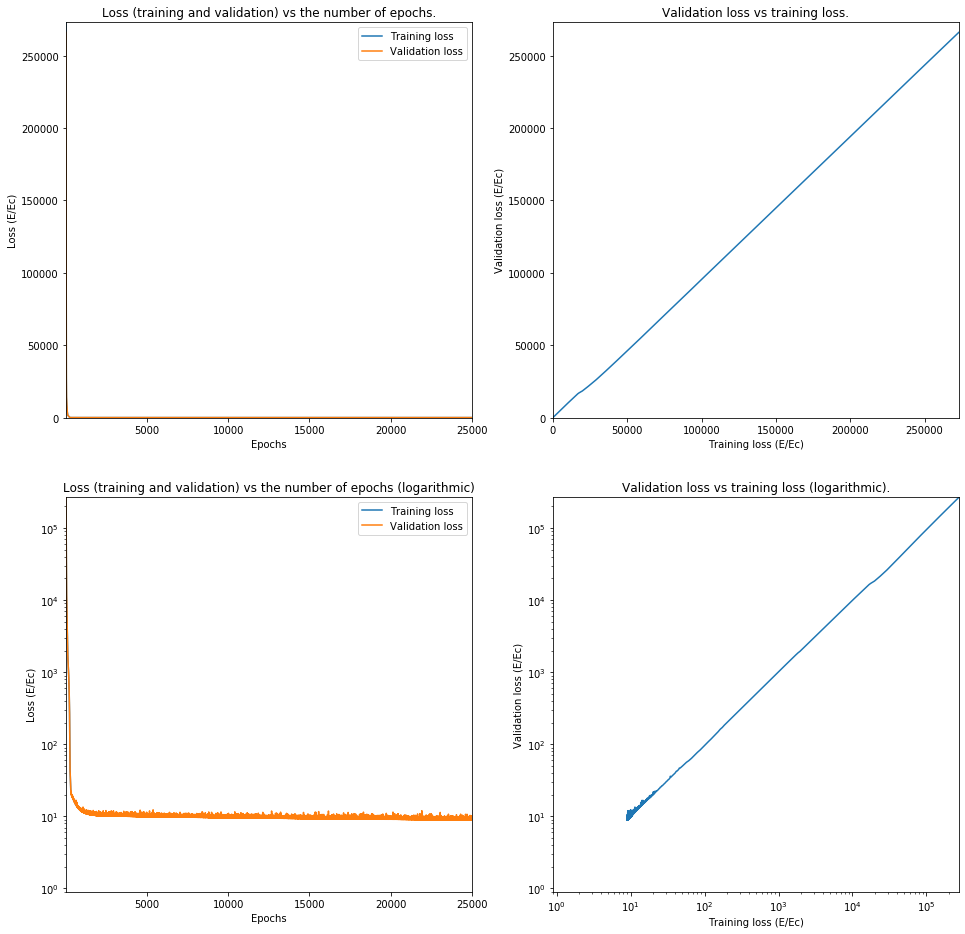

In [22]:
name = 'DenseLayerSmallSoftplus'
settingsNetwork = [inputSize, ['Dense', inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=25000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

19576/19576 [==============================] - 0s 9us/step
8.249646111902628


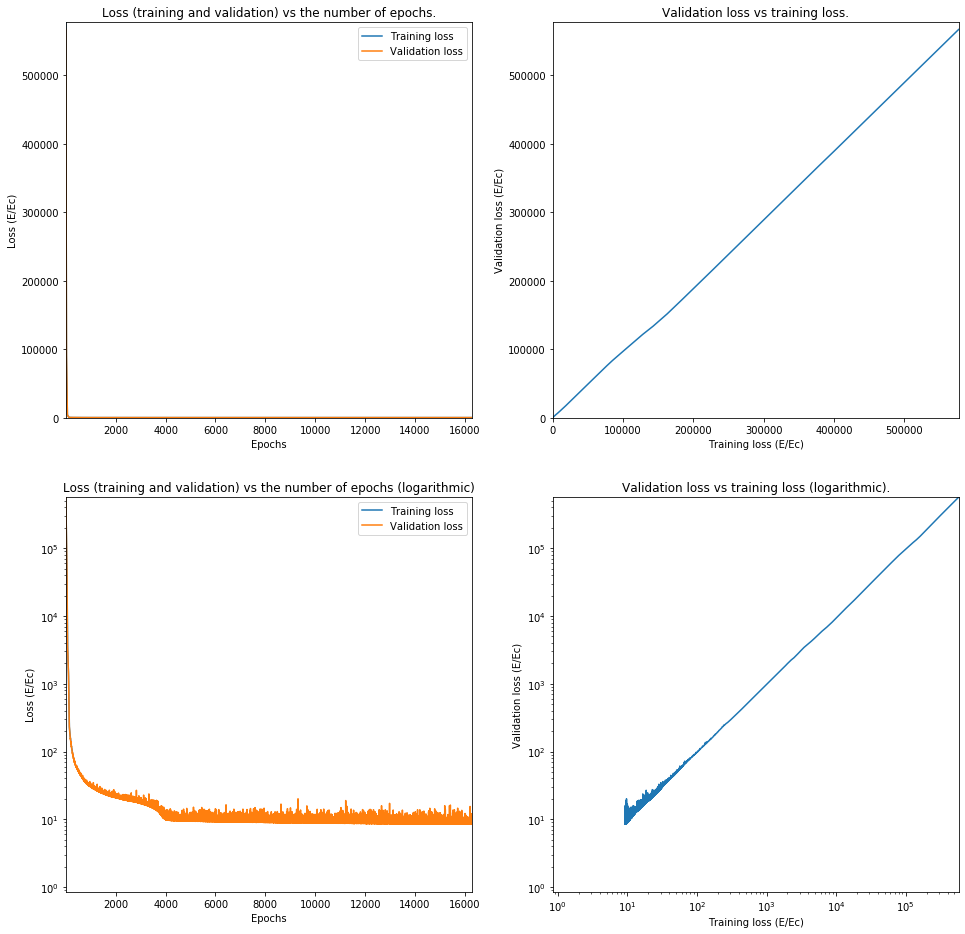

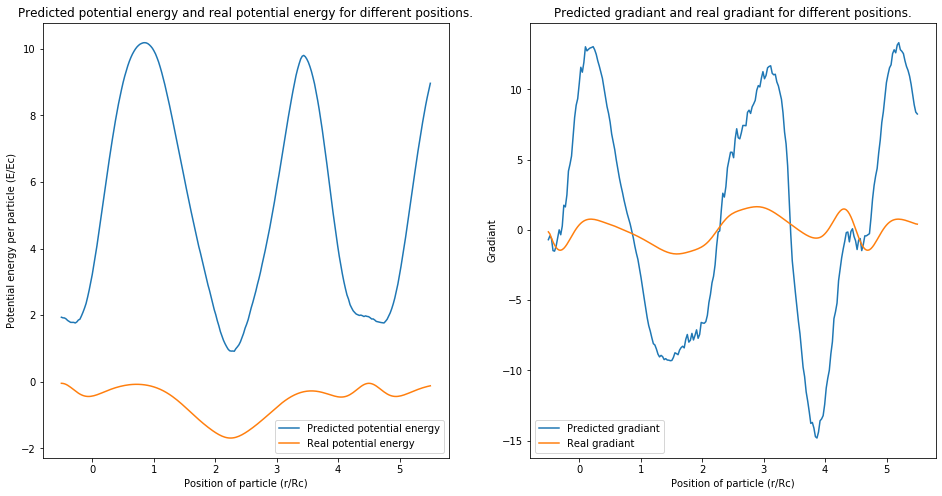

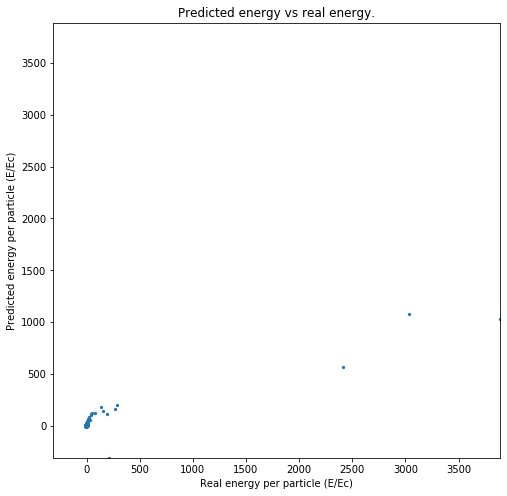

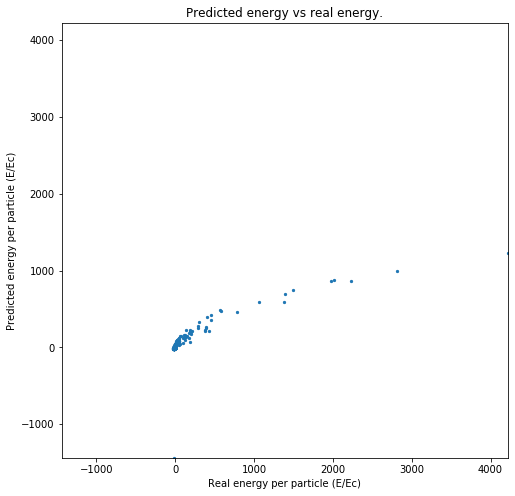

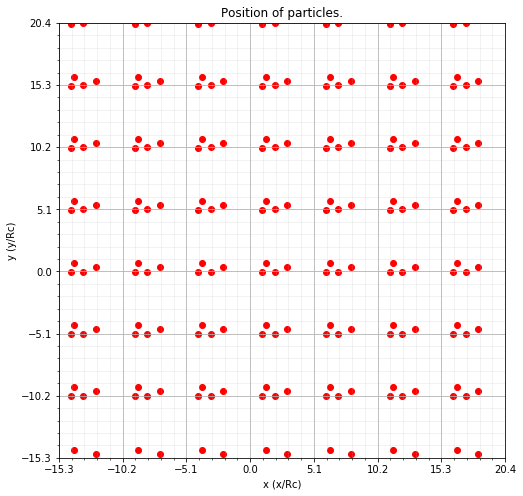

For index 27029 Predicted 6.830202 was -0.0432773724


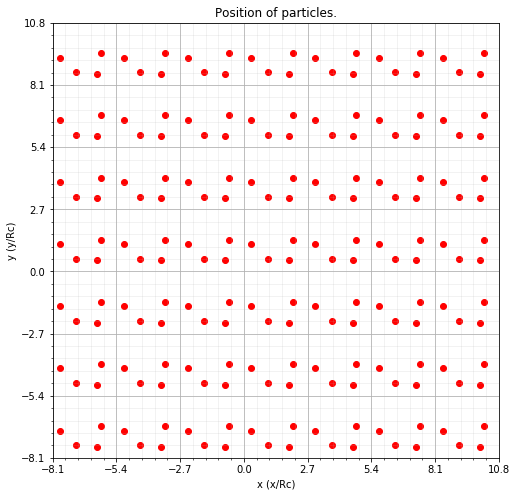

For index 82985 Predicted -4.8807354 was -3.4620669033


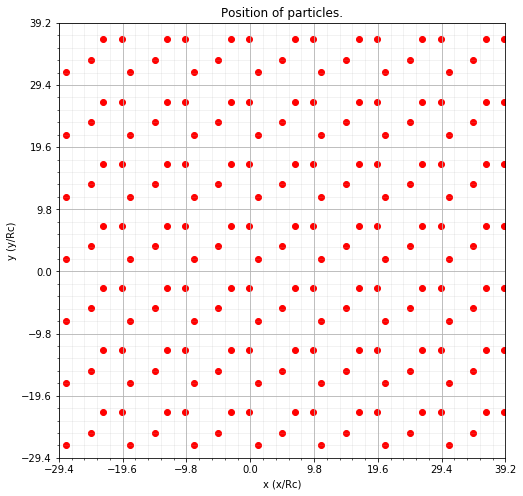

For index 81338 Predicted -1.9647045 was 0.0


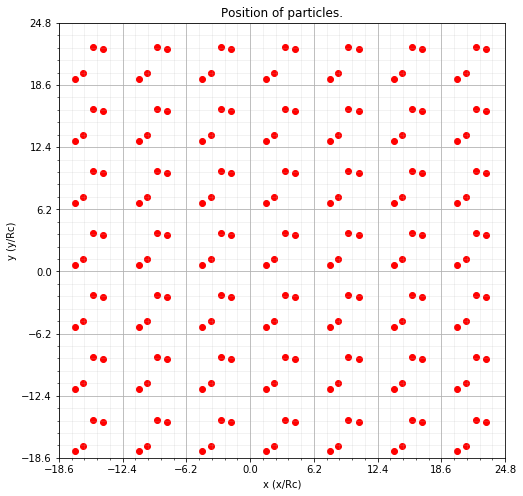

For index 90421 Predicted 0.56067085 was -0.2191454457


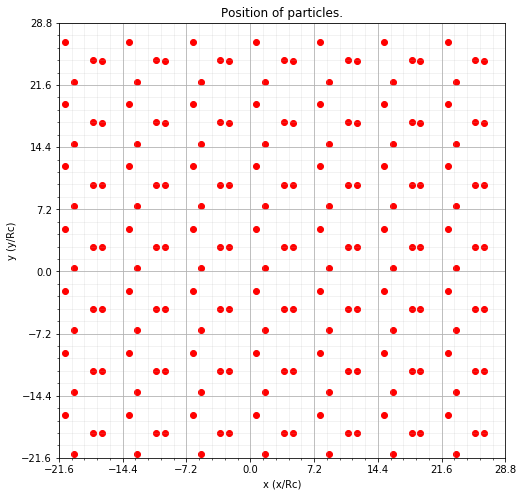

For index 23095 Predicted 1.031374 was -0.1095838854


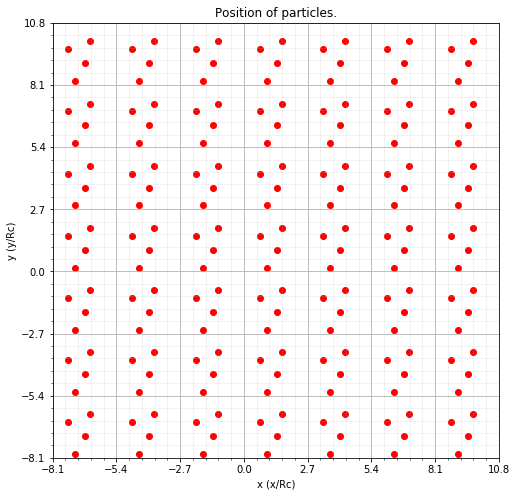

For index 92889 Predicted -0.2088604 was -3.8599259571999998


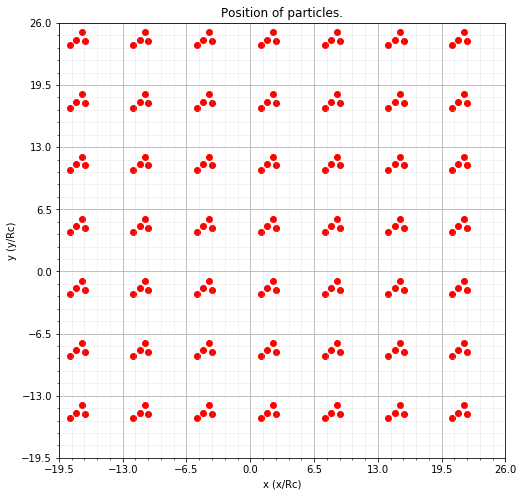

For index 97309 Predicted -1.0799541 was -2.3285637016000003


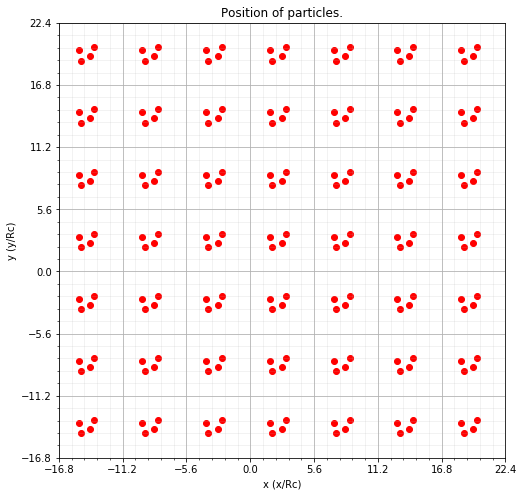

For index 89734 Predicted 1.1778584 was -2.6354253694


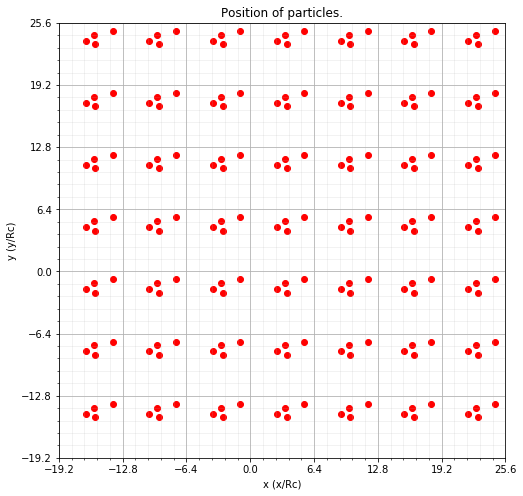

For index 22197 Predicted 0.8087177 was -1.3324452942


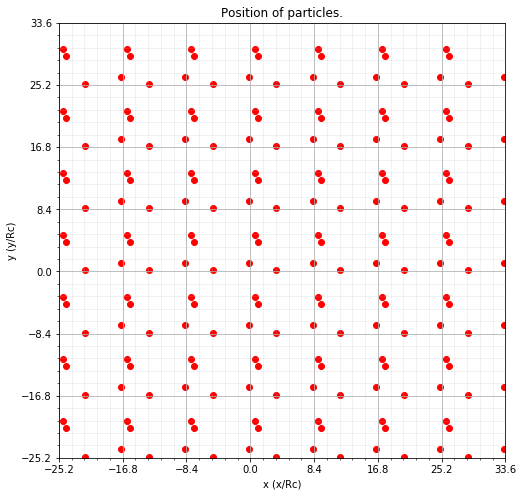

For index 17850 Predicted 0.49133492 was -0.10959605650000001


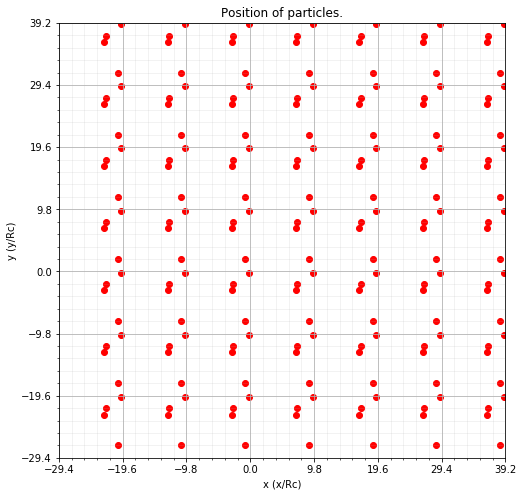

For index 61758 Predicted 0.906374 was -0.10957113210000001
Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_17 (Dense)             (None, 12)                156       
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 13        
Total params: 169
Trainable params: 169
Non-trainable params: 0
_________________________________________________________________
Layer 0:  [array([[ 0.67869234, -0.3111338 , -0.09382445,  0.42294273,  0.51363283,
         0.48519942, -0.8971602 , -0.27044165,  0.05247798, -0.23074347,
        -0.29678696, -0.46181333],
       [-0.5988481 , -0.25357634,  0.54395443, -0.06801607,  0.16332194,
         0.1665594 , -0.5152218 , -0.50043166,  0.36557978, -0.46300483,
        -0.05291808, -0.35556337],
       [ 0.58916366, -0.22539149, -0.6940384 ,  0.11067295,  0.12160693,
        -0.

In [23]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

## Model 2: 1 Dense layer medium softplus

In [ ]:
name = 'DenseLayerMediumSoftplus'
settingsNetwork = [inputSize, ['Dense', 2*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=25000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

## Model 3: 1 Dense layer large softplus

In [ ]:
name = 'DenseLayerLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 3*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())

## Model 4: 1 Dense layer super large softplus

In [ ]:
name = 'DenseLayerSuperLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 4*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 5: 2 Dense layers small softplus

In [ ]:
name = 'TwoDenseLayerSmallSoftplus'
settingsNetwork = [inputSize, ['Dense', inputSize, 'softplus', True], ['Dense', inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=25000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 6: 2 Dense layer medium softplus

In [ ]:
name = 'TwoDenseLayerMediumSoftplus'
settingsNetwork = [inputSize, ['Dense', 2*inputSize, 'softplus', True], ['Dense', 2*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 7: 2 Dense layers large softplus

In [ ]:
name = 'TwoDenseLayerLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 3*inputSize, 'softplus', True], ['Dense', 3*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

In [ ]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


## Model 8: 2 Dense layers very large softplus

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_21 (Dense)             (None, 48)                624       
_________________________________________________________________
dense_22 (Dense)             (None, 48)                2352      
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 49        
Total params: 3,025
Trainable params: 3,025
Non-trainable params: 0
_________________________________________________________________
78306/78306 [==============================] - 1s 11us/step
17349.208033328385
Layer 0:  [array([[ 0.17890257, -0.31710058,  0.19068146,  0.07552916,  0.4843307 ,
        -0.35366043, -0.32939145, -0.53160274,  0.4816882 ,  0.14982885,
         0.01156223,  0.1313321 , -0.26798466, -0.47416198,  0.46258777,
        -0.19743979,  0.6241576 , -0.46818858,  0.17860585,  0.3007149 ,

Train on 62644 samples, validate on 15662 samples
Epoch 1/10000
62644/62644 [==============================] - 2s 30us/step - loss: 21263.0537 - val_loss: 8804.1195
Epoch 2/10000
62644/62644 [==============================] - 2s 29us/step - loss: 7090.9851 - val_loss: 5429.7576
Epoch 3/10000
62644/62644 [==============================] - 2s 29us/step - loss: 4419.7148 - val_loss: 3751.3412
Epoch 4/10000
62644/62644 [==============================] - 2s 29us/step - loss: 3432.2844 - val_loss: 3186.7468
Epoch 5/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2986.0796 - val_loss: 2820.1398
Epoch 6/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2651.9369 - val_loss: 2517.6088
Epoch 7/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2361.2768 - val_loss: 2274.3638
Epoch 8/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2146.8917 - val_loss: 2093.4046
Epoch 9/10000
62644/62644 [==========

62644/62644 [==============================] - 2s 28us/step - loss: 440.2727 - val_loss: 461.1963
Epoch 73/10000
62644/62644 [==============================] - 2s 29us/step - loss: 438.5654 - val_loss: 460.0972
Epoch 74/10000
62644/62644 [==============================] - 2s 29us/step - loss: 436.0068 - val_loss: 456.3286
Epoch 75/10000
62644/62644 [==============================] - 2s 29us/step - loss: 432.9885 - val_loss: 460.1261
Epoch 76/10000
62644/62644 [==============================] - 2s 29us/step - loss: 431.7690 - val_loss: 452.5459
Epoch 77/10000
62644/62644 [==============================] - 2s 29us/step - loss: 428.9793 - val_loss: 447.5118
Epoch 78/10000
62644/62644 [==============================] - 2s 29us/step - loss: 426.0965 - val_loss: 454.0415
Epoch 79/10000
62644/62644 [==============================] - 2s 29us/step - loss: 424.1935 - val_loss: 439.8727
Epoch 80/10000
62644/62644 [==============================] - 2s 29us/step - loss: 420.6914 - val_loss: 451.970

62644/62644 [==============================] - 2s 29us/step - loss: 329.8417 - val_loss: 340.2252
Epoch 145/10000
62644/62644 [==============================] - 2s 29us/step - loss: 329.2520 - val_loss: 354.8053
Epoch 146/10000
62644/62644 [==============================] - 2s 29us/step - loss: 327.2847 - val_loss: 350.4487
Epoch 147/10000
62644/62644 [==============================] - 2s 29us/step - loss: 325.8224 - val_loss: 344.7735
Epoch 148/10000
62644/62644 [==============================] - 2s 29us/step - loss: 324.7560 - val_loss: 334.3465
Epoch 149/10000
62644/62644 [==============================] - 2s 29us/step - loss: 323.7498 - val_loss: 346.2234
Epoch 150/10000
62644/62644 [==============================] - 2s 29us/step - loss: 321.9447 - val_loss: 344.0383
Epoch 151/10000
62644/62644 [==============================] - 2s 29us/step - loss: 321.2432 - val_loss: 329.6561
Epoch 152/10000
62644/62644 [==============================] - 2s 29us/step - loss: 320.4044 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 257.4916 - val_loss: 278.1560
Epoch 217/10000
62644/62644 [==============================] - 2s 29us/step - loss: 258.3490 - val_loss: 276.7417
Epoch 218/10000
62644/62644 [==============================] - 2s 29us/step - loss: 255.3744 - val_loss: 280.2398
Epoch 219/10000
62644/62644 [==============================] - 2s 29us/step - loss: 254.9063 - val_loss: 260.6105
Epoch 220/10000
62644/62644 [==============================] - 2s 29us/step - loss: 254.1600 - val_loss: 262.0984
Epoch 221/10000
62644/62644 [==============================] - 2s 29us/step - loss: 253.7312 - val_loss: 269.6104
Epoch 222/10000
62644/62644 [==============================] - 2s 29us/step - loss: 251.9482 - val_loss: 287.0323
Epoch 223/10000
62644/62644 [==============================] - 2s 29us/step - loss: 251.4915 - val_loss: 258.7330
Epoch 224/10000
62644/62644 [==============================] - 2s 29us/step - loss: 250.2529 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 203.0369 - val_loss: 208.7022
Epoch 289/10000
62644/62644 [==============================] - 2s 29us/step - loss: 202.6696 - val_loss: 212.5358
Epoch 290/10000
62644/62644 [==============================] - 2s 29us/step - loss: 201.2189 - val_loss: 207.6991
Epoch 291/10000
62644/62644 [==============================] - 2s 29us/step - loss: 201.1287 - val_loss: 206.5340
Epoch 292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 200.2254 - val_loss: 203.8098
Epoch 293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 200.3341 - val_loss: 208.0554
Epoch 294/10000
62644/62644 [==============================] - 2s 29us/step - loss: 198.5799 - val_loss: 203.1071
Epoch 295/10000
62644/62644 [==============================] - 2s 29us/step - loss: 197.6532 - val_loss: 203.0128
Epoch 296/10000
62644/62644 [==============================] - 2s 29us/step - loss: 197.3361 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 155.8510 - val_loss: 153.9093
Epoch 361/10000
62644/62644 [==============================] - 2s 28us/step - loss: 154.4812 - val_loss: 158.8094
Epoch 362/10000
62644/62644 [==============================] - 2s 28us/step - loss: 153.9593 - val_loss: 155.3128
Epoch 363/10000
62644/62644 [==============================] - 2s 29us/step - loss: 153.9788 - val_loss: 152.4440
Epoch 364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 152.6415 - val_loss: 162.3401
Epoch 365/10000
62644/62644 [==============================] - 2s 29us/step - loss: 152.7284 - val_loss: 150.8017
Epoch 366/10000
62644/62644 [==============================] - 2s 29us/step - loss: 151.8340 - val_loss: 152.8743
Epoch 367/10000
62644/62644 [==============================] - 2s 28us/step - loss: 149.8606 - val_loss: 149.7963
Epoch 368/10000
62644/62644 [==============================] - 2s 28us/step - loss: 149.8998 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 114.7700 - val_loss: 118.3273
Epoch 433/10000
62644/62644 [==============================] - 2s 29us/step - loss: 114.9871 - val_loss: 116.5652
Epoch 434/10000
62644/62644 [==============================] - 2s 29us/step - loss: 114.0324 - val_loss: 121.7255
Epoch 435/10000
62644/62644 [==============================] - 2s 29us/step - loss: 113.3801 - val_loss: 129.6435
Epoch 436/10000
62644/62644 [==============================] - 2s 29us/step - loss: 113.8146 - val_loss: 114.6815
Epoch 437/10000
62644/62644 [==============================] - 2s 29us/step - loss: 113.9713 - val_loss: 150.2366
Epoch 438/10000
62644/62644 [==============================] - 2s 29us/step - loss: 112.3255 - val_loss: 128.5750
Epoch 439/10000
62644/62644 [==============================] - 2s 29us/step - loss: 112.3031 - val_loss: 115.4129
Epoch 440/10000
62644/62644 [==============================] - 2s 29us/step - loss: 111.4796 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 91.8186 - val_loss: 94.5072
Epoch 505/10000
62644/62644 [==============================] - 2s 29us/step - loss: 91.4774 - val_loss: 93.1150
Epoch 506/10000
62644/62644 [==============================] - 2s 29us/step - loss: 91.8810 - val_loss: 94.0504
Epoch 507/10000
62644/62644 [==============================] - 2s 29us/step - loss: 91.5517 - val_loss: 96.5886
Epoch 508/10000
62644/62644 [==============================] - 2s 29us/step - loss: 91.0698 - val_loss: 96.2724
Epoch 509/10000
62644/62644 [==============================] - 2s 29us/step - loss: 90.9436 - val_loss: 95.0718
Epoch 510/10000
62644/62644 [==============================] - 2s 29us/step - loss: 90.6264 - val_loss: 101.0444
Epoch 511/10000
62644/62644 [==============================] - 2s 29us/step - loss: 91.2338 - val_loss: 101.5450
Epoch 512/10000
62644/62644 [==============================] - 2s 28us/step - loss: 89.3970 - val_loss: 92.6847
Epoch 

62644/62644 [==============================] - 2s 29us/step - loss: 76.4463 - val_loss: 94.5889
Epoch 578/10000
62644/62644 [==============================] - 2s 29us/step - loss: 76.6315 - val_loss: 84.4386
Epoch 579/10000
62644/62644 [==============================] - 2s 29us/step - loss: 75.9477 - val_loss: 78.6339
Epoch 580/10000
62644/62644 [==============================] - 2s 29us/step - loss: 74.7989 - val_loss: 76.5543
Epoch 581/10000
62644/62644 [==============================] - 2s 29us/step - loss: 76.4790 - val_loss: 89.2513
Epoch 582/10000
62644/62644 [==============================] - 2s 29us/step - loss: 75.3585 - val_loss: 76.4857
Epoch 583/10000
62644/62644 [==============================] - 2s 29us/step - loss: 75.1858 - val_loss: 81.4335
Epoch 584/10000
62644/62644 [==============================] - 2s 29us/step - loss: 75.2912 - val_loss: 81.6127
Epoch 585/10000
62644/62644 [==============================] - 2s 29us/step - loss: 75.1983 - val_loss: 89.3978
Epoch 58

62644/62644 [==============================] - 2s 29us/step - loss: 68.8498 - val_loss: 68.1424
Epoch 651/10000
62644/62644 [==============================] - 2s 29us/step - loss: 68.5402 - val_loss: 67.6772
Epoch 652/10000
62644/62644 [==============================] - 2s 29us/step - loss: 67.5968 - val_loss: 67.8882
Epoch 653/10000
62644/62644 [==============================] - 2s 29us/step - loss: 68.4014 - val_loss: 72.8757
Epoch 654/10000
62644/62644 [==============================] - 2s 29us/step - loss: 68.1740 - val_loss: 73.0836
Epoch 655/10000
62644/62644 [==============================] - 2s 29us/step - loss: 67.5502 - val_loss: 82.3465
Epoch 656/10000
62644/62644 [==============================] - 2s 29us/step - loss: 68.2432 - val_loss: 67.3764
Epoch 657/10000
62644/62644 [==============================] - 2s 29us/step - loss: 67.8697 - val_loss: 81.2328
Epoch 658/10000
62644/62644 [==============================] - 2s 28us/step - loss: 67.8195 - val_loss: 96.7129
Epoch 65

62644/62644 [==============================] - 2s 29us/step - loss: 62.4257 - val_loss: 61.5464
Epoch 724/10000
62644/62644 [==============================] - 2s 29us/step - loss: 62.2461 - val_loss: 71.6159
Epoch 725/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.7012 - val_loss: 63.1707
Epoch 726/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.4048 - val_loss: 62.0447
Epoch 727/10000
62644/62644 [==============================] - 2s 30us/step - loss: 61.2775 - val_loss: 65.1147
Epoch 728/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.6612 - val_loss: 60.5580
Epoch 729/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.7069 - val_loss: 62.0378
Epoch 730/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.9090 - val_loss: 61.8321
Epoch 731/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.5900 - val_loss: 66.1649
Epoch 73

62644/62644 [==============================] - 2s 29us/step - loss: 57.0119 - val_loss: 82.2704
Epoch 797/10000
62644/62644 [==============================] - 2s 29us/step - loss: 56.3973 - val_loss: 56.5293
Epoch 798/10000
62644/62644 [==============================] - 2s 29us/step - loss: 56.7990 - val_loss: 59.4396
Epoch 799/10000
62644/62644 [==============================] - 2s 29us/step - loss: 56.5913 - val_loss: 58.8458
Epoch 800/10000
62644/62644 [==============================] - 2s 29us/step - loss: 56.5216 - val_loss: 55.1477
Epoch 801/10000
62644/62644 [==============================] - 2s 29us/step - loss: 57.5887 - val_loss: 60.6703
Epoch 802/10000
62644/62644 [==============================] - 2s 30us/step - loss: 56.4632 - val_loss: 57.2362
Epoch 803/10000
62644/62644 [==============================] - 2s 29us/step - loss: 56.3418 - val_loss: 64.1341
Epoch 804/10000
62644/62644 [==============================] - 2s 29us/step - loss: 55.5115 - val_loss: 63.8653
Epoch 80

62644/62644 [==============================] - 2s 30us/step - loss: 51.9567 - val_loss: 52.0616
Epoch 870/10000
62644/62644 [==============================] - 2s 30us/step - loss: 52.7347 - val_loss: 53.5988
Epoch 871/10000
62644/62644 [==============================] - 2s 30us/step - loss: 52.3780 - val_loss: 52.7168
Epoch 872/10000
62644/62644 [==============================] - 2s 29us/step - loss: 52.3740 - val_loss: 51.8238
Epoch 873/10000
62644/62644 [==============================] - 2s 29us/step - loss: 51.4406 - val_loss: 53.4103
Epoch 874/10000
62644/62644 [==============================] - 2s 30us/step - loss: 52.2957 - val_loss: 53.8706
Epoch 875/10000
62644/62644 [==============================] - 2s 30us/step - loss: 52.3312 - val_loss: 52.1846
Epoch 876/10000
62644/62644 [==============================] - 2s 30us/step - loss: 51.5691 - val_loss: 63.9216
Epoch 877/10000
62644/62644 [==============================] - 2s 30us/step - loss: 51.7119 - val_loss: 54.4089
Epoch 87

62644/62644 [==============================] - 2s 28us/step - loss: 48.8416 - val_loss: 59.5124
Epoch 943/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.7077 - val_loss: 55.1874
Epoch 944/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.8301 - val_loss: 47.5003
Epoch 945/10000
62644/62644 [==============================] - 2s 29us/step - loss: 49.0350 - val_loss: 50.7615
Epoch 946/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.3869 - val_loss: 49.3753
Epoch 947/10000
62644/62644 [==============================] - 2s 29us/step - loss: 47.9887 - val_loss: 52.2154
Epoch 948/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.1792 - val_loss: 48.1251
Epoch 949/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.2450 - val_loss: 48.5229
Epoch 950/10000
62644/62644 [==============================] - 2s 29us/step - loss: 47.5434 - val_loss: 56.9217
Epoch 95

62644/62644 [==============================] - 2s 29us/step - loss: 45.9985 - val_loss: 45.1985
Epoch 1016/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.2294 - val_loss: 58.4537
Epoch 1017/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.5639 - val_loss: 66.0144
Epoch 1018/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.1210 - val_loss: 45.6798
Epoch 1019/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.2747 - val_loss: 44.1670
Epoch 1020/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.2175 - val_loss: 47.0100
Epoch 1021/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.4393 - val_loss: 68.5410
Epoch 1022/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.2598 - val_loss: 43.7897
Epoch 1023/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.9928 - val_loss: 43.7512


62644/62644 [==============================] - 2s 29us/step - loss: 42.1693 - val_loss: 57.3441
Epoch 1088/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.1955 - val_loss: 46.3964
Epoch 1089/10000
62644/62644 [==============================] - 2s 28us/step - loss: 42.7580 - val_loss: 51.9479
Epoch 1090/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.2551 - val_loss: 44.4706
Epoch 1091/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.7145 - val_loss: 63.3469
Epoch 1092/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.9845 - val_loss: 62.9240
Epoch 1093/10000
62644/62644 [==============================] - 2s 28us/step - loss: 42.7341 - val_loss: 40.9790
Epoch 1094/10000
62644/62644 [==============================] - 2s 28us/step - loss: 43.2047 - val_loss: 49.5739
Epoch 1095/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.2262 - val_loss: 60.1106


62644/62644 [==============================] - 2s 28us/step - loss: 40.2378 - val_loss: 43.0478
Epoch 1160/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.5545 - val_loss: 41.0956
Epoch 1161/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.2902 - val_loss: 44.0738
Epoch 1162/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.5550 - val_loss: 41.2624
Epoch 1163/10000
62644/62644 [==============================] - 2s 28us/step - loss: 40.1891 - val_loss: 54.2659
Epoch 1164/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.8266 - val_loss: 47.6754
Epoch 1165/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.6076 - val_loss: 43.0064
Epoch 1166/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.4232 - val_loss: 39.8387
Epoch 1167/10000
62644/62644 [==============================] - 2s 29us/step - loss: 40.2605 - val_loss: 46.6773


62644/62644 [==============================] - 2s 29us/step - loss: 39.2044 - val_loss: 43.0235
Epoch 1232/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.3815 - val_loss: 37.1762
Epoch 1233/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.2112 - val_loss: 36.9409
Epoch 1234/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.2872 - val_loss: 37.2794
Epoch 1235/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.5642 - val_loss: 53.9713
Epoch 1236/10000
62644/62644 [==============================] - 2s 28us/step - loss: 38.9680 - val_loss: 41.9809
Epoch 1237/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.1665 - val_loss: 40.1844
Epoch 1238/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.5933 - val_loss: 40.1828
Epoch 1239/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.6391 - val_loss: 38.5929


62644/62644 [==============================] - 2s 29us/step - loss: 36.6659 - val_loss: 35.3662
Epoch 1304/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.7630 - val_loss: 35.8701
Epoch 1305/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.6975 - val_loss: 35.8958
Epoch 1306/10000
62644/62644 [==============================] - 2s 28us/step - loss: 37.0371 - val_loss: 40.2813
Epoch 1307/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.3171 - val_loss: 34.8316
Epoch 1308/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.3852 - val_loss: 39.5806
Epoch 1309/10000
62644/62644 [==============================] - 2s 28us/step - loss: 37.5682 - val_loss: 43.4471
Epoch 1310/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.7655 - val_loss: 36.0910
Epoch 1311/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.2544 - val_loss: 37.6192


62644/62644 [==============================] - 2s 29us/step - loss: 35.5184 - val_loss: 40.4877
Epoch 1376/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.6796 - val_loss: 45.4535
Epoch 1377/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.7040 - val_loss: 36.5746
Epoch 1378/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.1418 - val_loss: 42.8587
Epoch 1379/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.7000 - val_loss: 42.4838
Epoch 1380/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.0763 - val_loss: 39.6147
Epoch 1381/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.5299 - val_loss: 34.1226
Epoch 1382/10000
62644/62644 [==============================] - 2s 28us/step - loss: 36.2556 - val_loss: 33.7268
Epoch 1383/10000
62644/62644 [==============================] - 2s 28us/step - loss: 35.4506 - val_loss: 37.5091


62644/62644 [==============================] - 2s 30us/step - loss: 34.4925 - val_loss: 32.4606
Epoch 1448/10000
62644/62644 [==============================] - 2s 30us/step - loss: 34.5531 - val_loss: 37.7467
Epoch 1449/10000
62644/62644 [==============================] - 2s 30us/step - loss: 34.7981 - val_loss: 32.1330
Epoch 1450/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.6103 - val_loss: 35.2595
Epoch 1451/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.5295 - val_loss: 33.4089
Epoch 1452/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.4918 - val_loss: 38.2214
Epoch 1453/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.4950 - val_loss: 41.5068
Epoch 1454/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.2649 - val_loss: 34.2198
Epoch 1455/10000
62644/62644 [==============================] - 2s 29us/step - loss: 34.4410 - val_loss: 32.3492


62644/62644 [==============================] - 2s 33us/step - loss: 33.6562 - val_loss: 32.8641
Epoch 1520/10000
62644/62644 [==============================] - 2s 35us/step - loss: 34.0157 - val_loss: 37.6957
Epoch 1521/10000
62644/62644 [==============================] - 2s 30us/step - loss: 33.6921 - val_loss: 31.5768
Epoch 1522/10000
62644/62644 [==============================] - 2s 30us/step - loss: 34.3744 - val_loss: 44.6936
Epoch 1523/10000
62644/62644 [==============================] - 2s 30us/step - loss: 33.1118 - val_loss: 32.3033
Epoch 1524/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2139 - val_loss: 36.3216
Epoch 1525/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2278 - val_loss: 34.7144
Epoch 1526/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.3662 - val_loss: 35.4365
Epoch 1527/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.2702 - val_loss: 35.9203


62644/62644 [==============================] - 2s 29us/step - loss: 32.8226 - val_loss: 37.0121
Epoch 1592/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.6221 - val_loss: 35.1442
Epoch 1593/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.7538 - val_loss: 31.0581
Epoch 1594/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.5192 - val_loss: 30.7201
Epoch 1595/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.9254 - val_loss: 36.0359
Epoch 1596/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.7770 - val_loss: 44.4170
Epoch 1597/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.1589 - val_loss: 33.4214
Epoch 1598/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.0842 - val_loss: 32.0508
Epoch 1599/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.7784 - val_loss: 31.1611


62644/62644 [==============================] - 2s 29us/step - loss: 30.8859 - val_loss: 41.2213
Epoch 1664/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.4594 - val_loss: 35.1797
Epoch 1665/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.5666 - val_loss: 29.2760
Epoch 1666/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.4826 - val_loss: 29.6944
Epoch 1667/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.5061 - val_loss: 39.0833
Epoch 1668/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.5421 - val_loss: 29.7421
Epoch 1669/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.0607 - val_loss: 30.8884
Epoch 1670/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.8283 - val_loss: 33.7453
Epoch 1671/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.6108 - val_loss: 30.8943


62644/62644 [==============================] - 2s 29us/step - loss: 30.5824 - val_loss: 36.0600
Epoch 1736/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.7626 - val_loss: 41.2984
Epoch 1737/10000
62644/62644 [==============================] - 2s 30us/step - loss: 30.8251 - val_loss: 34.6591
Epoch 1738/10000
62644/62644 [==============================] - 2s 30us/step - loss: 30.5947 - val_loss: 28.5148
Epoch 1739/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.1985 - val_loss: 36.4777
Epoch 1740/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.0374 - val_loss: 30.6768
Epoch 1741/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.2482 - val_loss: 28.6297
Epoch 1742/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.7447 - val_loss: 34.4337
Epoch 1743/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.3044 - val_loss: 28.6275


62644/62644 [==============================] - 2s 29us/step - loss: 29.7543 - val_loss: 32.0187
Epoch 1808/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.8757 - val_loss: 36.1992
Epoch 1809/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.5596 - val_loss: 29.5446
Epoch 1810/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.1625 - val_loss: 28.9424
Epoch 1811/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.1714 - val_loss: 29.3174
Epoch 1812/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.6305 - val_loss: 37.4471
Epoch 1813/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.8048 - val_loss: 29.6211
Epoch 1814/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.8131 - val_loss: 32.5137
Epoch 1815/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.8408 - val_loss: 33.0576


62644/62644 [==============================] - 2s 29us/step - loss: 28.7500 - val_loss: 38.9863
Epoch 1880/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.7034 - val_loss: 30.7857
Epoch 1881/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.9530 - val_loss: 45.3166
Epoch 1882/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.7506 - val_loss: 38.8797
Epoch 1883/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.1173 - val_loss: 53.0285
Epoch 1884/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.6820 - val_loss: 30.1267
Epoch 1885/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.4099 - val_loss: 27.4851
Epoch 1886/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.2490 - val_loss: 29.4248
Epoch 1887/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.3461 - val_loss: 35.1750


62644/62644 [==============================] - 2s 29us/step - loss: 28.8701 - val_loss: 27.2436
Epoch 1952/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.3628 - val_loss: 35.0416
Epoch 1953/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.6732 - val_loss: 39.2584
Epoch 1954/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.4169 - val_loss: 45.2216
Epoch 1955/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.8661 - val_loss: 27.5107
Epoch 1956/10000
62644/62644 [==============================] - 2s 30us/step - loss: 28.3058 - val_loss: 35.3076
Epoch 1957/10000
62644/62644 [==============================] - 2s 30us/step - loss: 28.5382 - val_loss: 27.4317
Epoch 1958/10000
62644/62644 [==============================] - 2s 30us/step - loss: 28.0554 - val_loss: 36.8697
Epoch 1959/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.9861 - val_loss: 28.7507


62644/62644 [==============================] - 2s 29us/step - loss: 28.8477 - val_loss: 27.6180
Epoch 2024/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.7471 - val_loss: 27.6450
Epoch 2025/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.0480 - val_loss: 27.1021
Epoch 2026/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.4113 - val_loss: 32.5189
Epoch 2027/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.6165 - val_loss: 29.6200
Epoch 2028/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.2489 - val_loss: 26.9841
Epoch 2029/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.0297 - val_loss: 27.5580
Epoch 2030/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.6119 - val_loss: 29.0899
Epoch 2031/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.1187 - val_loss: 26.6432


62644/62644 [==============================] - 2s 29us/step - loss: 27.4539 - val_loss: 37.3340
Epoch 2096/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.4155 - val_loss: 28.2808
Epoch 2097/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.7822 - val_loss: 40.8677
Epoch 2098/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.1244 - val_loss: 30.6929
Epoch 2099/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.4862 - val_loss: 33.7892
Epoch 2100/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.0570 - val_loss: 33.4101
Epoch 2101/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.8868 - val_loss: 26.5438
Epoch 2102/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.6474 - val_loss: 25.1098
Epoch 2103/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.3867 - val_loss: 33.4457


62644/62644 [==============================] - 2s 29us/step - loss: 28.2644 - val_loss: 26.2610
Epoch 2168/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.6083 - val_loss: 24.7349
Epoch 2169/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.7726 - val_loss: 30.9542
Epoch 2170/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.2050 - val_loss: 29.7899
Epoch 2171/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.2271 - val_loss: 28.9496
Epoch 2172/10000
62644/62644 [==============================] - 2s 30us/step - loss: 27.2054 - val_loss: 35.3187
Epoch 2173/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.0815 - val_loss: 32.6051
Epoch 2174/10000
62644/62644 [==============================] - 2s 30us/step - loss: 27.2736 - val_loss: 27.6956
Epoch 2175/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.2435 - val_loss: 25.5650


62644/62644 [==============================] - 2s 31us/step - loss: 27.4651 - val_loss: 32.7895
Epoch 2240/10000
62644/62644 [==============================] - 2s 31us/step - loss: 26.9612 - val_loss: 27.0852
Epoch 2241/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.7234 - val_loss: 34.7275
Epoch 2242/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.1154 - val_loss: 27.6254
Epoch 2243/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.6208 - val_loss: 29.4531
Epoch 2244/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.8081 - val_loss: 25.5756
Epoch 2245/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.8105 - val_loss: 24.3651
Epoch 2246/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.9209 - val_loss: 26.7321
Epoch 2247/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.0562 - val_loss: 24.7218


62644/62644 [==============================] - 2s 29us/step - loss: 26.6294 - val_loss: 26.0622
Epoch 2312/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.3292 - val_loss: 24.5380
Epoch 2313/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.2023 - val_loss: 27.4988
Epoch 2314/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.2409 - val_loss: 26.6445
Epoch 2315/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.1024 - val_loss: 27.2098
Epoch 2316/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.1999 - val_loss: 47.7955
Epoch 2317/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.6708 - val_loss: 29.1656
Epoch 2318/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.7804 - val_loss: 25.0877
Epoch 2319/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.1609 - val_loss: 25.5574


62644/62644 [==============================] - 2s 29us/step - loss: 25.6976 - val_loss: 30.9747
Epoch 2384/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.6148 - val_loss: 25.9617
Epoch 2385/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.0848 - val_loss: 36.7863
Epoch 2386/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.7806 - val_loss: 32.1217
Epoch 2387/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.1569 - val_loss: 26.6229
Epoch 2388/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4349 - val_loss: 25.7789
Epoch 2389/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.0968 - val_loss: 30.0204
Epoch 2390/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.6316 - val_loss: 24.9401
Epoch 2391/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.3753 - val_loss: 26.7244


62644/62644 [==============================] - 2s 29us/step - loss: 25.6995 - val_loss: 27.3043
Epoch 2456/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.8468 - val_loss: 28.1466
Epoch 2457/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.3613 - val_loss: 26.5663
Epoch 2458/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.8446 - val_loss: 26.3305
Epoch 2459/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.8545 - val_loss: 28.0439
Epoch 2460/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0111 - val_loss: 46.8916
Epoch 2461/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.9557 - val_loss: 40.5809
Epoch 2462/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.3931 - val_loss: 23.4995
Epoch 2463/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1696 - val_loss: 34.8098


62644/62644 [==============================] - 2s 29us/step - loss: 25.5446 - val_loss: 48.4760
Epoch 2528/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1635 - val_loss: 23.0766
Epoch 2529/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4095 - val_loss: 25.3226
Epoch 2530/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1760 - val_loss: 24.0832
Epoch 2531/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4300 - val_loss: 44.9736
Epoch 2532/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0281 - val_loss: 29.3953
Epoch 2533/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.0729 - val_loss: 24.3736
Epoch 2534/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.7042 - val_loss: 23.5865
Epoch 2535/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.7754 - val_loss: 24.2623


62644/62644 [==============================] - 2s 29us/step - loss: 24.6299 - val_loss: 28.1784
Epoch 2600/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1149 - val_loss: 25.9204
Epoch 2601/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9302 - val_loss: 26.1963
Epoch 2602/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.3715 - val_loss: 22.9907
Epoch 2603/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9578 - val_loss: 23.2960
Epoch 2604/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9812 - val_loss: 25.8753
Epoch 2605/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1398 - val_loss: 38.7918
Epoch 2606/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.2758 - val_loss: 22.5084
Epoch 2607/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1258 - val_loss: 35.8691


62644/62644 [==============================] - 2s 29us/step - loss: 24.9583 - val_loss: 21.9361
Epoch 2672/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.6323 - val_loss: 24.3151
Epoch 2673/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.7430 - val_loss: 31.4965
Epoch 2674/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.7409 - val_loss: 28.6212
Epoch 2675/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.2914 - val_loss: 23.8398
Epoch 2676/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1283 - val_loss: 45.3238
Epoch 2677/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.3239 - val_loss: 23.3249
Epoch 2678/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.8905 - val_loss: 23.6095
Epoch 2679/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0204 - val_loss: 31.1327


62644/62644 [==============================] - 2s 30us/step - loss: 24.9302 - val_loss: 23.2165
Epoch 2744/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1480 - val_loss: 22.0533
Epoch 2745/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.3976 - val_loss: 27.6731
Epoch 2746/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.2004 - val_loss: 23.8260
Epoch 2747/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.2989 - val_loss: 22.1848
Epoch 2748/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.0350 - val_loss: 24.2769
Epoch 2749/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.3433 - val_loss: 33.8779
Epoch 2750/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1130 - val_loss: 38.4602
Epoch 2751/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.4296 - val_loss: 25.0884


62644/62644 [==============================] - 2s 29us/step - loss: 24.5695 - val_loss: 24.2096
Epoch 2816/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.9067 - val_loss: 25.3292
Epoch 2817/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.9841 - val_loss: 21.6885
Epoch 2818/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7123 - val_loss: 33.8772
Epoch 2819/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.5663 - val_loss: 27.2334
Epoch 2820/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4673 - val_loss: 29.5971
Epoch 2821/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7983 - val_loss: 23.6018
Epoch 2822/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.2149 - val_loss: 21.9879
Epoch 2823/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.3942 - val_loss: 21.3270


62644/62644 [==============================] - 2s 29us/step - loss: 24.0165 - val_loss: 31.1486
Epoch 2888/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3465 - val_loss: 24.2219
Epoch 2889/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2256 - val_loss: 29.0798
Epoch 2890/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1928 - val_loss: 33.2358
Epoch 2891/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7818 - val_loss: 29.0499
Epoch 2892/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4575 - val_loss: 27.2518
Epoch 2893/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6337 - val_loss: 24.2325
Epoch 2894/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.9406 - val_loss: 23.1408
Epoch 2895/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6904 - val_loss: 22.7965


62644/62644 [==============================] - 2s 29us/step - loss: 22.8203 - val_loss: 21.2759
Epoch 2960/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.8614 - val_loss: 32.8928
Epoch 2961/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.5181 - val_loss: 24.6316
Epoch 2962/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1268 - val_loss: 26.5372
Epoch 2963/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3897 - val_loss: 37.9129
Epoch 2964/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.6274 - val_loss: 39.9963
Epoch 2965/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.9880 - val_loss: 21.3498
Epoch 2966/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.1801 - val_loss: 29.2307
Epoch 2967/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.7838 - val_loss: 22.3221


62644/62644 [==============================] - 2s 29us/step - loss: 23.6710 - val_loss: 21.1817
Epoch 3032/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9722 - val_loss: 26.7874
Epoch 3033/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7784 - val_loss: 27.1127
Epoch 3034/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.5814 - val_loss: 21.4706
Epoch 3035/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3009 - val_loss: 26.2584
Epoch 3036/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9957 - val_loss: 24.6588
Epoch 3037/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7799 - val_loss: 23.7744
Epoch 3038/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3068 - val_loss: 23.0709
Epoch 3039/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2081 - val_loss: 33.9140


62644/62644 [==============================] - 2s 29us/step - loss: 22.5560 - val_loss: 33.0161
Epoch 3104/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1736 - val_loss: 26.4821
Epoch 3105/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9960 - val_loss: 23.3649
Epoch 3106/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.8780 - val_loss: 23.2144
Epoch 3107/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3569 - val_loss: 33.0059
Epoch 3108/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3112 - val_loss: 24.0181
Epoch 3109/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.3345 - val_loss: 23.2738
Epoch 3110/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1854 - val_loss: 25.6332
Epoch 3111/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9525 - val_loss: 20.8218


62644/62644 [==============================] - 2s 29us/step - loss: 22.4155 - val_loss: 26.8342
Epoch 3176/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5323 - val_loss: 26.4235
Epoch 3177/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9604 - val_loss: 19.9891
Epoch 3178/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.8838 - val_loss: 27.2187
Epoch 3179/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1610 - val_loss: 31.4177
Epoch 3180/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0878 - val_loss: 20.7802
Epoch 3181/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.4751 - val_loss: 21.7123
Epoch 3182/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0969 - val_loss: 22.5530
Epoch 3183/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2726 - val_loss: 24.2710


62644/62644 [==============================] - 2s 29us/step - loss: 22.5609 - val_loss: 28.2116
Epoch 3248/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3270 - val_loss: 25.6753
Epoch 3249/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.1836 - val_loss: 19.8460
Epoch 3250/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5972 - val_loss: 20.4097
Epoch 3251/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5925 - val_loss: 27.2525
Epoch 3252/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6406 - val_loss: 24.6842
Epoch 3253/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.2484 - val_loss: 36.0798
Epoch 3254/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.8520 - val_loss: 39.1803
Epoch 3255/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.2301 - val_loss: 20.0683


62644/62644 [==============================] - 2s 29us/step - loss: 22.1187 - val_loss: 22.1650
Epoch 3320/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9828 - val_loss: 27.3646
Epoch 3321/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0648 - val_loss: 23.1562
Epoch 3322/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0846 - val_loss: 25.0676
Epoch 3323/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9639 - val_loss: 19.0181
Epoch 3324/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9573 - val_loss: 21.4531
Epoch 3325/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0430 - val_loss: 21.5961
Epoch 3326/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6222 - val_loss: 19.5684
Epoch 3327/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9704 - val_loss: 20.8546


62644/62644 [==============================] - 2s 29us/step - loss: 21.0265 - val_loss: 19.0302
Epoch 3392/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9479 - val_loss: 24.9429
Epoch 3393/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7944 - val_loss: 20.0714
Epoch 3394/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6111 - val_loss: 19.7639
Epoch 3395/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7183 - val_loss: 23.5370
Epoch 3396/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.3205 - val_loss: 23.6964
Epoch 3397/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.8236 - val_loss: 19.5629
Epoch 3398/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7113 - val_loss: 18.7847
Epoch 3399/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.8453 - val_loss: 20.3993


62644/62644 [==============================] - 2s 29us/step - loss: 21.9901 - val_loss: 21.7465
Epoch 3464/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9595 - val_loss: 18.6759
Epoch 3465/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4604 - val_loss: 21.6192
Epoch 3466/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7052 - val_loss: 45.1448
Epoch 3467/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5225 - val_loss: 23.4503
Epoch 3468/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9152 - val_loss: 20.6957
Epoch 3469/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1355 - val_loss: 20.9257
Epoch 3470/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4795 - val_loss: 29.7570
Epoch 3471/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9031 - val_loss: 22.3491


62644/62644 [==============================] - 2s 29us/step - loss: 21.2360 - val_loss: 18.2005
Epoch 3536/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4043 - val_loss: 30.9164
Epoch 3537/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0276 - val_loss: 18.6148
Epoch 3538/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0697 - val_loss: 24.3397
Epoch 3539/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4556 - val_loss: 20.1622
Epoch 3540/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5771 - val_loss: 20.8796
Epoch 3541/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7092 - val_loss: 20.3330
Epoch 3542/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2335 - val_loss: 22.2496
Epoch 3543/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4138 - val_loss: 36.9553


62644/62644 [==============================] - 2s 29us/step - loss: 21.2965 - val_loss: 27.1213
Epoch 3608/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1990 - val_loss: 25.1667
Epoch 3609/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9020 - val_loss: 21.5631
Epoch 3610/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6144 - val_loss: 23.9279
Epoch 3611/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4441 - val_loss: 21.6703
Epoch 3612/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9847 - val_loss: 32.7745
Epoch 3613/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2474 - val_loss: 24.2553
Epoch 3614/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4931 - val_loss: 27.1889
Epoch 3615/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8806 - val_loss: 25.8705


62644/62644 [==============================] - 2s 29us/step - loss: 21.8441 - val_loss: 20.7397
Epoch 3680/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6731 - val_loss: 24.3946
Epoch 3681/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5728 - val_loss: 18.3991
Epoch 3682/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8965 - val_loss: 18.8898
Epoch 3683/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5161 - val_loss: 23.4169
Epoch 3684/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7208 - val_loss: 22.3524
Epoch 3685/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6758 - val_loss: 18.1861
Epoch 3686/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1124 - val_loss: 19.4894
Epoch 3687/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7661 - val_loss: 28.0821


62644/62644 [==============================] - 2s 29us/step - loss: 20.7081 - val_loss: 40.2975
Epoch 3752/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8875 - val_loss: 18.6683
Epoch 3753/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.3439 - val_loss: 17.6531
Epoch 3754/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5621 - val_loss: 23.0364
Epoch 3755/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3084 - val_loss: 25.7848
Epoch 3756/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9885 - val_loss: 23.7637
Epoch 3757/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6977 - val_loss: 19.6735
Epoch 3758/10000
62644/62644 [==============================] - 2s 30us/step - loss: 21.2867 - val_loss: 18.0375
Epoch 3759/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.0960 - val_loss: 21.2898


62644/62644 [==============================] - 2s 29us/step - loss: 20.9492 - val_loss: 20.1158
Epoch 3824/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.5062 - val_loss: 26.8300
Epoch 3825/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6831 - val_loss: 25.0715
Epoch 3826/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.9246 - val_loss: 17.5758
Epoch 3827/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8228 - val_loss: 19.3943
Epoch 3828/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8815 - val_loss: 17.8400
Epoch 3829/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1181 - val_loss: 17.4201
Epoch 3830/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8605 - val_loss: 17.6842
Epoch 3831/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3517 - val_loss: 35.7054


62644/62644 [==============================] - 2s 29us/step - loss: 20.5898 - val_loss: 17.0758
Epoch 3896/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5453 - val_loss: 18.4561
Epoch 3897/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7026 - val_loss: 34.0590
Epoch 3898/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4982 - val_loss: 27.6016
Epoch 3899/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7309 - val_loss: 19.1328
Epoch 3900/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.3426 - val_loss: 18.1250
Epoch 3901/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8628 - val_loss: 19.7623
Epoch 3902/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4723 - val_loss: 17.9852
Epoch 3903/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2419 - val_loss: 18.1414


62644/62644 [==============================] - 2s 29us/step - loss: 20.4364 - val_loss: 17.2970
Epoch 3968/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8264 - val_loss: 18.1043
Epoch 3969/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5794 - val_loss: 20.9217
Epoch 3970/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4569 - val_loss: 24.2916
Epoch 3971/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0009 - val_loss: 20.3458
Epoch 3972/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9821 - val_loss: 17.1944
Epoch 3973/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6597 - val_loss: 28.0861
Epoch 3974/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1417 - val_loss: 47.8812
Epoch 3975/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0197 - val_loss: 18.2333


62644/62644 [==============================] - 2s 29us/step - loss: 20.2013 - val_loss: 17.8442
Epoch 4040/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1424 - val_loss: 17.5862
Epoch 4041/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7775 - val_loss: 16.7112
Epoch 4042/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8915 - val_loss: 22.8211
Epoch 4043/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2175 - val_loss: 26.1123
Epoch 4044/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4622 - val_loss: 19.4841
Epoch 4045/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7431 - val_loss: 18.9088
Epoch 4046/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4462 - val_loss: 26.9729
Epoch 4047/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6647 - val_loss: 22.7857


62644/62644 [==============================] - 2s 29us/step - loss: 19.3405 - val_loss: 29.2494
Epoch 4112/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6026 - val_loss: 29.8419
Epoch 4113/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4000 - val_loss: 27.2848
Epoch 4114/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6543 - val_loss: 28.8930
Epoch 4115/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.2500 - val_loss: 19.8757
Epoch 4116/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4959 - val_loss: 25.3625
Epoch 4117/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3850 - val_loss: 17.5862
Epoch 4118/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8117 - val_loss: 19.3514
Epoch 4119/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8040 - val_loss: 19.3444


62644/62644 [==============================] - 2s 30us/step - loss: 20.0879 - val_loss: 24.9593
Epoch 4184/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.6524 - val_loss: 23.0677
Epoch 4185/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.3575 - val_loss: 24.2596
Epoch 4186/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0427 - val_loss: 21.0625
Epoch 4187/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5744 - val_loss: 20.4137
Epoch 4188/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.9345 - val_loss: 27.2616
Epoch 4189/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2784 - val_loss: 29.0099
Epoch 4190/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3460 - val_loss: 39.4670
Epoch 4191/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7448 - val_loss: 19.2809


62644/62644 [==============================] - 2s 29us/step - loss: 20.3606 - val_loss: 25.7244
Epoch 4256/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8128 - val_loss: 21.1988
Epoch 4257/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0985 - val_loss: 28.7317
Epoch 4258/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9613 - val_loss: 30.2922
Epoch 4259/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3120 - val_loss: 22.5586
Epoch 4260/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1933 - val_loss: 18.0844
Epoch 4261/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5897 - val_loss: 20.0599
Epoch 4262/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8146 - val_loss: 22.9389
Epoch 4263/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7909 - val_loss: 16.3969


62644/62644 [==============================] - 2s 29us/step - loss: 19.8770 - val_loss: 19.9628
Epoch 4328/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5934 - val_loss: 23.8160
Epoch 4329/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9116 - val_loss: 30.3283
Epoch 4330/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8548 - val_loss: 17.1757
Epoch 4331/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9981 - val_loss: 18.2433
Epoch 4332/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2886 - val_loss: 24.8961
Epoch 4333/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3653 - val_loss: 18.6312
Epoch 4334/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9143 - val_loss: 25.4648
Epoch 4335/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3938 - val_loss: 20.1231


62644/62644 [==============================] - 2s 29us/step - loss: 19.1842 - val_loss: 18.3242
Epoch 4400/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9739 - val_loss: 16.8598
Epoch 4401/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0163 - val_loss: 21.9592
Epoch 4402/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6330 - val_loss: 16.5210
Epoch 4403/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5172 - val_loss: 16.9732
Epoch 4404/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2369 - val_loss: 40.3414
Epoch 4405/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6582 - val_loss: 35.8820
Epoch 4406/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4789 - val_loss: 16.1588
Epoch 4407/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3950 - val_loss: 18.9990


62644/62644 [==============================] - 2s 31us/step - loss: 19.1178 - val_loss: 16.7157
Epoch 4472/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.9864 - val_loss: 21.0572
Epoch 4473/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.7695 - val_loss: 24.1384
Epoch 4474/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.3948 - val_loss: 17.0184
Epoch 4475/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.1171 - val_loss: 25.6428
Epoch 4476/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.8137 - val_loss: 16.7302
Epoch 4477/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9748 - val_loss: 17.3921
Epoch 4478/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.9962 - val_loss: 16.5926
Epoch 4479/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.2478 - val_loss: 16.8379


62644/62644 [==============================] - 2s 29us/step - loss: 19.9606 - val_loss: 16.1809
Epoch 4544/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4944 - val_loss: 19.7501
Epoch 4545/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.5591 - val_loss: 20.2713
Epoch 4546/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2644 - val_loss: 17.2718
Epoch 4547/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8386 - val_loss: 28.1853
Epoch 4548/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2598 - val_loss: 16.3430
Epoch 4549/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5904 - val_loss: 33.0905
Epoch 4550/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1266 - val_loss: 19.7177
Epoch 4551/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3555 - val_loss: 18.9546


62644/62644 [==============================] - 2s 29us/step - loss: 19.6331 - val_loss: 17.7080
Epoch 4616/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1418 - val_loss: 31.7868
Epoch 4617/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2757 - val_loss: 17.1431
Epoch 4618/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3750 - val_loss: 16.4269
Epoch 4619/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3202 - val_loss: 15.8496
Epoch 4620/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1679 - val_loss: 21.0868
Epoch 4621/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9212 - val_loss: 16.0673
Epoch 4622/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4456 - val_loss: 16.8853
Epoch 4623/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5265 - val_loss: 16.3064


62644/62644 [==============================] - 2s 29us/step - loss: 18.8796 - val_loss: 16.4229
Epoch 4688/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8666 - val_loss: 32.9184
Epoch 4689/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6969 - val_loss: 30.7057
Epoch 4690/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9314 - val_loss: 16.4613
Epoch 4691/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5341 - val_loss: 17.8325
Epoch 4692/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8678 - val_loss: 16.8165
Epoch 4693/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1201 - val_loss: 16.4726
Epoch 4694/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9642 - val_loss: 17.7385
Epoch 4695/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5717 - val_loss: 17.5458


62644/62644 [==============================] - 2s 29us/step - loss: 19.4338 - val_loss: 42.0702
Epoch 4760/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5285 - val_loss: 15.5021
Epoch 4761/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1813 - val_loss: 16.8622
Epoch 4762/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1088 - val_loss: 19.0099
Epoch 4763/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8010 - val_loss: 17.7601
Epoch 4764/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6569 - val_loss: 17.1149
Epoch 4765/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7818 - val_loss: 16.0657
Epoch 4766/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6672 - val_loss: 20.8498
Epoch 4767/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6614 - val_loss: 19.0639


62644/62644 [==============================] - 2s 29us/step - loss: 19.5065 - val_loss: 26.2719
Epoch 4832/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2628 - val_loss: 20.3971
Epoch 4833/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.0907 - val_loss: 18.5239
Epoch 4834/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1956 - val_loss: 31.4183
Epoch 4835/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4340 - val_loss: 18.0683
Epoch 4836/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0696 - val_loss: 19.3384
Epoch 4837/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1737 - val_loss: 18.4158
Epoch 4838/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9206 - val_loss: 18.8575
Epoch 4839/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1433 - val_loss: 24.4707


62644/62644 [==============================] - 2s 29us/step - loss: 19.2722 - val_loss: 18.3420
Epoch 4904/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1242 - val_loss: 15.9219
Epoch 4905/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5222 - val_loss: 16.4096
Epoch 4906/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0615 - val_loss: 18.5704
Epoch 4907/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9700 - val_loss: 22.6959
Epoch 4908/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4439 - val_loss: 16.1288
Epoch 4909/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7786 - val_loss: 36.3763
Epoch 4910/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2202 - val_loss: 15.4130
Epoch 4911/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2269 - val_loss: 28.9612


62644/62644 [==============================] - 2s 29us/step - loss: 18.8741 - val_loss: 18.1567
Epoch 4976/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3298 - val_loss: 17.8280
Epoch 4977/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2998 - val_loss: 17.6285
Epoch 4978/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4923 - val_loss: 20.0312
Epoch 4979/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0153 - val_loss: 15.4372
Epoch 4980/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6101 - val_loss: 17.3940
Epoch 4981/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5009 - val_loss: 19.3766
Epoch 4982/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7714 - val_loss: 19.7263
Epoch 4983/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2607 - val_loss: 15.5442


62644/62644 [==============================] - 2s 29us/step - loss: 18.8799 - val_loss: 15.0018
Epoch 5048/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1259 - val_loss: 15.7210
Epoch 5049/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9594 - val_loss: 16.8101
Epoch 5050/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4042 - val_loss: 17.9916
Epoch 5051/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7874 - val_loss: 44.4649
Epoch 5052/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2285 - val_loss: 24.0049
Epoch 5053/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7035 - val_loss: 17.5544
Epoch 5054/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3015 - val_loss: 16.7999
Epoch 5055/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0276 - val_loss: 30.9979


62644/62644 [==============================] - 2s 29us/step - loss: 18.9604 - val_loss: 16.5245
Epoch 5120/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7410 - val_loss: 29.0712
Epoch 5121/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3538 - val_loss: 17.3148
Epoch 5122/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9911 - val_loss: 15.8529
Epoch 5123/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2114 - val_loss: 17.4995
Epoch 5124/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5935 - val_loss: 15.1997
Epoch 5125/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4404 - val_loss: 19.4735
Epoch 5126/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4295 - val_loss: 18.1007
Epoch 5127/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3809 - val_loss: 16.2183


62644/62644 [==============================] - 2s 29us/step - loss: 18.4317 - val_loss: 17.2083
Epoch 5192/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7211 - val_loss: 22.3205
Epoch 5193/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9533 - val_loss: 16.7825
Epoch 5194/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7027 - val_loss: 27.0174
Epoch 5195/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6768 - val_loss: 17.5305
Epoch 5196/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7546 - val_loss: 21.4350
Epoch 5197/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0259 - val_loss: 24.8231
Epoch 5198/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2004 - val_loss: 16.5545
Epoch 5199/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4913 - val_loss: 15.2390


62644/62644 [==============================] - 2s 29us/step - loss: 18.5569 - val_loss: 16.4869
Epoch 5264/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4600 - val_loss: 15.1855
Epoch 5265/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6868 - val_loss: 25.5826
Epoch 5266/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6670 - val_loss: 15.9046
Epoch 5267/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7557 - val_loss: 32.2444
Epoch 5268/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5401 - val_loss: 15.2096
Epoch 5269/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4802 - val_loss: 33.5966
Epoch 5270/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9114 - val_loss: 23.7855
Epoch 5271/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2821 - val_loss: 15.9126


62644/62644 [==============================] - 2s 29us/step - loss: 18.5806 - val_loss: 15.4008
Epoch 5336/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5659 - val_loss: 17.6701
Epoch 5337/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0157 - val_loss: 17.5707
Epoch 5338/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8831 - val_loss: 18.2639
Epoch 5339/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.2975 - val_loss: 15.0990
Epoch 5340/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.2714 - val_loss: 20.2628
Epoch 5341/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3572 - val_loss: 21.0082
Epoch 5342/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5772 - val_loss: 24.0684
Epoch 5343/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4654 - val_loss: 20.4513


62644/62644 [==============================] - 2s 30us/step - loss: 18.6642 - val_loss: 16.8952
Epoch 5408/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7202 - val_loss: 20.8040
Epoch 5409/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9325 - val_loss: 24.3069
Epoch 5410/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1811 - val_loss: 15.2058
Epoch 5411/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0286 - val_loss: 15.5667
Epoch 5412/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3122 - val_loss: 16.4564
Epoch 5413/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8593 - val_loss: 16.1575
Epoch 5414/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5257 - val_loss: 14.6805
Epoch 5415/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1327 - val_loss: 15.1397


62644/62644 [==============================] - 2s 29us/step - loss: 18.2169 - val_loss: 17.1201
Epoch 5480/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2910 - val_loss: 16.9277
Epoch 5481/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0073 - val_loss: 14.4668
Epoch 5482/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9053 - val_loss: 36.7748
Epoch 5483/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2204 - val_loss: 15.4418
Epoch 5484/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9893 - val_loss: 14.7679
Epoch 5485/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4063 - val_loss: 20.0328
Epoch 5486/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0967 - val_loss: 15.1457
Epoch 5487/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9521 - val_loss: 18.6291


62644/62644 [==============================] - 2s 29us/step - loss: 18.1942 - val_loss: 16.2253
Epoch 5552/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8525 - val_loss: 17.4490
Epoch 5553/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1270 - val_loss: 15.8504
Epoch 5554/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1930 - val_loss: 32.6190
Epoch 5555/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7417 - val_loss: 17.8750
Epoch 5556/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1534 - val_loss: 16.2849
Epoch 5557/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8837 - val_loss: 16.1082
Epoch 5558/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9351 - val_loss: 14.4490
Epoch 5559/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2697 - val_loss: 14.9569


62644/62644 [==============================] - 2s 29us/step - loss: 17.7351 - val_loss: 25.9200
Epoch 5624/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9916 - val_loss: 21.9172
Epoch 5625/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2502 - val_loss: 14.8472
Epoch 5626/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2169 - val_loss: 17.3966
Epoch 5627/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4392 - val_loss: 28.7478
Epoch 5628/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6152 - val_loss: 16.9273
Epoch 5629/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9654 - val_loss: 14.8196
Epoch 5630/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3063 - val_loss: 24.7391
Epoch 5631/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5872 - val_loss: 17.0786


62644/62644 [==============================] - 2s 29us/step - loss: 18.3419 - val_loss: 14.4511
Epoch 5696/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2264 - val_loss: 19.1746
Epoch 5697/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8507 - val_loss: 15.2520
Epoch 5698/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8109 - val_loss: 19.7901
Epoch 5699/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6207 - val_loss: 15.4799
Epoch 5700/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2911 - val_loss: 16.8576
Epoch 5701/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3313 - val_loss: 14.9006
Epoch 5702/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7036 - val_loss: 14.7096
Epoch 5703/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1633 - val_loss: 18.1678


62644/62644 [==============================] - 2s 29us/step - loss: 17.9825 - val_loss: 17.2264
Epoch 5768/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6374 - val_loss: 29.0878
Epoch 5769/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0022 - val_loss: 20.5007
Epoch 5770/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4346 - val_loss: 20.6769
Epoch 5771/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2022 - val_loss: 15.8893
Epoch 5772/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8472 - val_loss: 14.8859
Epoch 5773/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8060 - val_loss: 21.0544
Epoch 5774/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1276 - val_loss: 15.8388
Epoch 5775/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6312 - val_loss: 40.4690


62644/62644 [==============================] - 2s 29us/step - loss: 18.1326 - val_loss: 14.6694
Epoch 5840/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6020 - val_loss: 15.6963
Epoch 5841/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7972 - val_loss: 15.8338
Epoch 5842/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1625 - val_loss: 28.4844
Epoch 5843/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8933 - val_loss: 28.3377
Epoch 5844/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0020 - val_loss: 28.4597
Epoch 5845/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3661 - val_loss: 22.7050
Epoch 5846/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3300 - val_loss: 15.8716
Epoch 5847/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1101 - val_loss: 35.7693


62644/62644 [==============================] - 2s 29us/step - loss: 18.4687 - val_loss: 20.9755
Epoch 5912/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8099 - val_loss: 19.0191
Epoch 5913/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0745 - val_loss: 14.6633
Epoch 5914/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1003 - val_loss: 20.1114
Epoch 5915/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8193 - val_loss: 14.5764
Epoch 5916/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7484 - val_loss: 28.1566
Epoch 5917/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4786 - val_loss: 20.1268
Epoch 5918/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6212 - val_loss: 20.8557
Epoch 5919/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.9593 - val_loss: 29.9507


62644/62644 [==============================] - 2s 29us/step - loss: 18.9974 - val_loss: 15.3276
Epoch 5984/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1602 - val_loss: 20.0093
Epoch 5985/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2839 - val_loss: 14.4528
Epoch 5986/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4082 - val_loss: 22.7675
Epoch 5987/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0790 - val_loss: 15.1874
Epoch 5988/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0046 - val_loss: 25.4997
Epoch 5989/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3985 - val_loss: 20.8527
Epoch 5990/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0293 - val_loss: 17.2709
Epoch 5991/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3958 - val_loss: 18.9859


62644/62644 [==============================] - 2s 29us/step - loss: 17.6448 - val_loss: 18.4976
Epoch 6056/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1572 - val_loss: 20.3738
Epoch 6057/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5434 - val_loss: 22.5509
Epoch 6058/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7616 - val_loss: 27.7096
Epoch 6059/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4123 - val_loss: 28.2448
Epoch 6060/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4305 - val_loss: 14.2546
Epoch 6061/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2521 - val_loss: 16.9504
Epoch 6062/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9601 - val_loss: 28.6065
Epoch 6063/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1244 - val_loss: 13.8427


62644/62644 [==============================] - 2s 29us/step - loss: 17.4987 - val_loss: 16.3850
Epoch 6128/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9228 - val_loss: 16.2020
Epoch 6129/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2584 - val_loss: 19.7963
Epoch 6130/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4131 - val_loss: 19.6353
Epoch 6131/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3537 - val_loss: 14.3888
Epoch 6132/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7292 - val_loss: 15.4210
Epoch 6133/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3801 - val_loss: 15.7963
Epoch 6134/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2542 - val_loss: 32.4865
Epoch 6135/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5102 - val_loss: 23.7498


62644/62644 [==============================] - 2s 29us/step - loss: 17.7217 - val_loss: 17.2209
Epoch 6200/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.3431 - val_loss: 26.8652
Epoch 6201/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6515 - val_loss: 14.7863
Epoch 6202/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5382 - val_loss: 17.5933
Epoch 6203/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1680 - val_loss: 16.1929
Epoch 6204/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7492 - val_loss: 23.8231
Epoch 6205/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4828 - val_loss: 31.3717
Epoch 6206/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0275 - val_loss: 21.6665
Epoch 6207/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8338 - val_loss: 13.9195


62644/62644 [==============================] - 2s 29us/step - loss: 17.7358 - val_loss: 18.7311
Epoch 6272/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7777 - val_loss: 15.6372
Epoch 6273/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3891 - val_loss: 18.4179
Epoch 6274/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6461 - val_loss: 23.5765
Epoch 6275/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8968 - val_loss: 13.9118
Epoch 6276/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3438 - val_loss: 28.9714
Epoch 6277/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3981 - val_loss: 17.1039
Epoch 6278/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6373 - val_loss: 25.9602
Epoch 6279/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1961 - val_loss: 16.3333


62644/62644 [==============================] - 2s 29us/step - loss: 17.6663 - val_loss: 16.1628
Epoch 6344/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7976 - val_loss: 17.5414
Epoch 6345/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6280 - val_loss: 19.2234
Epoch 6346/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0990 - val_loss: 19.6341
Epoch 6347/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0470 - val_loss: 21.9986
Epoch 6348/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0836 - val_loss: 30.1345
Epoch 6349/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2315 - val_loss: 16.0905
Epoch 6350/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3617 - val_loss: 14.3418
Epoch 6351/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4169 - val_loss: 26.0427


62644/62644 [==============================] - 2s 32us/step - loss: 16.8485 - val_loss: 24.0700
Epoch 6416/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3977 - val_loss: 17.6177
Epoch 6417/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7423 - val_loss: 14.9162
Epoch 6418/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9759 - val_loss: 27.3023
Epoch 6419/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4288 - val_loss: 16.5047
Epoch 6420/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3415 - val_loss: 31.9911
Epoch 6421/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7508 - val_loss: 21.6550
Epoch 6422/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.8126 - val_loss: 15.0295
Epoch 6423/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.2156 - val_loss: 18.1567


62644/62644 [==============================] - 2s 29us/step - loss: 17.3610 - val_loss: 15.7034
Epoch 6488/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8700 - val_loss: 15.2517
Epoch 6489/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2021 - val_loss: 13.8374
Epoch 6490/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6545 - val_loss: 18.2579
Epoch 6491/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0997 - val_loss: 28.2704
Epoch 6492/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8890 - val_loss: 45.0897
Epoch 6493/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1828 - val_loss: 21.1161
Epoch 6494/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9876 - val_loss: 22.2931
Epoch 6495/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8329 - val_loss: 22.4692


62644/62644 [==============================] - 2s 29us/step - loss: 16.7598 - val_loss: 13.4826
Epoch 6560/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5087 - val_loss: 13.6287
Epoch 6561/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1842 - val_loss: 14.6602
Epoch 6562/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9889 - val_loss: 16.4462
Epoch 6563/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2103 - val_loss: 15.6933
Epoch 6564/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5953 - val_loss: 15.0149
Epoch 6565/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1739 - val_loss: 23.6388
Epoch 6566/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2382 - val_loss: 13.9913
Epoch 6567/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9351 - val_loss: 14.3382


62644/62644 [==============================] - 2s 29us/step - loss: 16.9534 - val_loss: 14.5777
Epoch 6632/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2719 - val_loss: 16.1516
Epoch 6633/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9394 - val_loss: 17.8565
Epoch 6634/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9156 - val_loss: 16.6688
Epoch 6635/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7210 - val_loss: 15.8773
Epoch 6636/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6613 - val_loss: 28.3907
Epoch 6637/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4733 - val_loss: 16.2994
Epoch 6638/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7183 - val_loss: 17.3175
Epoch 6639/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7805 - val_loss: 30.2817


62644/62644 [==============================] - 2s 29us/step - loss: 17.1820 - val_loss: 13.4645
Epoch 6704/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6097 - val_loss: 13.6082
Epoch 6705/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8250 - val_loss: 14.1608
Epoch 6706/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5968 - val_loss: 26.1586
Epoch 6707/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4934 - val_loss: 13.5078
Epoch 6708/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7150 - val_loss: 15.0188
Epoch 6709/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4255 - val_loss: 15.3056
Epoch 6710/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6634 - val_loss: 19.8990
Epoch 6711/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6750 - val_loss: 16.8195


62644/62644 [==============================] - 2s 29us/step - loss: 16.9924 - val_loss: 14.6300
Epoch 6776/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8378 - val_loss: 14.3853
Epoch 6777/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9191 - val_loss: 15.4932
Epoch 6778/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0163 - val_loss: 13.4661
Epoch 6779/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7033 - val_loss: 15.2128
Epoch 6780/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8381 - val_loss: 17.2564
Epoch 6781/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9639 - val_loss: 13.8712
Epoch 6782/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2716 - val_loss: 13.9436
Epoch 6783/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3520 - val_loss: 15.1413


62644/62644 [==============================] - 2s 29us/step - loss: 17.1823 - val_loss: 34.3117
Epoch 6848/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7337 - val_loss: 24.2088
Epoch 6849/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7201 - val_loss: 16.1959
Epoch 6850/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7375 - val_loss: 15.8466
Epoch 6851/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0550 - val_loss: 12.9873
Epoch 6852/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.2037 - val_loss: 18.3272
Epoch 6853/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2156 - val_loss: 14.1376
Epoch 6854/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0766 - val_loss: 16.0940
Epoch 6855/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4675 - val_loss: 18.2086


62644/62644 [==============================] - 2s 29us/step - loss: 17.1340 - val_loss: 13.3520
Epoch 6920/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8623 - val_loss: 16.1324
Epoch 6921/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9364 - val_loss: 23.6201
Epoch 6922/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7264 - val_loss: 16.0734
Epoch 6923/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9015 - val_loss: 26.5710
Epoch 6924/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.4583 - val_loss: 21.4547
Epoch 6925/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1809 - val_loss: 28.7581
Epoch 6926/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.1129 - val_loss: 15.4511
Epoch 6927/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1609 - val_loss: 20.2777


62644/62644 [==============================] - 2s 29us/step - loss: 16.6264 - val_loss: 14.5187
Epoch 6992/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1593 - val_loss: 21.0377
Epoch 6993/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.9422 - val_loss: 16.1114
Epoch 6994/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3708 - val_loss: 16.0013
Epoch 6995/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7021 - val_loss: 27.8174
Epoch 6996/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9896 - val_loss: 12.7516
Epoch 6997/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1454 - val_loss: 13.6158
Epoch 6998/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1019 - val_loss: 13.6613
Epoch 6999/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6630 - val_loss: 21.7104


62644/62644 [==============================] - 2s 29us/step - loss: 16.9040 - val_loss: 18.5969
Epoch 7064/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0753 - val_loss: 17.9916
Epoch 7065/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1318 - val_loss: 14.8564
Epoch 7066/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1978 - val_loss: 13.3001
Epoch 7067/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2176 - val_loss: 28.0195
Epoch 7068/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2394 - val_loss: 12.8837
Epoch 7069/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2106 - val_loss: 16.9609
Epoch 7070/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8064 - val_loss: 14.8869
Epoch 7071/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3338 - val_loss: 21.7168


62644/62644 [==============================] - 2s 29us/step - loss: 16.5379 - val_loss: 17.6122
Epoch 7136/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9738 - val_loss: 20.2421
Epoch 7137/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0740 - val_loss: 26.7406
Epoch 7138/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5859 - val_loss: 13.5547
Epoch 7139/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1500 - val_loss: 13.4348
Epoch 7140/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2803 - val_loss: 15.1779
Epoch 7141/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6117 - val_loss: 38.5475
Epoch 7142/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2163 - val_loss: 15.0540
Epoch 7143/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7424 - val_loss: 25.1463


62644/62644 [==============================] - 2s 29us/step - loss: 16.8795 - val_loss: 16.6124
Epoch 7208/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5402 - val_loss: 15.3159
Epoch 7209/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0811 - val_loss: 23.2337
Epoch 7210/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6339 - val_loss: 13.6877
Epoch 7211/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8580 - val_loss: 15.8001
Epoch 7212/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9250 - val_loss: 23.9315
Epoch 7213/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9429 - val_loss: 16.6096
Epoch 7214/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1645 - val_loss: 15.1493
Epoch 7215/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6689 - val_loss: 19.3865


62644/62644 [==============================] - 2s 29us/step - loss: 16.5799 - val_loss: 18.8563
Epoch 7280/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8454 - val_loss: 13.2313
Epoch 7281/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7061 - val_loss: 13.3312
Epoch 7282/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4701 - val_loss: 17.7747
Epoch 7283/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9779 - val_loss: 13.1056
Epoch 7284/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8289 - val_loss: 19.2659
Epoch 7285/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1853 - val_loss: 14.4222
Epoch 7286/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5887 - val_loss: 21.5922
Epoch 7287/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0212 - val_loss: 18.2058


62644/62644 [==============================] - 2s 29us/step - loss: 17.7900 - val_loss: 19.5763
Epoch 7352/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0691 - val_loss: 21.9539
Epoch 7353/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5508 - val_loss: 17.8713
Epoch 7354/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5837 - val_loss: 16.7029
Epoch 7355/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6001 - val_loss: 16.1781
Epoch 7356/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4650 - val_loss: 12.8225
Epoch 7357/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1345 - val_loss: 13.3757
Epoch 7358/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3314 - val_loss: 18.7501
Epoch 7359/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4822 - val_loss: 13.1415


62644/62644 [==============================] - 2s 29us/step - loss: 17.6211 - val_loss: 13.7693
Epoch 7424/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4917 - val_loss: 18.9616
Epoch 7425/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3539 - val_loss: 13.0816
Epoch 7426/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0139 - val_loss: 13.9685
Epoch 7427/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6210 - val_loss: 26.9952
Epoch 7428/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5090 - val_loss: 13.7376
Epoch 7429/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1138 - val_loss: 17.8993
Epoch 7430/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1793 - val_loss: 16.0344
Epoch 7431/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6931 - val_loss: 13.1280


62644/62644 [==============================] - 2s 29us/step - loss: 16.4693 - val_loss: 17.8816
Epoch 7496/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6698 - val_loss: 28.6830
Epoch 7497/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2046 - val_loss: 17.9494
Epoch 7498/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5251 - val_loss: 15.7698
Epoch 7499/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9851 - val_loss: 12.5161
Epoch 7500/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5030 - val_loss: 12.9862
Epoch 7501/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5540 - val_loss: 22.2194
Epoch 7502/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9737 - val_loss: 15.9115
Epoch 7503/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0007 - val_loss: 14.0888


62644/62644 [==============================] - 2s 29us/step - loss: 16.5370 - val_loss: 12.7551
Epoch 7568/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9147 - val_loss: 12.8240
Epoch 7569/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4739 - val_loss: 13.6317
Epoch 7570/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8317 - val_loss: 12.7425
Epoch 7571/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3909 - val_loss: 18.3825
Epoch 7572/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4228 - val_loss: 17.6860
Epoch 7573/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7049 - val_loss: 14.0176
Epoch 7574/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4581 - val_loss: 18.8623
Epoch 7575/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0250 - val_loss: 15.2212


62644/62644 [==============================] - 2s 29us/step - loss: 16.7428 - val_loss: 12.3340
Epoch 7640/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8932 - val_loss: 30.0581
Epoch 7641/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7639 - val_loss: 17.3622
Epoch 7642/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1558 - val_loss: 14.9859
Epoch 7643/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0791 - val_loss: 31.3659
Epoch 7644/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8761 - val_loss: 13.4039
Epoch 7645/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5039 - val_loss: 18.0102
Epoch 7646/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1481 - val_loss: 14.6304
Epoch 7647/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1652 - val_loss: 14.6845


62644/62644 [==============================] - 2s 29us/step - loss: 16.8278 - val_loss: 15.0332
Epoch 7712/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7847 - val_loss: 16.6951
Epoch 7713/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4230 - val_loss: 14.8678
Epoch 7714/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7089 - val_loss: 16.9391
Epoch 7715/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1545 - val_loss: 38.8210
Epoch 7716/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2047 - val_loss: 13.2025
Epoch 7717/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1525 - val_loss: 14.1232
Epoch 7718/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3937 - val_loss: 15.4637
Epoch 7719/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3817 - val_loss: 12.8596


62644/62644 [==============================] - 2s 29us/step - loss: 17.2596 - val_loss: 12.7247
Epoch 7784/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4628 - val_loss: 27.8334
Epoch 7785/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1701 - val_loss: 14.0731
Epoch 7786/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4876 - val_loss: 13.2980
Epoch 7787/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7445 - val_loss: 14.4445
Epoch 7788/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.3218 - val_loss: 20.2523
Epoch 7789/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1641 - val_loss: 16.5968
Epoch 7790/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3848 - val_loss: 16.0805
Epoch 7791/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7497 - val_loss: 12.3279


62644/62644 [==============================] - 2s 29us/step - loss: 17.0285 - val_loss: 13.4161
Epoch 7856/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2568 - val_loss: 14.1061
Epoch 7857/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1907 - val_loss: 15.3936
Epoch 7858/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9181 - val_loss: 21.5985
Epoch 7859/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1351 - val_loss: 31.1795
Epoch 7860/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5597 - val_loss: 16.3584
Epoch 7861/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8810 - val_loss: 16.0910
Epoch 7862/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9994 - val_loss: 14.5374
Epoch 7863/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6001 - val_loss: 13.0247


62644/62644 [==============================] - 2s 29us/step - loss: 17.3046 - val_loss: 19.5977
Epoch 7928/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8606 - val_loss: 12.2356
Epoch 7929/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6921 - val_loss: 22.5058
Epoch 7930/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5410 - val_loss: 25.2570
Epoch 7931/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0363 - val_loss: 13.0098
Epoch 7932/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1433 - val_loss: 17.0166
Epoch 7933/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8313 - val_loss: 21.9449
Epoch 7934/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.9170 - val_loss: 20.5488
Epoch 7935/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6066 - val_loss: 13.5946


62644/62644 [==============================] - 2s 29us/step - loss: 16.8067 - val_loss: 23.8031
Epoch 8000/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2518 - val_loss: 13.8746
Epoch 8001/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4483 - val_loss: 12.4544
Epoch 8002/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7560 - val_loss: 18.5716
Epoch 8003/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9566 - val_loss: 12.3423
Epoch 8004/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3101 - val_loss: 18.8062
Epoch 8005/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5628 - val_loss: 23.4826
Epoch 8006/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5398 - val_loss: 23.2379
Epoch 8007/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2913 - val_loss: 14.0788


62644/62644 [==============================] - 2s 29us/step - loss: 15.5710 - val_loss: 13.8827
Epoch 8072/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1451 - val_loss: 13.6990
Epoch 8073/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1073 - val_loss: 33.5502
Epoch 8074/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4461 - val_loss: 12.8782
Epoch 8075/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1321 - val_loss: 27.8118
Epoch 8076/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0583 - val_loss: 13.7692
Epoch 8077/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0093 - val_loss: 14.6474
Epoch 8078/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0592 - val_loss: 17.3688
Epoch 8079/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1673 - val_loss: 26.9496


62644/62644 [==============================] - 2s 29us/step - loss: 16.4663 - val_loss: 13.7782
Epoch 8144/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1574 - val_loss: 14.3700
Epoch 8145/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5992 - val_loss: 14.4513
Epoch 8146/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.9437 - val_loss: 22.9835
Epoch 8147/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8979 - val_loss: 12.0976
Epoch 8148/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3294 - val_loss: 13.1414
Epoch 8149/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4220 - val_loss: 13.3308
Epoch 8150/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1473 - val_loss: 23.7309
Epoch 8151/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3625 - val_loss: 14.1405


62644/62644 [==============================] - 2s 29us/step - loss: 16.0277 - val_loss: 12.9873
Epoch 8216/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9979 - val_loss: 13.0133
Epoch 8217/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0365 - val_loss: 19.9577
Epoch 8218/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.4758 - val_loss: 17.6696
Epoch 8219/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.8079 - val_loss: 20.9195
Epoch 8220/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.6410 - val_loss: 12.2855
Epoch 8221/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7264 - val_loss: 14.2658
Epoch 8222/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6970 - val_loss: 18.3477
Epoch 8223/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4960 - val_loss: 12.1847


62644/62644 [==============================] - 2s 29us/step - loss: 16.0564 - val_loss: 14.7815
Epoch 8288/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0479 - val_loss: 14.0036
Epoch 8289/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8023 - val_loss: 15.6953
Epoch 8290/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4340 - val_loss: 15.5514
Epoch 8291/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2654 - val_loss: 17.9232
Epoch 8292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3327 - val_loss: 17.6006
Epoch 8293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9914 - val_loss: 19.6025
Epoch 8294/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4645 - val_loss: 12.2453
Epoch 8295/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2947 - val_loss: 14.4390


62644/62644 [==============================] - 2s 29us/step - loss: 17.0759 - val_loss: 22.4237
Epoch 8360/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4204 - val_loss: 26.8608
Epoch 8361/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0282 - val_loss: 36.3483
Epoch 8362/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2597 - val_loss: 29.8982
Epoch 8363/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1177 - val_loss: 15.8219
Epoch 8364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7830 - val_loss: 13.0944
Epoch 8365/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7650 - val_loss: 16.3775
Epoch 8366/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6743 - val_loss: 14.4744
Epoch 8367/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0395 - val_loss: 13.8641


62644/62644 [==============================] - 2s 29us/step - loss: 16.4906 - val_loss: 13.6590
Epoch 8432/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7436 - val_loss: 12.2255
Epoch 8433/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7513 - val_loss: 13.2993
Epoch 8434/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3964 - val_loss: 17.8119
Epoch 8435/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8307 - val_loss: 13.5816
Epoch 8436/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0823 - val_loss: 15.2277
Epoch 8437/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2827 - val_loss: 15.8825
Epoch 8438/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8289 - val_loss: 17.6104
Epoch 8439/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5267 - val_loss: 12.9472


62644/62644 [==============================] - 2s 29us/step - loss: 16.4016 - val_loss: 12.9775
Epoch 8504/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3568 - val_loss: 12.8689
Epoch 8505/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1339 - val_loss: 30.3273
Epoch 8506/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4684 - val_loss: 13.2908
Epoch 8507/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1254 - val_loss: 26.1620
Epoch 8508/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9419 - val_loss: 14.2778
Epoch 8509/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6042 - val_loss: 13.0672
Epoch 8510/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6279 - val_loss: 12.5601
Epoch 8511/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1817 - val_loss: 17.4194


62644/62644 [==============================] - 2s 29us/step - loss: 16.0986 - val_loss: 13.3145
Epoch 8576/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7103 - val_loss: 23.1054
Epoch 8577/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7295 - val_loss: 16.2882
Epoch 8578/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8256 - val_loss: 12.5353
Epoch 8579/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0773 - val_loss: 13.6156
Epoch 8580/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2438 - val_loss: 13.0468
Epoch 8581/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6886 - val_loss: 25.5144
Epoch 8582/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1886 - val_loss: 14.1745
Epoch 8583/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8756 - val_loss: 19.3469


62644/62644 [==============================] - 2s 29us/step - loss: 15.9254 - val_loss: 13.7148
Epoch 8648/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8596 - val_loss: 20.8559
Epoch 8649/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5340 - val_loss: 17.8396
Epoch 8650/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5741 - val_loss: 17.6528
Epoch 8651/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7543 - val_loss: 12.6400
Epoch 8652/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6361 - val_loss: 13.6899
Epoch 8653/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3018 - val_loss: 23.4987
Epoch 8654/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4829 - val_loss: 14.0074
Epoch 8655/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1036 - val_loss: 12.9192


62644/62644 [==============================] - 2s 29us/step - loss: 16.3845 - val_loss: 15.6591
Epoch 8720/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2804 - val_loss: 14.2144
Epoch 8721/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4946 - val_loss: 15.9269
Epoch 8722/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4025 - val_loss: 13.6313
Epoch 8723/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9954 - val_loss: 15.2438
Epoch 8724/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3724 - val_loss: 11.9042
Epoch 8725/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0617 - val_loss: 12.6959
Epoch 8726/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8291 - val_loss: 13.3309
Epoch 8727/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0154 - val_loss: 17.3336


62644/62644 [==============================] - 2s 29us/step - loss: 17.2297 - val_loss: 20.9093
Epoch 8792/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9644 - val_loss: 15.6917
Epoch 8793/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3662 - val_loss: 26.6938
Epoch 8794/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2691 - val_loss: 15.8277
Epoch 8795/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3087 - val_loss: 13.1705
Epoch 8796/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3160 - val_loss: 12.3212
Epoch 8797/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9020 - val_loss: 15.7887
Epoch 8798/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6870 - val_loss: 12.5807
Epoch 8799/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2733 - val_loss: 23.5675


62644/62644 [==============================] - 2s 29us/step - loss: 16.1537 - val_loss: 20.5653
Epoch 8864/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0546 - val_loss: 15.5281
Epoch 8865/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1727 - val_loss: 13.6456
Epoch 8866/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4986 - val_loss: 12.7864
Epoch 8867/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2418 - val_loss: 19.9312
Epoch 8868/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6241 - val_loss: 18.8520
Epoch 8869/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2911 - val_loss: 17.7664
Epoch 8870/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9707 - val_loss: 17.0370
Epoch 8871/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4083 - val_loss: 14.1208


62644/62644 [==============================] - 2s 29us/step - loss: 15.4115 - val_loss: 16.0953
Epoch 8936/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6755 - val_loss: 12.2569
Epoch 8937/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3141 - val_loss: 12.7692
Epoch 8938/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0912 - val_loss: 16.8204
Epoch 8939/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.9530 - val_loss: 13.0257
Epoch 8940/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4280 - val_loss: 14.2541
Epoch 8941/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9290 - val_loss: 15.7572
Epoch 8942/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2370 - val_loss: 13.1718
Epoch 8943/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4105 - val_loss: 22.7514


62644/62644 [==============================] - 2s 29us/step - loss: 16.1056 - val_loss: 17.0266
Epoch 9008/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3043 - val_loss: 17.5132
Epoch 9009/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1970 - val_loss: 21.0990
Epoch 9010/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9405 - val_loss: 15.9421
Epoch 9011/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8750 - val_loss: 18.6261
Epoch 9012/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6068 - val_loss: 13.0650
Epoch 9013/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7140 - val_loss: 15.6136
Epoch 9014/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1319 - val_loss: 12.2433
Epoch 9015/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9374 - val_loss: 13.5351


62644/62644 [==============================] - 2s 29us/step - loss: 16.4355 - val_loss: 23.9381
Epoch 9080/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0897 - val_loss: 13.0796
Epoch 9081/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4746 - val_loss: 17.0675
Epoch 9082/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0304 - val_loss: 12.2089
Epoch 9083/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1656 - val_loss: 23.4480
Epoch 9084/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6778 - val_loss: 29.1492
Epoch 9085/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5148 - val_loss: 13.3655
Epoch 9086/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5530 - val_loss: 14.0451
Epoch 9087/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2993 - val_loss: 21.5010


62644/62644 [==============================] - 2s 29us/step - loss: 16.3654 - val_loss: 14.7729
Epoch 9152/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9665 - val_loss: 16.2832
Epoch 9153/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2384 - val_loss: 16.7495
Epoch 9154/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1310 - val_loss: 13.4524
Epoch 9155/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0311 - val_loss: 13.8148
Epoch 9156/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9720 - val_loss: 11.7402
Epoch 9157/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7487 - val_loss: 17.1118
Epoch 9158/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9337 - val_loss: 22.0953
Epoch 9159/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1690 - val_loss: 16.9536


62644/62644 [==============================] - 2s 29us/step - loss: 15.8787 - val_loss: 12.5205
Epoch 9224/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5996 - val_loss: 19.5242
Epoch 9225/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4959 - val_loss: 13.5982
Epoch 9226/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9564 - val_loss: 14.4106
Epoch 9227/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0509 - val_loss: 21.2323
Epoch 9228/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8580 - val_loss: 14.8434
Epoch 9229/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3053 - val_loss: 21.6257
Epoch 9230/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1429 - val_loss: 20.0691
Epoch 9231/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4424 - val_loss: 14.1935


62644/62644 [==============================] - 2s 29us/step - loss: 16.1658 - val_loss: 20.6852
Epoch 9296/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9564 - val_loss: 12.3713
Epoch 9297/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3468 - val_loss: 20.6164
Epoch 9298/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6722 - val_loss: 13.2066
Epoch 9299/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7108 - val_loss: 13.7071
Epoch 9300/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6771 - val_loss: 15.2732
Epoch 9301/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5116 - val_loss: 22.7602
Epoch 9302/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8321 - val_loss: 24.2201
Epoch 9303/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4998 - val_loss: 19.7162


62644/62644 [==============================] - 2s 29us/step - loss: 16.5772 - val_loss: 22.7542
Epoch 9368/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6762 - val_loss: 22.4225
Epoch 9369/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9198 - val_loss: 14.3099
Epoch 9370/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3669 - val_loss: 14.4827
Epoch 9371/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0411 - val_loss: 19.8216
Epoch 9372/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3265 - val_loss: 21.5464
Epoch 9373/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9553 - val_loss: 15.7136
Epoch 9374/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8780 - val_loss: 13.2486
Epoch 9375/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0637 - val_loss: 12.3730


62644/62644 [==============================] - 2s 29us/step - loss: 15.6803 - val_loss: 14.3582
Epoch 9440/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1515 - val_loss: 22.4185
Epoch 9441/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.7769 - val_loss: 17.2861
Epoch 9442/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8173 - val_loss: 14.2451
Epoch 9443/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0721 - val_loss: 14.0809
Epoch 9444/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8487 - val_loss: 13.9463
Epoch 9445/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4997 - val_loss: 16.2422
Epoch 9446/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5267 - val_loss: 12.4571
Epoch 9447/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4866 - val_loss: 14.2419


62644/62644 [==============================] - 2s 29us/step - loss: 15.7958 - val_loss: 12.3888
Epoch 9512/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6446 - val_loss: 12.0195
Epoch 9513/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8369 - val_loss: 14.5063
Epoch 9514/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3258 - val_loss: 16.7202
Epoch 9515/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7284 - val_loss: 12.6563
Epoch 9516/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1196 - val_loss: 15.3770
Epoch 9517/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8285 - val_loss: 14.1302
Epoch 9518/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0065 - val_loss: 12.5836
Epoch 9519/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2313 - val_loss: 26.1715


62644/62644 [==============================] - 2s 29us/step - loss: 15.8841 - val_loss: 12.4402
Epoch 9584/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4270 - val_loss: 15.4226
Epoch 9585/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3962 - val_loss: 16.2279
Epoch 9586/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9925 - val_loss: 12.0061
Epoch 9587/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7164 - val_loss: 12.7054
Epoch 9588/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5425 - val_loss: 19.5853
Epoch 9589/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6558 - val_loss: 15.4114
Epoch 9590/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4845 - val_loss: 22.3598
Epoch 9591/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1294 - val_loss: 17.6762


62644/62644 [==============================] - 2s 29us/step - loss: 15.1471 - val_loss: 16.3602
Epoch 9656/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8259 - val_loss: 11.9362
Epoch 9657/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4232 - val_loss: 21.7704
Epoch 9658/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9890 - val_loss: 27.7401
Epoch 9659/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6118 - val_loss: 35.3083
Epoch 9660/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1067 - val_loss: 20.4980
Epoch 9661/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5420 - val_loss: 15.8497
Epoch 9662/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0205 - val_loss: 11.9016
Epoch 9663/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4335 - val_loss: 12.5496


62644/62644 [==============================] - 2s 29us/step - loss: 15.8175 - val_loss: 22.3415
Epoch 9728/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6042 - val_loss: 12.2596
Epoch 9729/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2422 - val_loss: 16.8575
Epoch 9730/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2234 - val_loss: 13.2388
Epoch 9731/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5699 - val_loss: 12.2414
Epoch 9732/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9190 - val_loss: 13.0529
Epoch 9733/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2936 - val_loss: 26.3289
Epoch 9734/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8370 - val_loss: 17.1973
Epoch 9735/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0050 - val_loss: 31.1363


62644/62644 [==============================] - 2s 29us/step - loss: 16.6890 - val_loss: 21.9693
Epoch 9800/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2218 - val_loss: 15.3180
Epoch 9801/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2062 - val_loss: 12.7699
Epoch 9802/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6947 - val_loss: 11.7214
Epoch 9803/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5899 - val_loss: 27.6538
Epoch 9804/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6136 - val_loss: 11.9351
Epoch 9805/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9487 - val_loss: 11.8163
Epoch 9806/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1620 - val_loss: 14.8903
Epoch 9807/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3684 - val_loss: 11.6410


62644/62644 [==============================] - 2s 29us/step - loss: 15.5379 - val_loss: 20.0748
Epoch 9872/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1852 - val_loss: 14.1409
Epoch 9873/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5028 - val_loss: 16.3840
Epoch 9874/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8587 - val_loss: 17.0094
Epoch 9875/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0875 - val_loss: 11.8496
Epoch 9876/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8746 - val_loss: 27.9533
Epoch 9877/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0349 - val_loss: 14.0262
Epoch 9878/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9975 - val_loss: 26.0165
Epoch 9879/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6780 - val_loss: 13.5274


62644/62644 [==============================] - 2s 29us/step - loss: 15.5903 - val_loss: 14.6948
Epoch 9944/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4321 - val_loss: 12.3457
Epoch 9945/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9865 - val_loss: 12.4118
Epoch 9946/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.5852 - val_loss: 13.3421
Epoch 9947/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3002 - val_loss: 11.6370
Epoch 9948/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4910 - val_loss: 12.8873
Epoch 9949/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7097 - val_loss: 12.2475
Epoch 9950/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9670 - val_loss: 12.2259
Epoch 9951/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2643 - val_loss: 13.2472


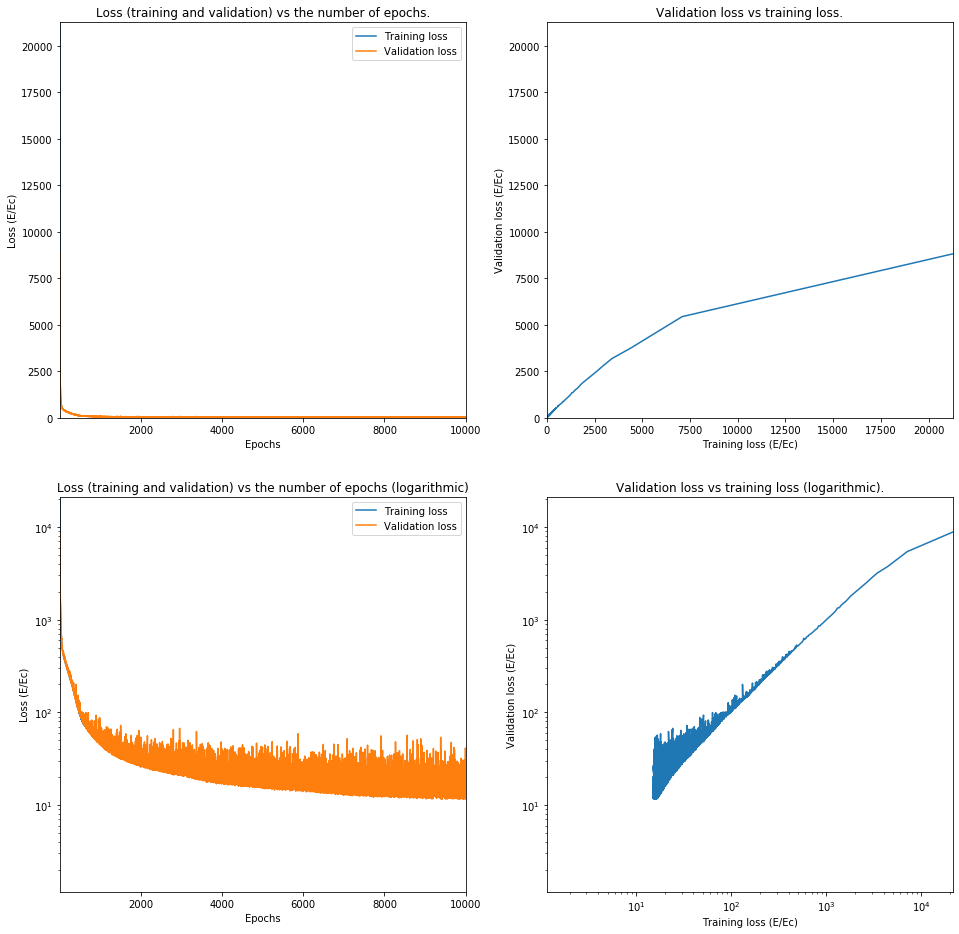

Train on 62644 samples, validate on 15662 samples
Epoch 1/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23265.8139 - val_loss: 14442.6136
Epoch 2/10000
62644/62644 [==============================] - 2s 29us/step - loss: 9056.2824 - val_loss: 6289.0227
Epoch 3/10000
62644/62644 [==============================] - 2s 29us/step - loss: 5325.8043 - val_loss: 4740.5091
Epoch 4/10000
62644/62644 [==============================] - 2s 29us/step - loss: 4272.2416 - val_loss: 3979.4252
Epoch 5/10000
62644/62644 [==============================] - 2s 29us/step - loss: 3606.9097 - val_loss: 3378.2221
Epoch 6/10000
62644/62644 [==============================] - 2s 29us/step - loss: 3058.7468 - val_loss: 2864.3716
Epoch 7/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2618.3484 - val_loss: 2468.4094
Epoch 8/10000
62644/62644 [==============================] - 2s 29us/step - loss: 2291.8606 - val_loss: 2202.2778
Epoch 9/10000
62644/62644 [=========

62644/62644 [==============================] - 2s 29us/step - loss: 433.7907 - val_loss: 447.7998
Epoch 73/10000
62644/62644 [==============================] - 2s 29us/step - loss: 428.6107 - val_loss: 441.2427
Epoch 74/10000
62644/62644 [==============================] - 2s 29us/step - loss: 423.9220 - val_loss: 450.6777
Epoch 75/10000
62644/62644 [==============================] - 2s 29us/step - loss: 419.4034 - val_loss: 435.0407
Epoch 76/10000
62644/62644 [==============================] - 2s 29us/step - loss: 414.1546 - val_loss: 433.8979
Epoch 77/10000
62644/62644 [==============================] - 2s 29us/step - loss: 410.5239 - val_loss: 421.7992
Epoch 78/10000
62644/62644 [==============================] - 2s 29us/step - loss: 406.3659 - val_loss: 418.1648
Epoch 79/10000
62644/62644 [==============================] - 2s 29us/step - loss: 400.0997 - val_loss: 413.8735
Epoch 80/10000
62644/62644 [==============================] - 2s 29us/step - loss: 396.7132 - val_loss: 407.824

62644/62644 [==============================] - 2s 29us/step - loss: 211.2545 - val_loss: 226.0139
Epoch 145/10000
62644/62644 [==============================] - 2s 29us/step - loss: 210.1556 - val_loss: 220.8804
Epoch 146/10000
62644/62644 [==============================] - 2s 29us/step - loss: 208.1188 - val_loss: 220.3649
Epoch 147/10000
62644/62644 [==============================] - 2s 29us/step - loss: 206.7722 - val_loss: 219.3385
Epoch 148/10000
62644/62644 [==============================] - 2s 29us/step - loss: 205.8535 - val_loss: 216.4874
Epoch 149/10000
62644/62644 [==============================] - 2s 29us/step - loss: 204.3965 - val_loss: 216.1207
Epoch 150/10000
62644/62644 [==============================] - 2s 29us/step - loss: 203.4970 - val_loss: 227.3509
Epoch 151/10000
62644/62644 [==============================] - 2s 29us/step - loss: 202.3849 - val_loss: 214.4004
Epoch 152/10000
62644/62644 [==============================] - 2s 29us/step - loss: 200.5006 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 132.5835 - val_loss: 150.7705
Epoch 217/10000
62644/62644 [==============================] - 2s 29us/step - loss: 130.8530 - val_loss: 153.0708
Epoch 218/10000
62644/62644 [==============================] - 2s 29us/step - loss: 130.8081 - val_loss: 138.1246
Epoch 219/10000
62644/62644 [==============================] - 2s 29us/step - loss: 129.7483 - val_loss: 144.7489
Epoch 220/10000
62644/62644 [==============================] - 2s 29us/step - loss: 129.0155 - val_loss: 142.4449
Epoch 221/10000
62644/62644 [==============================] - 2s 29us/step - loss: 128.5308 - val_loss: 141.1552
Epoch 222/10000
62644/62644 [==============================] - 2s 29us/step - loss: 127.2542 - val_loss: 136.0986
Epoch 223/10000
62644/62644 [==============================] - 2s 29us/step - loss: 126.7824 - val_loss: 133.9601
Epoch 224/10000
62644/62644 [==============================] - 2s 29us/step - loss: 125.8002 - val_loss:

62644/62644 [==============================] - 2s 29us/step - loss: 98.9590 - val_loss: 105.6314
Epoch 289/10000
62644/62644 [==============================] - 2s 29us/step - loss: 98.8698 - val_loss: 105.2282
Epoch 290/10000
62644/62644 [==============================] - 2s 29us/step - loss: 98.9946 - val_loss: 107.7618
Epoch 291/10000
62644/62644 [==============================] - 2s 29us/step - loss: 98.4605 - val_loss: 105.5830
Epoch 292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 98.4389 - val_loss: 105.6835
Epoch 293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 97.5714 - val_loss: 105.4125
Epoch 294/10000
62644/62644 [==============================] - 2s 29us/step - loss: 97.5609 - val_loss: 102.5702
Epoch 295/10000
62644/62644 [==============================] - 2s 29us/step - loss: 97.3156 - val_loss: 101.4572
Epoch 296/10000
62644/62644 [==============================] - 2s 29us/step - loss: 98.1239 - val_loss: 102.9510

62644/62644 [==============================] - 2s 29us/step - loss: 83.8702 - val_loss: 87.4046
Epoch 362/10000
62644/62644 [==============================] - 2s 29us/step - loss: 83.3638 - val_loss: 86.2839
Epoch 363/10000
62644/62644 [==============================] - 2s 30us/step - loss: 83.2809 - val_loss: 92.1282
Epoch 364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 83.8503 - val_loss: 85.2948
Epoch 365/10000
62644/62644 [==============================] - 2s 29us/step - loss: 83.0701 - val_loss: 90.4178
Epoch 366/10000
62644/62644 [==============================] - 2s 29us/step - loss: 82.7974 - val_loss: 91.6640
Epoch 367/10000
62644/62644 [==============================] - 2s 29us/step - loss: 82.8386 - val_loss: 85.2924
Epoch 368/10000
62644/62644 [==============================] - 2s 29us/step - loss: 82.9035 - val_loss: 86.4771
Epoch 369/10000
62644/62644 [==============================] - 2s 30us/step - loss: 83.2697 - val_loss: 87.2225
Epoch 37

62644/62644 [==============================] - 2s 29us/step - loss: 72.2413 - val_loss: 72.7448
Epoch 435/10000
62644/62644 [==============================] - 2s 29us/step - loss: 71.5364 - val_loss: 74.3385
Epoch 436/10000
62644/62644 [==============================] - 2s 29us/step - loss: 71.7034 - val_loss: 72.5355
Epoch 437/10000
62644/62644 [==============================] - 2s 29us/step - loss: 71.0903 - val_loss: 72.8500
Epoch 438/10000
62644/62644 [==============================] - 2s 29us/step - loss: 72.2535 - val_loss: 72.3721
Epoch 439/10000
62644/62644 [==============================] - 2s 29us/step - loss: 71.2057 - val_loss: 98.1364
Epoch 440/10000
62644/62644 [==============================] - 2s 29us/step - loss: 71.5420 - val_loss: 77.3332
Epoch 441/10000
62644/62644 [==============================] - 2s 29us/step - loss: 70.8160 - val_loss: 75.3583
Epoch 442/10000
62644/62644 [==============================] - 2s 29us/step - loss: 70.4295 - val_loss: 72.4048
Epoch 44

62644/62644 [==============================] - 2s 29us/step - loss: 61.4732 - val_loss: 63.6516
Epoch 508/10000
62644/62644 [==============================] - 2s 29us/step - loss: 62.4660 - val_loss: 70.2359
Epoch 509/10000
62644/62644 [==============================] - 2s 29us/step - loss: 62.3481 - val_loss: 63.6906
Epoch 510/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.5748 - val_loss: 62.7708
Epoch 511/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.2600 - val_loss: 63.5966
Epoch 512/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.6307 - val_loss: 62.5244
Epoch 513/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.2341 - val_loss: 62.1045
Epoch 514/10000
62644/62644 [==============================] - 2s 29us/step - loss: 61.3149 - val_loss: 69.8996
Epoch 515/10000
62644/62644 [==============================] - 2s 29us/step - loss: 60.7766 - val_loss: 61.9589
Epoch 51

62644/62644 [==============================] - 2s 29us/step - loss: 54.7841 - val_loss: 56.9574
Epoch 581/10000
62644/62644 [==============================] - 2s 29us/step - loss: 54.8096 - val_loss: 55.2109
Epoch 582/10000
62644/62644 [==============================] - 2s 29us/step - loss: 53.7162 - val_loss: 73.5664
Epoch 583/10000
62644/62644 [==============================] - 2s 29us/step - loss: 54.8805 - val_loss: 56.2869
Epoch 584/10000
62644/62644 [==============================] - 2s 29us/step - loss: 54.0846 - val_loss: 59.2813
Epoch 585/10000
62644/62644 [==============================] - 2s 29us/step - loss: 54.1456 - val_loss: 58.3380
Epoch 586/10000
62644/62644 [==============================] - 2s 29us/step - loss: 53.9152 - val_loss: 54.6582
Epoch 587/10000
62644/62644 [==============================] - 2s 29us/step - loss: 52.9391 - val_loss: 54.7928
Epoch 588/10000
62644/62644 [==============================] - 2s 29us/step - loss: 53.9731 - val_loss: 57.7924
Epoch 58

62644/62644 [==============================] - 2s 29us/step - loss: 48.9011 - val_loss: 52.0603
Epoch 654/10000
62644/62644 [==============================] - 2s 29us/step - loss: 49.0875 - val_loss: 59.0968
Epoch 655/10000
62644/62644 [==============================] - 2s 29us/step - loss: 49.0110 - val_loss: 54.1568
Epoch 656/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.0657 - val_loss: 49.2653
Epoch 657/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.7740 - val_loss: 68.7191
Epoch 658/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.9727 - val_loss: 55.7500
Epoch 659/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.6957 - val_loss: 48.8799
Epoch 660/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.8615 - val_loss: 49.5571
Epoch 661/10000
62644/62644 [==============================] - 2s 29us/step - loss: 48.7454 - val_loss: 52.4323
Epoch 66

62644/62644 [==============================] - 2s 29us/step - loss: 44.3287 - val_loss: 45.0220
Epoch 727/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.1030 - val_loss: 44.6682
Epoch 728/10000
62644/62644 [==============================] - 2s 29us/step - loss: 44.8542 - val_loss: 45.6847
Epoch 729/10000
62644/62644 [==============================] - 2s 29us/step - loss: 44.6796 - val_loss: 44.7594
Epoch 730/10000
62644/62644 [==============================] - 2s 29us/step - loss: 45.3147 - val_loss: 44.1737
Epoch 731/10000
62644/62644 [==============================] - 2s 29us/step - loss: 44.5184 - val_loss: 44.3677
Epoch 732/10000
62644/62644 [==============================] - 2s 29us/step - loss: 44.5407 - val_loss: 43.6638
Epoch 733/10000
62644/62644 [==============================] - 2s 29us/step - loss: 44.7218 - val_loss: 43.6182
Epoch 734/10000
62644/62644 [==============================] - 2s 29us/step - loss: 44.6725 - val_loss: 43.6587
Epoch 73

62644/62644 [==============================] - 2s 29us/step - loss: 41.4512 - val_loss: 42.8939
Epoch 800/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.5321 - val_loss: 40.4688
Epoch 801/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.5271 - val_loss: 49.0404
Epoch 802/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.9849 - val_loss: 40.2985
Epoch 803/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.8377 - val_loss: 40.5972
Epoch 804/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.7730 - val_loss: 40.5913
Epoch 805/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.6143 - val_loss: 40.9791
Epoch 806/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.3484 - val_loss: 41.6018
Epoch 807/10000
62644/62644 [==============================] - 2s 29us/step - loss: 41.9461 - val_loss: 40.9395
Epoch 80

62644/62644 [==============================] - 2s 29us/step - loss: 39.1617 - val_loss: 40.2204
Epoch 873/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.2831 - val_loss: 50.1024
Epoch 874/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.1092 - val_loss: 39.1791
Epoch 875/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.6468 - val_loss: 38.6544
Epoch 876/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.3040 - val_loss: 39.0535
Epoch 877/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.1257 - val_loss: 36.8285
Epoch 878/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.1218 - val_loss: 39.2382
Epoch 879/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.8867 - val_loss: 36.9576
Epoch 880/10000
62644/62644 [==============================] - 2s 29us/step - loss: 39.1398 - val_loss: 39.3352
Epoch 88

62644/62644 [==============================] - 2s 29us/step - loss: 37.4363 - val_loss: 36.3763
Epoch 946/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.0411 - val_loss: 48.8548
Epoch 947/10000
62644/62644 [==============================] - 2s 29us/step - loss: 38.0915 - val_loss: 34.6696
Epoch 948/10000
62644/62644 [==============================] - 2s 29us/step - loss: 37.2443 - val_loss: 36.2249
Epoch 949/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.7999 - val_loss: 35.9665
Epoch 950/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.6443 - val_loss: 38.0309
Epoch 951/10000
62644/62644 [==============================] - 2s 29us/step - loss: 36.6821 - val_loss: 40.5334
Epoch 952/10000
62644/62644 [==============================] - 2s 30us/step - loss: 36.8381 - val_loss: 34.3864
Epoch 953/10000
62644/62644 [==============================] - 2s 30us/step - loss: 36.7770 - val_loss: 34.2900
Epoch 95

62644/62644 [==============================] - 2s 29us/step - loss: 34.8173 - val_loss: 33.1753
Epoch 1019/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.4388 - val_loss: 33.0551
Epoch 1020/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.2232 - val_loss: 32.8744
Epoch 1021/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.3020 - val_loss: 33.2328
Epoch 1022/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.0159 - val_loss: 38.0653
Epoch 1023/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.9914 - val_loss: 36.1643
Epoch 1024/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.3555 - val_loss: 35.2798
Epoch 1025/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.4614 - val_loss: 33.1077
Epoch 1026/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35.1234 - val_loss: 32.7697


62644/62644 [==============================] - 2s 29us/step - loss: 34.0010 - val_loss: 32.2610
Epoch 1091/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.4617 - val_loss: 34.1819
Epoch 1092/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.9947 - val_loss: 32.6312
Epoch 1093/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.9315 - val_loss: 37.6920
Epoch 1094/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.7992 - val_loss: 33.7389
Epoch 1095/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.8310 - val_loss: 32.4730
Epoch 1096/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.3096 - val_loss: 31.8524
Epoch 1097/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.9246 - val_loss: 34.9087
Epoch 1098/10000
62644/62644 [==============================] - 2s 29us/step - loss: 33.8021 - val_loss: 31.8700


62644/62644 [==============================] - 2s 29us/step - loss: 32.1331 - val_loss: 30.2999
Epoch 1163/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.6361 - val_loss: 31.0163
Epoch 1164/10000
62644/62644 [==============================] - 2s 30us/step - loss: 32.1901 - val_loss: 29.2473
Epoch 1165/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.7410 - val_loss: 30.3189
Epoch 1166/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.0692 - val_loss: 36.5757
Epoch 1167/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.8364 - val_loss: 33.5554
Epoch 1168/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.1556 - val_loss: 30.9730
Epoch 1169/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.4830 - val_loss: 37.5116
Epoch 1170/10000
62644/62644 [==============================] - 2s 29us/step - loss: 32.2434 - val_loss: 34.7912


62644/62644 [==============================] - 2s 29us/step - loss: 31.0434 - val_loss: 29.9606
Epoch 1235/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.9009 - val_loss: 28.0466
Epoch 1236/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.9251 - val_loss: 32.4443
Epoch 1237/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.3980 - val_loss: 33.9967
Epoch 1238/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.9238 - val_loss: 35.9431
Epoch 1239/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.2820 - val_loss: 35.0499
Epoch 1240/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.2064 - val_loss: 30.2524
Epoch 1241/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.3992 - val_loss: 32.5300
Epoch 1242/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.8311 - val_loss: 33.5158


62644/62644 [==============================] - 2s 29us/step - loss: 29.9407 - val_loss: 30.2594
Epoch 1307/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.9938 - val_loss: 27.3428
Epoch 1308/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.6575 - val_loss: 28.8648
Epoch 1309/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.4815 - val_loss: 32.5718
Epoch 1310/10000
62644/62644 [==============================] - 2s 29us/step - loss: 31.0195 - val_loss: 34.5353
Epoch 1311/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.1759 - val_loss: 30.0434
Epoch 1312/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.1538 - val_loss: 26.6270
Epoch 1313/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.9763 - val_loss: 38.4340
Epoch 1314/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.4985 - val_loss: 28.1089


62644/62644 [==============================] - 2s 29us/step - loss: 28.9393 - val_loss: 32.3070
Epoch 1379/10000
62644/62644 [==============================] - 2s 29us/step - loss: 30.1042 - val_loss: 27.0814
Epoch 1380/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.7124 - val_loss: 25.7033
Epoch 1381/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.1900 - val_loss: 26.3294
Epoch 1382/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.9963 - val_loss: 26.5217
Epoch 1383/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.3190 - val_loss: 26.4668
Epoch 1384/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.6853 - val_loss: 25.6963
Epoch 1385/10000
62644/62644 [==============================] - 2s 30us/step - loss: 28.9290 - val_loss: 28.4125
Epoch 1386/10000
62644/62644 [==============================] - 2s 30us/step - loss: 28.5779 - val_loss: 25.9927


62644/62644 [==============================] - 2s 29us/step - loss: 28.6822 - val_loss: 30.9359
Epoch 1451/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.1892 - val_loss: 35.6138
Epoch 1452/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.3995 - val_loss: 27.6872
Epoch 1453/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.5351 - val_loss: 25.9280
Epoch 1454/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.4799 - val_loss: 25.0844
Epoch 1455/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.4351 - val_loss: 33.5990
Epoch 1456/10000
62644/62644 [==============================] - 2s 30us/step - loss: 28.5399 - val_loss: 27.5172
Epoch 1457/10000
62644/62644 [==============================] - 2s 30us/step - loss: 28.7720 - val_loss: 29.3629
Epoch 1458/10000
62644/62644 [==============================] - 2s 30us/step - loss: 29.6812 - val_loss: 28.5310


62644/62644 [==============================] - 2s 29us/step - loss: 28.3396 - val_loss: 25.1919
Epoch 1523/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.9100 - val_loss: 26.4520
Epoch 1524/10000
62644/62644 [==============================] - 2s 29us/step - loss: 29.2626 - val_loss: 25.5558
Epoch 1525/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.9933 - val_loss: 25.7335
Epoch 1526/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.8688 - val_loss: 31.8286
Epoch 1527/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.0142 - val_loss: 27.8933
Epoch 1528/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.8331 - val_loss: 24.0935
Epoch 1529/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.1201 - val_loss: 24.6338
Epoch 1530/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.7316 - val_loss: 24.5529


62644/62644 [==============================] - 2s 29us/step - loss: 27.9607 - val_loss: 25.3294
Epoch 1595/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.4798 - val_loss: 31.2492
Epoch 1596/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.3282 - val_loss: 35.2893
Epoch 1597/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.7613 - val_loss: 25.1879
Epoch 1598/10000
62644/62644 [==============================] - 2s 29us/step - loss: 28.1545 - val_loss: 35.0260
Epoch 1599/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.5169 - val_loss: 27.8418
Epoch 1600/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.1260 - val_loss: 24.7455
Epoch 1601/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.5333 - val_loss: 25.8697
Epoch 1602/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.6612 - val_loss: 35.2776


62644/62644 [==============================] - 2s 29us/step - loss: 27.3701 - val_loss: 27.4513
Epoch 1667/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.5703 - val_loss: 35.7600
Epoch 1668/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.9501 - val_loss: 23.5259
Epoch 1669/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.2740 - val_loss: 33.2173
Epoch 1670/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.7137 - val_loss: 32.9271
Epoch 1671/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.8162 - val_loss: 24.3353
Epoch 1672/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.4296 - val_loss: 23.5433
Epoch 1673/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.9131 - val_loss: 32.6518
Epoch 1674/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.9490 - val_loss: 23.6268


62644/62644 [==============================] - 2s 29us/step - loss: 26.6164 - val_loss: 25.3731
Epoch 1739/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.9319 - val_loss: 23.2288
Epoch 1740/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.8086 - val_loss: 34.4154
Epoch 1741/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.7454 - val_loss: 27.3740
Epoch 1742/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.4803 - val_loss: 25.2208
Epoch 1743/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.5650 - val_loss: 24.0152
Epoch 1744/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.5941 - val_loss: 25.3747
Epoch 1745/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.1778 - val_loss: 42.4973
Epoch 1746/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.2774 - val_loss: 25.3704


62644/62644 [==============================] - 2s 29us/step - loss: 26.9248 - val_loss: 27.4870
Epoch 1811/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.3573 - val_loss: 22.8982
Epoch 1812/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.2124 - val_loss: 23.1612
Epoch 1813/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.1734 - val_loss: 25.2474
Epoch 1814/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.7282 - val_loss: 23.0351
Epoch 1815/10000
62644/62644 [==============================] - 2s 29us/step - loss: 27.2728 - val_loss: 29.8894
Epoch 1816/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.8637 - val_loss: 24.6041
Epoch 1817/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.6079 - val_loss: 23.9492
Epoch 1818/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.7164 - val_loss: 31.6948


62644/62644 [==============================] - 2s 29us/step - loss: 26.2062 - val_loss: 22.8172
Epoch 1883/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.9619 - val_loss: 41.6533
Epoch 1884/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.7102 - val_loss: 24.0084
Epoch 1885/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.1513 - val_loss: 26.7168
Epoch 1886/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.4203 - val_loss: 36.1682
Epoch 1887/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.6880 - val_loss: 33.3780
Epoch 1888/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.2734 - val_loss: 33.2494
Epoch 1889/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.0819 - val_loss: 44.6889
Epoch 1890/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.2900 - val_loss: 23.1574


62644/62644 [==============================] - 2s 30us/step - loss: 26.1225 - val_loss: 23.3521
Epoch 1955/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.9539 - val_loss: 22.3359
Epoch 1956/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.5545 - val_loss: 37.5695
Epoch 1957/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.1637 - val_loss: 40.4711
Epoch 1958/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.9968 - val_loss: 21.9722
Epoch 1959/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4739 - val_loss: 24.6689
Epoch 1960/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.0553 - val_loss: 25.5005
Epoch 1961/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.0852 - val_loss: 27.2623
Epoch 1962/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.1940 - val_loss: 22.9669


62644/62644 [==============================] - 2s 30us/step - loss: 25.1327 - val_loss: 27.1955
Epoch 2027/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.5754 - val_loss: 24.2407
Epoch 2028/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.8782 - val_loss: 26.2755
Epoch 2029/10000
62644/62644 [==============================] - 2s 29us/step - loss: 26.2886 - val_loss: 24.9826
Epoch 2030/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.7996 - val_loss: 27.0624
Epoch 2031/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.9643 - val_loss: 29.4742
Epoch 2032/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4616 - val_loss: 35.2847
Epoch 2033/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.7861 - val_loss: 22.3057
Epoch 2034/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.9402 - val_loss: 22.3150


62644/62644 [==============================] - 2s 30us/step - loss: 25.4698 - val_loss: 20.9992
Epoch 2099/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.3800 - val_loss: 23.8533
Epoch 2100/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1740 - val_loss: 26.3303
Epoch 2101/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.0441 - val_loss: 25.4005
Epoch 2102/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.8266 - val_loss: 25.0748
Epoch 2103/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.1532 - val_loss: 26.9276
Epoch 2104/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.4133 - val_loss: 21.1883
Epoch 2105/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.4736 - val_loss: 21.7282
Epoch 2106/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.8344 - val_loss: 22.9351


62644/62644 [==============================] - 2s 29us/step - loss: 25.2845 - val_loss: 25.9756
Epoch 2171/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.2427 - val_loss: 22.8867
Epoch 2172/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.3565 - val_loss: 24.3639
Epoch 2173/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4462 - val_loss: 21.8035
Epoch 2174/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.4545 - val_loss: 25.8274
Epoch 2175/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.6694 - val_loss: 25.4376
Epoch 2176/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.3051 - val_loss: 25.4695
Epoch 2177/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0885 - val_loss: 23.9683
Epoch 2178/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.3874 - val_loss: 22.0538


62644/62644 [==============================] - 2s 29us/step - loss: 24.6358 - val_loss: 24.7552
Epoch 2243/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.0107 - val_loss: 24.8998
Epoch 2244/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.6310 - val_loss: 22.0380
Epoch 2245/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.0895 - val_loss: 25.4146
Epoch 2246/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1426 - val_loss: 41.6774
Epoch 2247/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.6556 - val_loss: 31.1061
Epoch 2248/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9633 - val_loss: 27.6006
Epoch 2249/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.1919 - val_loss: 41.8271
Epoch 2250/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1818 - val_loss: 22.4907


62644/62644 [==============================] - 2s 29us/step - loss: 24.6879 - val_loss: 21.7559
Epoch 2315/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.5823 - val_loss: 25.3195
Epoch 2316/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.5505 - val_loss: 27.4601
Epoch 2317/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.6215 - val_loss: 20.3265
Epoch 2318/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.2899 - val_loss: 20.4966
Epoch 2319/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.0726 - val_loss: 25.7836
Epoch 2320/10000
62644/62644 [==============================] - 2s 29us/step - loss: 25.2564 - val_loss: 20.6970
Epoch 2321/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.3012 - val_loss: 26.5458
Epoch 2322/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.7543 - val_loss: 26.7193


62644/62644 [==============================] - 2s 29us/step - loss: 24.0444 - val_loss: 20.8374
Epoch 2387/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1959 - val_loss: 28.3494
Epoch 2388/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.9578 - val_loss: 21.7706
Epoch 2389/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6493 - val_loss: 24.2620
Epoch 2390/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.6267 - val_loss: 23.2434
Epoch 2391/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.5373 - val_loss: 28.8432
Epoch 2392/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.6177 - val_loss: 20.1550
Epoch 2393/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6397 - val_loss: 22.2767
Epoch 2394/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.8547 - val_loss: 20.2791


62644/62644 [==============================] - 2s 29us/step - loss: 23.6378 - val_loss: 22.5236
Epoch 2459/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6655 - val_loss: 26.1394
Epoch 2460/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.5760 - val_loss: 20.2621
Epoch 2461/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6444 - val_loss: 20.1140
Epoch 2462/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.2724 - val_loss: 27.8587
Epoch 2463/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.0129 - val_loss: 20.9134
Epoch 2464/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.4447 - val_loss: 20.0671
Epoch 2465/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.3318 - val_loss: 21.5633
Epoch 2466/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.8585 - val_loss: 23.8102


62644/62644 [==============================] - 2s 29us/step - loss: 23.7244 - val_loss: 19.6698
Epoch 2531/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4232 - val_loss: 20.4674
Epoch 2532/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1586 - val_loss: 23.8474
Epoch 2533/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1455 - val_loss: 23.8948
Epoch 2534/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7516 - val_loss: 24.1559
Epoch 2535/10000
62644/62644 [==============================] - 2s 29us/step - loss: 24.1392 - val_loss: 20.4978
Epoch 2536/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.8842 - val_loss: 36.6180
Epoch 2537/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6762 - val_loss: 20.8890
Epoch 2538/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4411 - val_loss: 21.1832


62644/62644 [==============================] - 2s 29us/step - loss: 23.7191 - val_loss: 29.1950
Epoch 2603/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.8884 - val_loss: 20.2093
Epoch 2604/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9521 - val_loss: 20.0875
Epoch 2605/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4182 - val_loss: 24.1994
Epoch 2606/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.6779 - val_loss: 21.3933
Epoch 2607/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4922 - val_loss: 23.2119
Epoch 2608/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7904 - val_loss: 23.1849
Epoch 2609/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.8226 - val_loss: 22.3407
Epoch 2610/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2275 - val_loss: 21.4142


62644/62644 [==============================] - 2s 29us/step - loss: 23.3600 - val_loss: 20.8571
Epoch 2675/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5934 - val_loss: 24.9905
Epoch 2676/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9512 - val_loss: 19.3931
Epoch 2677/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0551 - val_loss: 25.7386
Epoch 2678/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7585 - val_loss: 30.3879
Epoch 2679/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.5281 - val_loss: 19.4221
Epoch 2680/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7711 - val_loss: 23.3369
Epoch 2681/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.5180 - val_loss: 45.5644
Epoch 2682/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1297 - val_loss: 25.3404


62644/62644 [==============================] - 2s 29us/step - loss: 22.8942 - val_loss: 19.5718
Epoch 2747/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9666 - val_loss: 19.7669
Epoch 2748/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6597 - val_loss: 25.1043
Epoch 2749/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.7948 - val_loss: 20.1883
Epoch 2750/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1954 - val_loss: 24.6496
Epoch 2751/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0642 - val_loss: 22.6664
Epoch 2752/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9800 - val_loss: 32.4557
Epoch 2753/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.8975 - val_loss: 24.1559
Epoch 2754/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4768 - val_loss: 24.7764


62644/62644 [==============================] - 2s 29us/step - loss: 23.2683 - val_loss: 28.7439
Epoch 2819/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.4432 - val_loss: 22.0467
Epoch 2820/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6116 - val_loss: 19.4982
Epoch 2821/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5753 - val_loss: 21.0967
Epoch 2822/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0994 - val_loss: 19.4737
Epoch 2823/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.4021 - val_loss: 19.9080
Epoch 2824/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6598 - val_loss: 20.8343
Epoch 2825/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.8040 - val_loss: 27.7632
Epoch 2826/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2694 - val_loss: 21.2767


62644/62644 [==============================] - 2s 30us/step - loss: 22.8891 - val_loss: 27.3450
Epoch 2891/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.1423 - val_loss: 19.3783
Epoch 2892/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.1648 - val_loss: 18.4568
Epoch 2893/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0793 - val_loss: 42.5514
Epoch 2894/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1475 - val_loss: 19.3846
Epoch 2895/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6243 - val_loss: 22.4019
Epoch 2896/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.4593 - val_loss: 18.7303
Epoch 2897/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.7201 - val_loss: 33.9697
Epoch 2898/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.8260 - val_loss: 28.1738


62644/62644 [==============================] - 2s 29us/step - loss: 22.7289 - val_loss: 18.8422
Epoch 2963/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.4494 - val_loss: 27.5189
Epoch 2964/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.7513 - val_loss: 19.8219
Epoch 2965/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.2519 - val_loss: 20.9836
Epoch 2966/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5456 - val_loss: 23.8872
Epoch 2967/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.4608 - val_loss: 20.1512
Epoch 2968/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6886 - val_loss: 29.9383
Epoch 2969/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9067 - val_loss: 33.1861
Epoch 2970/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.6386 - val_loss: 27.3197


62644/62644 [==============================] - 2s 29us/step - loss: 22.0524 - val_loss: 34.5258
Epoch 3035/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.7029 - val_loss: 19.5534
Epoch 3036/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0349 - val_loss: 18.4338
Epoch 3037/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5193 - val_loss: 27.8687
Epoch 3038/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7756 - val_loss: 20.2436
Epoch 3039/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7040 - val_loss: 24.7870
Epoch 3040/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.7104 - val_loss: 29.0785
Epoch 3041/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.5332 - val_loss: 29.8231
Epoch 3042/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0003 - val_loss: 20.6332


62644/62644 [==============================] - 2s 29us/step - loss: 22.1210 - val_loss: 22.9858
Epoch 3107/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2641 - val_loss: 28.9842
Epoch 3108/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6997 - val_loss: 24.2148
Epoch 3109/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4179 - val_loss: 20.5268
Epoch 3110/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.3144 - val_loss: 18.2674
Epoch 3111/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9581 - val_loss: 18.0244
Epoch 3112/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9502 - val_loss: 18.8462
Epoch 3113/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.3428 - val_loss: 28.1544
Epoch 3114/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.0494 - val_loss: 24.9321


62644/62644 [==============================] - 2s 29us/step - loss: 21.5654 - val_loss: 25.7768
Epoch 3179/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.8895 - val_loss: 18.0469
Epoch 3180/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6406 - val_loss: 19.6200
Epoch 3181/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.1293 - val_loss: 18.5722
Epoch 3182/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.0247 - val_loss: 19.6253
Epoch 3183/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9919 - val_loss: 21.6682
Epoch 3184/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7380 - val_loss: 40.7453
Epoch 3185/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6555 - val_loss: 17.9488
Epoch 3186/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.2362 - val_loss: 40.2732


62644/62644 [==============================] - 2s 29us/step - loss: 21.4538 - val_loss: 18.6169
Epoch 3251/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.3027 - val_loss: 20.8267
Epoch 3252/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5124 - val_loss: 21.8434
Epoch 3253/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6415 - val_loss: 18.8830
Epoch 3254/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6562 - val_loss: 26.4908
Epoch 3255/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4823 - val_loss: 18.2497
Epoch 3256/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.8451 - val_loss: 19.1294
Epoch 3257/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.7377 - val_loss: 21.3547
Epoch 3258/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.6742 - val_loss: 17.7047


62644/62644 [==============================] - 2s 29us/step - loss: 21.6997 - val_loss: 19.8882
Epoch 3323/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7522 - val_loss: 17.5734
Epoch 3324/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2505 - val_loss: 20.4520
Epoch 3325/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2834 - val_loss: 19.1334
Epoch 3326/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.9943 - val_loss: 18.1691
Epoch 3327/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2042 - val_loss: 18.0810
Epoch 3328/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.5652 - val_loss: 19.8447
Epoch 3329/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.3871 - val_loss: 19.1761
Epoch 3330/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.8079 - val_loss: 17.6591


62644/62644 [==============================] - 2s 29us/step - loss: 20.9909 - val_loss: 18.1737
Epoch 3395/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9853 - val_loss: 17.8023
Epoch 3396/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7521 - val_loss: 17.5855
Epoch 3397/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9128 - val_loss: 19.7365
Epoch 3398/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6588 - val_loss: 17.0728
Epoch 3399/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1005 - val_loss: 32.2376
Epoch 3400/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7507 - val_loss: 26.8184
Epoch 3401/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0628 - val_loss: 20.8379
Epoch 3402/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7414 - val_loss: 19.0913


62644/62644 [==============================] - 2s 29us/step - loss: 20.9621 - val_loss: 20.4914
Epoch 3467/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8907 - val_loss: 18.4206
Epoch 3468/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8605 - val_loss: 19.2595
Epoch 3469/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.9220 - val_loss: 19.1985
Epoch 3470/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8739 - val_loss: 17.2128
Epoch 3471/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.2305 - val_loss: 25.3232
Epoch 3472/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7835 - val_loss: 19.9868
Epoch 3473/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.0894 - val_loss: 23.8872
Epoch 3474/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6481 - val_loss: 20.1819


62644/62644 [==============================] - 2s 29us/step - loss: 20.5285 - val_loss: 17.9309
Epoch 3539/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.1137 - val_loss: 24.8074
Epoch 3540/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4548 - val_loss: 23.0098
Epoch 3541/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6816 - val_loss: 27.1341
Epoch 3542/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.8284 - val_loss: 29.4391
Epoch 3543/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3303 - val_loss: 18.9050
Epoch 3544/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7408 - val_loss: 17.4812
Epoch 3545/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2312 - val_loss: 21.0461
Epoch 3546/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6077 - val_loss: 20.6199


62644/62644 [==============================] - 2s 29us/step - loss: 20.4161 - val_loss: 18.1404
Epoch 3611/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2775 - val_loss: 16.4853
Epoch 3612/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6681 - val_loss: 17.1105
Epoch 3613/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4934 - val_loss: 17.2618
Epoch 3614/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5219 - val_loss: 19.7794
Epoch 3615/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.3523 - val_loss: 18.8484
Epoch 3616/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0702 - val_loss: 18.7778
Epoch 3617/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6759 - val_loss: 17.5987
Epoch 3618/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8390 - val_loss: 32.2447


62644/62644 [==============================] - 2s 29us/step - loss: 19.9697 - val_loss: 19.6015
Epoch 3683/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2322 - val_loss: 28.4911
Epoch 3684/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4717 - val_loss: 16.5137
Epoch 3685/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1489 - val_loss: 26.2379
Epoch 3686/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1807 - val_loss: 21.5918
Epoch 3687/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9681 - val_loss: 19.6906
Epoch 3688/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.7040 - val_loss: 17.2641
Epoch 3689/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9917 - val_loss: 17.0161
Epoch 3690/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2266 - val_loss: 26.6409


62644/62644 [==============================] - 2s 29us/step - loss: 20.6462 - val_loss: 20.7342
Epoch 3755/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9570 - val_loss: 24.1529
Epoch 3756/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5351 - val_loss: 17.6162
Epoch 3757/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8430 - val_loss: 27.0632
Epoch 3758/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6085 - val_loss: 20.8405
Epoch 3759/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9688 - val_loss: 18.0288
Epoch 3760/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6213 - val_loss: 26.1878
Epoch 3761/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.6623 - val_loss: 17.0562
Epoch 3762/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3998 - val_loss: 18.1122


62644/62644 [==============================] - 2s 29us/step - loss: 19.2563 - val_loss: 20.0437
Epoch 3827/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7705 - val_loss: 20.2392
Epoch 3828/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6011 - val_loss: 28.0721
Epoch 3829/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5473 - val_loss: 17.4315
Epoch 3830/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9643 - val_loss: 16.8435
Epoch 3831/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0843 - val_loss: 24.3662
Epoch 3832/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0699 - val_loss: 29.1737
Epoch 3833/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.2380 - val_loss: 20.8116
Epoch 3834/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.4535 - val_loss: 25.3432


62644/62644 [==============================] - 2s 29us/step - loss: 19.2091 - val_loss: 19.0717
Epoch 3899/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0275 - val_loss: 17.4496
Epoch 3900/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5043 - val_loss: 27.1566
Epoch 3901/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5330 - val_loss: 19.0342
Epoch 3902/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3338 - val_loss: 20.1716
Epoch 3903/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5788 - val_loss: 25.0453
Epoch 3904/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.0705 - val_loss: 16.4264
Epoch 3905/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3178 - val_loss: 15.8772
Epoch 3906/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6060 - val_loss: 17.8224


62644/62644 [==============================] - 2s 29us/step - loss: 19.4782 - val_loss: 20.3105
Epoch 3971/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.1135 - val_loss: 23.2868
Epoch 3972/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.9170 - val_loss: 28.4463
Epoch 3973/10000
62644/62644 [==============================] - 2s 29us/step - loss: 20.5131 - val_loss: 15.9355
Epoch 3974/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8065 - val_loss: 21.1870
Epoch 3975/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9786 - val_loss: 21.5170
Epoch 3976/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2698 - val_loss: 19.0603
Epoch 3977/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.8813 - val_loss: 16.0729
Epoch 3978/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4048 - val_loss: 21.0312


62644/62644 [==============================] - 2s 29us/step - loss: 19.1884 - val_loss: 17.2431
Epoch 4043/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4164 - val_loss: 35.8581
Epoch 4044/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9522 - val_loss: 16.8446
Epoch 4045/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5267 - val_loss: 22.2576
Epoch 4046/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6921 - val_loss: 18.4583
Epoch 4047/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0546 - val_loss: 22.0338
Epoch 4048/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.5851 - val_loss: 15.5431
Epoch 4049/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6463 - val_loss: 16.6421
Epoch 4050/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9045 - val_loss: 17.0919


62644/62644 [==============================] - 2s 29us/step - loss: 19.9178 - val_loss: 18.7212
Epoch 4115/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8405 - val_loss: 18.6446
Epoch 4116/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2070 - val_loss: 15.9429
Epoch 4117/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3746 - val_loss: 15.3410
Epoch 4118/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1300 - val_loss: 16.1999
Epoch 4119/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.6155 - val_loss: 24.5693
Epoch 4120/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4291 - val_loss: 15.7141
Epoch 4121/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9341 - val_loss: 21.7820
Epoch 4122/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8704 - val_loss: 16.6395


62644/62644 [==============================] - 2s 29us/step - loss: 18.7816 - val_loss: 47.5488
Epoch 4187/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1158 - val_loss: 20.7954
Epoch 4188/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.1438 - val_loss: 32.8936
Epoch 4189/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0593 - val_loss: 15.5701
Epoch 4190/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2224 - val_loss: 23.7851
Epoch 4191/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0002 - val_loss: 16.2735
Epoch 4192/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2593 - val_loss: 16.1959
Epoch 4193/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2010 - val_loss: 22.5803
Epoch 4194/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0260 - val_loss: 15.6748


62644/62644 [==============================] - 2s 29us/step - loss: 19.3532 - val_loss: 19.9414
Epoch 4259/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4238 - val_loss: 15.8250
Epoch 4260/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.4086 - val_loss: 26.3341
Epoch 4261/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.0702 - val_loss: 25.0670
Epoch 4262/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.7318 - val_loss: 18.8223
Epoch 4263/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.4233 - val_loss: 16.2348
Epoch 4264/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3710 - val_loss: 15.6178
Epoch 4265/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8573 - val_loss: 15.5392
Epoch 4266/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.2894 - val_loss: 20.9576


62644/62644 [==============================] - 2s 29us/step - loss: 18.0343 - val_loss: 15.2426
Epoch 4331/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2597 - val_loss: 22.5344
Epoch 4332/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3496 - val_loss: 21.5035
Epoch 4333/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6047 - val_loss: 23.6396
Epoch 4334/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3676 - val_loss: 24.2191
Epoch 4335/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7806 - val_loss: 17.3835
Epoch 4336/10000
62644/62644 [==============================] - 2s 29us/step - loss: 19.3585 - val_loss: 16.5573
Epoch 4337/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1066 - val_loss: 19.6743
Epoch 4338/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2320 - val_loss: 21.7018


62644/62644 [==============================] - 2s 29us/step - loss: 18.0192 - val_loss: 16.0900
Epoch 4403/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5246 - val_loss: 23.2234
Epoch 4404/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6409 - val_loss: 15.9587
Epoch 4405/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7746 - val_loss: 15.8378
Epoch 4406/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6000 - val_loss: 16.5021
Epoch 4407/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5351 - val_loss: 26.4980
Epoch 4408/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9160 - val_loss: 15.2923
Epoch 4409/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.9562 - val_loss: 15.8156
Epoch 4410/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3470 - val_loss: 14.7767


62644/62644 [==============================] - 2s 29us/step - loss: 18.4687 - val_loss: 18.0330
Epoch 4475/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5490 - val_loss: 15.1950
Epoch 4476/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6247 - val_loss: 22.7933
Epoch 4477/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2592 - val_loss: 18.7966
Epoch 4478/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7342 - val_loss: 24.2199
Epoch 4479/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7379 - val_loss: 21.1704
Epoch 4480/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.6973 - val_loss: 16.0682
Epoch 4481/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6786 - val_loss: 15.6739
Epoch 4482/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8705 - val_loss: 19.6285


62644/62644 [==============================] - 2s 29us/step - loss: 18.1829 - val_loss: 18.8726
Epoch 4547/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9252 - val_loss: 15.2695
Epoch 4548/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2919 - val_loss: 15.4875
Epoch 4549/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3630 - val_loss: 20.4596
Epoch 4550/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0196 - val_loss: 15.4684
Epoch 4551/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7729 - val_loss: 16.8245
Epoch 4552/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0962 - val_loss: 20.8289
Epoch 4553/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8031 - val_loss: 19.6023
Epoch 4554/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.5112 - val_loss: 20.2813


62644/62644 [==============================] - 2s 30us/step - loss: 17.8358 - val_loss: 15.3577
Epoch 4619/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1021 - val_loss: 14.3637
Epoch 4620/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1268 - val_loss: 19.1928
Epoch 4621/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2349 - val_loss: 23.7209
Epoch 4622/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0792 - val_loss: 19.8358
Epoch 4623/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5033 - val_loss: 16.9993
Epoch 4624/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5454 - val_loss: 14.9878
Epoch 4625/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9220 - val_loss: 14.7702
Epoch 4626/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9597 - val_loss: 15.5996


62644/62644 [==============================] - 2s 29us/step - loss: 17.3929 - val_loss: 17.1087
Epoch 4691/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3979 - val_loss: 15.2534
Epoch 4692/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.9428 - val_loss: 15.0780
Epoch 4693/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1650 - val_loss: 19.3821
Epoch 4694/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8310 - val_loss: 20.1253
Epoch 4695/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2792 - val_loss: 16.5056
Epoch 4696/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8676 - val_loss: 23.9794
Epoch 4697/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6662 - val_loss: 14.4175
Epoch 4698/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3056 - val_loss: 14.1707


62644/62644 [==============================] - 2s 29us/step - loss: 17.2037 - val_loss: 26.1765
Epoch 4763/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.3634 - val_loss: 15.6404
Epoch 4764/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0454 - val_loss: 24.6902
Epoch 4765/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8084 - val_loss: 20.2657
Epoch 4766/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5340 - val_loss: 26.1561
Epoch 4767/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5571 - val_loss: 22.9674
Epoch 4768/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3266 - val_loss: 14.8480
Epoch 4769/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3423 - val_loss: 14.2297
Epoch 4770/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6843 - val_loss: 17.2212


62644/62644 [==============================] - 2s 29us/step - loss: 17.6652 - val_loss: 15.0615
Epoch 4835/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7300 - val_loss: 15.4894
Epoch 4836/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2690 - val_loss: 13.8378
Epoch 4837/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6492 - val_loss: 16.0780
Epoch 4838/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8419 - val_loss: 19.8805
Epoch 4839/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3554 - val_loss: 14.5067
Epoch 4840/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4380 - val_loss: 14.8566
Epoch 4841/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6938 - val_loss: 16.3693
Epoch 4842/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7511 - val_loss: 23.4002


62644/62644 [==============================] - 2s 29us/step - loss: 17.6478 - val_loss: 14.0298
Epoch 4907/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6279 - val_loss: 14.4606
Epoch 4908/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8251 - val_loss: 13.5527
Epoch 4909/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7620 - val_loss: 15.2634
Epoch 4910/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8185 - val_loss: 13.7280
Epoch 4911/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3207 - val_loss: 13.9674
Epoch 4912/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6345 - val_loss: 31.0623
Epoch 4913/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5970 - val_loss: 17.6511
Epoch 4914/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3395 - val_loss: 14.1402


62644/62644 [==============================] - 2s 29us/step - loss: 17.6825 - val_loss: 16.1027
Epoch 4979/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7820 - val_loss: 16.4233
Epoch 4980/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2791 - val_loss: 15.9612
Epoch 4981/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4034 - val_loss: 13.8082
Epoch 4982/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5629 - val_loss: 25.2731
Epoch 4983/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1022 - val_loss: 15.4349
Epoch 4984/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7607 - val_loss: 14.5402
Epoch 4985/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1003 - val_loss: 13.6783
Epoch 4986/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0599 - val_loss: 15.1496


62644/62644 [==============================] - 2s 30us/step - loss: 16.3756 - val_loss: 16.3788
Epoch 5051/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1209 - val_loss: 26.5949
Epoch 5052/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5584 - val_loss: 14.5307
Epoch 5053/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6713 - val_loss: 15.8558
Epoch 5054/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6749 - val_loss: 22.7610
Epoch 5055/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2533 - val_loss: 14.6464
Epoch 5056/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6315 - val_loss: 31.3048
Epoch 5057/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6440 - val_loss: 17.4218
Epoch 5058/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6740 - val_loss: 16.8528


62644/62644 [==============================] - 2s 29us/step - loss: 17.2227 - val_loss: 15.9345
Epoch 5123/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9777 - val_loss: 17.1723
Epoch 5124/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6510 - val_loss: 13.6181
Epoch 5125/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2671 - val_loss: 13.8995
Epoch 5126/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7021 - val_loss: 14.8474
Epoch 5127/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1734 - val_loss: 28.4554
Epoch 5128/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8844 - val_loss: 25.1613
Epoch 5129/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1478 - val_loss: 17.0832
Epoch 5130/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8324 - val_loss: 13.9668


62644/62644 [==============================] - 2s 29us/step - loss: 17.4163 - val_loss: 19.2100
Epoch 5195/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4563 - val_loss: 18.8928
Epoch 5196/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7099 - val_loss: 13.8932
Epoch 5197/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2465 - val_loss: 16.9959
Epoch 5198/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7262 - val_loss: 13.9506
Epoch 5199/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2979 - val_loss: 18.0177
Epoch 5200/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5181 - val_loss: 16.0183
Epoch 5201/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9923 - val_loss: 16.0041
Epoch 5202/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5393 - val_loss: 15.4847


62644/62644 [==============================] - 2s 29us/step - loss: 16.5150 - val_loss: 15.0481
Epoch 5267/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4242 - val_loss: 26.2367
Epoch 5268/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9928 - val_loss: 25.8881
Epoch 5269/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7924 - val_loss: 18.8680
Epoch 5270/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1397 - val_loss: 18.8796
Epoch 5271/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5112 - val_loss: 15.6159
Epoch 5272/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2098 - val_loss: 15.1085
Epoch 5273/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8089 - val_loss: 13.7848
Epoch 5274/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4833 - val_loss: 26.3462


62644/62644 [==============================] - 2s 29us/step - loss: 16.5785 - val_loss: 21.7320
Epoch 5339/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8556 - val_loss: 15.9074
Epoch 5340/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5736 - val_loss: 24.8303
Epoch 5341/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4639 - val_loss: 12.8871
Epoch 5342/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2016 - val_loss: 14.8969
Epoch 5343/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7537 - val_loss: 16.2199
Epoch 5344/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0824 - val_loss: 19.1674
Epoch 5345/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2599 - val_loss: 15.0564
Epoch 5346/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7615 - val_loss: 13.4345


62644/62644 [==============================] - 2s 29us/step - loss: 16.5931 - val_loss: 13.9161
Epoch 5411/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1675 - val_loss: 12.7512
Epoch 5412/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3162 - val_loss: 13.5591
Epoch 5413/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4574 - val_loss: 14.5177
Epoch 5414/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2440 - val_loss: 19.7593
Epoch 5415/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2739 - val_loss: 13.0758
Epoch 5416/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8501 - val_loss: 15.4885
Epoch 5417/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3795 - val_loss: 14.9293
Epoch 5418/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2617 - val_loss: 34.5272


62644/62644 [==============================] - 2s 29us/step - loss: 16.8346 - val_loss: 12.9825
Epoch 5483/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5490 - val_loss: 19.7666
Epoch 5484/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7761 - val_loss: 18.8459
Epoch 5485/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1829 - val_loss: 25.5481
Epoch 5486/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3981 - val_loss: 21.3235
Epoch 5487/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1330 - val_loss: 14.4084
Epoch 5488/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6291 - val_loss: 13.9118
Epoch 5489/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9298 - val_loss: 13.1400
Epoch 5490/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9172 - val_loss: 12.6847


62644/62644 [==============================] - 2s 29us/step - loss: 16.6066 - val_loss: 13.7730
Epoch 5555/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2434 - val_loss: 16.1048
Epoch 5556/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3688 - val_loss: 14.9345
Epoch 5557/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4041 - val_loss: 13.9271
Epoch 5558/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1137 - val_loss: 29.8503
Epoch 5559/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0845 - val_loss: 18.9040
Epoch 5560/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1338 - val_loss: 20.2330
Epoch 5561/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.8465 - val_loss: 12.7555
Epoch 5562/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8198 - val_loss: 13.4763


62644/62644 [==============================] - 2s 29us/step - loss: 16.8491 - val_loss: 13.2206
Epoch 5627/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0851 - val_loss: 15.2302
Epoch 5628/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5713 - val_loss: 14.4702
Epoch 5629/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1863 - val_loss: 13.0811
Epoch 5630/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9752 - val_loss: 12.5952
Epoch 5631/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2684 - val_loss: 15.4613
Epoch 5632/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3105 - val_loss: 13.4294
Epoch 5633/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6290 - val_loss: 25.3041
Epoch 5634/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1521 - val_loss: 22.8727


62644/62644 [==============================] - 2s 29us/step - loss: 16.1518 - val_loss: 15.9722
Epoch 5699/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2711 - val_loss: 12.7461
Epoch 5700/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2768 - val_loss: 20.5071
Epoch 5701/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4167 - val_loss: 19.8970
Epoch 5702/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0847 - val_loss: 13.2781
Epoch 5703/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9912 - val_loss: 28.0391
Epoch 5704/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8344 - val_loss: 12.5344
Epoch 5705/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0385 - val_loss: 20.0583
Epoch 5706/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3113 - val_loss: 20.2459


62644/62644 [==============================] - 2s 29us/step - loss: 16.7783 - val_loss: 18.7045
Epoch 5771/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1773 - val_loss: 22.8870
Epoch 5772/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9548 - val_loss: 12.6310
Epoch 5773/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1326 - val_loss: 13.4616
Epoch 5774/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1007 - val_loss: 17.6616
Epoch 5775/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9651 - val_loss: 13.1640
Epoch 5776/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0361 - val_loss: 13.0036
Epoch 5777/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8162 - val_loss: 12.5165
Epoch 5778/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3598 - val_loss: 14.3554


62644/62644 [==============================] - 2s 29us/step - loss: 16.1913 - val_loss: 14.4968
Epoch 5843/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4654 - val_loss: 13.9758
Epoch 5844/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5461 - val_loss: 14.2347
Epoch 5845/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2503 - val_loss: 20.1558
Epoch 5846/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7824 - val_loss: 13.2996
Epoch 5847/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0193 - val_loss: 19.4134
Epoch 5848/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6249 - val_loss: 15.9719
Epoch 5849/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9260 - val_loss: 13.9060
Epoch 5850/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2026 - val_loss: 12.9639


62644/62644 [==============================] - 2s 28us/step - loss: 16.4485 - val_loss: 16.4114
Epoch 5915/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0788 - val_loss: 13.2383
Epoch 5916/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6858 - val_loss: 19.9436
Epoch 5917/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9568 - val_loss: 18.1935
Epoch 5918/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9888 - val_loss: 12.0837
Epoch 5919/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8783 - val_loss: 12.2653
Epoch 5920/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8560 - val_loss: 12.8253
Epoch 5921/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8280 - val_loss: 22.6615
Epoch 5922/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1090 - val_loss: 13.1664


62644/62644 [==============================] - 2s 29us/step - loss: 15.4783 - val_loss: 20.8191
Epoch 5987/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8800 - val_loss: 18.2429
Epoch 5988/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1542 - val_loss: 16.1559
Epoch 5989/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7142 - val_loss: 22.9819
Epoch 5990/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1731 - val_loss: 14.9960
Epoch 5991/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1717 - val_loss: 12.1619
Epoch 5992/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9014 - val_loss: 24.0003
Epoch 5993/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6086 - val_loss: 14.6864
Epoch 5994/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2414 - val_loss: 15.0321


62644/62644 [==============================] - 2s 29us/step - loss: 16.1504 - val_loss: 22.9030
Epoch 6059/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9807 - val_loss: 24.4359
Epoch 6060/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3524 - val_loss: 16.2658
Epoch 6061/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5322 - val_loss: 14.5289
Epoch 6062/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7807 - val_loss: 26.4704
Epoch 6063/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4160 - val_loss: 15.8516
Epoch 6064/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7694 - val_loss: 20.8556
Epoch 6065/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4254 - val_loss: 26.0798
Epoch 6066/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3122 - val_loss: 12.3709


62644/62644 [==============================] - 2s 29us/step - loss: 15.7480 - val_loss: 15.2196
Epoch 6131/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2858 - val_loss: 17.7934
Epoch 6132/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5317 - val_loss: 17.0215
Epoch 6133/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6463 - val_loss: 23.5250
Epoch 6134/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4350 - val_loss: 25.5978
Epoch 6135/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4615 - val_loss: 14.9635
Epoch 6136/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1370 - val_loss: 13.1977
Epoch 6137/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5239 - val_loss: 12.8463
Epoch 6138/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3893 - val_loss: 13.3998


62644/62644 [==============================] - 2s 29us/step - loss: 16.0704 - val_loss: 13.5134
Epoch 6203/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4633 - val_loss: 12.4163
Epoch 6204/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2381 - val_loss: 12.4652
Epoch 6205/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1892 - val_loss: 13.9066
Epoch 6206/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7780 - val_loss: 12.4091
Epoch 6207/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9605 - val_loss: 18.2876
Epoch 6208/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9358 - val_loss: 14.1035
Epoch 6209/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4187 - val_loss: 12.7013
Epoch 6210/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5626 - val_loss: 13.5569


62644/62644 [==============================] - 2s 28us/step - loss: 15.4471 - val_loss: 15.1945
Epoch 6275/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2930 - val_loss: 11.9707
Epoch 6276/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8807 - val_loss: 18.8010
Epoch 6277/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5278 - val_loss: 13.4746
Epoch 6278/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1194 - val_loss: 12.5825
Epoch 6279/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2262 - val_loss: 12.8184
Epoch 6280/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0265 - val_loss: 12.9899
Epoch 6281/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1156 - val_loss: 12.2164
Epoch 6282/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8697 - val_loss: 15.6086


62644/62644 [==============================] - 2s 29us/step - loss: 15.6531 - val_loss: 12.9216
Epoch 6347/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1422 - val_loss: 16.6381
Epoch 6348/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3569 - val_loss: 12.4596
Epoch 6349/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6476 - val_loss: 13.4440
Epoch 6350/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2942 - val_loss: 12.4601
Epoch 6351/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1144 - val_loss: 14.6470
Epoch 6352/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7892 - val_loss: 18.6105
Epoch 6353/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4070 - val_loss: 31.5514
Epoch 6354/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7771 - val_loss: 20.8731


62644/62644 [==============================] - 2s 29us/step - loss: 15.5216 - val_loss: 15.5714
Epoch 6419/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3984 - val_loss: 16.9533
Epoch 6420/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7793 - val_loss: 12.9636
Epoch 6421/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8976 - val_loss: 11.9192
Epoch 6422/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6314 - val_loss: 16.2895
Epoch 6423/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0964 - val_loss: 14.6760
Epoch 6424/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3814 - val_loss: 13.3289
Epoch 6425/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2203 - val_loss: 17.4538
Epoch 6426/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3789 - val_loss: 11.7942


62644/62644 [==============================] - 2s 29us/step - loss: 15.2703 - val_loss: 12.8129
Epoch 6491/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3784 - val_loss: 14.2981
Epoch 6492/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5529 - val_loss: 13.6945
Epoch 6493/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0478 - val_loss: 11.7653
Epoch 6494/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6368 - val_loss: 16.1402
Epoch 6495/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4487 - val_loss: 14.8644
Epoch 6496/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9830 - val_loss: 13.0242
Epoch 6497/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7122 - val_loss: 14.7950
Epoch 6498/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7914 - val_loss: 12.4089


62644/62644 [==============================] - 2s 29us/step - loss: 15.6990 - val_loss: 14.8128
Epoch 6563/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2411 - val_loss: 12.4875
Epoch 6564/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1749 - val_loss: 16.2000
Epoch 6565/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4664 - val_loss: 14.9266
Epoch 6566/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9821 - val_loss: 12.6010
Epoch 6567/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4801 - val_loss: 14.6523
Epoch 6568/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2960 - val_loss: 13.5954
Epoch 6569/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4933 - val_loss: 19.1584
Epoch 6570/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6993 - val_loss: 14.7384


62644/62644 [==============================] - 2s 29us/step - loss: 15.6132 - val_loss: 29.8704
Epoch 6635/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3961 - val_loss: 24.1781
Epoch 6636/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9136 - val_loss: 13.5587
Epoch 6637/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6815 - val_loss: 20.5690
Epoch 6638/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5457 - val_loss: 13.9541
Epoch 6639/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9515 - val_loss: 23.2745
Epoch 6640/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5030 - val_loss: 16.6433
Epoch 6641/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5019 - val_loss: 18.3794
Epoch 6642/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3742 - val_loss: 26.1656


62644/62644 [==============================] - 2s 29us/step - loss: 15.1678 - val_loss: 15.2621
Epoch 6707/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2955 - val_loss: 15.7021
Epoch 6708/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6068 - val_loss: 12.9730
Epoch 6709/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.1434 - val_loss: 17.6209
Epoch 6710/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9536 - val_loss: 16.7956
Epoch 6711/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6822 - val_loss: 13.0070
Epoch 6712/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0569 - val_loss: 12.3150
Epoch 6713/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7591 - val_loss: 11.4339
Epoch 6714/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3616 - val_loss: 14.9745


62644/62644 [==============================] - 2s 30us/step - loss: 15.4061 - val_loss: 11.5674
Epoch 6779/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0939 - val_loss: 13.8948
Epoch 6780/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2261 - val_loss: 14.5318
Epoch 6781/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.3911 - val_loss: 11.3657
Epoch 6782/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0507 - val_loss: 17.5529
Epoch 6783/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1572 - val_loss: 11.8979
Epoch 6784/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7309 - val_loss: 11.5035
Epoch 6785/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3493 - val_loss: 13.6297
Epoch 6786/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3006 - val_loss: 12.9281


62644/62644 [==============================] - 2s 29us/step - loss: 16.0707 - val_loss: 14.7756
Epoch 6851/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3239 - val_loss: 11.5137
Epoch 6852/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9735 - val_loss: 12.4651
Epoch 6853/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3856 - val_loss: 12.1064
Epoch 6854/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7770 - val_loss: 13.2123
Epoch 6855/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5950 - val_loss: 16.8913
Epoch 6856/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1379 - val_loss: 13.9515
Epoch 6857/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.0871 - val_loss: 11.3186
Epoch 6858/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7700 - val_loss: 17.0554


62644/62644 [==============================] - 2s 29us/step - loss: 14.9654 - val_loss: 12.4683
Epoch 6923/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6665 - val_loss: 13.6327
Epoch 6924/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5800 - val_loss: 11.2850
Epoch 6925/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0167 - val_loss: 29.4498
Epoch 6926/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4680 - val_loss: 12.2129
Epoch 6927/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6219 - val_loss: 11.5275
Epoch 6928/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0201 - val_loss: 15.6682
Epoch 6929/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9120 - val_loss: 33.9390
Epoch 6930/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4135 - val_loss: 13.2739


62644/62644 [==============================] - 2s 29us/step - loss: 15.4894 - val_loss: 19.3424
Epoch 6995/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9267 - val_loss: 14.7181
Epoch 6996/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4802 - val_loss: 19.0341
Epoch 6997/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9437 - val_loss: 14.5768
Epoch 6998/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9137 - val_loss: 14.6608
Epoch 6999/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0062 - val_loss: 14.6171
Epoch 7000/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0348 - val_loss: 10.9924
Epoch 7001/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1364 - val_loss: 11.4578
Epoch 7002/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1221 - val_loss: 13.3265


62644/62644 [==============================] - 2s 29us/step - loss: 15.2711 - val_loss: 13.6346
Epoch 7067/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1200 - val_loss: 13.0286
Epoch 7068/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0020 - val_loss: 16.9154
Epoch 7069/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6416 - val_loss: 12.0186
Epoch 7070/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5440 - val_loss: 14.0805
Epoch 7071/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2951 - val_loss: 12.4475
Epoch 7072/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9092 - val_loss: 13.3083
Epoch 7073/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2716 - val_loss: 11.4927
Epoch 7074/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7810 - val_loss: 19.0631


62644/62644 [==============================] - 2s 29us/step - loss: 15.0806 - val_loss: 18.1038
Epoch 7139/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4624 - val_loss: 15.9919
Epoch 7140/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7736 - val_loss: 13.1190
Epoch 7141/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7459 - val_loss: 13.6920
Epoch 7142/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0463 - val_loss: 18.4885
Epoch 7143/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0317 - val_loss: 16.5557
Epoch 7144/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6071 - val_loss: 11.8844
Epoch 7145/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1432 - val_loss: 16.2422
Epoch 7146/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4029 - val_loss: 15.2762


62644/62644 [==============================] - 2s 29us/step - loss: 15.0250 - val_loss: 14.4186
Epoch 7211/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4553 - val_loss: 21.4830
Epoch 7212/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6237 - val_loss: 14.1263
Epoch 7213/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6911 - val_loss: 23.4834
Epoch 7214/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1700 - val_loss: 12.4174
Epoch 7215/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5937 - val_loss: 12.0922
Epoch 7216/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7534 - val_loss: 12.9386
Epoch 7217/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0547 - val_loss: 11.4017
Epoch 7218/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3301 - val_loss: 13.1677


62644/62644 [==============================] - 2s 28us/step - loss: 15.3274 - val_loss: 11.2697
Epoch 7283/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1492 - val_loss: 19.8181
Epoch 7284/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8996 - val_loss: 12.2803
Epoch 7285/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8963 - val_loss: 15.9509
Epoch 7286/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9986 - val_loss: 10.9758
Epoch 7287/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4251 - val_loss: 11.8531
Epoch 7288/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1889 - val_loss: 12.7114
Epoch 7289/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9869 - val_loss: 16.0014
Epoch 7290/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1584 - val_loss: 13.9900


62644/62644 [==============================] - 2s 29us/step - loss: 15.0680 - val_loss: 12.7020
Epoch 7355/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6914 - val_loss: 23.0282
Epoch 7356/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8998 - val_loss: 13.3056
Epoch 7357/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7657 - val_loss: 23.5145
Epoch 7358/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3159 - val_loss: 12.2237
Epoch 7359/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1312 - val_loss: 12.2174
Epoch 7360/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3741 - val_loss: 13.4215
Epoch 7361/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6803 - val_loss: 14.8732
Epoch 7362/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3153 - val_loss: 11.8663


62644/62644 [==============================] - 2s 29us/step - loss: 14.8838 - val_loss: 12.4491
Epoch 7427/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8453 - val_loss: 26.4636
Epoch 7428/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0059 - val_loss: 11.9170
Epoch 7429/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5381 - val_loss: 12.5463
Epoch 7430/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9043 - val_loss: 11.2537
Epoch 7431/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8812 - val_loss: 10.8956
Epoch 7432/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2972 - val_loss: 27.1907
Epoch 7433/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7104 - val_loss: 11.6339
Epoch 7434/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8143 - val_loss: 18.0488


62644/62644 [==============================] - 2s 29us/step - loss: 14.7605 - val_loss: 18.4680
Epoch 7499/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7906 - val_loss: 20.2311
Epoch 7500/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6849 - val_loss: 11.4796
Epoch 7501/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5265 - val_loss: 12.5219
Epoch 7502/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8072 - val_loss: 10.9510
Epoch 7503/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.7435 - val_loss: 14.0285
Epoch 7504/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9998 - val_loss: 17.8213
Epoch 7505/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3296 - val_loss: 15.6417
Epoch 7506/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7363 - val_loss: 12.9904


62644/62644 [==============================] - 2s 29us/step - loss: 15.0560 - val_loss: 16.5069
Epoch 7571/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7216 - val_loss: 22.0958
Epoch 7572/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2304 - val_loss: 11.0766
Epoch 7573/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4901 - val_loss: 18.2856
Epoch 7574/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7283 - val_loss: 12.0560
Epoch 7575/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6429 - val_loss: 11.5227
Epoch 7576/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0595 - val_loss: 14.0071
Epoch 7577/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0402 - val_loss: 15.0922
Epoch 7578/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8536 - val_loss: 17.8100


62644/62644 [==============================] - 2s 29us/step - loss: 15.5118 - val_loss: 11.6317
Epoch 7643/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6159 - val_loss: 12.8525
Epoch 7644/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3065 - val_loss: 16.4778
Epoch 7645/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5524 - val_loss: 18.0094
Epoch 7646/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7042 - val_loss: 10.4594
Epoch 7647/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4911 - val_loss: 18.7132
Epoch 7648/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1625 - val_loss: 14.5334
Epoch 7649/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4078 - val_loss: 13.2823
Epoch 7650/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7635 - val_loss: 12.1474


62644/62644 [==============================] - 2s 28us/step - loss: 14.6412 - val_loss: 14.5607
Epoch 7715/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1982 - val_loss: 11.8092
Epoch 7716/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5359 - val_loss: 20.2367
Epoch 7717/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0582 - val_loss: 11.3969
Epoch 7718/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8517 - val_loss: 14.1686
Epoch 7719/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9341 - val_loss: 13.1470
Epoch 7720/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9561 - val_loss: 10.9687
Epoch 7721/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7008 - val_loss: 18.3074
Epoch 7722/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5632 - val_loss: 21.6277


62644/62644 [==============================] - 2s 29us/step - loss: 15.5525 - val_loss: 22.0318
Epoch 7787/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8059 - val_loss: 13.5322
Epoch 7788/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7745 - val_loss: 14.6670
Epoch 7789/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4218 - val_loss: 28.5988
Epoch 7790/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6783 - val_loss: 24.5644
Epoch 7791/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1732 - val_loss: 13.0829
Epoch 7792/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6279 - val_loss: 14.6095
Epoch 7793/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1667 - val_loss: 10.6752
Epoch 7794/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7754 - val_loss: 11.6226


62644/62644 [==============================] - 2s 29us/step - loss: 14.8558 - val_loss: 14.6078
Epoch 7859/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5127 - val_loss: 18.6669
Epoch 7860/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5696 - val_loss: 10.9729
Epoch 7861/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6606 - val_loss: 10.7723
Epoch 7862/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1885 - val_loss: 10.5451
Epoch 7863/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5110 - val_loss: 11.2019
Epoch 7864/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0122 - val_loss: 19.7717
Epoch 7865/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7734 - val_loss: 19.6032
Epoch 7866/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8579 - val_loss: 10.4916


62644/62644 [==============================] - 2s 28us/step - loss: 14.7801 - val_loss: 12.0623
Epoch 7931/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0131 - val_loss: 16.5474
Epoch 7932/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1311 - val_loss: 12.2781
Epoch 7933/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8481 - val_loss: 12.1241
Epoch 7934/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4247 - val_loss: 15.9733
Epoch 7935/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6460 - val_loss: 12.0724
Epoch 7936/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8002 - val_loss: 10.8756
Epoch 7937/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1233 - val_loss: 12.0278
Epoch 7938/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7635 - val_loss: 15.0767


62644/62644 [==============================] - 2s 29us/step - loss: 14.6690 - val_loss: 10.3837
Epoch 8003/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5603 - val_loss: 16.3060
Epoch 8004/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1256 - val_loss: 14.7244
Epoch 8005/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9483 - val_loss: 11.7290
Epoch 8006/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0872 - val_loss: 11.3383
Epoch 8007/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1385 - val_loss: 22.7393
Epoch 8008/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8635 - val_loss: 13.1244
Epoch 8009/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0211 - val_loss: 11.7555
Epoch 8010/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5680 - val_loss: 14.5657


62644/62644 [==============================] - 2s 29us/step - loss: 15.0288 - val_loss: 21.4469
Epoch 8075/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0112 - val_loss: 10.4797
Epoch 8076/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4078 - val_loss: 16.6593
Epoch 8077/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6591 - val_loss: 12.0681
Epoch 8078/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2466 - val_loss: 17.4828
Epoch 8079/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4058 - val_loss: 13.3417
Epoch 8080/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6333 - val_loss: 12.1648
Epoch 8081/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3731 - val_loss: 12.6088
Epoch 8082/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7365 - val_loss: 16.5170


62644/62644 [==============================] - 2s 29us/step - loss: 14.3808 - val_loss: 10.3306
Epoch 8147/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4191 - val_loss: 10.9495
Epoch 8148/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5072 - val_loss: 12.6179
Epoch 8149/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0785 - val_loss: 10.4096
Epoch 8150/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1882 - val_loss: 10.2911
Epoch 8151/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4886 - val_loss: 16.6111
Epoch 8152/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6333 - val_loss: 12.9394
Epoch 8153/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6517 - val_loss: 10.5485
Epoch 8154/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9231 - val_loss: 21.3218


62644/62644 [==============================] - 2s 29us/step - loss: 14.4307 - val_loss: 11.8412
Epoch 8219/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6700 - val_loss: 10.8144
Epoch 8220/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6545 - val_loss: 10.9404
Epoch 8221/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4867 - val_loss: 13.6185
Epoch 8222/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5511 - val_loss: 11.0381
Epoch 8223/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5518 - val_loss: 13.9799
Epoch 8224/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4101 - val_loss: 14.6444
Epoch 8225/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6006 - val_loss: 14.2830
Epoch 8226/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0895 - val_loss: 17.4774


62644/62644 [==============================] - 2s 29us/step - loss: 14.3785 - val_loss: 20.8412
Epoch 8291/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2518 - val_loss: 13.4841
Epoch 8292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5355 - val_loss: 27.5053
Epoch 8293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6946 - val_loss: 10.8261
Epoch 8294/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6823 - val_loss: 18.4879
Epoch 8295/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3490 - val_loss: 16.3082
Epoch 8296/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6079 - val_loss: 10.8537
Epoch 8297/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6048 - val_loss: 16.7563
Epoch 8298/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4509 - val_loss: 16.9830


62644/62644 [==============================] - 2s 29us/step - loss: 14.6394 - val_loss: 11.7891
Epoch 8363/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9296 - val_loss: 12.6959
Epoch 8364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3436 - val_loss: 17.7380
Epoch 8365/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2911 - val_loss: 13.3924
Epoch 8366/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9682 - val_loss: 11.6824
Epoch 8367/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5866 - val_loss: 27.0435
Epoch 8368/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9312 - val_loss: 17.1650
Epoch 8369/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4977 - val_loss: 22.4005
Epoch 8370/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2466 - val_loss: 20.9096


62644/62644 [==============================] - 2s 29us/step - loss: 14.5395 - val_loss: 12.2402
Epoch 8435/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2350 - val_loss: 13.3434
Epoch 8436/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4193 - val_loss: 11.6459
Epoch 8437/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7337 - val_loss: 21.3358
Epoch 8438/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9862 - val_loss: 17.1232
Epoch 8439/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5411 - val_loss: 11.4132
Epoch 8440/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5992 - val_loss: 16.2591
Epoch 8441/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3120 - val_loss: 11.1910
Epoch 8442/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7763 - val_loss: 19.4272


62644/62644 [==============================] - 2s 29us/step - loss: 14.6631 - val_loss: 11.8916
Epoch 8507/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0884 - val_loss: 12.2526
Epoch 8508/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7472 - val_loss: 15.3302
Epoch 8509/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9253 - val_loss: 13.8766
Epoch 8510/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6496 - val_loss: 12.4095
Epoch 8511/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1559 - val_loss: 26.9497
Epoch 8512/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.8267 - val_loss: 10.2876
Epoch 8513/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3648 - val_loss: 27.8280
Epoch 8514/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2198 - val_loss: 14.1929


62644/62644 [==============================] - 2s 29us/step - loss: 14.6664 - val_loss: 10.2474
Epoch 8579/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.0872 - val_loss: 16.5508
Epoch 8580/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6886 - val_loss: 10.5517
Epoch 8581/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7090 - val_loss: 9.8922
Epoch 8582/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1830 - val_loss: 15.2117
Epoch 8583/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0607 - val_loss: 10.2365
Epoch 8584/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0729 - val_loss: 11.7052
Epoch 8585/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4159 - val_loss: 10.2670
Epoch 8586/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3586 - val_loss: 13.9015
E

62644/62644 [==============================] - 2s 28us/step - loss: 14.3690 - val_loss: 12.3432
Epoch 8651/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5036 - val_loss: 13.8785
Epoch 8652/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9149 - val_loss: 19.1067
Epoch 8653/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3388 - val_loss: 11.2126
Epoch 8654/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3864 - val_loss: 11.2300
Epoch 8655/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5012 - val_loss: 11.0768
Epoch 8656/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3835 - val_loss: 21.2524
Epoch 8657/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6164 - val_loss: 10.0199
Epoch 8658/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9300 - val_loss: 11.9105


62644/62644 [==============================] - 2s 29us/step - loss: 13.9850 - val_loss: 14.2185
Epoch 8723/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5938 - val_loss: 14.4457
Epoch 8724/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6980 - val_loss: 15.2235
Epoch 8725/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2145 - val_loss: 9.8501
Epoch 8726/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2680 - val_loss: 26.4615
Epoch 8727/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0202 - val_loss: 18.2752
Epoch 8728/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9682 - val_loss: 17.6633
Epoch 8729/10000
62644/62644 [==============================] - 2s 28us/step - loss: 13.7975 - val_loss: 10.6237
Epoch 8730/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7084 - val_loss: 15.0380
E

62644/62644 [==============================] - 2s 29us/step - loss: 14.9379 - val_loss: 10.5576
Epoch 8795/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8602 - val_loss: 16.9558
Epoch 8796/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.1287 - val_loss: 10.2138
Epoch 8797/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3150 - val_loss: 10.4245
Epoch 8798/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5478 - val_loss: 12.9499
Epoch 8799/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7438 - val_loss: 11.7767
Epoch 8800/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6459 - val_loss: 13.5405
Epoch 8801/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3729 - val_loss: 14.9363
Epoch 8802/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3525 - val_loss: 10.4947


62644/62644 [==============================] - 2s 29us/step - loss: 14.0574 - val_loss: 18.1807
Epoch 8867/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0730 - val_loss: 10.5512
Epoch 8868/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3654 - val_loss: 23.7217
Epoch 8869/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4274 - val_loss: 18.3970
Epoch 8870/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0145 - val_loss: 10.7641
Epoch 8871/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7623 - val_loss: 14.7260
Epoch 8872/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0851 - val_loss: 14.6017
Epoch 8873/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0781 - val_loss: 12.8514
Epoch 8874/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1273 - val_loss: 27.7807


62644/62644 [==============================] - 2s 29us/step - loss: 14.2010 - val_loss: 10.2867
Epoch 8939/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2094 - val_loss: 16.8488
Epoch 8940/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9379 - val_loss: 15.5416
Epoch 8941/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4086 - val_loss: 11.8333
Epoch 8942/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5053 - val_loss: 10.1885
Epoch 8943/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7054 - val_loss: 12.2186
Epoch 8944/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1668 - val_loss: 25.4409
Epoch 8945/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.6674 - val_loss: 15.2762
Epoch 8946/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3173 - val_loss: 18.8570


62644/62644 [==============================] - 2s 29us/step - loss: 14.8314 - val_loss: 10.8204
Epoch 9011/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5829 - val_loss: 10.6523
Epoch 9012/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6721 - val_loss: 11.9044
Epoch 9013/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4267 - val_loss: 12.6289
Epoch 9014/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8422 - val_loss: 14.9674
Epoch 9015/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8650 - val_loss: 25.8015
Epoch 9016/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3943 - val_loss: 15.7039
Epoch 9017/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2075 - val_loss: 12.5811
Epoch 9018/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1819 - val_loss: 10.7443


62644/62644 [==============================] - 2s 29us/step - loss: 13.5775 - val_loss: 20.4359
Epoch 9083/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4233 - val_loss: 16.6006
Epoch 9084/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3563 - val_loss: 19.9281
Epoch 9085/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3977 - val_loss: 23.0385
Epoch 9086/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3810 - val_loss: 12.6459
Epoch 9087/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3769 - val_loss: 12.3245
Epoch 9088/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1998 - val_loss: 9.9956
Epoch 9089/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1046 - val_loss: 16.2296
Epoch 9090/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6007 - val_loss: 10.2691
E

62644/62644 [==============================] - 2s 29us/step - loss: 14.4372 - val_loss: 11.6558
Epoch 9155/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5326 - val_loss: 19.2262
Epoch 9156/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4195 - val_loss: 14.1661
Epoch 9157/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7940 - val_loss: 11.3395
Epoch 9158/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6942 - val_loss: 12.4190
Epoch 9159/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6168 - val_loss: 14.9671
Epoch 9160/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.7849 - val_loss: 10.0137
Epoch 9161/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2321 - val_loss: 11.1506
Epoch 9162/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4739 - val_loss: 15.4727


62644/62644 [==============================] - 2s 29us/step - loss: 14.0784 - val_loss: 12.1675
Epoch 9227/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4044 - val_loss: 20.6888
Epoch 9228/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9558 - val_loss: 9.9962
Epoch 9229/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3393 - val_loss: 14.6516
Epoch 9230/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4385 - val_loss: 19.6843
Epoch 9231/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9536 - val_loss: 15.5995
Epoch 9232/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4814 - val_loss: 17.1743
Epoch 9233/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9488 - val_loss: 10.9472
Epoch 9234/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4821 - val_loss: 10.1145
E

62644/62644 [==============================] - 2s 29us/step - loss: 14.4579 - val_loss: 10.7796
Epoch 9299/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.9044 - val_loss: 11.8378
Epoch 9300/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5183 - val_loss: 15.4702
Epoch 9301/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0633 - val_loss: 19.5002
Epoch 9302/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5181 - val_loss: 13.9435
Epoch 9303/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.9605 - val_loss: 17.5960
Epoch 9304/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6829 - val_loss: 16.9580
Epoch 9305/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4599 - val_loss: 11.5228
Epoch 9306/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0080 - val_loss: 14.4611


62644/62644 [==============================] - 2s 29us/step - loss: 14.8326 - val_loss: 10.4429
Epoch 9371/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2248 - val_loss: 13.6269
Epoch 9372/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6880 - val_loss: 13.3804
Epoch 9373/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2671 - val_loss: 17.1445
Epoch 9374/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0276 - val_loss: 11.8766
Epoch 9375/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2332 - val_loss: 11.4591
Epoch 9376/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8641 - val_loss: 19.3285
Epoch 9377/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8194 - val_loss: 19.8887
Epoch 9378/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5917 - val_loss: 19.1013


62644/62644 [==============================] - 2s 29us/step - loss: 14.1138 - val_loss: 10.0822
Epoch 9443/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0620 - val_loss: 26.3156
Epoch 9444/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7460 - val_loss: 12.2133
Epoch 9445/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8072 - val_loss: 12.8362
Epoch 9446/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5126 - val_loss: 17.4777
Epoch 9447/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4492 - val_loss: 12.4683
Epoch 9448/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4243 - val_loss: 43.9123
Epoch 9449/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4334 - val_loss: 34.5317
Epoch 9450/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2873 - val_loss: 17.5709


62644/62644 [==============================] - 2s 29us/step - loss: 14.4667 - val_loss: 11.0120
Epoch 9515/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3833 - val_loss: 10.3189
Epoch 9516/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2431 - val_loss: 19.6037
Epoch 9517/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.1473 - val_loss: 15.7690
Epoch 9518/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3378 - val_loss: 13.9056
Epoch 9519/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0870 - val_loss: 17.7680
Epoch 9520/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0912 - val_loss: 10.7468
Epoch 9521/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.3310 - val_loss: 10.8157
Epoch 9522/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5376 - val_loss: 16.1284


62644/62644 [==============================] - 2s 29us/step - loss: 14.0346 - val_loss: 10.5306
Epoch 9587/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.2742 - val_loss: 11.7524
Epoch 9588/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.8121 - val_loss: 15.6465
Epoch 9589/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0272 - val_loss: 10.7768
Epoch 9590/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0584 - val_loss: 14.1327
Epoch 9591/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.4336 - val_loss: 12.4990
Epoch 9592/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6709 - val_loss: 11.2067
Epoch 9593/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.0358 - val_loss: 16.0064
Epoch 9594/10000
62644/62644 [==============================] - 2s 29us/step - loss: 13.5612 - val_loss: 10.4064


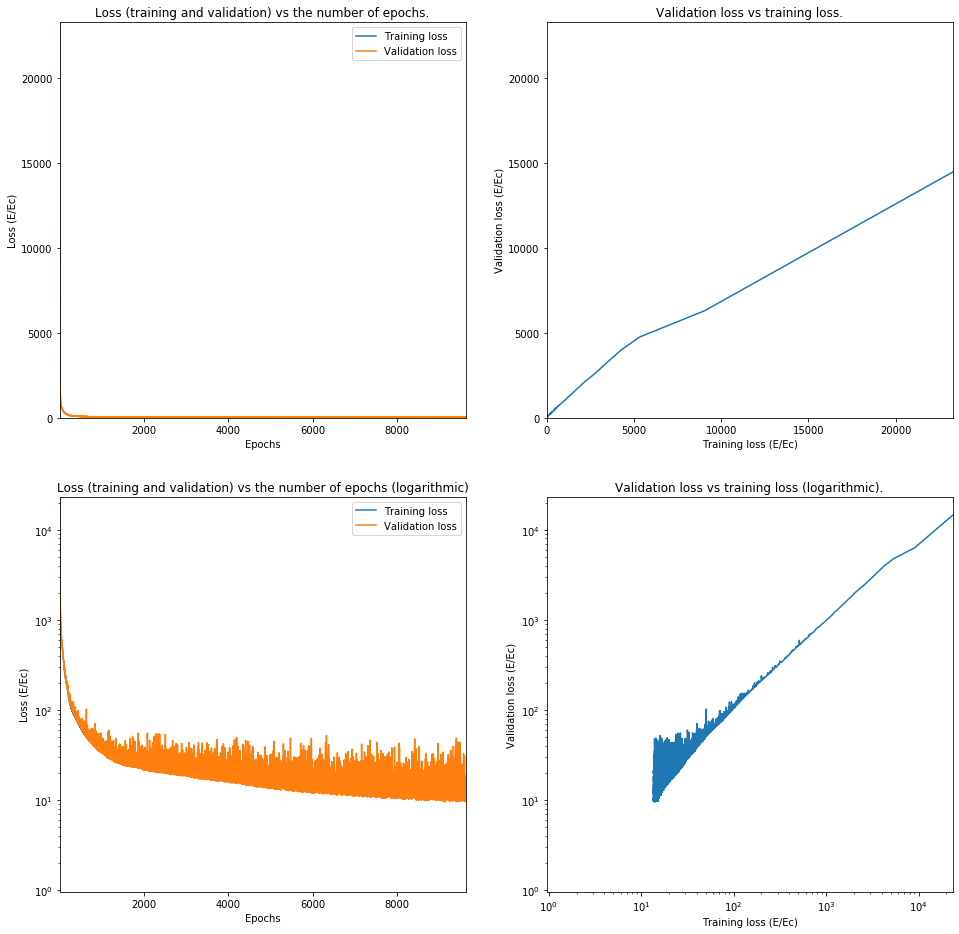

Train on 62644 samples, validate on 15662 samples
Epoch 1/10000
62644/62644 [==============================] - 2s 30us/step - loss: 504734.5921 - val_loss: 422990.0653
Epoch 2/10000
62644/62644 [==============================] - 2s 28us/step - loss: 339118.2709 - val_loss: 253005.7313
Epoch 3/10000
62644/62644 [==============================] - 2s 28us/step - loss: 165156.6379 - val_loss: 75346.7344
Epoch 4/10000
62644/62644 [==============================] - 2s 29us/step - loss: 35293.9760 - val_loss: 25327.9778
Epoch 5/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22434.2964 - val_loss: 20109.3328
Epoch 6/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18220.8031 - val_loss: 16949.5824
Epoch 7/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15952.5536 - val_loss: 15644.8026
Epoch 8/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14932.6608 - val_loss: 14784.0372
Epoch 9/10000
626

62644/62644 [==============================] - 2s 28us/step - loss: 1142.3425 - val_loss: 1155.9735
Epoch 72/10000
62644/62644 [==============================] - 2s 28us/step - loss: 1117.9232 - val_loss: 1099.5376
Epoch 73/10000
62644/62644 [==============================] - 2s 29us/step - loss: 1093.6751 - val_loss: 1077.9265
Epoch 74/10000
62644/62644 [==============================] - 2s 28us/step - loss: 1068.5329 - val_loss: 1051.3924
Epoch 75/10000
62644/62644 [==============================] - 2s 28us/step - loss: 1046.3253 - val_loss: 1026.0854
Epoch 76/10000
62644/62644 [==============================] - 2s 29us/step - loss: 1023.4015 - val_loss: 1025.4718
Epoch 77/10000
62644/62644 [==============================] - 2s 28us/step - loss: 999.9017 - val_loss: 992.2165
Epoch 78/10000
62644/62644 [==============================] - 2s 28us/step - loss: 977.8363 - val_loss: 958.2683
Epoch 79/10000
62644/62644 [==============================] - 2s 28us/step - loss: 956.2874 - val_l

62644/62644 [==============================] - 2s 28us/step - loss: 394.9752 - val_loss: 420.6544
Epoch 144/10000
62644/62644 [==============================] - 2s 29us/step - loss: 391.1198 - val_loss: 408.9185
Epoch 145/10000
62644/62644 [==============================] - 2s 28us/step - loss: 388.3926 - val_loss: 390.1410
Epoch 146/10000
62644/62644 [==============================] - 2s 28us/step - loss: 385.3041 - val_loss: 385.5936
Epoch 147/10000
62644/62644 [==============================] - 2s 28us/step - loss: 381.9366 - val_loss: 382.2043
Epoch 148/10000
62644/62644 [==============================] - 2s 28us/step - loss: 379.1418 - val_loss: 383.6877
Epoch 149/10000
62644/62644 [==============================] - 2s 28us/step - loss: 375.0302 - val_loss: 385.5014
Epoch 150/10000
62644/62644 [==============================] - 2s 28us/step - loss: 373.3243 - val_loss: 373.7374
Epoch 151/10000
62644/62644 [==============================] - 2s 28us/step - loss: 370.6255 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 248.6787 - val_loss: 246.0213
Epoch 216/10000
62644/62644 [==============================] - 2s 28us/step - loss: 247.1040 - val_loss: 238.0202
Epoch 217/10000
62644/62644 [==============================] - 2s 28us/step - loss: 246.4583 - val_loss: 236.5403
Epoch 218/10000
62644/62644 [==============================] - 2s 28us/step - loss: 245.7558 - val_loss: 237.7857
Epoch 219/10000
62644/62644 [==============================] - 2s 28us/step - loss: 243.0403 - val_loss: 237.1839
Epoch 220/10000
62644/62644 [==============================] - 2s 28us/step - loss: 242.3698 - val_loss: 232.5713
Epoch 221/10000
62644/62644 [==============================] - 2s 28us/step - loss: 241.0500 - val_loss: 240.6465
Epoch 222/10000
62644/62644 [==============================] - 2s 28us/step - loss: 240.9366 - val_loss: 230.1001
Epoch 223/10000
62644/62644 [==============================] - 2s 28us/step - loss: 238.8283 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 172.8375 - val_loss: 165.8047
Epoch 288/10000
62644/62644 [==============================] - 2s 28us/step - loss: 171.9601 - val_loss: 165.2927
Epoch 289/10000
62644/62644 [==============================] - 2s 28us/step - loss: 170.5675 - val_loss: 161.7419
Epoch 290/10000
62644/62644 [==============================] - 2s 28us/step - loss: 170.9707 - val_loss: 160.4310
Epoch 291/10000
62644/62644 [==============================] - 2s 28us/step - loss: 168.5981 - val_loss: 164.9120
Epoch 292/10000
62644/62644 [==============================] - 2s 29us/step - loss: 168.3685 - val_loss: 163.0269
Epoch 293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 167.6557 - val_loss: 163.1158
Epoch 294/10000
62644/62644 [==============================] - 2s 29us/step - loss: 166.8224 - val_loss: 157.7922
Epoch 295/10000
62644/62644 [==============================] - 2s 28us/step - loss: 167.1150 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 121.1132 - val_loss: 119.8343
Epoch 360/10000
62644/62644 [==============================] - 2s 28us/step - loss: 121.1477 - val_loss: 116.2265
Epoch 361/10000
62644/62644 [==============================] - 2s 28us/step - loss: 119.9957 - val_loss: 113.6768
Epoch 362/10000
62644/62644 [==============================] - 2s 28us/step - loss: 119.5981 - val_loss: 112.6109
Epoch 363/10000
62644/62644 [==============================] - 2s 28us/step - loss: 119.6552 - val_loss: 135.0221
Epoch 364/10000
62644/62644 [==============================] - 2s 28us/step - loss: 118.4810 - val_loss: 115.9364
Epoch 365/10000
62644/62644 [==============================] - 2s 28us/step - loss: 117.5736 - val_loss: 116.0059
Epoch 366/10000
62644/62644 [==============================] - 2s 28us/step - loss: 118.5292 - val_loss: 112.7348
Epoch 367/10000
62644/62644 [==============================] - 2s 28us/step - loss: 117.6726 - val_loss:

62644/62644 [==============================] - 2s 28us/step - loss: 89.3807 - val_loss: 82.5317
Epoch 432/10000
62644/62644 [==============================] - 2s 28us/step - loss: 89.2761 - val_loss: 87.1563
Epoch 433/10000
62644/62644 [==============================] - 2s 28us/step - loss: 87.4552 - val_loss: 81.7959
Epoch 434/10000
62644/62644 [==============================] - 2s 28us/step - loss: 87.8103 - val_loss: 81.9496
Epoch 435/10000
62644/62644 [==============================] - 2s 28us/step - loss: 87.3641 - val_loss: 81.0869
Epoch 436/10000
62644/62644 [==============================] - 2s 28us/step - loss: 87.1762 - val_loss: 89.8927
Epoch 437/10000
62644/62644 [==============================] - 2s 28us/step - loss: 87.3963 - val_loss: 87.4431
Epoch 438/10000
62644/62644 [==============================] - 2s 28us/step - loss: 86.5879 - val_loss: 80.0290
Epoch 439/10000
62644/62644 [==============================] - 2s 28us/step - loss: 86.9903 - val_loss: 86.3118
Epoch 44

62644/62644 [==============================] - 2s 28us/step - loss: 69.9455 - val_loss: 73.7978
Epoch 505/10000
62644/62644 [==============================] - 2s 28us/step - loss: 70.5853 - val_loss: 65.9303
Epoch 506/10000
62644/62644 [==============================] - 2s 28us/step - loss: 70.5995 - val_loss: 64.3232
Epoch 507/10000
62644/62644 [==============================] - 2s 28us/step - loss: 69.7841 - val_loss: 64.9102
Epoch 508/10000
62644/62644 [==============================] - 2s 28us/step - loss: 69.8886 - val_loss: 66.0009
Epoch 509/10000
62644/62644 [==============================] - 2s 28us/step - loss: 69.5060 - val_loss: 71.0961
Epoch 510/10000
62644/62644 [==============================] - 2s 28us/step - loss: 69.2556 - val_loss: 63.5920
Epoch 511/10000
62644/62644 [==============================] - 2s 28us/step - loss: 69.2726 - val_loss: 69.6295
Epoch 512/10000
62644/62644 [==============================] - 2s 28us/step - loss: 68.2976 - val_loss: 66.9487
Epoch 51

62644/62644 [==============================] - 2s 28us/step - loss: 59.3238 - val_loss: 53.7536
Epoch 578/10000
62644/62644 [==============================] - 2s 28us/step - loss: 59.6359 - val_loss: 55.6476
Epoch 579/10000
62644/62644 [==============================] - 2s 28us/step - loss: 59.8057 - val_loss: 56.3470
Epoch 580/10000
62644/62644 [==============================] - 2s 28us/step - loss: 58.5561 - val_loss: 63.6996
Epoch 581/10000
62644/62644 [==============================] - 2s 28us/step - loss: 59.2309 - val_loss: 78.8950
Epoch 582/10000
62644/62644 [==============================] - 2s 28us/step - loss: 59.3423 - val_loss: 55.0729
Epoch 583/10000
62644/62644 [==============================] - 2s 28us/step - loss: 59.2365 - val_loss: 54.0431
Epoch 584/10000
62644/62644 [==============================] - 2s 28us/step - loss: 58.9003 - val_loss: 53.5263
Epoch 585/10000
62644/62644 [==============================] - 2s 28us/step - loss: 58.7017 - val_loss: 65.0279
Epoch 58

62644/62644 [==============================] - 2s 28us/step - loss: 53.8918 - val_loss: 54.9375
Epoch 651/10000
62644/62644 [==============================] - 2s 28us/step - loss: 52.6789 - val_loss: 47.8632
Epoch 652/10000
62644/62644 [==============================] - 2s 28us/step - loss: 52.4414 - val_loss: 47.3132
Epoch 653/10000
62644/62644 [==============================] - 2s 28us/step - loss: 52.9728 - val_loss: 50.4347
Epoch 654/10000
62644/62644 [==============================] - 2s 28us/step - loss: 52.3503 - val_loss: 46.9777
Epoch 655/10000
62644/62644 [==============================] - 2s 28us/step - loss: 52.6707 - val_loss: 59.7559
Epoch 656/10000
62644/62644 [==============================] - 2s 28us/step - loss: 52.9390 - val_loss: 48.3767
Epoch 657/10000
62644/62644 [==============================] - 2s 28us/step - loss: 52.9971 - val_loss: 50.1891
Epoch 658/10000
62644/62644 [==============================] - 2s 28us/step - loss: 51.9536 - val_loss: 50.5131
Epoch 65

62644/62644 [==============================] - 2s 28us/step - loss: 48.3214 - val_loss: 43.3493
Epoch 724/10000
62644/62644 [==============================] - 2s 28us/step - loss: 47.8396 - val_loss: 45.9390
Epoch 725/10000
62644/62644 [==============================] - 2s 28us/step - loss: 48.2835 - val_loss: 53.1708
Epoch 726/10000
62644/62644 [==============================] - 2s 33us/step - loss: 47.7128 - val_loss: 44.8902
Epoch 727/10000
62644/62644 [==============================] - 2s 32us/step - loss: 48.2939 - val_loss: 42.6038
Epoch 728/10000
62644/62644 [==============================] - 2s 28us/step - loss: 48.0146 - val_loss: 50.1273
Epoch 729/10000
62644/62644 [==============================] - 2s 28us/step - loss: 47.3518 - val_loss: 50.5881
Epoch 730/10000
62644/62644 [==============================] - 2s 28us/step - loss: 47.6109 - val_loss: 41.9490
Epoch 731/10000
62644/62644 [==============================] - 2s 28us/step - loss: 47.8937 - val_loss: 42.1509
Epoch 73

62644/62644 [==============================] - 2s 30us/step - loss: 43.5551 - val_loss: 43.9219
Epoch 797/10000
62644/62644 [==============================] - 2s 31us/step - loss: 43.7239 - val_loss: 40.4863
Epoch 798/10000
62644/62644 [==============================] - 2s 31us/step - loss: 43.4299 - val_loss: 38.6141
Epoch 799/10000
62644/62644 [==============================] - 2s 29us/step - loss: 42.7547 - val_loss: 39.6262
Epoch 800/10000
62644/62644 [==============================] - 2s 29us/step - loss: 43.1986 - val_loss: 37.8678
Epoch 801/10000
62644/62644 [==============================] - 2s 30us/step - loss: 43.3710 - val_loss: 51.4671
Epoch 802/10000
62644/62644 [==============================] - 2s 31us/step - loss: 43.0610 - val_loss: 40.2285
Epoch 803/10000
62644/62644 [==============================] - 2s 30us/step - loss: 43.2135 - val_loss: 38.2100
Epoch 804/10000
62644/62644 [==============================] - 2s 30us/step - loss: 42.5249 - val_loss: 48.5419
Epoch 80

62644/62644 [==============================] - 2s 33us/step - loss: 39.8312 - val_loss: 35.7449
Epoch 870/10000
62644/62644 [==============================] - 2s 32us/step - loss: 39.2991 - val_loss: 38.2043
Epoch 871/10000
62644/62644 [==============================] - 2s 32us/step - loss: 39.7134 - val_loss: 55.0641
Epoch 872/10000
62644/62644 [==============================] - 2s 32us/step - loss: 39.2171 - val_loss: 35.4577
Epoch 873/10000
62644/62644 [==============================] - 2s 32us/step - loss: 39.7085 - val_loss: 38.1119
Epoch 874/10000
62644/62644 [==============================] - 2s 32us/step - loss: 39.6027 - val_loss: 36.4340
Epoch 875/10000
62644/62644 [==============================] - 2s 36us/step - loss: 39.5909 - val_loss: 46.1045
Epoch 876/10000
62644/62644 [==============================] - 2s 33us/step - loss: 38.9947 - val_loss: 34.7711
Epoch 877/10000
62644/62644 [==============================] - 2s 32us/step - loss: 38.9860 - val_loss: 34.6902
Epoch 87

62644/62644 [==============================] - 2s 32us/step - loss: 36.8676 - val_loss: 32.3755
Epoch 943/10000
62644/62644 [==============================] - 2s 31us/step - loss: 36.6080 - val_loss: 45.3743
Epoch 944/10000
62644/62644 [==============================] - 2s 32us/step - loss: 36.7033 - val_loss: 34.9516
Epoch 945/10000
62644/62644 [==============================] - 2s 32us/step - loss: 37.3669 - val_loss: 36.9527
Epoch 946/10000
62644/62644 [==============================] - 2s 32us/step - loss: 36.5159 - val_loss: 32.2566
Epoch 947/10000
62644/62644 [==============================] - 2s 32us/step - loss: 36.9457 - val_loss: 36.3793
Epoch 948/10000
62644/62644 [==============================] - 2s 32us/step - loss: 36.3065 - val_loss: 35.7644
Epoch 949/10000
62644/62644 [==============================] - 2s 32us/step - loss: 36.9250 - val_loss: 31.6953
Epoch 950/10000
62644/62644 [==============================] - 2s 32us/step - loss: 36.8578 - val_loss: 31.6892
Epoch 95

62644/62644 [==============================] - 2s 32us/step - loss: 34.1694 - val_loss: 31.0668
Epoch 1016/10000
62644/62644 [==============================] - 2s 32us/step - loss: 33.8530 - val_loss: 29.6356
Epoch 1017/10000
62644/62644 [==============================] - 2s 32us/step - loss: 33.9234 - val_loss: 29.7458
Epoch 1018/10000
62644/62644 [==============================] - 2s 32us/step - loss: 34.2870 - val_loss: 29.3080
Epoch 1019/10000
62644/62644 [==============================] - 2s 32us/step - loss: 35.3657 - val_loss: 40.4680
Epoch 1020/10000
62644/62644 [==============================] - 2s 32us/step - loss: 34.2471 - val_loss: 30.1501
Epoch 1021/10000
62644/62644 [==============================] - 2s 32us/step - loss: 34.2701 - val_loss: 41.0521
Epoch 1022/10000
62644/62644 [==============================] - 2s 32us/step - loss: 34.3525 - val_loss: 29.0600
Epoch 1023/10000
62644/62644 [==============================] - 2s 32us/step - loss: 34.1983 - val_loss: 30.6007


62644/62644 [==============================] - 2s 32us/step - loss: 32.6290 - val_loss: 30.1654
Epoch 1088/10000
62644/62644 [==============================] - 2s 32us/step - loss: 33.4393 - val_loss: 32.3227
Epoch 1089/10000
62644/62644 [==============================] - 2s 32us/step - loss: 32.4403 - val_loss: 27.7828
Epoch 1090/10000
62644/62644 [==============================] - 2s 32us/step - loss: 32.2931 - val_loss: 31.2312
Epoch 1091/10000
62644/62644 [==============================] - 2s 32us/step - loss: 32.3017 - val_loss: 30.6028
Epoch 1092/10000
62644/62644 [==============================] - 2s 32us/step - loss: 32.4248 - val_loss: 41.3014
Epoch 1093/10000
62644/62644 [==============================] - 2s 31us/step - loss: 31.9113 - val_loss: 27.5966
Epoch 1094/10000
62644/62644 [==============================] - 2s 32us/step - loss: 31.9206 - val_loss: 33.9874
Epoch 1095/10000
62644/62644 [==============================] - 2s 32us/step - loss: 31.7904 - val_loss: 34.6839


62644/62644 [==============================] - 2s 32us/step - loss: 31.0586 - val_loss: 26.6047
Epoch 1160/10000
62644/62644 [==============================] - 2s 33us/step - loss: 30.6966 - val_loss: 30.4454
Epoch 1161/10000
62644/62644 [==============================] - 2s 33us/step - loss: 31.0393 - val_loss: 26.0214
Epoch 1162/10000
62644/62644 [==============================] - 2s 32us/step - loss: 31.4659 - val_loss: 26.0281
Epoch 1163/10000
62644/62644 [==============================] - 2s 33us/step - loss: 30.7219 - val_loss: 39.4565
Epoch 1164/10000
62644/62644 [==============================] - 2s 33us/step - loss: 31.6931 - val_loss: 34.5782
Epoch 1165/10000
62644/62644 [==============================] - 2s 32us/step - loss: 30.2021 - val_loss: 36.4151
Epoch 1166/10000
62644/62644 [==============================] - 2s 32us/step - loss: 31.4244 - val_loss: 26.1109
Epoch 1167/10000
62644/62644 [==============================] - 2s 32us/step - loss: 31.2768 - val_loss: 31.2560


62644/62644 [==============================] - 2s 33us/step - loss: 30.0718 - val_loss: 67.1733
Epoch 1232/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.3597 - val_loss: 25.2728
Epoch 1233/10000
62644/62644 [==============================] - 2s 32us/step - loss: 30.7249 - val_loss: 25.1744
Epoch 1234/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.6952 - val_loss: 27.1446
Epoch 1235/10000
62644/62644 [==============================] - 2s 33us/step - loss: 29.6591 - val_loss: 28.7271
Epoch 1236/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.5708 - val_loss: 25.6378
Epoch 1237/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.3632 - val_loss: 27.1105
Epoch 1238/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.9627 - val_loss: 34.9937
Epoch 1239/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.7362 - val_loss: 25.3564


62644/62644 [==============================] - 2s 33us/step - loss: 29.1664 - val_loss: 23.7467
Epoch 1304/10000
62644/62644 [==============================] - 2s 34us/step - loss: 29.0108 - val_loss: 25.2908
Epoch 1305/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.4948 - val_loss: 24.8359
Epoch 1306/10000
62644/62644 [==============================] - 2s 32us/step - loss: 28.7412 - val_loss: 30.5189
Epoch 1307/10000
62644/62644 [==============================] - 2s 32us/step - loss: 28.8917 - val_loss: 36.1329
Epoch 1308/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.2139 - val_loss: 26.0405
Epoch 1309/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.9992 - val_loss: 24.1088
Epoch 1310/10000
62644/62644 [==============================] - 2s 32us/step - loss: 28.5358 - val_loss: 24.9989
Epoch 1311/10000
62644/62644 [==============================] - 2s 32us/step - loss: 29.4154 - val_loss: 24.6489


62644/62644 [==============================] - 2s 34us/step - loss: 28.0198 - val_loss: 42.4244
Epoch 1376/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.7436 - val_loss: 25.3879
Epoch 1377/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.7359 - val_loss: 31.3884
Epoch 1378/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.4333 - val_loss: 24.5805
Epoch 1379/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.0780 - val_loss: 44.7198
Epoch 1380/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.7914 - val_loss: 25.9193
Epoch 1381/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.5915 - val_loss: 23.1994
Epoch 1382/10000
62644/62644 [==============================] - 2s 32us/step - loss: 27.8015 - val_loss: 23.3874
Epoch 1383/10000
62644/62644 [==============================] - 2s 32us/step - loss: 28.1845 - val_loss: 39.3712


62644/62644 [==============================] - 2s 32us/step - loss: 27.3593 - val_loss: 27.1655
Epoch 1448/10000
62644/62644 [==============================] - 2s 32us/step - loss: 27.2638 - val_loss: 27.6804
Epoch 1449/10000
62644/62644 [==============================] - 2s 32us/step - loss: 27.1781 - val_loss: 29.7750
Epoch 1450/10000
62644/62644 [==============================] - 2s 34us/step - loss: 26.7250 - val_loss: 40.9864
Epoch 1451/10000
62644/62644 [==============================] - 2s 32us/step - loss: 27.8314 - val_loss: 23.7391
Epoch 1452/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.0167 - val_loss: 23.1542
Epoch 1453/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.2056 - val_loss: 23.4503
Epoch 1454/10000
62644/62644 [==============================] - 2s 33us/step - loss: 28.0700 - val_loss: 28.5949
Epoch 1455/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.5693 - val_loss: 31.5931


62644/62644 [==============================] - 2s 34us/step - loss: 26.7966 - val_loss: 35.7832
Epoch 1520/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.5957 - val_loss: 22.0207
Epoch 1521/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.1888 - val_loss: 31.1010
Epoch 1522/10000
62644/62644 [==============================] - 2s 33us/step - loss: 26.9039 - val_loss: 30.9957
Epoch 1523/10000
62644/62644 [==============================] - 2s 32us/step - loss: 26.6567 - val_loss: 22.1930
Epoch 1524/10000
62644/62644 [==============================] - 2s 33us/step - loss: 27.0325 - val_loss: 23.1350
Epoch 1525/10000
62644/62644 [==============================] - 2s 32us/step - loss: 26.9173 - val_loss: 22.7547
Epoch 1526/10000
62644/62644 [==============================] - 2s 32us/step - loss: 26.5065 - val_loss: 22.8305
Epoch 1527/10000
62644/62644 [==============================] - 2s 32us/step - loss: 27.0329 - val_loss: 36.0978


62644/62644 [==============================] - 2s 32us/step - loss: 26.5231 - val_loss: 21.6737
Epoch 1592/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.7962 - val_loss: 22.1837
Epoch 1593/10000
62644/62644 [==============================] - 2s 32us/step - loss: 26.2684 - val_loss: 33.7451
Epoch 1594/10000
62644/62644 [==============================] - 2s 32us/step - loss: 26.3705 - val_loss: 22.2718
Epoch 1595/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.7289 - val_loss: 21.6894
Epoch 1596/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.8476 - val_loss: 21.5573
Epoch 1597/10000
62644/62644 [==============================] - 2s 31us/step - loss: 26.4721 - val_loss: 26.4302
Epoch 1598/10000
62644/62644 [==============================] - 2s 31us/step - loss: 26.4502 - val_loss: 27.6746
Epoch 1599/10000
62644/62644 [==============================] - 2s 31us/step - loss: 26.1088 - val_loss: 26.2588


62644/62644 [==============================] - 2s 31us/step - loss: 26.0688 - val_loss: 21.5260
Epoch 1664/10000
62644/62644 [==============================] - 2s 33us/step - loss: 25.5214 - val_loss: 22.5053
Epoch 1665/10000
62644/62644 [==============================] - 2s 32us/step - loss: 25.3814 - val_loss: 20.9333
Epoch 1666/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.1247 - val_loss: 21.2351
Epoch 1667/10000
62644/62644 [==============================] - 2s 31us/step - loss: 26.0577 - val_loss: 21.1704
Epoch 1668/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.0452 - val_loss: 21.3995
Epoch 1669/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.9591 - val_loss: 25.7759
Epoch 1670/10000
62644/62644 [==============================] - 2s 31us/step - loss: 26.7620 - val_loss: 26.5989
Epoch 1671/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.7284 - val_loss: 24.8018


62644/62644 [==============================] - 2s 31us/step - loss: 24.5979 - val_loss: 29.7166
Epoch 1736/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.2022 - val_loss: 45.6293
Epoch 1737/10000
62644/62644 [==============================] - 2s 31us/step - loss: 24.8216 - val_loss: 28.1472
Epoch 1738/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.8244 - val_loss: 21.1710
Epoch 1739/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.5427 - val_loss: 21.5631
Epoch 1740/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.2358 - val_loss: 23.4698
Epoch 1741/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.5926 - val_loss: 24.5132
Epoch 1742/10000
62644/62644 [==============================] - 2s 30us/step - loss: 26.2685 - val_loss: 21.0050
Epoch 1743/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.7278 - val_loss: 22.7863


62644/62644 [==============================] - 2s 30us/step - loss: 24.7027 - val_loss: 23.5420
Epoch 1808/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.2527 - val_loss: 20.9138
Epoch 1809/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.3042 - val_loss: 21.5297
Epoch 1810/10000
62644/62644 [==============================] - 2s 31us/step - loss: 24.2463 - val_loss: 20.3114
Epoch 1811/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.9824 - val_loss: 26.1145
Epoch 1812/10000
62644/62644 [==============================] - 2s 30us/step - loss: 25.0874 - val_loss: 20.5694
Epoch 1813/10000
62644/62644 [==============================] - 2s 31us/step - loss: 25.1835 - val_loss: 29.2543
Epoch 1814/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.9717 - val_loss: 24.7680
Epoch 1815/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.7696 - val_loss: 20.5901


62644/62644 [==============================] - 2s 30us/step - loss: 24.1412 - val_loss: 34.0243
Epoch 1880/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.2068 - val_loss: 20.0952
Epoch 1881/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.4042 - val_loss: 26.5806
Epoch 1882/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.5361 - val_loss: 20.4320
Epoch 1883/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.0623 - val_loss: 21.9908
Epoch 1884/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.7636 - val_loss: 21.3889
Epoch 1885/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.9682 - val_loss: 23.0941
Epoch 1886/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.7192 - val_loss: 23.2214
Epoch 1887/10000
62644/62644 [==============================] - 2s 34us/step - loss: 24.3387 - val_loss: 22.9620


62644/62644 [==============================] - 2s 30us/step - loss: 23.9806 - val_loss: 23.0452
Epoch 1952/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.7288 - val_loss: 29.3944
Epoch 1953/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.8928 - val_loss: 22.2545
Epoch 1954/10000
62644/62644 [==============================] - 2s 31us/step - loss: 24.4501 - val_loss: 23.6034
Epoch 1955/10000
62644/62644 [==============================] - 2s 31us/step - loss: 24.2513 - val_loss: 29.9868
Epoch 1956/10000
62644/62644 [==============================] - 2s 30us/step - loss: 24.1456 - val_loss: 33.0106
Epoch 1957/10000
62644/62644 [==============================] - 2s 31us/step - loss: 24.2668 - val_loss: 32.9140
Epoch 1958/10000
62644/62644 [==============================] - 2s 31us/step - loss: 24.2676 - val_loss: 21.9245
Epoch 1959/10000
62644/62644 [==============================] - 2s 31us/step - loss: 24.3143 - val_loss: 34.9026


62644/62644 [==============================] - 2s 31us/step - loss: 23.9547 - val_loss: 19.4081
Epoch 2024/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.9193 - val_loss: 22.9230
Epoch 2025/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.1472 - val_loss: 19.3627
Epoch 2026/10000
62644/62644 [==============================] - 2s 32us/step - loss: 23.2517 - val_loss: 19.8043
Epoch 2027/10000
62644/62644 [==============================] - 2s 32us/step - loss: 23.5309 - val_loss: 22.6652
Epoch 2028/10000
62644/62644 [==============================] - 2s 32us/step - loss: 23.5726 - val_loss: 20.9200
Epoch 2029/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.4933 - val_loss: 27.5436
Epoch 2030/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.6804 - val_loss: 22.5622
Epoch 2031/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.2044 - val_loss: 22.7396


62644/62644 [==============================] - 2s 30us/step - loss: 23.2548 - val_loss: 22.3972
Epoch 2096/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.1097 - val_loss: 25.8923
Epoch 2097/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.0288 - val_loss: 25.2240
Epoch 2098/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.1097 - val_loss: 25.0824
Epoch 2099/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.3948 - val_loss: 19.3776
Epoch 2100/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.0407 - val_loss: 26.7244
Epoch 2101/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.9406 - val_loss: 23.0107
Epoch 2102/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.4917 - val_loss: 21.2036
Epoch 2103/10000
62644/62644 [==============================] - 2s 31us/step - loss: 23.0987 - val_loss: 26.1854


62644/62644 [==============================] - 2s 30us/step - loss: 23.1940 - val_loss: 27.6257
Epoch 2168/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.8683 - val_loss: 19.6491
Epoch 2169/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.9900 - val_loss: 20.2111
Epoch 2170/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.0446 - val_loss: 20.8411
Epoch 2171/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.2813 - val_loss: 23.2059
Epoch 2172/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2378 - val_loss: 20.0192
Epoch 2173/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.4961 - val_loss: 19.8903
Epoch 2174/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.2119 - val_loss: 24.3396
Epoch 2175/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.1955 - val_loss: 19.3707


62644/62644 [==============================] - 2s 30us/step - loss: 22.2004 - val_loss: 24.7991
Epoch 2240/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.5219 - val_loss: 18.8037
Epoch 2241/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.4165 - val_loss: 19.5588
Epoch 2242/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.1526 - val_loss: 26.9123
Epoch 2243/10000
62644/62644 [==============================] - 2s 29us/step - loss: 23.3020 - val_loss: 31.3679
Epoch 2244/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.1458 - val_loss: 30.7441
Epoch 2245/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.7915 - val_loss: 37.4679
Epoch 2246/10000
62644/62644 [==============================] - 2s 30us/step - loss: 23.3426 - val_loss: 27.2884
Epoch 2247/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.1523 - val_loss: 19.7289


62644/62644 [==============================] - 2s 30us/step - loss: 22.3919 - val_loss: 24.6821
Epoch 2312/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.1412 - val_loss: 31.6292
Epoch 2313/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.2376 - val_loss: 18.8108
Epoch 2314/10000
62644/62644 [==============================] - 2s 33us/step - loss: 22.2252 - val_loss: 27.4134
Epoch 2315/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.1139 - val_loss: 42.9094
Epoch 2316/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.5945 - val_loss: 19.7144
Epoch 2317/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.2851 - val_loss: 18.7958
Epoch 2318/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.8186 - val_loss: 21.6107
Epoch 2319/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.0185 - val_loss: 19.1711


62644/62644 [==============================] - 2s 29us/step - loss: 22.0015 - val_loss: 25.5519
Epoch 2384/10000
62644/62644 [==============================] - 2s 30us/step - loss: 21.8367 - val_loss: 21.4640
Epoch 2385/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.3836 - val_loss: 18.2879
Epoch 2386/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.2700 - val_loss: 18.6770
Epoch 2387/10000
62644/62644 [==============================] - 2s 29us/step - loss: 22.1832 - val_loss: 20.4967
Epoch 2388/10000
62644/62644 [==============================] - 2s 29us/step - loss: 21.4409 - val_loss: 22.4240
Epoch 2389/10000
62644/62644 [==============================] - 2s 30us/step - loss: 22.2285 - val_loss: 18.0749
Epoch 2390/10000
62644/62644 [==============================] - 2s 31us/step - loss: 22.5816 - val_loss: 27.1651
Epoch 2391/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.3690 - val_loss: 24.5713


62644/62644 [==============================] - 2s 32us/step - loss: 22.5138 - val_loss: 20.7576
Epoch 2456/10000
62644/62644 [==============================] - 2s 33us/step - loss: 22.2166 - val_loss: 26.7779
Epoch 2457/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.0299 - val_loss: 18.5985
Epoch 2458/10000
62644/62644 [==============================] - 2s 34us/step - loss: 22.3966 - val_loss: 30.4436
Epoch 2459/10000
62644/62644 [==============================] - 2s 33us/step - loss: 21.9025 - val_loss: 22.0125
Epoch 2460/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.1685 - val_loss: 20.8191
Epoch 2461/10000
62644/62644 [==============================] - 2s 33us/step - loss: 22.0235 - val_loss: 21.8041
Epoch 2462/10000
62644/62644 [==============================] - 2s 32us/step - loss: 22.3830 - val_loss: 17.6678
Epoch 2463/10000
62644/62644 [==============================] - 2s 33us/step - loss: 21.7383 - val_loss: 19.7604


62644/62644 [==============================] - 2s 33us/step - loss: 21.8073 - val_loss: 23.8284
Epoch 2528/10000
62644/62644 [==============================] - 2s 35us/step - loss: 21.6576 - val_loss: 24.0934
Epoch 2529/10000
62644/62644 [==============================] - 2s 35us/step - loss: 21.3124 - val_loss: 25.4095
Epoch 2530/10000
62644/62644 [==============================] - 2s 39us/step - loss: 21.5226 - val_loss: 19.7470
Epoch 2531/10000
62644/62644 [==============================] - 3s 43us/step - loss: 22.0589 - val_loss: 24.7416
Epoch 2532/10000
62644/62644 [==============================] - 2s 38us/step - loss: 21.4550 - val_loss: 20.8985
Epoch 2533/10000
62644/62644 [==============================] - 2s 38us/step - loss: 21.9689 - val_loss: 21.0971
Epoch 2534/10000
62644/62644 [==============================] - 2s 33us/step - loss: 21.6250 - val_loss: 28.5220
Epoch 2535/10000
62644/62644 [==============================] - 2s 33us/step - loss: 21.9050 - val_loss: 28.8512


62644/62644 [==============================] - 2s 32us/step - loss: 21.0568 - val_loss: 20.6738
Epoch 2600/10000
62644/62644 [==============================] - 2s 36us/step - loss: 21.2485 - val_loss: 19.8873
Epoch 2601/10000
62644/62644 [==============================] - 2s 38us/step - loss: 21.5776 - val_loss: 19.3318
Epoch 2602/10000
62644/62644 [==============================] - 2s 35us/step - loss: 21.0099 - val_loss: 21.0596
Epoch 2603/10000
62644/62644 [==============================] - 2s 33us/step - loss: 21.5456 - val_loss: 21.2833
Epoch 2604/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.4358 - val_loss: 19.8500
Epoch 2605/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.1735 - val_loss: 26.6895
Epoch 2606/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.6639 - val_loss: 28.0540
Epoch 2607/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2698 - val_loss: 22.1976


62644/62644 [==============================] - 2s 32us/step - loss: 21.2719 - val_loss: 17.8875
Epoch 2672/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.9067 - val_loss: 17.7433
Epoch 2673/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.9373 - val_loss: 23.4110
Epoch 2674/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.4977 - val_loss: 26.5197
Epoch 2675/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.9742 - val_loss: 17.9344
Epoch 2676/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.4331 - val_loss: 17.8870
Epoch 2677/10000
62644/62644 [==============================] - 2s 30us/step - loss: 21.3929 - val_loss: 31.8157
Epoch 2678/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.3604 - val_loss: 24.5910
Epoch 2679/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.0966 - val_loss: 25.0524


62644/62644 [==============================] - 2s 33us/step - loss: 20.5769 - val_loss: 16.8149
Epoch 2744/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.4107 - val_loss: 30.5808
Epoch 2745/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.1664 - val_loss: 25.9340
Epoch 2746/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.5831 - val_loss: 25.5741
Epoch 2747/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.7693 - val_loss: 18.0750
Epoch 2748/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.5194 - val_loss: 17.3110
Epoch 2749/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.8999 - val_loss: 25.5187
Epoch 2750/10000
62644/62644 [==============================] - 2s 33us/step - loss: 20.7016 - val_loss: 22.6645
Epoch 2751/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.8162 - val_loss: 17.5233


62644/62644 [==============================] - 2s 31us/step - loss: 21.2154 - val_loss: 21.0870
Epoch 2816/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6868 - val_loss: 17.4558
Epoch 2817/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.4883 - val_loss: 46.6695
Epoch 2818/10000
62644/62644 [==============================] - 2s 31us/step - loss: 21.5953 - val_loss: 16.5853
Epoch 2819/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3878 - val_loss: 20.6139
Epoch 2820/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6297 - val_loss: 21.7590
Epoch 2821/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.1236 - val_loss: 24.9021
Epoch 2822/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.7036 - val_loss: 17.6579
Epoch 2823/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.8585 - val_loss: 18.3924


62644/62644 [==============================] - 2s 31us/step - loss: 20.9125 - val_loss: 18.5497
Epoch 2888/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.2560 - val_loss: 23.6207
Epoch 2889/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.8125 - val_loss: 23.1307
Epoch 2890/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.2358 - val_loss: 16.5841
Epoch 2891/10000
62644/62644 [==============================] - 2s 32us/step - loss: 21.2235 - val_loss: 18.0821
Epoch 2892/10000
62644/62644 [==============================] - 2s 33us/step - loss: 20.5202 - val_loss: 20.3909
Epoch 2893/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.5652 - val_loss: 17.9888
Epoch 2894/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.3565 - val_loss: 20.0347
Epoch 2895/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.1979 - val_loss: 18.0383


62644/62644 [==============================] - 2s 31us/step - loss: 20.0711 - val_loss: 24.4237
Epoch 2960/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.5866 - val_loss: 36.1807
Epoch 2961/10000
62644/62644 [==============================] - 2s 32us/step - loss: 20.2289 - val_loss: 20.9674
Epoch 2962/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.0461 - val_loss: 16.0422
Epoch 2963/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.0438 - val_loss: 16.6728
Epoch 2964/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.6268 - val_loss: 19.7782
Epoch 2965/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.3859 - val_loss: 27.0305
Epoch 2966/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.2490 - val_loss: 24.9070
Epoch 2967/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.4220 - val_loss: 19.8869


62644/62644 [==============================] - 2s 31us/step - loss: 19.9810 - val_loss: 16.0501
Epoch 3032/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6587 - val_loss: 16.0766
Epoch 3033/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.9363 - val_loss: 16.0203
Epoch 3034/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6202 - val_loss: 29.2425
Epoch 3035/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6477 - val_loss: 16.7697
Epoch 3036/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.9207 - val_loss: 19.9578
Epoch 3037/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.2521 - val_loss: 21.6280
Epoch 3038/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.1666 - val_loss: 21.1000
Epoch 3039/10000
62644/62644 [==============================] - 2s 30us/step - loss: 20.0232 - val_loss: 25.5423


62644/62644 [==============================] - 2s 32us/step - loss: 20.2002 - val_loss: 16.8156
Epoch 3104/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.7386 - val_loss: 16.7826
Epoch 3105/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.8800 - val_loss: 21.1239
Epoch 3106/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.9322 - val_loss: 18.1256
Epoch 3107/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.1731 - val_loss: 17.5986
Epoch 3108/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.3203 - val_loss: 19.4956
Epoch 3109/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.3492 - val_loss: 21.3903
Epoch 3110/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9443 - val_loss: 18.8493
Epoch 3111/10000
62644/62644 [==============================] - 2s 33us/step - loss: 19.3726 - val_loss: 19.0986


62644/62644 [==============================] - 2s 31us/step - loss: 19.4618 - val_loss: 15.5900
Epoch 3176/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6713 - val_loss: 17.2177
Epoch 3177/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.2297 - val_loss: 19.0831
Epoch 3178/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.0430 - val_loss: 16.6913
Epoch 3179/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.5236 - val_loss: 22.7410
Epoch 3180/10000
62644/62644 [==============================] - 2s 33us/step - loss: 19.5367 - val_loss: 25.0273
Epoch 3181/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.2184 - val_loss: 18.3860
Epoch 3182/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5923 - val_loss: 34.1194
Epoch 3183/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.3311 - val_loss: 17.6588


62644/62644 [==============================] - 2s 30us/step - loss: 19.7859 - val_loss: 19.7080
Epoch 3248/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2463 - val_loss: 15.4083
Epoch 3249/10000
62644/62644 [==============================] - 2s 31us/step - loss: 20.0761 - val_loss: 23.4657
Epoch 3250/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.0725 - val_loss: 21.9747
Epoch 3251/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.3935 - val_loss: 15.4121
Epoch 3252/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.5210 - val_loss: 16.0438
Epoch 3253/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4724 - val_loss: 25.5075
Epoch 3254/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.1816 - val_loss: 23.9890
Epoch 3255/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.9318 - val_loss: 24.5689


62644/62644 [==============================] - 2s 30us/step - loss: 18.7150 - val_loss: 20.0651
Epoch 3320/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.3521 - val_loss: 17.8406
Epoch 3321/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4339 - val_loss: 16.1181
Epoch 3322/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.1754 - val_loss: 34.5266
Epoch 3323/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.3093 - val_loss: 16.3169
Epoch 3324/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.5574 - val_loss: 16.1897
Epoch 3325/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.3510 - val_loss: 29.2404
Epoch 3326/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.0420 - val_loss: 15.4329
Epoch 3327/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8939 - val_loss: 15.2084


62644/62644 [==============================] - 2s 32us/step - loss: 19.4300 - val_loss: 26.6213
Epoch 3392/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.1703 - val_loss: 23.1200
Epoch 3393/10000
62644/62644 [==============================] - 2s 34us/step - loss: 19.5597 - val_loss: 15.7769
Epoch 3394/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5718 - val_loss: 15.4749
Epoch 3395/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.5442 - val_loss: 33.5783
Epoch 3396/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.9837 - val_loss: 16.0433
Epoch 3397/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.4700 - val_loss: 32.4719
Epoch 3398/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.6452 - val_loss: 20.8207
Epoch 3399/10000
62644/62644 [==============================] - 2s 31us/step - loss: 19.2328 - val_loss: 16.8434


62644/62644 [==============================] - 2s 30us/step - loss: 18.8623 - val_loss: 19.8797
Epoch 3464/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.3881 - val_loss: 16.2906
Epoch 3465/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8124 - val_loss: 25.1919
Epoch 3466/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4377 - val_loss: 34.6833
Epoch 3467/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.4944 - val_loss: 23.5815
Epoch 3468/10000
62644/62644 [==============================] - 2s 33us/step - loss: 19.3337 - val_loss: 16.2609
Epoch 3469/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.9560 - val_loss: 26.3895
Epoch 3470/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.3374 - val_loss: 15.2762
Epoch 3471/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.5820 - val_loss: 24.8970


62644/62644 [==============================] - 2s 31us/step - loss: 19.0556 - val_loss: 18.8453
Epoch 3536/10000
62644/62644 [==============================] - 2s 32us/step - loss: 19.0182 - val_loss: 15.0356
Epoch 3537/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.7667 - val_loss: 17.5864
Epoch 3538/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.6186 - val_loss: 15.1787
Epoch 3539/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.8750 - val_loss: 18.0720
Epoch 3540/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.0036 - val_loss: 40.5576
Epoch 3541/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.0148 - val_loss: 16.2940
Epoch 3542/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.1445 - val_loss: 22.7539
Epoch 3543/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4291 - val_loss: 15.0448


62644/62644 [==============================] - 2s 30us/step - loss: 19.1398 - val_loss: 25.8744
Epoch 3608/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8747 - val_loss: 17.4501
Epoch 3609/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9879 - val_loss: 15.1158
Epoch 3610/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.3740 - val_loss: 18.5278
Epoch 3611/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.5475 - val_loss: 17.3166
Epoch 3612/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.4590 - val_loss: 19.8059
Epoch 3613/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.4531 - val_loss: 17.0129
Epoch 3614/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.6894 - val_loss: 22.8890
Epoch 3615/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.9203 - val_loss: 15.1517


62644/62644 [==============================] - 2s 29us/step - loss: 18.4095 - val_loss: 15.0910
Epoch 3680/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.0443 - val_loss: 17.2926
Epoch 3681/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.1108 - val_loss: 15.5169
Epoch 3682/10000
62644/62644 [==============================] - 2s 30us/step - loss: 19.0794 - val_loss: 20.1032
Epoch 3683/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.5123 - val_loss: 17.0505
Epoch 3684/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.3813 - val_loss: 15.9981
Epoch 3685/10000
62644/62644 [==============================] - 2s 32us/step - loss: 18.9189 - val_loss: 20.5747
Epoch 3686/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.8935 - val_loss: 16.6640
Epoch 3687/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.6917 - val_loss: 16.0732


62644/62644 [==============================] - 2s 28us/step - loss: 19.3323 - val_loss: 14.5683
Epoch 3752/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5687 - val_loss: 15.8698
Epoch 3753/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.7271 - val_loss: 23.1176
Epoch 3754/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6752 - val_loss: 22.4205
Epoch 3755/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.5153 - val_loss: 14.7495
Epoch 3756/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5299 - val_loss: 16.9791
Epoch 3757/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4068 - val_loss: 14.9885
Epoch 3758/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6134 - val_loss: 16.6306
Epoch 3759/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6242 - val_loss: 16.0440


62644/62644 [==============================] - 2s 28us/step - loss: 18.0563 - val_loss: 17.9630
Epoch 3824/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.4181 - val_loss: 15.8126
Epoch 3825/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5710 - val_loss: 15.5336
Epoch 3826/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.7285 - val_loss: 14.7597
Epoch 3827/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4147 - val_loss: 15.3953
Epoch 3828/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.0263 - val_loss: 15.0452
Epoch 3829/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.2035 - val_loss: 19.3176
Epoch 3830/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.1677 - val_loss: 18.8989
Epoch 3831/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4169 - val_loss: 14.8462


62644/62644 [==============================] - 2s 28us/step - loss: 18.7557 - val_loss: 16.6499
Epoch 3896/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2745 - val_loss: 15.4845
Epoch 3897/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.1968 - val_loss: 25.1804
Epoch 3898/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2881 - val_loss: 15.2299
Epoch 3899/10000
62644/62644 [==============================] - 2s 28us/step - loss: 19.1316 - val_loss: 14.3511
Epoch 3900/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6658 - val_loss: 21.2396
Epoch 3901/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5503 - val_loss: 20.4373
Epoch 3902/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5396 - val_loss: 17.0428
Epoch 3903/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7422 - val_loss: 14.3518


62644/62644 [==============================] - 2s 28us/step - loss: 18.1984 - val_loss: 17.3177
Epoch 3968/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7528 - val_loss: 18.2100
Epoch 3969/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.3272 - val_loss: 17.5439
Epoch 3970/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0007 - val_loss: 15.3669
Epoch 3971/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.7946 - val_loss: 14.6122
Epoch 3972/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3433 - val_loss: 24.7632
Epoch 3973/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0894 - val_loss: 23.9967
Epoch 3974/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1588 - val_loss: 18.7722
Epoch 3975/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.8366 - val_loss: 20.2664


62644/62644 [==============================] - 2s 28us/step - loss: 18.6685 - val_loss: 30.7681
Epoch 4040/10000
62644/62644 [==============================] - 2s 30us/step - loss: 18.7579 - val_loss: 14.3016
Epoch 4041/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9294 - val_loss: 30.9611
Epoch 4042/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.3178 - val_loss: 14.7317
Epoch 4043/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7695 - val_loss: 19.8910
Epoch 4044/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.6945 - val_loss: 25.4679
Epoch 4045/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2649 - val_loss: 20.4411
Epoch 4046/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0320 - val_loss: 15.0452
Epoch 4047/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6879 - val_loss: 15.3659


62644/62644 [==============================] - 2s 28us/step - loss: 17.8513 - val_loss: 41.7909
Epoch 4112/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0497 - val_loss: 27.0523
Epoch 4113/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7866 - val_loss: 15.4133
Epoch 4114/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0726 - val_loss: 24.4540
Epoch 4115/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.1218 - val_loss: 14.3092
Epoch 4116/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8573 - val_loss: 18.2285
Epoch 4117/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7216 - val_loss: 14.4249
Epoch 4118/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7915 - val_loss: 17.7228
Epoch 4119/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.3288 - val_loss: 13.9265


62644/62644 [==============================] - 2s 28us/step - loss: 17.3459 - val_loss: 14.6078
Epoch 4184/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1484 - val_loss: 13.8847
Epoch 4185/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.2579 - val_loss: 14.5950
Epoch 4186/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2642 - val_loss: 19.2897
Epoch 4187/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2568 - val_loss: 21.4933
Epoch 4188/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2361 - val_loss: 14.1233
Epoch 4189/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9261 - val_loss: 18.9127
Epoch 4190/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2252 - val_loss: 14.9414
Epoch 4191/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4260 - val_loss: 22.7571


62644/62644 [==============================] - 2s 28us/step - loss: 17.6441 - val_loss: 14.9942
Epoch 4256/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5526 - val_loss: 16.8808
Epoch 4257/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.2757 - val_loss: 22.6937
Epoch 4258/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.3697 - val_loss: 39.2232
Epoch 4259/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8219 - val_loss: 14.8017
Epoch 4260/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7357 - val_loss: 17.2905
Epoch 4261/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9154 - val_loss: 20.3024
Epoch 4262/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5925 - val_loss: 14.0040
Epoch 4263/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.0522 - val_loss: 14.3715


62644/62644 [==============================] - 2s 28us/step - loss: 17.7732 - val_loss: 14.8760
Epoch 4328/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.4128 - val_loss: 18.2701
Epoch 4329/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8097 - val_loss: 14.1465
Epoch 4330/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.4809 - val_loss: 19.5161
Epoch 4331/10000
62644/62644 [==============================] - 2s 28us/step - loss: 18.5937 - val_loss: 14.1322
Epoch 4332/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0251 - val_loss: 14.0869
Epoch 4333/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7211 - val_loss: 14.2245
Epoch 4334/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.7116 - val_loss: 14.1060
Epoch 4335/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.8997 - val_loss: 17.2836


62644/62644 [==============================] - 2s 31us/step - loss: 17.3989 - val_loss: 17.1738
Epoch 4400/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.9935 - val_loss: 18.6962
Epoch 4401/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.9639 - val_loss: 13.4886
Epoch 4402/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.8467 - val_loss: 16.2777
Epoch 4403/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1050 - val_loss: 20.1615
Epoch 4404/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0931 - val_loss: 18.3622
Epoch 4405/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.4145 - val_loss: 17.5087
Epoch 4406/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.1333 - val_loss: 13.6449
Epoch 4407/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.2628 - val_loss: 16.4981


62644/62644 [==============================] - 2s 29us/step - loss: 17.3523 - val_loss: 17.1734
Epoch 4472/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8555 - val_loss: 22.9364
Epoch 4473/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.8961 - val_loss: 16.8261
Epoch 4474/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5064 - val_loss: 13.8678
Epoch 4475/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.7214 - val_loss: 13.9900
Epoch 4476/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7203 - val_loss: 24.1797
Epoch 4477/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.2645 - val_loss: 14.6695
Epoch 4478/10000
62644/62644 [==============================] - 2s 31us/step - loss: 18.4583 - val_loss: 14.7116
Epoch 4479/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5842 - val_loss: 26.0267


62644/62644 [==============================] - 2s 31us/step - loss: 17.8360 - val_loss: 18.7411
Epoch 4544/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.4862 - val_loss: 13.4975
Epoch 4545/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.8653 - val_loss: 16.5520
Epoch 4546/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.7673 - val_loss: 29.9926
Epoch 4547/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3015 - val_loss: 16.9717
Epoch 4548/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.6648 - val_loss: 17.3413
Epoch 4549/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.8509 - val_loss: 19.5143
Epoch 4550/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.3088 - val_loss: 13.7576
Epoch 4551/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.8504 - val_loss: 16.2582


62644/62644 [==============================] - 2s 29us/step - loss: 17.6194 - val_loss: 19.7192
Epoch 4616/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3804 - val_loss: 18.5137
Epoch 4617/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.8890 - val_loss: 16.8626
Epoch 4618/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1474 - val_loss: 13.3544
Epoch 4619/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6083 - val_loss: 16.2792
Epoch 4620/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6590 - val_loss: 15.2421
Epoch 4621/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.6049 - val_loss: 25.8446
Epoch 4622/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.2941 - val_loss: 13.7305
Epoch 4623/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5439 - val_loss: 20.1440


62644/62644 [==============================] - 2s 29us/step - loss: 17.7693 - val_loss: 13.6874
Epoch 4688/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.5042 - val_loss: 14.0714
Epoch 4689/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.7061 - val_loss: 20.3902
Epoch 4690/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1235 - val_loss: 14.0616
Epoch 4691/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.3895 - val_loss: 18.3406
Epoch 4692/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.4077 - val_loss: 13.8609
Epoch 4693/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6242 - val_loss: 16.1638
Epoch 4694/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.2993 - val_loss: 20.0725
Epoch 4695/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7697 - val_loss: 22.4690


62644/62644 [==============================] - 2s 30us/step - loss: 17.3178 - val_loss: 16.8287
Epoch 4760/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.1778 - val_loss: 18.2441
Epoch 4761/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1314 - val_loss: 14.0319
Epoch 4762/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1258 - val_loss: 14.1031
Epoch 4763/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.5351 - val_loss: 13.2689
Epoch 4764/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.7975 - val_loss: 14.1153
Epoch 4765/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0947 - val_loss: 16.4100
Epoch 4766/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.2807 - val_loss: 14.3153
Epoch 4767/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.6612 - val_loss: 13.8544


62644/62644 [==============================] - 2s 29us/step - loss: 17.5458 - val_loss: 13.2195
Epoch 4832/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4094 - val_loss: 19.9590
Epoch 4833/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1586 - val_loss: 15.1296
Epoch 4834/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1738 - val_loss: 15.4965
Epoch 4835/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6681 - val_loss: 13.4852
Epoch 4836/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.6739 - val_loss: 13.5366
Epoch 4837/10000
62644/62644 [==============================] - 2s 29us/step - loss: 18.0847 - val_loss: 23.6034
Epoch 4838/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9270 - val_loss: 14.9159
Epoch 4839/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.9379 - val_loss: 14.6394


62644/62644 [==============================] - 2s 31us/step - loss: 17.4376 - val_loss: 26.4864
Epoch 4904/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6552 - val_loss: 16.2912
Epoch 4905/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.7334 - val_loss: 13.6467
Epoch 4906/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.0962 - val_loss: 14.2298
Epoch 4907/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.2148 - val_loss: 15.7698
Epoch 4908/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.2180 - val_loss: 24.5080
Epoch 4909/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.5529 - val_loss: 17.1998
Epoch 4910/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.8037 - val_loss: 24.5165
Epoch 4911/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5768 - val_loss: 23.0446


62644/62644 [==============================] - 2s 36us/step - loss: 16.7122 - val_loss: 13.4398
Epoch 4976/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.8144 - val_loss: 13.8807
Epoch 4977/10000
62644/62644 [==============================] - 2s 37us/step - loss: 17.0996 - val_loss: 19.6211
Epoch 4978/10000
62644/62644 [==============================] - 2s 38us/step - loss: 16.6568 - val_loss: 15.3995
Epoch 4979/10000
62644/62644 [==============================] - 3s 41us/step - loss: 16.8875 - val_loss: 13.5651
Epoch 4980/10000
62644/62644 [==============================] - 3s 41us/step - loss: 17.2466 - val_loss: 21.4428
Epoch 4981/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.8454 - val_loss: 13.5092
Epoch 4982/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.7256 - val_loss: 13.1255
Epoch 4983/10000
62644/62644 [==============================] - 3s 40us/step - loss: 17.0956 - val_loss: 15.8685


62644/62644 [==============================] - 2s 38us/step - loss: 16.8705 - val_loss: 14.3486
Epoch 5048/10000
62644/62644 [==============================] - 2s 36us/step - loss: 17.2296 - val_loss: 14.1039
Epoch 5049/10000
62644/62644 [==============================] - 2s 37us/step - loss: 17.1930 - val_loss: 14.6510
Epoch 5050/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.2576 - val_loss: 18.0968
Epoch 5051/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.7694 - val_loss: 22.7180
Epoch 5052/10000
62644/62644 [==============================] - 2s 37us/step - loss: 17.5479 - val_loss: 18.0710
Epoch 5053/10000
62644/62644 [==============================] - 2s 39us/step - loss: 17.7847 - val_loss: 16.9732
Epoch 5054/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.0642 - val_loss: 31.8527
Epoch 5055/10000
62644/62644 [==============================] - 2s 36us/step - loss: 17.5343 - val_loss: 26.2189


62644/62644 [==============================] - 2s 39us/step - loss: 17.0043 - val_loss: 14.8811
Epoch 5120/10000
62644/62644 [==============================] - 2s 37us/step - loss: 17.2935 - val_loss: 18.2512
Epoch 5121/10000
62644/62644 [==============================] - 2s 36us/step - loss: 16.8965 - val_loss: 19.5496
Epoch 5122/10000
62644/62644 [==============================] - 2s 38us/step - loss: 16.4217 - val_loss: 15.7022
Epoch 5123/10000
62644/62644 [==============================] - 2s 36us/step - loss: 17.2243 - val_loss: 18.4281
Epoch 5124/10000
62644/62644 [==============================] - 2s 38us/step - loss: 16.8399 - val_loss: 16.2540
Epoch 5125/10000
62644/62644 [==============================] - 2s 37us/step - loss: 17.3966 - val_loss: 13.6288
Epoch 5126/10000
62644/62644 [==============================] - 2s 36us/step - loss: 17.4141 - val_loss: 19.8912
Epoch 5127/10000
62644/62644 [==============================] - 2s 36us/step - loss: 17.7892 - val_loss: 16.5221


62644/62644 [==============================] - 2s 38us/step - loss: 16.3214 - val_loss: 12.8938
Epoch 5192/10000
62644/62644 [==============================] - 2s 36us/step - loss: 17.0400 - val_loss: 13.1212
Epoch 5193/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.5416 - val_loss: 18.9380
Epoch 5194/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.9573 - val_loss: 12.9715
Epoch 5195/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.9306 - val_loss: 13.9078
Epoch 5196/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.2092 - val_loss: 18.2862
Epoch 5197/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.3049 - val_loss: 12.8426
Epoch 5198/10000
62644/62644 [==============================] - 2s 35us/step - loss: 17.0754 - val_loss: 18.7549
Epoch 5199/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.9802 - val_loss: 13.2095


62644/62644 [==============================] - 2s 28us/step - loss: 17.6926 - val_loss: 17.7890
Epoch 5264/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.1748 - val_loss: 14.2596
Epoch 5265/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.5421 - val_loss: 13.6339
Epoch 5266/10000
62644/62644 [==============================] - 2s 28us/step - loss: 17.0281 - val_loss: 15.6671
Epoch 5267/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.7618 - val_loss: 14.0562
Epoch 5268/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.0338 - val_loss: 15.1034
Epoch 5269/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1011 - val_loss: 21.5988
Epoch 5270/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9688 - val_loss: 13.1152
Epoch 5271/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4768 - val_loss: 15.0939


62644/62644 [==============================] - 2s 31us/step - loss: 17.3133 - val_loss: 16.9735
Epoch 5336/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.8999 - val_loss: 13.2603
Epoch 5337/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8930 - val_loss: 13.3344
Epoch 5338/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.8359 - val_loss: 19.0096
Epoch 5339/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.1599 - val_loss: 15.1468
Epoch 5340/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.9709 - val_loss: 12.9847
Epoch 5341/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.9017 - val_loss: 14.4523
Epoch 5342/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0690 - val_loss: 15.1617
Epoch 5343/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.5306 - val_loss: 17.3511


62644/62644 [==============================] - 2s 29us/step - loss: 17.0942 - val_loss: 18.4159
Epoch 5408/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1999 - val_loss: 21.9815
Epoch 5409/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1649 - val_loss: 19.8881
Epoch 5410/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2104 - val_loss: 13.1341
Epoch 5411/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1471 - val_loss: 20.7492
Epoch 5412/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.5590 - val_loss: 14.6578
Epoch 5413/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.1436 - val_loss: 13.7665
Epoch 5414/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.0418 - val_loss: 12.5843
Epoch 5415/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.3338 - val_loss: 23.9741


62644/62644 [==============================] - 2s 32us/step - loss: 16.6325 - val_loss: 12.8731
Epoch 5480/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.8516 - val_loss: 23.8671
Epoch 5481/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.0743 - val_loss: 15.4232
Epoch 5482/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.5532 - val_loss: 13.5341
Epoch 5483/10000
62644/62644 [==============================] - 2s 37us/step - loss: 16.9102 - val_loss: 20.8468
Epoch 5484/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.2164 - val_loss: 12.8284
Epoch 5485/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.9401 - val_loss: 20.9130
Epoch 5486/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0512 - val_loss: 13.1148
Epoch 5487/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.8640 - val_loss: 12.8999


62644/62644 [==============================] - 2s 30us/step - loss: 16.0075 - val_loss: 17.9407
Epoch 5552/10000
62644/62644 [==============================] - 2s 32us/step - loss: 17.0247 - val_loss: 12.6233
Epoch 5553/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.2052 - val_loss: 22.5767
Epoch 5554/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5978 - val_loss: 14.5361
Epoch 5555/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.8571 - val_loss: 17.6222
Epoch 5556/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8733 - val_loss: 14.3383
Epoch 5557/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.9745 - val_loss: 16.3689
Epoch 5558/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.5422 - val_loss: 12.9702
Epoch 5559/10000
62644/62644 [==============================] - 2s 30us/step - loss: 17.0031 - val_loss: 14.4333


62644/62644 [==============================] - 2s 31us/step - loss: 17.0264 - val_loss: 13.0205
Epoch 5624/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6372 - val_loss: 12.9772
Epoch 5625/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3137 - val_loss: 23.6050
Epoch 5626/10000
62644/62644 [==============================] - 2s 29us/step - loss: 17.4811 - val_loss: 13.8831
Epoch 5627/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4952 - val_loss: 27.1793
Epoch 5628/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.6480 - val_loss: 12.9010
Epoch 5629/10000
62644/62644 [==============================] - 4s 57us/step - loss: 17.0575 - val_loss: 12.9831
Epoch 5630/10000
62644/62644 [==============================] - 4s 56us/step - loss: 16.6017 - val_loss: 18.0107
Epoch 5631/10000
62644/62644 [==============================] - 3s 55us/step - loss: 16.2437 - val_loss: 12.8949


62644/62644 [==============================] - 3s 48us/step - loss: 17.8959 - val_loss: 12.5872
Epoch 5696/10000
62644/62644 [==============================] - 3s 49us/step - loss: 16.4769 - val_loss: 25.6258
Epoch 5697/10000
62644/62644 [==============================] - 3s 50us/step - loss: 16.3897 - val_loss: 13.4342
Epoch 5698/10000
62644/62644 [==============================] - 3s 46us/step - loss: 16.9773 - val_loss: 16.9435
Epoch 5699/10000
62644/62644 [==============================] - 3s 48us/step - loss: 17.2204 - val_loss: 16.7250
Epoch 5700/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5794 - val_loss: 16.5987
Epoch 5701/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.4404 - val_loss: 16.6741
Epoch 5702/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.2208 - val_loss: 22.0295
Epoch 5703/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.9578 - val_loss: 29.6133


62644/62644 [==============================] - 2s 31us/step - loss: 15.9437 - val_loss: 12.4670
Epoch 5768/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.9013 - val_loss: 12.7243
Epoch 5769/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.2425 - val_loss: 14.3484
Epoch 5770/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.3393 - val_loss: 18.2450
Epoch 5771/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.8389 - val_loss: 14.1147
Epoch 5772/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.0052 - val_loss: 25.7332
Epoch 5773/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.6754 - val_loss: 22.6173
Epoch 5774/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.3833 - val_loss: 23.5028
Epoch 5775/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5369 - val_loss: 45.1634


62644/62644 [==============================] - 2s 31us/step - loss: 16.4341 - val_loss: 13.8088
Epoch 5840/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.5475 - val_loss: 14.7869
Epoch 5841/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6995 - val_loss: 17.8051
Epoch 5842/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6475 - val_loss: 14.2120
Epoch 5843/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.0131 - val_loss: 12.7713
Epoch 5844/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.1996 - val_loss: 23.1826
Epoch 5845/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3120 - val_loss: 15.1946
Epoch 5846/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.0748 - val_loss: 18.3065
Epoch 5847/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1316 - val_loss: 12.4973


62644/62644 [==============================] - 2s 34us/step - loss: 16.8672 - val_loss: 14.4369
Epoch 5912/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.7441 - val_loss: 12.9987
Epoch 5913/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.1388 - val_loss: 16.6643
Epoch 5914/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.3980 - val_loss: 19.6563
Epoch 5915/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.8983 - val_loss: 12.1462
Epoch 5916/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.3093 - val_loss: 13.5694
Epoch 5917/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.7424 - val_loss: 14.9916
Epoch 5918/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.8290 - val_loss: 22.9047
Epoch 5919/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.1392 - val_loss: 12.5976


62644/62644 [==============================] - 3s 43us/step - loss: 17.2816 - val_loss: 12.5984
Epoch 5984/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.2729 - val_loss: 16.5898
Epoch 5985/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.5186 - val_loss: 14.6429
Epoch 5986/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.5051 - val_loss: 13.6483
Epoch 5987/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.9960 - val_loss: 15.2195
Epoch 5988/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.4380 - val_loss: 14.8353
Epoch 5989/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.7445 - val_loss: 12.7391
Epoch 5990/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.7670 - val_loss: 17.7154
Epoch 5991/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.1711 - val_loss: 12.9023


62644/62644 [==============================] - 2s 30us/step - loss: 16.3075 - val_loss: 39.2945
Epoch 6056/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0195 - val_loss: 12.6276
Epoch 6057/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.7612 - val_loss: 13.5018
Epoch 6058/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0760 - val_loss: 23.0549
Epoch 6059/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.6957 - val_loss: 13.0935
Epoch 6060/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5997 - val_loss: 20.0916
Epoch 6061/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.2974 - val_loss: 11.9946
Epoch 6062/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0828 - val_loss: 12.7712
Epoch 6063/10000
62644/62644 [==============================] - 2s 31us/step - loss: 17.0379 - val_loss: 13.6254


62644/62644 [==============================] - 2s 31us/step - loss: 16.6138 - val_loss: 13.4600
Epoch 6128/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.6266 - val_loss: 19.4359
Epoch 6129/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0760 - val_loss: 16.2841
Epoch 6130/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5952 - val_loss: 19.2554
Epoch 6131/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.3438 - val_loss: 12.7409
Epoch 6132/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.8238 - val_loss: 27.9191
Epoch 6133/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.6438 - val_loss: 15.8200
Epoch 6134/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.4613 - val_loss: 15.7005
Epoch 6135/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.6207 - val_loss: 23.7817


62644/62644 [==============================] - 2s 32us/step - loss: 17.0761 - val_loss: 14.6930
Epoch 6200/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.5290 - val_loss: 12.0316
Epoch 6201/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.7619 - val_loss: 29.5201
Epoch 6202/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.0874 - val_loss: 49.6624
Epoch 6203/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5506 - val_loss: 14.0259
Epoch 6204/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.3739 - val_loss: 13.3126
Epoch 6205/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.7748 - val_loss: 13.5910
Epoch 6206/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.2866 - val_loss: 15.8180
Epoch 6207/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.8031 - val_loss: 24.9091


62644/62644 [==============================] - 2s 31us/step - loss: 16.0090 - val_loss: 12.5831
Epoch 6272/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.3619 - val_loss: 16.0124
Epoch 6273/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.6922 - val_loss: 12.7446
Epoch 6274/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.0299 - val_loss: 13.1232
Epoch 6275/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.8234 - val_loss: 14.3349
Epoch 6276/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.4297 - val_loss: 12.4597
Epoch 6277/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.4799 - val_loss: 15.9176
Epoch 6278/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.2650 - val_loss: 19.8746
Epoch 6279/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.6846 - val_loss: 13.6684


62644/62644 [==============================] - 2s 31us/step - loss: 16.4710 - val_loss: 16.1804
Epoch 6344/10000
62644/62644 [==============================] - 2s 33us/step - loss: 17.0706 - val_loss: 15.2226
Epoch 6345/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.4639 - val_loss: 14.1898
Epoch 6346/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.4207 - val_loss: 15.4504
Epoch 6347/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.3515 - val_loss: 20.0083
Epoch 6348/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.6667 - val_loss: 15.4966
Epoch 6349/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.2088 - val_loss: 12.0819
Epoch 6350/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.1094 - val_loss: 14.4861
Epoch 6351/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.8615 - val_loss: 20.5323


62644/62644 [==============================] - 2s 31us/step - loss: 16.5170 - val_loss: 15.4641
Epoch 6416/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1978 - val_loss: 13.2837
Epoch 6417/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.8237 - val_loss: 17.2203
Epoch 6418/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.9306 - val_loss: 13.2199
Epoch 6419/10000
62644/62644 [==============================] - 2s 31us/step - loss: 16.5894 - val_loss: 21.4145
Epoch 6420/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.0303 - val_loss: 15.1594
Epoch 6421/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.9030 - val_loss: 19.9760
Epoch 6422/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.9540 - val_loss: 12.3448
Epoch 6423/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.8181 - val_loss: 22.4433


62644/62644 [==============================] - 2s 32us/step - loss: 15.8271 - val_loss: 20.8874
Epoch 6488/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.4264 - val_loss: 15.6656
Epoch 6489/10000
62644/62644 [==============================] - 2s 36us/step - loss: 16.5779 - val_loss: 12.6855
Epoch 6490/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.9474 - val_loss: 20.2106
Epoch 6491/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.8295 - val_loss: 21.0834
Epoch 6492/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.7390 - val_loss: 23.2786
Epoch 6493/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.7752 - val_loss: 12.5933
Epoch 6494/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.2761 - val_loss: 22.7090
Epoch 6495/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.1910 - val_loss: 16.1036


62644/62644 [==============================] - 3s 47us/step - loss: 16.3546 - val_loss: 26.4109
Epoch 6560/10000
62644/62644 [==============================] - 3s 43us/step - loss: 15.9524 - val_loss: 15.7932
Epoch 6561/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.7438 - val_loss: 17.0189
Epoch 6562/10000
62644/62644 [==============================] - 2s 40us/step - loss: 16.4735 - val_loss: 12.1333
Epoch 6563/10000
62644/62644 [==============================] - 3s 43us/step - loss: 16.3845 - val_loss: 12.5896
Epoch 6564/10000
62644/62644 [==============================] - 3s 42us/step - loss: 16.7760 - val_loss: 14.4730
Epoch 6565/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.9460 - val_loss: 33.8195
Epoch 6566/10000
62644/62644 [==============================] - 2s 38us/step - loss: 16.8320 - val_loss: 12.7117
Epoch 6567/10000
62644/62644 [==============================] - 2s 39us/step - loss: 16.0264 - val_loss: 20.5933


62644/62644 [==============================] - 4s 57us/step - loss: 15.7294 - val_loss: 12.0150
Epoch 6632/10000
62644/62644 [==============================] - 4s 57us/step - loss: 16.2946 - val_loss: 12.4333
Epoch 6633/10000
62644/62644 [==============================] - 4s 57us/step - loss: 16.2548 - val_loss: 16.3853
Epoch 6634/10000
62644/62644 [==============================] - 3s 52us/step - loss: 15.2114 - val_loss: 13.2953
Epoch 6635/10000
62644/62644 [==============================] - 3s 53us/step - loss: 16.0499 - val_loss: 21.8751
Epoch 6636/10000
62644/62644 [==============================] - 4s 57us/step - loss: 15.9614 - val_loss: 20.1467
Epoch 6637/10000
62644/62644 [==============================] - 4s 57us/step - loss: 16.2704 - val_loss: 17.4736
Epoch 6638/10000
62644/62644 [==============================] - 3s 54us/step - loss: 16.0326 - val_loss: 17.3050
Epoch 6639/10000
62644/62644 [==============================] - 4s 58us/step - loss: 16.3883 - val_loss: 19.9047


62644/62644 [==============================] - 3s 51us/step - loss: 16.6848 - val_loss: 15.0845
Epoch 6704/10000
62644/62644 [==============================] - 4s 57us/step - loss: 15.8390 - val_loss: 19.1437
Epoch 6705/10000
62644/62644 [==============================] - 3s 56us/step - loss: 15.8729 - val_loss: 12.7052
Epoch 6706/10000
62644/62644 [==============================] - 4s 56us/step - loss: 15.7030 - val_loss: 13.4563
Epoch 6707/10000
62644/62644 [==============================] - 3s 55us/step - loss: 16.3979 - val_loss: 15.0554
Epoch 6708/10000
62644/62644 [==============================] - 3s 49us/step - loss: 16.1003 - val_loss: 16.5893
Epoch 6709/10000
62644/62644 [==============================] - 3s 55us/step - loss: 16.2421 - val_loss: 22.5838
Epoch 6710/10000
62644/62644 [==============================] - 4s 57us/step - loss: 15.8925 - val_loss: 15.5461
Epoch 6711/10000
62644/62644 [==============================] - 3s 55us/step - loss: 15.9883 - val_loss: 12.4624


62644/62644 [==============================] - 3s 42us/step - loss: 15.5238 - val_loss: 18.6682
Epoch 6776/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.7830 - val_loss: 12.9695
Epoch 6777/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.7293 - val_loss: 12.3722
Epoch 6778/10000
62644/62644 [==============================] - 2s 39us/step - loss: 16.3802 - val_loss: 17.2473
Epoch 6779/10000
62644/62644 [==============================] - 2s 38us/step - loss: 16.2607 - val_loss: 12.9433
Epoch 6780/10000
62644/62644 [==============================] - 3s 40us/step - loss: 15.9809 - val_loss: 14.0194
Epoch 6781/10000
62644/62644 [==============================] - 2s 37us/step - loss: 16.4114 - val_loss: 13.5046
Epoch 6782/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.7319 - val_loss: 13.5197
Epoch 6783/10000
62644/62644 [==============================] - 4s 58us/step - loss: 16.0941 - val_loss: 11.8811


62644/62644 [==============================] - 3s 51us/step - loss: 15.9771 - val_loss: 21.6552
Epoch 6848/10000
62644/62644 [==============================] - 3s 48us/step - loss: 16.5741 - val_loss: 20.0468
Epoch 6849/10000
62644/62644 [==============================] - 4s 59us/step - loss: 16.4079 - val_loss: 18.6196
Epoch 6850/10000
62644/62644 [==============================] - 4s 57us/step - loss: 15.3816 - val_loss: 12.2644
Epoch 6851/10000
62644/62644 [==============================] - 3s 43us/step - loss: 15.6911 - val_loss: 14.2024
Epoch 6852/10000
62644/62644 [==============================] - 3s 52us/step - loss: 15.7738 - val_loss: 17.1945
Epoch 6853/10000
62644/62644 [==============================] - 3s 48us/step - loss: 15.6680 - val_loss: 20.7097
Epoch 6854/10000
62644/62644 [==============================] - 3s 51us/step - loss: 16.1786 - val_loss: 48.6504
Epoch 6855/10000
62644/62644 [==============================] - 4s 56us/step - loss: 16.1434 - val_loss: 11.9051


62644/62644 [==============================] - 2s 32us/step - loss: 16.1655 - val_loss: 13.0315
Epoch 6920/10000
62644/62644 [==============================] - 2s 36us/step - loss: 16.1697 - val_loss: 12.2763
Epoch 6921/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.4868 - val_loss: 19.2867
Epoch 6922/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.1794 - val_loss: 16.0678
Epoch 6923/10000
62644/62644 [==============================] - 3s 47us/step - loss: 15.7882 - val_loss: 11.9992
Epoch 6924/10000
62644/62644 [==============================] - 2s 36us/step - loss: 16.2256 - val_loss: 13.9097
Epoch 6925/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.8786 - val_loss: 13.5621
Epoch 6926/10000
62644/62644 [==============================] - 3s 43us/step - loss: 16.0469 - val_loss: 20.4276
Epoch 6927/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.8635 - val_loss: 12.5446


62644/62644 [==============================] - 3s 52us/step - loss: 15.2337 - val_loss: 14.8986
Epoch 6992/10000
62644/62644 [==============================] - 3s 51us/step - loss: 16.2995 - val_loss: 11.8365
Epoch 6993/10000
62644/62644 [==============================] - 3s 48us/step - loss: 15.6581 - val_loss: 12.1010
Epoch 6994/10000
62644/62644 [==============================] - 3s 52us/step - loss: 16.2585 - val_loss: 11.8320
Epoch 6995/10000
62644/62644 [==============================] - 3s 51us/step - loss: 15.7233 - val_loss: 12.2193
Epoch 6996/10000
62644/62644 [==============================] - 3s 52us/step - loss: 15.8791 - val_loss: 27.1502
Epoch 6997/10000
62644/62644 [==============================] - 3s 52us/step - loss: 16.2168 - val_loss: 31.3996
Epoch 6998/10000
62644/62644 [==============================] - 3s 54us/step - loss: 16.7127 - val_loss: 13.2882
Epoch 6999/10000
62644/62644 [==============================] - 3s 53us/step - loss: 15.6967 - val_loss: 15.3384


62644/62644 [==============================] - 3s 41us/step - loss: 16.0190 - val_loss: 21.8088
Epoch 7064/10000
62644/62644 [==============================] - 3s 46us/step - loss: 15.4534 - val_loss: 12.4398
Epoch 7065/10000
62644/62644 [==============================] - 2s 39us/step - loss: 16.4534 - val_loss: 12.0916
Epoch 7066/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.9378 - val_loss: 13.5932
Epoch 7067/10000
62644/62644 [==============================] - 3s 51us/step - loss: 16.0277 - val_loss: 11.7487
Epoch 7068/10000
62644/62644 [==============================] - 3s 48us/step - loss: 16.3091 - val_loss: 22.0849
Epoch 7069/10000
62644/62644 [==============================] - 3s 49us/step - loss: 15.0109 - val_loss: 16.1040
Epoch 7070/10000
62644/62644 [==============================] - 3s 46us/step - loss: 15.8958 - val_loss: 14.5871
Epoch 7071/10000
62644/62644 [==============================] - 3s 41us/step - loss: 16.6416 - val_loss: 12.0947


62644/62644 [==============================] - 3s 52us/step - loss: 15.4012 - val_loss: 11.8626
Epoch 7136/10000
62644/62644 [==============================] - 3s 50us/step - loss: 15.2515 - val_loss: 12.6256
Epoch 7137/10000
62644/62644 [==============================] - 3s 54us/step - loss: 16.0116 - val_loss: 12.2457
Epoch 7138/10000
62644/62644 [==============================] - 3s 49us/step - loss: 15.9094 - val_loss: 12.8306
Epoch 7139/10000
62644/62644 [==============================] - 3s 50us/step - loss: 15.8341 - val_loss: 14.6035
Epoch 7140/10000
62644/62644 [==============================] - 3s 41us/step - loss: 15.8863 - val_loss: 15.6087
Epoch 7141/10000
62644/62644 [==============================] - 3s 54us/step - loss: 15.5743 - val_loss: 12.2727
Epoch 7142/10000
62644/62644 [==============================] - 3s 55us/step - loss: 15.6409 - val_loss: 41.0287
Epoch 7143/10000
62644/62644 [==============================] - 3s 53us/step - loss: 15.8472 - val_loss: 15.5916


62644/62644 [==============================] - 3s 48us/step - loss: 16.1163 - val_loss: 11.8763
Epoch 7208/10000
62644/62644 [==============================] - 3s 51us/step - loss: 15.5908 - val_loss: 19.9962
Epoch 7209/10000
62644/62644 [==============================] - 3s 55us/step - loss: 15.9879 - val_loss: 18.2206
Epoch 7210/10000
62644/62644 [==============================] - 3s 54us/step - loss: 15.5982 - val_loss: 24.9181
Epoch 7211/10000
62644/62644 [==============================] - 3s 54us/step - loss: 16.1863 - val_loss: 43.0436
Epoch 7212/10000
62644/62644 [==============================] - 3s 55us/step - loss: 15.9442 - val_loss: 13.9107
Epoch 7213/10000
62644/62644 [==============================] - 3s 54us/step - loss: 15.2985 - val_loss: 14.2457
Epoch 7214/10000
62644/62644 [==============================] - 3s 54us/step - loss: 15.9703 - val_loss: 12.8961
Epoch 7215/10000
62644/62644 [==============================] - 3s 55us/step - loss: 15.8610 - val_loss: 22.4500


62644/62644 [==============================] - 2s 32us/step - loss: 15.5597 - val_loss: 21.7814
Epoch 7280/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.3238 - val_loss: 11.8394
Epoch 7281/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.7538 - val_loss: 11.4963
Epoch 7282/10000
62644/62644 [==============================] - 2s 35us/step - loss: 16.3283 - val_loss: 12.8760
Epoch 7283/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.3726 - val_loss: 12.3923
Epoch 7284/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.7096 - val_loss: 13.2823
Epoch 7285/10000
62644/62644 [==============================] - 2s 36us/step - loss: 16.2896 - val_loss: 14.6815
Epoch 7286/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.7629 - val_loss: 18.2737
Epoch 7287/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.6731 - val_loss: 17.5475


62644/62644 [==============================] - 2s 33us/step - loss: 16.6602 - val_loss: 11.7168
Epoch 7352/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.2404 - val_loss: 11.5026
Epoch 7353/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.0954 - val_loss: 16.8879
Epoch 7354/10000
62644/62644 [==============================] - 2s 32us/step - loss: 16.1901 - val_loss: 27.9830
Epoch 7355/10000
62644/62644 [==============================] - 2s 33us/step - loss: 16.1411 - val_loss: 15.1567
Epoch 7356/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.7251 - val_loss: 13.4310
Epoch 7357/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.5063 - val_loss: 20.0985
Epoch 7358/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.5939 - val_loss: 19.0546
Epoch 7359/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.4890 - val_loss: 15.2544


62644/62644 [==============================] - 2s 37us/step - loss: 15.3659 - val_loss: 15.1218
Epoch 7424/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.7641 - val_loss: 15.8099
Epoch 7425/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.8087 - val_loss: 12.9116
Epoch 7426/10000
62644/62644 [==============================] - 3s 44us/step - loss: 15.2507 - val_loss: 19.5757
Epoch 7427/10000
62644/62644 [==============================] - 3s 41us/step - loss: 15.4890 - val_loss: 11.4232
Epoch 7428/10000
62644/62644 [==============================] - 2s 40us/step - loss: 15.2985 - val_loss: 11.3213
Epoch 7429/10000
62644/62644 [==============================] - 2s 40us/step - loss: 16.0251 - val_loss: 15.5160
Epoch 7430/10000
62644/62644 [==============================] - 3s 43us/step - loss: 16.0961 - val_loss: 15.8162
Epoch 7431/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.5630 - val_loss: 11.7721


62644/62644 [==============================] - 2s 40us/step - loss: 15.7161 - val_loss: 17.9971
Epoch 7496/10000
62644/62644 [==============================] - 3s 43us/step - loss: 16.1545 - val_loss: 13.4703
Epoch 7497/10000
62644/62644 [==============================] - 3s 42us/step - loss: 15.4718 - val_loss: 12.4533
Epoch 7498/10000
62644/62644 [==============================] - 3s 48us/step - loss: 16.7373 - val_loss: 11.9598
Epoch 7499/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.2566 - val_loss: 16.0955
Epoch 7500/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.8358 - val_loss: 14.1220
Epoch 7501/10000
62644/62644 [==============================] - 2s 37us/step - loss: 16.1952 - val_loss: 15.6065
Epoch 7502/10000
62644/62644 [==============================] - 2s 36us/step - loss: 14.9821 - val_loss: 15.5521
Epoch 7503/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.1915 - val_loss: 14.1917


62644/62644 [==============================] - 3s 52us/step - loss: 16.0578 - val_loss: 15.6527
Epoch 7568/10000
62644/62644 [==============================] - 3s 52us/step - loss: 15.5170 - val_loss: 12.7889
Epoch 7569/10000
62644/62644 [==============================] - 3s 54us/step - loss: 15.5785 - val_loss: 12.0969
Epoch 7570/10000
62644/62644 [==============================] - 3s 53us/step - loss: 16.0404 - val_loss: 11.7546
Epoch 7571/10000
62644/62644 [==============================] - 3s 54us/step - loss: 15.8451 - val_loss: 13.4979
Epoch 7572/10000
62644/62644 [==============================] - 3s 55us/step - loss: 15.6273 - val_loss: 22.6859
Epoch 7573/10000
62644/62644 [==============================] - 3s 43us/step - loss: 14.7144 - val_loss: 16.4495
Epoch 7574/10000
62644/62644 [==============================] - 2s 39us/step - loss: 14.9391 - val_loss: 11.7889
Epoch 7575/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.9386 - val_loss: 17.0899


62644/62644 [==============================] - 2s 34us/step - loss: 15.7593 - val_loss: 19.1921
Epoch 7640/10000
62644/62644 [==============================] - 2s 36us/step - loss: 16.2291 - val_loss: 23.4091
Epoch 7641/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.1002 - val_loss: 22.1421
Epoch 7642/10000
62644/62644 [==============================] - 2s 39us/step - loss: 16.2766 - val_loss: 15.1612
Epoch 7643/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.6828 - val_loss: 22.9770
Epoch 7644/10000
62644/62644 [==============================] - 3s 42us/step - loss: 14.9834 - val_loss: 12.3897
Epoch 7645/10000
62644/62644 [==============================] - 3s 47us/step - loss: 15.3411 - val_loss: 16.0989
Epoch 7646/10000
62644/62644 [==============================] - 3s 43us/step - loss: 15.6572 - val_loss: 32.2548
Epoch 7647/10000
62644/62644 [==============================] - 3s 41us/step - loss: 15.6886 - val_loss: 14.5146


62644/62644 [==============================] - 2s 36us/step - loss: 15.5917 - val_loss: 11.9355
Epoch 7712/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.8186 - val_loss: 13.4057
Epoch 7713/10000
62644/62644 [==============================] - 2s 37us/step - loss: 14.8745 - val_loss: 15.7221
Epoch 7714/10000
62644/62644 [==============================] - 2s 39us/step - loss: 16.0927 - val_loss: 14.6559
Epoch 7715/10000
62644/62644 [==============================] - 2s 33us/step - loss: 14.8925 - val_loss: 12.9860
Epoch 7716/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.6667 - val_loss: 16.5272
Epoch 7717/10000
62644/62644 [==============================] - 2s 38us/step - loss: 16.3635 - val_loss: 11.4249
Epoch 7718/10000
62644/62644 [==============================] - 3s 41us/step - loss: 15.4748 - val_loss: 15.9457
Epoch 7719/10000
62644/62644 [==============================] - 2s 39us/step - loss: 15.1777 - val_loss: 11.5938


62644/62644 [==============================] - 2s 32us/step - loss: 15.9215 - val_loss: 11.9696
Epoch 7784/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.3727 - val_loss: 14.8454
Epoch 7785/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.4769 - val_loss: 19.4751
Epoch 7786/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.6176 - val_loss: 15.9755
Epoch 7787/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.1321 - val_loss: 13.5834
Epoch 7788/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.5551 - val_loss: 15.5340
Epoch 7789/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.5570 - val_loss: 13.0380
Epoch 7790/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.4087 - val_loss: 11.8559
Epoch 7791/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.6168 - val_loss: 13.5937


62644/62644 [==============================] - 2s 36us/step - loss: 15.5760 - val_loss: 28.1790
Epoch 7856/10000
62644/62644 [==============================] - 2s 34us/step - loss: 16.0702 - val_loss: 25.1789
Epoch 7857/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.9737 - val_loss: 17.7370
Epoch 7858/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.3459 - val_loss: 18.4755
Epoch 7859/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.5179 - val_loss: 21.6282
Epoch 7860/10000
62644/62644 [==============================] - 2s 38us/step - loss: 15.8329 - val_loss: 12.1683
Epoch 7861/10000
62644/62644 [==============================] - 3s 40us/step - loss: 15.6847 - val_loss: 19.3362
Epoch 7862/10000
62644/62644 [==============================] - 3s 47us/step - loss: 15.1932 - val_loss: 11.7172
Epoch 7863/10000
62644/62644 [==============================] - 3s 45us/step - loss: 15.6537 - val_loss: 12.5793


62644/62644 [==============================] - 2s 35us/step - loss: 15.6586 - val_loss: 11.2671
Epoch 7928/10000
62644/62644 [==============================] - 2s 37us/step - loss: 15.5142 - val_loss: 24.7092
Epoch 7929/10000
62644/62644 [==============================] - 2s 36us/step - loss: 15.3948 - val_loss: 15.3829
Epoch 7930/10000
62644/62644 [==============================] - 2s 36us/step - loss: 16.0391 - val_loss: 11.0885
Epoch 7931/10000
62644/62644 [==============================] - 2s 35us/step - loss: 15.1260 - val_loss: 11.2169
Epoch 7932/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.3637 - val_loss: 16.4837
Epoch 7933/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.3203 - val_loss: 11.2825
Epoch 7934/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.0445 - val_loss: 17.9007
Epoch 7935/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.5672 - val_loss: 45.7570


62644/62644 [==============================] - 2s 28us/step - loss: 15.4018 - val_loss: 14.1830
Epoch 8000/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9735 - val_loss: 11.4745
Epoch 8001/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7261 - val_loss: 15.6326
Epoch 8002/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1718 - val_loss: 12.3024
Epoch 8003/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5952 - val_loss: 20.7287
Epoch 8004/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.3878 - val_loss: 13.1240
Epoch 8005/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0819 - val_loss: 13.2416
Epoch 8006/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5515 - val_loss: 12.1790
Epoch 8007/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0315 - val_loss: 11.2070


62644/62644 [==============================] - 2s 28us/step - loss: 15.1449 - val_loss: 13.7384
Epoch 8072/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0746 - val_loss: 25.1786
Epoch 8073/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.3430 - val_loss: 14.7891
Epoch 8074/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.3527 - val_loss: 13.9451
Epoch 8075/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6285 - val_loss: 13.7173
Epoch 8076/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9224 - val_loss: 13.8400
Epoch 8077/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0760 - val_loss: 11.3243
Epoch 8078/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3939 - val_loss: 17.9120
Epoch 8079/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.9741 - val_loss: 12.3388


62644/62644 [==============================] - 2s 30us/step - loss: 14.5995 - val_loss: 14.7521
Epoch 8144/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4432 - val_loss: 17.3723
Epoch 8145/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.5366 - val_loss: 11.5292
Epoch 8146/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5571 - val_loss: 18.6700
Epoch 8147/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9841 - val_loss: 14.1783
Epoch 8148/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.8600 - val_loss: 22.2721
Epoch 8149/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0102 - val_loss: 11.5193
Epoch 8150/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6690 - val_loss: 12.2020
Epoch 8151/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.4540 - val_loss: 12.8204


62644/62644 [==============================] - 2s 28us/step - loss: 14.9660 - val_loss: 17.4042
Epoch 8216/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2852 - val_loss: 14.4853
Epoch 8217/10000
62644/62644 [==============================] - 2s 33us/step - loss: 15.6893 - val_loss: 12.7808
Epoch 8218/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0763 - val_loss: 19.6475
Epoch 8219/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.6009 - val_loss: 21.2341
Epoch 8220/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2113 - val_loss: 11.7518
Epoch 8221/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3393 - val_loss: 12.3698
Epoch 8222/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7186 - val_loss: 24.0189
Epoch 8223/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7255 - val_loss: 12.7569


62644/62644 [==============================] - 2s 33us/step - loss: 15.4339 - val_loss: 15.8363
Epoch 8288/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9748 - val_loss: 12.4624
Epoch 8289/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3683 - val_loss: 13.7221
Epoch 8290/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2279 - val_loss: 14.0113
Epoch 8291/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.1146 - val_loss: 15.5356
Epoch 8292/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7589 - val_loss: 13.0844
Epoch 8293/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6745 - val_loss: 34.1855
Epoch 8294/10000
62644/62644 [==============================] - 2s 28us/step - loss: 16.0958 - val_loss: 20.9481
Epoch 8295/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.7858 - val_loss: 10.9708


62644/62644 [==============================] - 2s 31us/step - loss: 14.9774 - val_loss: 11.8392
Epoch 8360/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.4640 - val_loss: 12.1428
Epoch 8361/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2443 - val_loss: 12.3415
Epoch 8362/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4582 - val_loss: 13.3258
Epoch 8363/10000
62644/62644 [==============================] - 2s 34us/step - loss: 15.1390 - val_loss: 12.5263
Epoch 8364/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3095 - val_loss: 16.9379
Epoch 8365/10000
62644/62644 [==============================] - 2s 29us/step - loss: 16.2711 - val_loss: 29.7316
Epoch 8366/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.4932 - val_loss: 17.3956
Epoch 8367/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.8921 - val_loss: 21.7850


62644/62644 [==============================] - 2s 32us/step - loss: 14.9313 - val_loss: 15.1455
Epoch 8432/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.3672 - val_loss: 19.9287
Epoch 8433/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.7607 - val_loss: 12.3517
Epoch 8434/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.9462 - val_loss: 12.3986
Epoch 8435/10000
62644/62644 [==============================] - 2s 32us/step - loss: 14.7983 - val_loss: 18.3057
Epoch 8436/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.8998 - val_loss: 13.9122
Epoch 8437/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.1151 - val_loss: 26.5534
Epoch 8438/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.5497 - val_loss: 15.6801
Epoch 8439/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6879 - val_loss: 14.1760


62644/62644 [==============================] - 2s 29us/step - loss: 15.2415 - val_loss: 12.8184
Epoch 8504/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.0606 - val_loss: 19.0701
Epoch 8505/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.2873 - val_loss: 12.2180
Epoch 8506/10000
62644/62644 [==============================] - 2s 30us/step - loss: 16.1243 - val_loss: 22.8975
Epoch 8507/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.9656 - val_loss: 15.0481
Epoch 8508/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.0261 - val_loss: 19.7210
Epoch 8509/10000
62644/62644 [==============================] - 2s 32us/step - loss: 15.5112 - val_loss: 20.4939
Epoch 8510/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.1741 - val_loss: 13.5956
Epoch 8511/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.6248 - val_loss: 12.2734


62644/62644 [==============================] - 2s 29us/step - loss: 15.0269 - val_loss: 28.3532
Epoch 8576/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.2157 - val_loss: 14.0223
Epoch 8577/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3557 - val_loss: 11.3609
Epoch 8578/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.0986 - val_loss: 17.1317
Epoch 8579/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5984 - val_loss: 11.0455
Epoch 8580/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.6690 - val_loss: 10.7576
Epoch 8581/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.5464 - val_loss: 12.7324
Epoch 8582/10000
62644/62644 [==============================] - 2s 31us/step - loss: 15.9884 - val_loss: 16.5573
Epoch 8583/10000
62644/62644 [==============================] - 2s 30us/step - loss: 14.0639 - val_loss: 11.6595


62644/62644 [==============================] - 2s 29us/step - loss: 14.9666 - val_loss: 12.1185
Epoch 8648/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.7873 - val_loss: 11.9534
Epoch 8649/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5944 - val_loss: 11.1895
Epoch 8650/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.5765 - val_loss: 11.6101
Epoch 8651/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.5847 - val_loss: 16.5886
Epoch 8652/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3356 - val_loss: 11.1835
Epoch 8653/10000
62644/62644 [==============================] - 2s 31us/step - loss: 14.6675 - val_loss: 13.7869
Epoch 8654/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4925 - val_loss: 11.9653
Epoch 8655/10000
62644/62644 [==============================] - 2s 28us/step - loss: 15.2975 - val_loss: 11.4501


62644/62644 [==============================] - 2s 26us/step - loss: 14.6128 - val_loss: 17.2911
Epoch 8720/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.3733 - val_loss: 26.6992
Epoch 8721/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.7277 - val_loss: 13.0969
Epoch 8722/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.8595 - val_loss: 35.9841
Epoch 8723/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.5077 - val_loss: 10.5846
Epoch 8724/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.4545 - val_loss: 10.9232
Epoch 8725/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.3717 - val_loss: 10.8634
Epoch 8726/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.4055 - val_loss: 10.8790
Epoch 8727/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.8547 - val_loss: 10.7224


62644/62644 [==============================] - 2s 26us/step - loss: 15.1315 - val_loss: 11.9651
Epoch 8792/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.6541 - val_loss: 12.3161
Epoch 8793/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.0830 - val_loss: 11.3648
Epoch 8794/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.0171 - val_loss: 17.2439
Epoch 8795/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.6470 - val_loss: 11.0009
Epoch 8796/10000
62644/62644 [==============================] - 2s 26us/step - loss: 16.2531 - val_loss: 16.7168
Epoch 8797/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.1153 - val_loss: 12.7931
Epoch 8798/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.9660 - val_loss: 33.6189
Epoch 8799/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.9798 - val_loss: 10.7686


62644/62644 [==============================] - 2s 27us/step - loss: 14.8799 - val_loss: 16.2835
Epoch 8864/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.9154 - val_loss: 11.9070
Epoch 8865/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.5146 - val_loss: 11.4747
Epoch 8866/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.5080 - val_loss: 21.2531
Epoch 8867/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.8946 - val_loss: 17.0512
Epoch 8868/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.9390 - val_loss: 16.5054
Epoch 8869/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.3341 - val_loss: 14.7661
Epoch 8870/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.3361 - val_loss: 10.6978
Epoch 8871/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.6771 - val_loss: 10.8429


62644/62644 [==============================] - 2s 27us/step - loss: 14.7805 - val_loss: 13.7270
Epoch 8936/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.4811 - val_loss: 12.5275
Epoch 8937/10000
62644/62644 [==============================] - 2s 26us/step - loss: 16.0078 - val_loss: 25.4001
Epoch 8938/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.0885 - val_loss: 10.8281
Epoch 8939/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.0676 - val_loss: 22.9021
Epoch 8940/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.3334 - val_loss: 10.9515
Epoch 8941/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.7953 - val_loss: 14.5224
Epoch 8942/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.4004 - val_loss: 12.1176
Epoch 8943/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.2786 - val_loss: 14.3013


62644/62644 [==============================] - 2s 26us/step - loss: 15.3024 - val_loss: 13.3925
Epoch 9008/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.5651 - val_loss: 11.2298
Epoch 9009/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.4757 - val_loss: 13.0960
Epoch 9010/10000
62644/62644 [==============================] - 2s 26us/step - loss: 16.1337 - val_loss: 21.5199
Epoch 9011/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.5252 - val_loss: 13.1494
Epoch 9012/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0989 - val_loss: 18.3885
Epoch 9013/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.9671 - val_loss: 14.2312
Epoch 9014/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.7730 - val_loss: 33.1580
Epoch 9015/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.5172 - val_loss: 23.0364


62644/62644 [==============================] - 2s 26us/step - loss: 14.7716 - val_loss: 11.9928
Epoch 9080/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.0925 - val_loss: 10.9432
Epoch 9081/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.7147 - val_loss: 10.6531
Epoch 9082/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.8795 - val_loss: 10.9048
Epoch 9083/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.4640 - val_loss: 13.6756
Epoch 9084/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.9516 - val_loss: 13.7640
Epoch 9085/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0261 - val_loss: 12.4277
Epoch 9086/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.9047 - val_loss: 18.0484
Epoch 9087/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.2054 - val_loss: 11.5063


62644/62644 [==============================] - 2s 27us/step - loss: 15.1797 - val_loss: 22.5552
Epoch 9152/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.7351 - val_loss: 10.7503
Epoch 9153/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.2278 - val_loss: 12.8998
Epoch 9154/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.3570 - val_loss: 14.7094
Epoch 9155/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.1366 - val_loss: 27.3380
Epoch 9156/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.6349 - val_loss: 10.9541
Epoch 9157/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.4266 - val_loss: 17.1590
Epoch 9158/10000
62644/62644 [==============================] - 2s 27us/step - loss: 16.1483 - val_loss: 17.0931
Epoch 9159/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.7655 - val_loss: 12.1926


62644/62644 [==============================] - 2s 26us/step - loss: 14.9753 - val_loss: 25.9991
Epoch 9224/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.6022 - val_loss: 28.8624
Epoch 9225/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.8835 - val_loss: 15.8799
Epoch 9226/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.0284 - val_loss: 10.4547
Epoch 9227/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.6841 - val_loss: 12.8664
Epoch 9228/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.5893 - val_loss: 12.5370
Epoch 9229/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.1707 - val_loss: 10.8481
Epoch 9230/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0088 - val_loss: 23.6108
Epoch 9231/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.8100 - val_loss: 19.1374


62644/62644 [==============================] - 2s 30us/step - loss: 14.5749 - val_loss: 11.4604
Epoch 9296/10000
62644/62644 [==============================] - 2s 30us/step - loss: 15.3355 - val_loss: 11.9859
Epoch 9297/10000
62644/62644 [==============================] - 2s 29us/step - loss: 14.6596 - val_loss: 18.9491
Epoch 9298/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.3720 - val_loss: 10.4953
Epoch 9299/10000
62644/62644 [==============================] - 2s 29us/step - loss: 15.4028 - val_loss: 20.0213
Epoch 9300/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.2320 - val_loss: 21.7606
Epoch 9301/10000
62644/62644 [==============================] - 2s 26us/step - loss: 15.0802 - val_loss: 13.2585
Epoch 9302/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.7519 - val_loss: 16.9251
Epoch 9303/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0773 - val_loss: 19.3065


62644/62644 [==============================] - 2s 27us/step - loss: 14.6973 - val_loss: 11.0230
Epoch 9368/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.6191 - val_loss: 11.5456
Epoch 9369/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.4722 - val_loss: 14.2055
Epoch 9370/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.8411 - val_loss: 11.1680
Epoch 9371/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.7559 - val_loss: 14.9682
Epoch 9372/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.8489 - val_loss: 11.5753
Epoch 9373/10000
62644/62644 [==============================] - 2s 27us/step - loss: 15.0040 - val_loss: 24.4694
Epoch 9374/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.4524 - val_loss: 12.8009
Epoch 9375/10000
62644/62644 [==============================] - 2s 27us/step - loss: 14.2662 - val_loss: 14.9434


62644/62644 [==============================] - 2s 24us/step - loss: 15.1594 - val_loss: 10.3264
Epoch 9440/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.1305 - val_loss: 10.5885
Epoch 9441/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.2393 - val_loss: 11.8547
Epoch 9442/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8566 - val_loss: 12.0613
Epoch 9443/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.7550 - val_loss: 17.3641
Epoch 9444/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9410 - val_loss: 10.6233
Epoch 9445/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.5045 - val_loss: 18.3699
Epoch 9446/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.6524 - val_loss: 25.4228
Epoch 9447/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8424 - val_loss: 11.3241


62644/62644 [==============================] - 2s 24us/step - loss: 14.8568 - val_loss: 12.5136
Epoch 9512/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8210 - val_loss: 15.4084
Epoch 9513/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.6960 - val_loss: 10.7064
Epoch 9514/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.1110 - val_loss: 21.7899
Epoch 9515/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.2922 - val_loss: 10.8915
Epoch 9516/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.0875 - val_loss: 18.3102
Epoch 9517/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.7817 - val_loss: 28.1983
Epoch 9518/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.2753 - val_loss: 11.3134
Epoch 9519/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.1300 - val_loss: 11.7313


62644/62644 [==============================] - 2s 24us/step - loss: 15.0829 - val_loss: 17.3758
Epoch 9584/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.1091 - val_loss: 16.8189
Epoch 9585/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8322 - val_loss: 26.6828
Epoch 9586/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8231 - val_loss: 10.7728
Epoch 9587/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9885 - val_loss: 11.3459
Epoch 9588/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.5610 - val_loss: 18.4469
Epoch 9589/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9103 - val_loss: 11.2376
Epoch 9590/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9688 - val_loss: 17.0877
Epoch 9591/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.0574 - val_loss: 40.7211


62644/62644 [==============================] - 2s 24us/step - loss: 14.3636 - val_loss: 13.9214
Epoch 9656/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.7789 - val_loss: 18.8336
Epoch 9657/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8434 - val_loss: 12.3118
Epoch 9658/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.4512 - val_loss: 10.5302
Epoch 9659/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.0833 - val_loss: 16.7479
Epoch 9660/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.7042 - val_loss: 14.6872
Epoch 9661/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.6684 - val_loss: 15.6246
Epoch 9662/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9894 - val_loss: 11.1545
Epoch 9663/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.5715 - val_loss: 14.4511


62644/62644 [==============================] - 2s 25us/step - loss: 15.2657 - val_loss: 26.4230
Epoch 9728/10000
62644/62644 [==============================] - 2s 26us/step - loss: 13.8598 - val_loss: 13.5427
Epoch 9729/10000
62644/62644 [==============================] - 2s 26us/step - loss: 14.8591 - val_loss: 10.5896
Epoch 9730/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.1716 - val_loss: 29.6142
Epoch 9731/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9273 - val_loss: 14.1862
Epoch 9732/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.5671 - val_loss: 14.6953
Epoch 9733/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.2529 - val_loss: 10.2156
Epoch 9734/10000
62644/62644 [==============================] - 2s 28us/step - loss: 14.9194 - val_loss: 16.8053
Epoch 9735/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.4637 - val_loss: 11.1291


62644/62644 [==============================] - 2s 24us/step - loss: 15.1064 - val_loss: 15.7322
Epoch 9800/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8664 - val_loss: 12.3606
Epoch 9801/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.6440 - val_loss: 11.3263
Epoch 9802/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.3038 - val_loss: 10.8117
Epoch 9803/10000
62644/62644 [==============================] - 2s 25us/step - loss: 15.3668 - val_loss: 15.9780
Epoch 9804/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9034 - val_loss: 14.9514
Epoch 9805/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.9771 - val_loss: 28.7508
Epoch 9806/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.4921 - val_loss: 11.1956
Epoch 9807/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.4110 - val_loss: 20.5192


62644/62644 [==============================] - 2s 25us/step - loss: 14.7525 - val_loss: 10.8417
Epoch 9872/10000
62644/62644 [==============================] - 2s 25us/step - loss: 15.0814 - val_loss: 20.0320
Epoch 9873/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.8409 - val_loss: 14.0071
Epoch 9874/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.4185 - val_loss: 10.1516
Epoch 9875/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.6836 - val_loss: 13.6199
Epoch 9876/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.7872 - val_loss: 16.5718
Epoch 9877/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.1448 - val_loss: 11.3563
Epoch 9878/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.6094 - val_loss: 10.2428
Epoch 9879/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.5657 - val_loss: 30.7722


62644/62644 [==============================] - 2s 24us/step - loss: 14.5421 - val_loss: 10.3367
Epoch 9944/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8272 - val_loss: 11.5817
Epoch 9945/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.5624 - val_loss: 10.3932
Epoch 9946/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.4808 - val_loss: 11.1172
Epoch 9947/10000
62644/62644 [==============================] - 2s 25us/step - loss: 14.2619 - val_loss: 10.8123
Epoch 9948/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.7786 - val_loss: 10.5994
Epoch 9949/10000
62644/62644 [==============================] - 2s 24us/step - loss: 15.0474 - val_loss: 14.2417
Epoch 9950/10000
62644/62644 [==============================] - 2s 24us/step - loss: 14.8662 - val_loss: 14.6090
Epoch 9951/10000
62644/62644 [==============================] - 2s 25us/step - loss: 15.2766 - val_loss: 20.8797


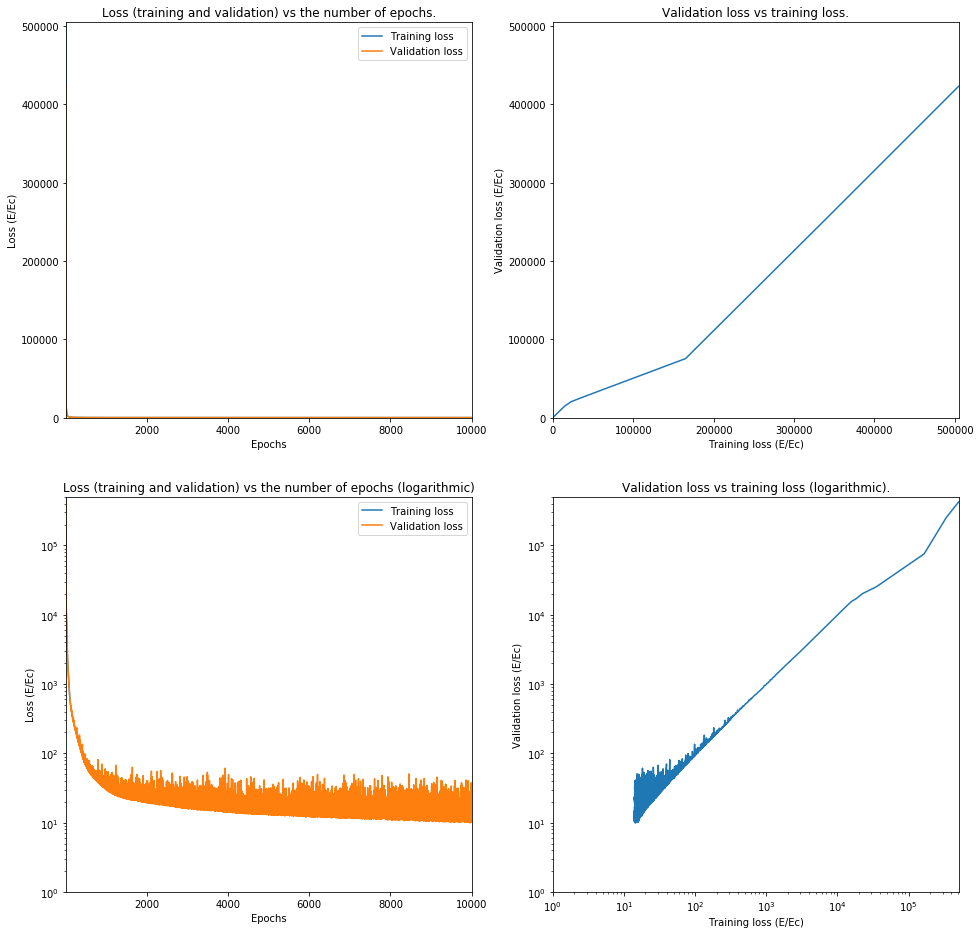

In [24]:
name = 'TwoDenseLayerLargeSoftplus'
settingsNetwork = [inputSize, ['Dense', 4*inputSize, 'softplus', True], ['Dense', 4*inputSize, 'softplus', True], ['Dense', 1, 'linear', True]]
learningRate = 2.5*10**-6
callbacksNetwork = [keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=500, min_delta=0)]

model, fitDetails = testNetwork(trainingInput, settingsNetwork, learningRate, kernalInitializer='he_uniform', lossFunction=MAE, validationSplit=0.2, epochs=10000, verbose=1, callbacksNetwork=callbacksNetwork, sampleSize=3)
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=0)
models.append({'model':model, 'name':str(prefixName) + name, 'evaluation':evaluation, 'history':history})
prefixName = prefixName + 1

19576/19576 [==============================] - 0s 15us/step
9.888595250561913


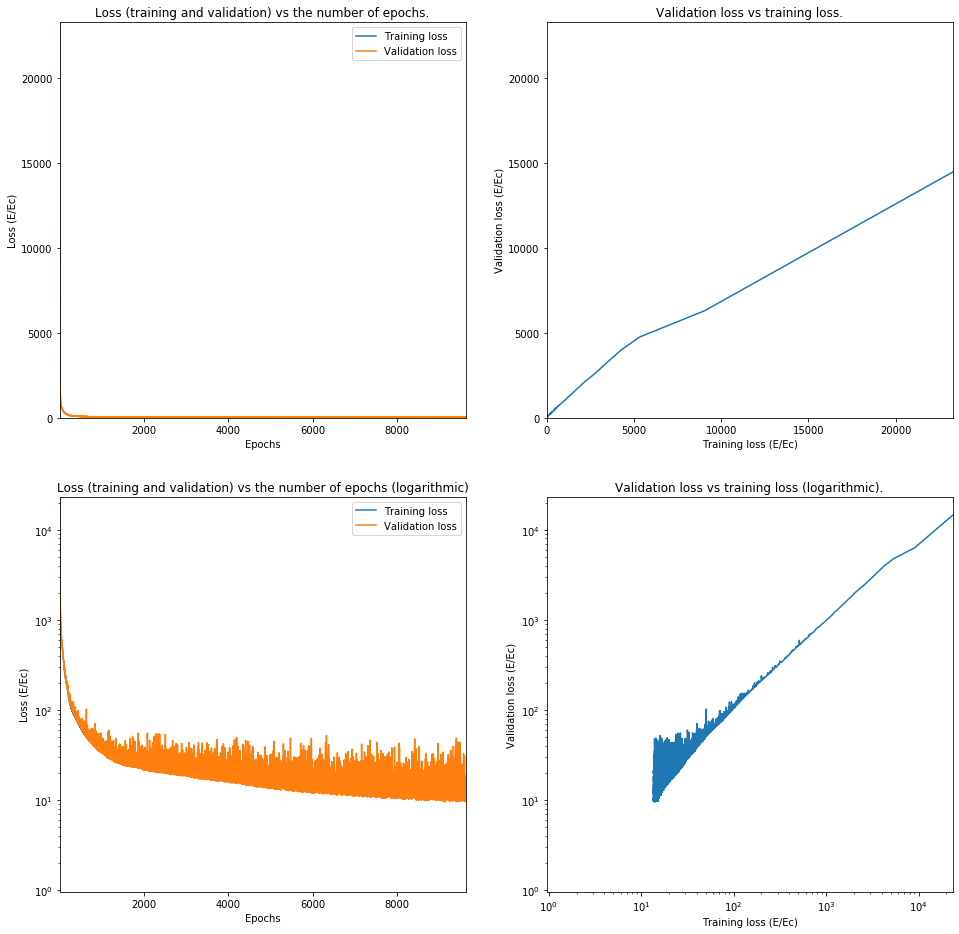

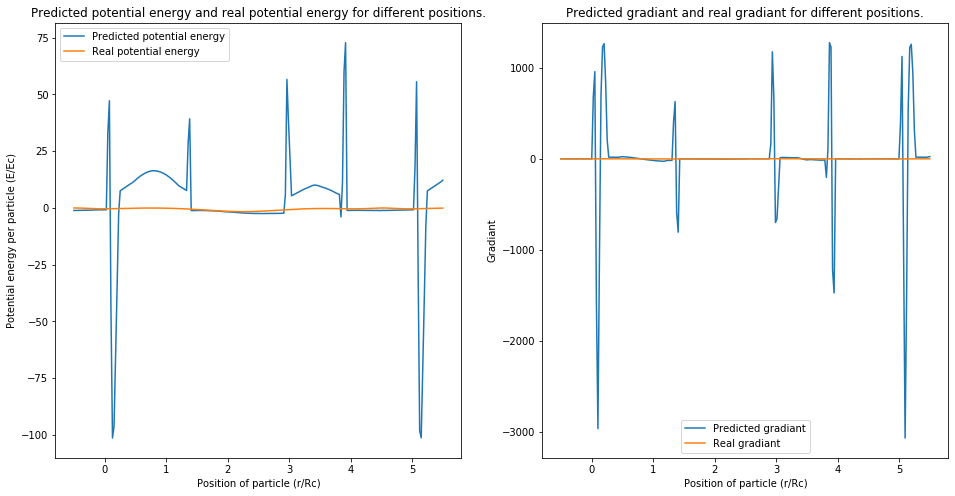

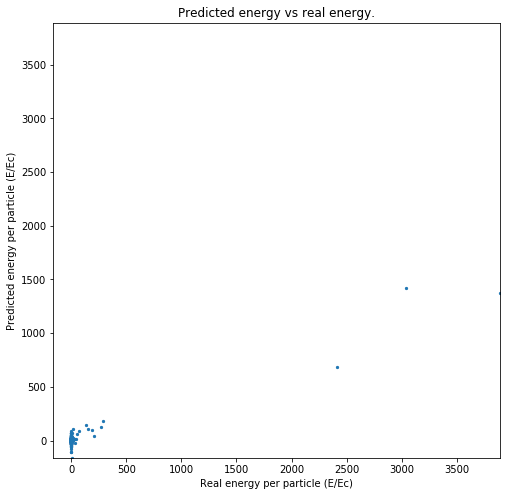

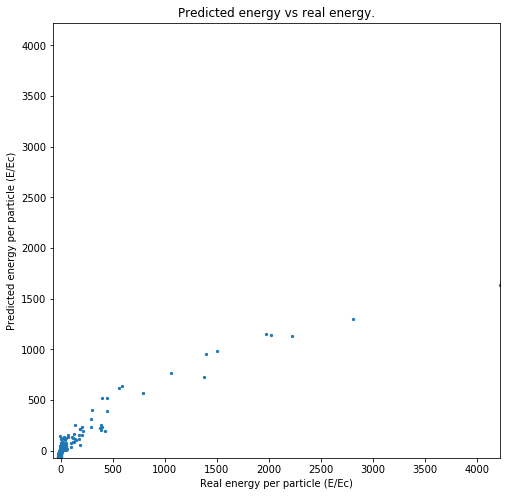

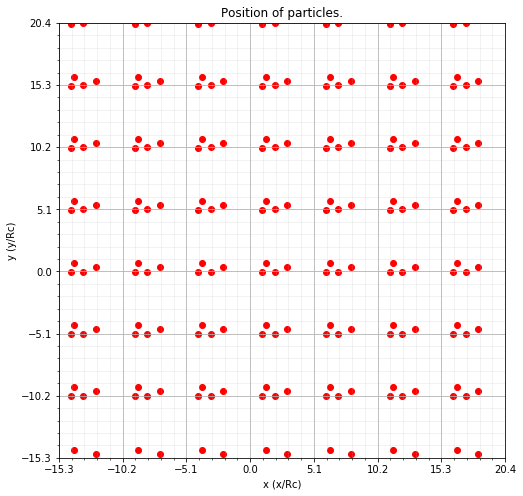

For index 27029 Predicted 12.905285 was -0.0432773724


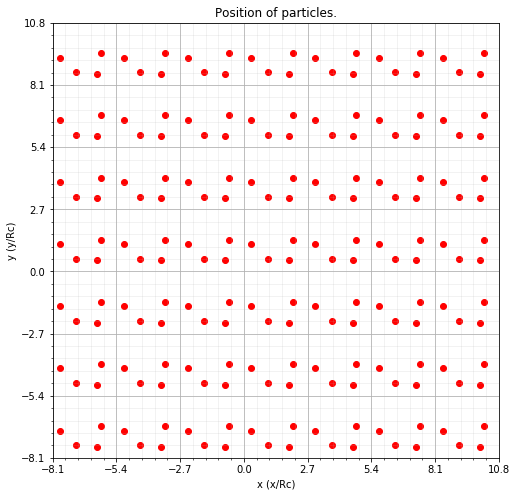

For index 82985 Predicted -16.298817 was -3.4620669033


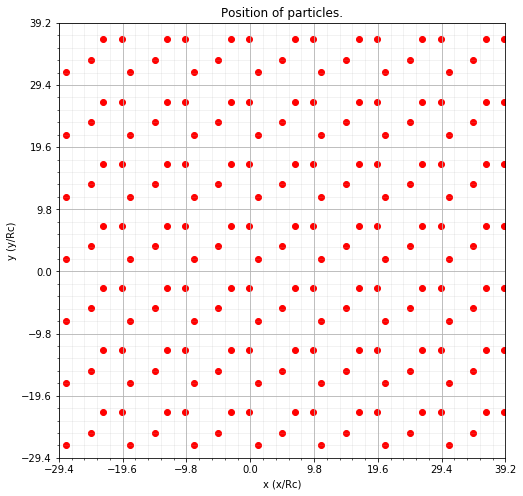

For index 81338 Predicted -2.587547 was 0.0


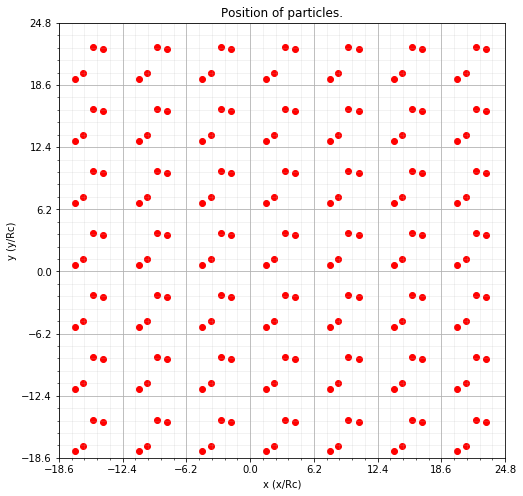

For index 90421 Predicted -0.9601934 was -0.2191454457


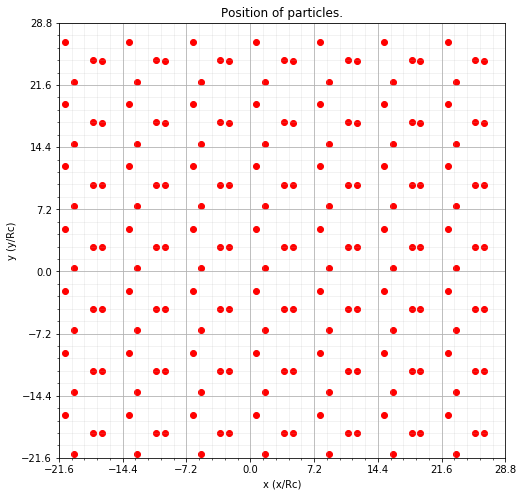

For index 23095 Predicted -2.1049688 was -0.1095838854


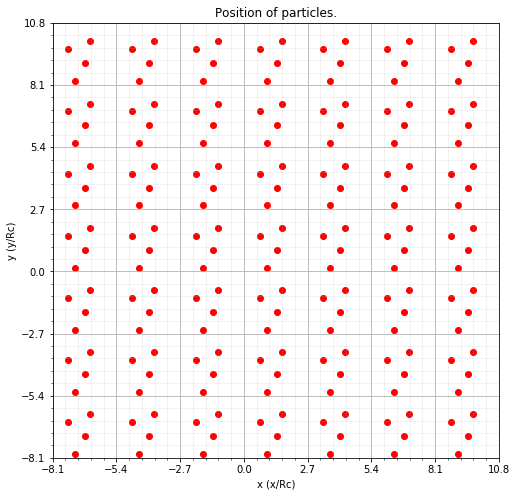

For index 92889 Predicted -5.6679573 was -3.8599259571999998


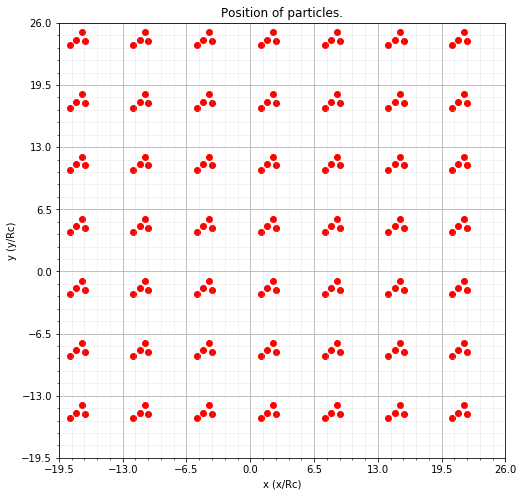

For index 97309 Predicted -6.3110237 was -2.3285637016000003


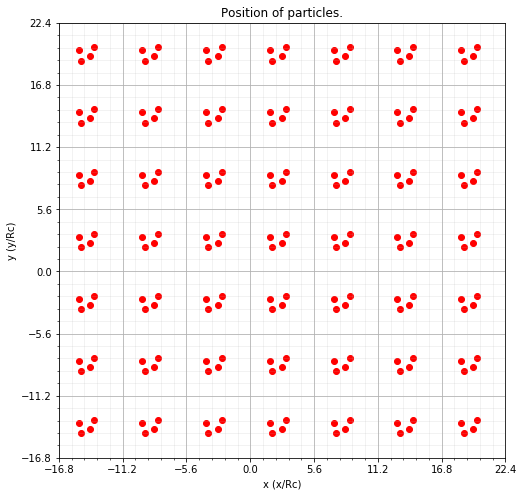

For index 89734 Predicted -3.0204961 was -2.6354253694


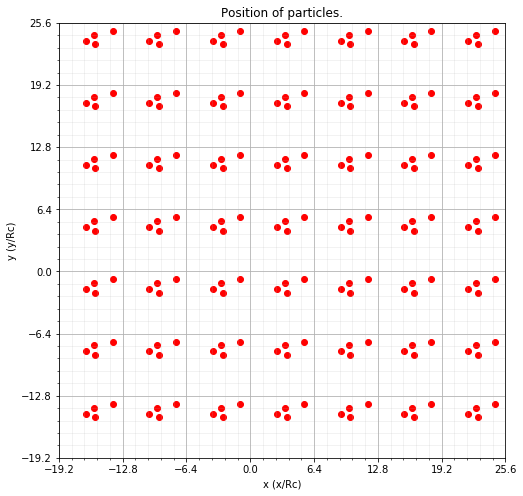

For index 22197 Predicted -1.5078008 was -1.3324452942


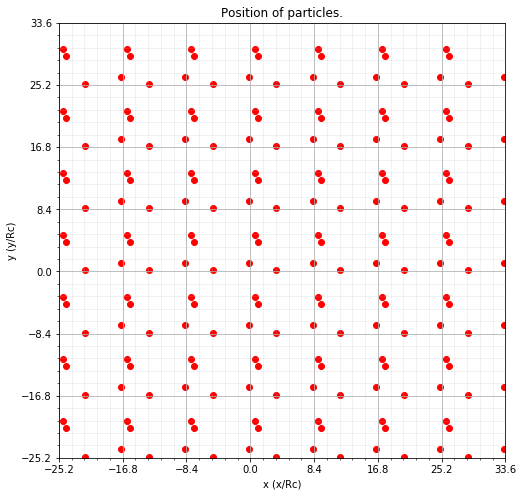

For index 17850 Predicted -2.0087774 was -0.10959605650000001


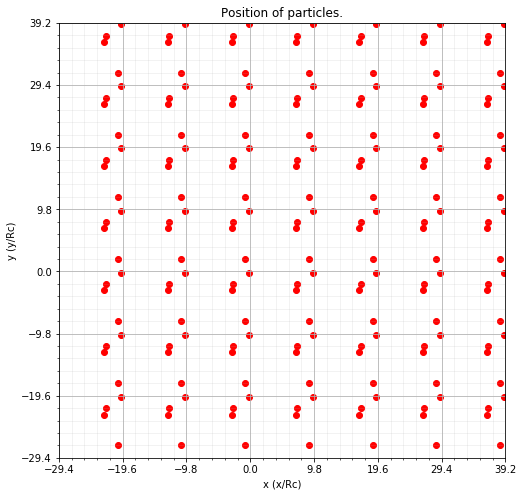

For index 61758 Predicted -1.8061407 was -0.10957113210000001
Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_27 (Dense)             (None, 48)                624       
_________________________________________________________________
dense_28 (Dense)             (None, 48)                2352      
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 49        
Total params: 3,025
Trainable params: 3,025
Non-trainable params: 0
_________________________________________________________________
Layer 0:  [array([[-0.22945386, -0.11531276,  0.3787212 ,  0.45103237, -0.3967293 ,
        -0.16910493,  0.02706606,  0.1176573 , -0.20657808,  0.07603949,
         0.78297853, -0.7166001 ,  0.7469072 , -0.42580673,  0.24259943,
        -0.32493794, -0.30345574,  0.0370267 ,  0.74124783,  0.08343147,
         0.43932

In [25]:
evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
history = plotHistory(fitDetails)

makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())


# Finishing

In [26]:
for i in range(len(models)):
    model = models[i]['model']
    print(models[i]['name'])
    print(model.summary())
    print(models[i]['evaluation'])
    model.save(saveFolder + '/' + models[i]['name'] + str(models[i]['evaluation']) + '.h5')
    print('\n \n')

#model = models[1][0]
#model.save('model1.h5')
#model = load_model('model1.h5')

0LinearNetwork
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
None
7.737196990846369

 

1DenseLayerSmallSoftplus
Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_17 (Dense)             (None, 12)                156       
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 13        
Total params: 169
Trainable params: 169
Non-trainable params: 0
_________________________________________________________________
None
8.249646111902628

 

2TwoDenseLayerLargeSoftplus
Model: "sequential_15"
________________________

In [ ]:
model = load_model(saveFolder+ '/' +'0LinearNetwork0.46557734359635244.h5')

evaluation = model.evaluate(validationInput['input'], validationInput['target'], verbose=1)
print(evaluation)
makeGradiantPlot(model, x, testData)

makePredictionPlot(model, validationData)
makePredictionPlot(model, trainingData)

for i in validationPlots:
    plotAndPredict(model, validationData, i)

model.summary()
for i in range(len(model.layers)):
    print('Layer ' + str(i) + ': ', model.layers[i].get_weights())
